<a href="https://colab.research.google.com/github/net39/ML-anomaly-detection/blob/main/P2_03_SVM_img_v2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Second Attempt -

Train-test split and,
- Hog + SVM
- VGG19 + PCA + SVM

In [ ]:
from google.colab import auth
auth.authenticate_user()

from google.colab import drive
drive.mount('/content/drive')

from google.colab import files
files.upload()

from google.cloud import storage
import os
os.environ['GOOGLE_APPLICATION_CREDENTIALS'] = '/content/p2-anomaly-c4545180e308.json'

client = storage.Client(project='p2-anomaly')
bucket = client.bucket('p2-anomaly')

Mounted at /content/drive


Saving p2-anomaly-c4545180e308.json to p2-anomaly-c4545180e308.json


In [ ]:
import numpy as np
import pandas as pd
import cv2
from PIL import Image
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from skimage.feature import hog
from sklearn.svm import SVC
from sklearn.metrics import classification_report, accuracy_score
from io import BytesIO, StringIO
from tqdm import tqdm
import joblib
import matplotlib.pyplot as plt
import os

In [ ]:
def load_csv_from_gcs(path):
    blob = bucket.blob(path)
    content = blob.download_as_text()
    return pd.read_csv(StringIO(content))

train_df = load_csv_from_gcs('raw/images/Training_set.csv')

label_encoder = LabelEncoder()
train_df['encoded_label'] = label_encoder.fit_transform(train_df['label'])
joblib.dump(label_encoder, 'label_encoder.joblib')
bucket.blob('processed/labels/label_encoder.joblib').upload_from_filename('label_encoder.joblib')

In [ ]:
train_split_df, val_split_df = train_test_split(
    train_df, test_size=0.2, stratify=train_df['encoded_label'], random_state=42
)


## Hog SVM

In [ ]:
def load_image_from_gcs(path, size=(224, 224)):
    blob = bucket.blob(path)
    img_bytes = blob.download_as_bytes()
    img = Image.open(BytesIO(img_bytes)).convert('RGB').resize(size)
    return np.array(img)

def extract_hog_features(img_array):
    gray = cv2.cvtColor(img_array, cv2.COLOR_RGB2GRAY)
    features = hog(gray, orientations=9, pixels_per_cell=(8, 8), cells_per_block=(2, 2),
                   block_norm='L2-Hys', feature_vector=True)
    return features

In [ ]:
X_train_hog, y_train_hog = [], []
for _, row in tqdm(train_split_df.iterrows(), total=len(train_split_df)):
    img = load_image_from_gcs(f'raw/images/train/{row["filename"]}')
    features = extract_hog_features(img)
    X_train_hog.append(features)
    y_train_hog.append(row['encoded_label'])

np.save('X_train_split_hog.npy', X_train_hog)
np.save('y_train_split_hog.npy', y_train_hog)
bucket.blob('processed/features/X_train_split_hog.npy').upload_from_filename('X_train_split_hog.npy')
bucket.blob('processed/features/y_train_split_hog.npy').upload_from_filename('y_train_split_hog.npy')

X_val_hog, y_val_hog = [], []
for _, row in tqdm(val_split_df.iterrows(), total=len(val_split_df)):
    img = load_image_from_gcs(f'raw/images/train/{row["filename"]}')
    features = extract_hog_features(img)
    X_val_hog.append(features)
    y_val_hog.append(row['encoded_label'])

np.save('X_val_split_hog.npy', X_val_hog)
np.save('y_val_split_hog.npy', y_val_hog)
bucket.blob('processed/features/X_val_split_hog.npy').upload_from_filename('X_val_split_hog.npy')
bucket.blob('processed/features/y_val_split_hog.npy').upload_from_filename('y_val_split_hog.npy')

100%|██████████| 2520/2520 [14:05<00:00,  2.98it/s]


In [ ]:
X_train = np.load('X_train_split_hog.npy')
y_train = np.load('y_train_split_hog.npy')
X_val = np.load('X_val_split_hog.npy')
y_val = np.load('y_val_split_hog.npy')

svm_model = SVC(kernel='linear')
svm_model.fit(X_train, y_train)

y_val_pred = svm_model.predict(X_val)

In [ ]:
label_encoder = joblib.load('label_encoder.joblib')

print(classification_report(
    label_encoder.inverse_transform(y_val),
    label_encoder.inverse_transform(y_val_pred)
))

val_acc = accuracy_score(y_val, y_val_pred)
print(f"Validation Accuracy: {val_acc:.4f}")

                    precision    recall  f1-score   support

           calling       0.22      0.24      0.23       168
          clapping       0.27      0.29      0.28       168
           cycling       0.30      0.45      0.36       168
           dancing       0.33      0.36      0.35       168
          drinking       0.15      0.13      0.14       168
            eating       0.33      0.35      0.34       168
          fighting       0.30      0.26      0.28       168
           hugging       0.20      0.20      0.20       168
          laughing       0.29      0.32      0.30       168
listening_to_music       0.15      0.11      0.13       168
           running       0.32      0.32      0.32       168
           sitting       0.25      0.25      0.25       168
          sleeping       0.35      0.35      0.35       168
           texting       0.12      0.09      0.10       168
      using_laptop       0.38      0.35      0.37       168

          accuracy                    

In [ ]:
joblib.dump(svm_model, 'svm_hog_model_clean.joblib')
bucket.blob('models/svm_hog_model_clean.joblib').upload_from_filename('svm_hog_model_clean.joblib')

In [45]:
svm_hog_model = joblib.load('svm_hog_model_clean.joblib')

X_val_hog = np.load('X_val_split_hog.npy')
y_val_hog = np.load('y_val_split_hog.npy')


label_encoder = joblib.load('label_encoder.joblib')

In [46]:
y_val_pred_hog = svm_hog_model.predict(X_val_hog)

decoded_y_val_hog = label_encoder.inverse_transform(y_val_hog)
decoded_y_val_pred_hog = label_encoder.inverse_transform(y_val_pred_hog)

hog_report_dict = classification_report(decoded_y_val_hog, decoded_y_val_pred_hog, output_dict=True)

hog_report_df = pd.DataFrame(hog_report_dict).transpose()

hog_report_df.to_csv('classification_report_hog.csv')

bucket.blob('results/classification_report_hog.csv').upload_from_filename('classification_report_hog.csv')

print("HOG+SVM classification report saved and uploaded.")

HOG+SVM classification report saved and uploaded.


## VGG19, PCA, SVM

In [ ]:
from tensorflow.keras.applications.vgg19 import VGG19, preprocess_input
from tensorflow.keras.preprocessing import image

# Re-load VGG19 model
vgg_model = VGG19(weights='imagenet', include_top=False, pooling='avg')

# Recreate feature extraction function
def extract_vgg19_features(img_array):
    img_array = preprocess_input(img_array)
    features = vgg_model.predict(np.expand_dims(img_array, axis=0))
    return features.flatten()

80134624/80134624 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


In [19]:
X_train_vgg, y_train_vgg = [], []
for _, row in tqdm(train_split_df.iterrows(), total=len(train_split_df)):
    img = load_image_from_gcs(f'raw/images/train/{row["filename"]}')
    features = extract_vgg19_features(img)
    X_train_vgg.append(features)
    y_train_vgg.append(row['encoded_label'])

np.save('X_train_split_vgg19.npy', X_train_vgg)
np.save('y_train_split_vgg19.npy', y_train_vgg)

X_val_vgg, y_val_vgg = [], []
for _, row in tqdm(val_split_df.iterrows(), total=len(val_split_df)):
    img = load_image_from_gcs(f'raw/images/train/{row["filename"]}')
    features = extract_vgg19_features(img)
    X_val_vgg.append(features)
    y_val_vgg.append(row['encoded_label'])

  0%|          | 0/10080 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  0%|          | 1/10080 [00:01<4:44:16,  1.69s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


  0%|          | 2/10080 [00:02<2:43:05,  1.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  0%|          | 3/10080 [00:03<2:57:58,  1.06s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


  0%|          | 4/10080 [00:03<2:20:44,  1.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  0%|          | 5/10080 [00:04<2:39:35,  1.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  0%|          | 6/10080 [00:05<2:15:06,  1.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  0%|          | 7/10080 [00:06<2:36:44,  1.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  0%|          | 8/10080 [00:07<2:13:45,  1.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  0%|          | 9/10080 [00:08<2:33:43,  1.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  0%|          | 10/10080 [00:08<2:10:43,  1.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  0%|          | 11/10080 [00:10<2:33:24,  1.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  0%|          | 12/10080 [00:10<2:09:21,  1.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  0%|          | 13/10080 [00:11<2:32:46,  1.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  0%|          | 14/10080 [00:12<2:09:54,  1.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  0%|          | 15/10080 [00:13<2:30:03,  1.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  0%|          | 16/10080 [00:13<2:11:18,  1.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  0%|          | 17/10080 [00:15<2:28:45,  1.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  0%|          | 18/10080 [00:15<2:10:51,  1.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  0%|          | 19/10080 [00:16<2:29:13,  1.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  0%|          | 20/10080 [00:17<2:10:07,  1.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  0%|          | 21/10080 [00:18<2:37:45,  1.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  0%|          | 22/10080 [00:19<2:14:28,  1.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  0%|          | 23/10080 [00:20<2:33:22,  1.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  0%|          | 24/10080 [00:20<2:12:54,  1.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  0%|          | 25/10080 [00:21<2:30:07,  1.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  0%|          | 26/10080 [00:22<2:11:31,  1.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  0%|          | 27/10080 [00:23<2:28:52,  1.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  0%|          | 28/10080 [00:24<2:10:19,  1.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  0%|          | 29/10080 [00:25<2:29:55,  1.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  0%|          | 30/10080 [00:25<2:11:17,  1.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  0%|          | 31/10080 [00:26<2:32:00,  1.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  0%|          | 32/10080 [00:27<2:09:41,  1.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


  0%|          | 33/10080 [00:28<2:39:02,  1.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  0%|          | 34/10080 [00:29<2:15:12,  1.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  0%|          | 35/10080 [00:30<2:33:18,  1.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  0%|          | 36/10080 [00:30<2:11:36,  1.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  0%|          | 37/10080 [00:32<2:33:18,  1.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  0%|          | 38/10080 [00:32<2:09:56,  1.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  0%|          | 39/10080 [00:33<2:31:39,  1.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  0%|          | 40/10080 [00:34<2:08:44,  1.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  0%|          | 41/10080 [00:35<2:29:09,  1.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  0%|          | 42/10080 [00:36<2:16:50,  1.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  0%|          | 43/10080 [00:37<2:26:31,  1.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  0%|          | 44/10080 [00:37<2:12:58,  1.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  0%|          | 45/10080 [00:38<2:27:31,  1.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  0%|          | 46/10080 [00:39<2:20:19,  1.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


  0%|          | 47/10080 [00:40<2:26:49,  1.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  0%|          | 48/10080 [00:41<2:24:03,  1.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


  0%|          | 49/10080 [00:42<2:22:24,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  0%|          | 50/10080 [00:42<2:20:20,  1.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  1%|          | 51/10080 [00:43<2:21:27,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  1%|          | 52/10080 [00:44<2:18:12,  1.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  1%|          | 53/10080 [00:45<2:21:37,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


  1%|          | 54/10080 [00:46<2:17:00,  1.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  1%|          | 55/10080 [00:47<2:22:15,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  1%|          | 56/10080 [00:47<2:17:15,  1.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  1%|          | 57/10080 [00:48<2:21:35,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  1%|          | 58/10080 [00:49<2:25:05,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  1%|          | 59/10080 [00:50<2:17:54,  1.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


  1%|          | 60/10080 [00:51<2:31:24,  1.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  1%|          | 61/10080 [00:52<2:15:26,  1.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  1%|          | 62/10080 [00:53<2:27:25,  1.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  1%|          | 63/10080 [00:53<2:13:47,  1.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  1%|          | 64/10080 [00:54<2:25:11,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  1%|          | 65/10080 [00:55<2:11:20,  1.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  1%|          | 66/10080 [00:56<2:24:35,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  1%|          | 67/10080 [00:57<2:11:59,  1.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  1%|          | 68/10080 [00:58<2:24:59,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  1%|          | 69/10080 [00:58<2:11:26,  1.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  1%|          | 70/10080 [00:59<2:26:22,  1.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  1%|          | 71/10080 [01:00<2:09:17,  1.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  1%|          | 72/10080 [01:01<2:27:42,  1.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  1%|          | 73/10080 [01:01<2:08:43,  1.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


  1%|          | 74/10080 [01:03<2:28:10,  1.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


  1%|          | 75/10080 [01:03<2:14:50,  1.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  1%|          | 76/10080 [01:04<2:28:48,  1.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  1%|          | 77/10080 [01:05<2:13:36,  1.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  1%|          | 78/10080 [01:06<2:30:17,  1.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  1%|          | 79/10080 [01:07<2:13:17,  1.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  1%|          | 80/10080 [01:08<2:28:56,  1.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  1%|          | 81/10080 [01:08<2:20:08,  1.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  1%|          | 82/10080 [01:09<2:23:25,  1.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  1%|          | 83/10080 [01:10<2:19:26,  1.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  1%|          | 84/10080 [01:11<2:20:01,  1.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  1%|          | 85/10080 [01:12<2:17:31,  1.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  1%|          | 86/10080 [01:13<2:18:47,  1.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  1%|          | 87/10080 [01:13<2:16:49,  1.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  1%|          | 88/10080 [01:14<2:26:44,  1.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  1%|          | 89/10080 [01:15<2:14:38,  1.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  1%|          | 90/10080 [01:16<2:24:27,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  1%|          | 91/10080 [01:17<2:15:52,  1.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  1%|          | 92/10080 [01:18<2:20:42,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  1%|          | 93/10080 [01:18<2:16:50,  1.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  1%|          | 94/10080 [01:19<2:20:33,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  1%|          | 95/10080 [01:20<2:18:29,  1.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  1%|          | 96/10080 [01:21<2:18:21,  1.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  1%|          | 97/10080 [01:22<2:18:36,  1.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


  1%|          | 98/10080 [01:23<2:19:11,  1.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  1%|          | 99/10080 [01:23<2:16:04,  1.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  1%|          | 100/10080 [01:24<1:58:58,  1.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  1%|          | 101/10080 [01:24<1:46:36,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  1%|          | 102/10080 [01:25<1:37:40,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  1%|          | 103/10080 [01:25<1:39:13,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  1%|          | 104/10080 [01:26<1:36:19,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  1%|          | 105/10080 [01:26<1:31:14,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  1%|          | 106/10080 [01:27<1:27:04,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  1%|          | 107/10080 [01:27<1:23:33,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  1%|          | 108/10080 [01:28<1:22:41,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  1%|          | 109/10080 [01:28<1:21:34,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  1%|          | 110/10080 [01:29<1:21:39,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  1%|          | 111/10080 [01:30<1:28:51,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  1%|          | 112/10080 [01:30<1:27:07,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  1%|          | 113/10080 [01:30<1:25:06,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  1%|          | 114/10080 [01:31<1:22:32,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  1%|          | 115/10080 [01:31<1:20:40,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  1%|          | 116/10080 [01:32<1:29:15,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  1%|          | 117/10080 [01:33<1:26:57,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  1%|          | 118/10080 [01:33<1:25:05,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  1%|          | 119/10080 [01:34<1:24:17,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  1%|          | 120/10080 [01:34<1:23:15,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  1%|          | 121/10080 [01:35<1:21:58,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  1%|          | 122/10080 [01:35<1:21:07,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  1%|          | 123/10080 [01:35<1:19:54,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  1%|          | 124/10080 [01:36<1:20:16,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


  1%|          | 125/10080 [01:36<1:19:44,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  1%|▏         | 126/10080 [01:37<1:19:54,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  1%|▏         | 127/10080 [01:37<1:19:12,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  1%|▏         | 128/10080 [01:38<1:20:46,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  1%|▏         | 129/10080 [01:38<1:19:34,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  1%|▏         | 130/10080 [01:39<1:19:40,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  1%|▏         | 131/10080 [01:39<1:18:43,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  1%|▏         | 132/10080 [01:40<1:18:35,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  1%|▏         | 133/10080 [01:40<1:19:22,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  1%|▏         | 134/10080 [01:41<1:19:47,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  1%|▏         | 135/10080 [01:41<1:20:09,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  1%|▏         | 136/10080 [01:42<1:19:03,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  1%|▏         | 137/10080 [01:42<1:17:42,  2.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  1%|▏         | 138/10080 [01:43<1:18:17,  2.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  1%|▏         | 139/10080 [01:43<1:25:47,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  1%|▏         | 140/10080 [01:44<1:24:00,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  1%|▏         | 141/10080 [01:44<1:22:04,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  1%|▏         | 142/10080 [01:45<1:22:08,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


  1%|▏         | 143/10080 [01:45<1:21:33,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  1%|▏         | 144/10080 [01:46<1:20:41,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  1%|▏         | 145/10080 [01:46<1:27:07,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  1%|▏         | 146/10080 [01:47<1:25:30,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  1%|▏         | 147/10080 [01:47<1:24:12,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  1%|▏         | 148/10080 [01:48<1:23:10,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  1%|▏         | 149/10080 [01:48<1:21:36,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  1%|▏         | 150/10080 [01:49<1:23:22,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  1%|▏         | 151/10080 [01:49<1:23:22,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  2%|▏         | 152/10080 [01:50<1:21:40,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  2%|▏         | 153/10080 [01:50<1:19:31,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  2%|▏         | 154/10080 [01:51<1:20:42,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  2%|▏         | 155/10080 [01:51<1:19:03,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


  2%|▏         | 156/10080 [01:52<1:18:46,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  2%|▏         | 157/10080 [01:52<1:19:41,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  2%|▏         | 158/10080 [01:53<1:18:41,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  2%|▏         | 159/10080 [01:53<1:18:04,  2.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  2%|▏         | 160/10080 [01:53<1:17:03,  2.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  2%|▏         | 161/10080 [01:54<1:18:46,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  2%|▏         | 162/10080 [01:54<1:17:08,  2.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  2%|▏         | 163/10080 [01:55<1:16:59,  2.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  2%|▏         | 164/10080 [01:55<1:16:15,  2.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  2%|▏         | 165/10080 [01:56<1:24:35,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  2%|▏         | 166/10080 [01:56<1:21:49,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  2%|▏         | 167/10080 [01:57<1:18:48,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  2%|▏         | 168/10080 [01:57<1:19:46,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  2%|▏         | 169/10080 [01:58<1:21:13,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  2%|▏         | 170/10080 [01:58<1:19:14,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  2%|▏         | 171/10080 [01:59<1:25:59,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  2%|▏         | 172/10080 [01:59<1:25:15,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  2%|▏         | 173/10080 [02:00<1:30:33,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  2%|▏         | 174/10080 [02:01<1:34:14,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  2%|▏         | 175/10080 [02:01<1:36:08,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  2%|▏         | 176/10080 [02:02<1:30:47,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  2%|▏         | 177/10080 [02:02<1:26:59,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  2%|▏         | 178/10080 [02:03<1:24:55,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  2%|▏         | 179/10080 [02:03<1:22:40,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  2%|▏         | 180/10080 [02:04<1:21:04,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  2%|▏         | 181/10080 [02:04<1:21:26,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  2%|▏         | 182/10080 [02:05<1:21:02,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  2%|▏         | 183/10080 [02:05<1:21:16,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  2%|▏         | 184/10080 [02:06<1:18:15,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  2%|▏         | 185/10080 [02:06<1:17:20,  2.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  2%|▏         | 186/10080 [02:07<1:18:55,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  2%|▏         | 187/10080 [02:07<1:17:15,  2.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  2%|▏         | 188/10080 [02:07<1:16:53,  2.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  2%|▏         | 189/10080 [02:08<1:23:55,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  2%|▏         | 190/10080 [02:09<1:22:31,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  2%|▏         | 191/10080 [02:09<1:30:40,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  2%|▏         | 192/10080 [02:10<1:27:07,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  2%|▏         | 193/10080 [02:10<1:22:58,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  2%|▏         | 194/10080 [02:11<1:21:52,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


  2%|▏         | 195/10080 [02:11<1:27:33,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  2%|▏         | 196/10080 [02:12<1:27:19,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


  2%|▏         | 197/10080 [02:12<1:24:38,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  2%|▏         | 198/10080 [02:13<1:30:21,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  2%|▏         | 199/10080 [02:13<1:27:02,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  2%|▏         | 200/10080 [02:14<1:23:35,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  2%|▏         | 201/10080 [02:14<1:22:49,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  2%|▏         | 202/10080 [02:15<1:21:45,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  2%|▏         | 203/10080 [02:15<1:21:01,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  2%|▏         | 204/10080 [02:16<1:20:41,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  2%|▏         | 205/10080 [02:16<1:21:09,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  2%|▏         | 206/10080 [02:17<1:21:13,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  2%|▏         | 207/10080 [02:17<1:21:26,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  2%|▏         | 208/10080 [02:18<1:20:37,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  2%|▏         | 209/10080 [02:18<1:29:57,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  2%|▏         | 210/10080 [02:19<1:34:49,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  2%|▏         | 211/10080 [02:20<1:36:04,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  2%|▏         | 212/10080 [02:20<1:29:36,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  2%|▏         | 213/10080 [02:21<1:25:39,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  2%|▏         | 214/10080 [02:21<1:23:47,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  2%|▏         | 215/10080 [02:22<1:23:09,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  2%|▏         | 216/10080 [02:22<1:22:32,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  2%|▏         | 217/10080 [02:23<1:29:25,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  2%|▏         | 218/10080 [02:23<1:24:22,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


  2%|▏         | 219/10080 [02:24<1:29:12,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  2%|▏         | 220/10080 [02:24<1:25:15,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  2%|▏         | 221/10080 [02:25<1:31:01,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


  2%|▏         | 222/10080 [02:25<1:25:59,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


  2%|▏         | 223/10080 [02:26<1:22:38,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


  2%|▏         | 224/10080 [02:26<1:20:19,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


  2%|▏         | 225/10080 [02:27<1:18:09,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  2%|▏         | 226/10080 [02:27<1:16:38,  2.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  2%|▏         | 227/10080 [02:28<1:24:09,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


  2%|▏         | 228/10080 [02:28<1:22:25,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


  2%|▏         | 229/10080 [02:29<1:22:16,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  2%|▏         | 230/10080 [02:29<1:20:28,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  2%|▏         | 231/10080 [02:30<1:18:53,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  2%|▏         | 232/10080 [02:30<1:16:42,  2.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


  2%|▏         | 233/10080 [02:30<1:17:15,  2.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  2%|▏         | 234/10080 [02:31<1:18:11,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  2%|▏         | 235/10080 [02:31<1:18:11,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  2%|▏         | 236/10080 [02:32<1:19:23,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  2%|▏         | 237/10080 [02:32<1:18:27,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  2%|▏         | 238/10080 [02:33<1:18:23,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  2%|▏         | 239/10080 [02:33<1:17:07,  2.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  2%|▏         | 240/10080 [02:34<1:17:14,  2.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  2%|▏         | 241/10080 [02:34<1:17:21,  2.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


  2%|▏         | 242/10080 [02:35<1:21:53,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


  2%|▏         | 243/10080 [02:35<1:18:41,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  2%|▏         | 244/10080 [02:36<1:18:12,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  2%|▏         | 245/10080 [02:36<1:24:01,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  2%|▏         | 246/10080 [02:37<1:21:02,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


  2%|▏         | 247/10080 [02:37<1:20:20,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  2%|▏         | 248/10080 [02:38<1:18:42,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  2%|▏         | 249/10080 [02:38<1:18:04,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  2%|▏         | 250/10080 [02:39<1:21:26,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  2%|▏         | 251/10080 [02:39<1:19:42,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  2%|▎         | 252/10080 [02:40<1:20:05,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  3%|▎         | 253/10080 [02:40<1:18:35,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  3%|▎         | 254/10080 [02:41<1:19:23,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  3%|▎         | 255/10080 [02:41<1:18:53,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  3%|▎         | 256/10080 [02:42<1:18:57,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  3%|▎         | 257/10080 [02:42<1:19:15,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  3%|▎         | 258/10080 [02:43<1:19:40,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  3%|▎         | 259/10080 [02:43<1:19:17,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  3%|▎         | 260/10080 [02:44<1:26:18,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  3%|▎         | 261/10080 [02:44<1:24:13,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  3%|▎         | 262/10080 [02:45<1:31:17,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  3%|▎         | 263/10080 [02:45<1:34:27,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


  3%|▎         | 264/10080 [02:46<1:29:13,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


  3%|▎         | 265/10080 [02:46<1:28:12,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  3%|▎         | 266/10080 [02:47<1:25:20,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  3%|▎         | 267/10080 [02:47<1:24:40,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  3%|▎         | 268/10080 [02:48<1:22:49,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  3%|▎         | 269/10080 [02:48<1:24:09,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  3%|▎         | 270/10080 [02:49<1:24:08,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  3%|▎         | 271/10080 [02:49<1:23:13,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  3%|▎         | 272/10080 [02:50<1:21:33,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  3%|▎         | 273/10080 [02:51<1:27:31,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  3%|▎         | 274/10080 [02:51<1:24:33,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  3%|▎         | 275/10080 [02:52<1:24:14,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  3%|▎         | 276/10080 [02:52<1:29:34,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  3%|▎         | 277/10080 [02:53<1:25:56,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  3%|▎         | 278/10080 [02:53<1:23:21,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  3%|▎         | 279/10080 [02:54<1:23:13,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  3%|▎         | 280/10080 [02:54<1:22:32,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  3%|▎         | 281/10080 [02:55<1:20:47,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  3%|▎         | 282/10080 [02:55<1:20:27,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  3%|▎         | 283/10080 [02:56<1:19:31,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  3%|▎         | 284/10080 [02:56<1:17:43,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  3%|▎         | 285/10080 [02:57<1:19:45,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  3%|▎         | 286/10080 [02:57<1:19:37,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


  3%|▎         | 287/10080 [02:58<1:19:32,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


  3%|▎         | 288/10080 [02:58<1:18:25,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  3%|▎         | 289/10080 [02:58<1:17:42,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  3%|▎         | 290/10080 [02:59<1:19:09,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  3%|▎         | 291/10080 [02:59<1:19:24,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  3%|▎         | 292/10080 [03:00<1:18:07,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  3%|▎         | 293/10080 [03:00<1:18:30,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  3%|▎         | 294/10080 [03:01<1:18:26,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  3%|▎         | 295/10080 [03:01<1:19:05,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  3%|▎         | 296/10080 [03:02<1:18:03,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  3%|▎         | 297/10080 [03:02<1:18:54,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  3%|▎         | 298/10080 [03:03<1:18:54,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  3%|▎         | 299/10080 [03:03<1:18:41,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  3%|▎         | 300/10080 [03:04<1:17:50,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  3%|▎         | 301/10080 [03:04<1:18:34,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


  3%|▎         | 302/10080 [03:05<1:19:17,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  3%|▎         | 303/10080 [03:05<1:18:03,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


  3%|▎         | 304/10080 [03:06<1:22:27,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  3%|▎         | 305/10080 [03:06<1:21:12,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  3%|▎         | 306/10080 [03:07<1:20:22,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  3%|▎         | 307/10080 [03:07<1:17:59,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  3%|▎         | 308/10080 [03:08<1:18:34,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  3%|▎         | 309/10080 [03:08<1:18:16,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


  3%|▎         | 310/10080 [03:09<1:18:50,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  3%|▎         | 311/10080 [03:09<1:20:21,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


  3%|▎         | 312/10080 [03:10<1:20:45,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  3%|▎         | 313/10080 [03:10<1:21:26,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  3%|▎         | 314/10080 [03:11<1:19:20,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  3%|▎         | 315/10080 [03:11<1:18:42,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  3%|▎         | 316/10080 [03:12<1:18:33,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  3%|▎         | 317/10080 [03:12<1:25:56,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  3%|▎         | 318/10080 [03:13<1:23:05,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  3%|▎         | 319/10080 [03:13<1:19:57,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  3%|▎         | 320/10080 [03:14<1:19:57,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  3%|▎         | 321/10080 [03:14<1:26:54,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  3%|▎         | 322/10080 [03:15<1:23:36,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  3%|▎         | 323/10080 [03:15<1:20:51,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  3%|▎         | 324/10080 [03:16<1:18:39,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  3%|▎         | 325/10080 [03:16<1:25:56,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  3%|▎         | 326/10080 [03:17<1:25:21,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  3%|▎         | 327/10080 [03:17<1:22:23,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  3%|▎         | 328/10080 [03:18<1:22:05,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  3%|▎         | 329/10080 [03:18<1:22:21,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  3%|▎         | 330/10080 [03:19<1:21:12,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  3%|▎         | 331/10080 [03:19<1:20:33,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  3%|▎         | 332/10080 [03:20<1:19:55,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


  3%|▎         | 333/10080 [03:20<1:21:03,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


  3%|▎         | 334/10080 [03:21<1:21:25,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  3%|▎         | 335/10080 [03:21<1:21:10,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  3%|▎         | 336/10080 [03:22<1:26:43,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  3%|▎         | 337/10080 [03:22<1:24:10,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  3%|▎         | 338/10080 [03:23<1:25:07,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  3%|▎         | 339/10080 [03:23<1:29:55,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  3%|▎         | 340/10080 [03:24<1:26:38,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  3%|▎         | 341/10080 [03:24<1:24:03,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


  3%|▎         | 342/10080 [03:25<1:21:27,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  3%|▎         | 343/10080 [03:25<1:19:42,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  3%|▎         | 344/10080 [03:26<1:19:06,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  3%|▎         | 345/10080 [03:26<1:20:06,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  3%|▎         | 346/10080 [03:27<1:18:49,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  3%|▎         | 347/10080 [03:27<1:25:03,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  3%|▎         | 348/10080 [03:28<1:21:27,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  3%|▎         | 349/10080 [03:28<1:20:08,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  3%|▎         | 350/10080 [03:29<1:20:22,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  3%|▎         | 351/10080 [03:29<1:20:27,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  3%|▎         | 352/10080 [03:30<1:20:29,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  4%|▎         | 353/10080 [03:30<1:22:10,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  4%|▎         | 354/10080 [03:31<1:28:45,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  4%|▎         | 355/10080 [03:32<1:25:27,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


  4%|▎         | 356/10080 [03:32<1:29:46,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  4%|▎         | 357/10080 [03:33<1:27:50,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  4%|▎         | 358/10080 [03:33<1:24:09,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  4%|▎         | 359/10080 [03:34<1:24:47,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  4%|▎         | 360/10080 [03:34<1:22:31,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  4%|▎         | 361/10080 [03:35<1:21:06,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  4%|▎         | 362/10080 [03:35<1:20:45,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  4%|▎         | 363/10080 [03:36<1:19:28,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  4%|▎         | 364/10080 [03:36<1:21:19,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  4%|▎         | 365/10080 [03:37<1:28:55,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  4%|▎         | 366/10080 [03:37<1:25:06,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  4%|▎         | 367/10080 [03:38<1:23:12,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  4%|▎         | 368/10080 [03:38<1:20:14,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  4%|▎         | 369/10080 [03:39<1:25:37,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  4%|▎         | 370/10080 [03:39<1:31:50,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  4%|▎         | 371/10080 [03:40<1:29:04,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  4%|▎         | 372/10080 [03:40<1:25:33,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  4%|▎         | 373/10080 [03:41<1:23:37,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  4%|▎         | 374/10080 [03:41<1:22:21,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  4%|▎         | 375/10080 [03:42<1:20:55,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  4%|▎         | 376/10080 [03:42<1:18:48,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


  4%|▎         | 377/10080 [03:43<1:17:28,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


  4%|▍         | 378/10080 [03:43<1:16:57,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  4%|▍         | 379/10080 [03:44<1:23:07,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  4%|▍         | 380/10080 [03:44<1:20:22,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  4%|▍         | 381/10080 [03:45<1:18:33,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  4%|▍         | 382/10080 [03:45<1:18:25,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  4%|▍         | 383/10080 [03:46<1:18:21,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  4%|▍         | 384/10080 [03:46<1:18:30,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  4%|▍         | 385/10080 [03:47<1:19:19,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  4%|▍         | 386/10080 [03:47<1:19:22,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  4%|▍         | 387/10080 [03:48<1:17:57,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  4%|▍         | 388/10080 [03:48<1:18:43,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  4%|▍         | 389/10080 [03:49<1:17:54,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  4%|▍         | 390/10080 [03:49<1:17:05,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  4%|▍         | 391/10080 [03:50<1:16:57,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  4%|▍         | 392/10080 [03:50<1:17:54,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


  4%|▍         | 393/10080 [03:51<1:18:10,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  4%|▍         | 394/10080 [03:51<1:18:54,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  4%|▍         | 395/10080 [03:52<1:17:37,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  4%|▍         | 396/10080 [03:52<1:18:53,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  4%|▍         | 397/10080 [03:53<1:18:22,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  4%|▍         | 398/10080 [03:53<1:17:54,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  4%|▍         | 399/10080 [03:54<1:21:52,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  4%|▍         | 400/10080 [03:54<1:27:38,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


  4%|▍         | 401/10080 [03:55<1:26:37,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  4%|▍         | 402/10080 [03:55<1:26:00,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  4%|▍         | 403/10080 [03:56<1:23:41,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  4%|▍         | 404/10080 [03:56<1:22:50,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  4%|▍         | 405/10080 [03:57<1:21:08,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  4%|▍         | 406/10080 [03:57<1:26:59,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


  4%|▍         | 407/10080 [03:58<1:26:26,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  4%|▍         | 408/10080 [03:58<1:23:56,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  4%|▍         | 409/10080 [03:59<1:29:48,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  4%|▍         | 410/10080 [03:59<1:25:41,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  4%|▍         | 411/10080 [04:00<1:22:26,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  4%|▍         | 412/10080 [04:00<1:22:06,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  4%|▍         | 413/10080 [04:01<1:28:41,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


  4%|▍         | 414/10080 [04:02<1:24:32,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  4%|▍         | 415/10080 [04:02<1:22:24,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  4%|▍         | 416/10080 [04:03<1:19:51,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  4%|▍         | 417/10080 [04:03<1:20:11,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  4%|▍         | 418/10080 [04:04<1:20:40,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  4%|▍         | 419/10080 [04:04<1:19:53,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  4%|▍         | 420/10080 [04:04<1:19:04,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  4%|▍         | 421/10080 [04:05<1:26:46,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  4%|▍         | 422/10080 [04:06<1:24:32,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  4%|▍         | 423/10080 [04:06<1:23:20,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  4%|▍         | 424/10080 [04:07<1:24:08,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


  4%|▍         | 425/10080 [04:07<1:21:36,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  4%|▍         | 426/10080 [04:08<1:21:05,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  4%|▍         | 427/10080 [04:08<1:20:02,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  4%|▍         | 428/10080 [04:09<1:18:17,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  4%|▍         | 429/10080 [04:09<1:18:34,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  4%|▍         | 430/10080 [04:10<1:19:28,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  4%|▍         | 431/10080 [04:10<1:19:19,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  4%|▍         | 432/10080 [04:11<1:26:31,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  4%|▍         | 433/10080 [04:11<1:24:13,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  4%|▍         | 434/10080 [04:12<1:22:21,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  4%|▍         | 435/10080 [04:12<1:22:23,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  4%|▍         | 436/10080 [04:13<1:22:54,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  4%|▍         | 437/10080 [04:13<1:21:36,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  4%|▍         | 438/10080 [04:14<1:20:01,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  4%|▍         | 439/10080 [04:14<1:21:05,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  4%|▍         | 440/10080 [04:15<1:19:24,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  4%|▍         | 441/10080 [04:15<1:17:39,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  4%|▍         | 442/10080 [04:16<1:18:17,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  4%|▍         | 443/10080 [04:16<1:17:40,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  4%|▍         | 444/10080 [04:17<1:17:42,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  4%|▍         | 445/10080 [04:17<1:18:01,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


  4%|▍         | 446/10080 [04:18<1:19:01,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  4%|▍         | 447/10080 [04:18<1:26:02,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  4%|▍         | 448/10080 [04:19<1:23:41,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  4%|▍         | 449/10080 [04:19<1:28:14,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  4%|▍         | 450/10080 [04:20<1:25:29,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  4%|▍         | 451/10080 [04:20<1:23:26,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  4%|▍         | 452/10080 [04:21<1:22:30,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  4%|▍         | 453/10080 [04:21<1:29:13,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  5%|▍         | 454/10080 [04:22<1:26:14,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  5%|▍         | 455/10080 [04:22<1:25:52,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  5%|▍         | 456/10080 [04:23<1:24:22,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  5%|▍         | 457/10080 [04:23<1:22:20,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  5%|▍         | 458/10080 [04:24<1:21:55,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  5%|▍         | 459/10080 [04:24<1:20:24,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  5%|▍         | 460/10080 [04:25<1:18:51,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  5%|▍         | 461/10080 [04:25<1:18:03,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  5%|▍         | 462/10080 [04:26<1:17:59,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  5%|▍         | 463/10080 [04:26<1:17:58,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  5%|▍         | 464/10080 [04:27<1:17:04,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  5%|▍         | 465/10080 [04:27<1:18:23,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  5%|▍         | 466/10080 [04:28<1:18:51,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  5%|▍         | 467/10080 [04:28<1:19:10,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  5%|▍         | 468/10080 [04:29<1:21:28,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  5%|▍         | 469/10080 [04:29<1:21:49,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


  5%|▍         | 470/10080 [04:30<1:27:13,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  5%|▍         | 471/10080 [04:31<1:26:25,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  5%|▍         | 472/10080 [04:31<1:23:28,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  5%|▍         | 473/10080 [04:32<1:22:23,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  5%|▍         | 474/10080 [04:32<1:22:50,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  5%|▍         | 475/10080 [04:33<1:20:58,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  5%|▍         | 476/10080 [04:33<1:19:24,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  5%|▍         | 477/10080 [04:33<1:17:08,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  5%|▍         | 478/10080 [04:34<1:18:22,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  5%|▍         | 479/10080 [04:34<1:18:17,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  5%|▍         | 480/10080 [04:35<1:16:51,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  5%|▍         | 481/10080 [04:35<1:15:35,  2.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  5%|▍         | 482/10080 [04:36<1:16:22,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  5%|▍         | 483/10080 [04:36<1:16:38,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  5%|▍         | 484/10080 [04:37<1:17:32,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  5%|▍         | 485/10080 [04:37<1:18:30,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  5%|▍         | 486/10080 [04:38<1:21:28,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  5%|▍         | 487/10080 [04:38<1:20:59,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  5%|▍         | 488/10080 [04:39<1:20:24,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  5%|▍         | 489/10080 [04:39<1:20:32,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


  5%|▍         | 490/10080 [04:40<1:21:30,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  5%|▍         | 491/10080 [04:40<1:20:03,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


  5%|▍         | 492/10080 [04:41<1:21:51,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


  5%|▍         | 493/10080 [04:41<1:21:20,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  5%|▍         | 494/10080 [04:42<1:27:08,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  5%|▍         | 495/10080 [04:43<1:24:43,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  5%|▍         | 496/10080 [04:43<1:21:22,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  5%|▍         | 497/10080 [04:44<1:20:48,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  5%|▍         | 498/10080 [04:44<1:18:47,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  5%|▍         | 499/10080 [04:45<1:20:23,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  5%|▍         | 500/10080 [04:45<1:20:09,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  5%|▍         | 501/10080 [04:46<1:19:01,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  5%|▍         | 502/10080 [04:46<1:19:01,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  5%|▍         | 503/10080 [04:46<1:19:19,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  5%|▌         | 504/10080 [04:47<1:18:51,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  5%|▌         | 505/10080 [04:47<1:19:17,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  5%|▌         | 506/10080 [04:48<1:19:44,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  5%|▌         | 507/10080 [04:48<1:19:58,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  5%|▌         | 508/10080 [04:49<1:17:56,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  5%|▌         | 509/10080 [04:49<1:18:06,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  5%|▌         | 510/10080 [04:50<1:17:13,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  5%|▌         | 511/10080 [04:50<1:17:21,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  5%|▌         | 512/10080 [04:51<1:17:25,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  5%|▌         | 513/10080 [04:51<1:16:48,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  5%|▌         | 514/10080 [04:52<1:17:38,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


  5%|▌         | 515/10080 [04:52<1:18:51,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  5%|▌         | 516/10080 [04:53<1:18:44,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  5%|▌         | 517/10080 [04:54<1:25:45,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  5%|▌         | 518/10080 [04:54<1:23:46,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  5%|▌         | 519/10080 [04:54<1:21:55,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  5%|▌         | 520/10080 [04:55<1:21:40,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  5%|▌         | 521/10080 [04:56<1:26:49,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  5%|▌         | 522/10080 [04:56<1:25:18,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  5%|▌         | 523/10080 [04:57<1:23:32,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  5%|▌         | 524/10080 [04:57<1:29:30,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  5%|▌         | 525/10080 [04:58<1:28:02,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  5%|▌         | 526/10080 [04:58<1:24:25,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  5%|▌         | 527/10080 [04:59<1:26:09,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  5%|▌         | 528/10080 [04:59<1:22:45,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  5%|▌         | 529/10080 [05:00<1:21:07,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  5%|▌         | 530/10080 [05:00<1:19:10,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  5%|▌         | 531/10080 [05:01<1:19:00,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  5%|▌         | 532/10080 [05:01<1:18:37,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  5%|▌         | 533/10080 [05:02<1:17:54,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  5%|▌         | 534/10080 [05:02<1:17:46,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  5%|▌         | 535/10080 [05:03<1:17:18,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  5%|▌         | 536/10080 [05:03<1:18:48,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  5%|▌         | 537/10080 [05:04<1:27:08,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


  5%|▌         | 538/10080 [05:05<1:31:27,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  5%|▌         | 539/10080 [05:05<1:27:04,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  5%|▌         | 540/10080 [05:06<1:24:46,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  5%|▌         | 541/10080 [05:06<1:22:13,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  5%|▌         | 542/10080 [05:07<1:21:36,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  5%|▌         | 543/10080 [05:07<1:20:35,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  5%|▌         | 544/10080 [05:08<1:20:23,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  5%|▌         | 545/10080 [05:08<1:19:00,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  5%|▌         | 546/10080 [05:08<1:18:07,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  5%|▌         | 547/10080 [05:09<1:26:03,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


  5%|▌         | 548/10080 [05:10<1:22:10,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  5%|▌         | 549/10080 [05:10<1:20:18,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  5%|▌         | 550/10080 [05:11<1:22:51,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  5%|▌         | 551/10080 [05:11<1:21:25,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  5%|▌         | 552/10080 [05:12<1:20:32,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  5%|▌         | 553/10080 [05:12<1:26:18,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  5%|▌         | 554/10080 [05:13<1:24:26,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  6%|▌         | 555/10080 [05:13<1:22:00,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  6%|▌         | 556/10080 [05:14<1:29:11,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  6%|▌         | 557/10080 [05:14<1:26:26,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


  6%|▌         | 558/10080 [05:15<1:24:24,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


  6%|▌         | 559/10080 [05:15<1:22:37,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


  6%|▌         | 560/10080 [05:16<1:22:06,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  6%|▌         | 561/10080 [05:16<1:21:50,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  6%|▌         | 562/10080 [05:17<1:19:42,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  6%|▌         | 563/10080 [05:17<1:18:00,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


  6%|▌         | 564/10080 [05:18<1:26:50,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  6%|▌         | 565/10080 [05:19<1:23:41,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  6%|▌         | 566/10080 [05:19<1:21:26,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  6%|▌         | 567/10080 [05:19<1:19:40,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  6%|▌         | 568/10080 [05:20<1:18:21,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  6%|▌         | 569/10080 [05:20<1:17:22,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  6%|▌         | 570/10080 [05:21<1:25:38,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  6%|▌         | 571/10080 [05:22<1:21:56,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  6%|▌         | 572/10080 [05:22<1:20:14,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  6%|▌         | 573/10080 [05:23<1:19:47,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


  6%|▌         | 574/10080 [05:23<1:19:39,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  6%|▌         | 575/10080 [05:24<1:19:48,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  6%|▌         | 576/10080 [05:24<1:21:27,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  6%|▌         | 577/10080 [05:25<1:20:46,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  6%|▌         | 578/10080 [05:25<1:29:35,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  6%|▌         | 579/10080 [05:26<1:24:34,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  6%|▌         | 580/10080 [05:26<1:32:06,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  6%|▌         | 581/10080 [05:27<1:28:45,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  6%|▌         | 582/10080 [05:27<1:24:38,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  6%|▌         | 583/10080 [05:28<1:24:01,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  6%|▌         | 584/10080 [05:28<1:23:16,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  6%|▌         | 585/10080 [05:29<1:25:50,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  6%|▌         | 586/10080 [05:30<1:25:09,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  6%|▌         | 587/10080 [05:30<1:33:00,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  6%|▌         | 588/10080 [05:31<1:29:04,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  6%|▌         | 589/10080 [05:31<1:25:25,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  6%|▌         | 590/10080 [05:32<1:22:12,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  6%|▌         | 591/10080 [05:32<1:21:25,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  6%|▌         | 592/10080 [05:33<1:20:04,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  6%|▌         | 593/10080 [05:33<1:18:24,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


  6%|▌         | 594/10080 [05:34<1:17:47,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  6%|▌         | 595/10080 [05:34<1:18:25,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  6%|▌         | 596/10080 [05:35<1:16:26,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  6%|▌         | 597/10080 [05:35<1:15:23,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  6%|▌         | 598/10080 [05:36<1:23:30,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  6%|▌         | 599/10080 [05:36<1:21:43,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  6%|▌         | 600/10080 [05:37<1:20:09,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  6%|▌         | 601/10080 [05:37<1:18:06,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  6%|▌         | 602/10080 [05:38<1:17:33,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  6%|▌         | 603/10080 [05:38<1:17:28,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  6%|▌         | 604/10080 [05:39<1:16:18,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  6%|▌         | 605/10080 [05:39<1:15:44,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


  6%|▌         | 606/10080 [05:40<1:16:51,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  6%|▌         | 607/10080 [05:40<1:17:41,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  6%|▌         | 608/10080 [05:41<1:16:50,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  6%|▌         | 609/10080 [05:41<1:25:35,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  6%|▌         | 610/10080 [05:42<1:25:30,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  6%|▌         | 611/10080 [05:42<1:31:16,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  6%|▌         | 612/10080 [05:43<1:27:54,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  6%|▌         | 613/10080 [05:43<1:26:01,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  6%|▌         | 614/10080 [05:44<1:23:22,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  6%|▌         | 615/10080 [05:44<1:21:06,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  6%|▌         | 616/10080 [05:45<1:20:47,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


  6%|▌         | 617/10080 [05:45<1:17:59,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  6%|▌         | 618/10080 [05:46<1:18:59,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  6%|▌         | 619/10080 [05:46<1:18:19,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  6%|▌         | 620/10080 [05:47<1:26:49,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  6%|▌         | 621/10080 [05:48<1:24:36,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


  6%|▌         | 622/10080 [05:48<1:21:33,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  6%|▌         | 623/10080 [05:49<1:27:00,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  6%|▌         | 624/10080 [05:49<1:23:23,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  6%|▌         | 625/10080 [05:50<1:28:30,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  6%|▌         | 626/10080 [05:50<1:25:13,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  6%|▌         | 627/10080 [05:51<1:22:59,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  6%|▌         | 628/10080 [05:51<1:19:11,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


  6%|▌         | 629/10080 [05:52<1:17:42,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


  6%|▋         | 630/10080 [05:52<1:16:04,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


  6%|▋         | 631/10080 [05:53<1:14:34,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


  6%|▋         | 632/10080 [05:53<1:15:32,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


  6%|▋         | 633/10080 [05:54<1:16:13,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  6%|▋         | 634/10080 [05:54<1:17:36,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


  6%|▋         | 635/10080 [05:55<1:16:55,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  6%|▋         | 636/10080 [05:55<1:17:21,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  6%|▋         | 637/10080 [05:56<1:16:14,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  6%|▋         | 638/10080 [05:56<1:15:48,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


  6%|▋         | 639/10080 [05:57<1:15:47,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  6%|▋         | 640/10080 [05:57<1:16:15,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  6%|▋         | 641/10080 [05:57<1:14:50,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  6%|▋         | 642/10080 [05:58<1:14:33,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  6%|▋         | 643/10080 [05:58<1:14:07,  2.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  6%|▋         | 644/10080 [05:59<1:13:38,  2.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  6%|▋         | 645/10080 [05:59<1:13:50,  2.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  6%|▋         | 646/10080 [06:00<1:15:30,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  6%|▋         | 647/10080 [06:00<1:15:31,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  6%|▋         | 648/10080 [06:01<1:17:49,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


  6%|▋         | 649/10080 [06:01<1:18:25,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


  6%|▋         | 650/10080 [06:02<1:19:13,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  6%|▋         | 651/10080 [06:02<1:24:47,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  6%|▋         | 652/10080 [06:03<1:21:56,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  6%|▋         | 653/10080 [06:04<1:28:30,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  6%|▋         | 654/10080 [06:04<1:24:42,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  6%|▋         | 655/10080 [06:05<1:23:25,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  7%|▋         | 656/10080 [06:05<1:22:19,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  7%|▋         | 657/10080 [06:06<1:21:20,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  7%|▋         | 658/10080 [06:06<1:19:14,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  7%|▋         | 659/10080 [06:07<1:17:39,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  7%|▋         | 660/10080 [06:07<1:18:06,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  7%|▋         | 661/10080 [06:08<1:17:35,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  7%|▋         | 662/10080 [06:08<1:24:36,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  7%|▋         | 663/10080 [06:09<1:22:38,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  7%|▋         | 664/10080 [06:09<1:19:47,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  7%|▋         | 665/10080 [06:10<1:19:19,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  7%|▋         | 666/10080 [06:10<1:17:50,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  7%|▋         | 667/10080 [06:11<1:16:10,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  7%|▋         | 668/10080 [06:11<1:15:16,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  7%|▋         | 669/10080 [06:12<1:21:51,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


  7%|▋         | 670/10080 [06:12<1:22:27,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


  7%|▋         | 671/10080 [06:13<1:21:12,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


  7%|▋         | 672/10080 [06:13<1:20:46,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  7%|▋         | 673/10080 [06:14<1:20:19,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  7%|▋         | 674/10080 [06:14<1:20:55,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  7%|▋         | 675/10080 [06:15<1:19:39,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  7%|▋         | 676/10080 [06:15<1:18:56,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  7%|▋         | 677/10080 [06:16<1:16:56,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  7%|▋         | 678/10080 [06:16<1:17:05,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  7%|▋         | 679/10080 [06:17<1:16:59,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  7%|▋         | 680/10080 [06:17<1:16:25,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  7%|▋         | 681/10080 [06:18<1:17:02,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  7%|▋         | 682/10080 [06:18<1:16:10,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  7%|▋         | 683/10080 [06:19<1:16:25,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  7%|▋         | 684/10080 [06:19<1:16:28,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  7%|▋         | 685/10080 [06:20<1:15:13,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  7%|▋         | 686/10080 [06:20<1:21:04,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


  7%|▋         | 687/10080 [06:21<1:18:21,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  7%|▋         | 688/10080 [06:21<1:19:10,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  7%|▋         | 689/10080 [06:22<1:19:04,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  7%|▋         | 690/10080 [06:22<1:17:17,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  7%|▋         | 691/10080 [06:23<1:24:07,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  7%|▋         | 692/10080 [06:23<1:21:58,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


  7%|▋         | 693/10080 [06:24<1:23:25,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  7%|▋         | 694/10080 [06:24<1:20:18,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  7%|▋         | 695/10080 [06:25<1:20:39,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  7%|▋         | 696/10080 [06:25<1:20:26,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  7%|▋         | 697/10080 [06:26<1:18:40,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  7%|▋         | 698/10080 [06:26<1:16:14,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


  7%|▋         | 699/10080 [06:27<1:14:36,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


  7%|▋         | 700/10080 [06:27<1:14:43,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  7%|▋         | 701/10080 [06:28<1:14:17,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


  7%|▋         | 702/10080 [06:28<1:14:15,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  7%|▋         | 703/10080 [06:29<1:15:47,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  7%|▋         | 704/10080 [06:29<1:16:00,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  7%|▋         | 705/10080 [06:30<1:16:14,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  7%|▋         | 706/10080 [06:30<1:16:39,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  7%|▋         | 707/10080 [06:31<1:16:14,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  7%|▋         | 708/10080 [06:31<1:15:01,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  7%|▋         | 709/10080 [06:32<1:14:18,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  7%|▋         | 710/10080 [06:32<1:14:36,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  7%|▋         | 711/10080 [06:33<1:15:09,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  7%|▋         | 712/10080 [06:33<1:14:58,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  7%|▋         | 713/10080 [06:33<1:15:16,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  7%|▋         | 714/10080 [06:34<1:15:14,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  7%|▋         | 715/10080 [06:34<1:13:33,  2.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  7%|▋         | 716/10080 [06:35<1:13:16,  2.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  7%|▋         | 717/10080 [06:35<1:14:12,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


  7%|▋         | 718/10080 [06:36<1:23:17,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


  7%|▋         | 719/10080 [06:37<1:21:27,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  7%|▋         | 720/10080 [06:37<1:18:25,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  7%|▋         | 721/10080 [06:37<1:17:49,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  7%|▋         | 722/10080 [06:38<1:19:02,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  7%|▋         | 723/10080 [06:38<1:17:30,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  7%|▋         | 724/10080 [06:39<1:17:59,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  7%|▋         | 725/10080 [06:39<1:18:44,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  7%|▋         | 726/10080 [06:40<1:17:11,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  7%|▋         | 727/10080 [06:40<1:15:20,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  7%|▋         | 728/10080 [06:41<1:15:13,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  7%|▋         | 729/10080 [06:41<1:15:11,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  7%|▋         | 730/10080 [06:42<1:15:44,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  7%|▋         | 731/10080 [06:42<1:16:28,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  7%|▋         | 732/10080 [06:43<1:18:25,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  7%|▋         | 733/10080 [06:43<1:16:50,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  7%|▋         | 734/10080 [06:44<1:17:14,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  7%|▋         | 735/10080 [06:44<1:22:58,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  7%|▋         | 736/10080 [06:45<1:21:29,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  7%|▋         | 737/10080 [06:45<1:18:40,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  7%|▋         | 738/10080 [06:46<1:19:51,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  7%|▋         | 739/10080 [06:47<1:27:42,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


  7%|▋         | 740/10080 [06:47<1:24:53,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  7%|▋         | 741/10080 [06:48<1:29:38,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  7%|▋         | 742/10080 [06:48<1:25:38,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  7%|▋         | 743/10080 [06:49<1:23:56,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  7%|▋         | 744/10080 [06:49<1:21:37,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  7%|▋         | 745/10080 [06:50<1:19:17,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  7%|▋         | 746/10080 [06:50<1:17:29,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  7%|▋         | 747/10080 [06:51<1:16:48,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  7%|▋         | 748/10080 [06:51<1:19:34,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  7%|▋         | 749/10080 [06:52<1:18:13,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  7%|▋         | 750/10080 [06:52<1:15:44,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  7%|▋         | 751/10080 [06:53<1:14:30,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  7%|▋         | 752/10080 [06:53<1:13:37,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  7%|▋         | 753/10080 [06:54<1:14:46,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  7%|▋         | 754/10080 [06:54<1:14:38,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  7%|▋         | 755/10080 [06:55<1:22:02,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  8%|▊         | 756/10080 [06:55<1:20:20,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  8%|▊         | 757/10080 [06:56<1:19:48,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  8%|▊         | 758/10080 [06:56<1:18:00,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  8%|▊         | 759/10080 [06:57<1:19:04,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  8%|▊         | 760/10080 [06:57<1:17:28,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  8%|▊         | 761/10080 [06:58<1:17:25,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  8%|▊         | 762/10080 [06:58<1:18:19,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


  8%|▊         | 763/10080 [06:59<1:17:41,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  8%|▊         | 764/10080 [06:59<1:17:13,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  8%|▊         | 765/10080 [07:00<1:24:04,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  8%|▊         | 766/10080 [07:00<1:22:18,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  8%|▊         | 767/10080 [07:01<1:28:01,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  8%|▊         | 768/10080 [07:02<1:23:35,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  8%|▊         | 769/10080 [07:02<1:29:39,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  8%|▊         | 770/10080 [07:03<1:26:49,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  8%|▊         | 771/10080 [07:03<1:24:59,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  8%|▊         | 772/10080 [07:04<1:23:18,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  8%|▊         | 773/10080 [07:04<1:21:23,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  8%|▊         | 774/10080 [07:05<1:18:56,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  8%|▊         | 775/10080 [07:05<1:23:19,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  8%|▊         | 776/10080 [07:06<1:20:14,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  8%|▊         | 777/10080 [07:06<1:20:04,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  8%|▊         | 778/10080 [07:07<1:18:34,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  8%|▊         | 779/10080 [07:07<1:19:28,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  8%|▊         | 780/10080 [07:08<1:18:51,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  8%|▊         | 781/10080 [07:08<1:17:09,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  8%|▊         | 782/10080 [07:09<1:16:10,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  8%|▊         | 783/10080 [07:09<1:14:42,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


  8%|▊         | 784/10080 [07:10<1:15:46,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  8%|▊         | 785/10080 [07:10<1:15:41,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  8%|▊         | 786/10080 [07:11<1:23:57,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


  8%|▊         | 787/10080 [07:11<1:20:50,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  8%|▊         | 788/10080 [07:12<1:20:28,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  8%|▊         | 789/10080 [07:12<1:19:26,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  8%|▊         | 790/10080 [07:13<1:18:27,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  8%|▊         | 791/10080 [07:13<1:17:26,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  8%|▊         | 792/10080 [07:14<1:16:52,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  8%|▊         | 793/10080 [07:14<1:16:11,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  8%|▊         | 794/10080 [07:15<1:16:35,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  8%|▊         | 795/10080 [07:15<1:14:55,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  8%|▊         | 796/10080 [07:16<1:14:40,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  8%|▊         | 797/10080 [07:16<1:16:49,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  8%|▊         | 798/10080 [07:17<1:24:34,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  8%|▊         | 799/10080 [07:17<1:22:50,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  8%|▊         | 800/10080 [07:18<1:21:14,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  8%|▊         | 801/10080 [07:18<1:19:46,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  8%|▊         | 802/10080 [07:19<1:19:12,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  8%|▊         | 803/10080 [07:19<1:17:48,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  8%|▊         | 804/10080 [07:20<1:16:33,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  8%|▊         | 805/10080 [07:20<1:16:10,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  8%|▊         | 806/10080 [07:21<1:15:23,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


  8%|▊         | 807/10080 [07:21<1:15:22,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  8%|▊         | 808/10080 [07:22<1:15:05,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


  8%|▊         | 809/10080 [07:22<1:21:36,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  8%|▊         | 810/10080 [07:23<1:20:55,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  8%|▊         | 811/10080 [07:24<1:25:55,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  8%|▊         | 812/10080 [07:24<1:31:17,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  8%|▊         | 813/10080 [07:25<1:25:15,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  8%|▊         | 814/10080 [07:25<1:21:06,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  8%|▊         | 815/10080 [07:26<1:19:11,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  8%|▊         | 816/10080 [07:26<1:18:26,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  8%|▊         | 817/10080 [07:27<1:17:34,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  8%|▊         | 818/10080 [07:27<1:15:11,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  8%|▊         | 819/10080 [07:28<1:14:21,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  8%|▊         | 820/10080 [07:28<1:13:52,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  8%|▊         | 821/10080 [07:29<1:13:02,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  8%|▊         | 822/10080 [07:29<1:16:03,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


  8%|▊         | 823/10080 [07:30<1:16:08,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  8%|▊         | 824/10080 [07:30<1:22:49,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  8%|▊         | 825/10080 [07:31<1:19:53,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  8%|▊         | 826/10080 [07:31<1:24:55,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  8%|▊         | 827/10080 [07:32<1:22:19,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  8%|▊         | 828/10080 [07:32<1:21:11,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  8%|▊         | 829/10080 [07:33<1:20:48,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  8%|▊         | 830/10080 [07:34<1:27:59,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  8%|▊         | 831/10080 [07:34<1:24:20,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  8%|▊         | 832/10080 [07:34<1:21:15,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  8%|▊         | 833/10080 [07:35<1:19:35,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  8%|▊         | 834/10080 [07:35<1:17:43,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  8%|▊         | 835/10080 [07:36<1:24:11,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  8%|▊         | 836/10080 [07:37<1:21:01,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  8%|▊         | 837/10080 [07:37<1:18:13,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  8%|▊         | 838/10080 [07:38<1:18:42,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  8%|▊         | 839/10080 [07:38<1:18:53,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  8%|▊         | 840/10080 [07:39<1:17:31,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  8%|▊         | 841/10080 [07:39<1:17:22,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  8%|▊         | 842/10080 [07:40<1:16:49,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  8%|▊         | 843/10080 [07:40<1:16:19,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  8%|▊         | 844/10080 [07:40<1:15:13,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  8%|▊         | 845/10080 [07:41<1:14:44,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  8%|▊         | 846/10080 [07:41<1:13:55,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  8%|▊         | 847/10080 [07:42<1:14:23,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  8%|▊         | 848/10080 [07:42<1:14:09,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  8%|▊         | 849/10080 [07:43<1:14:02,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  8%|▊         | 850/10080 [07:43<1:14:17,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  8%|▊         | 851/10080 [07:44<1:15:31,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  8%|▊         | 852/10080 [07:44<1:15:11,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  8%|▊         | 853/10080 [07:45<1:14:32,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  8%|▊         | 854/10080 [07:45<1:14:11,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  8%|▊         | 855/10080 [07:46<1:14:53,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  8%|▊         | 856/10080 [07:46<1:13:49,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  9%|▊         | 857/10080 [07:47<1:21:19,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


  9%|▊         | 858/10080 [07:47<1:19:17,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  9%|▊         | 859/10080 [07:48<1:17:45,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


  9%|▊         | 860/10080 [07:48<1:16:33,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  9%|▊         | 861/10080 [07:49<1:18:50,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  9%|▊         | 862/10080 [07:49<1:16:32,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  9%|▊         | 863/10080 [07:50<1:16:40,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  9%|▊         | 864/10080 [07:50<1:16:24,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  9%|▊         | 865/10080 [07:51<1:16:04,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  9%|▊         | 866/10080 [07:51<1:17:26,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  9%|▊         | 867/10080 [07:52<1:16:29,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  9%|▊         | 868/10080 [07:52<1:14:17,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  9%|▊         | 869/10080 [07:53<1:21:31,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  9%|▊         | 870/10080 [07:53<1:18:45,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  9%|▊         | 871/10080 [07:54<1:25:15,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  9%|▊         | 872/10080 [07:55<1:21:22,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


  9%|▊         | 873/10080 [07:55<1:18:43,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  9%|▊         | 874/10080 [07:56<1:17:02,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  9%|▊         | 875/10080 [07:56<1:23:51,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  9%|▊         | 876/10080 [07:57<1:20:57,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  9%|▊         | 877/10080 [07:57<1:21:12,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  9%|▊         | 878/10080 [07:58<1:25:52,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  9%|▊         | 879/10080 [07:58<1:21:14,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  9%|▊         | 880/10080 [07:59<1:18:47,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  9%|▊         | 881/10080 [07:59<1:17:10,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  9%|▉         | 882/10080 [08:00<1:23:09,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  9%|▉         | 883/10080 [08:00<1:20:26,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  9%|▉         | 884/10080 [08:01<1:17:56,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  9%|▉         | 885/10080 [08:01<1:20:01,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  9%|▉         | 886/10080 [08:02<1:18:12,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  9%|▉         | 887/10080 [08:02<1:16:29,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  9%|▉         | 888/10080 [08:03<1:16:33,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  9%|▉         | 889/10080 [08:03<1:18:10,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  9%|▉         | 890/10080 [08:04<1:17:35,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  9%|▉         | 891/10080 [08:04<1:21:17,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  9%|▉         | 892/10080 [08:05<1:19:48,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  9%|▉         | 893/10080 [08:05<1:17:46,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  9%|▉         | 894/10080 [08:06<1:15:42,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  9%|▉         | 895/10080 [08:06<1:15:39,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  9%|▉         | 896/10080 [08:07<1:15:42,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


  9%|▉         | 897/10080 [08:07<1:15:42,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  9%|▉         | 898/10080 [08:08<1:13:44,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  9%|▉         | 899/10080 [08:08<1:12:57,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  9%|▉         | 900/10080 [08:09<1:12:50,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  9%|▉         | 901/10080 [08:09<1:12:23,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  9%|▉         | 902/10080 [08:10<1:14:38,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  9%|▉         | 903/10080 [08:10<1:15:30,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  9%|▉         | 904/10080 [08:11<1:21:50,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  9%|▉         | 905/10080 [08:12<1:26:39,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  9%|▉         | 906/10080 [08:12<1:24:21,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  9%|▉         | 907/10080 [08:13<1:29:57,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  9%|▉         | 908/10080 [08:13<1:24:43,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


  9%|▉         | 909/10080 [08:14<1:19:50,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  9%|▉         | 910/10080 [08:14<1:18:19,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  9%|▉         | 911/10080 [08:15<1:15:56,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  9%|▉         | 912/10080 [08:15<1:15:57,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  9%|▉         | 913/10080 [08:16<1:14:35,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  9%|▉         | 914/10080 [08:16<1:13:29,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  9%|▉         | 915/10080 [08:17<1:14:30,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  9%|▉         | 916/10080 [08:17<1:14:36,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


  9%|▉         | 917/10080 [08:18<1:15:02,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


  9%|▉         | 918/10080 [08:18<1:14:23,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  9%|▉         | 919/10080 [08:19<1:20:43,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  9%|▉         | 920/10080 [08:19<1:24:34,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  9%|▉         | 921/10080 [08:20<1:20:56,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  9%|▉         | 922/10080 [08:20<1:25:40,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  9%|▉         | 923/10080 [08:21<1:23:42,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  9%|▉         | 924/10080 [08:21<1:20:21,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  9%|▉         | 925/10080 [08:22<1:19:56,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  9%|▉         | 926/10080 [08:22<1:18:21,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  9%|▉         | 927/10080 [08:23<1:16:39,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  9%|▉         | 928/10080 [08:23<1:22:02,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  9%|▉         | 929/10080 [08:24<1:20:00,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  9%|▉         | 930/10080 [08:24<1:18:08,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  9%|▉         | 931/10080 [08:25<1:18:44,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  9%|▉         | 932/10080 [08:25<1:19:39,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  9%|▉         | 933/10080 [08:26<1:18:52,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  9%|▉         | 934/10080 [08:26<1:16:43,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  9%|▉         | 935/10080 [08:27<1:16:14,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  9%|▉         | 936/10080 [08:27<1:16:56,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  9%|▉         | 937/10080 [08:28<1:15:50,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  9%|▉         | 938/10080 [08:28<1:14:48,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  9%|▉         | 939/10080 [08:29<1:14:37,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


  9%|▉         | 940/10080 [08:29<1:15:06,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  9%|▉         | 941/10080 [08:30<1:16:12,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  9%|▉         | 942/10080 [08:31<1:23:58,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  9%|▉         | 943/10080 [08:31<1:21:56,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  9%|▉         | 944/10080 [08:32<1:19:25,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  9%|▉         | 945/10080 [08:32<1:17:32,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  9%|▉         | 946/10080 [08:33<1:16:06,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  9%|▉         | 947/10080 [08:33<1:15:02,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  9%|▉         | 948/10080 [08:34<1:14:39,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  9%|▉         | 949/10080 [08:34<1:14:39,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  9%|▉         | 950/10080 [08:34<1:13:28,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  9%|▉         | 951/10080 [08:35<1:13:52,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  9%|▉         | 952/10080 [08:35<1:13:27,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  9%|▉         | 953/10080 [08:36<1:14:26,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  9%|▉         | 954/10080 [08:37<1:21:14,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


  9%|▉         | 955/10080 [08:37<1:18:13,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


  9%|▉         | 956/10080 [08:38<1:15:34,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  9%|▉         | 957/10080 [08:38<1:14:13,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 10%|▉         | 958/10080 [08:38<1:14:06,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 10%|▉         | 959/10080 [08:39<1:21:47,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 10%|▉         | 960/10080 [08:40<1:19:16,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 10%|▉         | 961/10080 [08:40<1:18:29,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 10%|▉         | 962/10080 [08:41<1:19:28,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 10%|▉         | 963/10080 [08:41<1:24:03,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 10%|▉         | 964/10080 [08:42<1:21:04,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 10%|▉         | 965/10080 [08:42<1:19:27,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 10%|▉         | 966/10080 [08:43<1:17:36,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 10%|▉         | 967/10080 [08:43<1:18:09,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 10%|▉         | 968/10080 [08:44<1:16:11,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 10%|▉         | 969/10080 [08:44<1:14:39,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 10%|▉         | 970/10080 [08:45<1:14:01,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 10%|▉         | 971/10080 [08:45<1:20:42,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 10%|▉         | 972/10080 [08:46<1:18:09,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 10%|▉         | 973/10080 [08:46<1:16:02,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 10%|▉         | 974/10080 [08:47<1:16:12,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 10%|▉         | 975/10080 [08:47<1:16:09,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 10%|▉         | 976/10080 [08:48<1:14:18,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 10%|▉         | 977/10080 [08:48<1:13:11,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 10%|▉         | 978/10080 [08:49<1:12:55,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 10%|▉         | 979/10080 [08:49<1:14:51,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 10%|▉         | 980/10080 [08:50<1:16:41,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 10%|▉         | 981/10080 [08:50<1:16:35,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 10%|▉         | 982/10080 [08:51<1:15:37,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 10%|▉         | 983/10080 [08:51<1:15:02,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 10%|▉         | 984/10080 [08:52<1:16:07,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 10%|▉         | 985/10080 [08:52<1:15:51,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 10%|▉         | 986/10080 [08:53<1:15:38,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 10%|▉         | 987/10080 [08:53<1:15:59,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 10%|▉         | 988/10080 [08:54<1:20:38,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 10%|▉         | 989/10080 [08:54<1:20:35,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 10%|▉         | 990/10080 [08:55<1:18:21,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 10%|▉         | 991/10080 [08:55<1:16:24,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 10%|▉         | 992/10080 [08:56<1:14:17,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 10%|▉         | 993/10080 [08:56<1:13:59,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 10%|▉         | 994/10080 [08:57<1:12:07,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 10%|▉         | 995/10080 [08:57<1:13:15,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 10%|▉         | 996/10080 [08:58<1:12:27,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 10%|▉         | 997/10080 [08:58<1:12:54,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 10%|▉         | 998/10080 [08:59<1:11:43,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 10%|▉         | 999/10080 [08:59<1:13:15,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 10%|▉         | 1000/10080 [09:00<1:12:31,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 10%|▉         | 1001/10080 [09:00<1:19:35,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 10%|▉         | 1002/10080 [09:01<1:24:49,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 10%|▉         | 1003/10080 [09:01<1:23:18,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 10%|▉         | 1004/10080 [09:02<1:22:07,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 10%|▉         | 1005/10080 [09:02<1:18:00,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 10%|▉         | 1006/10080 [09:03<1:25:31,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 10%|▉         | 1007/10080 [09:04<1:22:30,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 10%|█         | 1008/10080 [09:04<1:19:42,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 10%|█         | 1009/10080 [09:05<1:18:10,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 10%|█         | 1010/10080 [09:05<1:23:34,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 10%|█         | 1011/10080 [09:06<1:21:38,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 10%|█         | 1012/10080 [09:06<1:19:50,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 10%|█         | 1013/10080 [09:07<1:18:24,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 10%|█         | 1014/10080 [09:07<1:17:19,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 10%|█         | 1015/10080 [09:08<1:23:27,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 10%|█         | 1016/10080 [09:08<1:21:12,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 10%|█         | 1017/10080 [09:09<1:17:28,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 10%|█         | 1018/10080 [09:09<1:17:52,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 10%|█         | 1019/10080 [09:10<1:16:00,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 10%|█         | 1020/10080 [09:10<1:21:57,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 10%|█         | 1021/10080 [09:11<1:19:45,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 10%|█         | 1022/10080 [09:11<1:17:16,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 10%|█         | 1023/10080 [09:12<1:17:34,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 10%|█         | 1024/10080 [09:12<1:14:20,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 10%|█         | 1025/10080 [09:13<1:17:19,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 10%|█         | 1026/10080 [09:13<1:15:10,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 10%|█         | 1027/10080 [09:14<1:20:03,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 10%|█         | 1028/10080 [09:14<1:18:01,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 10%|█         | 1029/10080 [09:15<1:16:01,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 10%|█         | 1030/10080 [09:15<1:16:13,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 10%|█         | 1031/10080 [09:16<1:16:25,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 10%|█         | 1032/10080 [09:16<1:17:13,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 10%|█         | 1033/10080 [09:17<1:17:51,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 10%|█         | 1034/10080 [09:17<1:17:40,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 10%|█         | 1035/10080 [09:18<1:16:38,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 10%|█         | 1036/10080 [09:18<1:16:27,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 10%|█         | 1037/10080 [09:19<1:16:07,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 10%|█         | 1038/10080 [09:19<1:15:52,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 10%|█         | 1039/10080 [09:20<1:17:48,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 10%|█         | 1040/10080 [09:21<1:16:25,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 10%|█         | 1041/10080 [09:21<1:15:13,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 10%|█         | 1042/10080 [09:22<1:15:30,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 10%|█         | 1043/10080 [09:22<1:15:23,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 10%|█         | 1044/10080 [09:22<1:14:24,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 10%|█         | 1045/10080 [09:23<1:21:46,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 10%|█         | 1046/10080 [09:24<1:19:35,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 10%|█         | 1047/10080 [09:24<1:19:56,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 10%|█         | 1048/10080 [09:25<1:19:08,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 10%|█         | 1049/10080 [09:25<1:17:20,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 10%|█         | 1050/10080 [09:26<1:16:17,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 10%|█         | 1051/10080 [09:26<1:14:59,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 10%|█         | 1052/10080 [09:27<1:14:28,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 10%|█         | 1053/10080 [09:27<1:13:44,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 10%|█         | 1054/10080 [09:28<1:19:57,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 10%|█         | 1055/10080 [09:28<1:18:46,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 10%|█         | 1056/10080 [09:29<1:16:42,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 10%|█         | 1057/10080 [09:29<1:15:45,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 10%|█         | 1058/10080 [09:30<1:14:54,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 11%|█         | 1059/10080 [09:30<1:15:44,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 11%|█         | 1060/10080 [09:31<1:15:46,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 11%|█         | 1061/10080 [09:31<1:15:08,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 11%|█         | 1062/10080 [09:32<1:14:10,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 11%|█         | 1063/10080 [09:32<1:15:16,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 11%|█         | 1064/10080 [09:33<1:17:55,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 11%|█         | 1065/10080 [09:33<1:17:39,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 11%|█         | 1066/10080 [09:34<1:15:08,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 11%|█         | 1067/10080 [09:34<1:14:25,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 11%|█         | 1068/10080 [09:35<1:24:18,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 11%|█         | 1069/10080 [09:35<1:21:01,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 11%|█         | 1070/10080 [09:36<1:24:53,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 11%|█         | 1071/10080 [09:37<1:27:42,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 11%|█         | 1072/10080 [09:37<1:21:46,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 11%|█         | 1073/10080 [09:38<1:17:51,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 11%|█         | 1074/10080 [09:38<1:16:26,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 11%|█         | 1075/10080 [09:39<1:14:47,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 11%|█         | 1076/10080 [09:39<1:15:03,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 11%|█         | 1077/10080 [09:40<1:13:44,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 11%|█         | 1078/10080 [09:40<1:14:11,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 11%|█         | 1079/10080 [09:41<1:14:30,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 11%|█         | 1080/10080 [09:41<1:12:42,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 11%|█         | 1081/10080 [09:42<1:18:52,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 11%|█         | 1082/10080 [09:42<1:15:53,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 11%|█         | 1083/10080 [09:43<1:13:54,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 11%|█         | 1084/10080 [09:43<1:12:55,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 11%|█         | 1085/10080 [09:43<1:12:43,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 11%|█         | 1086/10080 [09:44<1:13:17,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 11%|█         | 1087/10080 [09:44<1:12:46,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 11%|█         | 1088/10080 [09:45<1:13:42,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 11%|█         | 1089/10080 [09:46<1:16:02,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 11%|█         | 1090/10080 [09:46<1:15:23,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 11%|█         | 1091/10080 [09:46<1:13:46,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 11%|█         | 1092/10080 [09:47<1:13:47,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 11%|█         | 1093/10080 [09:47<1:13:16,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 11%|█         | 1094/10080 [09:48<1:12:57,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 11%|█         | 1095/10080 [09:48<1:14:34,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 11%|█         | 1096/10080 [09:49<1:20:12,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 11%|█         | 1097/10080 [09:50<1:18:00,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 11%|█         | 1098/10080 [09:50<1:17:38,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 11%|█         | 1099/10080 [09:51<1:16:32,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 11%|█         | 1100/10080 [09:51<1:15:31,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 11%|█         | 1101/10080 [09:52<1:14:30,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 11%|█         | 1102/10080 [09:52<1:14:12,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 11%|█         | 1103/10080 [09:53<1:13:23,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 11%|█         | 1104/10080 [09:53<1:12:40,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 11%|█         | 1105/10080 [09:53<1:11:54,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 11%|█         | 1106/10080 [09:54<1:12:47,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 11%|█         | 1107/10080 [09:55<1:15:13,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 11%|█         | 1108/10080 [09:55<1:13:49,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 11%|█         | 1109/10080 [09:55<1:13:39,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 11%|█         | 1110/10080 [09:56<1:12:26,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 11%|█         | 1111/10080 [09:56<1:12:33,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 11%|█         | 1112/10080 [09:57<1:17:57,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 11%|█         | 1113/10080 [09:58<1:23:28,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 11%|█         | 1114/10080 [09:58<1:20:18,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 11%|█         | 1115/10080 [09:59<1:17:16,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 11%|█         | 1116/10080 [09:59<1:15:15,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 11%|█         | 1117/10080 [10:00<1:14:52,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 11%|█         | 1118/10080 [10:00<1:12:41,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 11%|█         | 1119/10080 [10:01<1:12:03,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 11%|█         | 1120/10080 [10:01<1:12:25,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 11%|█         | 1121/10080 [10:02<1:18:25,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 11%|█         | 1122/10080 [10:02<1:16:31,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 11%|█         | 1123/10080 [10:03<1:16:02,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 11%|█         | 1124/10080 [10:03<1:14:56,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 11%|█         | 1125/10080 [10:04<1:15:05,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 11%|█         | 1126/10080 [10:04<1:20:10,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 11%|█         | 1127/10080 [10:05<1:18:42,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 11%|█         | 1128/10080 [10:05<1:18:09,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 11%|█         | 1129/10080 [10:06<1:18:36,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 11%|█         | 1130/10080 [10:06<1:22:35,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 11%|█         | 1131/10080 [10:07<1:25:47,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 11%|█         | 1132/10080 [10:08<1:23:12,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 11%|█         | 1133/10080 [10:08<1:19:52,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 11%|█▏        | 1134/10080 [10:09<1:23:16,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 11%|█▏        | 1135/10080 [10:09<1:22:03,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 11%|█▏        | 1136/10080 [10:10<1:30:27,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 11%|█▏        | 1137/10080 [10:10<1:23:43,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 11%|█▏        | 1138/10080 [10:11<1:21:01,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 11%|█▏        | 1139/10080 [10:11<1:20:24,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 11%|█▏        | 1140/10080 [10:12<1:19:30,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 11%|█▏        | 1141/10080 [10:12<1:19:33,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 11%|█▏        | 1142/10080 [10:13<1:17:37,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 11%|█▏        | 1143/10080 [10:14<1:22:24,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 11%|█▏        | 1144/10080 [10:14<1:25:59,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 11%|█▏        | 1145/10080 [10:15<1:21:19,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 11%|█▏        | 1146/10080 [10:15<1:25:04,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 11%|█▏        | 1147/10080 [10:16<1:27:22,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 11%|█▏        | 1148/10080 [10:16<1:22:54,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 11%|█▏        | 1149/10080 [10:17<1:27:30,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 11%|█▏        | 1150/10080 [10:18<1:22:44,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 11%|█▏        | 1151/10080 [10:18<1:18:57,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 11%|█▏        | 1152/10080 [10:19<1:28:31,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 11%|█▏        | 1153/10080 [10:19<1:25:12,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 11%|█▏        | 1154/10080 [10:20<1:27:13,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 11%|█▏        | 1155/10080 [10:20<1:23:41,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 11%|█▏        | 1156/10080 [10:21<1:24:12,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 11%|█▏        | 1157/10080 [10:22<1:26:28,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 11%|█▏        | 1158/10080 [10:22<1:23:00,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 11%|█▏        | 1159/10080 [10:23<1:19:25,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 12%|█▏        | 1160/10080 [10:23<1:18:34,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 12%|█▏        | 1161/10080 [10:24<1:22:41,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 12%|█▏        | 1162/10080 [10:24<1:19:51,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 12%|█▏        | 1163/10080 [10:25<1:18:20,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 12%|█▏        | 1164/10080 [10:25<1:17:09,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 12%|█▏        | 1165/10080 [10:26<1:16:07,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 12%|█▏        | 1166/10080 [10:26<1:17:29,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 12%|█▏        | 1167/10080 [10:27<1:16:57,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 12%|█▏        | 1168/10080 [10:27<1:15:40,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 12%|█▏        | 1169/10080 [10:28<1:13:48,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 12%|█▏        | 1170/10080 [10:28<1:13:40,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 12%|█▏        | 1171/10080 [10:29<1:13:44,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 12%|█▏        | 1172/10080 [10:29<1:13:01,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 12%|█▏        | 1173/10080 [10:30<1:20:30,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 12%|█▏        | 1174/10080 [10:30<1:18:02,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 12%|█▏        | 1175/10080 [10:31<1:16:28,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 12%|█▏        | 1176/10080 [10:31<1:14:43,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 12%|█▏        | 1177/10080 [10:32<1:13:29,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 12%|█▏        | 1178/10080 [10:32<1:13:59,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 12%|█▏        | 1179/10080 [10:33<1:15:23,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 12%|█▏        | 1180/10080 [10:33<1:13:48,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 12%|█▏        | 1181/10080 [10:34<1:12:40,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 12%|█▏        | 1182/10080 [10:34<1:12:19,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 12%|█▏        | 1183/10080 [10:35<1:12:14,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 12%|█▏        | 1184/10080 [10:35<1:11:42,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 12%|█▏        | 1185/10080 [10:36<1:13:06,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 12%|█▏        | 1186/10080 [10:36<1:13:21,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 12%|█▏        | 1187/10080 [10:37<1:20:08,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 12%|█▏        | 1188/10080 [10:37<1:18:35,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 12%|█▏        | 1189/10080 [10:38<1:16:25,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 12%|█▏        | 1190/10080 [10:38<1:15:00,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 12%|█▏        | 1191/10080 [10:39<1:16:09,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 12%|█▏        | 1192/10080 [10:39<1:14:48,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 12%|█▏        | 1193/10080 [10:40<1:13:30,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 12%|█▏        | 1194/10080 [10:40<1:13:39,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 12%|█▏        | 1195/10080 [10:41<1:22:45,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 12%|█▏        | 1196/10080 [10:43<2:18:29,  1.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 12%|█▏        | 1197/10080 [10:43<1:57:42,  1.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 12%|█▏        | 1198/10080 [10:44<2:12:16,  1.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 12%|█▏        | 1199/10080 [10:45<1:57:29,  1.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 12%|█▏        | 1200/10080 [10:46<1:44:25,  1.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 12%|█▏        | 1201/10080 [10:46<1:35:58,  1.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 12%|█▏        | 1202/10080 [10:47<1:28:40,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 12%|█▏        | 1203/10080 [10:47<1:24:31,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 12%|█▏        | 1204/10080 [10:48<1:27:56,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 12%|█▏        | 1205/10080 [10:48<1:22:26,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 12%|█▏        | 1206/10080 [10:49<1:20:58,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 12%|█▏        | 1207/10080 [10:49<1:18:00,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 12%|█▏        | 1208/10080 [10:50<1:15:08,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 12%|█▏        | 1209/10080 [10:50<1:14:20,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 12%|█▏        | 1210/10080 [10:51<1:13:59,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 12%|█▏        | 1211/10080 [10:51<1:19:36,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 12%|█▏        | 1212/10080 [10:52<1:17:19,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 12%|█▏        | 1213/10080 [10:52<1:15:23,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 12%|█▏        | 1214/10080 [10:53<1:14:09,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 12%|█▏        | 1215/10080 [10:53<1:12:56,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 12%|█▏        | 1216/10080 [10:54<1:19:11,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 12%|█▏        | 1217/10080 [10:54<1:16:35,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 12%|█▏        | 1218/10080 [10:55<1:16:19,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 12%|█▏        | 1219/10080 [10:55<1:15:40,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 12%|█▏        | 1220/10080 [10:56<1:15:11,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 12%|█▏        | 1221/10080 [10:56<1:14:55,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 12%|█▏        | 1222/10080 [10:57<1:14:14,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 12%|█▏        | 1223/10080 [10:57<1:14:50,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 12%|█▏        | 1224/10080 [10:58<1:13:43,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 12%|█▏        | 1225/10080 [10:58<1:13:57,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 12%|█▏        | 1226/10080 [10:59<1:20:14,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 12%|█▏        | 1227/10080 [11:00<1:23:38,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 12%|█▏        | 1228/10080 [11:00<1:20:45,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 12%|█▏        | 1229/10080 [11:01<1:18:25,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 12%|█▏        | 1230/10080 [11:01<1:16:47,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 12%|█▏        | 1231/10080 [11:02<1:15:12,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 12%|█▏        | 1232/10080 [11:02<1:21:00,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 12%|█▏        | 1233/10080 [11:03<1:18:53,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 12%|█▏        | 1234/10080 [11:03<1:18:16,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 12%|█▏        | 1235/10080 [11:04<1:17:18,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 12%|█▏        | 1236/10080 [11:04<1:15:50,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 12%|█▏        | 1237/10080 [11:05<1:15:13,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 12%|█▏        | 1238/10080 [11:05<1:14:07,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 12%|█▏        | 1239/10080 [11:06<1:12:50,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 12%|█▏        | 1240/10080 [11:06<1:12:00,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 12%|█▏        | 1241/10080 [11:07<1:11:03,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 12%|█▏        | 1242/10080 [11:07<1:17:52,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 12%|█▏        | 1243/10080 [11:08<1:14:57,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 12%|█▏        | 1244/10080 [11:08<1:13:17,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 12%|█▏        | 1245/10080 [11:09<1:11:24,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 12%|█▏        | 1246/10080 [11:09<1:11:57,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 12%|█▏        | 1247/10080 [11:10<1:10:39,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 12%|█▏        | 1248/10080 [11:10<1:17:54,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 12%|█▏        | 1249/10080 [11:11<1:17:34,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 12%|█▏        | 1250/10080 [11:11<1:17:29,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 12%|█▏        | 1251/10080 [11:12<1:18:37,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 12%|█▏        | 1252/10080 [11:12<1:15:23,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 12%|█▏        | 1253/10080 [11:13<1:13:27,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 12%|█▏        | 1254/10080 [11:13<1:12:17,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 12%|█▏        | 1255/10080 [11:14<1:12:12,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 12%|█▏        | 1256/10080 [11:14<1:11:52,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 12%|█▏        | 1257/10080 [11:15<1:11:17,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 12%|█▏        | 1258/10080 [11:15<1:10:24,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 12%|█▏        | 1259/10080 [11:16<1:11:01,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 12%|█▎        | 1260/10080 [11:16<1:17:26,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 13%|█▎        | 1261/10080 [11:17<1:16:18,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 13%|█▎        | 1262/10080 [11:17<1:15:20,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 13%|█▎        | 1263/10080 [11:18<1:14:27,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 13%|█▎        | 1264/10080 [11:18<1:15:47,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 13%|█▎        | 1265/10080 [11:19<1:16:11,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 13%|█▎        | 1266/10080 [11:19<1:14:29,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 13%|█▎        | 1267/10080 [11:20<1:13:38,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 13%|█▎        | 1268/10080 [11:20<1:12:53,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 13%|█▎        | 1269/10080 [11:21<1:15:06,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 13%|█▎        | 1270/10080 [11:21<1:13:40,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 13%|█▎        | 1271/10080 [11:22<1:12:21,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 13%|█▎        | 1272/10080 [11:22<1:11:51,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 13%|█▎        | 1273/10080 [11:23<1:12:50,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 13%|█▎        | 1274/10080 [11:23<1:12:17,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 13%|█▎        | 1275/10080 [11:24<1:12:59,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 13%|█▎        | 1276/10080 [11:24<1:12:56,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 13%|█▎        | 1277/10080 [11:25<1:11:19,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 13%|█▎        | 1278/10080 [11:25<1:11:43,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 13%|█▎        | 1279/10080 [11:26<1:11:18,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 13%|█▎        | 1280/10080 [11:26<1:10:30,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 13%|█▎        | 1281/10080 [11:27<1:10:53,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 13%|█▎        | 1282/10080 [11:27<1:11:25,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 13%|█▎        | 1283/10080 [11:28<1:18:17,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 13%|█▎        | 1284/10080 [11:28<1:16:58,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 13%|█▎        | 1285/10080 [11:29<1:15:31,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 13%|█▎        | 1286/10080 [11:29<1:15:01,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 13%|█▎        | 1287/10080 [11:30<1:13:48,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 13%|█▎        | 1288/10080 [11:30<1:12:40,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 13%|█▎        | 1289/10080 [11:31<1:18:11,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 13%|█▎        | 1290/10080 [11:31<1:16:55,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 13%|█▎        | 1291/10080 [11:32<1:15:15,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 13%|█▎        | 1292/10080 [11:32<1:14:44,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 13%|█▎        | 1293/10080 [11:33<1:16:55,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 13%|█▎        | 1294/10080 [11:33<1:14:55,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 13%|█▎        | 1295/10080 [11:34<1:16:26,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 13%|█▎        | 1296/10080 [11:35<1:22:35,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 13%|█▎        | 1297/10080 [11:35<1:19:04,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 13%|█▎        | 1298/10080 [11:36<1:16:04,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 13%|█▎        | 1299/10080 [11:36<1:16:26,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 13%|█▎        | 1300/10080 [11:37<1:15:11,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 13%|█▎        | 1301/10080 [11:37<1:13:17,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 13%|█▎        | 1302/10080 [11:38<1:19:16,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 13%|█▎        | 1303/10080 [11:38<1:17:15,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 13%|█▎        | 1304/10080 [11:39<1:15:43,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 13%|█▎        | 1305/10080 [11:39<1:14:26,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 13%|█▎        | 1306/10080 [11:40<1:13:49,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 13%|█▎        | 1307/10080 [11:40<1:13:01,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 13%|█▎        | 1308/10080 [11:41<1:15:24,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 13%|█▎        | 1309/10080 [11:41<1:16:03,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 13%|█▎        | 1310/10080 [11:42<1:13:45,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 13%|█▎        | 1311/10080 [11:42<1:13:02,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 13%|█▎        | 1312/10080 [11:43<1:13:40,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 13%|█▎        | 1313/10080 [11:43<1:12:16,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 13%|█▎        | 1314/10080 [11:44<1:10:42,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 13%|█▎        | 1315/10080 [11:44<1:10:36,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 13%|█▎        | 1316/10080 [11:45<1:10:06,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 13%|█▎        | 1317/10080 [11:45<1:10:47,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 13%|█▎        | 1318/10080 [11:46<1:13:00,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 13%|█▎        | 1319/10080 [11:46<1:19:40,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 13%|█▎        | 1320/10080 [11:47<1:17:08,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 13%|█▎        | 1321/10080 [11:47<1:17:04,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 13%|█▎        | 1322/10080 [11:48<1:22:33,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 13%|█▎        | 1323/10080 [11:48<1:18:58,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 13%|█▎        | 1324/10080 [11:49<1:17:46,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 13%|█▎        | 1325/10080 [11:49<1:17:11,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 13%|█▎        | 1326/10080 [11:50<1:16:01,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 13%|█▎        | 1327/10080 [11:50<1:15:00,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 13%|█▎        | 1328/10080 [11:51<1:14:00,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 13%|█▎        | 1329/10080 [11:51<1:14:06,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 13%|█▎        | 1330/10080 [11:52<1:11:34,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 13%|█▎        | 1331/10080 [11:52<1:12:06,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 13%|█▎        | 1332/10080 [11:53<1:12:28,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 13%|█▎        | 1333/10080 [11:53<1:12:33,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 13%|█▎        | 1334/10080 [11:54<1:11:39,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 13%|█▎        | 1335/10080 [11:54<1:12:10,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 13%|█▎        | 1336/10080 [11:55<1:12:06,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 13%|█▎        | 1337/10080 [11:55<1:11:42,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 13%|█▎        | 1338/10080 [11:56<1:18:12,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 13%|█▎        | 1339/10080 [11:57<1:22:59,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 13%|█▎        | 1340/10080 [11:57<1:27:08,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 13%|█▎        | 1341/10080 [11:58<1:21:02,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 13%|█▎        | 1342/10080 [11:58<1:18:15,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 13%|█▎        | 1343/10080 [11:59<1:16:46,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 13%|█▎        | 1344/10080 [11:59<1:14:30,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 13%|█▎        | 1345/10080 [12:00<1:13:52,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 13%|█▎        | 1346/10080 [12:00<1:12:36,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 13%|█▎        | 1347/10080 [12:01<1:12:09,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 13%|█▎        | 1348/10080 [12:01<1:11:41,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 13%|█▎        | 1349/10080 [12:02<1:10:02,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 13%|█▎        | 1350/10080 [12:02<1:10:21,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 13%|█▎        | 1351/10080 [12:03<1:10:43,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 13%|█▎        | 1352/10080 [12:03<1:10:01,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 13%|█▎        | 1353/10080 [12:04<1:09:46,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 13%|█▎        | 1354/10080 [12:04<1:10:58,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 13%|█▎        | 1355/10080 [12:05<1:11:05,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 13%|█▎        | 1356/10080 [12:05<1:12:19,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 13%|█▎        | 1357/10080 [12:06<1:12:55,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 13%|█▎        | 1358/10080 [12:06<1:13:12,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 13%|█▎        | 1359/10080 [12:07<1:13:11,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 13%|█▎        | 1360/10080 [12:07<1:11:33,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 14%|█▎        | 1361/10080 [12:08<1:10:51,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 14%|█▎        | 1362/10080 [12:08<1:17:45,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 14%|█▎        | 1363/10080 [12:09<1:17:08,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 14%|█▎        | 1364/10080 [12:09<1:17:07,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 14%|█▎        | 1365/10080 [12:10<1:15:06,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 14%|█▎        | 1366/10080 [12:10<1:13:44,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 14%|█▎        | 1367/10080 [12:11<1:13:14,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 14%|█▎        | 1368/10080 [12:11<1:13:09,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 14%|█▎        | 1369/10080 [12:12<1:16:20,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 14%|█▎        | 1370/10080 [12:12<1:14:25,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 14%|█▎        | 1371/10080 [12:13<1:13:00,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 14%|█▎        | 1372/10080 [12:13<1:11:30,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 14%|█▎        | 1373/10080 [12:14<1:10:47,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 14%|█▎        | 1374/10080 [12:14<1:11:01,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 14%|█▎        | 1375/10080 [12:15<1:11:21,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 14%|█▎        | 1376/10080 [12:15<1:10:22,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 14%|█▎        | 1377/10080 [12:16<1:09:50,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 14%|█▎        | 1378/10080 [12:16<1:08:54,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 14%|█▎        | 1379/10080 [12:17<1:08:28,  2.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 14%|█▎        | 1380/10080 [12:17<1:10:40,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 14%|█▎        | 1381/10080 [12:18<1:12:35,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 14%|█▎        | 1382/10080 [12:18<1:10:46,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 14%|█▎        | 1383/10080 [12:19<1:12:19,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 14%|█▎        | 1384/10080 [12:19<1:19:05,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 14%|█▎        | 1385/10080 [12:20<1:18:31,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 14%|█▍        | 1386/10080 [12:20<1:22:28,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 14%|█▍        | 1387/10080 [12:21<1:18:20,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 14%|█▍        | 1388/10080 [12:21<1:15:18,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 14%|█▍        | 1389/10080 [12:22<1:15:00,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 14%|█▍        | 1390/10080 [12:22<1:13:08,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 14%|█▍        | 1391/10080 [12:23<1:15:24,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 14%|█▍        | 1392/10080 [12:23<1:14:15,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 14%|█▍        | 1393/10080 [12:24<1:13:22,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 14%|█▍        | 1394/10080 [12:24<1:11:52,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 14%|█▍        | 1395/10080 [12:25<1:12:28,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 14%|█▍        | 1396/10080 [12:25<1:11:44,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 14%|█▍        | 1397/10080 [12:26<1:11:05,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 14%|█▍        | 1398/10080 [12:26<1:10:23,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 14%|█▍        | 1399/10080 [12:27<1:10:11,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 14%|█▍        | 1400/10080 [12:27<1:09:34,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 14%|█▍        | 1401/10080 [12:28<1:08:35,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 14%|█▍        | 1402/10080 [12:28<1:09:12,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 14%|█▍        | 1403/10080 [12:29<1:09:10,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 14%|█▍        | 1404/10080 [12:29<1:09:34,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 14%|█▍        | 1405/10080 [12:30<1:09:10,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 14%|█▍        | 1406/10080 [12:30<1:10:22,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 14%|█▍        | 1407/10080 [12:31<1:16:19,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 14%|█▍        | 1408/10080 [12:31<1:15:59,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 14%|█▍        | 1409/10080 [12:32<1:21:31,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 14%|█▍        | 1410/10080 [12:32<1:17:48,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 14%|█▍        | 1411/10080 [12:33<1:14:34,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 14%|█▍        | 1412/10080 [12:34<1:22:40,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 14%|█▍        | 1413/10080 [12:34<1:26:14,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 14%|█▍        | 1414/10080 [12:35<1:19:55,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 14%|█▍        | 1415/10080 [12:35<1:17:44,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 14%|█▍        | 1416/10080 [12:36<1:16:50,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 14%|█▍        | 1417/10080 [12:36<1:14:03,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 14%|█▍        | 1418/10080 [12:37<1:14:21,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 14%|█▍        | 1419/10080 [12:37<1:13:49,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 14%|█▍        | 1420/10080 [12:38<1:12:35,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 14%|█▍        | 1421/10080 [12:38<1:19:07,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 14%|█▍        | 1422/10080 [12:39<1:17:08,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 14%|█▍        | 1423/10080 [12:39<1:14:50,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 14%|█▍        | 1424/10080 [12:40<1:13:12,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 14%|█▍        | 1425/10080 [12:40<1:12:11,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 14%|█▍        | 1426/10080 [12:41<1:20:19,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 14%|█▍        | 1427/10080 [12:41<1:17:02,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 14%|█▍        | 1428/10080 [12:42<1:14:05,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 14%|█▍        | 1429/10080 [12:42<1:13:27,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 14%|█▍        | 1430/10080 [12:43<1:15:09,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 14%|█▍        | 1431/10080 [12:44<1:13:44,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 14%|█▍        | 1432/10080 [12:44<1:11:48,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 14%|█▍        | 1433/10080 [12:44<1:10:21,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 14%|█▍        | 1434/10080 [12:45<1:11:24,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 14%|█▍        | 1435/10080 [12:45<1:10:20,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 14%|█▍        | 1436/10080 [12:46<1:10:15,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 14%|█▍        | 1437/10080 [12:46<1:10:33,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 14%|█▍        | 1438/10080 [12:47<1:11:13,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 14%|█▍        | 1439/10080 [12:48<1:17:33,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 14%|█▍        | 1440/10080 [12:48<1:16:25,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 14%|█▍        | 1441/10080 [12:49<1:14:11,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 14%|█▍        | 1442/10080 [12:49<1:12:57,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 14%|█▍        | 1443/10080 [12:50<1:12:30,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 14%|█▍        | 1444/10080 [12:50<1:11:49,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 14%|█▍        | 1445/10080 [12:50<1:10:46,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 14%|█▍        | 1446/10080 [12:51<1:16:15,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 14%|█▍        | 1447/10080 [12:52<1:16:20,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 14%|█▍        | 1448/10080 [12:52<1:14:30,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 14%|█▍        | 1449/10080 [12:53<1:19:44,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 14%|█▍        | 1450/10080 [12:53<1:16:46,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 14%|█▍        | 1451/10080 [12:54<1:21:18,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 14%|█▍        | 1452/10080 [12:55<1:24:24,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 14%|█▍        | 1453/10080 [12:55<1:21:10,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 14%|█▍        | 1454/10080 [12:56<1:17:59,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 14%|█▍        | 1455/10080 [12:56<1:15:21,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 14%|█▍        | 1456/10080 [12:57<1:13:59,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 14%|█▍        | 1457/10080 [12:57<1:14:24,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 14%|█▍        | 1458/10080 [12:58<1:19:15,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 14%|█▍        | 1459/10080 [12:58<1:16:39,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 14%|█▍        | 1460/10080 [12:59<1:14:03,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 14%|█▍        | 1461/10080 [12:59<1:13:52,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 15%|█▍        | 1462/10080 [13:00<1:12:31,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 15%|█▍        | 1463/10080 [13:00<1:11:37,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 15%|█▍        | 1464/10080 [13:01<1:10:12,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 15%|█▍        | 1465/10080 [13:01<1:09:24,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 15%|█▍        | 1466/10080 [13:02<1:10:40,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 15%|█▍        | 1467/10080 [13:02<1:12:04,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 15%|█▍        | 1468/10080 [13:03<1:16:47,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 15%|█▍        | 1469/10080 [13:03<1:15:21,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 15%|█▍        | 1470/10080 [13:04<1:15:27,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 15%|█▍        | 1471/10080 [13:04<1:14:31,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 15%|█▍        | 1472/10080 [13:05<1:12:06,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 15%|█▍        | 1473/10080 [13:05<1:18:33,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 15%|█▍        | 1474/10080 [13:06<1:23:09,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 15%|█▍        | 1475/10080 [13:07<1:20:56,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 15%|█▍        | 1476/10080 [13:07<1:19:13,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 15%|█▍        | 1477/10080 [13:08<1:16:25,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 15%|█▍        | 1478/10080 [13:08<1:15:04,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 15%|█▍        | 1479/10080 [13:09<1:13:20,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 15%|█▍        | 1480/10080 [13:09<1:11:01,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 15%|█▍        | 1481/10080 [13:09<1:10:23,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 15%|█▍        | 1482/10080 [13:10<1:16:32,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 15%|█▍        | 1483/10080 [13:11<1:20:16,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 15%|█▍        | 1484/10080 [13:11<1:15:44,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 15%|█▍        | 1485/10080 [13:12<1:15:41,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 15%|█▍        | 1486/10080 [13:12<1:19:07,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 15%|█▍        | 1487/10080 [13:13<1:16:25,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 15%|█▍        | 1488/10080 [13:13<1:15:53,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 15%|█▍        | 1489/10080 [13:14<1:14:38,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 15%|█▍        | 1490/10080 [13:14<1:13:56,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 15%|█▍        | 1491/10080 [13:15<1:12:01,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 15%|█▍        | 1492/10080 [13:15<1:12:04,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 15%|█▍        | 1493/10080 [13:16<1:10:07,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 15%|█▍        | 1494/10080 [13:16<1:10:08,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 15%|█▍        | 1495/10080 [13:17<1:17:29,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 15%|█▍        | 1496/10080 [13:18<1:22:12,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 15%|█▍        | 1497/10080 [13:18<1:23:15,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 15%|█▍        | 1498/10080 [13:19<1:18:44,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 15%|█▍        | 1499/10080 [13:19<1:15:40,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 15%|█▍        | 1500/10080 [13:20<1:13:47,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 15%|█▍        | 1501/10080 [13:20<1:14:04,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 15%|█▍        | 1502/10080 [13:21<1:13:16,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 15%|█▍        | 1503/10080 [13:21<1:10:40,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 15%|█▍        | 1504/10080 [13:22<1:10:37,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 15%|█▍        | 1505/10080 [13:22<1:09:54,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 15%|█▍        | 1506/10080 [13:23<1:09:08,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 15%|█▍        | 1507/10080 [13:23<1:08:57,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 15%|█▍        | 1508/10080 [13:24<1:09:57,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 15%|█▍        | 1509/10080 [13:24<1:09:45,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 15%|█▍        | 1510/10080 [13:24<1:09:07,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 15%|█▍        | 1511/10080 [13:25<1:08:23,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 15%|█▌        | 1512/10080 [13:25<1:08:04,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 15%|█▌        | 1513/10080 [13:26<1:09:45,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 15%|█▌        | 1514/10080 [13:26<1:09:52,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 15%|█▌        | 1515/10080 [13:27<1:10:34,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 15%|█▌        | 1516/10080 [13:27<1:10:34,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 15%|█▌        | 1517/10080 [13:28<1:10:57,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 15%|█▌        | 1518/10080 [13:28<1:10:47,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 15%|█▌        | 1519/10080 [13:29<1:10:58,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 15%|█▌        | 1520/10080 [13:29<1:11:36,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 15%|█▌        | 1521/10080 [13:30<1:10:52,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 15%|█▌        | 1522/10080 [13:30<1:10:00,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 15%|█▌        | 1523/10080 [13:31<1:10:39,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 15%|█▌        | 1524/10080 [13:31<1:10:31,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 15%|█▌        | 1525/10080 [13:32<1:18:42,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 15%|█▌        | 1526/10080 [13:33<1:16:15,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 15%|█▌        | 1527/10080 [13:33<1:14:03,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 15%|█▌        | 1528/10080 [13:34<1:12:27,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 15%|█▌        | 1529/10080 [13:34<1:11:23,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 15%|█▌        | 1530/10080 [13:34<1:10:39,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 15%|█▌        | 1531/10080 [13:35<1:10:04,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 15%|█▌        | 1532/10080 [13:35<1:10:14,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 15%|█▌        | 1533/10080 [13:36<1:10:10,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 15%|█▌        | 1534/10080 [13:36<1:08:55,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 15%|█▌        | 1535/10080 [13:37<1:10:31,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 15%|█▌        | 1536/10080 [13:37<1:10:01,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 15%|█▌        | 1537/10080 [13:38<1:11:38,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 15%|█▌        | 1538/10080 [13:39<1:13:51,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 15%|█▌        | 1539/10080 [13:39<1:13:16,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 15%|█▌        | 1540/10080 [13:40<1:12:09,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 15%|█▌        | 1541/10080 [13:40<1:11:16,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 15%|█▌        | 1542/10080 [13:41<1:12:30,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 15%|█▌        | 1543/10080 [13:41<1:11:26,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 15%|█▌        | 1544/10080 [13:41<1:10:12,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 15%|█▌        | 1545/10080 [13:42<1:09:23,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 15%|█▌        | 1546/10080 [13:42<1:08:20,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 15%|█▌        | 1547/10080 [13:43<1:09:49,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 15%|█▌        | 1548/10080 [13:43<1:10:33,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 15%|█▌        | 1549/10080 [13:44<1:10:53,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 15%|█▌        | 1550/10080 [13:44<1:10:28,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 15%|█▌        | 1551/10080 [13:45<1:10:42,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 15%|█▌        | 1552/10080 [13:46<1:14:09,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 15%|█▌        | 1553/10080 [13:46<1:13:55,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 15%|█▌        | 1554/10080 [13:47<1:12:47,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 15%|█▌        | 1555/10080 [13:47<1:11:16,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 15%|█▌        | 1556/10080 [13:48<1:11:07,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 15%|█▌        | 1557/10080 [13:48<1:09:23,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 15%|█▌        | 1558/10080 [13:48<1:10:46,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 15%|█▌        | 1559/10080 [13:49<1:11:57,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 15%|█▌        | 1560/10080 [13:50<1:12:13,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 15%|█▌        | 1561/10080 [13:50<1:12:11,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 15%|█▌        | 1562/10080 [13:51<1:11:08,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 16%|█▌        | 1563/10080 [13:51<1:12:00,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 16%|█▌        | 1564/10080 [13:52<1:11:48,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 16%|█▌        | 1565/10080 [13:52<1:12:39,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 16%|█▌        | 1566/10080 [13:53<1:14:13,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 16%|█▌        | 1567/10080 [13:53<1:13:07,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 16%|█▌        | 1568/10080 [13:54<1:12:30,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 16%|█▌        | 1569/10080 [13:54<1:10:19,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 16%|█▌        | 1570/10080 [13:55<1:17:47,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 16%|█▌        | 1571/10080 [13:55<1:22:39,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 16%|█▌        | 1572/10080 [13:56<1:18:17,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 16%|█▌        | 1573/10080 [13:56<1:15:12,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 16%|█▌        | 1574/10080 [13:57<1:13:24,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 16%|█▌        | 1575/10080 [13:57<1:11:51,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 16%|█▌        | 1576/10080 [13:58<1:11:48,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 16%|█▌        | 1577/10080 [13:58<1:11:43,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 16%|█▌        | 1578/10080 [13:59<1:12:24,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 16%|█▌        | 1579/10080 [13:59<1:11:06,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 16%|█▌        | 1580/10080 [14:00<1:09:39,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 16%|█▌        | 1581/10080 [14:00<1:09:27,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 16%|█▌        | 1582/10080 [14:01<1:09:04,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 16%|█▌        | 1583/10080 [14:01<1:16:11,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 16%|█▌        | 1584/10080 [14:02<1:12:21,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 16%|█▌        | 1585/10080 [14:02<1:10:32,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 16%|█▌        | 1586/10080 [14:03<1:12:24,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 16%|█▌        | 1587/10080 [14:04<1:18:29,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 16%|█▌        | 1588/10080 [14:04<1:16:18,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 16%|█▌        | 1589/10080 [14:06<2:09:01,  1.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 16%|█▌        | 1590/10080 [14:06<1:51:56,  1.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 16%|█▌        | 1591/10080 [14:07<1:38:34,  1.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 16%|█▌        | 1592/10080 [14:07<1:37:01,  1.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 16%|█▌        | 1593/10080 [14:08<1:29:18,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 16%|█▌        | 1594/10080 [14:08<1:22:15,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 16%|█▌        | 1595/10080 [14:09<1:18:45,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 16%|█▌        | 1596/10080 [14:09<1:16:05,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 16%|█▌        | 1597/10080 [14:10<1:14:40,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 16%|█▌        | 1598/10080 [14:10<1:11:34,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 16%|█▌        | 1599/10080 [14:11<1:10:15,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 16%|█▌        | 1600/10080 [14:11<1:10:33,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 16%|█▌        | 1601/10080 [14:12<1:09:34,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 16%|█▌        | 1602/10080 [14:12<1:09:30,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 16%|█▌        | 1603/10080 [14:13<1:08:41,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 16%|█▌        | 1604/10080 [14:13<1:09:03,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 16%|█▌        | 1605/10080 [14:14<1:08:18,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 16%|█▌        | 1606/10080 [14:14<1:09:07,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 16%|█▌        | 1607/10080 [14:15<1:15:27,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 16%|█▌        | 1608/10080 [14:15<1:15:17,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 16%|█▌        | 1609/10080 [14:16<1:19:53,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 16%|█▌        | 1610/10080 [14:17<1:17:14,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 16%|█▌        | 1611/10080 [14:17<1:14:43,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 16%|█▌        | 1612/10080 [14:18<1:12:39,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 16%|█▌        | 1613/10080 [14:18<1:10:50,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 16%|█▌        | 1614/10080 [14:19<1:10:44,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 16%|█▌        | 1615/10080 [14:19<1:10:30,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 16%|█▌        | 1616/10080 [14:20<1:11:23,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 16%|█▌        | 1617/10080 [14:20<1:16:55,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 16%|█▌        | 1618/10080 [14:21<1:14:30,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 16%|█▌        | 1619/10080 [14:21<1:13:11,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 16%|█▌        | 1620/10080 [14:22<1:11:36,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 16%|█▌        | 1621/10080 [14:22<1:12:10,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 16%|█▌        | 1622/10080 [14:23<1:11:00,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 16%|█▌        | 1623/10080 [14:23<1:09:27,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 16%|█▌        | 1624/10080 [14:24<1:09:53,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 16%|█▌        | 1625/10080 [14:24<1:15:50,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 16%|█▌        | 1626/10080 [14:25<1:13:41,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 16%|█▌        | 1627/10080 [14:25<1:12:50,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 16%|█▌        | 1628/10080 [14:26<1:17:51,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 16%|█▌        | 1629/10080 [14:26<1:17:00,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 16%|█▌        | 1630/10080 [14:27<1:15:02,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 16%|█▌        | 1631/10080 [14:27<1:14:30,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 16%|█▌        | 1632/10080 [14:28<1:12:46,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 16%|█▌        | 1633/10080 [14:28<1:11:09,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 16%|█▌        | 1634/10080 [14:29<1:11:40,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 16%|█▌        | 1635/10080 [14:29<1:10:40,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 16%|█▌        | 1636/10080 [14:30<1:10:05,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 16%|█▌        | 1637/10080 [14:30<1:09:38,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 16%|█▋        | 1638/10080 [14:31<1:09:35,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 16%|█▋        | 1639/10080 [14:31<1:08:39,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 16%|█▋        | 1640/10080 [14:32<1:07:56,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 16%|█▋        | 1641/10080 [14:32<1:08:00,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 16%|█▋        | 1642/10080 [14:33<1:07:00,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 16%|█▋        | 1643/10080 [14:33<1:07:41,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 16%|█▋        | 1644/10080 [14:34<1:09:11,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 16%|█▋        | 1645/10080 [14:34<1:12:28,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 16%|█▋        | 1646/10080 [14:35<1:18:08,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 16%|█▋        | 1647/10080 [14:36<1:16:26,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 16%|█▋        | 1648/10080 [14:36<1:17:33,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 16%|█▋        | 1649/10080 [14:37<1:15:02,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 16%|█▋        | 1650/10080 [14:37<1:19:49,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 16%|█▋        | 1651/10080 [14:38<1:22:35,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 16%|█▋        | 1652/10080 [14:38<1:19:14,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 16%|█▋        | 1653/10080 [14:39<1:15:18,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 16%|█▋        | 1654/10080 [14:39<1:13:16,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 16%|█▋        | 1655/10080 [14:40<1:12:19,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 16%|█▋        | 1656/10080 [14:40<1:12:03,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 16%|█▋        | 1657/10080 [14:41<1:10:59,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 16%|█▋        | 1658/10080 [14:41<1:10:13,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 16%|█▋        | 1659/10080 [14:42<1:11:18,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 16%|█▋        | 1660/10080 [14:42<1:10:25,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 16%|█▋        | 1661/10080 [14:43<1:09:37,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 16%|█▋        | 1662/10080 [14:43<1:10:22,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 16%|█▋        | 1663/10080 [14:44<1:10:08,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 17%|█▋        | 1664/10080 [14:44<1:15:56,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 17%|█▋        | 1665/10080 [14:45<1:13:19,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 17%|█▋        | 1666/10080 [14:45<1:11:39,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 17%|█▋        | 1667/10080 [14:46<1:10:51,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 17%|█▋        | 1668/10080 [14:46<1:09:56,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 17%|█▋        | 1669/10080 [14:47<1:09:29,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 17%|█▋        | 1670/10080 [14:48<1:15:47,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 17%|█▋        | 1671/10080 [14:48<1:14:10,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 17%|█▋        | 1672/10080 [14:49<1:13:29,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 17%|█▋        | 1673/10080 [14:49<1:19:16,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 17%|█▋        | 1674/10080 [14:50<1:17:17,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 17%|█▋        | 1675/10080 [14:50<1:15:05,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 17%|█▋        | 1676/10080 [14:51<1:12:37,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 17%|█▋        | 1677/10080 [14:51<1:10:51,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 17%|█▋        | 1678/10080 [14:52<1:11:05,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 17%|█▋        | 1679/10080 [14:52<1:17:05,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 17%|█▋        | 1680/10080 [14:53<1:24:14,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 17%|█▋        | 1681/10080 [14:54<1:21:02,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 17%|█▋        | 1682/10080 [14:54<1:17:48,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 17%|█▋        | 1683/10080 [14:55<1:20:42,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 17%|█▋        | 1684/10080 [14:55<1:23:57,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 17%|█▋        | 1685/10080 [14:56<1:18:43,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 17%|█▋        | 1686/10080 [14:56<1:15:34,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 17%|█▋        | 1687/10080 [14:57<1:14:21,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 17%|█▋        | 1688/10080 [14:57<1:12:26,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 17%|█▋        | 1689/10080 [14:58<1:11:15,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 17%|█▋        | 1690/10080 [14:58<1:09:30,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 17%|█▋        | 1691/10080 [14:59<1:15:38,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 17%|█▋        | 1692/10080 [14:59<1:13:02,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 17%|█▋        | 1693/10080 [15:00<1:10:27,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 17%|█▋        | 1694/10080 [15:00<1:10:11,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 17%|█▋        | 1695/10080 [15:01<1:09:43,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 17%|█▋        | 1696/10080 [15:01<1:10:39,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 17%|█▋        | 1697/10080 [15:02<1:09:07,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 17%|█▋        | 1698/10080 [15:02<1:07:17,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 17%|█▋        | 1699/10080 [15:03<1:07:36,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 17%|█▋        | 1700/10080 [15:03<1:08:11,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 17%|█▋        | 1701/10080 [15:04<1:08:10,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 17%|█▋        | 1702/10080 [15:04<1:15:23,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 17%|█▋        | 1703/10080 [15:05<1:13:16,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 17%|█▋        | 1704/10080 [15:06<1:13:51,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 17%|█▋        | 1705/10080 [15:06<1:18:35,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 17%|█▋        | 1706/10080 [15:07<1:22:27,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 17%|█▋        | 1707/10080 [15:07<1:24:57,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 17%|█▋        | 1708/10080 [15:08<1:20:08,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 17%|█▋        | 1709/10080 [15:08<1:16:04,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 17%|█▋        | 1710/10080 [15:09<1:14:11,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 17%|█▋        | 1711/10080 [15:09<1:12:46,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 17%|█▋        | 1712/10080 [15:10<1:12:26,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 17%|█▋        | 1713/10080 [15:10<1:10:34,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 17%|█▋        | 1714/10080 [15:11<1:09:55,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 17%|█▋        | 1715/10080 [15:11<1:09:14,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 17%|█▋        | 1716/10080 [15:12<1:10:42,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 17%|█▋        | 1717/10080 [15:12<1:13:01,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 17%|█▋        | 1718/10080 [15:13<1:12:25,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 17%|█▋        | 1719/10080 [15:13<1:11:16,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 17%|█▋        | 1720/10080 [15:14<1:10:31,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 17%|█▋        | 1721/10080 [15:14<1:09:12,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 17%|█▋        | 1722/10080 [15:15<1:08:15,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 17%|█▋        | 1723/10080 [15:15<1:07:32,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 17%|█▋        | 1724/10080 [15:16<1:06:41,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 17%|█▋        | 1725/10080 [15:16<1:07:16,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 17%|█▋        | 1726/10080 [15:17<1:07:52,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 17%|█▋        | 1727/10080 [15:17<1:08:47,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 17%|█▋        | 1728/10080 [15:18<1:09:02,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 17%|█▋        | 1729/10080 [15:18<1:09:03,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 17%|█▋        | 1730/10080 [15:19<1:09:26,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 17%|█▋        | 1731/10080 [15:19<1:10:13,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 17%|█▋        | 1732/10080 [15:20<1:10:05,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 17%|█▋        | 1733/10080 [15:20<1:09:26,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 17%|█▋        | 1734/10080 [15:21<1:09:25,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 17%|█▋        | 1735/10080 [15:21<1:08:58,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 17%|█▋        | 1736/10080 [15:22<1:09:33,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 17%|█▋        | 1737/10080 [15:22<1:12:09,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 17%|█▋        | 1738/10080 [15:23<1:10:01,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 17%|█▋        | 1739/10080 [15:23<1:09:37,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 17%|█▋        | 1740/10080 [15:24<1:10:28,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 17%|█▋        | 1741/10080 [15:24<1:09:56,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 17%|█▋        | 1742/10080 [15:25<1:14:05,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 17%|█▋        | 1743/10080 [15:26<1:13:39,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 17%|█▋        | 1744/10080 [15:26<1:13:56,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 17%|█▋        | 1745/10080 [15:27<1:12:30,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 17%|█▋        | 1746/10080 [15:27<1:10:54,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 17%|█▋        | 1747/10080 [15:28<1:10:13,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 17%|█▋        | 1748/10080 [15:28<1:11:05,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 17%|█▋        | 1749/10080 [15:29<1:09:53,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 17%|█▋        | 1750/10080 [15:29<1:09:57,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 17%|█▋        | 1751/10080 [15:30<1:09:05,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 17%|█▋        | 1752/10080 [15:30<1:09:45,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 17%|█▋        | 1753/10080 [15:31<1:09:16,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 17%|█▋        | 1754/10080 [15:31<1:09:56,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 17%|█▋        | 1755/10080 [15:32<1:10:50,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 17%|█▋        | 1756/10080 [15:32<1:15:59,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 17%|█▋        | 1757/10080 [15:33<1:12:41,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 17%|█▋        | 1758/10080 [15:33<1:18:07,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 17%|█▋        | 1759/10080 [15:34<1:14:45,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 17%|█▋        | 1760/10080 [15:34<1:11:18,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 17%|█▋        | 1761/10080 [15:35<1:10:36,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 17%|█▋        | 1762/10080 [15:35<1:09:19,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 17%|█▋        | 1763/10080 [15:36<1:10:25,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 18%|█▊        | 1764/10080 [15:36<1:08:59,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 18%|█▊        | 1765/10080 [15:37<1:09:19,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 18%|█▊        | 1766/10080 [15:37<1:08:01,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 18%|█▊        | 1767/10080 [15:38<1:08:29,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 18%|█▊        | 1768/10080 [15:38<1:08:22,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 18%|█▊        | 1769/10080 [15:39<1:10:08,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 18%|█▊        | 1770/10080 [15:39<1:09:33,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 18%|█▊        | 1771/10080 [15:40<1:16:30,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 18%|█▊        | 1772/10080 [15:40<1:13:46,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 18%|█▊        | 1773/10080 [15:41<1:12:56,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 18%|█▊        | 1774/10080 [15:41<1:11:16,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 18%|█▊        | 1775/10080 [15:42<1:09:39,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 18%|█▊        | 1776/10080 [15:42<1:08:56,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 18%|█▊        | 1777/10080 [15:43<1:08:57,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 18%|█▊        | 1778/10080 [15:43<1:08:10,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 18%|█▊        | 1779/10080 [15:44<1:08:18,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 18%|█▊        | 1780/10080 [15:44<1:08:32,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 18%|█▊        | 1781/10080 [15:45<1:09:30,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 18%|█▊        | 1782/10080 [15:45<1:08:07,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 18%|█▊        | 1783/10080 [15:46<1:09:55,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 18%|█▊        | 1784/10080 [15:47<1:16:06,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 18%|█▊        | 1785/10080 [15:47<1:14:05,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 18%|█▊        | 1786/10080 [15:48<1:17:10,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 18%|█▊        | 1787/10080 [15:48<1:14:24,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 18%|█▊        | 1788/10080 [15:49<1:12:16,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 18%|█▊        | 1789/10080 [15:49<1:17:26,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 18%|█▊        | 1790/10080 [15:50<1:14:48,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 18%|█▊        | 1791/10080 [15:50<1:12:11,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 18%|█▊        | 1792/10080 [15:51<1:09:59,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 18%|█▊        | 1793/10080 [15:51<1:14:59,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 18%|█▊        | 1794/10080 [15:52<1:13:04,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 18%|█▊        | 1795/10080 [15:52<1:10:21,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 18%|█▊        | 1796/10080 [15:53<1:09:24,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 18%|█▊        | 1797/10080 [15:53<1:14:10,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 18%|█▊        | 1798/10080 [15:54<1:13:02,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 18%|█▊        | 1799/10080 [15:54<1:12:50,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 18%|█▊        | 1800/10080 [15:55<1:11:40,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 18%|█▊        | 1801/10080 [15:55<1:10:40,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 18%|█▊        | 1802/10080 [15:56<1:09:40,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 18%|█▊        | 1803/10080 [15:56<1:09:24,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 18%|█▊        | 1804/10080 [15:57<1:08:01,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 18%|█▊        | 1805/10080 [15:57<1:08:50,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 18%|█▊        | 1806/10080 [15:58<1:08:28,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 18%|█▊        | 1807/10080 [15:58<1:09:31,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 18%|█▊        | 1808/10080 [15:59<1:09:49,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 18%|█▊        | 1809/10080 [16:00<1:16:06,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 18%|█▊        | 1810/10080 [16:00<1:21:43,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 18%|█▊        | 1811/10080 [16:01<1:18:06,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 18%|█▊        | 1812/10080 [16:01<1:20:42,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 18%|█▊        | 1813/10080 [16:02<1:24:08,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 18%|█▊        | 1814/10080 [16:03<1:18:34,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 18%|█▊        | 1815/10080 [16:03<1:14:24,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 18%|█▊        | 1816/10080 [16:04<1:12:23,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 18%|█▊        | 1817/10080 [16:04<1:18:07,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 18%|█▊        | 1818/10080 [16:05<1:15:04,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 18%|█▊        | 1819/10080 [16:05<1:11:33,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 18%|█▊        | 1820/10080 [16:06<1:10:40,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 18%|█▊        | 1821/10080 [16:06<1:09:34,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 18%|█▊        | 1822/10080 [16:07<1:09:07,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 18%|█▊        | 1823/10080 [16:07<1:08:28,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 18%|█▊        | 1824/10080 [16:08<1:09:07,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 18%|█▊        | 1825/10080 [16:08<1:08:46,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 18%|█▊        | 1826/10080 [16:09<1:08:02,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 18%|█▊        | 1827/10080 [16:09<1:06:41,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 18%|█▊        | 1828/10080 [16:10<1:09:45,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 18%|█▊        | 1829/10080 [16:10<1:08:25,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 18%|█▊        | 1830/10080 [16:11<1:08:50,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 18%|█▊        | 1831/10080 [16:11<1:08:01,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 18%|█▊        | 1832/10080 [16:12<1:13:39,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 18%|█▊        | 1833/10080 [16:12<1:11:28,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 18%|█▊        | 1834/10080 [16:13<1:16:31,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 18%|█▊        | 1835/10080 [16:13<1:14:54,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 18%|█▊        | 1836/10080 [16:14<1:18:34,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 18%|█▊        | 1837/10080 [16:15<1:15:57,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 18%|█▊        | 1838/10080 [16:15<1:14:14,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 18%|█▊        | 1839/10080 [16:16<1:11:35,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 18%|█▊        | 1840/10080 [16:16<1:11:07,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 18%|█▊        | 1841/10080 [16:17<1:12:01,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 18%|█▊        | 1842/10080 [16:17<1:10:04,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 18%|█▊        | 1843/10080 [16:18<1:10:44,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 18%|█▊        | 1844/10080 [16:18<1:10:25,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 18%|█▊        | 1845/10080 [16:19<1:15:27,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 18%|█▊        | 1846/10080 [16:19<1:12:38,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 18%|█▊        | 1847/10080 [16:20<1:12:38,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 18%|█▊        | 1848/10080 [16:20<1:10:06,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 18%|█▊        | 1849/10080 [16:21<1:07:32,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 18%|█▊        | 1850/10080 [16:21<1:05:55,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 18%|█▊        | 1851/10080 [16:22<1:07:11,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 18%|█▊        | 1852/10080 [16:22<1:13:45,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 18%|█▊        | 1853/10080 [16:23<1:11:55,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 18%|█▊        | 1854/10080 [16:23<1:11:36,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 18%|█▊        | 1855/10080 [16:24<1:08:59,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 18%|█▊        | 1856/10080 [16:24<1:08:19,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 18%|█▊        | 1857/10080 [16:25<1:13:54,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 18%|█▊        | 1858/10080 [16:25<1:18:14,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 18%|█▊        | 1859/10080 [16:26<1:14:30,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 18%|█▊        | 1860/10080 [16:26<1:11:54,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 18%|█▊        | 1861/10080 [16:27<1:10:58,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 18%|█▊        | 1862/10080 [16:28<1:15:56,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 18%|█▊        | 1863/10080 [16:28<1:13:25,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 18%|█▊        | 1864/10080 [16:29<1:11:01,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 19%|█▊        | 1865/10080 [16:29<1:09:33,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 19%|█▊        | 1866/10080 [16:30<1:08:30,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 19%|█▊        | 1867/10080 [16:30<1:06:55,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 19%|█▊        | 1868/10080 [16:30<1:05:26,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 19%|█▊        | 1869/10080 [16:31<1:06:04,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 19%|█▊        | 1870/10080 [16:31<1:06:41,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 19%|█▊        | 1871/10080 [16:32<1:05:22,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 19%|█▊        | 1872/10080 [16:32<1:06:13,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 19%|█▊        | 1873/10080 [16:33<1:06:28,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 19%|█▊        | 1874/10080 [16:33<1:06:33,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 19%|█▊        | 1875/10080 [16:34<1:07:25,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 19%|█▊        | 1876/10080 [16:34<1:06:56,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 19%|█▊        | 1877/10080 [16:35<1:06:20,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 19%|█▊        | 1878/10080 [16:35<1:06:26,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 19%|█▊        | 1879/10080 [16:36<1:05:44,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 19%|█▊        | 1880/10080 [16:36<1:04:59,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 19%|█▊        | 1881/10080 [16:37<1:06:53,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 19%|█▊        | 1882/10080 [16:37<1:06:01,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 19%|█▊        | 1883/10080 [16:38<1:07:09,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 19%|█▊        | 1884/10080 [16:38<1:07:51,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 19%|█▊        | 1885/10080 [16:39<1:08:24,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 19%|█▊        | 1886/10080 [16:39<1:14:55,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 19%|█▊        | 1887/10080 [16:40<1:12:30,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 19%|█▊        | 1888/10080 [16:40<1:12:08,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 19%|█▊        | 1889/10080 [16:41<1:10:03,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 19%|█▉        | 1890/10080 [16:41<1:07:46,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 19%|█▉        | 1891/10080 [16:42<1:13:39,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 19%|█▉        | 1892/10080 [16:43<1:12:56,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 19%|█▉        | 1893/10080 [16:43<1:10:12,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 19%|█▉        | 1894/10080 [16:43<1:08:18,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 19%|█▉        | 1895/10080 [16:44<1:12:59,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 19%|█▉        | 1896/10080 [16:45<1:11:17,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 19%|█▉        | 1897/10080 [16:45<1:16:56,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 19%|█▉        | 1898/10080 [16:46<1:13:32,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 19%|█▉        | 1899/10080 [16:46<1:12:50,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 19%|█▉        | 1900/10080 [16:47<1:11:45,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 19%|█▉        | 1901/10080 [16:47<1:10:13,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 19%|█▉        | 1902/10080 [16:48<1:08:54,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 19%|█▉        | 1903/10080 [16:48<1:08:04,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 19%|█▉        | 1904/10080 [16:49<1:08:05,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 19%|█▉        | 1905/10080 [16:49<1:08:02,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 19%|█▉        | 1906/10080 [16:50<1:07:44,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 19%|█▉        | 1907/10080 [16:50<1:07:17,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 19%|█▉        | 1908/10080 [16:51<1:07:47,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 19%|█▉        | 1909/10080 [16:51<1:07:02,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 19%|█▉        | 1910/10080 [16:52<1:07:16,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 19%|█▉        | 1911/10080 [16:52<1:08:17,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 19%|█▉        | 1912/10080 [16:53<1:06:58,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 19%|█▉        | 1913/10080 [16:53<1:07:05,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 19%|█▉        | 1914/10080 [16:54<1:13:52,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 19%|█▉        | 1915/10080 [16:54<1:11:15,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 19%|█▉        | 1916/10080 [16:55<1:09:57,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 19%|█▉        | 1917/10080 [16:55<1:16:02,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 19%|█▉        | 1918/10080 [16:56<1:14:42,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 19%|█▉        | 1919/10080 [16:56<1:12:55,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 19%|█▉        | 1920/10080 [16:57<1:13:19,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 19%|█▉        | 1921/10080 [16:58<1:10:51,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 19%|█▉        | 1922/10080 [16:58<1:16:32,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 19%|█▉        | 1923/10080 [16:59<1:15:37,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 19%|█▉        | 1924/10080 [16:59<1:12:46,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 19%|█▉        | 1925/10080 [17:00<1:11:06,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 19%|█▉        | 1926/10080 [17:00<1:08:05,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 19%|█▉        | 1927/10080 [17:01<1:07:36,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 19%|█▉        | 1928/10080 [17:01<1:06:32,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 19%|█▉        | 1929/10080 [17:02<1:06:56,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 19%|█▉        | 1930/10080 [17:02<1:07:15,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 19%|█▉        | 1931/10080 [17:03<1:06:33,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 19%|█▉        | 1932/10080 [17:03<1:05:39,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 19%|█▉        | 1933/10080 [17:04<1:06:26,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 19%|█▉        | 1934/10080 [17:04<1:07:39,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 19%|█▉        | 1935/10080 [17:05<1:07:19,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 19%|█▉        | 1936/10080 [17:05<1:06:45,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 19%|█▉        | 1937/10080 [17:06<1:06:06,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 19%|█▉        | 1938/10080 [17:06<1:13:34,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 19%|█▉        | 1939/10080 [17:07<1:11:29,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 19%|█▉        | 1940/10080 [17:07<1:09:46,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 19%|█▉        | 1941/10080 [17:08<1:08:11,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 19%|█▉        | 1942/10080 [17:08<1:07:23,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 19%|█▉        | 1943/10080 [17:09<1:06:31,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 19%|█▉        | 1944/10080 [17:09<1:07:10,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 19%|█▉        | 1945/10080 [17:10<1:06:46,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 19%|█▉        | 1946/10080 [17:10<1:06:49,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 19%|█▉        | 1947/10080 [17:11<1:06:39,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 19%|█▉        | 1948/10080 [17:11<1:07:09,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 19%|█▉        | 1949/10080 [17:12<1:07:26,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 19%|█▉        | 1950/10080 [17:12<1:06:54,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 19%|█▉        | 1951/10080 [17:13<1:05:25,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 19%|█▉        | 1952/10080 [17:13<1:10:58,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 19%|█▉        | 1953/10080 [17:14<1:09:51,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 19%|█▉        | 1954/10080 [17:14<1:08:42,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 19%|█▉        | 1955/10080 [17:15<1:07:49,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 19%|█▉        | 1956/10080 [17:15<1:07:22,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 19%|█▉        | 1957/10080 [17:16<1:07:08,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 19%|█▉        | 1958/10080 [17:16<1:06:04,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 19%|█▉        | 1959/10080 [17:17<1:07:02,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 19%|█▉        | 1960/10080 [17:17<1:05:58,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 19%|█▉        | 1961/10080 [17:18<1:12:18,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 19%|█▉        | 1962/10080 [17:18<1:16:38,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 19%|█▉        | 1963/10080 [17:19<1:14:48,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 19%|█▉        | 1964/10080 [17:19<1:13:54,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 19%|█▉        | 1965/10080 [17:20<1:11:38,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 20%|█▉        | 1966/10080 [17:20<1:09:16,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 20%|█▉        | 1967/10080 [17:21<1:08:21,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 20%|█▉        | 1968/10080 [17:21<1:07:41,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 20%|█▉        | 1969/10080 [17:22<1:07:49,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 20%|█▉        | 1970/10080 [17:22<1:08:19,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 20%|█▉        | 1971/10080 [17:23<1:07:20,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 20%|█▉        | 1972/10080 [17:23<1:08:01,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 20%|█▉        | 1973/10080 [17:24<1:08:38,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 20%|█▉        | 1974/10080 [17:24<1:10:09,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 20%|█▉        | 1975/10080 [17:25<1:09:28,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 20%|█▉        | 1976/10080 [17:25<1:07:25,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 20%|█▉        | 1977/10080 [17:26<1:07:59,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 20%|█▉        | 1978/10080 [17:26<1:06:53,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 20%|█▉        | 1979/10080 [17:27<1:06:55,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 20%|█▉        | 1980/10080 [17:27<1:07:04,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 20%|█▉        | 1981/10080 [17:28<1:07:03,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 20%|█▉        | 1982/10080 [17:28<1:06:16,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 20%|█▉        | 1983/10080 [17:29<1:07:04,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 20%|█▉        | 1984/10080 [17:29<1:07:26,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 20%|█▉        | 1985/10080 [17:30<1:13:57,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 20%|█▉        | 1986/10080 [17:31<1:11:42,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 20%|█▉        | 1987/10080 [17:31<1:10:41,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 20%|█▉        | 1988/10080 [17:32<1:09:57,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 20%|█▉        | 1989/10080 [17:32<1:08:12,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 20%|█▉        | 1990/10080 [17:32<1:06:22,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 20%|█▉        | 1991/10080 [17:33<1:05:38,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 20%|█▉        | 1992/10080 [17:33<1:06:53,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 20%|█▉        | 1993/10080 [17:34<1:06:50,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 20%|█▉        | 1994/10080 [17:34<1:05:57,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 20%|█▉        | 1995/10080 [17:35<1:06:20,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 20%|█▉        | 1996/10080 [17:35<1:07:12,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 20%|█▉        | 1997/10080 [17:36<1:07:18,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 20%|█▉        | 1998/10080 [17:36<1:07:20,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 20%|█▉        | 1999/10080 [17:37<1:07:24,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 20%|█▉        | 2000/10080 [17:37<1:07:33,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 20%|█▉        | 2001/10080 [17:38<1:07:08,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 20%|█▉        | 2002/10080 [17:38<1:06:11,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 20%|█▉        | 2003/10080 [17:39<1:07:04,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 20%|█▉        | 2004/10080 [17:39<1:05:30,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 20%|█▉        | 2005/10080 [17:40<1:06:25,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 20%|█▉        | 2006/10080 [17:40<1:06:05,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 20%|█▉        | 2007/10080 [17:41<1:06:28,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 20%|█▉        | 2008/10080 [17:41<1:06:55,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 20%|█▉        | 2009/10080 [17:42<1:07:49,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 20%|█▉        | 2010/10080 [17:42<1:08:25,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 20%|█▉        | 2011/10080 [17:43<1:08:18,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 20%|█▉        | 2012/10080 [17:43<1:06:41,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 20%|█▉        | 2013/10080 [17:44<1:06:36,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 20%|█▉        | 2014/10080 [17:44<1:05:36,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 20%|█▉        | 2015/10080 [17:45<1:05:11,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 20%|██        | 2016/10080 [17:45<1:04:37,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 20%|██        | 2017/10080 [17:46<1:11:21,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 20%|██        | 2018/10080 [17:46<1:10:03,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 20%|██        | 2019/10080 [17:47<1:08:07,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 20%|██        | 2020/10080 [17:47<1:07:18,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 20%|██        | 2021/10080 [17:48<1:06:14,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 20%|██        | 2022/10080 [17:48<1:06:01,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 20%|██        | 2023/10080 [17:49<1:06:10,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 20%|██        | 2024/10080 [17:49<1:04:43,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 20%|██        | 2025/10080 [17:50<1:04:22,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 20%|██        | 2026/10080 [17:50<1:05:00,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 20%|██        | 2027/10080 [17:51<1:06:27,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 20%|██        | 2028/10080 [17:51<1:06:32,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 20%|██        | 2029/10080 [17:52<1:06:02,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 20%|██        | 2030/10080 [17:52<1:05:58,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 20%|██        | 2031/10080 [17:53<1:13:37,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 20%|██        | 2032/10080 [17:54<1:14:03,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 20%|██        | 2033/10080 [17:54<1:13:28,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 20%|██        | 2034/10080 [17:55<1:11:44,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 20%|██        | 2035/10080 [17:55<1:09:35,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 20%|██        | 2036/10080 [17:56<1:06:41,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 20%|██        | 2037/10080 [17:56<1:05:22,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 20%|██        | 2038/10080 [17:57<1:10:39,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 20%|██        | 2039/10080 [17:57<1:09:00,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 20%|██        | 2040/10080 [17:58<1:07:42,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 20%|██        | 2041/10080 [17:58<1:06:55,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 20%|██        | 2042/10080 [17:59<1:12:46,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 20%|██        | 2043/10080 [17:59<1:10:31,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 20%|██        | 2044/10080 [18:00<1:09:39,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 20%|██        | 2045/10080 [18:00<1:14:03,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 20%|██        | 2046/10080 [18:01<1:12:14,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 20%|██        | 2047/10080 [18:01<1:10:16,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 20%|██        | 2048/10080 [18:02<1:07:48,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 20%|██        | 2049/10080 [18:02<1:06:51,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 20%|██        | 2050/10080 [18:03<1:12:38,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 20%|██        | 2051/10080 [18:03<1:12:07,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 20%|██        | 2052/10080 [18:04<1:10:59,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 20%|██        | 2053/10080 [18:04<1:11:06,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 20%|██        | 2054/10080 [18:05<1:12:11,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 20%|██        | 2055/10080 [18:06<1:12:17,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 20%|██        | 2056/10080 [18:06<1:10:04,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 20%|██        | 2057/10080 [18:07<1:07:48,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 20%|██        | 2058/10080 [18:07<1:08:54,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 20%|██        | 2059/10080 [18:08<1:12:51,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 20%|██        | 2060/10080 [18:08<1:08:38,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 20%|██        | 2061/10080 [18:09<1:06:35,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 20%|██        | 2062/10080 [18:09<1:06:37,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 20%|██        | 2063/10080 [18:10<1:11:58,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 20%|██        | 2064/10080 [18:10<1:10:16,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 20%|██        | 2065/10080 [18:11<1:09:55,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 20%|██        | 2066/10080 [18:11<1:07:46,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 21%|██        | 2067/10080 [18:12<1:06:50,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 21%|██        | 2068/10080 [18:12<1:06:08,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 21%|██        | 2069/10080 [18:13<1:06:47,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 21%|██        | 2070/10080 [18:13<1:05:17,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 21%|██        | 2071/10080 [18:14<1:05:10,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 21%|██        | 2072/10080 [18:14<1:05:16,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 21%|██        | 2073/10080 [18:15<1:05:30,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 21%|██        | 2074/10080 [18:15<1:06:46,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 21%|██        | 2075/10080 [18:16<1:05:16,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 21%|██        | 2076/10080 [18:16<1:08:21,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 21%|██        | 2077/10080 [18:17<1:08:48,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 21%|██        | 2078/10080 [18:17<1:10:19,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 21%|██        | 2079/10080 [18:18<1:08:27,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 21%|██        | 2080/10080 [18:18<1:08:25,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 21%|██        | 2081/10080 [18:19<1:09:05,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 21%|██        | 2082/10080 [18:19<1:07:46,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 21%|██        | 2083/10080 [18:20<1:12:59,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 21%|██        | 2084/10080 [18:20<1:10:29,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 21%|██        | 2085/10080 [18:21<1:09:15,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 21%|██        | 2086/10080 [18:21<1:10:13,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 21%|██        | 2087/10080 [18:22<1:18:45,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 21%|██        | 2088/10080 [18:23<1:14:42,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 21%|██        | 2089/10080 [18:23<1:10:36,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 21%|██        | 2090/10080 [18:24<1:09:14,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 21%|██        | 2091/10080 [18:24<1:08:34,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 21%|██        | 2092/10080 [18:25<1:08:46,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 21%|██        | 2093/10080 [18:25<1:07:15,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 21%|██        | 2094/10080 [18:26<1:06:45,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 21%|██        | 2095/10080 [18:26<1:05:50,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 21%|██        | 2096/10080 [18:27<1:05:05,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 21%|██        | 2097/10080 [18:27<1:04:40,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 21%|██        | 2098/10080 [18:28<1:04:57,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 21%|██        | 2099/10080 [18:28<1:05:17,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 21%|██        | 2100/10080 [18:29<1:05:41,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 21%|██        | 2101/10080 [18:29<1:05:14,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 21%|██        | 2102/10080 [18:29<1:04:06,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 21%|██        | 2103/10080 [18:30<1:04:24,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 21%|██        | 2104/10080 [18:31<1:06:52,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 21%|██        | 2105/10080 [18:31<1:06:56,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 21%|██        | 2106/10080 [18:32<1:12:41,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 21%|██        | 2107/10080 [18:32<1:10:07,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 21%|██        | 2108/10080 [18:33<1:11:22,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 21%|██        | 2109/10080 [18:33<1:08:10,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 21%|██        | 2110/10080 [18:34<1:07:33,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 21%|██        | 2111/10080 [18:34<1:06:14,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 21%|██        | 2112/10080 [18:35<1:07:00,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 21%|██        | 2113/10080 [18:35<1:07:34,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 21%|██        | 2114/10080 [18:36<1:06:02,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 21%|██        | 2115/10080 [18:36<1:13:06,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 21%|██        | 2116/10080 [18:37<1:10:55,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 21%|██        | 2117/10080 [18:37<1:08:40,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 21%|██        | 2118/10080 [18:38<1:05:40,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 21%|██        | 2119/10080 [18:38<1:04:19,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 21%|██        | 2120/10080 [18:39<1:05:45,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 21%|██        | 2121/10080 [18:39<1:11:18,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 21%|██        | 2122/10080 [18:40<1:08:53,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 21%|██        | 2123/10080 [18:40<1:13:39,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 21%|██        | 2124/10080 [18:41<1:12:02,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 21%|██        | 2125/10080 [18:42<1:12:01,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 21%|██        | 2126/10080 [18:42<1:09:58,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 21%|██        | 2127/10080 [18:42<1:07:55,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 21%|██        | 2128/10080 [18:43<1:07:12,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 21%|██        | 2129/10080 [18:43<1:06:54,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 21%|██        | 2130/10080 [18:44<1:05:53,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 21%|██        | 2131/10080 [18:44<1:05:27,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 21%|██        | 2132/10080 [18:45<1:05:57,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 21%|██        | 2133/10080 [18:45<1:04:37,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 21%|██        | 2134/10080 [18:46<1:04:42,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 21%|██        | 2135/10080 [18:46<1:06:08,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 21%|██        | 2136/10080 [18:47<1:06:50,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 21%|██        | 2137/10080 [18:47<1:06:17,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 21%|██        | 2138/10080 [18:48<1:06:15,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 21%|██        | 2139/10080 [18:48<1:05:21,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 21%|██        | 2140/10080 [18:49<1:05:05,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 21%|██        | 2141/10080 [18:49<1:04:51,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 21%|██▏       | 2142/10080 [18:50<1:05:48,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 21%|██▏       | 2143/10080 [18:50<1:05:37,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 21%|██▏       | 2144/10080 [18:51<1:11:31,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 21%|██▏       | 2145/10080 [18:52<1:10:01,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 21%|██▏       | 2146/10080 [18:52<1:09:19,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 21%|██▏       | 2147/10080 [18:53<1:09:32,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 21%|██▏       | 2148/10080 [18:53<1:14:21,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 21%|██▏       | 2149/10080 [18:54<1:12:10,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 21%|██▏       | 2150/10080 [18:54<1:09:51,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 21%|██▏       | 2151/10080 [18:55<1:09:35,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 21%|██▏       | 2152/10080 [18:55<1:07:50,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 21%|██▏       | 2153/10080 [18:56<1:05:59,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 21%|██▏       | 2154/10080 [18:56<1:06:01,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 21%|██▏       | 2155/10080 [18:57<1:04:30,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 21%|██▏       | 2156/10080 [18:57<1:04:18,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 21%|██▏       | 2157/10080 [18:58<1:03:58,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 21%|██▏       | 2158/10080 [18:58<1:03:02,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 21%|██▏       | 2159/10080 [18:59<1:09:20,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 21%|██▏       | 2160/10080 [18:59<1:08:45,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 21%|██▏       | 2161/10080 [19:00<1:07:18,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 21%|██▏       | 2162/10080 [19:00<1:06:36,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 21%|██▏       | 2163/10080 [19:01<1:05:31,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 21%|██▏       | 2164/10080 [19:01<1:04:54,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 21%|██▏       | 2165/10080 [19:02<1:06:56,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 21%|██▏       | 2166/10080 [19:02<1:07:42,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 21%|██▏       | 2167/10080 [19:03<1:07:00,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 22%|██▏       | 2168/10080 [19:03<1:07:45,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 22%|██▏       | 2169/10080 [19:04<1:06:34,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 22%|██▏       | 2170/10080 [19:04<1:05:52,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 22%|██▏       | 2171/10080 [19:05<1:06:43,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 22%|██▏       | 2172/10080 [19:05<1:05:31,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 22%|██▏       | 2173/10080 [19:06<1:10:29,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 22%|██▏       | 2174/10080 [19:06<1:09:39,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 22%|██▏       | 2175/10080 [19:07<1:09:39,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 22%|██▏       | 2176/10080 [19:07<1:09:40,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 22%|██▏       | 2177/10080 [19:08<1:09:37,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 22%|██▏       | 2178/10080 [19:08<1:08:10,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 22%|██▏       | 2179/10080 [19:09<1:06:40,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 22%|██▏       | 2180/10080 [19:09<1:06:23,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 22%|██▏       | 2181/10080 [19:10<1:05:23,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 22%|██▏       | 2182/10080 [19:10<1:04:23,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 22%|██▏       | 2183/10080 [19:11<1:04:50,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 22%|██▏       | 2184/10080 [19:11<1:05:17,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 22%|██▏       | 2185/10080 [19:12<1:05:04,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 22%|██▏       | 2186/10080 [19:12<1:07:37,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 22%|██▏       | 2187/10080 [19:13<1:05:52,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 22%|██▏       | 2188/10080 [19:14<1:10:31,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 22%|██▏       | 2189/10080 [19:14<1:08:15,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 22%|██▏       | 2190/10080 [19:14<1:06:50,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 22%|██▏       | 2191/10080 [19:15<1:06:15,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 22%|██▏       | 2192/10080 [19:15<1:05:11,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 22%|██▏       | 2193/10080 [19:16<1:05:10,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 22%|██▏       | 2194/10080 [19:17<1:10:00,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 22%|██▏       | 2195/10080 [19:17<1:09:20,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 22%|██▏       | 2196/10080 [19:18<1:08:16,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 22%|██▏       | 2197/10080 [19:18<1:06:05,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 22%|██▏       | 2198/10080 [19:19<1:05:24,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 22%|██▏       | 2199/10080 [19:19<1:05:30,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 22%|██▏       | 2200/10080 [19:20<1:11:13,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 22%|██▏       | 2201/10080 [19:20<1:10:12,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 22%|██▏       | 2202/10080 [19:21<1:08:13,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 22%|██▏       | 2203/10080 [19:21<1:07:31,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 22%|██▏       | 2204/10080 [19:22<1:06:54,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 22%|██▏       | 2205/10080 [19:22<1:05:27,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 22%|██▏       | 2206/10080 [19:23<1:04:10,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 22%|██▏       | 2207/10080 [19:23<1:05:11,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 22%|██▏       | 2208/10080 [19:24<1:05:08,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 22%|██▏       | 2209/10080 [19:24<1:05:44,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 22%|██▏       | 2210/10080 [19:25<1:06:21,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 22%|██▏       | 2211/10080 [19:25<1:06:46,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 22%|██▏       | 2212/10080 [19:26<1:05:59,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 22%|██▏       | 2213/10080 [19:26<1:04:59,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 22%|██▏       | 2214/10080 [19:27<1:10:53,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 22%|██▏       | 2215/10080 [19:27<1:09:56,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 22%|██▏       | 2216/10080 [19:28<1:08:32,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 22%|██▏       | 2217/10080 [19:28<1:12:59,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 22%|██▏       | 2218/10080 [19:29<1:10:29,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 22%|██▏       | 2219/10080 [19:29<1:10:49,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 22%|██▏       | 2220/10080 [19:30<1:15:15,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 22%|██▏       | 2221/10080 [19:31<1:11:39,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 22%|██▏       | 2222/10080 [19:31<1:10:11,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 22%|██▏       | 2223/10080 [19:32<1:14:19,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 22%|██▏       | 2224/10080 [19:32<1:11:04,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 22%|██▏       | 2225/10080 [19:33<1:09:10,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 22%|██▏       | 2226/10080 [19:33<1:07:11,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 22%|██▏       | 2227/10080 [19:34<1:11:48,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 22%|██▏       | 2228/10080 [19:35<1:16:22,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 22%|██▏       | 2229/10080 [19:35<1:11:58,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 22%|██▏       | 2230/10080 [19:36<1:09:34,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 22%|██▏       | 2231/10080 [19:36<1:08:42,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 22%|██▏       | 2232/10080 [19:37<1:09:50,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 22%|██▏       | 2233/10080 [19:37<1:09:19,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 22%|██▏       | 2234/10080 [19:38<1:14:01,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 22%|██▏       | 2235/10080 [19:38<1:11:01,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 22%|██▏       | 2236/10080 [19:39<1:10:29,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 22%|██▏       | 2237/10080 [19:39<1:08:53,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 22%|██▏       | 2238/10080 [19:40<1:14:11,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 22%|██▏       | 2239/10080 [19:40<1:10:35,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 22%|██▏       | 2240/10080 [19:41<1:09:06,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 22%|██▏       | 2241/10080 [19:41<1:07:40,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 22%|██▏       | 2242/10080 [19:42<1:05:54,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 22%|██▏       | 2243/10080 [19:42<1:04:05,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 22%|██▏       | 2244/10080 [19:43<1:04:11,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 22%|██▏       | 2245/10080 [19:43<1:03:59,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 22%|██▏       | 2246/10080 [19:44<1:03:40,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 22%|██▏       | 2247/10080 [19:44<1:02:39,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 22%|██▏       | 2248/10080 [19:45<1:02:29,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 22%|██▏       | 2249/10080 [19:45<1:02:54,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 22%|██▏       | 2250/10080 [19:46<1:02:18,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 22%|██▏       | 2251/10080 [19:46<1:01:20,  2.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 22%|██▏       | 2252/10080 [19:47<1:09:29,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 22%|██▏       | 2253/10080 [19:47<1:08:10,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 22%|██▏       | 2254/10080 [19:48<1:13:28,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 22%|██▏       | 2255/10080 [19:48<1:11:29,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 22%|██▏       | 2256/10080 [19:49<1:10:16,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 22%|██▏       | 2257/10080 [19:49<1:06:28,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 22%|██▏       | 2258/10080 [19:50<1:06:22,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 22%|██▏       | 2259/10080 [19:50<1:05:36,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 22%|██▏       | 2260/10080 [19:51<1:03:51,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 22%|██▏       | 2261/10080 [19:52<1:09:26,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 22%|██▏       | 2262/10080 [19:52<1:08:36,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 22%|██▏       | 2263/10080 [19:53<1:08:00,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 22%|██▏       | 2264/10080 [19:53<1:06:31,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 22%|██▏       | 2265/10080 [19:54<1:11:21,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 22%|██▏       | 2266/10080 [19:54<1:08:26,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 22%|██▏       | 2267/10080 [19:55<1:07:44,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 22%|██▎       | 2268/10080 [19:55<1:08:17,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 23%|██▎       | 2269/10080 [19:56<1:07:01,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 23%|██▎       | 2270/10080 [19:56<1:07:06,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 23%|██▎       | 2271/10080 [19:57<1:11:39,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 23%|██▎       | 2272/10080 [19:57<1:09:48,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 23%|██▎       | 2273/10080 [19:58<1:08:05,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 23%|██▎       | 2274/10080 [19:58<1:06:44,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 23%|██▎       | 2275/10080 [19:59<1:05:59,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 23%|██▎       | 2276/10080 [19:59<1:11:46,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 23%|██▎       | 2277/10080 [20:00<1:09:09,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 23%|██▎       | 2278/10080 [20:00<1:08:36,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 23%|██▎       | 2279/10080 [20:01<1:07:34,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 23%|██▎       | 2280/10080 [20:01<1:06:20,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 23%|██▎       | 2281/10080 [20:02<1:10:59,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 23%|██▎       | 2282/10080 [20:03<1:08:26,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 23%|██▎       | 2283/10080 [20:03<1:05:38,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 23%|██▎       | 2284/10080 [20:04<1:04:59,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 23%|██▎       | 2285/10080 [20:04<1:06:11,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 23%|██▎       | 2286/10080 [20:05<1:11:03,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 23%|██▎       | 2287/10080 [20:05<1:07:59,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 23%|██▎       | 2288/10080 [20:06<1:06:43,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 23%|██▎       | 2289/10080 [20:06<1:05:49,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 23%|██▎       | 2290/10080 [20:07<1:04:50,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 23%|██▎       | 2291/10080 [20:07<1:05:14,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 23%|██▎       | 2292/10080 [20:08<1:04:06,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 23%|██▎       | 2293/10080 [20:08<1:03:53,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 23%|██▎       | 2294/10080 [20:09<1:03:26,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 23%|██▎       | 2295/10080 [20:09<1:03:17,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 23%|██▎       | 2296/10080 [20:10<1:03:27,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 23%|██▎       | 2297/10080 [20:10<1:02:59,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 23%|██▎       | 2298/10080 [20:11<1:03:49,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 23%|██▎       | 2299/10080 [20:11<1:09:44,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 23%|██▎       | 2300/10080 [20:12<1:13:56,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 23%|██▎       | 2301/10080 [20:12<1:10:31,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 23%|██▎       | 2302/10080 [20:13<1:08:35,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 23%|██▎       | 2303/10080 [20:13<1:07:21,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 23%|██▎       | 2304/10080 [20:14<1:06:29,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 23%|██▎       | 2305/10080 [20:14<1:05:25,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 23%|██▎       | 2306/10080 [20:15<1:04:52,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 23%|██▎       | 2307/10080 [20:15<1:03:44,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 23%|██▎       | 2308/10080 [20:16<1:03:27,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 23%|██▎       | 2309/10080 [20:16<1:03:03,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 23%|██▎       | 2310/10080 [20:17<1:09:14,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 23%|██▎       | 2311/10080 [20:17<1:07:48,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 23%|██▎       | 2312/10080 [20:18<1:06:28,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 23%|██▎       | 2313/10080 [20:18<1:04:55,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 23%|██▎       | 2314/10080 [20:19<1:04:33,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 23%|██▎       | 2315/10080 [20:19<1:03:25,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 23%|██▎       | 2316/10080 [20:20<1:03:13,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 23%|██▎       | 2317/10080 [20:20<1:02:41,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 23%|██▎       | 2318/10080 [20:21<1:02:58,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 23%|██▎       | 2319/10080 [20:21<1:02:23,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 23%|██▎       | 2320/10080 [20:22<1:02:22,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 23%|██▎       | 2321/10080 [20:22<1:03:04,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 23%|██▎       | 2322/10080 [20:23<1:04:32,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 23%|██▎       | 2323/10080 [20:23<1:03:23,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 23%|██▎       | 2324/10080 [20:24<1:03:09,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 23%|██▎       | 2325/10080 [20:24<1:02:34,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 23%|██▎       | 2326/10080 [20:25<1:04:22,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 23%|██▎       | 2327/10080 [20:25<1:04:52,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 23%|██▎       | 2328/10080 [20:26<1:09:54,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 23%|██▎       | 2329/10080 [20:26<1:07:09,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 23%|██▎       | 2330/10080 [20:27<1:11:01,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 23%|██▎       | 2331/10080 [20:27<1:08:31,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 23%|██▎       | 2332/10080 [20:28<1:07:29,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 23%|██▎       | 2333/10080 [20:28<1:05:30,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 23%|██▎       | 2334/10080 [20:29<1:03:38,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 23%|██▎       | 2335/10080 [20:29<1:02:48,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 23%|██▎       | 2336/10080 [20:30<1:02:54,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 23%|██▎       | 2337/10080 [20:30<1:03:52,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 23%|██▎       | 2338/10080 [20:31<1:03:45,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 23%|██▎       | 2339/10080 [20:31<1:04:15,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 23%|██▎       | 2340/10080 [20:32<1:04:02,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 23%|██▎       | 2341/10080 [20:32<1:04:53,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 23%|██▎       | 2342/10080 [20:33<1:09:56,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 23%|██▎       | 2343/10080 [20:33<1:08:16,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 23%|██▎       | 2344/10080 [20:34<1:06:07,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 23%|██▎       | 2345/10080 [20:34<1:06:42,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 23%|██▎       | 2346/10080 [20:35<1:10:20,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 23%|██▎       | 2347/10080 [20:36<1:07:48,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 23%|██▎       | 2348/10080 [20:36<1:06:42,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 23%|██▎       | 2349/10080 [20:37<1:07:09,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 23%|██▎       | 2350/10080 [20:37<1:12:19,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 23%|██▎       | 2351/10080 [20:38<1:10:17,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 23%|██▎       | 2352/10080 [20:38<1:07:50,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 23%|██▎       | 2353/10080 [20:39<1:06:48,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 23%|██▎       | 2354/10080 [20:39<1:05:30,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 23%|██▎       | 2355/10080 [20:40<1:04:46,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 23%|██▎       | 2356/10080 [20:40<1:06:05,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 23%|██▎       | 2357/10080 [20:41<1:08:28,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 23%|██▎       | 2358/10080 [20:41<1:05:53,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 23%|██▎       | 2359/10080 [20:42<1:04:21,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 23%|██▎       | 2360/10080 [20:42<1:05:05,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 23%|██▎       | 2361/10080 [20:43<1:03:23,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 23%|██▎       | 2362/10080 [20:43<1:01:54,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 23%|██▎       | 2363/10080 [20:44<1:01:57,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 23%|██▎       | 2364/10080 [20:44<1:01:43,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 23%|██▎       | 2365/10080 [20:45<1:02:15,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 23%|██▎       | 2366/10080 [20:45<1:03:50,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 23%|██▎       | 2367/10080 [20:46<1:04:41,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 23%|██▎       | 2368/10080 [20:46<1:05:27,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 24%|██▎       | 2369/10080 [20:47<1:06:20,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 24%|██▎       | 2370/10080 [20:47<1:05:05,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 24%|██▎       | 2371/10080 [20:48<1:03:55,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 24%|██▎       | 2372/10080 [20:48<1:03:25,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 24%|██▎       | 2373/10080 [20:49<1:04:02,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 24%|██▎       | 2374/10080 [20:49<1:03:50,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 24%|██▎       | 2375/10080 [20:50<1:03:51,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 24%|██▎       | 2376/10080 [20:50<1:03:27,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 24%|██▎       | 2377/10080 [20:51<1:08:34,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 24%|██▎       | 2378/10080 [20:51<1:12:22,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 24%|██▎       | 2379/10080 [20:52<1:09:10,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 24%|██▎       | 2380/10080 [20:52<1:10:07,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 24%|██▎       | 2381/10080 [20:53<1:14:08,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 24%|██▎       | 2382/10080 [20:54<1:16:03,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 24%|██▎       | 2383/10080 [20:54<1:11:46,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 24%|██▎       | 2384/10080 [20:55<1:08:36,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 24%|██▎       | 2385/10080 [20:55<1:12:06,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 24%|██▎       | 2386/10080 [20:56<1:13:33,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 24%|██▎       | 2387/10080 [20:56<1:12:17,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 24%|██▎       | 2388/10080 [20:57<1:11:17,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 24%|██▎       | 2389/10080 [20:58<1:09:55,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 24%|██▎       | 2390/10080 [20:58<1:08:19,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 24%|██▎       | 2391/10080 [20:58<1:05:41,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 24%|██▎       | 2392/10080 [20:59<1:03:46,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 24%|██▎       | 2393/10080 [20:59<1:03:39,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 24%|██▍       | 2394/10080 [21:00<1:05:28,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 24%|██▍       | 2395/10080 [21:01<1:10:51,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 24%|██▍       | 2396/10080 [21:01<1:08:32,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 24%|██▍       | 2397/10080 [21:02<1:06:47,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 24%|██▍       | 2398/10080 [21:02<1:05:08,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 24%|██▍       | 2399/10080 [21:03<1:04:08,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 24%|██▍       | 2400/10080 [21:03<1:04:50,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 24%|██▍       | 2401/10080 [21:04<1:04:09,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 24%|██▍       | 2402/10080 [21:04<1:09:59,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 24%|██▍       | 2403/10080 [21:05<1:07:49,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 24%|██▍       | 2404/10080 [21:05<1:07:14,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 24%|██▍       | 2405/10080 [21:06<1:06:23,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 24%|██▍       | 2406/10080 [21:06<1:05:23,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 24%|██▍       | 2407/10080 [21:07<1:04:15,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 24%|██▍       | 2408/10080 [21:07<1:09:18,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 24%|██▍       | 2409/10080 [21:08<1:07:11,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 24%|██▍       | 2410/10080 [21:08<1:07:20,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 24%|██▍       | 2411/10080 [21:09<1:06:50,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 24%|██▍       | 2412/10080 [21:10<1:10:23,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 24%|██▍       | 2413/10080 [21:10<1:08:22,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 24%|██▍       | 2414/10080 [21:11<1:07:31,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 24%|██▍       | 2415/10080 [21:11<1:06:45,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 24%|██▍       | 2416/10080 [21:12<1:09:00,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 24%|██▍       | 2417/10080 [21:12<1:09:09,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 24%|██▍       | 2418/10080 [21:13<1:06:36,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 24%|██▍       | 2419/10080 [21:13<1:06:41,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 24%|██▍       | 2420/10080 [21:14<1:04:16,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 24%|██▍       | 2421/10080 [21:14<1:03:01,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 24%|██▍       | 2422/10080 [21:15<1:02:28,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 24%|██▍       | 2423/10080 [21:15<1:02:48,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 24%|██▍       | 2424/10080 [21:16<1:02:51,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 24%|██▍       | 2425/10080 [21:16<1:03:26,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 24%|██▍       | 2426/10080 [21:17<1:01:56,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 24%|██▍       | 2427/10080 [21:17<1:01:52,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 24%|██▍       | 2428/10080 [21:18<1:03:07,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 24%|██▍       | 2429/10080 [21:18<1:03:24,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 24%|██▍       | 2430/10080 [21:19<1:09:19,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 24%|██▍       | 2431/10080 [21:19<1:13:30,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 24%|██▍       | 2432/10080 [21:20<1:15:40,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 24%|██▍       | 2433/10080 [21:20<1:11:54,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 24%|██▍       | 2434/10080 [21:21<1:15:31,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 24%|██▍       | 2435/10080 [21:22<1:11:24,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 24%|██▍       | 2436/10080 [21:22<1:08:19,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 24%|██▍       | 2437/10080 [21:23<1:06:18,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 24%|██▍       | 2438/10080 [21:23<1:04:21,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 24%|██▍       | 2439/10080 [21:24<1:03:32,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 24%|██▍       | 2440/10080 [21:24<1:03:40,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 24%|██▍       | 2441/10080 [21:25<1:08:57,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 24%|██▍       | 2442/10080 [21:25<1:06:34,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 24%|██▍       | 2443/10080 [21:26<1:04:11,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 24%|██▍       | 2444/10080 [21:26<1:03:39,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 24%|██▍       | 2445/10080 [21:27<1:02:25,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 24%|██▍       | 2446/10080 [21:27<1:01:17,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 24%|██▍       | 2447/10080 [21:28<1:01:17,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 24%|██▍       | 2448/10080 [21:28<1:01:35,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 24%|██▍       | 2449/10080 [21:28<1:02:03,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 24%|██▍       | 2450/10080 [21:29<1:02:19,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 24%|██▍       | 2451/10080 [21:29<1:02:23,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 24%|██▍       | 2452/10080 [21:30<1:03:07,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 24%|██▍       | 2453/10080 [21:30<1:02:13,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 24%|██▍       | 2454/10080 [21:31<1:02:39,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 24%|██▍       | 2455/10080 [21:32<1:08:12,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 24%|██▍       | 2456/10080 [21:32<1:14:38,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 24%|██▍       | 2457/10080 [21:33<1:11:05,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 24%|██▍       | 2458/10080 [21:33<1:10:43,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 24%|██▍       | 2459/10080 [21:34<1:08:59,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 24%|██▍       | 2460/10080 [21:34<1:06:29,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 24%|██▍       | 2461/10080 [21:35<1:05:24,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 24%|██▍       | 2462/10080 [21:35<1:03:32,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 24%|██▍       | 2463/10080 [21:36<1:10:06,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 24%|██▍       | 2464/10080 [21:36<1:07:51,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 24%|██▍       | 2465/10080 [21:37<1:05:38,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 24%|██▍       | 2466/10080 [21:37<1:03:26,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 24%|██▍       | 2467/10080 [21:38<1:03:10,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 24%|██▍       | 2468/10080 [21:38<1:01:42,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 24%|██▍       | 2469/10080 [21:39<1:03:16,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 25%|██▍       | 2470/10080 [21:39<1:04:37,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 25%|██▍       | 2471/10080 [21:40<1:03:20,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 25%|██▍       | 2472/10080 [21:40<1:02:14,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 25%|██▍       | 2473/10080 [21:41<1:02:09,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 25%|██▍       | 2474/10080 [21:41<1:02:14,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 25%|██▍       | 2475/10080 [21:42<1:03:19,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 25%|██▍       | 2476/10080 [21:42<1:02:42,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 25%|██▍       | 2477/10080 [21:43<1:02:05,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 25%|██▍       | 2478/10080 [21:44<1:09:54,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 25%|██▍       | 2479/10080 [21:44<1:07:34,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 25%|██▍       | 2480/10080 [21:45<1:05:37,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 25%|██▍       | 2481/10080 [21:45<1:04:06,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 25%|██▍       | 2482/10080 [21:45<1:03:20,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 25%|██▍       | 2483/10080 [21:46<1:03:38,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 25%|██▍       | 2484/10080 [21:46<1:03:42,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 25%|██▍       | 2485/10080 [21:47<1:02:38,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 25%|██▍       | 2486/10080 [21:48<1:08:01,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 25%|██▍       | 2487/10080 [21:48<1:05:15,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 25%|██▍       | 2488/10080 [21:49<1:05:10,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 25%|██▍       | 2489/10080 [21:49<1:04:06,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 25%|██▍       | 2490/10080 [21:50<1:02:30,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 25%|██▍       | 2491/10080 [21:50<1:01:33,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 25%|██▍       | 2492/10080 [21:51<1:02:25,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 25%|██▍       | 2493/10080 [21:51<1:01:43,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 25%|██▍       | 2494/10080 [21:51<1:01:16,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 25%|██▍       | 2495/10080 [21:52<1:06:56,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 25%|██▍       | 2496/10080 [21:53<1:05:14,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 25%|██▍       | 2497/10080 [21:53<1:05:34,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 25%|██▍       | 2498/10080 [21:54<1:03:59,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 25%|██▍       | 2499/10080 [21:54<1:08:38,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 25%|██▍       | 2500/10080 [21:55<1:06:17,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 25%|██▍       | 2501/10080 [21:55<1:06:22,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 25%|██▍       | 2502/10080 [21:56<1:05:01,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 25%|██▍       | 2503/10080 [21:56<1:03:10,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 25%|██▍       | 2504/10080 [21:57<1:02:39,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 25%|██▍       | 2505/10080 [21:57<1:09:00,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 25%|██▍       | 2506/10080 [21:58<1:12:53,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 25%|██▍       | 2507/10080 [21:58<1:10:28,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 25%|██▍       | 2508/10080 [21:59<1:07:52,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 25%|██▍       | 2509/10080 [21:59<1:06:11,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 25%|██▍       | 2510/10080 [22:00<1:04:54,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 25%|██▍       | 2511/10080 [22:00<1:03:39,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 25%|██▍       | 2512/10080 [22:01<1:10:33,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 25%|██▍       | 2513/10080 [22:02<1:14:12,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 25%|██▍       | 2514/10080 [22:02<1:15:56,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 25%|██▍       | 2515/10080 [22:03<1:14:28,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 25%|██▍       | 2516/10080 [22:03<1:10:26,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 25%|██▍       | 2517/10080 [22:04<1:06:42,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 25%|██▍       | 2518/10080 [22:04<1:05:04,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 25%|██▍       | 2519/10080 [22:05<1:02:47,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 25%|██▌       | 2520/10080 [22:06<1:13:29,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 25%|██▌       | 2521/10080 [22:06<1:10:10,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 25%|██▌       | 2522/10080 [22:07<1:08:19,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 25%|██▌       | 2523/10080 [22:07<1:12:16,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 25%|██▌       | 2524/10080 [22:08<1:09:56,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 25%|██▌       | 2525/10080 [22:08<1:07:20,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 25%|██▌       | 2526/10080 [22:09<1:04:10,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 25%|██▌       | 2527/10080 [22:09<1:08:47,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 25%|██▌       | 2528/10080 [22:10<1:08:15,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 25%|██▌       | 2529/10080 [22:10<1:05:37,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 25%|██▌       | 2530/10080 [22:11<1:03:38,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 25%|██▌       | 2531/10080 [22:11<1:02:21,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 25%|██▌       | 2532/10080 [22:12<1:02:05,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 25%|██▌       | 2533/10080 [22:12<1:03:18,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 25%|██▌       | 2534/10080 [22:13<1:03:37,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 25%|██▌       | 2535/10080 [22:13<1:02:46,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 25%|██▌       | 2536/10080 [22:14<1:02:41,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 25%|██▌       | 2537/10080 [22:14<1:02:41,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 25%|██▌       | 2538/10080 [22:15<1:02:13,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 25%|██▌       | 2539/10080 [22:15<1:07:33,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 25%|██▌       | 2540/10080 [22:16<1:06:30,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 25%|██▌       | 2541/10080 [22:16<1:04:25,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 25%|██▌       | 2542/10080 [22:17<1:03:51,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 25%|██▌       | 2543/10080 [22:17<1:02:56,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 25%|██▌       | 2544/10080 [22:18<1:02:35,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 25%|██▌       | 2545/10080 [22:18<1:01:24,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 25%|██▌       | 2546/10080 [22:19<1:01:27,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 25%|██▌       | 2547/10080 [22:19<1:01:37,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 25%|██▌       | 2548/10080 [22:20<1:03:03,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 25%|██▌       | 2549/10080 [22:20<1:02:03,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 25%|██▌       | 2550/10080 [22:21<1:01:17,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 25%|██▌       | 2551/10080 [22:21<1:00:29,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 25%|██▌       | 2552/10080 [22:22<59:26,  2.11it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 25%|██▌       | 2553/10080 [22:22<1:06:27,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 25%|██▌       | 2554/10080 [22:23<1:04:36,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 25%|██▌       | 2555/10080 [22:24<1:08:17,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 25%|██▌       | 2556/10080 [22:24<1:07:02,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 25%|██▌       | 2557/10080 [22:25<1:04:29,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 25%|██▌       | 2558/10080 [22:25<1:03:25,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 25%|██▌       | 2559/10080 [22:25<1:03:13,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 25%|██▌       | 2560/10080 [22:26<1:03:45,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 25%|██▌       | 2561/10080 [22:26<1:02:35,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 25%|██▌       | 2562/10080 [22:27<1:07:25,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 25%|██▌       | 2563/10080 [22:28<1:05:58,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 25%|██▌       | 2564/10080 [22:28<1:10:34,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 25%|██▌       | 2565/10080 [22:29<1:09:02,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 25%|██▌       | 2566/10080 [22:29<1:06:51,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 25%|██▌       | 2567/10080 [22:30<1:05:39,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 25%|██▌       | 2568/10080 [22:30<1:05:03,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 25%|██▌       | 2569/10080 [22:31<1:03:33,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 25%|██▌       | 2570/10080 [22:31<1:02:44,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 26%|██▌       | 2571/10080 [22:32<1:02:11,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 26%|██▌       | 2572/10080 [22:32<1:01:51,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 26%|██▌       | 2573/10080 [22:33<1:07:12,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 26%|██▌       | 2574/10080 [22:33<1:05:32,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 26%|██▌       | 2575/10080 [22:34<1:05:06,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 26%|██▌       | 2576/10080 [22:34<1:04:30,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 26%|██▌       | 2577/10080 [22:35<1:04:51,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 26%|██▌       | 2578/10080 [22:35<1:05:29,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 26%|██▌       | 2579/10080 [22:36<1:07:21,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 26%|██▌       | 2580/10080 [22:37<1:05:58,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 26%|██▌       | 2581/10080 [22:37<1:04:45,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 26%|██▌       | 2582/10080 [22:38<1:04:50,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 26%|██▌       | 2583/10080 [22:38<1:03:28,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 26%|██▌       | 2584/10080 [22:39<1:02:40,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 26%|██▌       | 2585/10080 [22:39<1:02:31,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 26%|██▌       | 2586/10080 [22:40<1:02:25,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 26%|██▌       | 2587/10080 [22:40<1:01:59,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 26%|██▌       | 2588/10080 [22:40<1:01:55,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 26%|██▌       | 2589/10080 [22:41<1:04:05,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 26%|██▌       | 2590/10080 [22:42<1:03:01,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 26%|██▌       | 2591/10080 [22:42<1:02:47,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 26%|██▌       | 2592/10080 [22:43<1:03:27,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 26%|██▌       | 2593/10080 [22:43<1:04:20,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 26%|██▌       | 2594/10080 [22:44<1:03:05,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 26%|██▌       | 2595/10080 [22:44<1:02:24,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 26%|██▌       | 2596/10080 [22:45<1:02:14,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 26%|██▌       | 2597/10080 [22:45<1:02:18,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 26%|██▌       | 2598/10080 [22:46<1:02:41,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 26%|██▌       | 2599/10080 [22:46<1:02:14,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 26%|██▌       | 2600/10080 [22:47<1:02:42,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 26%|██▌       | 2601/10080 [22:47<1:01:58,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 26%|██▌       | 2602/10080 [22:48<1:01:08,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 26%|██▌       | 2603/10080 [22:48<1:01:29,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 26%|██▌       | 2604/10080 [22:49<1:01:11,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 26%|██▌       | 2605/10080 [22:49<1:07:31,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 26%|██▌       | 2606/10080 [22:50<1:05:59,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 26%|██▌       | 2607/10080 [22:50<1:05:50,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 26%|██▌       | 2608/10080 [22:51<1:05:03,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 26%|██▌       | 2609/10080 [22:51<1:04:11,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 26%|██▌       | 2610/10080 [22:52<1:06:24,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 26%|██▌       | 2611/10080 [22:52<1:05:56,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 26%|██▌       | 2612/10080 [22:53<1:05:05,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 26%|██▌       | 2613/10080 [22:53<1:03:50,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 26%|██▌       | 2614/10080 [22:54<1:06:03,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 26%|██▌       | 2615/10080 [22:54<1:04:33,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 26%|██▌       | 2616/10080 [22:55<1:04:20,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 26%|██▌       | 2617/10080 [22:55<1:04:31,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 26%|██▌       | 2618/10080 [22:56<1:04:57,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 26%|██▌       | 2619/10080 [22:56<1:03:13,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 26%|██▌       | 2620/10080 [22:57<1:02:03,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 26%|██▌       | 2621/10080 [22:57<1:01:47,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 26%|██▌       | 2622/10080 [22:58<1:02:08,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 26%|██▌       | 2623/10080 [22:58<1:01:25,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 26%|██▌       | 2624/10080 [22:59<1:01:13,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 26%|██▌       | 2625/10080 [22:59<1:04:03,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 26%|██▌       | 2626/10080 [23:00<1:09:02,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 26%|██▌       | 2627/10080 [23:01<1:11:15,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 26%|██▌       | 2628/10080 [23:01<1:13:57,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 26%|██▌       | 2629/10080 [23:02<1:09:08,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 26%|██▌       | 2630/10080 [23:02<1:08:24,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 26%|██▌       | 2631/10080 [23:03<1:06:23,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 26%|██▌       | 2632/10080 [23:03<1:03:46,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 26%|██▌       | 2633/10080 [23:04<1:03:44,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 26%|██▌       | 2634/10080 [23:04<1:03:14,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 26%|██▌       | 2635/10080 [23:05<1:02:18,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 26%|██▌       | 2636/10080 [23:05<1:08:11,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 26%|██▌       | 2637/10080 [23:06<1:05:28,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 26%|██▌       | 2638/10080 [23:06<1:04:13,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 26%|██▌       | 2639/10080 [23:07<1:03:11,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 26%|██▌       | 2640/10080 [23:07<1:02:53,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 26%|██▌       | 2641/10080 [23:08<1:04:26,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 26%|██▌       | 2642/10080 [23:08<1:03:00,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 26%|██▌       | 2643/10080 [23:09<1:07:58,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 26%|██▌       | 2644/10080 [23:10<1:06:23,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 26%|██▌       | 2645/10080 [23:10<1:05:31,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 26%|██▋       | 2646/10080 [23:11<1:04:27,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 26%|██▋       | 2647/10080 [23:11<1:06:03,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 26%|██▋       | 2648/10080 [23:12<1:05:08,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 26%|██▋       | 2649/10080 [23:12<1:10:05,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 26%|██▋       | 2650/10080 [23:13<1:08:00,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 26%|██▋       | 2651/10080 [23:13<1:05:21,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 26%|██▋       | 2652/10080 [23:14<1:03:56,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 26%|██▋       | 2653/10080 [23:14<1:02:19,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 26%|██▋       | 2654/10080 [23:15<1:02:04,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


 26%|██▋       | 2655/10080 [23:15<1:02:01,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 26%|██▋       | 2656/10080 [23:16<1:02:14,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 26%|██▋       | 2657/10080 [23:16<1:03:53,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 26%|██▋       | 2658/10080 [23:17<1:02:52,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 26%|██▋       | 2659/10080 [23:17<1:02:50,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 26%|██▋       | 2660/10080 [23:18<1:03:04,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 26%|██▋       | 2661/10080 [23:18<1:02:24,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 26%|██▋       | 2662/10080 [23:19<1:01:56,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 26%|██▋       | 2663/10080 [23:19<1:01:22,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 26%|██▋       | 2664/10080 [23:20<1:01:59,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 26%|██▋       | 2665/10080 [23:20<1:01:41,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 26%|██▋       | 2666/10080 [23:21<1:08:12,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 26%|██▋       | 2667/10080 [23:22<1:08:07,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 26%|██▋       | 2668/10080 [23:22<1:05:34,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 26%|██▋       | 2669/10080 [23:22<1:02:58,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 26%|██▋       | 2670/10080 [23:23<1:08:46,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 26%|██▋       | 2671/10080 [23:24<1:07:04,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 27%|██▋       | 2672/10080 [23:24<1:10:10,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 27%|██▋       | 2673/10080 [23:25<1:13:15,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 27%|██▋       | 2674/10080 [23:25<1:09:01,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 27%|██▋       | 2675/10080 [23:26<1:07:26,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 27%|██▋       | 2676/10080 [23:26<1:07:09,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 27%|██▋       | 2677/10080 [23:27<1:06:26,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 27%|██▋       | 2678/10080 [23:28<1:05:59,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 27%|██▋       | 2679/10080 [23:28<1:04:54,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 27%|██▋       | 2680/10080 [23:29<1:04:34,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 27%|██▋       | 2681/10080 [23:29<1:03:11,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 27%|██▋       | 2682/10080 [23:30<1:03:48,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 27%|██▋       | 2683/10080 [23:30<1:02:06,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 27%|██▋       | 2684/10080 [23:31<1:07:35,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 27%|██▋       | 2685/10080 [23:31<1:05:16,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 27%|██▋       | 2686/10080 [23:32<1:04:05,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 27%|██▋       | 2687/10080 [23:32<1:03:34,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 27%|██▋       | 2688/10080 [23:33<1:10:58,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 27%|██▋       | 2689/10080 [23:33<1:09:14,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 27%|██▋       | 2690/10080 [23:34<1:07:51,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 27%|██▋       | 2691/10080 [23:34<1:05:51,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 27%|██▋       | 2692/10080 [23:35<1:05:55,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 27%|██▋       | 2693/10080 [23:35<1:04:25,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 27%|██▋       | 2694/10080 [23:36<1:03:27,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 27%|██▋       | 2695/10080 [23:37<1:03:34,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 27%|██▋       | 2696/10080 [23:37<1:03:58,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 27%|██▋       | 2697/10080 [23:38<1:03:57,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 27%|██▋       | 2698/10080 [23:38<1:07:44,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 27%|██▋       | 2699/10080 [23:39<1:05:30,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 27%|██▋       | 2700/10080 [23:39<1:04:08,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 27%|██▋       | 2701/10080 [23:40<1:10:12,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 27%|██▋       | 2702/10080 [23:40<1:08:11,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 27%|██▋       | 2703/10080 [23:41<1:06:43,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 27%|██▋       | 2704/10080 [23:42<1:11:54,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 27%|██▋       | 2705/10080 [23:42<1:09:43,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 27%|██▋       | 2706/10080 [23:43<1:06:34,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 27%|██▋       | 2707/10080 [23:43<1:05:22,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 27%|██▋       | 2708/10080 [23:44<1:09:17,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 27%|██▋       | 2709/10080 [23:44<1:06:25,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 27%|██▋       | 2710/10080 [23:45<1:03:41,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 27%|██▋       | 2711/10080 [23:45<1:02:35,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 27%|██▋       | 2712/10080 [23:46<1:02:31,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 27%|██▋       | 2713/10080 [23:46<1:07:37,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 27%|██▋       | 2714/10080 [23:47<1:05:22,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 27%|██▋       | 2715/10080 [23:47<1:09:00,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 27%|██▋       | 2716/10080 [23:48<1:06:20,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 27%|██▋       | 2717/10080 [23:48<1:03:31,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 27%|██▋       | 2718/10080 [23:49<1:02:32,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 27%|██▋       | 2719/10080 [23:49<1:02:16,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 27%|██▋       | 2720/10080 [23:50<1:02:59,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 27%|██▋       | 2721/10080 [23:51<1:05:33,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 27%|██▋       | 2722/10080 [23:51<1:04:42,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 27%|██▋       | 2723/10080 [23:52<1:03:23,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 27%|██▋       | 2724/10080 [23:52<1:02:30,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 27%|██▋       | 2725/10080 [23:53<1:02:43,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 27%|██▋       | 2726/10080 [23:53<1:04:52,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 27%|██▋       | 2727/10080 [23:54<1:03:48,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 27%|██▋       | 2728/10080 [23:54<1:07:36,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 27%|██▋       | 2729/10080 [23:55<1:05:49,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 27%|██▋       | 2730/10080 [23:55<1:05:35,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 27%|██▋       | 2731/10080 [23:56<1:03:48,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 27%|██▋       | 2732/10080 [23:56<1:01:55,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 27%|██▋       | 2733/10080 [23:57<1:03:18,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 27%|██▋       | 2734/10080 [23:57<1:07:55,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 27%|██▋       | 2735/10080 [23:58<1:05:17,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 27%|██▋       | 2736/10080 [23:58<1:03:53,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 27%|██▋       | 2737/10080 [23:59<1:04:27,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 27%|██▋       | 2738/10080 [23:59<1:02:41,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 27%|██▋       | 2739/10080 [24:00<1:02:25,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 27%|██▋       | 2740/10080 [24:00<1:02:54,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 27%|██▋       | 2741/10080 [24:01<1:05:40,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 27%|██▋       | 2742/10080 [24:02<1:05:13,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 27%|██▋       | 2743/10080 [24:02<1:04:00,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 27%|██▋       | 2744/10080 [24:03<1:09:58,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 27%|██▋       | 2745/10080 [24:03<1:07:29,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 27%|██▋       | 2746/10080 [24:04<1:06:43,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 27%|██▋       | 2747/10080 [24:04<1:12:05,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 27%|██▋       | 2748/10080 [24:05<1:08:22,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 27%|██▋       | 2749/10080 [24:06<1:12:37,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 27%|██▋       | 2750/10080 [24:06<1:08:58,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 27%|██▋       | 2751/10080 [24:07<1:05:49,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 27%|██▋       | 2752/10080 [24:07<1:03:46,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 27%|██▋       | 2753/10080 [24:08<1:02:38,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 27%|██▋       | 2754/10080 [24:08<1:02:38,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 27%|██▋       | 2755/10080 [24:09<1:01:53,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 27%|██▋       | 2756/10080 [24:09<1:01:39,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 27%|██▋       | 2757/10080 [24:10<1:01:11,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 27%|██▋       | 2758/10080 [24:10<1:00:39,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 27%|██▋       | 2759/10080 [24:11<1:02:10,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 27%|██▋       | 2760/10080 [24:11<1:02:19,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 27%|██▋       | 2761/10080 [24:12<1:02:40,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 27%|██▋       | 2762/10080 [24:12<1:02:16,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 27%|██▋       | 2763/10080 [24:13<1:02:54,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 27%|██▋       | 2764/10080 [24:13<1:03:31,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 27%|██▋       | 2765/10080 [24:14<1:02:08,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 27%|██▋       | 2766/10080 [24:14<1:02:43,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 27%|██▋       | 2767/10080 [24:15<1:03:21,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 27%|██▋       | 2768/10080 [24:15<1:01:22,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 27%|██▋       | 2769/10080 [24:16<1:01:53,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 27%|██▋       | 2770/10080 [24:16<1:01:50,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 27%|██▋       | 2771/10080 [24:17<1:03:24,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 28%|██▊       | 2772/10080 [24:17<1:02:32,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 28%|██▊       | 2773/10080 [24:18<1:02:22,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 28%|██▊       | 2774/10080 [24:18<1:01:50,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 28%|██▊       | 2775/10080 [24:19<1:01:41,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 28%|██▊       | 2776/10080 [24:19<1:01:17,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 28%|██▊       | 2777/10080 [24:20<59:55,  2.03it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 28%|██▊       | 2778/10080 [24:20<1:01:14,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 28%|██▊       | 2779/10080 [24:21<1:01:22,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 28%|██▊       | 2780/10080 [24:21<1:01:54,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 28%|██▊       | 2781/10080 [24:22<1:02:17,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 28%|██▊       | 2782/10080 [24:22<1:00:44,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 28%|██▊       | 2783/10080 [24:23<1:01:12,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 28%|██▊       | 2784/10080 [24:23<1:00:26,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 28%|██▊       | 2785/10080 [24:24<59:57,  2.03it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 28%|██▊       | 2786/10080 [24:24<1:05:21,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 28%|██▊       | 2787/10080 [24:25<1:05:32,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 28%|██▊       | 2788/10080 [24:25<1:04:27,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 28%|██▊       | 2789/10080 [24:26<1:04:52,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 28%|██▊       | 2790/10080 [24:26<1:03:41,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 28%|██▊       | 2791/10080 [24:27<1:02:30,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 28%|██▊       | 2792/10080 [24:27<1:01:05,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 28%|██▊       | 2793/10080 [24:28<1:00:23,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 28%|██▊       | 2794/10080 [24:28<59:59,  2.02it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 28%|██▊       | 2795/10080 [24:29<1:00:32,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 28%|██▊       | 2796/10080 [24:29<1:00:49,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 28%|██▊       | 2797/10080 [24:30<1:00:42,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 28%|██▊       | 2798/10080 [24:30<59:34,  2.04it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 28%|██▊       | 2799/10080 [24:31<59:36,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 28%|██▊       | 2800/10080 [24:31<1:00:00,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 28%|██▊       | 2801/10080 [24:32<1:00:10,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 28%|██▊       | 2802/10080 [24:32<58:48,  2.06it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 28%|██▊       | 2803/10080 [24:33<1:05:21,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 28%|██▊       | 2804/10080 [24:34<1:04:02,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 28%|██▊       | 2805/10080 [24:34<1:02:29,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 28%|██▊       | 2806/10080 [24:34<1:00:46,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 28%|██▊       | 2807/10080 [24:35<1:00:02,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 28%|██▊       | 2808/10080 [24:36<1:01:50,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 28%|██▊       | 2809/10080 [24:36<1:02:08,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 28%|██▊       | 2810/10080 [24:37<1:02:02,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 28%|██▊       | 2811/10080 [24:37<1:02:04,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 28%|██▊       | 2812/10080 [24:38<1:00:55,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 28%|██▊       | 2813/10080 [24:38<1:01:12,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 28%|██▊       | 2814/10080 [24:39<1:01:00,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 28%|██▊       | 2815/10080 [24:39<1:05:23,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 28%|██▊       | 2816/10080 [24:40<1:04:50,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 28%|██▊       | 2817/10080 [24:40<1:02:16,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 28%|██▊       | 2818/10080 [24:41<1:01:45,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 28%|██▊       | 2819/10080 [24:41<1:00:17,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 28%|██▊       | 2820/10080 [24:42<1:01:07,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 28%|██▊       | 2821/10080 [24:42<1:00:23,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 28%|██▊       | 2822/10080 [24:43<59:32,  2.03it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 28%|██▊       | 2823/10080 [24:43<1:00:02,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 28%|██▊       | 2824/10080 [24:44<1:00:15,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 28%|██▊       | 2825/10080 [24:44<1:01:08,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 28%|██▊       | 2826/10080 [24:45<1:01:09,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 28%|██▊       | 2827/10080 [24:45<1:01:06,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 28%|██▊       | 2828/10080 [24:46<1:00:47,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 28%|██▊       | 2829/10080 [24:46<59:51,  2.02it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 28%|██▊       | 2830/10080 [24:47<59:27,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 28%|██▊       | 2831/10080 [24:47<1:00:19,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 28%|██▊       | 2832/10080 [24:48<1:01:27,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 28%|██▊       | 2833/10080 [24:48<1:02:22,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 28%|██▊       | 2834/10080 [24:49<1:02:48,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 28%|██▊       | 2835/10080 [24:49<1:00:29,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 28%|██▊       | 2836/10080 [24:50<59:30,  2.03it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 28%|██▊       | 2837/10080 [24:50<58:46,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 28%|██▊       | 2838/10080 [24:51<57:13,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 28%|██▊       | 2839/10080 [24:51<59:49,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 28%|██▊       | 2840/10080 [24:52<1:06:00,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 28%|██▊       | 2841/10080 [24:52<1:04:51,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 28%|██▊       | 2842/10080 [24:53<1:03:03,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 28%|██▊       | 2843/10080 [24:53<1:07:18,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 28%|██▊       | 2844/10080 [24:54<1:06:25,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 28%|██▊       | 2845/10080 [24:54<1:04:06,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 28%|██▊       | 2846/10080 [24:55<1:03:55,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 28%|██▊       | 2847/10080 [24:55<1:03:23,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 28%|██▊       | 2848/10080 [24:56<1:02:13,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 28%|██▊       | 2849/10080 [24:57<1:06:34,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 28%|██▊       | 2850/10080 [24:57<1:04:53,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 28%|██▊       | 2851/10080 [24:58<1:03:31,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 28%|██▊       | 2852/10080 [24:58<1:03:32,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 28%|██▊       | 2853/10080 [24:59<1:01:05,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 28%|██▊       | 2854/10080 [24:59<1:00:11,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 28%|██▊       | 2855/10080 [25:00<1:04:36,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 28%|██▊       | 2856/10080 [25:00<1:02:25,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 28%|██▊       | 2857/10080 [25:01<1:06:52,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 28%|██▊       | 2858/10080 [25:01<1:05:37,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 28%|██▊       | 2859/10080 [25:02<1:08:46,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 28%|██▊       | 2860/10080 [25:03<1:06:38,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 28%|██▊       | 2861/10080 [25:03<1:04:59,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 28%|██▊       | 2862/10080 [25:04<1:03:37,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 28%|██▊       | 2863/10080 [25:04<1:07:36,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 28%|██▊       | 2864/10080 [25:05<1:06:09,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 28%|██▊       | 2865/10080 [25:05<1:03:31,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 28%|██▊       | 2866/10080 [25:06<1:06:44,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 28%|██▊       | 2867/10080 [25:06<1:06:45,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 28%|██▊       | 2868/10080 [25:07<1:04:27,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 28%|██▊       | 2869/10080 [25:07<1:02:22,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 28%|██▊       | 2870/10080 [25:08<1:01:05,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 28%|██▊       | 2871/10080 [25:08<59:32,  2.02it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 28%|██▊       | 2872/10080 [25:09<58:10,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 29%|██▊       | 2873/10080 [25:09<58:10,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 29%|██▊       | 2874/10080 [25:10<58:07,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 29%|██▊       | 2875/10080 [25:10<59:07,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 29%|██▊       | 2876/10080 [25:11<58:36,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 29%|██▊       | 2877/10080 [25:11<58:51,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 29%|██▊       | 2878/10080 [25:12<59:50,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 29%|██▊       | 2879/10080 [25:12<59:02,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 29%|██▊       | 2880/10080 [25:13<1:04:28,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 29%|██▊       | 2881/10080 [25:13<1:04:30,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 29%|██▊       | 2882/10080 [25:14<1:02:36,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 29%|██▊       | 2883/10080 [25:14<1:00:59,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 29%|██▊       | 2884/10080 [25:15<1:00:07,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 29%|██▊       | 2885/10080 [25:15<1:00:35,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 29%|██▊       | 2886/10080 [25:16<1:04:38,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 29%|██▊       | 2887/10080 [25:16<1:01:50,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 29%|██▊       | 2888/10080 [25:17<1:06:40,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 29%|██▊       | 2889/10080 [25:18<1:04:15,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 29%|██▊       | 2890/10080 [25:18<1:09:02,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 29%|██▊       | 2891/10080 [25:19<1:06:22,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 29%|██▊       | 2892/10080 [25:19<1:03:27,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 29%|██▊       | 2893/10080 [25:20<1:02:24,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 29%|██▊       | 2894/10080 [25:20<1:01:39,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 29%|██▊       | 2895/10080 [25:21<1:01:42,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 29%|██▊       | 2896/10080 [25:21<1:01:41,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 29%|██▊       | 2897/10080 [25:22<1:05:35,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 29%|██▉       | 2898/10080 [25:22<1:04:20,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 29%|██▉       | 2899/10080 [25:23<1:03:48,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 29%|██▉       | 2900/10080 [25:23<1:03:48,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 29%|██▉       | 2901/10080 [25:24<1:02:18,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 29%|██▉       | 2902/10080 [25:24<1:01:45,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 29%|██▉       | 2903/10080 [25:25<1:00:41,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 29%|██▉       | 2904/10080 [25:25<1:00:55,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 29%|██▉       | 2905/10080 [25:26<1:00:21,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 29%|██▉       | 2906/10080 [25:26<59:24,  2.01it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 29%|██▉       | 2907/10080 [25:27<59:39,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 29%|██▉       | 2908/10080 [25:27<1:01:05,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 29%|██▉       | 2909/10080 [25:28<1:00:34,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 29%|██▉       | 2910/10080 [25:28<59:20,  2.01it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 29%|██▉       | 2911/10080 [25:29<59:47,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 29%|██▉       | 2912/10080 [25:29<59:29,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 29%|██▉       | 2913/10080 [25:30<59:51,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 29%|██▉       | 2914/10080 [25:30<1:00:27,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 29%|██▉       | 2915/10080 [25:31<59:10,  2.02it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 29%|██▉       | 2916/10080 [25:31<58:39,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 29%|██▉       | 2917/10080 [25:32<58:02,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 29%|██▉       | 2918/10080 [25:32<58:01,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 29%|██▉       | 2919/10080 [25:33<58:06,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 29%|██▉       | 2920/10080 [25:33<59:05,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 29%|██▉       | 2921/10080 [25:34<1:04:30,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 29%|██▉       | 2922/10080 [25:34<1:02:57,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 29%|██▉       | 2923/10080 [25:35<1:01:58,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 29%|██▉       | 2924/10080 [25:35<1:00:20,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 29%|██▉       | 2925/10080 [25:36<59:02,  2.02it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 29%|██▉       | 2926/10080 [25:36<58:49,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 29%|██▉       | 2927/10080 [25:37<59:18,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 29%|██▉       | 2928/10080 [25:37<1:00:58,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 29%|██▉       | 2929/10080 [25:38<1:02:20,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 29%|██▉       | 2930/10080 [25:39<1:02:06,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 29%|██▉       | 2931/10080 [25:39<1:00:24,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 29%|██▉       | 2932/10080 [25:39<59:42,  1.99it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 29%|██▉       | 2933/10080 [25:40<1:00:30,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 29%|██▉       | 2934/10080 [25:40<59:12,  2.01it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 29%|██▉       | 2935/10080 [25:41<58:26,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 29%|██▉       | 2936/10080 [25:41<57:37,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 29%|██▉       | 2937/10080 [25:42<1:05:00,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 29%|██▉       | 2938/10080 [25:43<1:08:23,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 29%|██▉       | 2939/10080 [25:43<1:05:01,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 29%|██▉       | 2940/10080 [25:44<1:04:30,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 29%|██▉       | 2941/10080 [25:44<1:03:04,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 29%|██▉       | 2942/10080 [25:45<1:01:15,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 29%|██▉       | 2943/10080 [25:45<1:01:06,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 29%|██▉       | 2944/10080 [25:46<1:00:39,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 29%|██▉       | 2945/10080 [25:46<1:00:19,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 29%|██▉       | 2946/10080 [25:47<1:04:44,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 29%|██▉       | 2947/10080 [25:47<1:03:46,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 29%|██▉       | 2948/10080 [25:48<1:02:41,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 29%|██▉       | 2949/10080 [25:48<1:02:03,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 29%|██▉       | 2950/10080 [25:49<1:00:46,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 29%|██▉       | 2951/10080 [25:49<59:26,  2.00it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 29%|██▉       | 2952/10080 [25:50<1:01:39,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 29%|██▉       | 2953/10080 [25:50<1:00:09,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 29%|██▉       | 2954/10080 [25:51<59:04,  2.01it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 29%|██▉       | 2955/10080 [25:51<59:05,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 29%|██▉       | 2956/10080 [25:52<59:34,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 29%|██▉       | 2957/10080 [25:52<58:59,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 29%|██▉       | 2958/10080 [25:53<58:12,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 29%|██▉       | 2959/10080 [25:53<1:02:59,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 29%|██▉       | 2960/10080 [25:54<1:02:17,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 29%|██▉       | 2961/10080 [25:55<1:02:31,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 29%|██▉       | 2962/10080 [25:55<1:00:17,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 29%|██▉       | 2963/10080 [25:56<1:00:04,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 29%|██▉       | 2964/10080 [25:56<1:00:57,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 29%|██▉       | 2965/10080 [25:57<1:04:56,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 29%|██▉       | 2966/10080 [25:57<1:02:55,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 29%|██▉       | 2967/10080 [25:58<1:06:16,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 29%|██▉       | 2968/10080 [25:58<1:03:54,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 29%|██▉       | 2969/10080 [25:59<1:03:23,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 29%|██▉       | 2970/10080 [25:59<1:01:02,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 29%|██▉       | 2971/10080 [26:00<1:00:25,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 29%|██▉       | 2972/10080 [26:00<59:20,  2.00it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 29%|██▉       | 2973/10080 [26:01<1:04:34,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 30%|██▉       | 2974/10080 [26:01<1:02:26,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 30%|██▉       | 2975/10080 [26:02<1:00:39,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 30%|██▉       | 2976/10080 [26:02<1:00:01,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 30%|██▉       | 2977/10080 [26:03<1:04:09,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 30%|██▉       | 2978/10080 [26:03<1:01:35,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 30%|██▉       | 2979/10080 [26:04<1:01:23,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 30%|██▉       | 2980/10080 [26:05<1:06:27,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 30%|██▉       | 2981/10080 [26:05<1:08:55,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 30%|██▉       | 2982/10080 [26:06<1:04:49,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 30%|██▉       | 2983/10080 [26:06<1:02:33,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 30%|██▉       | 2984/10080 [26:07<1:01:34,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 30%|██▉       | 2985/10080 [26:07<59:25,  1.99it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 30%|██▉       | 2986/10080 [26:08<57:48,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 30%|██▉       | 2987/10080 [26:08<1:03:18,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 30%|██▉       | 2988/10080 [26:09<1:02:15,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 30%|██▉       | 2989/10080 [26:09<1:02:01,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 30%|██▉       | 2990/10080 [26:10<1:00:09,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 30%|██▉       | 2991/10080 [26:10<58:52,  2.01it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 30%|██▉       | 2992/10080 [26:11<58:53,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 30%|██▉       | 2993/10080 [26:11<59:16,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 30%|██▉       | 2994/10080 [26:12<1:04:21,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 30%|██▉       | 2995/10080 [26:12<1:01:42,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 30%|██▉       | 2996/10080 [26:13<1:00:40,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 30%|██▉       | 2997/10080 [26:13<1:00:08,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 30%|██▉       | 2998/10080 [26:14<58:53,  2.00it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 30%|██▉       | 2999/10080 [26:14<57:51,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 30%|██▉       | 3000/10080 [26:15<58:59,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 30%|██▉       | 3001/10080 [26:15<58:00,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 30%|██▉       | 3002/10080 [26:16<57:54,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 30%|██▉       | 3003/10080 [26:16<59:21,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 30%|██▉       | 3004/10080 [26:17<57:52,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 30%|██▉       | 3005/10080 [26:17<58:10,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 30%|██▉       | 3006/10080 [26:18<1:01:20,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 30%|██▉       | 3007/10080 [26:18<59:45,  1.97it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 30%|██▉       | 3008/10080 [26:19<59:17,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 30%|██▉       | 3009/10080 [26:19<58:51,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 30%|██▉       | 3010/10080 [26:20<59:06,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 30%|██▉       | 3011/10080 [26:20<58:49,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 30%|██▉       | 3012/10080 [26:21<59:55,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 30%|██▉       | 3013/10080 [26:21<58:47,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 30%|██▉       | 3014/10080 [26:22<58:16,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 30%|██▉       | 3015/10080 [26:22<58:00,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 30%|██▉       | 3016/10080 [26:23<57:56,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 30%|██▉       | 3017/10080 [26:23<57:44,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 30%|██▉       | 3018/10080 [26:24<57:20,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 30%|██▉       | 3019/10080 [26:24<58:02,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 30%|██▉       | 3020/10080 [26:25<58:29,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 30%|██▉       | 3021/10080 [26:25<58:37,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 30%|██▉       | 3022/10080 [26:26<1:01:02,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 30%|██▉       | 3023/10080 [26:26<59:38,  1.97it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 30%|███       | 3024/10080 [26:27<59:22,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 30%|███       | 3025/10080 [26:27<1:00:05,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 30%|███       | 3026/10080 [26:28<1:00:26,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 30%|███       | 3027/10080 [26:28<59:08,  1.99it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 30%|███       | 3028/10080 [26:29<58:42,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 30%|███       | 3029/10080 [26:29<1:00:17,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 30%|███       | 3030/10080 [26:30<1:00:03,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 30%|███       | 3031/10080 [26:30<59:30,  1.97it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 30%|███       | 3032/10080 [26:31<59:25,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 30%|███       | 3033/10080 [26:31<59:18,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 30%|███       | 3034/10080 [26:32<58:17,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 30%|███       | 3035/10080 [26:32<56:57,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 30%|███       | 3036/10080 [26:33<56:59,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 30%|███       | 3037/10080 [26:33<57:44,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 30%|███       | 3038/10080 [26:34<57:23,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 30%|███       | 3039/10080 [26:34<58:06,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 30%|███       | 3040/10080 [26:35<57:01,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 30%|███       | 3041/10080 [26:35<59:13,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 30%|███       | 3042/10080 [26:36<1:04:51,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 30%|███       | 3043/10080 [26:36<1:02:15,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 30%|███       | 3044/10080 [26:37<1:00:52,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 30%|███       | 3045/10080 [26:37<58:28,  2.00it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 30%|███       | 3046/10080 [26:38<58:38,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 30%|███       | 3047/10080 [26:38<57:34,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 30%|███       | 3048/10080 [26:39<58:10,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 30%|███       | 3049/10080 [26:39<58:02,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 30%|███       | 3050/10080 [26:40<58:49,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 30%|███       | 3051/10080 [26:40<58:22,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 30%|███       | 3052/10080 [26:41<58:03,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 30%|███       | 3053/10080 [26:41<58:03,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 30%|███       | 3054/10080 [26:42<58:00,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 30%|███       | 3055/10080 [26:42<57:57,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 30%|███       | 3056/10080 [26:43<58:19,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 30%|███       | 3057/10080 [26:43<1:00:16,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 30%|███       | 3058/10080 [26:44<1:04:56,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 30%|███       | 3059/10080 [26:45<1:02:23,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 30%|███       | 3060/10080 [26:45<1:00:46,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 30%|███       | 3061/10080 [26:46<59:17,  1.97it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 30%|███       | 3062/10080 [26:46<59:03,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 30%|███       | 3063/10080 [26:47<59:02,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 30%|███       | 3064/10080 [26:47<58:05,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 30%|███       | 3065/10080 [26:47<56:58,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 30%|███       | 3066/10080 [26:48<56:59,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 30%|███       | 3067/10080 [26:48<56:16,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 30%|███       | 3068/10080 [26:49<55:30,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 30%|███       | 3069/10080 [26:49<56:07,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 30%|███       | 3070/10080 [26:50<1:02:20,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 30%|███       | 3071/10080 [26:51<1:00:22,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 30%|███       | 3072/10080 [26:51<1:06:19,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 30%|███       | 3073/10080 [26:52<1:03:20,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 30%|███       | 3074/10080 [26:52<1:00:59,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 31%|███       | 3075/10080 [26:53<1:01:09,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 31%|███       | 3076/10080 [26:53<59:05,  1.98it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 31%|███       | 3077/10080 [26:54<58:57,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 31%|███       | 3078/10080 [26:54<59:18,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 31%|███       | 3079/10080 [26:55<59:52,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 31%|███       | 3080/10080 [26:55<1:03:16,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 31%|███       | 3081/10080 [26:56<1:01:49,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 31%|███       | 3082/10080 [26:56<59:27,  1.96it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 31%|███       | 3083/10080 [26:57<1:00:16,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 31%|███       | 3084/10080 [26:57<1:00:29,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 31%|███       | 3085/10080 [26:58<59:59,  1.94it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 31%|███       | 3086/10080 [26:58<59:16,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 31%|███       | 3087/10080 [26:59<58:32,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 31%|███       | 3088/10080 [26:59<57:41,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 31%|███       | 3089/10080 [27:00<58:37,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 31%|███       | 3090/10080 [27:00<59:37,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 31%|███       | 3091/10080 [27:01<58:53,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 31%|███       | 3092/10080 [27:01<1:03:15,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 31%|███       | 3093/10080 [27:02<1:02:29,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 31%|███       | 3094/10080 [27:02<1:00:45,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 31%|███       | 3095/10080 [27:03<59:51,  1.95it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 31%|███       | 3096/10080 [27:03<59:14,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 31%|███       | 3097/10080 [27:04<59:08,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 31%|███       | 3098/10080 [27:04<59:06,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 31%|███       | 3099/10080 [27:05<58:56,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 31%|███       | 3100/10080 [27:06<1:00:11,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 31%|███       | 3101/10080 [27:06<1:01:46,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 31%|███       | 3102/10080 [27:07<1:00:16,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 31%|███       | 3103/10080 [27:07<59:28,  1.95it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 31%|███       | 3104/10080 [27:08<1:03:17,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 31%|███       | 3105/10080 [27:08<1:03:55,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 31%|███       | 3106/10080 [27:09<1:02:32,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 31%|███       | 3107/10080 [27:09<1:05:27,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 31%|███       | 3108/10080 [27:10<1:04:04,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 31%|███       | 3109/10080 [27:10<1:01:41,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 31%|███       | 3110/10080 [27:11<1:01:42,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 31%|███       | 3111/10080 [27:11<59:26,  1.95it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 31%|███       | 3112/10080 [27:12<58:36,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 31%|███       | 3113/10080 [27:13<1:03:02,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 31%|███       | 3114/10080 [27:13<1:01:51,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 31%|███       | 3115/10080 [27:14<1:00:24,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 31%|███       | 3116/10080 [27:14<1:04:43,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 31%|███       | 3117/10080 [27:15<1:02:15,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 31%|███       | 3118/10080 [27:15<1:01:29,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 31%|███       | 3119/10080 [27:16<58:46,  1.97it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 31%|███       | 3120/10080 [27:16<59:32,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 31%|███       | 3121/10080 [27:17<58:16,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 31%|███       | 3122/10080 [27:17<1:03:41,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 31%|███       | 3123/10080 [27:18<1:02:49,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 31%|███       | 3124/10080 [27:18<1:06:20,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 31%|███       | 3125/10080 [27:19<1:03:14,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 31%|███       | 3126/10080 [27:20<1:06:03,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 31%|███       | 3127/10080 [27:20<1:08:29,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 31%|███       | 3128/10080 [27:21<1:04:48,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 31%|███       | 3129/10080 [27:21<1:01:42,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 31%|███       | 3130/10080 [27:22<59:16,  1.95it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 31%|███       | 3131/10080 [27:22<58:31,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 31%|███       | 3132/10080 [27:23<59:15,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 31%|███       | 3133/10080 [27:23<58:17,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 31%|███       | 3134/10080 [27:24<58:11,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 31%|███       | 3135/10080 [27:24<59:03,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 31%|███       | 3136/10080 [27:25<57:50,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 31%|███       | 3137/10080 [27:25<59:47,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 31%|███       | 3138/10080 [27:26<58:13,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 31%|███       | 3139/10080 [27:26<58:12,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 31%|███       | 3140/10080 [27:27<1:02:42,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 31%|███       | 3141/10080 [27:27<1:00:42,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 31%|███       | 3142/10080 [27:28<1:00:40,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 31%|███       | 3143/10080 [27:28<58:45,  1.97it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 31%|███       | 3144/10080 [27:29<59:42,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 31%|███       | 3145/10080 [27:29<59:08,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 31%|███       | 3146/10080 [27:30<58:29,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 31%|███       | 3147/10080 [27:30<58:17,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 31%|███       | 3148/10080 [27:31<57:53,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 31%|███       | 3149/10080 [27:31<57:54,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 31%|███▏      | 3150/10080 [27:32<57:08,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 31%|███▏      | 3151/10080 [27:32<57:12,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 31%|███▏      | 3152/10080 [27:33<57:37,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 31%|███▏      | 3153/10080 [27:33<56:53,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 31%|███▏      | 3154/10080 [27:34<56:06,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 31%|███▏      | 3155/10080 [27:34<55:53,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 31%|███▏      | 3156/10080 [27:35<1:01:24,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 31%|███▏      | 3157/10080 [27:35<59:55,  1.93it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 31%|███▏      | 3158/10080 [27:36<1:04:12,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 31%|███▏      | 3159/10080 [27:36<1:01:58,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 31%|███▏      | 3160/10080 [27:37<1:00:37,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 31%|███▏      | 3161/10080 [27:37<59:18,  1.94it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 31%|███▏      | 3162/10080 [27:38<57:47,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 31%|███▏      | 3163/10080 [27:38<57:42,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 31%|███▏      | 3164/10080 [27:39<56:59,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 31%|███▏      | 3165/10080 [27:39<55:52,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 31%|███▏      | 3166/10080 [27:40<56:40,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 31%|███▏      | 3167/10080 [27:40<56:31,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 31%|███▏      | 3168/10080 [27:41<57:23,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 31%|███▏      | 3169/10080 [27:41<57:58,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 31%|███▏      | 3170/10080 [27:42<56:48,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 31%|███▏      | 3171/10080 [27:42<56:10,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 31%|███▏      | 3172/10080 [27:43<56:12,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 31%|███▏      | 3173/10080 [27:43<56:58,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 31%|███▏      | 3174/10080 [27:44<57:28,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 31%|███▏      | 3175/10080 [27:44<56:10,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 32%|███▏      | 3176/10080 [27:45<58:11,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 32%|███▏      | 3177/10080 [27:46<1:03:44,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 32%|███▏      | 3178/10080 [27:46<1:03:33,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 32%|███▏      | 3179/10080 [27:47<1:01:08,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 32%|███▏      | 3180/10080 [27:47<1:00:36,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 32%|███▏      | 3181/10080 [27:48<1:00:05,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 32%|███▏      | 3182/10080 [27:48<57:56,  1.98it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 32%|███▏      | 3183/10080 [27:49<57:31,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 32%|███▏      | 3184/10080 [27:49<56:49,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 32%|███▏      | 3185/10080 [27:49<55:42,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 32%|███▏      | 3186/10080 [27:50<1:02:32,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 32%|███▏      | 3187/10080 [27:51<1:01:41,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 32%|███▏      | 3188/10080 [27:51<1:00:59,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 32%|███▏      | 3189/10080 [27:52<1:05:23,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 32%|███▏      | 3190/10080 [27:53<1:09:10,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 32%|███▏      | 3191/10080 [27:53<1:04:44,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 32%|███▏      | 3192/10080 [27:53<1:01:50,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 32%|███▏      | 3193/10080 [27:54<59:48,  1.92it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 32%|███▏      | 3194/10080 [27:54<59:05,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 32%|███▏      | 3195/10080 [27:55<57:08,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 32%|███▏      | 3196/10080 [27:55<56:23,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 32%|███▏      | 3197/10080 [27:56<56:26,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 32%|███▏      | 3198/10080 [27:56<56:51,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 32%|███▏      | 3199/10080 [27:57<56:37,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 32%|███▏      | 3200/10080 [27:58<1:01:12,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 32%|███▏      | 3201/10080 [27:58<1:00:40,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 32%|███▏      | 3202/10080 [27:59<1:00:22,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 32%|███▏      | 3203/10080 [27:59<59:29,  1.93it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 32%|███▏      | 3204/10080 [28:00<58:48,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 32%|███▏      | 3205/10080 [28:00<58:16,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 32%|███▏      | 3206/10080 [28:01<57:03,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 32%|███▏      | 3207/10080 [28:01<55:49,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 32%|███▏      | 3208/10080 [28:01<56:10,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 32%|███▏      | 3209/10080 [28:02<56:00,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 32%|███▏      | 3210/10080 [28:02<55:30,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 32%|███▏      | 3211/10080 [28:03<55:26,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 32%|███▏      | 3212/10080 [28:03<55:12,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 32%|███▏      | 3213/10080 [28:04<57:01,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 32%|███▏      | 3214/10080 [28:04<57:09,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 32%|███▏      | 3215/10080 [28:05<57:15,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 32%|███▏      | 3216/10080 [28:05<57:57,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 32%|███▏      | 3217/10080 [28:06<57:54,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 32%|███▏      | 3218/10080 [28:06<57:25,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 32%|███▏      | 3219/10080 [28:07<57:14,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 32%|███▏      | 3220/10080 [28:07<56:54,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 32%|███▏      | 3221/10080 [28:08<56:13,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 32%|███▏      | 3222/10080 [28:08<57:08,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 32%|███▏      | 3223/10080 [28:09<56:26,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 32%|███▏      | 3224/10080 [28:09<55:11,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 32%|███▏      | 3225/10080 [28:10<54:44,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 32%|███▏      | 3226/10080 [28:10<54:42,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 32%|███▏      | 3227/10080 [28:11<54:31,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 32%|███▏      | 3228/10080 [28:11<53:49,  2.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 32%|███▏      | 3229/10080 [28:12<54:47,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 32%|███▏      | 3230/10080 [28:12<1:00:11,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 32%|███▏      | 3231/10080 [28:13<1:00:13,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 32%|███▏      | 3232/10080 [28:14<1:03:15,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 32%|███▏      | 3233/10080 [28:14<1:00:23,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 32%|███▏      | 3234/10080 [28:15<59:43,  1.91it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 32%|███▏      | 3235/10080 [28:15<58:10,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 32%|███▏      | 3236/10080 [28:16<1:03:37,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 32%|███▏      | 3237/10080 [28:16<1:01:17,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 32%|███▏      | 3238/10080 [28:17<59:32,  1.92it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 32%|███▏      | 3239/10080 [28:17<1:02:34,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 32%|███▏      | 3240/10080 [28:18<1:00:49,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 32%|███▏      | 3241/10080 [28:18<59:36,  1.91it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 32%|███▏      | 3242/10080 [28:19<59:04,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 32%|███▏      | 3243/10080 [28:19<57:27,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 32%|███▏      | 3244/10080 [28:20<57:17,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 32%|███▏      | 3245/10080 [28:20<56:41,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 32%|███▏      | 3246/10080 [28:21<56:37,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 32%|███▏      | 3247/10080 [28:21<55:58,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 32%|███▏      | 3248/10080 [28:22<55:53,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 32%|███▏      | 3249/10080 [28:22<55:56,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 32%|███▏      | 3250/10080 [28:23<55:24,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 32%|███▏      | 3251/10080 [28:23<54:46,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 32%|███▏      | 3252/10080 [28:24<55:59,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 32%|███▏      | 3253/10080 [28:24<56:48,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 32%|███▏      | 3254/10080 [28:25<56:09,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 32%|███▏      | 3255/10080 [28:25<55:40,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 32%|███▏      | 3256/10080 [28:26<1:00:37,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 32%|███▏      | 3257/10080 [28:26<1:00:54,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 32%|███▏      | 3258/10080 [28:27<1:00:17,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 32%|███▏      | 3259/10080 [28:27<1:03:57,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 32%|███▏      | 3260/10080 [28:28<1:01:55,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 32%|███▏      | 3261/10080 [28:28<59:34,  1.91it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 32%|███▏      | 3262/10080 [28:29<58:02,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 32%|███▏      | 3263/10080 [28:29<58:02,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 32%|███▏      | 3264/10080 [28:30<58:22,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 32%|███▏      | 3265/10080 [28:30<58:22,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 32%|███▏      | 3266/10080 [28:31<57:02,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 32%|███▏      | 3267/10080 [28:31<57:03,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 32%|███▏      | 3268/10080 [28:32<56:36,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 32%|███▏      | 3269/10080 [28:33<1:01:35,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 32%|███▏      | 3270/10080 [28:33<1:00:42,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 32%|███▏      | 3271/10080 [28:34<59:23,  1.91it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 32%|███▏      | 3272/10080 [28:34<1:03:41,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 32%|███▏      | 3273/10080 [28:35<1:01:58,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 32%|███▏      | 3274/10080 [28:35<1:00:18,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 32%|███▏      | 3275/10080 [28:36<58:56,  1.92it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 32%|███▎      | 3276/10080 [28:36<1:03:41,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 33%|███▎      | 3277/10080 [28:37<1:02:55,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 33%|███▎      | 3278/10080 [28:37<1:00:44,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 33%|███▎      | 3279/10080 [28:38<1:00:27,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 33%|███▎      | 3280/10080 [28:38<59:17,  1.91it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 33%|███▎      | 3281/10080 [28:39<1:03:53,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 33%|███▎      | 3282/10080 [28:40<1:01:16,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 33%|███▎      | 3283/10080 [28:40<1:00:13,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 33%|███▎      | 3284/10080 [28:41<59:55,  1.89it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 33%|███▎      | 3285/10080 [28:41<59:34,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 33%|███▎      | 3286/10080 [28:42<58:26,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 33%|███▎      | 3287/10080 [28:42<57:52,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 33%|███▎      | 3288/10080 [28:43<58:51,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 33%|███▎      | 3289/10080 [28:43<59:38,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 33%|███▎      | 3290/10080 [28:44<59:47,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 33%|███▎      | 3291/10080 [28:44<58:47,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 33%|███▎      | 3292/10080 [28:45<1:02:37,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 33%|███▎      | 3293/10080 [28:45<59:45,  1.89it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 33%|███▎      | 3294/10080 [28:46<58:05,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 33%|███▎      | 3295/10080 [28:46<58:30,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 33%|███▎      | 3296/10080 [28:47<56:42,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 33%|███▎      | 3297/10080 [28:47<56:18,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 33%|███▎      | 3298/10080 [28:48<55:34,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 33%|███▎      | 3299/10080 [28:48<58:01,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 33%|███▎      | 3300/10080 [28:49<57:04,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 33%|███▎      | 3301/10080 [28:49<56:47,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


 33%|███▎      | 3302/10080 [28:50<57:26,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 33%|███▎      | 3303/10080 [28:50<59:01,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 33%|███▎      | 3304/10080 [28:51<59:24,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 33%|███▎      | 3305/10080 [28:51<58:08,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 33%|███▎      | 3306/10080 [28:52<57:11,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 33%|███▎      | 3307/10080 [28:52<56:43,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 33%|███▎      | 3308/10080 [28:53<56:20,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 33%|███▎      | 3309/10080 [28:53<55:13,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 33%|███▎      | 3310/10080 [28:54<55:19,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 33%|███▎      | 3311/10080 [28:54<55:25,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 33%|███▎      | 3312/10080 [28:55<56:37,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 33%|███▎      | 3313/10080 [28:55<56:40,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 33%|███▎      | 3314/10080 [28:56<56:24,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 33%|███▎      | 3315/10080 [28:56<55:23,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 33%|███▎      | 3316/10080 [28:57<1:00:55,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 33%|███▎      | 3317/10080 [28:58<59:07,  1.91it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 33%|███▎      | 3318/10080 [28:58<58:34,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 33%|███▎      | 3319/10080 [28:59<58:08,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 33%|███▎      | 3320/10080 [28:59<57:26,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 33%|███▎      | 3321/10080 [29:00<59:14,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 33%|███▎      | 3322/10080 [29:00<59:26,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 33%|███▎      | 3323/10080 [29:01<58:28,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 33%|███▎      | 3324/10080 [29:01<58:45,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 33%|███▎      | 3325/10080 [29:02<58:47,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 33%|███▎      | 3326/10080 [29:02<58:11,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 33%|███▎      | 3327/10080 [29:03<57:49,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 33%|███▎      | 3328/10080 [29:03<57:02,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 33%|███▎      | 3329/10080 [29:04<57:23,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 33%|███▎      | 3330/10080 [29:04<56:14,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 33%|███▎      | 3331/10080 [29:05<1:00:36,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 33%|███▎      | 3332/10080 [29:05<1:03:45,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 33%|███▎      | 3333/10080 [29:06<1:05:01,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 33%|███▎      | 3334/10080 [29:07<1:02:34,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 33%|███▎      | 3335/10080 [29:07<1:06:26,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


 33%|███▎      | 3336/10080 [29:08<1:03:43,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 33%|███▎      | 3337/10080 [29:08<1:02:20,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 33%|███▎      | 3338/10080 [29:09<1:00:10,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 33%|███▎      | 3339/10080 [29:09<59:38,  1.88it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 33%|███▎      | 3340/10080 [29:10<58:22,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 33%|███▎      | 3341/10080 [29:10<58:33,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 33%|███▎      | 3342/10080 [29:11<59:05,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 33%|███▎      | 3343/10080 [29:11<58:00,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 33%|███▎      | 3344/10080 [29:12<59:03,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 33%|███▎      | 3345/10080 [29:12<58:04,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 33%|███▎      | 3346/10080 [29:13<58:13,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 33%|███▎      | 3347/10080 [29:14<1:02:22,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 33%|███▎      | 3348/10080 [29:14<1:00:51,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 33%|███▎      | 3349/10080 [29:15<1:04:20,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 33%|███▎      | 3350/10080 [29:15<1:02:09,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 33%|███▎      | 3351/10080 [29:16<1:00:13,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 33%|███▎      | 3352/10080 [29:16<59:17,  1.89it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 33%|███▎      | 3353/10080 [29:17<58:40,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 33%|███▎      | 3354/10080 [29:17<59:13,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 33%|███▎      | 3355/10080 [29:18<57:48,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 33%|███▎      | 3356/10080 [29:18<56:40,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 33%|███▎      | 3357/10080 [29:19<1:01:15,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 33%|███▎      | 3358/10080 [29:19<1:00:10,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 33%|███▎      | 3359/10080 [29:20<59:13,  1.89it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 33%|███▎      | 3360/10080 [29:20<58:32,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 33%|███▎      | 3361/10080 [29:21<58:02,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 33%|███▎      | 3362/10080 [29:21<57:54,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 33%|███▎      | 3363/10080 [29:22<56:54,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 33%|███▎      | 3364/10080 [29:22<56:07,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 33%|███▎      | 3365/10080 [29:23<55:39,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 33%|███▎      | 3366/10080 [29:23<56:10,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 33%|███▎      | 3367/10080 [29:24<1:01:01,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 33%|███▎      | 3368/10080 [29:25<1:00:24,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


 33%|███▎      | 3369/10080 [29:25<59:34,  1.88it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 33%|███▎      | 3370/10080 [29:26<59:00,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 33%|███▎      | 3371/10080 [29:26<58:39,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 33%|███▎      | 3372/10080 [29:27<59:03,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 33%|███▎      | 3373/10080 [29:27<59:12,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 33%|███▎      | 3374/10080 [29:28<58:34,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 33%|███▎      | 3375/10080 [29:28<57:12,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 33%|███▎      | 3376/10080 [29:29<57:04,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 34%|███▎      | 3377/10080 [29:29<56:42,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 34%|███▎      | 3378/10080 [29:30<56:30,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 34%|███▎      | 3379/10080 [29:30<57:09,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 34%|███▎      | 3380/10080 [29:31<56:18,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 34%|███▎      | 3381/10080 [29:31<56:10,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 34%|███▎      | 3382/10080 [29:32<56:53,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 34%|███▎      | 3383/10080 [29:32<1:01:54,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 34%|███▎      | 3384/10080 [29:33<1:06:18,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 34%|███▎      | 3385/10080 [29:34<1:06:33,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 34%|███▎      | 3386/10080 [29:34<1:03:41,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 34%|███▎      | 3387/10080 [29:35<1:01:54,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 34%|███▎      | 3388/10080 [29:35<1:05:10,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 34%|███▎      | 3389/10080 [29:36<1:04:34,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 34%|███▎      | 3390/10080 [29:36<1:02:43,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 34%|███▎      | 3391/10080 [29:37<1:01:44,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 34%|███▎      | 3392/10080 [29:37<59:39,  1.87it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 34%|███▎      | 3393/10080 [29:38<58:17,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 34%|███▎      | 3394/10080 [29:39<1:01:51,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 34%|███▎      | 3395/10080 [29:39<1:04:56,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 34%|███▎      | 3396/10080 [29:40<1:02:50,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 34%|███▎      | 3397/10080 [29:40<1:00:11,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 34%|███▎      | 3398/10080 [29:41<58:57,  1.89it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 34%|███▎      | 3399/10080 [29:41<58:01,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 34%|███▎      | 3400/10080 [29:42<56:19,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 34%|███▎      | 3401/10080 [29:42<55:39,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 34%|███▍      | 3402/10080 [29:43<54:41,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 34%|███▍      | 3403/10080 [29:43<53:50,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 34%|███▍      | 3404/10080 [29:44<55:27,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 34%|███▍      | 3405/10080 [29:44<55:41,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 34%|███▍      | 3406/10080 [29:45<55:30,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 34%|███▍      | 3407/10080 [29:45<55:42,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 34%|███▍      | 3408/10080 [29:46<56:41,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 34%|███▍      | 3409/10080 [29:46<56:36,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 34%|███▍      | 3410/10080 [29:47<55:56,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 34%|███▍      | 3411/10080 [29:47<55:47,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 34%|███▍      | 3412/10080 [29:48<1:01:37,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 34%|███▍      | 3413/10080 [29:49<1:05:35,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 34%|███▍      | 3414/10080 [29:49<1:02:43,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 34%|███▍      | 3415/10080 [29:50<1:00:59,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 34%|███▍      | 3416/10080 [29:50<58:55,  1.88it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 34%|███▍      | 3417/10080 [29:51<57:16,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 34%|███▍      | 3418/10080 [29:51<55:54,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 34%|███▍      | 3419/10080 [29:51<54:55,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 34%|███▍      | 3420/10080 [29:52<55:35,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 34%|███▍      | 3421/10080 [29:52<54:51,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 34%|███▍      | 3422/10080 [29:53<55:17,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 34%|███▍      | 3423/10080 [29:53<55:23,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 34%|███▍      | 3424/10080 [29:54<55:14,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 34%|███▍      | 3425/10080 [29:54<55:25,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 34%|███▍      | 3426/10080 [29:55<56:27,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 34%|███▍      | 3427/10080 [29:56<55:36,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 34%|███▍      | 3428/10080 [29:56<55:08,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 34%|███▍      | 3429/10080 [29:56<54:28,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 34%|███▍      | 3430/10080 [29:57<59:51,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 34%|███▍      | 3431/10080 [29:58<56:53,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 34%|███▍      | 3432/10080 [29:58<56:05,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 34%|███▍      | 3433/10080 [29:59<56:01,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 34%|███▍      | 3434/10080 [29:59<56:05,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 34%|███▍      | 3435/10080 [30:00<55:21,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 34%|███▍      | 3436/10080 [30:00<56:02,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 34%|███▍      | 3437/10080 [30:01<1:00:49,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 34%|███▍      | 3438/10080 [30:01<59:16,  1.87it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 34%|███▍      | 3439/10080 [30:02<58:24,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 34%|███▍      | 3440/10080 [30:02<56:37,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 34%|███▍      | 3441/10080 [30:03<55:12,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 34%|███▍      | 3442/10080 [30:03<54:57,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 34%|███▍      | 3443/10080 [30:04<54:09,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 34%|███▍      | 3444/10080 [30:04<54:37,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 34%|███▍      | 3445/10080 [30:05<55:45,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 34%|███▍      | 3446/10080 [30:05<55:29,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 34%|███▍      | 3447/10080 [30:06<56:02,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 34%|███▍      | 3448/10080 [30:06<56:39,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 34%|███▍      | 3449/10080 [30:07<55:49,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 34%|███▍      | 3450/10080 [30:07<54:34,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 34%|███▍      | 3451/10080 [30:08<54:23,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 34%|███▍      | 3452/10080 [30:08<54:35,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 34%|███▍      | 3453/10080 [30:09<54:50,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 34%|███▍      | 3454/10080 [30:09<54:13,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 34%|███▍      | 3455/10080 [30:10<58:58,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 34%|███▍      | 3456/10080 [30:10<57:31,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 34%|███▍      | 3457/10080 [30:11<57:04,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 34%|███▍      | 3458/10080 [30:11<56:13,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 34%|███▍      | 3459/10080 [30:12<55:14,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 34%|███▍      | 3460/10080 [30:12<54:26,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 34%|███▍      | 3461/10080 [30:13<54:05,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 34%|███▍      | 3462/10080 [30:13<53:37,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 34%|███▍      | 3463/10080 [30:14<55:00,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 34%|███▍      | 3464/10080 [30:14<1:01:22,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 34%|███▍      | 3465/10080 [30:15<58:53,  1.87it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 34%|███▍      | 3466/10080 [30:15<56:48,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 34%|███▍      | 3467/10080 [30:16<57:11,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 34%|███▍      | 3468/10080 [30:16<55:57,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 34%|███▍      | 3469/10080 [30:17<55:21,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 34%|███▍      | 3470/10080 [30:17<54:15,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 34%|███▍      | 3471/10080 [30:18<54:10,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 34%|███▍      | 3472/10080 [30:18<54:30,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 34%|███▍      | 3473/10080 [30:19<54:11,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 34%|███▍      | 3474/10080 [30:19<53:33,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 34%|███▍      | 3475/10080 [30:20<54:15,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 34%|███▍      | 3476/10080 [30:20<54:34,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 34%|███▍      | 3477/10080 [30:21<55:48,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 35%|███▍      | 3478/10080 [30:21<54:54,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 35%|███▍      | 3479/10080 [30:22<59:17,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 35%|███▍      | 3480/10080 [30:22<57:52,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 35%|███▍      | 3481/10080 [30:23<57:01,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 35%|███▍      | 3482/10080 [30:23<56:41,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 35%|███▍      | 3483/10080 [30:24<55:36,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 35%|███▍      | 3484/10080 [30:24<54:46,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 35%|███▍      | 3485/10080 [30:25<54:56,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 35%|███▍      | 3486/10080 [30:25<53:41,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 35%|███▍      | 3487/10080 [30:26<54:06,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 35%|███▍      | 3488/10080 [30:26<52:40,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 35%|███▍      | 3489/10080 [30:27<58:15,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 35%|███▍      | 3490/10080 [30:28<1:01:22,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 35%|███▍      | 3491/10080 [30:28<59:09,  1.86it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 35%|███▍      | 3492/10080 [30:29<57:34,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 35%|███▍      | 3493/10080 [30:29<55:54,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 35%|███▍      | 3494/10080 [30:30<54:27,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 35%|███▍      | 3495/10080 [30:30<53:35,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 35%|███▍      | 3496/10080 [30:30<53:12,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 35%|███▍      | 3497/10080 [30:31<53:13,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 35%|███▍      | 3498/10080 [30:32<59:04,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 35%|███▍      | 3499/10080 [30:32<58:05,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 35%|███▍      | 3500/10080 [30:33<56:58,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 35%|███▍      | 3501/10080 [30:33<56:00,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 35%|███▍      | 3502/10080 [30:34<54:54,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 35%|███▍      | 3503/10080 [30:34<59:06,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


 35%|███▍      | 3504/10080 [30:35<58:59,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 35%|███▍      | 3505/10080 [30:35<58:05,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 35%|███▍      | 3506/10080 [30:36<57:31,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 35%|███▍      | 3507/10080 [30:36<1:02:29,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 35%|███▍      | 3508/10080 [30:37<1:04:13,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 35%|███▍      | 3509/10080 [30:38<1:00:27,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 35%|███▍      | 3510/10080 [30:38<57:54,  1.89it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 35%|███▍      | 3511/10080 [30:38<55:46,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 35%|███▍      | 3512/10080 [30:39<55:28,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 35%|███▍      | 3513/10080 [30:39<54:21,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 35%|███▍      | 3514/10080 [30:40<54:10,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 35%|███▍      | 3515/10080 [30:41<58:19,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 35%|███▍      | 3516/10080 [30:41<57:00,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 35%|███▍      | 3517/10080 [30:42<55:50,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 35%|███▍      | 3518/10080 [30:42<56:08,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 35%|███▍      | 3519/10080 [30:43<54:25,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 35%|███▍      | 3520/10080 [30:43<53:50,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 35%|███▍      | 3521/10080 [30:44<54:37,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 35%|███▍      | 3522/10080 [30:44<53:51,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 35%|███▍      | 3523/10080 [30:45<54:25,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 35%|███▍      | 3524/10080 [30:45<54:13,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 35%|███▍      | 3525/10080 [30:46<54:58,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 35%|███▍      | 3526/10080 [30:46<58:56,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 35%|███▍      | 3527/10080 [30:47<57:51,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 35%|███▌      | 3528/10080 [30:47<56:52,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 35%|███▌      | 3529/10080 [30:48<57:28,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 35%|███▌      | 3530/10080 [30:48<57:16,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 35%|███▌      | 3531/10080 [30:49<58:04,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 35%|███▌      | 3532/10080 [30:49<57:37,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


 35%|███▌      | 3533/10080 [30:50<57:29,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 35%|███▌      | 3534/10080 [30:50<57:01,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 35%|███▌      | 3535/10080 [30:51<56:54,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 35%|███▌      | 3536/10080 [30:51<57:00,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 35%|███▌      | 3537/10080 [30:52<1:01:25,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 35%|███▌      | 3538/10080 [30:53<59:36,  1.83it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 35%|███▌      | 3539/10080 [30:53<58:24,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 35%|███▌      | 3540/10080 [30:54<57:45,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 35%|███▌      | 3541/10080 [30:54<57:12,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 35%|███▌      | 3542/10080 [30:55<57:09,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 35%|███▌      | 3543/10080 [30:55<1:01:10,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 35%|███▌      | 3544/10080 [30:56<1:03:35,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 35%|███▌      | 3545/10080 [30:57<1:06:14,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 35%|███▌      | 3546/10080 [30:57<1:02:59,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 35%|███▌      | 3547/10080 [30:58<1:01:49,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 35%|███▌      | 3548/10080 [30:58<1:00:02,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 35%|███▌      | 3549/10080 [30:59<57:27,  1.89it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 35%|███▌      | 3550/10080 [30:59<1:01:23,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 35%|███▌      | 3551/10080 [31:00<59:05,  1.84it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 35%|███▌      | 3552/10080 [31:00<57:47,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 35%|███▌      | 3553/10080 [31:01<57:28,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 35%|███▌      | 3554/10080 [31:01<55:14,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 35%|███▌      | 3555/10080 [31:02<54:21,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 35%|███▌      | 3556/10080 [31:02<53:33,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 35%|███▌      | 3557/10080 [31:03<53:05,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 35%|███▌      | 3558/10080 [31:03<53:15,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 35%|███▌      | 3559/10080 [31:04<53:34,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 35%|███▌      | 3560/10080 [31:04<54:07,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 35%|███▌      | 3561/10080 [31:05<54:01,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 35%|███▌      | 3562/10080 [31:05<53:27,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 35%|███▌      | 3563/10080 [31:06<54:51,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 35%|███▌      | 3564/10080 [31:06<55:35,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 35%|███▌      | 3565/10080 [31:07<54:49,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 35%|███▌      | 3566/10080 [31:07<58:24,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 35%|███▌      | 3567/10080 [31:08<57:16,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 35%|███▌      | 3568/10080 [31:08<55:43,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 35%|███▌      | 3569/10080 [31:09<1:00:09,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 35%|███▌      | 3570/10080 [31:09<58:30,  1.85it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 35%|███▌      | 3571/10080 [31:10<57:20,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 35%|███▌      | 3572/10080 [31:10<55:14,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 35%|███▌      | 3573/10080 [31:11<55:00,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 35%|███▌      | 3574/10080 [31:11<54:16,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 35%|███▌      | 3575/10080 [31:12<53:14,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 35%|███▌      | 3576/10080 [31:12<55:19,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 35%|███▌      | 3577/10080 [31:13<55:53,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 35%|███▌      | 3578/10080 [31:13<55:41,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 36%|███▌      | 3579/10080 [31:14<56:57,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 36%|███▌      | 3580/10080 [31:15<56:09,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 36%|███▌      | 3581/10080 [31:15<1:00:33,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 36%|███▌      | 3582/10080 [31:16<58:49,  1.84it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 36%|███▌      | 3583/10080 [31:16<56:17,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 36%|███▌      | 3584/10080 [31:17<54:52,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 36%|███▌      | 3585/10080 [31:17<54:44,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 36%|███▌      | 3586/10080 [31:18<59:42,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 36%|███▌      | 3587/10080 [31:18<57:35,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 36%|███▌      | 3588/10080 [31:19<56:33,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 36%|███▌      | 3589/10080 [31:19<56:12,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 36%|███▌      | 3590/10080 [31:20<55:00,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 36%|███▌      | 3591/10080 [31:20<54:46,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 36%|███▌      | 3592/10080 [31:21<54:21,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 36%|███▌      | 3593/10080 [31:21<53:35,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 36%|███▌      | 3594/10080 [31:22<53:46,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 36%|███▌      | 3595/10080 [31:22<53:27,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 36%|███▌      | 3596/10080 [31:23<57:23,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 36%|███▌      | 3597/10080 [31:23<56:42,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 36%|███▌      | 3598/10080 [31:24<56:32,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 36%|███▌      | 3599/10080 [31:24<54:30,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 36%|███▌      | 3600/10080 [31:25<54:29,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 36%|███▌      | 3601/10080 [31:25<53:23,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 36%|███▌      | 3602/10080 [31:26<52:24,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 36%|███▌      | 3603/10080 [31:26<52:55,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 36%|███▌      | 3604/10080 [31:27<52:37,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 36%|███▌      | 3605/10080 [31:27<52:18,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 36%|███▌      | 3606/10080 [31:28<52:00,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 36%|███▌      | 3607/10080 [31:28<52:50,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 36%|███▌      | 3608/10080 [31:29<53:03,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 36%|███▌      | 3609/10080 [31:29<51:40,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 36%|███▌      | 3610/10080 [31:30<51:45,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 36%|███▌      | 3611/10080 [31:30<52:08,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 36%|███▌      | 3612/10080 [31:31<51:36,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 36%|███▌      | 3613/10080 [31:31<52:10,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 36%|███▌      | 3614/10080 [31:32<52:02,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 36%|███▌      | 3615/10080 [31:32<52:36,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 36%|███▌      | 3616/10080 [31:33<52:33,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 36%|███▌      | 3617/10080 [31:33<52:56,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 36%|███▌      | 3618/10080 [31:34<58:48,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 36%|███▌      | 3619/10080 [31:34<58:27,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 36%|███▌      | 3620/10080 [31:35<55:53,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 36%|███▌      | 3621/10080 [31:35<55:12,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 36%|███▌      | 3622/10080 [31:36<53:47,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 36%|███▌      | 3623/10080 [31:36<53:51,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 36%|███▌      | 3624/10080 [31:37<53:55,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 36%|███▌      | 3625/10080 [31:37<53:35,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 36%|███▌      | 3626/10080 [31:38<54:44,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 36%|███▌      | 3627/10080 [31:38<53:46,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 36%|███▌      | 3628/10080 [31:39<54:11,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 36%|███▌      | 3629/10080 [31:39<53:38,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 36%|███▌      | 3630/10080 [31:40<53:08,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 36%|███▌      | 3631/10080 [31:40<52:21,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 36%|███▌      | 3632/10080 [31:41<52:19,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 36%|███▌      | 3633/10080 [31:41<52:06,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 36%|███▌      | 3634/10080 [31:42<52:30,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 36%|███▌      | 3635/10080 [31:42<57:43,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 36%|███▌      | 3636/10080 [31:43<57:42,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 36%|███▌      | 3637/10080 [31:43<58:10,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 36%|███▌      | 3638/10080 [31:44<57:23,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 36%|███▌      | 3639/10080 [31:44<56:43,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 36%|███▌      | 3640/10080 [31:45<55:02,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 36%|███▌      | 3641/10080 [31:45<54:27,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 36%|███▌      | 3642/10080 [31:46<54:03,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 36%|███▌      | 3643/10080 [31:46<54:32,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 36%|███▌      | 3644/10080 [31:47<54:29,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 36%|███▌      | 3645/10080 [31:47<53:24,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 36%|███▌      | 3646/10080 [31:48<51:54,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 36%|███▌      | 3647/10080 [31:48<56:51,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 36%|███▌      | 3648/10080 [31:49<57:42,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 36%|███▌      | 3649/10080 [31:50<56:04,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 36%|███▌      | 3650/10080 [31:50<54:28,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 36%|███▌      | 3651/10080 [31:51<58:43,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 36%|███▌      | 3652/10080 [31:51<56:45,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 36%|███▌      | 3653/10080 [31:52<56:05,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 36%|███▋      | 3654/10080 [31:52<55:32,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 36%|███▋      | 3655/10080 [31:53<55:08,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 36%|███▋      | 3656/10080 [31:53<54:02,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 36%|███▋      | 3657/10080 [31:54<53:11,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 36%|███▋      | 3658/10080 [31:54<58:05,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 36%|███▋      | 3659/10080 [31:55<56:23,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 36%|███▋      | 3660/10080 [31:55<59:42,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 36%|███▋      | 3661/10080 [31:56<58:03,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 36%|███▋      | 3662/10080 [31:56<57:10,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 36%|███▋      | 3663/10080 [31:57<56:25,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 36%|███▋      | 3664/10080 [31:58<1:00:05,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 36%|███▋      | 3665/10080 [31:58<57:00,  1.88it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 36%|███▋      | 3666/10080 [31:59<55:40,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 36%|███▋      | 3667/10080 [31:59<1:00:03,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 36%|███▋      | 3668/10080 [32:00<57:24,  1.86it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 36%|███▋      | 3669/10080 [32:00<56:08,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 36%|███▋      | 3670/10080 [32:01<54:32,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 36%|███▋      | 3671/10080 [32:01<53:34,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 36%|███▋      | 3672/10080 [32:02<53:21,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 36%|███▋      | 3673/10080 [32:02<54:11,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 36%|███▋      | 3674/10080 [32:03<53:57,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 36%|███▋      | 3675/10080 [32:03<53:50,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 36%|███▋      | 3676/10080 [32:04<52:15,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 36%|███▋      | 3677/10080 [32:04<51:29,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 36%|███▋      | 3678/10080 [32:05<56:58,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 36%|███▋      | 3679/10080 [32:05<56:01,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 37%|███▋      | 3680/10080 [32:06<54:31,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 37%|███▋      | 3681/10080 [32:06<53:10,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 37%|███▋      | 3682/10080 [32:07<53:16,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 37%|███▋      | 3683/10080 [32:07<53:10,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 37%|███▋      | 3684/10080 [32:08<52:41,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 37%|███▋      | 3685/10080 [32:08<53:06,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 37%|███▋      | 3686/10080 [32:09<52:24,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 37%|███▋      | 3687/10080 [32:09<53:28,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 37%|███▋      | 3688/10080 [32:10<54:02,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 37%|███▋      | 3689/10080 [32:10<58:18,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 37%|███▋      | 3690/10080 [32:11<56:33,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 37%|███▋      | 3691/10080 [32:11<55:17,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 37%|███▋      | 3692/10080 [32:12<55:16,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 37%|███▋      | 3693/10080 [32:12<54:23,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 37%|███▋      | 3694/10080 [32:13<53:33,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 37%|███▋      | 3695/10080 [32:13<52:46,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 37%|███▋      | 3696/10080 [32:14<52:32,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 37%|███▋      | 3697/10080 [32:14<52:59,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 37%|███▋      | 3698/10080 [32:15<53:20,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 37%|███▋      | 3699/10080 [32:15<53:32,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 37%|███▋      | 3700/10080 [32:16<52:49,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 37%|███▋      | 3701/10080 [32:16<58:01,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 37%|███▋      | 3702/10080 [32:17<56:31,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 37%|███▋      | 3703/10080 [32:18<1:00:11,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 37%|███▋      | 3704/10080 [32:18<58:36,  1.81it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 37%|███▋      | 3705/10080 [32:19<55:54,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 37%|███▋      | 3706/10080 [32:19<54:46,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 37%|███▋      | 3707/10080 [32:20<53:18,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 37%|███▋      | 3708/10080 [32:20<52:42,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 37%|███▋      | 3709/10080 [32:21<53:35,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 37%|███▋      | 3710/10080 [32:21<52:27,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 37%|███▋      | 3711/10080 [32:22<53:51,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 37%|███▋      | 3712/10080 [32:22<53:36,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 37%|███▋      | 3713/10080 [32:23<53:00,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 37%|███▋      | 3714/10080 [32:23<53:33,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 37%|███▋      | 3715/10080 [32:23<52:25,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 37%|███▋      | 3716/10080 [32:24<52:00,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 37%|███▋      | 3717/10080 [32:24<51:19,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 37%|███▋      | 3718/10080 [32:25<51:09,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 37%|███▋      | 3719/10080 [32:25<52:03,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 37%|███▋      | 3720/10080 [32:26<52:40,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 37%|███▋      | 3721/10080 [32:26<52:34,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 37%|███▋      | 3722/10080 [32:27<51:23,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 37%|███▋      | 3723/10080 [32:27<50:56,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 37%|███▋      | 3724/10080 [32:28<52:14,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 37%|███▋      | 3725/10080 [32:28<52:35,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 37%|███▋      | 3726/10080 [32:29<56:56,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 37%|███▋      | 3727/10080 [32:30<54:56,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 37%|███▋      | 3728/10080 [32:30<1:00:52,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 37%|███▋      | 3729/10080 [32:31<57:07,  1.85it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 37%|███▋      | 3730/10080 [32:31<58:26,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 37%|███▋      | 3731/10080 [32:32<55:51,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 37%|███▋      | 3732/10080 [32:32<54:09,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 37%|███▋      | 3733/10080 [32:33<53:36,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 37%|███▋      | 3734/10080 [32:33<53:47,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 37%|███▋      | 3735/10080 [32:34<53:08,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 37%|███▋      | 3736/10080 [32:34<53:24,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 37%|███▋      | 3737/10080 [32:35<53:11,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 37%|███▋      | 3738/10080 [32:35<52:06,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 37%|███▋      | 3739/10080 [32:36<55:45,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 37%|███▋      | 3740/10080 [32:36<54:19,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 37%|███▋      | 3741/10080 [32:37<54:28,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 37%|███▋      | 3742/10080 [32:37<53:24,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 37%|███▋      | 3743/10080 [32:38<52:19,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 37%|███▋      | 3744/10080 [32:38<53:34,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 37%|███▋      | 3745/10080 [32:39<52:30,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 37%|███▋      | 3746/10080 [32:39<57:39,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 37%|███▋      | 3747/10080 [32:40<55:29,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 37%|███▋      | 3748/10080 [32:40<54:32,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 37%|███▋      | 3749/10080 [32:41<57:44,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 37%|███▋      | 3750/10080 [32:42<56:30,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 37%|███▋      | 3751/10080 [32:42<54:57,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 37%|███▋      | 3752/10080 [32:42<54:08,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 37%|███▋      | 3753/10080 [32:43<53:24,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 37%|███▋      | 3754/10080 [32:43<53:32,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 37%|███▋      | 3755/10080 [32:44<52:39,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 37%|███▋      | 3756/10080 [32:45<57:16,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 37%|███▋      | 3757/10080 [32:45<55:25,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 37%|███▋      | 3758/10080 [32:46<53:50,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 37%|███▋      | 3759/10080 [32:46<52:59,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 37%|███▋      | 3760/10080 [32:47<52:25,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 37%|███▋      | 3761/10080 [32:47<53:32,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 37%|███▋      | 3762/10080 [32:48<52:06,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 37%|███▋      | 3763/10080 [32:48<50:38,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 37%|███▋      | 3764/10080 [32:48<50:57,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 37%|███▋      | 3765/10080 [32:49<50:57,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 37%|███▋      | 3766/10080 [32:49<50:51,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 37%|███▋      | 3767/10080 [32:50<51:11,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 37%|███▋      | 3768/10080 [32:50<51:53,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 37%|███▋      | 3769/10080 [32:51<51:11,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 37%|███▋      | 3770/10080 [32:51<52:36,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 37%|███▋      | 3771/10080 [32:52<52:29,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 37%|███▋      | 3772/10080 [32:52<52:36,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 37%|███▋      | 3773/10080 [32:53<51:39,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 37%|███▋      | 3774/10080 [32:53<51:54,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 37%|███▋      | 3775/10080 [32:54<56:11,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 37%|███▋      | 3776/10080 [32:55<54:11,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 37%|███▋      | 3777/10080 [32:55<58:19,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 37%|███▋      | 3778/10080 [32:56<1:01:49,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 37%|███▋      | 3779/10080 [32:56<57:55,  1.81it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 38%|███▊      | 3780/10080 [32:57<1:01:23,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 38%|███▊      | 3781/10080 [32:57<58:20,  1.80it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 38%|███▊      | 3782/10080 [32:58<55:40,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 38%|███▊      | 3783/10080 [32:59<58:53,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 38%|███▊      | 3784/10080 [32:59<56:36,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 38%|███▊      | 3785/10080 [33:00<1:00:34,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 38%|███▊      | 3786/10080 [33:00<58:39,  1.79it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 38%|███▊      | 3787/10080 [33:01<1:01:28,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 38%|███▊      | 3788/10080 [33:02<1:03:07,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 38%|███▊      | 3789/10080 [33:02<1:04:13,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 38%|███▊      | 3790/10080 [33:03<1:00:08,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 38%|███▊      | 3791/10080 [33:03<1:02:36,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 38%|███▊      | 3792/10080 [33:04<1:00:17,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 38%|███▊      | 3793/10080 [33:04<58:53,  1.78it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 38%|███▊      | 3794/10080 [33:05<56:35,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 38%|███▊      | 3795/10080 [33:05<54:56,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 38%|███▊      | 3796/10080 [33:06<53:52,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 38%|███▊      | 3797/10080 [33:06<52:49,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 38%|███▊      | 3798/10080 [33:07<53:28,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 38%|███▊      | 3799/10080 [33:07<52:58,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 38%|███▊      | 3800/10080 [33:08<56:13,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 38%|███▊      | 3801/10080 [33:08<54:17,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 38%|███▊      | 3802/10080 [33:09<59:13,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 38%|███▊      | 3803/10080 [33:10<56:45,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 38%|███▊      | 3804/10080 [33:10<54:24,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 38%|███▊      | 3805/10080 [33:10<52:47,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 38%|███▊      | 3806/10080 [33:11<52:12,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 38%|███▊      | 3807/10080 [33:12<56:13,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 38%|███▊      | 3808/10080 [33:12<54:53,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 38%|███▊      | 3809/10080 [33:13<1:01:47,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 38%|███▊      | 3810/10080 [33:13<58:47,  1.78it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 38%|███▊      | 3811/10080 [33:14<55:36,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 38%|███▊      | 3812/10080 [33:14<54:50,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 38%|███▊      | 3813/10080 [33:15<53:25,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 38%|███▊      | 3814/10080 [33:15<53:14,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 38%|███▊      | 3815/10080 [33:16<52:31,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 38%|███▊      | 3816/10080 [33:16<56:38,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 38%|███▊      | 3817/10080 [33:17<56:29,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 38%|███▊      | 3818/10080 [33:17<54:19,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 38%|███▊      | 3819/10080 [33:18<52:44,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 38%|███▊      | 3820/10080 [33:18<51:53,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 38%|███▊      | 3821/10080 [33:19<51:50,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 38%|███▊      | 3822/10080 [33:19<51:20,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 38%|███▊      | 3823/10080 [33:20<51:19,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 38%|███▊      | 3824/10080 [33:20<51:09,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 38%|███▊      | 3825/10080 [33:21<55:26,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 38%|███▊      | 3826/10080 [33:21<54:52,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 38%|███▊      | 3827/10080 [33:22<53:30,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 38%|███▊      | 3828/10080 [33:23<1:00:57,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 38%|███▊      | 3829/10080 [33:23<58:29,  1.78it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 38%|███▊      | 3830/10080 [33:24<55:45,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 38%|███▊      | 3831/10080 [33:24<53:53,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 38%|███▊      | 3832/10080 [33:25<52:30,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 38%|███▊      | 3833/10080 [33:25<52:32,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 38%|███▊      | 3834/10080 [33:26<51:46,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 38%|███▊      | 3835/10080 [33:26<51:40,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 38%|███▊      | 3836/10080 [33:27<51:45,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 38%|███▊      | 3837/10080 [33:27<51:18,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 38%|███▊      | 3838/10080 [33:28<50:54,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 38%|███▊      | 3839/10080 [33:28<51:00,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 38%|███▊      | 3840/10080 [33:29<50:43,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 38%|███▊      | 3841/10080 [33:29<49:50,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 38%|███▊      | 3842/10080 [33:30<51:21,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 38%|███▊      | 3843/10080 [33:30<56:37,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 38%|███▊      | 3844/10080 [33:31<55:10,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 38%|███▊      | 3845/10080 [33:31<53:08,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 38%|███▊      | 3846/10080 [33:32<53:27,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 38%|███▊      | 3847/10080 [33:32<53:21,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 38%|███▊      | 3848/10080 [33:33<51:32,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 38%|███▊      | 3849/10080 [33:33<51:35,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 38%|███▊      | 3850/10080 [33:34<51:25,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 38%|███▊      | 3851/10080 [33:34<51:46,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 38%|███▊      | 3852/10080 [33:35<51:11,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 38%|███▊      | 3853/10080 [33:35<51:21,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 38%|███▊      | 3854/10080 [33:36<51:55,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 38%|███▊      | 3855/10080 [33:36<51:48,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 38%|███▊      | 3856/10080 [33:37<51:34,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 38%|███▊      | 3857/10080 [33:37<51:41,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 38%|███▊      | 3858/10080 [33:38<51:31,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 38%|███▊      | 3859/10080 [33:38<51:32,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 38%|███▊      | 3860/10080 [33:39<51:47,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 38%|███▊      | 3861/10080 [33:39<52:07,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 38%|███▊      | 3862/10080 [33:40<51:22,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 38%|███▊      | 3863/10080 [33:40<50:19,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 38%|███▊      | 3864/10080 [33:41<50:36,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 38%|███▊      | 3865/10080 [33:41<50:53,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 38%|███▊      | 3866/10080 [33:42<54:44,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 38%|███▊      | 3867/10080 [33:42<53:31,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 38%|███▊      | 3868/10080 [33:43<53:28,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 38%|███▊      | 3869/10080 [33:43<52:11,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 38%|███▊      | 3870/10080 [33:44<53:54,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 38%|███▊      | 3871/10080 [33:44<53:10,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 38%|███▊      | 3872/10080 [33:45<52:30,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 38%|███▊      | 3873/10080 [33:45<51:02,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 38%|███▊      | 3874/10080 [33:46<51:20,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 38%|███▊      | 3875/10080 [33:46<55:43,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 38%|███▊      | 3876/10080 [33:47<54:55,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 38%|███▊      | 3877/10080 [33:47<53:43,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 38%|███▊      | 3878/10080 [33:48<58:17,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 38%|███▊      | 3879/10080 [33:48<55:31,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 38%|███▊      | 3880/10080 [33:49<55:20,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 39%|███▊      | 3881/10080 [33:50<55:50,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 39%|███▊      | 3882/10080 [33:50<55:05,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 39%|███▊      | 3883/10080 [33:51<54:24,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 39%|███▊      | 3884/10080 [33:51<54:02,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 39%|███▊      | 3885/10080 [33:52<53:55,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 39%|███▊      | 3886/10080 [33:52<52:48,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 39%|███▊      | 3887/10080 [33:53<52:13,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 39%|███▊      | 3888/10080 [33:53<52:39,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 39%|███▊      | 3889/10080 [33:54<52:03,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 39%|███▊      | 3890/10080 [33:54<50:44,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 39%|███▊      | 3891/10080 [33:55<50:33,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 39%|███▊      | 3892/10080 [33:55<52:10,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 39%|███▊      | 3893/10080 [33:56<51:55,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 39%|███▊      | 3894/10080 [33:56<52:06,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 39%|███▊      | 3895/10080 [33:57<57:14,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 39%|███▊      | 3896/10080 [33:57<1:01:39,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 39%|███▊      | 3897/10080 [33:58<58:29,  1.76it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 39%|███▊      | 3898/10080 [33:59<1:01:03,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 39%|███▊      | 3899/10080 [33:59<58:26,  1.76it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 39%|███▊      | 3900/10080 [34:00<57:28,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 39%|███▊      | 3901/10080 [34:00<55:35,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 39%|███▊      | 3902/10080 [34:01<54:05,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 39%|███▊      | 3903/10080 [34:01<57:58,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 39%|███▊      | 3904/10080 [34:02<1:00:16,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 39%|███▊      | 3905/10080 [34:02<57:48,  1.78it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 39%|███▉      | 3906/10080 [34:03<1:00:39,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 39%|███▉      | 3907/10080 [34:04<57:12,  1.80it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 39%|███▉      | 3908/10080 [34:04<55:08,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 39%|███▉      | 3909/10080 [34:05<52:45,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 39%|███▉      | 3910/10080 [34:05<53:29,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 39%|███▉      | 3911/10080 [34:06<51:53,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 39%|███▉      | 3912/10080 [34:06<50:53,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 39%|███▉      | 3913/10080 [34:07<50:11,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 39%|███▉      | 3914/10080 [34:07<50:40,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 39%|███▉      | 3915/10080 [34:07<49:57,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 39%|███▉      | 3916/10080 [34:08<49:45,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 39%|███▉      | 3917/10080 [34:08<49:47,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 39%|███▉      | 3918/10080 [34:09<54:57,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 39%|███▉      | 3919/10080 [34:10<52:57,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 39%|███▉      | 3920/10080 [34:10<52:25,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 39%|███▉      | 3921/10080 [34:11<51:28,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 39%|███▉      | 3922/10080 [34:11<51:01,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 39%|███▉      | 3923/10080 [34:12<51:14,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 39%|███▉      | 3924/10080 [34:12<51:14,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 39%|███▉      | 3925/10080 [34:13<55:44,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 39%|███▉      | 3926/10080 [34:13<54:36,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 39%|███▉      | 3927/10080 [34:14<58:55,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 39%|███▉      | 3928/10080 [34:14<55:05,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 39%|███▉      | 3929/10080 [34:15<53:45,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 39%|███▉      | 3930/10080 [34:15<52:13,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 39%|███▉      | 3931/10080 [34:16<52:11,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 39%|███▉      | 3932/10080 [34:16<50:54,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 39%|███▉      | 3933/10080 [34:17<50:21,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 39%|███▉      | 3934/10080 [34:17<50:24,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 39%|███▉      | 3935/10080 [34:18<50:27,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 39%|███▉      | 3936/10080 [34:18<49:57,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 39%|███▉      | 3937/10080 [34:19<50:17,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 39%|███▉      | 3938/10080 [34:19<50:46,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 39%|███▉      | 3939/10080 [34:20<50:51,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 39%|███▉      | 3940/10080 [34:20<50:50,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 39%|███▉      | 3941/10080 [34:21<54:54,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 39%|███▉      | 3942/10080 [34:21<53:39,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 39%|███▉      | 3943/10080 [34:22<57:06,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 39%|███▉      | 3944/10080 [34:22<55:23,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 39%|███▉      | 3945/10080 [34:23<54:18,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 39%|███▉      | 3946/10080 [34:23<53:51,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 39%|███▉      | 3947/10080 [34:24<56:51,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 39%|███▉      | 3948/10080 [34:25<55:45,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 39%|███▉      | 3949/10080 [34:25<54:46,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 39%|███▉      | 3950/10080 [34:26<58:24,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 39%|███▉      | 3951/10080 [34:26<54:58,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 39%|███▉      | 3952/10080 [34:27<54:37,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 39%|███▉      | 3953/10080 [34:27<53:06,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 39%|███▉      | 3954/10080 [34:28<52:12,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 39%|███▉      | 3955/10080 [34:28<51:38,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 39%|███▉      | 3956/10080 [34:29<51:14,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 39%|███▉      | 3957/10080 [34:29<51:04,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 39%|███▉      | 3958/10080 [34:30<56:03,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 39%|███▉      | 3959/10080 [34:30<53:48,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 39%|███▉      | 3960/10080 [34:31<52:51,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 39%|███▉      | 3961/10080 [34:31<51:29,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 39%|███▉      | 3962/10080 [34:32<51:03,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 39%|███▉      | 3963/10080 [34:32<50:33,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 39%|███▉      | 3964/10080 [34:33<50:53,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 39%|███▉      | 3965/10080 [34:33<51:32,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 39%|███▉      | 3966/10080 [34:34<52:37,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 39%|███▉      | 3967/10080 [34:34<51:12,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 39%|███▉      | 3968/10080 [34:35<50:26,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 39%|███▉      | 3969/10080 [34:35<50:53,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 39%|███▉      | 3970/10080 [34:36<51:10,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 39%|███▉      | 3971/10080 [34:36<51:27,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 39%|███▉      | 3972/10080 [34:37<56:25,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 39%|███▉      | 3973/10080 [34:38<55:39,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 39%|███▉      | 3974/10080 [34:38<53:15,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 39%|███▉      | 3975/10080 [34:39<57:32,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 39%|███▉      | 3976/10080 [34:39<54:30,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 39%|███▉      | 3977/10080 [34:40<53:02,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 39%|███▉      | 3978/10080 [34:40<52:06,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 39%|███▉      | 3979/10080 [34:41<50:55,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 39%|███▉      | 3980/10080 [34:41<50:19,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 39%|███▉      | 3981/10080 [34:42<49:24,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 40%|███▉      | 3982/10080 [34:42<54:27,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 40%|███▉      | 3983/10080 [34:43<57:35,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 40%|███▉      | 3984/10080 [34:44<1:00:25,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 40%|███▉      | 3985/10080 [34:44<58:11,  1.75it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 40%|███▉      | 3986/10080 [34:45<55:58,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 40%|███▉      | 3987/10080 [34:45<53:59,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 40%|███▉      | 3988/10080 [34:46<52:06,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 40%|███▉      | 3989/10080 [34:46<56:58,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 40%|███▉      | 3990/10080 [34:47<55:31,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 40%|███▉      | 3991/10080 [34:47<59:27,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 40%|███▉      | 3992/10080 [34:48<1:01:09,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 40%|███▉      | 3993/10080 [34:48<57:07,  1.78it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 40%|███▉      | 3994/10080 [34:49<55:21,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 40%|███▉      | 3995/10080 [34:49<54:03,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 40%|███▉      | 3996/10080 [34:50<57:42,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 40%|███▉      | 3997/10080 [34:51<55:06,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 40%|███▉      | 3998/10080 [34:51<55:45,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 40%|███▉      | 3999/10080 [34:52<53:32,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 40%|███▉      | 4000/10080 [34:52<53:11,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 40%|███▉      | 4001/10080 [34:53<51:32,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 40%|███▉      | 4002/10080 [34:53<52:16,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 40%|███▉      | 4003/10080 [34:54<50:44,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 40%|███▉      | 4004/10080 [34:54<50:13,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 40%|███▉      | 4005/10080 [34:55<49:49,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 40%|███▉      | 4006/10080 [34:55<49:01,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 40%|███▉      | 4007/10080 [34:56<48:55,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 40%|███▉      | 4008/10080 [34:56<51:07,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 40%|███▉      | 4009/10080 [34:57<50:46,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 40%|███▉      | 4010/10080 [34:57<56:14,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 40%|███▉      | 4011/10080 [34:58<54:40,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 40%|███▉      | 4012/10080 [34:58<53:56,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 40%|███▉      | 4013/10080 [34:59<57:05,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 40%|███▉      | 4014/10080 [34:59<55:02,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 40%|███▉      | 4015/10080 [35:00<52:47,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 40%|███▉      | 4016/10080 [35:01<56:01,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 40%|███▉      | 4017/10080 [35:01<54:22,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 40%|███▉      | 4018/10080 [35:02<57:35,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 40%|███▉      | 4019/10080 [35:02<59:49,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 40%|███▉      | 4020/10080 [35:03<58:17,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 40%|███▉      | 4021/10080 [35:03<54:45,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 40%|███▉      | 4022/10080 [35:04<52:49,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 40%|███▉      | 4023/10080 [35:04<52:08,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 40%|███▉      | 4024/10080 [35:05<51:15,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 40%|███▉      | 4025/10080 [35:05<51:07,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 40%|███▉      | 4026/10080 [35:06<51:01,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 40%|███▉      | 4027/10080 [35:06<49:32,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 40%|███▉      | 4028/10080 [35:07<49:22,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 40%|███▉      | 4029/10080 [35:07<48:45,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 40%|███▉      | 4030/10080 [35:08<48:03,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 40%|███▉      | 4031/10080 [35:08<48:21,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 40%|████      | 4032/10080 [35:09<49:11,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 40%|████      | 4033/10080 [35:09<49:30,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 40%|████      | 4034/10080 [35:10<49:10,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 40%|████      | 4035/10080 [35:10<50:11,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 40%|████      | 4036/10080 [35:11<50:42,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 40%|████      | 4037/10080 [35:11<54:40,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 40%|████      | 4038/10080 [35:12<52:42,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 40%|████      | 4039/10080 [35:12<51:16,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 40%|████      | 4040/10080 [35:13<50:29,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 40%|████      | 4041/10080 [35:13<49:37,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 40%|████      | 4042/10080 [35:14<50:03,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 40%|████      | 4043/10080 [35:14<50:12,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 40%|████      | 4044/10080 [35:15<50:03,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 40%|████      | 4045/10080 [35:15<50:06,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 40%|████      | 4046/10080 [35:16<48:53,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 40%|████      | 4047/10080 [35:16<49:41,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 40%|████      | 4048/10080 [35:17<49:00,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 40%|████      | 4049/10080 [35:17<48:30,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 40%|████      | 4050/10080 [35:18<47:43,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 40%|████      | 4051/10080 [35:18<48:28,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 40%|████      | 4052/10080 [35:19<47:57,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 40%|████      | 4053/10080 [35:19<48:43,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 40%|████      | 4054/10080 [35:20<48:44,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 40%|████      | 4055/10080 [35:20<53:25,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 40%|████      | 4056/10080 [35:21<51:53,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 40%|████      | 4057/10080 [35:21<50:43,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 40%|████      | 4058/10080 [35:22<53:24,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 40%|████      | 4059/10080 [35:22<52:36,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 40%|████      | 4060/10080 [35:23<56:32,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 40%|████      | 4061/10080 [35:23<54:16,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 40%|████      | 4062/10080 [35:24<53:08,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 40%|████      | 4063/10080 [35:24<51:42,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 40%|████      | 4064/10080 [35:25<50:44,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 40%|████      | 4065/10080 [35:25<49:50,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 40%|████      | 4066/10080 [35:26<49:32,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 40%|████      | 4067/10080 [35:26<48:58,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 40%|████      | 4068/10080 [35:27<49:35,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 40%|████      | 4069/10080 [35:27<50:49,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 40%|████      | 4070/10080 [35:28<49:54,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 40%|████      | 4071/10080 [35:28<49:19,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 40%|████      | 4072/10080 [35:29<51:45,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 40%|████      | 4073/10080 [35:29<50:02,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 40%|████      | 4074/10080 [35:30<50:43,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 40%|████      | 4075/10080 [35:30<50:01,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 40%|████      | 4076/10080 [35:31<51:25,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 40%|████      | 4077/10080 [35:31<51:03,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 40%|████      | 4078/10080 [35:32<50:25,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 40%|████      | 4079/10080 [35:32<49:43,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 40%|████      | 4080/10080 [35:33<50:30,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 40%|████      | 4081/10080 [35:33<49:51,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 40%|████      | 4082/10080 [35:34<49:29,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 41%|████      | 4083/10080 [35:35<54:29,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 41%|████      | 4084/10080 [35:35<52:13,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 41%|████      | 4085/10080 [35:36<50:51,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 41%|████      | 4086/10080 [35:36<49:04,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 41%|████      | 4087/10080 [35:36<48:57,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 41%|████      | 4088/10080 [35:37<48:39,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 41%|████      | 4089/10080 [35:37<51:02,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 41%|████      | 4090/10080 [35:38<50:32,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 41%|████      | 4091/10080 [35:38<49:41,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 41%|████      | 4092/10080 [35:39<55:00,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 41%|████      | 4093/10080 [35:40<53:47,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 41%|████      | 4094/10080 [35:40<52:56,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 41%|████      | 4095/10080 [35:41<51:26,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 41%|████      | 4096/10080 [35:41<50:46,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 41%|████      | 4097/10080 [35:42<51:02,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 41%|████      | 4098/10080 [35:42<50:57,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 41%|████      | 4099/10080 [35:43<50:48,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 41%|████      | 4100/10080 [35:43<49:14,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 41%|████      | 4101/10080 [35:44<48:42,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 41%|████      | 4102/10080 [35:44<49:02,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 41%|████      | 4103/10080 [35:45<52:27,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 41%|████      | 4104/10080 [35:45<57:41,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 41%|████      | 4105/10080 [35:46<54:46,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 41%|████      | 4106/10080 [35:46<53:37,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 41%|████      | 4107/10080 [35:47<52:39,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 41%|████      | 4108/10080 [35:48<55:50,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 41%|████      | 4109/10080 [35:48<53:21,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 41%|████      | 4110/10080 [35:49<51:44,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 41%|████      | 4111/10080 [35:49<50:57,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 41%|████      | 4112/10080 [35:50<51:40,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 41%|████      | 4113/10080 [35:50<50:21,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 41%|████      | 4114/10080 [35:51<49:31,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 41%|████      | 4115/10080 [35:51<53:01,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 41%|████      | 4116/10080 [35:52<51:31,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 41%|████      | 4117/10080 [35:52<50:36,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 41%|████      | 4118/10080 [35:53<49:58,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 41%|████      | 4119/10080 [35:53<49:24,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 41%|████      | 4120/10080 [35:54<49:02,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 41%|████      | 4121/10080 [35:54<49:11,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 41%|████      | 4122/10080 [35:55<48:16,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 41%|████      | 4123/10080 [35:55<52:51,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 41%|████      | 4124/10080 [35:56<51:51,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 41%|████      | 4125/10080 [35:56<55:00,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 41%|████      | 4126/10080 [35:57<52:25,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 41%|████      | 4127/10080 [35:57<56:19,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 41%|████      | 4128/10080 [35:58<54:17,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 41%|████      | 4129/10080 [35:58<52:16,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 41%|████      | 4130/10080 [35:59<51:26,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 41%|████      | 4131/10080 [35:59<50:06,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 41%|████      | 4132/10080 [36:00<49:13,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 41%|████      | 4133/10080 [36:00<48:29,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 41%|████      | 4134/10080 [36:01<48:56,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 41%|████      | 4135/10080 [36:01<53:10,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 41%|████      | 4136/10080 [36:02<50:53,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 41%|████      | 4137/10080 [36:02<49:58,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 41%|████      | 4138/10080 [36:03<49:35,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 41%|████      | 4139/10080 [36:04<54:09,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 41%|████      | 4140/10080 [36:04<53:15,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 41%|████      | 4141/10080 [36:05<52:03,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 41%|████      | 4142/10080 [36:05<50:49,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 41%|████      | 4143/10080 [36:06<49:39,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 41%|████      | 4144/10080 [36:06<49:45,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 41%|████      | 4145/10080 [36:07<49:10,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 41%|████      | 4146/10080 [36:07<49:02,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 41%|████      | 4147/10080 [36:07<49:00,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 41%|████      | 4148/10080 [36:08<48:37,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 41%|████      | 4149/10080 [36:08<48:38,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 41%|████      | 4150/10080 [36:09<49:47,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 41%|████      | 4151/10080 [36:09<49:25,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 41%|████      | 4152/10080 [36:10<54:53,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 41%|████      | 4153/10080 [36:11<52:08,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 41%|████      | 4154/10080 [36:11<56:16,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 41%|████      | 4155/10080 [36:12<57:37,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 41%|████      | 4156/10080 [36:12<54:43,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 41%|████      | 4157/10080 [36:13<51:53,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 41%|████▏     | 4158/10080 [36:13<49:44,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 41%|████▏     | 4159/10080 [36:14<50:02,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 41%|████▏     | 4160/10080 [36:14<53:30,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 41%|████▏     | 4161/10080 [36:15<51:43,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 41%|████▏     | 4162/10080 [36:15<49:10,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 41%|████▏     | 4163/10080 [36:16<48:21,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 41%|████▏     | 4164/10080 [36:16<48:42,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 41%|████▏     | 4165/10080 [36:17<49:14,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 41%|████▏     | 4166/10080 [36:17<48:29,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 41%|████▏     | 4167/10080 [36:18<47:36,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 41%|████▏     | 4168/10080 [36:18<46:55,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 41%|████▏     | 4169/10080 [36:19<46:23,  2.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 41%|████▏     | 4170/10080 [36:19<51:21,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 41%|████▏     | 4171/10080 [36:20<50:46,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 41%|████▏     | 4172/10080 [36:20<49:28,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 41%|████▏     | 4173/10080 [36:21<48:58,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 41%|████▏     | 4174/10080 [36:21<48:15,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 41%|████▏     | 4175/10080 [36:22<47:40,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 41%|████▏     | 4176/10080 [36:22<47:44,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 41%|████▏     | 4177/10080 [36:23<48:05,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 41%|████▏     | 4178/10080 [36:23<47:14,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 41%|████▏     | 4179/10080 [36:24<47:09,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 41%|████▏     | 4180/10080 [36:24<48:15,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 41%|████▏     | 4181/10080 [36:25<48:34,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 41%|████▏     | 4182/10080 [36:25<48:23,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 41%|████▏     | 4183/10080 [36:26<49:38,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 42%|████▏     | 4184/10080 [36:26<48:22,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 42%|████▏     | 4185/10080 [36:27<48:10,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 42%|████▏     | 4186/10080 [36:27<53:44,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 42%|████▏     | 4187/10080 [36:28<51:04,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 42%|████▏     | 4188/10080 [36:28<50:23,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 42%|████▏     | 4189/10080 [36:29<48:42,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 42%|████▏     | 4190/10080 [36:29<48:15,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 42%|████▏     | 4191/10080 [36:30<47:28,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 42%|████▏     | 4192/10080 [36:30<47:51,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 42%|████▏     | 4193/10080 [36:31<52:37,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 42%|████▏     | 4194/10080 [36:31<51:07,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 42%|████▏     | 4195/10080 [36:32<50:21,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 42%|████▏     | 4196/10080 [36:32<49:11,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 42%|████▏     | 4197/10080 [36:33<47:46,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 42%|████▏     | 4198/10080 [36:33<46:58,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 42%|████▏     | 4199/10080 [36:34<47:30,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 42%|████▏     | 4200/10080 [36:34<47:49,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 42%|████▏     | 4201/10080 [36:35<47:21,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 42%|████▏     | 4202/10080 [36:35<49:09,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 42%|████▏     | 4203/10080 [36:36<48:38,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 42%|████▏     | 4204/10080 [36:36<48:24,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 42%|████▏     | 4205/10080 [36:37<47:43,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 42%|████▏     | 4206/10080 [36:37<47:39,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 42%|████▏     | 4207/10080 [36:38<47:06,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 42%|████▏     | 4208/10080 [36:38<46:22,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 42%|████▏     | 4209/10080 [36:39<46:38,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 42%|████▏     | 4210/10080 [36:39<47:01,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 42%|████▏     | 4211/10080 [36:40<46:32,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 42%|████▏     | 4212/10080 [36:40<51:41,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 42%|████▏     | 4213/10080 [36:41<50:59,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 42%|████▏     | 4214/10080 [36:41<54:02,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 42%|████▏     | 4215/10080 [36:42<52:24,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 42%|████▏     | 4216/10080 [36:42<51:09,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 42%|████▏     | 4217/10080 [36:43<50:36,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 42%|████▏     | 4218/10080 [36:43<48:56,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 42%|████▏     | 4219/10080 [36:44<48:37,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 42%|████▏     | 4220/10080 [36:44<48:07,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 42%|████▏     | 4221/10080 [36:45<47:07,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 42%|████▏     | 4222/10080 [36:45<47:15,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 42%|████▏     | 4223/10080 [36:46<47:08,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 42%|████▏     | 4224/10080 [36:46<47:44,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 42%|████▏     | 4225/10080 [36:47<48:00,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 42%|████▏     | 4226/10080 [36:47<48:14,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 42%|████▏     | 4227/10080 [36:48<47:47,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 42%|████▏     | 4228/10080 [36:48<48:47,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 42%|████▏     | 4229/10080 [36:49<48:13,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 42%|████▏     | 4230/10080 [36:49<48:26,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 42%|████▏     | 4231/10080 [36:50<49:13,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 42%|████▏     | 4232/10080 [36:50<49:08,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 42%|████▏     | 4233/10080 [36:51<48:08,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 42%|████▏     | 4234/10080 [36:51<47:38,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 42%|████▏     | 4235/10080 [36:52<46:57,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 42%|████▏     | 4236/10080 [36:52<48:09,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 42%|████▏     | 4237/10080 [36:53<48:57,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 42%|████▏     | 4238/10080 [36:53<49:29,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 42%|████▏     | 4239/10080 [36:54<50:13,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 42%|████▏     | 4240/10080 [36:54<50:42,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 42%|████▏     | 4241/10080 [36:55<49:14,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 42%|████▏     | 4242/10080 [36:55<48:18,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 42%|████▏     | 4243/10080 [36:56<48:45,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 42%|████▏     | 4244/10080 [36:56<47:25,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 42%|████▏     | 4245/10080 [36:57<47:11,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 42%|████▏     | 4246/10080 [36:57<50:58,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 42%|████▏     | 4247/10080 [36:58<49:39,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 42%|████▏     | 4248/10080 [36:58<50:31,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 42%|████▏     | 4249/10080 [36:59<49:17,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 42%|████▏     | 4250/10080 [36:59<48:53,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 42%|████▏     | 4251/10080 [37:00<48:35,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 42%|████▏     | 4252/10080 [37:00<48:09,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 42%|████▏     | 4253/10080 [37:01<48:07,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 42%|████▏     | 4254/10080 [37:01<48:09,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 42%|████▏     | 4255/10080 [37:02<47:51,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 42%|████▏     | 4256/10080 [37:02<47:25,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 42%|████▏     | 4257/10080 [37:03<46:56,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 42%|████▏     | 4258/10080 [37:03<47:57,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 42%|████▏     | 4259/10080 [37:04<53:31,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 42%|████▏     | 4260/10080 [37:04<52:21,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 42%|████▏     | 4261/10080 [37:05<55:06,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 42%|████▏     | 4262/10080 [37:05<53:22,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 42%|████▏     | 4263/10080 [37:06<51:57,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 42%|████▏     | 4264/10080 [37:06<50:17,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 42%|████▏     | 4265/10080 [37:07<48:39,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 42%|████▏     | 4266/10080 [37:08<53:05,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 42%|████▏     | 4267/10080 [37:08<51:29,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 42%|████▏     | 4268/10080 [37:09<54:16,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 42%|████▏     | 4269/10080 [37:09<52:16,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 42%|████▏     | 4270/10080 [37:10<50:48,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 42%|████▏     | 4271/10080 [37:10<50:10,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 42%|████▏     | 4272/10080 [37:11<49:00,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 42%|████▏     | 4273/10080 [37:11<48:01,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 42%|████▏     | 4274/10080 [37:12<47:46,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 42%|████▏     | 4275/10080 [37:12<47:58,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 42%|████▏     | 4276/10080 [37:13<47:23,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 42%|████▏     | 4277/10080 [37:13<47:37,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 42%|████▏     | 4278/10080 [37:14<52:18,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 42%|████▏     | 4279/10080 [37:14<53:07,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 42%|████▏     | 4280/10080 [37:15<51:08,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 42%|████▏     | 4281/10080 [37:15<49:30,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 42%|████▏     | 4282/10080 [37:16<48:39,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 42%|████▏     | 4283/10080 [37:16<48:58,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 42%|████▎     | 4284/10080 [37:17<48:31,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 43%|████▎     | 4285/10080 [37:17<48:18,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 43%|████▎     | 4286/10080 [37:18<48:32,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 43%|████▎     | 4287/10080 [37:18<48:07,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 43%|████▎     | 4288/10080 [37:19<49:01,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 43%|████▎     | 4289/10080 [37:19<52:11,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 43%|████▎     | 4290/10080 [37:20<50:23,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 43%|████▎     | 4291/10080 [37:20<48:28,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 43%|████▎     | 4292/10080 [37:21<47:53,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 43%|████▎     | 4293/10080 [37:21<47:33,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 43%|████▎     | 4294/10080 [37:22<48:09,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 43%|████▎     | 4295/10080 [37:22<48:03,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 43%|████▎     | 4296/10080 [37:23<47:12,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 43%|████▎     | 4297/10080 [37:23<46:19,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 43%|████▎     | 4298/10080 [37:24<46:11,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 43%|████▎     | 4299/10080 [37:24<46:43,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 43%|████▎     | 4300/10080 [37:25<51:37,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 43%|████▎     | 4301/10080 [37:25<49:36,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 43%|████▎     | 4302/10080 [37:26<48:11,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 43%|████▎     | 4303/10080 [37:26<47:25,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 43%|████▎     | 4304/10080 [37:27<51:04,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 43%|████▎     | 4305/10080 [37:27<50:00,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 43%|████▎     | 4306/10080 [37:28<49:31,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 43%|████▎     | 4307/10080 [37:29<53:23,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 43%|████▎     | 4308/10080 [37:29<52:02,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 43%|████▎     | 4309/10080 [37:30<51:03,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 43%|████▎     | 4310/10080 [37:30<49:46,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 43%|████▎     | 4311/10080 [37:31<50:04,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 43%|████▎     | 4312/10080 [37:31<48:51,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 43%|████▎     | 4313/10080 [37:32<48:05,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 43%|████▎     | 4314/10080 [37:32<47:56,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 43%|████▎     | 4315/10080 [37:33<47:02,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 43%|████▎     | 4316/10080 [37:33<50:30,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 43%|████▎     | 4317/10080 [37:34<48:58,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 43%|████▎     | 4318/10080 [37:34<48:56,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 43%|████▎     | 4319/10080 [37:35<49:05,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 43%|████▎     | 4320/10080 [37:35<48:55,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 43%|████▎     | 4321/10080 [37:36<48:48,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 43%|████▎     | 4322/10080 [37:36<48:17,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 43%|████▎     | 4323/10080 [37:37<47:16,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 43%|████▎     | 4324/10080 [37:37<46:12,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 43%|████▎     | 4325/10080 [37:38<45:21,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 43%|████▎     | 4326/10080 [37:38<49:45,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 43%|████▎     | 4327/10080 [37:39<52:16,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 43%|████▎     | 4328/10080 [37:39<50:08,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 43%|████▎     | 4329/10080 [37:40<49:20,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 43%|████▎     | 4330/10080 [37:40<49:02,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 43%|████▎     | 4331/10080 [37:41<51:59,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 43%|████▎     | 4332/10080 [37:41<49:59,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 43%|████▎     | 4333/10080 [37:42<49:07,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 43%|████▎     | 4334/10080 [37:42<52:27,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 43%|████▎     | 4335/10080 [37:43<51:27,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 43%|████▎     | 4336/10080 [37:43<50:49,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 43%|████▎     | 4337/10080 [37:44<49:26,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 43%|████▎     | 4338/10080 [37:44<47:59,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 43%|████▎     | 4339/10080 [37:45<47:20,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 43%|████▎     | 4340/10080 [37:45<46:08,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 43%|████▎     | 4341/10080 [37:46<45:54,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 43%|████▎     | 4342/10080 [37:46<45:12,  2.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 43%|████▎     | 4343/10080 [37:47<44:49,  2.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 43%|████▎     | 4344/10080 [37:47<45:07,  2.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 43%|████▎     | 4345/10080 [37:48<45:05,  2.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 43%|████▎     | 4346/10080 [37:48<45:04,  2.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 43%|████▎     | 4347/10080 [37:49<46:36,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 43%|████▎     | 4348/10080 [37:49<47:21,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 43%|████▎     | 4349/10080 [37:50<49:09,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 43%|████▎     | 4350/10080 [37:50<48:17,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 43%|████▎     | 4351/10080 [37:51<46:33,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 43%|████▎     | 4352/10080 [37:51<47:59,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 43%|████▎     | 4353/10080 [37:52<47:20,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 43%|████▎     | 4354/10080 [37:52<47:11,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 43%|████▎     | 4355/10080 [37:53<51:39,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 43%|████▎     | 4356/10080 [37:53<49:44,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 43%|████▎     | 4357/10080 [37:54<50:28,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 43%|████▎     | 4358/10080 [37:54<49:34,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 43%|████▎     | 4359/10080 [37:55<48:42,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 43%|████▎     | 4360/10080 [37:55<47:52,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 43%|████▎     | 4361/10080 [37:56<51:30,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 43%|████▎     | 4362/10080 [37:56<49:25,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 43%|████▎     | 4363/10080 [37:57<52:05,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 43%|████▎     | 4364/10080 [37:58<56:11,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 43%|████▎     | 4365/10080 [37:58<57:24,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 43%|████▎     | 4366/10080 [37:59<54:53,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 43%|████▎     | 4367/10080 [37:59<51:47,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 43%|████▎     | 4368/10080 [38:00<49:56,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 43%|████▎     | 4369/10080 [38:00<48:10,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 43%|████▎     | 4370/10080 [38:01<47:39,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 43%|████▎     | 4371/10080 [38:01<46:54,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 43%|████▎     | 4372/10080 [38:02<46:12,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 43%|████▎     | 4373/10080 [38:02<46:30,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 43%|████▎     | 4374/10080 [38:03<46:24,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 43%|████▎     | 4375/10080 [38:03<47:47,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 43%|████▎     | 4376/10080 [38:04<47:11,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 43%|████▎     | 4377/10080 [38:04<46:49,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 43%|████▎     | 4378/10080 [38:05<45:47,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 43%|████▎     | 4379/10080 [38:05<46:02,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 43%|████▎     | 4380/10080 [38:06<46:25,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 43%|████▎     | 4381/10080 [38:06<45:59,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 43%|████▎     | 4382/10080 [38:07<45:49,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 43%|████▎     | 4383/10080 [38:07<45:57,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 43%|████▎     | 4384/10080 [38:08<46:04,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 44%|████▎     | 4385/10080 [38:08<50:17,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 44%|████▎     | 4386/10080 [38:09<48:48,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 44%|████▎     | 4387/10080 [38:09<49:31,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 44%|████▎     | 4388/10080 [38:10<48:08,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 44%|████▎     | 4389/10080 [38:10<47:47,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 44%|████▎     | 4390/10080 [38:11<51:43,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 44%|████▎     | 4391/10080 [38:11<49:49,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 44%|████▎     | 4392/10080 [38:12<50:06,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 44%|████▎     | 4393/10080 [38:12<49:04,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 44%|████▎     | 4394/10080 [38:13<48:20,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 44%|████▎     | 4395/10080 [38:13<47:54,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 44%|████▎     | 4396/10080 [38:14<47:10,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 44%|████▎     | 4397/10080 [38:14<46:51,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 44%|████▎     | 4398/10080 [38:15<46:25,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 44%|████▎     | 4399/10080 [38:15<51:05,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 44%|████▎     | 4400/10080 [38:16<49:20,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 44%|████▎     | 4401/10080 [38:17<52:32,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 44%|████▎     | 4402/10080 [38:17<50:22,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 44%|████▎     | 4403/10080 [38:18<49:27,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 44%|████▎     | 4404/10080 [38:18<48:44,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 44%|████▎     | 4405/10080 [38:19<48:50,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 44%|████▎     | 4406/10080 [38:19<48:12,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 44%|████▎     | 4407/10080 [38:20<51:53,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 44%|████▎     | 4408/10080 [38:20<49:44,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 44%|████▎     | 4409/10080 [38:21<48:49,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 44%|████▍     | 4410/10080 [38:21<49:39,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 44%|████▍     | 4411/10080 [38:22<48:48,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 44%|████▍     | 4412/10080 [38:22<52:14,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 44%|████▍     | 4413/10080 [38:23<55:05,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 44%|████▍     | 4414/10080 [38:23<52:58,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 44%|████▍     | 4415/10080 [38:24<50:46,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 44%|████▍     | 4416/10080 [38:24<49:01,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 44%|████▍     | 4417/10080 [38:25<47:36,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 44%|████▍     | 4418/10080 [38:25<46:45,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 44%|████▍     | 4419/10080 [38:26<47:28,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 44%|████▍     | 4420/10080 [38:26<48:47,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 44%|████▍     | 4421/10080 [38:27<47:31,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 44%|████▍     | 4422/10080 [38:28<51:06,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 44%|████▍     | 4423/10080 [38:28<48:44,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 44%|████▍     | 4424/10080 [38:28<47:16,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 44%|████▍     | 4425/10080 [38:29<46:22,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 44%|████▍     | 4426/10080 [38:29<45:25,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 44%|████▍     | 4427/10080 [38:30<45:02,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 44%|████▍     | 4428/10080 [38:30<46:07,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 44%|████▍     | 4429/10080 [38:31<46:57,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 44%|████▍     | 4430/10080 [38:31<46:19,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 44%|████▍     | 4431/10080 [38:32<46:05,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 44%|████▍     | 4432/10080 [38:32<45:32,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 44%|████▍     | 4433/10080 [38:33<50:02,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 44%|████▍     | 4434/10080 [38:33<48:40,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 44%|████▍     | 4435/10080 [38:34<47:05,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 44%|████▍     | 4436/10080 [38:34<47:15,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 44%|████▍     | 4437/10080 [38:35<47:03,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 44%|████▍     | 4438/10080 [38:35<47:16,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 44%|████▍     | 4439/10080 [38:36<47:45,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 44%|████▍     | 4440/10080 [38:36<47:27,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 44%|████▍     | 4441/10080 [38:37<46:45,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 44%|████▍     | 4442/10080 [38:37<46:56,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 44%|████▍     | 4443/10080 [38:38<47:03,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 44%|████▍     | 4444/10080 [38:38<46:49,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 44%|████▍     | 4445/10080 [38:39<46:22,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 44%|████▍     | 4446/10080 [38:39<45:53,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 44%|████▍     | 4447/10080 [38:40<45:29,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 44%|████▍     | 4448/10080 [38:40<45:16,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 44%|████▍     | 4449/10080 [38:41<45:32,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 44%|████▍     | 4450/10080 [38:41<45:20,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 44%|████▍     | 4451/10080 [38:42<47:12,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 44%|████▍     | 4452/10080 [38:42<48:07,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 44%|████▍     | 4453/10080 [38:43<55:01,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 44%|████▍     | 4454/10080 [38:44<52:02,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 44%|████▍     | 4455/10080 [38:44<50:22,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 44%|████▍     | 4456/10080 [38:45<53:15,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 44%|████▍     | 4457/10080 [38:45<52:06,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 44%|████▍     | 4458/10080 [38:46<49:18,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 44%|████▍     | 4459/10080 [38:46<48:12,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 44%|████▍     | 4460/10080 [38:47<46:41,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 44%|████▍     | 4461/10080 [38:47<47:16,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 44%|████▍     | 4462/10080 [38:48<46:39,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 44%|████▍     | 4463/10080 [38:48<46:08,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 44%|████▍     | 4464/10080 [38:49<45:34,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 44%|████▍     | 4465/10080 [38:49<46:44,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 44%|████▍     | 4466/10080 [38:50<46:46,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 44%|████▍     | 4467/10080 [38:50<46:15,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 44%|████▍     | 4468/10080 [38:51<45:56,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 44%|████▍     | 4469/10080 [38:51<45:55,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 44%|████▍     | 4470/10080 [38:52<49:42,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 44%|████▍     | 4471/10080 [38:52<48:25,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 44%|████▍     | 4472/10080 [38:53<48:28,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 44%|████▍     | 4473/10080 [38:53<47:34,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 44%|████▍     | 4474/10080 [38:54<47:45,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 44%|████▍     | 4475/10080 [38:54<47:26,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 44%|████▍     | 4476/10080 [38:55<47:10,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 44%|████▍     | 4477/10080 [38:55<47:59,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 44%|████▍     | 4478/10080 [38:56<49:23,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 44%|████▍     | 4479/10080 [38:56<48:51,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 44%|████▍     | 4480/10080 [38:57<48:42,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 44%|████▍     | 4481/10080 [38:57<49:03,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 44%|████▍     | 4482/10080 [38:58<48:25,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 44%|████▍     | 4483/10080 [38:58<47:03,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 44%|████▍     | 4484/10080 [38:59<46:19,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 44%|████▍     | 4485/10080 [38:59<46:59,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 45%|████▍     | 4486/10080 [39:00<51:18,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 45%|████▍     | 4487/10080 [39:01<50:26,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 45%|████▍     | 4488/10080 [39:01<52:57,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 45%|████▍     | 4489/10080 [39:02<50:49,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 45%|████▍     | 4490/10080 [39:02<49:29,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 45%|████▍     | 4491/10080 [39:03<50:03,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 45%|████▍     | 4492/10080 [39:03<48:52,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 45%|████▍     | 4493/10080 [39:04<48:08,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 45%|████▍     | 4494/10080 [39:04<51:11,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 45%|████▍     | 4495/10080 [39:05<48:42,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 45%|████▍     | 4496/10080 [39:05<47:31,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 45%|████▍     | 4497/10080 [39:06<46:35,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 45%|████▍     | 4498/10080 [39:06<46:35,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 45%|████▍     | 4499/10080 [39:07<46:32,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 45%|████▍     | 4500/10080 [39:07<46:26,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 45%|████▍     | 4501/10080 [39:08<45:45,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 45%|████▍     | 4502/10080 [39:08<45:04,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 45%|████▍     | 4503/10080 [39:09<45:46,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 45%|████▍     | 4504/10080 [39:09<45:20,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 45%|████▍     | 4505/10080 [39:10<44:30,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 45%|████▍     | 4506/10080 [39:10<45:25,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 45%|████▍     | 4507/10080 [39:11<45:19,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 45%|████▍     | 4508/10080 [39:11<45:17,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 45%|████▍     | 4509/10080 [39:12<46:57,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 45%|████▍     | 4510/10080 [39:12<46:30,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 45%|████▍     | 4511/10080 [39:13<46:16,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 45%|████▍     | 4512/10080 [39:13<46:26,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 45%|████▍     | 4513/10080 [39:14<45:54,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 45%|████▍     | 4514/10080 [39:14<49:56,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 45%|████▍     | 4515/10080 [39:15<48:14,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 45%|████▍     | 4516/10080 [39:15<47:02,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 45%|████▍     | 4517/10080 [39:16<46:50,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 45%|████▍     | 4518/10080 [39:16<50:36,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 45%|████▍     | 4519/10080 [39:17<48:57,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 45%|████▍     | 4520/10080 [39:18<51:41,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 45%|████▍     | 4521/10080 [39:18<49:57,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 45%|████▍     | 4522/10080 [39:19<48:19,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 45%|████▍     | 4523/10080 [39:19<48:22,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 45%|████▍     | 4524/10080 [39:20<47:49,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 45%|████▍     | 4525/10080 [39:20<47:43,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 45%|████▍     | 4526/10080 [39:21<46:46,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 45%|████▍     | 4527/10080 [39:21<47:32,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 45%|████▍     | 4528/10080 [39:22<47:04,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 45%|████▍     | 4529/10080 [39:22<46:39,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 45%|████▍     | 4530/10080 [39:23<46:50,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 45%|████▍     | 4531/10080 [39:23<47:03,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 45%|████▍     | 4532/10080 [39:24<46:23,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 45%|████▍     | 4533/10080 [39:24<46:47,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 45%|████▍     | 4534/10080 [39:25<46:27,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 45%|████▍     | 4535/10080 [39:25<45:42,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 45%|████▌     | 4536/10080 [39:26<46:11,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 45%|████▌     | 4537/10080 [39:26<46:08,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 45%|████▌     | 4538/10080 [39:27<46:30,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 45%|████▌     | 4539/10080 [39:27<45:29,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 45%|████▌     | 4540/10080 [39:28<45:27,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 45%|████▌     | 4541/10080 [39:28<45:11,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 45%|████▌     | 4542/10080 [39:29<44:47,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 45%|████▌     | 4543/10080 [39:29<45:46,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 45%|████▌     | 4544/10080 [39:30<46:22,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 45%|████▌     | 4545/10080 [39:30<46:27,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 45%|████▌     | 4546/10080 [39:31<45:33,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 45%|████▌     | 4547/10080 [39:31<45:33,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 45%|████▌     | 4548/10080 [39:32<44:51,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 45%|████▌     | 4549/10080 [39:32<46:19,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 45%|████▌     | 4550/10080 [39:33<45:16,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 45%|████▌     | 4551/10080 [39:33<45:15,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 45%|████▌     | 4552/10080 [39:34<45:53,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 45%|████▌     | 4553/10080 [39:34<49:15,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 45%|████▌     | 4554/10080 [39:35<48:09,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 45%|████▌     | 4555/10080 [39:35<47:27,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 45%|████▌     | 4556/10080 [39:36<49:54,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 45%|████▌     | 4557/10080 [39:36<48:55,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 45%|████▌     | 4558/10080 [39:37<48:03,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 45%|████▌     | 4559/10080 [39:37<46:50,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 45%|████▌     | 4560/10080 [39:38<46:04,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 45%|████▌     | 4561/10080 [39:38<45:02,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 45%|████▌     | 4562/10080 [39:39<44:37,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 45%|████▌     | 4563/10080 [39:39<43:59,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 45%|████▌     | 4564/10080 [39:40<44:07,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 45%|████▌     | 4565/10080 [39:40<43:47,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 45%|████▌     | 4566/10080 [39:41<44:23,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 45%|████▌     | 4567/10080 [39:41<44:28,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 45%|████▌     | 4568/10080 [39:42<45:09,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 45%|████▌     | 4569/10080 [39:42<49:58,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 45%|████▌     | 4570/10080 [39:43<49:19,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 45%|████▌     | 4571/10080 [39:43<52:32,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 45%|████▌     | 4572/10080 [39:44<54:52,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 45%|████▌     | 4573/10080 [39:45<51:58,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 45%|████▌     | 4574/10080 [39:45<49:21,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 45%|████▌     | 4575/10080 [39:46<48:01,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 45%|████▌     | 4576/10080 [39:46<51:17,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 45%|████▌     | 4577/10080 [39:47<50:33,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 45%|████▌     | 4578/10080 [39:47<48:38,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 45%|████▌     | 4579/10080 [39:48<47:38,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 45%|████▌     | 4580/10080 [39:48<50:43,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 45%|████▌     | 4581/10080 [39:49<50:01,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 45%|████▌     | 4582/10080 [39:49<47:44,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 45%|████▌     | 4583/10080 [39:50<46:38,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 45%|████▌     | 4584/10080 [39:50<45:44,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 45%|████▌     | 4585/10080 [39:51<44:59,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 45%|████▌     | 4586/10080 [39:51<45:24,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 46%|████▌     | 4587/10080 [39:52<45:41,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 46%|████▌     | 4588/10080 [39:52<45:55,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 46%|████▌     | 4589/10080 [39:53<45:55,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 46%|████▌     | 4590/10080 [39:53<45:14,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 46%|████▌     | 4591/10080 [39:54<44:33,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 46%|████▌     | 4592/10080 [39:54<44:47,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 46%|████▌     | 4593/10080 [39:55<45:48,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 46%|████▌     | 4594/10080 [39:55<45:15,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 46%|████▌     | 4595/10080 [39:56<45:16,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 46%|████▌     | 4596/10080 [39:56<45:41,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 46%|████▌     | 4597/10080 [39:57<45:25,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 46%|████▌     | 4598/10080 [39:57<46:19,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 46%|████▌     | 4599/10080 [39:58<49:53,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 46%|████▌     | 4600/10080 [39:59<54:53,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 46%|████▌     | 4601/10080 [39:59<51:56,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 46%|████▌     | 4602/10080 [40:00<50:23,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 46%|████▌     | 4603/10080 [40:00<48:24,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 46%|████▌     | 4604/10080 [40:01<47:37,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 46%|████▌     | 4605/10080 [40:01<48:13,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 46%|████▌     | 4606/10080 [40:02<46:40,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 46%|████▌     | 4607/10080 [40:02<46:12,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 46%|████▌     | 4608/10080 [40:03<45:37,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 46%|████▌     | 4609/10080 [40:03<45:11,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 46%|████▌     | 4610/10080 [40:04<45:04,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 46%|████▌     | 4611/10080 [40:04<46:17,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 46%|████▌     | 4612/10080 [40:05<50:10,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 46%|████▌     | 4613/10080 [40:05<49:12,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 46%|████▌     | 4614/10080 [40:06<53:04,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 46%|████▌     | 4615/10080 [40:06<51:21,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 46%|████▌     | 4616/10080 [40:07<49:48,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 46%|████▌     | 4617/10080 [40:07<47:20,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 46%|████▌     | 4618/10080 [40:08<46:33,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 46%|████▌     | 4619/10080 [40:08<46:45,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 46%|████▌     | 4620/10080 [40:09<46:12,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 46%|████▌     | 4621/10080 [40:10<50:28,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 46%|████▌     | 4622/10080 [40:10<48:22,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 46%|████▌     | 4623/10080 [40:11<47:13,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 46%|████▌     | 4624/10080 [40:11<45:50,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 46%|████▌     | 4625/10080 [40:12<45:10,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 46%|████▌     | 4626/10080 [40:12<45:49,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 46%|████▌     | 4627/10080 [40:13<50:10,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 46%|████▌     | 4628/10080 [40:13<49:01,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 46%|████▌     | 4629/10080 [40:14<51:31,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 46%|████▌     | 4630/10080 [40:14<48:58,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 46%|████▌     | 4631/10080 [40:15<46:55,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 46%|████▌     | 4632/10080 [40:15<47:00,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 46%|████▌     | 4633/10080 [40:16<46:35,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 46%|████▌     | 4634/10080 [40:16<45:38,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 46%|████▌     | 4635/10080 [40:17<44:52,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 46%|████▌     | 4636/10080 [40:17<44:51,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 46%|████▌     | 4637/10080 [40:18<44:31,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 46%|████▌     | 4638/10080 [40:18<44:38,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 46%|████▌     | 4639/10080 [40:19<44:11,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 46%|████▌     | 4640/10080 [40:19<43:58,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 46%|████▌     | 4641/10080 [40:20<42:59,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 46%|████▌     | 4642/10080 [40:20<43:07,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 46%|████▌     | 4643/10080 [40:21<43:28,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 46%|████▌     | 4644/10080 [40:21<43:22,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 46%|████▌     | 4645/10080 [40:22<44:23,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 46%|████▌     | 4646/10080 [40:22<45:07,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 46%|████▌     | 4647/10080 [40:23<45:18,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 46%|████▌     | 4648/10080 [40:23<44:23,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 46%|████▌     | 4649/10080 [40:24<43:43,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 46%|████▌     | 4650/10080 [40:24<44:11,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 46%|████▌     | 4651/10080 [40:25<44:18,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 46%|████▌     | 4652/10080 [40:25<44:18,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 46%|████▌     | 4653/10080 [40:26<47:45,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 46%|████▌     | 4654/10080 [40:26<46:01,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 46%|████▌     | 4655/10080 [40:27<45:20,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 46%|████▌     | 4656/10080 [40:27<45:20,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 46%|████▌     | 4657/10080 [40:28<44:49,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 46%|████▌     | 4658/10080 [40:28<46:00,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 46%|████▌     | 4659/10080 [40:29<45:11,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 46%|████▌     | 4660/10080 [40:29<48:58,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 46%|████▌     | 4661/10080 [40:30<47:22,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 46%|████▋     | 4662/10080 [40:30<46:09,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 46%|████▋     | 4663/10080 [40:31<45:08,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 46%|████▋     | 4664/10080 [40:31<44:45,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 46%|████▋     | 4665/10080 [40:32<43:40,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 46%|████▋     | 4666/10080 [40:32<48:23,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 46%|████▋     | 4667/10080 [40:33<47:42,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 46%|████▋     | 4668/10080 [40:33<46:07,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 46%|████▋     | 4669/10080 [40:34<49:04,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 46%|████▋     | 4670/10080 [40:34<49:33,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 46%|████▋     | 4671/10080 [40:35<48:03,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 46%|████▋     | 4672/10080 [40:35<46:24,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 46%|████▋     | 4673/10080 [40:36<49:25,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 46%|████▋     | 4674/10080 [40:37<47:57,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 46%|████▋     | 4675/10080 [40:37<46:59,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 46%|████▋     | 4676/10080 [40:38<47:11,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 46%|████▋     | 4677/10080 [40:38<46:54,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 46%|████▋     | 4678/10080 [40:39<46:47,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 46%|████▋     | 4679/10080 [40:39<45:46,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 46%|████▋     | 4680/10080 [40:40<44:47,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 46%|████▋     | 4681/10080 [40:40<45:27,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 46%|████▋     | 4682/10080 [40:41<46:38,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 46%|████▋     | 4683/10080 [40:41<46:19,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 46%|████▋     | 4684/10080 [40:42<46:04,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 46%|████▋     | 4685/10080 [40:42<45:31,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 46%|████▋     | 4686/10080 [40:43<45:58,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 46%|████▋     | 4687/10080 [40:43<46:02,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 47%|████▋     | 4688/10080 [40:44<45:54,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 47%|████▋     | 4689/10080 [40:44<46:28,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 47%|████▋     | 4690/10080 [40:45<45:50,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 47%|████▋     | 4691/10080 [40:45<44:30,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 47%|████▋     | 4692/10080 [40:46<44:47,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 47%|████▋     | 4693/10080 [40:46<44:13,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 47%|████▋     | 4694/10080 [40:47<44:00,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 47%|████▋     | 4695/10080 [40:47<43:37,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 47%|████▋     | 4696/10080 [40:48<42:56,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 47%|████▋     | 4697/10080 [40:48<43:33,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 47%|████▋     | 4698/10080 [40:49<43:42,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 47%|████▋     | 4699/10080 [40:49<44:13,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 47%|████▋     | 4700/10080 [40:50<44:56,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 47%|████▋     | 4701/10080 [40:50<45:50,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 47%|████▋     | 4702/10080 [40:51<44:24,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 47%|████▋     | 4703/10080 [40:51<44:08,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 47%|████▋     | 4704/10080 [40:52<45:02,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 47%|████▋     | 4705/10080 [40:52<45:36,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 47%|████▋     | 4706/10080 [40:53<48:46,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 47%|████▋     | 4707/10080 [40:53<52:02,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 47%|████▋     | 4708/10080 [40:54<51:38,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 47%|████▋     | 4709/10080 [40:54<48:29,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 47%|████▋     | 4710/10080 [40:55<47:06,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 47%|████▋     | 4711/10080 [40:56<50:01,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 47%|████▋     | 4712/10080 [40:56<47:32,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 47%|████▋     | 4713/10080 [40:57<47:35,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 47%|████▋     | 4714/10080 [40:57<47:13,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 47%|████▋     | 4715/10080 [40:58<45:29,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 47%|████▋     | 4716/10080 [40:58<44:57,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 47%|████▋     | 4717/10080 [40:59<44:38,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 47%|████▋     | 4718/10080 [40:59<44:44,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 47%|████▋     | 4719/10080 [40:59<44:13,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 47%|████▋     | 4720/10080 [41:00<43:49,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 47%|████▋     | 4721/10080 [41:01<44:58,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 47%|████▋     | 4722/10080 [41:01<44:39,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 47%|████▋     | 4723/10080 [41:02<44:58,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 47%|████▋     | 4724/10080 [41:02<44:08,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 47%|████▋     | 4725/10080 [41:02<44:03,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 47%|████▋     | 4726/10080 [41:03<44:21,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 47%|████▋     | 4727/10080 [41:03<44:34,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 47%|████▋     | 4728/10080 [41:04<46:14,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 47%|████▋     | 4729/10080 [41:05<46:29,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 47%|████▋     | 4730/10080 [41:05<46:10,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 47%|████▋     | 4731/10080 [41:06<45:30,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 47%|████▋     | 4732/10080 [41:06<44:36,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 47%|████▋     | 4733/10080 [41:07<44:59,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 47%|████▋     | 4734/10080 [41:07<46:52,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 47%|████▋     | 4735/10080 [41:08<45:59,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 47%|████▋     | 4736/10080 [41:08<45:12,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 47%|████▋     | 4737/10080 [41:09<43:47,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 47%|████▋     | 4738/10080 [41:09<43:38,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 47%|████▋     | 4739/10080 [41:10<43:05,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 47%|████▋     | 4740/10080 [41:10<43:14,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 47%|████▋     | 4741/10080 [41:11<44:37,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 47%|████▋     | 4742/10080 [41:11<44:08,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 47%|████▋     | 4743/10080 [41:12<44:20,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 47%|████▋     | 4744/10080 [41:12<47:50,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 47%|████▋     | 4745/10080 [41:13<45:37,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 47%|████▋     | 4746/10080 [41:13<45:21,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 47%|████▋     | 4747/10080 [41:14<48:47,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 47%|████▋     | 4748/10080 [41:14<46:40,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 47%|████▋     | 4749/10080 [41:15<45:41,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 47%|████▋     | 4750/10080 [41:15<48:48,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 47%|████▋     | 4751/10080 [41:16<47:21,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 47%|████▋     | 4752/10080 [41:16<45:44,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 47%|████▋     | 4753/10080 [41:17<45:39,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 47%|████▋     | 4754/10080 [41:17<45:57,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 47%|████▋     | 4755/10080 [41:18<44:33,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 47%|████▋     | 4756/10080 [41:18<44:16,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 47%|████▋     | 4757/10080 [41:19<43:57,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 47%|████▋     | 4758/10080 [41:19<43:51,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 47%|████▋     | 4759/10080 [41:20<44:00,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 47%|████▋     | 4760/10080 [41:20<43:46,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 47%|████▋     | 4761/10080 [41:21<43:36,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 47%|████▋     | 4762/10080 [41:21<43:29,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 47%|████▋     | 4763/10080 [41:22<43:11,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 47%|████▋     | 4764/10080 [41:22<44:12,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 47%|████▋     | 4765/10080 [41:23<48:14,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 47%|████▋     | 4766/10080 [41:23<47:36,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 47%|████▋     | 4767/10080 [41:24<46:05,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 47%|████▋     | 4768/10080 [41:24<44:28,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 47%|████▋     | 4769/10080 [41:25<44:31,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 47%|████▋     | 4770/10080 [41:25<43:30,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 47%|████▋     | 4771/10080 [41:26<43:58,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 47%|████▋     | 4772/10080 [41:26<44:03,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 47%|████▋     | 4773/10080 [41:27<43:16,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 47%|████▋     | 4774/10080 [41:27<43:17,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 47%|████▋     | 4775/10080 [41:28<42:47,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 47%|████▋     | 4776/10080 [41:28<41:48,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 47%|████▋     | 4777/10080 [41:29<42:55,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 47%|████▋     | 4778/10080 [41:29<44:09,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 47%|████▋     | 4779/10080 [41:30<48:17,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 47%|████▋     | 4780/10080 [41:30<46:57,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 47%|████▋     | 4781/10080 [41:31<45:11,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 47%|████▋     | 4782/10080 [41:32<48:13,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 47%|████▋     | 4783/10080 [41:32<46:57,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 47%|████▋     | 4784/10080 [41:33<45:42,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 47%|████▋     | 4785/10080 [41:33<44:39,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 47%|████▋     | 4786/10080 [41:33<43:44,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 47%|████▋     | 4787/10080 [41:34<44:16,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 48%|████▊     | 4788/10080 [41:35<44:20,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 48%|████▊     | 4789/10080 [41:35<43:18,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 48%|████▊     | 4790/10080 [41:35<43:01,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 48%|████▊     | 4791/10080 [41:36<43:59,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 48%|████▊     | 4792/10080 [41:37<45:29,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 48%|████▊     | 4793/10080 [41:37<45:00,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 48%|████▊     | 4794/10080 [41:38<44:28,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 48%|████▊     | 4795/10080 [41:38<43:47,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 48%|████▊     | 4796/10080 [41:39<44:21,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 48%|████▊     | 4797/10080 [41:39<43:47,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 48%|████▊     | 4798/10080 [41:39<43:23,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 48%|████▊     | 4799/10080 [41:40<43:00,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 48%|████▊     | 4800/10080 [41:40<43:22,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 48%|████▊     | 4801/10080 [41:41<43:23,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 48%|████▊     | 4802/10080 [41:41<44:32,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 48%|████▊     | 4803/10080 [41:42<44:46,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 48%|████▊     | 4804/10080 [41:42<43:42,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 48%|████▊     | 4805/10080 [41:43<44:01,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 48%|████▊     | 4806/10080 [41:43<43:32,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 48%|████▊     | 4807/10080 [41:44<47:47,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 48%|████▊     | 4808/10080 [41:45<46:30,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 48%|████▊     | 4809/10080 [41:45<46:47,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 48%|████▊     | 4810/10080 [41:46<46:32,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 48%|████▊     | 4811/10080 [41:46<46:01,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 48%|████▊     | 4812/10080 [41:47<48:34,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 48%|████▊     | 4813/10080 [41:47<46:32,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 48%|████▊     | 4814/10080 [41:48<44:44,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 48%|████▊     | 4815/10080 [41:48<43:53,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 48%|████▊     | 4816/10080 [41:49<43:21,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 48%|████▊     | 4817/10080 [41:49<43:06,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 48%|████▊     | 4818/10080 [41:50<43:14,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 48%|████▊     | 4819/10080 [41:50<43:03,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 48%|████▊     | 4820/10080 [41:51<43:07,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 48%|████▊     | 4821/10080 [41:51<42:55,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 48%|████▊     | 4822/10080 [41:52<42:49,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 48%|████▊     | 4823/10080 [41:52<43:10,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 48%|████▊     | 4824/10080 [41:53<43:24,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 48%|████▊     | 4825/10080 [41:53<43:24,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 48%|████▊     | 4826/10080 [41:54<43:41,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 48%|████▊     | 4827/10080 [41:54<43:05,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 48%|████▊     | 4828/10080 [41:55<42:56,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 48%|████▊     | 4829/10080 [41:55<43:11,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 48%|████▊     | 4830/10080 [41:56<43:01,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 48%|████▊     | 4831/10080 [41:56<46:57,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 48%|████▊     | 4832/10080 [41:57<49:44,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 48%|████▊     | 4833/10080 [41:57<47:12,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 48%|████▊     | 4834/10080 [41:58<46:09,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 48%|████▊     | 4835/10080 [41:58<45:42,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 48%|████▊     | 4836/10080 [41:59<44:43,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 48%|████▊     | 4837/10080 [41:59<45:05,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 48%|████▊     | 4838/10080 [42:00<44:36,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 48%|████▊     | 4839/10080 [42:00<43:50,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 48%|████▊     | 4840/10080 [42:01<43:59,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 48%|████▊     | 4841/10080 [42:01<44:22,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 48%|████▊     | 4842/10080 [42:02<44:23,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 48%|████▊     | 4843/10080 [42:02<44:03,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 48%|████▊     | 4844/10080 [42:03<43:25,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 48%|████▊     | 4845/10080 [42:03<43:24,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 48%|████▊     | 4846/10080 [42:04<48:22,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 48%|████▊     | 4847/10080 [42:05<46:43,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 48%|████▊     | 4848/10080 [42:05<45:57,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 48%|████▊     | 4849/10080 [42:06<44:57,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 48%|████▊     | 4850/10080 [42:06<43:52,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 48%|████▊     | 4851/10080 [42:07<43:39,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 48%|████▊     | 4852/10080 [42:07<42:55,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 48%|████▊     | 4853/10080 [42:07<41:53,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 48%|████▊     | 4854/10080 [42:08<41:55,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 48%|████▊     | 4855/10080 [42:08<42:04,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 48%|████▊     | 4856/10080 [42:09<42:18,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 48%|████▊     | 4857/10080 [42:09<42:47,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 48%|████▊     | 4858/10080 [42:10<42:49,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 48%|████▊     | 4859/10080 [42:10<42:24,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 48%|████▊     | 4860/10080 [42:11<43:07,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 48%|████▊     | 4861/10080 [42:11<43:42,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 48%|████▊     | 4862/10080 [42:12<42:37,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 48%|████▊     | 4863/10080 [42:12<42:56,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 48%|████▊     | 4864/10080 [42:13<42:19,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 48%|████▊     | 4865/10080 [42:13<42:09,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 48%|████▊     | 4866/10080 [42:14<42:08,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 48%|████▊     | 4867/10080 [42:14<41:52,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 48%|████▊     | 4868/10080 [42:15<41:46,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 48%|████▊     | 4869/10080 [42:15<42:15,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 48%|████▊     | 4870/10080 [42:16<42:45,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 48%|████▊     | 4871/10080 [42:16<42:36,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 48%|████▊     | 4872/10080 [42:17<45:41,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 48%|████▊     | 4873/10080 [42:17<44:23,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 48%|████▊     | 4874/10080 [42:18<43:38,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 48%|████▊     | 4875/10080 [42:18<43:47,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 48%|████▊     | 4876/10080 [42:19<42:34,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 48%|████▊     | 4877/10080 [42:19<45:05,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 48%|████▊     | 4878/10080 [42:20<45:04,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 48%|████▊     | 4879/10080 [42:20<45:12,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 48%|████▊     | 4880/10080 [42:21<48:33,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 48%|████▊     | 4881/10080 [42:22<46:40,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 48%|████▊     | 4882/10080 [42:22<45:57,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 48%|████▊     | 4883/10080 [42:23<45:07,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 48%|████▊     | 4884/10080 [42:23<44:42,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 48%|████▊     | 4885/10080 [42:24<44:35,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 48%|████▊     | 4886/10080 [42:24<44:14,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 48%|████▊     | 4887/10080 [42:25<43:12,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 48%|████▊     | 4888/10080 [42:25<44:35,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 49%|████▊     | 4889/10080 [42:26<43:02,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 49%|████▊     | 4890/10080 [42:26<46:30,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 49%|████▊     | 4891/10080 [42:27<44:43,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 49%|████▊     | 4892/10080 [42:27<43:43,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 49%|████▊     | 4893/10080 [42:28<44:55,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 49%|████▊     | 4894/10080 [42:29<54:35,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 49%|████▊     | 4895/10080 [42:29<50:48,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 49%|████▊     | 4896/10080 [42:30<47:45,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 49%|████▊     | 4897/10080 [42:30<46:14,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 49%|████▊     | 4898/10080 [42:31<44:44,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 49%|████▊     | 4899/10080 [42:31<45:06,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 49%|████▊     | 4900/10080 [42:32<43:48,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 49%|████▊     | 4901/10080 [42:32<42:37,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 49%|████▊     | 4902/10080 [42:32<42:16,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 49%|████▊     | 4903/10080 [42:33<42:47,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 49%|████▊     | 4904/10080 [42:34<43:09,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 49%|████▊     | 4905/10080 [42:34<43:29,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 49%|████▊     | 4906/10080 [42:35<43:10,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 49%|████▊     | 4907/10080 [42:35<42:07,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 49%|████▊     | 4908/10080 [42:36<43:11,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 49%|████▊     | 4909/10080 [42:36<46:43,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 49%|████▊     | 4910/10080 [42:37<45:04,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 49%|████▊     | 4911/10080 [42:37<43:45,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 49%|████▊     | 4912/10080 [42:38<42:34,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 49%|████▊     | 4913/10080 [42:38<43:22,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 49%|████▉     | 4914/10080 [42:39<44:16,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 49%|████▉     | 4915/10080 [42:39<43:46,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 49%|████▉     | 4916/10080 [42:40<43:08,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 49%|████▉     | 4917/10080 [42:40<44:27,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 49%|████▉     | 4918/10080 [42:41<43:24,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 49%|████▉     | 4919/10080 [42:41<43:23,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 49%|████▉     | 4920/10080 [42:42<42:46,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 49%|████▉     | 4921/10080 [42:42<42:54,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 49%|████▉     | 4922/10080 [42:43<45:47,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 49%|████▉     | 4923/10080 [42:43<44:36,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 49%|████▉     | 4924/10080 [42:44<44:11,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 49%|████▉     | 4925/10080 [42:44<43:44,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 49%|████▉     | 4926/10080 [42:45<43:25,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 49%|████▉     | 4927/10080 [42:45<42:33,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 49%|████▉     | 4928/10080 [42:46<42:53,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 49%|████▉     | 4929/10080 [42:46<42:17,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 49%|████▉     | 4930/10080 [42:47<41:54,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 49%|████▉     | 4931/10080 [42:47<40:49,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 49%|████▉     | 4932/10080 [42:48<40:17,  2.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 49%|████▉     | 4933/10080 [42:48<43:17,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 49%|████▉     | 4934/10080 [42:49<43:07,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 49%|████▉     | 4935/10080 [42:49<42:02,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 49%|████▉     | 4936/10080 [42:50<42:10,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 49%|████▉     | 4937/10080 [42:50<46:24,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 49%|████▉     | 4938/10080 [42:51<48:40,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 49%|████▉     | 4939/10080 [42:51<47:01,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 49%|████▉     | 4940/10080 [42:52<45:19,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 49%|████▉     | 4941/10080 [42:52<43:55,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 49%|████▉     | 4942/10080 [42:53<44:12,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 49%|████▉     | 4943/10080 [42:53<43:16,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 49%|████▉     | 4944/10080 [42:54<42:57,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 49%|████▉     | 4945/10080 [42:54<42:14,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 49%|████▉     | 4946/10080 [42:55<41:37,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 49%|████▉     | 4947/10080 [42:55<41:17,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 49%|████▉     | 4948/10080 [42:56<41:20,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 49%|████▉     | 4949/10080 [42:56<42:27,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 49%|████▉     | 4950/10080 [42:57<41:22,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 49%|████▉     | 4951/10080 [42:57<41:15,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 49%|████▉     | 4952/10080 [42:58<41:43,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 49%|████▉     | 4953/10080 [42:58<45:16,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 49%|████▉     | 4954/10080 [42:59<43:48,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 49%|████▉     | 4955/10080 [42:59<42:49,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 49%|████▉     | 4956/10080 [43:00<42:38,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 49%|████▉     | 4957/10080 [43:00<43:07,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 49%|████▉     | 4958/10080 [43:01<41:47,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 49%|████▉     | 4959/10080 [43:01<41:50,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 49%|████▉     | 4960/10080 [43:02<41:42,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 49%|████▉     | 4961/10080 [43:02<42:04,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 49%|████▉     | 4962/10080 [43:03<41:39,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 49%|████▉     | 4963/10080 [43:03<40:55,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 49%|████▉     | 4964/10080 [43:04<40:08,  2.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 49%|████▉     | 4965/10080 [43:04<40:50,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 49%|████▉     | 4966/10080 [43:05<41:02,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 49%|████▉     | 4967/10080 [43:05<40:54,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 49%|████▉     | 4968/10080 [43:06<41:30,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 49%|████▉     | 4969/10080 [43:06<41:12,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 49%|████▉     | 4970/10080 [43:07<41:06,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 49%|████▉     | 4971/10080 [43:07<41:07,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 49%|████▉     | 4972/10080 [43:08<41:30,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 49%|████▉     | 4973/10080 [43:08<42:43,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 49%|████▉     | 4974/10080 [43:09<42:35,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 49%|████▉     | 4975/10080 [43:09<42:47,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 49%|████▉     | 4976/10080 [43:10<42:23,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 49%|████▉     | 4977/10080 [43:10<41:38,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 49%|████▉     | 4978/10080 [43:11<41:41,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 49%|████▉     | 4979/10080 [43:11<41:22,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 49%|████▉     | 4980/10080 [43:11<42:04,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 49%|████▉     | 4981/10080 [43:12<44:05,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 49%|████▉     | 4982/10080 [43:13<43:49,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 49%|████▉     | 4983/10080 [43:13<43:55,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 49%|████▉     | 4984/10080 [43:14<48:08,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 49%|████▉     | 4985/10080 [43:14<46:34,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 49%|████▉     | 4986/10080 [43:15<44:28,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 49%|████▉     | 4987/10080 [43:15<43:29,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 49%|████▉     | 4988/10080 [43:16<42:56,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 49%|████▉     | 4989/10080 [43:16<42:44,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 50%|████▉     | 4990/10080 [43:17<45:12,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 50%|████▉     | 4991/10080 [43:17<43:49,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 50%|████▉     | 4992/10080 [43:18<44:45,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 50%|████▉     | 4993/10080 [43:18<43:17,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 50%|████▉     | 4994/10080 [43:19<43:13,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 50%|████▉     | 4995/10080 [43:19<43:22,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 50%|████▉     | 4996/10080 [43:20<42:16,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 50%|████▉     | 4997/10080 [43:20<42:30,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 50%|████▉     | 4998/10080 [43:21<42:29,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 50%|████▉     | 4999/10080 [43:21<45:31,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 50%|████▉     | 5000/10080 [43:22<43:43,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 50%|████▉     | 5001/10080 [43:22<43:47,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 50%|████▉     | 5002/10080 [43:23<44:41,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 50%|████▉     | 5003/10080 [43:23<43:39,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 50%|████▉     | 5004/10080 [43:24<42:29,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 50%|████▉     | 5005/10080 [43:24<42:25,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 50%|████▉     | 5006/10080 [43:25<42:56,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 50%|████▉     | 5007/10080 [43:25<43:06,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 50%|████▉     | 5008/10080 [43:26<42:51,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 50%|████▉     | 5009/10080 [43:26<42:45,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 50%|████▉     | 5010/10080 [43:27<45:09,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 50%|████▉     | 5011/10080 [43:28<43:48,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 50%|████▉     | 5012/10080 [43:28<43:35,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 50%|████▉     | 5013/10080 [43:29<43:18,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 50%|████▉     | 5014/10080 [43:29<42:41,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 50%|████▉     | 5015/10080 [43:30<42:02,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 50%|████▉     | 5016/10080 [43:30<42:07,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 50%|████▉     | 5017/10080 [43:31<41:25,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 50%|████▉     | 5018/10080 [43:31<41:27,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 50%|████▉     | 5019/10080 [43:32<41:43,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 50%|████▉     | 5020/10080 [43:32<41:06,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 50%|████▉     | 5021/10080 [43:32<41:04,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 50%|████▉     | 5022/10080 [43:33<40:47,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 50%|████▉     | 5023/10080 [43:33<40:59,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 50%|████▉     | 5024/10080 [43:34<41:18,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 50%|████▉     | 5025/10080 [43:35<45:03,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 50%|████▉     | 5026/10080 [43:35<43:27,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 50%|████▉     | 5027/10080 [43:36<43:40,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 50%|████▉     | 5028/10080 [43:36<43:05,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 50%|████▉     | 5029/10080 [43:37<46:46,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 50%|████▉     | 5030/10080 [43:37<45:07,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 50%|████▉     | 5031/10080 [43:38<44:05,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 50%|████▉     | 5032/10080 [43:38<42:30,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 50%|████▉     | 5033/10080 [43:39<42:03,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 50%|████▉     | 5034/10080 [43:39<41:58,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 50%|████▉     | 5035/10080 [43:40<41:32,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 50%|████▉     | 5036/10080 [43:40<41:51,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 50%|████▉     | 5037/10080 [43:41<42:03,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 50%|████▉     | 5038/10080 [43:41<41:50,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 50%|████▉     | 5039/10080 [43:42<41:58,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 50%|█████     | 5040/10080 [43:42<41:14,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 50%|█████     | 5041/10080 [43:43<41:59,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 50%|█████     | 5042/10080 [43:43<40:58,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 50%|█████     | 5043/10080 [43:44<40:52,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 50%|█████     | 5044/10080 [43:44<42:06,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 50%|█████     | 5045/10080 [43:45<41:27,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 50%|█████     | 5046/10080 [43:45<41:12,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 50%|█████     | 5047/10080 [43:46<41:03,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 50%|█████     | 5048/10080 [43:46<40:52,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 50%|█████     | 5049/10080 [43:47<40:50,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 50%|█████     | 5050/10080 [43:47<44:09,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 50%|█████     | 5051/10080 [43:48<46:41,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 50%|█████     | 5052/10080 [43:48<46:16,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 50%|█████     | 5053/10080 [43:49<44:44,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 50%|█████     | 5054/10080 [43:49<43:54,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 50%|█████     | 5055/10080 [43:50<42:50,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 50%|█████     | 5056/10080 [43:50<42:13,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 50%|█████     | 5057/10080 [43:51<42:41,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 50%|█████     | 5058/10080 [43:51<42:44,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 50%|█████     | 5059/10080 [43:52<42:31,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 50%|█████     | 5060/10080 [43:52<42:08,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 50%|█████     | 5061/10080 [43:53<41:13,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 50%|█████     | 5062/10080 [43:53<40:33,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 50%|█████     | 5063/10080 [43:54<40:51,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 50%|█████     | 5064/10080 [43:54<41:11,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 50%|█████     | 5065/10080 [43:55<41:28,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 50%|█████     | 5066/10080 [43:55<45:04,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 50%|█████     | 5067/10080 [43:56<44:41,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 50%|█████     | 5068/10080 [43:56<43:19,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 50%|█████     | 5069/10080 [43:57<42:02,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 50%|█████     | 5070/10080 [43:57<41:37,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 50%|█████     | 5071/10080 [43:58<41:43,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 50%|█████     | 5072/10080 [43:58<41:28,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 50%|█████     | 5073/10080 [43:59<42:43,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 50%|█████     | 5074/10080 [43:59<42:52,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 50%|█████     | 5075/10080 [44:00<43:01,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 50%|█████     | 5076/10080 [44:00<42:10,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 50%|█████     | 5077/10080 [44:01<41:27,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 50%|█████     | 5078/10080 [44:02<45:21,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 50%|█████     | 5079/10080 [44:02<44:21,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 50%|█████     | 5080/10080 [44:03<47:26,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 50%|█████     | 5081/10080 [44:03<45:11,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 50%|█████     | 5082/10080 [44:04<44:50,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 50%|█████     | 5083/10080 [44:04<43:13,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 50%|█████     | 5084/10080 [44:05<42:35,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 50%|█████     | 5085/10080 [44:05<41:34,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 50%|█████     | 5086/10080 [44:06<41:18,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 50%|█████     | 5087/10080 [44:06<42:30,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 50%|█████     | 5088/10080 [44:07<41:31,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 50%|█████     | 5089/10080 [44:07<41:15,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 50%|█████     | 5090/10080 [44:08<41:01,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 51%|█████     | 5091/10080 [44:08<41:16,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 51%|█████     | 5092/10080 [44:09<44:13,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 51%|█████     | 5093/10080 [44:09<43:53,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 51%|█████     | 5094/10080 [44:10<42:49,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 51%|█████     | 5095/10080 [44:10<45:28,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 51%|█████     | 5096/10080 [44:11<48:42,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 51%|█████     | 5097/10080 [44:12<47:02,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 51%|█████     | 5098/10080 [44:12<44:52,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 51%|█████     | 5099/10080 [44:13<44:07,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 51%|█████     | 5100/10080 [44:13<43:45,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 51%|█████     | 5101/10080 [44:14<43:02,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 51%|█████     | 5102/10080 [44:14<46:06,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 51%|█████     | 5103/10080 [44:15<45:09,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 51%|█████     | 5104/10080 [44:15<43:16,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 51%|█████     | 5105/10080 [44:16<42:14,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 51%|█████     | 5106/10080 [44:16<41:42,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 51%|█████     | 5107/10080 [44:17<40:44,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 51%|█████     | 5108/10080 [44:17<44:07,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 51%|█████     | 5109/10080 [44:18<46:57,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 51%|█████     | 5110/10080 [44:18<44:43,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 51%|█████     | 5111/10080 [44:19<43:01,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 51%|█████     | 5112/10080 [44:19<42:09,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 51%|█████     | 5113/10080 [44:20<42:30,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 51%|█████     | 5114/10080 [44:20<41:25,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 51%|█████     | 5115/10080 [44:21<41:18,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 51%|█████     | 5116/10080 [44:21<40:58,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 51%|█████     | 5117/10080 [44:22<40:20,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 51%|█████     | 5118/10080 [44:22<41:33,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 51%|█████     | 5119/10080 [44:23<45:07,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 51%|█████     | 5120/10080 [44:23<43:21,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 51%|█████     | 5121/10080 [44:24<41:39,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 51%|█████     | 5122/10080 [44:24<41:06,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 51%|█████     | 5123/10080 [44:25<40:18,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 51%|█████     | 5124/10080 [44:25<40:47,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 51%|█████     | 5125/10080 [44:26<41:34,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 51%|█████     | 5126/10080 [44:27<45:04,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 51%|█████     | 5127/10080 [44:27<43:51,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 51%|█████     | 5128/10080 [44:28<42:10,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 51%|█████     | 5129/10080 [44:28<41:37,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 51%|█████     | 5130/10080 [44:29<41:48,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 51%|█████     | 5131/10080 [44:29<42:39,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 51%|█████     | 5132/10080 [44:30<42:04,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 51%|█████     | 5133/10080 [44:30<42:03,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 51%|█████     | 5134/10080 [44:31<41:38,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 51%|█████     | 5135/10080 [44:31<40:36,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 51%|█████     | 5136/10080 [44:32<40:44,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 51%|█████     | 5137/10080 [44:32<45:21,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 51%|█████     | 5138/10080 [44:33<43:30,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 51%|█████     | 5139/10080 [44:33<46:16,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 51%|█████     | 5140/10080 [44:34<44:40,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 51%|█████     | 5141/10080 [44:34<44:04,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 51%|█████     | 5142/10080 [44:35<45:00,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 51%|█████     | 5143/10080 [44:36<47:13,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 51%|█████     | 5144/10080 [44:36<45:33,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 51%|█████     | 5145/10080 [44:37<44:04,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 51%|█████     | 5146/10080 [44:37<42:23,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 51%|█████     | 5147/10080 [44:38<41:50,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 51%|█████     | 5148/10080 [44:38<41:53,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 51%|█████     | 5149/10080 [44:39<41:46,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 51%|█████     | 5150/10080 [44:39<41:52,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 51%|█████     | 5151/10080 [44:40<40:38,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 51%|█████     | 5152/10080 [44:40<39:36,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 51%|█████     | 5153/10080 [44:40<39:11,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 51%|█████     | 5154/10080 [44:41<40:51,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 51%|█████     | 5155/10080 [44:41<41:01,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 51%|█████     | 5156/10080 [44:42<40:36,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 51%|█████     | 5157/10080 [44:42<41:25,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 51%|█████     | 5158/10080 [44:43<40:46,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 51%|█████     | 5159/10080 [44:43<40:36,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 51%|█████     | 5160/10080 [44:44<41:08,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 51%|█████     | 5161/10080 [44:44<40:38,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 51%|█████     | 5162/10080 [44:45<40:44,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 51%|█████     | 5163/10080 [44:45<40:47,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 51%|█████     | 5164/10080 [44:46<40:44,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 51%|█████     | 5165/10080 [44:46<41:11,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 51%|█████▏    | 5166/10080 [44:47<40:36,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 51%|█████▏    | 5167/10080 [44:47<40:00,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 51%|█████▏    | 5168/10080 [44:48<41:06,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 51%|█████▏    | 5169/10080 [44:48<39:48,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 51%|█████▏    | 5170/10080 [44:49<39:42,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 51%|█████▏    | 5171/10080 [44:49<39:19,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 51%|█████▏    | 5172/10080 [44:50<39:14,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 51%|█████▏    | 5173/10080 [44:50<39:29,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 51%|█████▏    | 5174/10080 [44:51<39:52,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 51%|█████▏    | 5175/10080 [44:51<39:30,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 51%|█████▏    | 5176/10080 [44:52<41:23,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 51%|█████▏    | 5177/10080 [44:52<41:18,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 51%|█████▏    | 5178/10080 [44:53<41:39,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 51%|█████▏    | 5179/10080 [44:53<40:45,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 51%|█████▏    | 5180/10080 [44:54<43:52,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 51%|█████▏    | 5181/10080 [44:54<42:14,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 51%|█████▏    | 5182/10080 [44:55<42:12,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 51%|█████▏    | 5183/10080 [44:55<41:20,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 51%|█████▏    | 5184/10080 [44:56<42:01,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 51%|█████▏    | 5185/10080 [44:57<45:07,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 51%|█████▏    | 5186/10080 [44:57<43:42,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 51%|█████▏    | 5187/10080 [44:58<42:30,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 51%|█████▏    | 5188/10080 [44:58<41:23,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 51%|█████▏    | 5189/10080 [44:59<41:48,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 51%|█████▏    | 5190/10080 [44:59<41:43,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 51%|█████▏    | 5191/10080 [45:00<40:20,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 52%|█████▏    | 5192/10080 [45:00<40:16,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 52%|█████▏    | 5193/10080 [45:01<43:48,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 52%|█████▏    | 5194/10080 [45:01<42:07,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 52%|█████▏    | 5195/10080 [45:02<40:58,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 52%|█████▏    | 5196/10080 [45:02<44:01,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 52%|█████▏    | 5197/10080 [45:03<47:04,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 52%|█████▏    | 5198/10080 [45:03<44:55,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 52%|█████▏    | 5199/10080 [45:04<43:21,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 52%|█████▏    | 5200/10080 [45:05<45:23,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 52%|█████▏    | 5201/10080 [45:05<48:11,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 52%|█████▏    | 5202/10080 [45:06<50:04,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 52%|█████▏    | 5203/10080 [45:06<47:36,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 52%|█████▏    | 5204/10080 [45:07<46:05,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 52%|█████▏    | 5205/10080 [45:07<44:22,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 52%|█████▏    | 5206/10080 [45:08<43:18,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 52%|█████▏    | 5207/10080 [45:08<42:15,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 52%|█████▏    | 5208/10080 [45:09<41:51,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 52%|█████▏    | 5209/10080 [45:09<41:12,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 52%|█████▏    | 5210/10080 [45:10<40:11,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 52%|█████▏    | 5211/10080 [45:10<39:49,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 52%|█████▏    | 5212/10080 [45:11<45:48,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 52%|█████▏    | 5213/10080 [45:12<44:21,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 52%|█████▏    | 5214/10080 [45:12<42:53,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 52%|█████▏    | 5215/10080 [45:13<41:44,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 52%|█████▏    | 5216/10080 [45:13<41:28,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 52%|█████▏    | 5217/10080 [45:14<41:42,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 52%|█████▏    | 5218/10080 [45:14<40:34,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 52%|█████▏    | 5219/10080 [45:15<40:32,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 52%|█████▏    | 5220/10080 [45:15<44:01,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 52%|█████▏    | 5221/10080 [45:16<42:58,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 52%|█████▏    | 5222/10080 [45:16<45:23,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 52%|█████▏    | 5223/10080 [45:17<43:17,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 52%|█████▏    | 5224/10080 [45:17<42:03,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 52%|█████▏    | 5225/10080 [45:18<45:18,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 52%|█████▏    | 5226/10080 [45:18<43:47,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 52%|█████▏    | 5227/10080 [45:19<42:23,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 52%|█████▏    | 5228/10080 [45:19<42:17,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 52%|█████▏    | 5229/10080 [45:20<41:53,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 52%|█████▏    | 5230/10080 [45:20<41:18,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 52%|█████▏    | 5231/10080 [45:21<40:42,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 52%|█████▏    | 5232/10080 [45:21<40:53,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 52%|█████▏    | 5233/10080 [45:22<40:42,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 52%|█████▏    | 5234/10080 [45:22<41:08,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 52%|█████▏    | 5235/10080 [45:23<39:54,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 52%|█████▏    | 5236/10080 [45:23<40:42,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 52%|█████▏    | 5237/10080 [45:24<41:04,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 52%|█████▏    | 5238/10080 [45:24<40:42,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 52%|█████▏    | 5239/10080 [45:25<39:39,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 52%|█████▏    | 5240/10080 [45:25<39:14,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 52%|█████▏    | 5241/10080 [45:26<43:29,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 52%|█████▏    | 5242/10080 [45:27<42:46,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 52%|█████▏    | 5243/10080 [45:27<41:29,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 52%|█████▏    | 5244/10080 [45:28<40:58,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 52%|█████▏    | 5245/10080 [45:28<40:59,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 52%|█████▏    | 5246/10080 [45:29<43:54,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 52%|█████▏    | 5247/10080 [45:29<42:31,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 52%|█████▏    | 5248/10080 [45:30<41:31,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 52%|█████▏    | 5249/10080 [45:30<40:26,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 52%|█████▏    | 5250/10080 [45:31<39:46,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 52%|█████▏    | 5251/10080 [45:31<39:53,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 52%|█████▏    | 5252/10080 [45:32<41:52,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 52%|█████▏    | 5253/10080 [45:32<41:09,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 52%|█████▏    | 5254/10080 [45:33<44:04,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 52%|█████▏    | 5255/10080 [45:33<42:34,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 52%|█████▏    | 5256/10080 [45:34<45:56,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 52%|█████▏    | 5257/10080 [45:34<43:31,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 52%|█████▏    | 5258/10080 [45:35<41:49,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 52%|█████▏    | 5259/10080 [45:35<40:11,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 52%|█████▏    | 5260/10080 [45:36<43:16,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 52%|█████▏    | 5261/10080 [45:36<42:22,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 52%|█████▏    | 5262/10080 [45:37<41:26,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 52%|█████▏    | 5263/10080 [45:37<40:46,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 52%|█████▏    | 5264/10080 [45:38<39:34,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 52%|█████▏    | 5265/10080 [45:38<39:27,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 52%|█████▏    | 5266/10080 [45:39<43:00,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 52%|█████▏    | 5267/10080 [45:40<42:15,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 52%|█████▏    | 5268/10080 [45:40<40:42,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 52%|█████▏    | 5269/10080 [45:41<40:13,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 52%|█████▏    | 5270/10080 [45:41<40:37,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 52%|█████▏    | 5271/10080 [45:41<39:42,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 52%|█████▏    | 5272/10080 [45:42<39:00,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 52%|█████▏    | 5273/10080 [45:42<39:01,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 52%|█████▏    | 5274/10080 [45:43<38:06,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 52%|█████▏    | 5275/10080 [45:43<37:57,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 52%|█████▏    | 5276/10080 [45:44<38:18,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 52%|█████▏    | 5277/10080 [45:44<37:55,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 52%|█████▏    | 5278/10080 [45:45<38:34,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 52%|█████▏    | 5279/10080 [45:45<38:40,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 52%|█████▏    | 5280/10080 [45:46<39:25,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 52%|█████▏    | 5281/10080 [45:46<39:01,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 52%|█████▏    | 5282/10080 [45:47<38:49,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 52%|█████▏    | 5283/10080 [45:47<39:17,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 52%|█████▏    | 5284/10080 [45:48<39:06,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 52%|█████▏    | 5285/10080 [45:48<38:38,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 52%|█████▏    | 5286/10080 [45:49<38:23,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 52%|█████▏    | 5287/10080 [45:49<38:03,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 52%|█████▏    | 5288/10080 [45:50<38:19,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 52%|█████▏    | 5289/10080 [45:50<39:50,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 52%|█████▏    | 5290/10080 [45:51<40:02,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 52%|█████▏    | 5291/10080 [45:51<39:41,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 52%|█████▎    | 5292/10080 [45:52<38:49,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 53%|█████▎    | 5293/10080 [45:52<38:48,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 53%|█████▎    | 5294/10080 [45:53<42:19,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 53%|█████▎    | 5295/10080 [45:53<41:33,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 53%|█████▎    | 5296/10080 [45:54<40:55,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 53%|█████▎    | 5297/10080 [45:54<40:18,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 53%|█████▎    | 5298/10080 [45:55<40:03,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 53%|█████▎    | 5299/10080 [45:55<39:41,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 53%|█████▎    | 5300/10080 [45:56<41:00,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 53%|█████▎    | 5301/10080 [45:56<44:01,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 53%|█████▎    | 5302/10080 [45:57<46:25,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 53%|█████▎    | 5303/10080 [45:58<43:34,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 53%|█████▎    | 5304/10080 [45:58<41:33,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 53%|█████▎    | 5305/10080 [45:59<41:38,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 53%|█████▎    | 5306/10080 [45:59<40:47,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 53%|█████▎    | 5307/10080 [46:00<41:26,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 53%|█████▎    | 5308/10080 [46:00<44:29,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 53%|█████▎    | 5309/10080 [46:01<43:49,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 53%|█████▎    | 5310/10080 [46:01<42:02,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 53%|█████▎    | 5311/10080 [46:02<41:44,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 53%|█████▎    | 5312/10080 [46:02<40:46,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 53%|█████▎    | 5313/10080 [46:03<40:40,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 53%|█████▎    | 5314/10080 [46:03<42:57,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 53%|█████▎    | 5315/10080 [46:04<42:12,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 53%|█████▎    | 5316/10080 [46:04<40:57,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 53%|█████▎    | 5317/10080 [46:05<44:13,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 53%|█████▎    | 5318/10080 [46:05<42:47,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 53%|█████▎    | 5319/10080 [46:06<44:45,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 53%|█████▎    | 5320/10080 [46:07<44:34,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 53%|█████▎    | 5321/10080 [46:07<43:06,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 53%|█████▎    | 5322/10080 [46:08<42:07,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 53%|█████▎    | 5323/10080 [46:08<41:26,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 53%|█████▎    | 5324/10080 [46:09<41:16,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 53%|█████▎    | 5325/10080 [46:09<44:43,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 53%|█████▎    | 5326/10080 [46:10<43:01,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 53%|█████▎    | 5327/10080 [46:11<45:28,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 53%|█████▎    | 5328/10080 [46:11<43:42,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 53%|█████▎    | 5329/10080 [46:11<41:32,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 53%|█████▎    | 5330/10080 [46:12<41:13,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 53%|█████▎    | 5331/10080 [46:12<40:40,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 53%|█████▎    | 5332/10080 [46:13<40:27,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 53%|█████▎    | 5333/10080 [46:14<44:19,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 53%|█████▎    | 5334/10080 [46:14<42:20,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 53%|█████▎    | 5335/10080 [46:15<40:58,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 53%|█████▎    | 5336/10080 [46:15<40:25,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 53%|█████▎    | 5337/10080 [46:16<39:08,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 53%|█████▎    | 5338/10080 [46:16<39:24,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 53%|█████▎    | 5339/10080 [46:17<39:06,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 53%|█████▎    | 5340/10080 [46:17<38:23,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 53%|█████▎    | 5341/10080 [46:18<38:36,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 53%|█████▎    | 5342/10080 [46:18<38:46,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 53%|█████▎    | 5343/10080 [46:18<37:57,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 53%|█████▎    | 5344/10080 [46:19<38:34,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 53%|█████▎    | 5345/10080 [46:19<38:03,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 53%|█████▎    | 5346/10080 [46:20<38:41,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 53%|█████▎    | 5347/10080 [46:21<43:01,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 53%|█████▎    | 5348/10080 [46:21<41:14,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 53%|█████▎    | 5349/10080 [46:22<40:00,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 53%|█████▎    | 5350/10080 [46:22<39:25,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 53%|█████▎    | 5351/10080 [46:23<39:00,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 53%|█████▎    | 5352/10080 [46:23<39:34,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 53%|█████▎    | 5353/10080 [46:24<39:36,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 53%|█████▎    | 5354/10080 [46:24<40:01,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 53%|█████▎    | 5355/10080 [46:25<39:18,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 53%|█████▎    | 5356/10080 [46:25<39:33,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 53%|█████▎    | 5357/10080 [46:26<43:06,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 53%|█████▎    | 5358/10080 [46:26<41:52,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 53%|█████▎    | 5359/10080 [46:27<41:58,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 53%|█████▎    | 5360/10080 [46:27<40:32,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 53%|█████▎    | 5361/10080 [46:28<39:50,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 53%|█████▎    | 5362/10080 [46:28<39:48,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 53%|█████▎    | 5363/10080 [46:29<39:17,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 53%|█████▎    | 5364/10080 [46:29<43:01,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 53%|█████▎    | 5365/10080 [46:30<41:40,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 53%|█████▎    | 5366/10080 [46:30<40:43,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 53%|█████▎    | 5367/10080 [46:31<39:45,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 53%|█████▎    | 5368/10080 [46:31<38:51,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 53%|█████▎    | 5369/10080 [46:32<38:14,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 53%|█████▎    | 5370/10080 [46:32<41:26,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 53%|█████▎    | 5371/10080 [46:33<41:17,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 53%|█████▎    | 5372/10080 [46:34<44:27,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 53%|█████▎    | 5373/10080 [46:34<42:53,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 53%|█████▎    | 5374/10080 [46:35<40:55,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 53%|█████▎    | 5375/10080 [46:35<39:38,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 53%|█████▎    | 5376/10080 [46:35<38:31,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 53%|█████▎    | 5377/10080 [46:36<38:46,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 53%|█████▎    | 5378/10080 [46:36<38:13,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 53%|█████▎    | 5379/10080 [46:37<38:47,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 53%|█████▎    | 5380/10080 [46:37<39:32,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 53%|█████▎    | 5381/10080 [46:38<39:33,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 53%|█████▎    | 5382/10080 [46:38<39:40,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 53%|█████▎    | 5383/10080 [46:39<38:36,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 53%|█████▎    | 5384/10080 [46:39<38:36,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 53%|█████▎    | 5385/10080 [46:40<42:49,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 53%|█████▎    | 5386/10080 [46:41<45:29,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 53%|█████▎    | 5387/10080 [46:41<43:18,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 53%|█████▎    | 5388/10080 [46:42<42:46,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 53%|█████▎    | 5389/10080 [46:42<41:26,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 53%|█████▎    | 5390/10080 [46:43<44:02,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 53%|█████▎    | 5391/10080 [46:43<42:37,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 53%|█████▎    | 5392/10080 [46:44<41:06,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 54%|█████▎    | 5393/10080 [46:44<39:51,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 54%|█████▎    | 5394/10080 [46:45<39:18,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 54%|█████▎    | 5395/10080 [46:45<39:14,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 54%|█████▎    | 5396/10080 [46:46<39:11,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 54%|█████▎    | 5397/10080 [46:46<38:00,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 54%|█████▎    | 5398/10080 [46:47<41:32,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 54%|█████▎    | 5399/10080 [46:48<43:53,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 54%|█████▎    | 5400/10080 [46:48<41:55,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 54%|█████▎    | 5401/10080 [46:49<44:32,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 54%|█████▎    | 5402/10080 [46:49<42:10,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 54%|█████▎    | 5403/10080 [46:50<42:50,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 54%|█████▎    | 5404/10080 [46:50<41:14,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 54%|█████▎    | 5405/10080 [46:51<40:55,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 54%|█████▎    | 5406/10080 [46:51<41:04,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 54%|█████▎    | 5407/10080 [46:52<40:29,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 54%|█████▎    | 5408/10080 [46:52<40:11,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 54%|█████▎    | 5409/10080 [46:53<39:09,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 54%|█████▎    | 5410/10080 [46:53<38:47,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 54%|█████▎    | 5411/10080 [46:54<41:58,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 54%|█████▎    | 5412/10080 [46:54<41:07,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 54%|█████▎    | 5413/10080 [46:55<40:39,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 54%|█████▎    | 5414/10080 [46:56<44:27,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 54%|█████▎    | 5415/10080 [46:56<43:01,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 54%|█████▎    | 5416/10080 [46:57<41:41,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 54%|█████▎    | 5417/10080 [46:57<40:27,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 54%|█████▍    | 5418/10080 [46:58<39:53,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 54%|█████▍    | 5419/10080 [46:58<39:24,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 54%|█████▍    | 5420/10080 [46:59<38:56,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 54%|█████▍    | 5421/10080 [46:59<37:57,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 54%|█████▍    | 5422/10080 [47:00<37:39,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 54%|█████▍    | 5423/10080 [47:00<37:29,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 54%|█████▍    | 5424/10080 [47:00<37:15,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 54%|█████▍    | 5425/10080 [47:01<38:20,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 54%|█████▍    | 5426/10080 [47:01<38:10,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 54%|█████▍    | 5427/10080 [47:02<37:59,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 54%|█████▍    | 5428/10080 [47:02<38:29,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 54%|█████▍    | 5429/10080 [47:03<41:43,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 54%|█████▍    | 5430/10080 [47:04<40:44,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 54%|█████▍    | 5431/10080 [47:04<39:35,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 54%|█████▍    | 5432/10080 [47:05<38:38,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 54%|█████▍    | 5433/10080 [47:05<41:12,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 54%|█████▍    | 5434/10080 [47:06<44:07,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 54%|█████▍    | 5435/10080 [47:06<42:54,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 54%|█████▍    | 5436/10080 [47:07<40:58,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 54%|█████▍    | 5437/10080 [47:07<43:38,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 54%|█████▍    | 5438/10080 [47:08<41:46,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 54%|█████▍    | 5439/10080 [47:08<40:07,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 54%|█████▍    | 5440/10080 [47:09<39:08,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 54%|█████▍    | 5441/10080 [47:09<38:15,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 54%|█████▍    | 5442/10080 [47:10<37:36,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 54%|█████▍    | 5443/10080 [47:10<37:26,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 54%|█████▍    | 5444/10080 [47:11<37:34,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 54%|█████▍    | 5445/10080 [47:11<37:36,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 54%|█████▍    | 5446/10080 [47:12<37:53,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 54%|█████▍    | 5447/10080 [47:12<37:30,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 54%|█████▍    | 5448/10080 [47:13<37:00,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 54%|█████▍    | 5449/10080 [47:13<37:21,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 54%|█████▍    | 5450/10080 [47:14<37:20,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 54%|█████▍    | 5451/10080 [47:14<38:10,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 54%|█████▍    | 5452/10080 [47:15<38:38,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 54%|█████▍    | 5453/10080 [47:15<41:42,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 54%|█████▍    | 5454/10080 [47:16<40:16,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 54%|█████▍    | 5455/10080 [47:16<39:29,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 54%|█████▍    | 5456/10080 [47:17<42:10,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 54%|█████▍    | 5457/10080 [47:17<40:48,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 54%|█████▍    | 5458/10080 [47:18<40:34,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 54%|█████▍    | 5459/10080 [47:18<39:35,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 54%|█████▍    | 5460/10080 [47:19<39:19,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 54%|█████▍    | 5461/10080 [47:19<39:05,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 54%|█████▍    | 5462/10080 [47:20<38:32,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 54%|█████▍    | 5463/10080 [47:20<37:53,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 54%|█████▍    | 5464/10080 [47:21<38:42,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 54%|█████▍    | 5465/10080 [47:21<38:18,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 54%|█████▍    | 5466/10080 [47:22<41:16,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 54%|█████▍    | 5467/10080 [47:23<40:13,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 54%|█████▍    | 5468/10080 [47:23<39:17,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 54%|█████▍    | 5469/10080 [47:23<37:39,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 54%|█████▍    | 5470/10080 [47:24<37:25,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 54%|█████▍    | 5471/10080 [47:24<37:27,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 54%|█████▍    | 5472/10080 [47:25<37:32,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 54%|█████▍    | 5473/10080 [47:26<41:07,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 54%|█████▍    | 5474/10080 [47:26<40:15,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 54%|█████▍    | 5475/10080 [47:27<39:16,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 54%|█████▍    | 5476/10080 [47:27<38:24,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 54%|█████▍    | 5477/10080 [47:28<38:45,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 54%|█████▍    | 5478/10080 [47:28<38:08,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 54%|█████▍    | 5479/10080 [47:28<37:22,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 54%|█████▍    | 5480/10080 [47:29<37:28,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 54%|█████▍    | 5481/10080 [47:29<37:09,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 54%|█████▍    | 5482/10080 [47:30<37:21,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 54%|█████▍    | 5483/10080 [47:30<36:46,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 54%|█████▍    | 5484/10080 [47:31<36:47,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 54%|█████▍    | 5485/10080 [47:31<37:00,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 54%|█████▍    | 5486/10080 [47:32<36:58,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 54%|█████▍    | 5487/10080 [47:33<41:43,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 54%|█████▍    | 5488/10080 [47:33<39:56,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 54%|█████▍    | 5489/10080 [47:33<38:57,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 54%|█████▍    | 5490/10080 [47:34<37:58,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 54%|█████▍    | 5491/10080 [47:35<41:32,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 54%|█████▍    | 5492/10080 [47:35<39:59,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 54%|█████▍    | 5493/10080 [47:36<39:47,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 55%|█████▍    | 5494/10080 [47:36<43:56,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 55%|█████▍    | 5495/10080 [47:37<41:27,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 55%|█████▍    | 5496/10080 [47:37<43:41,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 55%|█████▍    | 5497/10080 [47:38<45:26,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 55%|█████▍    | 5498/10080 [47:39<42:44,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 55%|█████▍    | 5499/10080 [47:39<41:01,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 55%|█████▍    | 5500/10080 [47:40<39:45,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 55%|█████▍    | 5501/10080 [47:40<38:31,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 55%|█████▍    | 5502/10080 [47:40<37:42,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 55%|█████▍    | 5503/10080 [47:41<37:49,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 55%|█████▍    | 5504/10080 [47:41<37:31,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 55%|█████▍    | 5505/10080 [47:42<37:42,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 55%|█████▍    | 5506/10080 [47:42<37:38,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 55%|█████▍    | 5507/10080 [47:43<39:13,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 55%|█████▍    | 5508/10080 [47:43<39:12,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 55%|█████▍    | 5509/10080 [47:44<38:35,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 55%|█████▍    | 5510/10080 [47:44<37:39,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 55%|█████▍    | 5511/10080 [47:45<37:15,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 55%|█████▍    | 5512/10080 [47:45<38:35,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 55%|█████▍    | 5513/10080 [47:46<38:09,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 55%|█████▍    | 5514/10080 [47:46<37:40,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 55%|█████▍    | 5515/10080 [47:47<37:53,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 55%|█████▍    | 5516/10080 [47:47<36:58,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 55%|█████▍    | 5517/10080 [47:48<40:32,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 55%|█████▍    | 5518/10080 [47:49<39:46,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 55%|█████▍    | 5519/10080 [47:49<39:06,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 55%|█████▍    | 5520/10080 [47:50<38:30,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 55%|█████▍    | 5521/10080 [47:50<38:20,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 55%|█████▍    | 5522/10080 [47:51<37:37,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 55%|█████▍    | 5523/10080 [47:51<37:29,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 55%|█████▍    | 5524/10080 [47:51<37:08,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 55%|█████▍    | 5525/10080 [47:52<37:02,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 55%|█████▍    | 5526/10080 [47:52<36:37,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 55%|█████▍    | 5527/10080 [47:53<36:53,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 55%|█████▍    | 5528/10080 [47:53<36:59,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 55%|█████▍    | 5529/10080 [47:54<36:37,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 55%|█████▍    | 5530/10080 [47:54<36:44,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 55%|█████▍    | 5531/10080 [47:55<37:01,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 55%|█████▍    | 5532/10080 [47:55<36:24,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 55%|█████▍    | 5533/10080 [47:56<36:38,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 55%|█████▍    | 5534/10080 [47:56<37:11,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 55%|█████▍    | 5535/10080 [47:57<37:04,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 55%|█████▍    | 5536/10080 [47:57<37:10,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 55%|█████▍    | 5537/10080 [47:58<37:06,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 55%|█████▍    | 5538/10080 [47:58<37:08,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 55%|█████▍    | 5539/10080 [47:59<36:51,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 55%|█████▍    | 5540/10080 [47:59<36:57,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 55%|█████▍    | 5541/10080 [48:00<40:48,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 55%|█████▍    | 5542/10080 [48:01<42:58,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 55%|█████▍    | 5543/10080 [48:01<41:17,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 55%|█████▌    | 5544/10080 [48:02<39:33,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 55%|█████▌    | 5545/10080 [48:02<39:15,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 55%|█████▌    | 5546/10080 [48:03<38:13,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 55%|█████▌    | 5547/10080 [48:03<38:27,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 55%|█████▌    | 5548/10080 [48:04<38:18,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 55%|█████▌    | 5549/10080 [48:04<41:36,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 55%|█████▌    | 5550/10080 [48:05<39:26,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 55%|█████▌    | 5551/10080 [48:05<39:42,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 55%|█████▌    | 5552/10080 [48:06<38:19,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 55%|█████▌    | 5553/10080 [48:06<37:38,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 55%|█████▌    | 5554/10080 [48:07<40:26,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 55%|█████▌    | 5555/10080 [48:07<39:07,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 55%|█████▌    | 5556/10080 [48:08<37:43,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 55%|█████▌    | 5557/10080 [48:08<37:25,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 55%|█████▌    | 5558/10080 [48:09<36:47,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 55%|█████▌    | 5559/10080 [48:09<40:25,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 55%|█████▌    | 5560/10080 [48:10<38:58,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 55%|█████▌    | 5561/10080 [48:10<38:02,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 55%|█████▌    | 5562/10080 [48:11<38:08,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 55%|█████▌    | 5563/10080 [48:11<37:19,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 55%|█████▌    | 5564/10080 [48:12<36:37,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 55%|█████▌    | 5565/10080 [48:12<36:16,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 55%|█████▌    | 5566/10080 [48:13<36:38,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 55%|█████▌    | 5567/10080 [48:13<37:42,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 55%|█████▌    | 5568/10080 [48:14<37:01,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 55%|█████▌    | 5569/10080 [48:14<37:31,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 55%|█████▌    | 5570/10080 [48:15<37:40,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 55%|█████▌    | 5571/10080 [48:15<36:48,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 55%|█████▌    | 5572/10080 [48:16<36:50,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 55%|█████▌    | 5573/10080 [48:16<37:17,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 55%|█████▌    | 5574/10080 [48:17<37:04,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 55%|█████▌    | 5575/10080 [48:17<37:09,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 55%|█████▌    | 5576/10080 [48:18<37:03,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 55%|█████▌    | 5577/10080 [48:18<36:39,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 55%|█████▌    | 5578/10080 [48:19<37:31,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 55%|█████▌    | 5579/10080 [48:19<36:37,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 55%|█████▌    | 5580/10080 [48:20<37:28,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 55%|█████▌    | 5581/10080 [48:20<38:29,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 55%|█████▌    | 5582/10080 [48:21<37:51,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 55%|█████▌    | 5583/10080 [48:21<41:19,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 55%|█████▌    | 5584/10080 [48:22<40:10,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 55%|█████▌    | 5585/10080 [48:22<38:59,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 55%|█████▌    | 5586/10080 [48:23<38:08,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 55%|█████▌    | 5587/10080 [48:23<37:52,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 55%|█████▌    | 5588/10080 [48:24<37:42,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 55%|█████▌    | 5589/10080 [48:24<40:01,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 55%|█████▌    | 5590/10080 [48:25<39:32,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 55%|█████▌    | 5591/10080 [48:25<38:28,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 55%|█████▌    | 5592/10080 [48:26<39:14,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 55%|█████▌    | 5593/10080 [48:26<38:05,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 55%|█████▌    | 5594/10080 [48:27<37:31,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 56%|█████▌    | 5595/10080 [48:27<37:15,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 56%|█████▌    | 5596/10080 [48:28<36:21,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 56%|█████▌    | 5597/10080 [48:28<35:43,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 56%|█████▌    | 5598/10080 [48:29<36:07,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 56%|█████▌    | 5599/10080 [48:29<35:59,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 56%|█████▌    | 5600/10080 [48:30<35:33,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 56%|█████▌    | 5601/10080 [48:30<36:38,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 56%|█████▌    | 5602/10080 [48:31<40:40,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 56%|█████▌    | 5603/10080 [48:31<39:28,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 56%|█████▌    | 5604/10080 [48:32<38:16,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 56%|█████▌    | 5605/10080 [48:32<37:10,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 56%|█████▌    | 5606/10080 [48:33<37:19,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 56%|█████▌    | 5607/10080 [48:33<40:31,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 56%|█████▌    | 5608/10080 [48:34<38:49,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 56%|█████▌    | 5609/10080 [48:34<39:03,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 56%|█████▌    | 5610/10080 [48:35<38:52,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 56%|█████▌    | 5611/10080 [48:36<42:11,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 56%|█████▌    | 5612/10080 [48:36<40:33,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 56%|█████▌    | 5613/10080 [48:37<38:35,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 56%|█████▌    | 5614/10080 [48:37<37:18,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 56%|█████▌    | 5615/10080 [48:38<36:51,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 56%|█████▌    | 5616/10080 [48:38<36:57,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 56%|█████▌    | 5617/10080 [48:39<36:49,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 56%|█████▌    | 5618/10080 [48:39<37:21,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 56%|█████▌    | 5619/10080 [48:40<36:39,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 56%|█████▌    | 5620/10080 [48:40<36:43,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 56%|█████▌    | 5621/10080 [48:41<36:57,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 56%|█████▌    | 5622/10080 [48:41<36:44,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 56%|█████▌    | 5623/10080 [48:42<36:21,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 56%|█████▌    | 5624/10080 [48:42<36:19,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 56%|█████▌    | 5625/10080 [48:43<36:48,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 56%|█████▌    | 5626/10080 [48:43<40:09,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 56%|█████▌    | 5627/10080 [48:44<38:21,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 56%|█████▌    | 5628/10080 [48:44<37:22,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 56%|█████▌    | 5629/10080 [48:45<37:10,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 56%|█████▌    | 5630/10080 [48:45<36:48,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 56%|█████▌    | 5631/10080 [48:46<36:38,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 56%|█████▌    | 5632/10080 [48:46<36:33,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 56%|█████▌    | 5633/10080 [48:47<36:41,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 56%|█████▌    | 5634/10080 [48:47<36:31,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 56%|█████▌    | 5635/10080 [48:48<36:47,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 56%|█████▌    | 5636/10080 [48:48<36:28,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 56%|█████▌    | 5637/10080 [48:49<36:26,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 56%|█████▌    | 5638/10080 [48:49<36:10,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 56%|█████▌    | 5639/10080 [48:50<36:24,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 56%|█████▌    | 5640/10080 [48:50<36:33,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 56%|█████▌    | 5641/10080 [48:50<36:10,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 56%|█████▌    | 5642/10080 [48:51<36:08,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 56%|█████▌    | 5643/10080 [48:51<36:23,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 56%|█████▌    | 5644/10080 [48:52<36:39,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 56%|█████▌    | 5645/10080 [48:52<36:22,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 56%|█████▌    | 5646/10080 [48:53<36:48,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 56%|█████▌    | 5647/10080 [48:53<35:55,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 56%|█████▌    | 5648/10080 [48:54<39:22,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 56%|█████▌    | 5649/10080 [48:55<38:42,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 56%|█████▌    | 5650/10080 [48:55<37:35,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 56%|█████▌    | 5651/10080 [48:56<38:00,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 56%|█████▌    | 5652/10080 [48:56<38:35,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 56%|█████▌    | 5653/10080 [48:57<38:08,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 56%|█████▌    | 5654/10080 [48:57<37:38,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 56%|█████▌    | 5655/10080 [48:58<37:25,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 56%|█████▌    | 5656/10080 [48:58<37:07,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 56%|█████▌    | 5657/10080 [48:59<37:39,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 56%|█████▌    | 5658/10080 [48:59<36:32,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 56%|█████▌    | 5659/10080 [49:00<36:20,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 56%|█████▌    | 5660/10080 [49:00<36:41,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 56%|█████▌    | 5661/10080 [49:01<36:18,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 56%|█████▌    | 5662/10080 [49:01<35:49,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 56%|█████▌    | 5663/10080 [49:02<36:54,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 56%|█████▌    | 5664/10080 [49:02<36:17,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 56%|█████▌    | 5665/10080 [49:03<35:43,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 56%|█████▌    | 5666/10080 [49:03<38:08,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 56%|█████▌    | 5667/10080 [49:04<41:18,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 56%|█████▌    | 5668/10080 [49:04<39:52,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 56%|█████▌    | 5669/10080 [49:05<40:34,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 56%|█████▋    | 5670/10080 [49:05<39:29,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 56%|█████▋    | 5671/10080 [49:06<38:37,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 56%|█████▋    | 5672/10080 [49:06<37:46,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 56%|█████▋    | 5673/10080 [49:07<37:12,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 56%|█████▋    | 5674/10080 [49:07<36:00,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 56%|█████▋    | 5675/10080 [49:08<35:44,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 56%|█████▋    | 5676/10080 [49:08<35:40,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 56%|█████▋    | 5677/10080 [49:09<38:44,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 56%|█████▋    | 5678/10080 [49:09<38:14,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 56%|█████▋    | 5679/10080 [49:10<37:59,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 56%|█████▋    | 5680/10080 [49:11<40:35,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 56%|█████▋    | 5681/10080 [49:11<41:39,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 56%|█████▋    | 5682/10080 [49:12<40:13,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 56%|█████▋    | 5683/10080 [49:12<42:28,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 56%|█████▋    | 5684/10080 [49:13<40:21,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 56%|█████▋    | 5685/10080 [49:13<39:53,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 56%|█████▋    | 5686/10080 [49:14<38:19,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 56%|█████▋    | 5687/10080 [49:14<40:59,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 56%|█████▋    | 5688/10080 [49:15<43:25,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 56%|█████▋    | 5689/10080 [49:16<41:22,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 56%|█████▋    | 5690/10080 [49:16<39:39,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 56%|█████▋    | 5691/10080 [49:17<38:41,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 56%|█████▋    | 5692/10080 [49:17<37:20,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 56%|█████▋    | 5693/10080 [49:18<37:08,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 56%|█████▋    | 5694/10080 [49:18<36:18,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 56%|█████▋    | 5695/10080 [49:19<36:18,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 57%|█████▋    | 5696/10080 [49:19<35:35,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 57%|█████▋    | 5697/10080 [49:19<35:27,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 57%|█████▋    | 5698/10080 [49:20<35:32,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 57%|█████▋    | 5699/10080 [49:20<35:25,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 57%|█████▋    | 5700/10080 [49:21<36:42,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 57%|█████▋    | 5701/10080 [49:21<36:53,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 57%|█████▋    | 5702/10080 [49:22<40:12,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 57%|█████▋    | 5703/10080 [49:23<38:26,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 57%|█████▋    | 5704/10080 [49:23<37:27,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 57%|█████▋    | 5705/10080 [49:24<36:32,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 57%|█████▋    | 5706/10080 [49:24<36:21,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 57%|█████▋    | 5707/10080 [49:25<39:01,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 57%|█████▋    | 5708/10080 [49:25<37:59,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 57%|█████▋    | 5709/10080 [49:26<37:21,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 57%|█████▋    | 5710/10080 [49:26<37:20,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 57%|█████▋    | 5711/10080 [49:27<36:27,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 57%|█████▋    | 5712/10080 [49:27<35:27,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 57%|█████▋    | 5713/10080 [49:28<35:43,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 57%|█████▋    | 5714/10080 [49:28<35:35,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 57%|█████▋    | 5715/10080 [49:29<38:51,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 57%|█████▋    | 5716/10080 [49:29<38:06,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 57%|█████▋    | 5717/10080 [49:30<37:02,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 57%|█████▋    | 5718/10080 [49:30<40:57,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 57%|█████▋    | 5719/10080 [49:31<43:08,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 57%|█████▋    | 5720/10080 [49:32<40:12,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 57%|█████▋    | 5721/10080 [49:32<38:21,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 57%|█████▋    | 5722/10080 [49:32<37:48,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 57%|█████▋    | 5723/10080 [49:33<37:37,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 57%|█████▋    | 5724/10080 [49:33<37:02,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 57%|█████▋    | 5725/10080 [49:34<36:55,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 57%|█████▋    | 5726/10080 [49:34<36:19,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 57%|█████▋    | 5727/10080 [49:35<36:07,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 57%|█████▋    | 5728/10080 [49:35<35:56,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 57%|█████▋    | 5729/10080 [49:36<39:12,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 57%|█████▋    | 5730/10080 [49:37<37:40,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 57%|█████▋    | 5731/10080 [49:37<40:18,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 57%|█████▋    | 5732/10080 [49:38<38:45,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 57%|█████▋    | 5733/10080 [49:38<37:34,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 57%|█████▋    | 5734/10080 [49:39<37:13,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 57%|█████▋    | 5735/10080 [49:39<36:59,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 57%|█████▋    | 5736/10080 [49:40<35:53,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 57%|█████▋    | 5737/10080 [49:40<38:50,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 57%|█████▋    | 5738/10080 [49:41<37:20,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 57%|█████▋    | 5739/10080 [49:41<36:47,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 57%|█████▋    | 5740/10080 [49:42<35:50,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 57%|█████▋    | 5741/10080 [49:42<35:39,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 57%|█████▋    | 5742/10080 [49:43<35:34,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 57%|█████▋    | 5743/10080 [49:43<35:20,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 57%|█████▋    | 5744/10080 [49:44<35:52,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 57%|█████▋    | 5745/10080 [49:44<38:41,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 57%|█████▋    | 5746/10080 [49:45<37:23,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 57%|█████▋    | 5747/10080 [49:45<35:55,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 57%|█████▋    | 5748/10080 [49:46<36:19,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 57%|█████▋    | 5749/10080 [49:46<36:16,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 57%|█████▋    | 5750/10080 [49:47<35:44,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 57%|█████▋    | 5751/10080 [49:47<35:42,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 57%|█████▋    | 5752/10080 [49:48<35:44,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 57%|█████▋    | 5753/10080 [49:48<35:39,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 57%|█████▋    | 5754/10080 [49:49<36:05,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 57%|█████▋    | 5755/10080 [49:49<35:28,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 57%|█████▋    | 5756/10080 [49:50<36:14,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 57%|█████▋    | 5757/10080 [49:50<36:18,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 57%|█████▋    | 5758/10080 [49:51<36:09,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 57%|█████▋    | 5759/10080 [49:51<35:32,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 57%|█████▋    | 5760/10080 [49:52<34:48,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 57%|█████▋    | 5761/10080 [49:52<35:02,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 57%|█████▋    | 5762/10080 [49:53<35:05,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 57%|█████▋    | 5763/10080 [49:53<36:05,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 57%|█████▋    | 5764/10080 [49:54<39:11,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 57%|█████▋    | 5765/10080 [49:54<38:10,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 57%|█████▋    | 5766/10080 [49:55<42:09,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 57%|█████▋    | 5767/10080 [49:56<40:36,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 57%|█████▋    | 5768/10080 [49:56<39:03,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 57%|█████▋    | 5769/10080 [49:57<37:17,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 57%|█████▋    | 5770/10080 [49:57<37:20,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 57%|█████▋    | 5771/10080 [49:58<40:05,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 57%|█████▋    | 5772/10080 [49:58<38:25,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 57%|█████▋    | 5773/10080 [49:59<40:08,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 57%|█████▋    | 5774/10080 [49:59<39:13,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 57%|█████▋    | 5775/10080 [50:00<37:35,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 57%|█████▋    | 5776/10080 [50:00<36:31,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 57%|█████▋    | 5777/10080 [50:01<35:49,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 57%|█████▋    | 5778/10080 [50:01<34:59,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 57%|█████▋    | 5779/10080 [50:02<38:26,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 57%|█████▋    | 5780/10080 [50:02<37:39,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 57%|█████▋    | 5781/10080 [50:03<39:53,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 57%|█████▋    | 5782/10080 [50:03<37:58,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 57%|█████▋    | 5783/10080 [50:04<37:49,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 57%|█████▋    | 5784/10080 [50:04<36:13,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 57%|█████▋    | 5785/10080 [50:05<36:40,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 57%|█████▋    | 5786/10080 [50:05<36:01,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 57%|█████▋    | 5787/10080 [50:06<35:14,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 57%|█████▋    | 5788/10080 [50:07<37:59,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 57%|█████▋    | 5789/10080 [50:07<37:14,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 57%|█████▋    | 5790/10080 [50:08<36:56,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 57%|█████▋    | 5791/10080 [50:08<37:14,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 57%|█████▋    | 5792/10080 [50:08<35:46,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 57%|█████▋    | 5793/10080 [50:09<35:28,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 57%|█████▋    | 5794/10080 [50:09<35:30,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 57%|█████▋    | 5795/10080 [50:10<34:57,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 57%|█████▊    | 5796/10080 [50:10<34:56,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 58%|█████▊    | 5797/10080 [50:11<38:00,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 58%|█████▊    | 5798/10080 [50:12<36:56,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 58%|█████▊    | 5799/10080 [50:12<36:17,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 58%|█████▊    | 5800/10080 [50:13<35:17,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 58%|█████▊    | 5801/10080 [50:13<36:17,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 58%|█████▊    | 5802/10080 [50:14<36:23,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 58%|█████▊    | 5803/10080 [50:14<35:42,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 58%|█████▊    | 5804/10080 [50:14<34:43,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 58%|█████▊    | 5805/10080 [50:15<34:59,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 58%|█████▊    | 5806/10080 [50:16<38:56,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 58%|█████▊    | 5807/10080 [50:16<37:56,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 58%|█████▊    | 5808/10080 [50:17<36:41,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 58%|█████▊    | 5809/10080 [50:17<36:10,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 58%|█████▊    | 5810/10080 [50:18<36:07,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 58%|█████▊    | 5811/10080 [50:18<36:23,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 58%|█████▊    | 5812/10080 [50:19<36:26,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 58%|█████▊    | 5813/10080 [50:19<37:33,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 58%|█████▊    | 5814/10080 [50:20<37:38,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 58%|█████▊    | 5815/10080 [50:20<40:09,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 58%|█████▊    | 5816/10080 [50:21<38:58,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 58%|█████▊    | 5817/10080 [50:21<37:18,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 58%|█████▊    | 5818/10080 [50:22<36:58,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 58%|█████▊    | 5819/10080 [50:22<35:33,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 58%|█████▊    | 5820/10080 [50:23<34:47,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 58%|█████▊    | 5821/10080 [50:23<34:12,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 58%|█████▊    | 5822/10080 [50:24<34:10,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 58%|█████▊    | 5823/10080 [50:24<34:47,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 58%|█████▊    | 5824/10080 [50:25<37:30,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 58%|█████▊    | 5825/10080 [50:25<36:47,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 58%|█████▊    | 5826/10080 [50:26<35:54,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 58%|█████▊    | 5827/10080 [50:26<36:15,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 58%|█████▊    | 5828/10080 [50:27<35:39,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 58%|█████▊    | 5829/10080 [50:27<34:47,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 58%|█████▊    | 5830/10080 [50:28<34:40,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 58%|█████▊    | 5831/10080 [50:28<34:42,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 58%|█████▊    | 5832/10080 [50:29<33:56,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 58%|█████▊    | 5833/10080 [50:29<34:55,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 58%|█████▊    | 5834/10080 [50:30<34:40,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 58%|█████▊    | 5835/10080 [50:30<34:54,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 58%|█████▊    | 5836/10080 [50:31<34:50,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 58%|█████▊    | 5837/10080 [50:31<34:59,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 58%|█████▊    | 5838/10080 [50:32<40:20,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 58%|█████▊    | 5839/10080 [50:33<38:51,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 58%|█████▊    | 5840/10080 [50:33<40:42,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 58%|█████▊    | 5841/10080 [50:34<38:28,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 58%|█████▊    | 5842/10080 [50:34<36:57,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 58%|█████▊    | 5843/10080 [50:35<39:06,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 58%|█████▊    | 5844/10080 [50:35<36:53,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 58%|█████▊    | 5845/10080 [50:36<35:44,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 58%|█████▊    | 5846/10080 [50:36<36:02,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 58%|█████▊    | 5847/10080 [50:37<36:02,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 58%|█████▊    | 5848/10080 [50:37<35:20,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 58%|█████▊    | 5849/10080 [50:38<35:09,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 58%|█████▊    | 5850/10080 [50:38<34:45,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 58%|█████▊    | 5851/10080 [50:39<33:52,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 58%|█████▊    | 5852/10080 [50:39<33:44,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 58%|█████▊    | 5853/10080 [50:40<36:48,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 58%|█████▊    | 5854/10080 [50:40<35:35,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 58%|█████▊    | 5855/10080 [50:41<37:00,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 58%|█████▊    | 5856/10080 [50:41<39:03,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 58%|█████▊    | 5857/10080 [50:42<37:47,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 58%|█████▊    | 5858/10080 [50:42<36:44,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 58%|█████▊    | 5859/10080 [50:43<35:41,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 58%|█████▊    | 5860/10080 [50:43<35:42,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 58%|█████▊    | 5861/10080 [50:44<39:01,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 58%|█████▊    | 5862/10080 [50:44<37:18,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 58%|█████▊    | 5863/10080 [50:45<36:29,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 58%|█████▊    | 5864/10080 [50:45<35:49,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 58%|█████▊    | 5865/10080 [50:46<34:26,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 58%|█████▊    | 5866/10080 [50:46<34:02,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 58%|█████▊    | 5867/10080 [50:47<33:20,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 58%|█████▊    | 5868/10080 [50:47<33:57,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 58%|█████▊    | 5869/10080 [50:48<34:36,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 58%|█████▊    | 5870/10080 [50:48<34:22,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 58%|█████▊    | 5871/10080 [50:49<37:29,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 58%|█████▊    | 5872/10080 [50:49<36:27,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 58%|█████▊    | 5873/10080 [50:50<36:21,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 58%|█████▊    | 5874/10080 [50:50<36:09,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 58%|█████▊    | 5875/10080 [50:51<35:19,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 58%|█████▊    | 5876/10080 [50:51<34:40,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 58%|█████▊    | 5877/10080 [50:52<33:44,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 58%|█████▊    | 5878/10080 [50:52<34:03,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 58%|█████▊    | 5879/10080 [50:53<33:58,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 58%|█████▊    | 5880/10080 [50:53<33:48,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 58%|█████▊    | 5881/10080 [50:54<33:52,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 58%|█████▊    | 5882/10080 [50:54<33:27,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 58%|█████▊    | 5883/10080 [50:55<33:27,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 58%|█████▊    | 5884/10080 [50:55<33:15,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 58%|█████▊    | 5885/10080 [50:56<34:59,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 58%|█████▊    | 5886/10080 [50:56<34:46,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 58%|█████▊    | 5887/10080 [50:57<34:50,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 58%|█████▊    | 5888/10080 [50:57<35:06,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 58%|█████▊    | 5889/10080 [50:58<34:31,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 58%|█████▊    | 5890/10080 [50:58<35:30,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 58%|█████▊    | 5891/10080 [50:59<35:38,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 58%|█████▊    | 5892/10080 [50:59<35:22,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 58%|█████▊    | 5893/10080 [51:00<35:10,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 58%|█████▊    | 5894/10080 [51:00<34:41,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 58%|█████▊    | 5895/10080 [51:01<37:15,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 58%|█████▊    | 5896/10080 [51:01<36:26,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 59%|█████▊    | 5897/10080 [51:02<36:09,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 59%|█████▊    | 5898/10080 [51:02<35:14,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 59%|█████▊    | 5899/10080 [51:03<34:10,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 59%|█████▊    | 5900/10080 [51:03<35:06,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 59%|█████▊    | 5901/10080 [51:04<35:19,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 59%|█████▊    | 5902/10080 [51:04<34:40,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 59%|█████▊    | 5903/10080 [51:05<34:03,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 59%|█████▊    | 5904/10080 [51:05<33:36,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 59%|█████▊    | 5905/10080 [51:06<36:41,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 59%|█████▊    | 5906/10080 [51:06<36:33,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 59%|█████▊    | 5907/10080 [51:07<35:30,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 59%|█████▊    | 5908/10080 [51:07<34:57,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 59%|█████▊    | 5909/10080 [51:08<34:40,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 59%|█████▊    | 5910/10080 [51:08<34:12,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 59%|█████▊    | 5911/10080 [51:09<34:20,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 59%|█████▊    | 5912/10080 [51:09<33:43,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 59%|█████▊    | 5913/10080 [51:10<33:23,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 59%|█████▊    | 5914/10080 [51:10<33:25,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 59%|█████▊    | 5915/10080 [51:11<34:04,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 59%|█████▊    | 5916/10080 [51:11<33:38,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 59%|█████▊    | 5917/10080 [51:12<33:46,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 59%|█████▊    | 5918/10080 [51:12<37:31,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 59%|█████▊    | 5919/10080 [51:13<35:41,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 59%|█████▊    | 5920/10080 [51:13<34:24,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 59%|█████▊    | 5921/10080 [51:14<34:49,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 59%|█████▉    | 5922/10080 [51:14<34:46,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 59%|█████▉    | 5923/10080 [51:15<34:38,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 59%|█████▉    | 5924/10080 [51:15<34:28,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 59%|█████▉    | 5925/10080 [51:16<33:38,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 59%|█████▉    | 5926/10080 [51:16<34:13,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 59%|█████▉    | 5927/10080 [51:17<33:35,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 59%|█████▉    | 5928/10080 [51:17<36:46,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 59%|█████▉    | 5929/10080 [51:18<36:04,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 59%|█████▉    | 5930/10080 [51:18<35:54,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 59%|█████▉    | 5931/10080 [51:19<35:11,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 59%|█████▉    | 5932/10080 [51:19<34:49,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 59%|█████▉    | 5933/10080 [51:20<35:00,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 59%|█████▉    | 5934/10080 [51:21<37:42,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 59%|█████▉    | 5935/10080 [51:21<36:33,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 59%|█████▉    | 5936/10080 [51:22<34:53,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 59%|█████▉    | 5937/10080 [51:22<34:51,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 59%|█████▉    | 5938/10080 [51:22<34:09,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 59%|█████▉    | 5939/10080 [51:23<34:54,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 59%|█████▉    | 5940/10080 [51:23<33:55,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 59%|█████▉    | 5941/10080 [51:24<34:52,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 59%|█████▉    | 5942/10080 [51:24<34:34,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 59%|█████▉    | 5943/10080 [51:25<34:37,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 59%|█████▉    | 5944/10080 [51:26<37:46,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 59%|█████▉    | 5945/10080 [51:26<37:16,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 59%|█████▉    | 5946/10080 [51:27<35:55,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 59%|█████▉    | 5947/10080 [51:27<35:06,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 59%|█████▉    | 5948/10080 [51:28<35:02,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 59%|█████▉    | 5949/10080 [51:28<34:16,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 59%|█████▉    | 5950/10080 [51:29<34:11,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 59%|█████▉    | 5951/10080 [51:29<33:51,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 59%|█████▉    | 5952/10080 [51:30<33:35,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 59%|█████▉    | 5953/10080 [51:30<33:26,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 59%|█████▉    | 5954/10080 [51:31<34:40,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 59%|█████▉    | 5955/10080 [51:31<34:23,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 59%|█████▉    | 5956/10080 [51:32<34:15,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 59%|█████▉    | 5957/10080 [51:32<34:56,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 59%|█████▉    | 5958/10080 [51:33<34:05,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 59%|█████▉    | 5959/10080 [51:33<33:16,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 59%|█████▉    | 5960/10080 [51:34<33:27,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 59%|█████▉    | 5961/10080 [51:34<33:42,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 59%|█████▉    | 5962/10080 [51:35<36:44,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 59%|█████▉    | 5963/10080 [51:35<35:38,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 59%|█████▉    | 5964/10080 [51:36<36:07,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 59%|█████▉    | 5965/10080 [51:36<34:58,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 59%|█████▉    | 5966/10080 [51:37<34:55,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 59%|█████▉    | 5967/10080 [51:37<34:09,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 59%|█████▉    | 5968/10080 [51:38<34:38,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 59%|█████▉    | 5969/10080 [51:38<34:27,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 59%|█████▉    | 5970/10080 [51:39<36:04,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 59%|█████▉    | 5971/10080 [51:39<35:32,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 59%|█████▉    | 5972/10080 [51:40<34:37,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 59%|█████▉    | 5973/10080 [51:40<34:39,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 59%|█████▉    | 5974/10080 [51:41<34:47,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 59%|█████▉    | 5975/10080 [51:41<34:10,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 59%|█████▉    | 5976/10080 [51:42<33:26,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 59%|█████▉    | 5977/10080 [51:42<33:42,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 59%|█████▉    | 5978/10080 [51:43<33:30,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 59%|█████▉    | 5979/10080 [51:43<33:14,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 59%|█████▉    | 5980/10080 [51:44<33:01,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 59%|█████▉    | 5981/10080 [51:44<33:25,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 59%|█████▉    | 5982/10080 [51:45<33:09,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 59%|█████▉    | 5983/10080 [51:45<32:46,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 59%|█████▉    | 5984/10080 [51:46<36:34,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 59%|█████▉    | 5985/10080 [51:46<34:59,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 59%|█████▉    | 5986/10080 [51:47<34:20,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 59%|█████▉    | 5987/10080 [51:47<33:52,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 59%|█████▉    | 5988/10080 [51:48<36:27,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 59%|█████▉    | 5989/10080 [51:48<35:18,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 59%|█████▉    | 5990/10080 [51:49<34:58,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 59%|█████▉    | 5991/10080 [51:49<34:47,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 59%|█████▉    | 5992/10080 [51:50<38:01,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 59%|█████▉    | 5993/10080 [51:50<36:28,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 59%|█████▉    | 5994/10080 [51:51<36:00,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 59%|█████▉    | 5995/10080 [51:51<35:56,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 59%|█████▉    | 5996/10080 [51:52<34:35,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 59%|█████▉    | 5997/10080 [51:52<33:40,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 60%|█████▉    | 5998/10080 [51:53<36:22,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 60%|█████▉    | 5999/10080 [51:54<35:28,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 60%|█████▉    | 6000/10080 [51:54<34:54,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 60%|█████▉    | 6001/10080 [51:54<34:14,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 60%|█████▉    | 6002/10080 [51:55<34:00,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 60%|█████▉    | 6003/10080 [51:56<37:11,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 60%|█████▉    | 6004/10080 [51:56<39:04,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 60%|█████▉    | 6005/10080 [51:57<37:37,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 60%|█████▉    | 6006/10080 [51:57<36:27,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 60%|█████▉    | 6007/10080 [51:58<35:36,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 60%|█████▉    | 6008/10080 [51:58<35:10,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 60%|█████▉    | 6009/10080 [51:59<33:52,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 60%|█████▉    | 6010/10080 [51:59<33:58,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 60%|█████▉    | 6011/10080 [52:00<34:13,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 60%|█████▉    | 6012/10080 [52:00<33:37,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 60%|█████▉    | 6013/10080 [52:01<33:37,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 60%|█████▉    | 6014/10080 [52:01<34:18,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 60%|█████▉    | 6015/10080 [52:02<34:57,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 60%|█████▉    | 6016/10080 [52:02<35:08,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 60%|█████▉    | 6017/10080 [52:03<34:26,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 60%|█████▉    | 6018/10080 [52:03<34:09,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 60%|█████▉    | 6019/10080 [52:04<34:13,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 60%|█████▉    | 6020/10080 [52:04<35:17,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 60%|█████▉    | 6021/10080 [52:05<34:25,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 60%|█████▉    | 6022/10080 [52:05<34:30,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 60%|█████▉    | 6023/10080 [52:06<34:38,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 60%|█████▉    | 6024/10080 [52:06<35:13,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 60%|█████▉    | 6025/10080 [52:07<34:36,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 60%|█████▉    | 6026/10080 [52:07<34:06,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 60%|█████▉    | 6027/10080 [52:08<33:20,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 60%|█████▉    | 6028/10080 [52:08<32:47,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 60%|█████▉    | 6029/10080 [52:09<36:44,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 60%|█████▉    | 6030/10080 [52:09<35:17,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 60%|█████▉    | 6031/10080 [52:10<37:44,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 60%|█████▉    | 6032/10080 [52:11<36:06,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 60%|█████▉    | 6033/10080 [52:11<35:27,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 60%|█████▉    | 6034/10080 [52:12<38:14,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 60%|█████▉    | 6035/10080 [52:12<36:26,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 60%|█████▉    | 6036/10080 [52:13<38:37,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 60%|█████▉    | 6037/10080 [52:13<38:17,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 60%|█████▉    | 6038/10080 [52:14<36:45,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 60%|█████▉    | 6039/10080 [52:14<35:02,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 60%|█████▉    | 6040/10080 [52:15<34:04,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 60%|█████▉    | 6041/10080 [52:15<34:40,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 60%|█████▉    | 6042/10080 [52:16<34:16,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 60%|█████▉    | 6043/10080 [52:16<33:23,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 60%|█████▉    | 6044/10080 [52:17<33:45,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 60%|█████▉    | 6045/10080 [52:17<34:42,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 60%|█████▉    | 6046/10080 [52:18<33:40,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 60%|█████▉    | 6047/10080 [52:18<32:49,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 60%|██████    | 6048/10080 [52:19<32:37,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 60%|██████    | 6049/10080 [52:19<32:34,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 60%|██████    | 6050/10080 [52:20<33:04,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 60%|██████    | 6051/10080 [52:20<32:42,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 60%|██████    | 6052/10080 [52:21<32:56,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 60%|██████    | 6053/10080 [52:21<32:59,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 60%|██████    | 6054/10080 [52:22<32:39,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 60%|██████    | 6055/10080 [52:22<32:46,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 60%|██████    | 6056/10080 [52:23<32:51,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 60%|██████    | 6057/10080 [52:23<37:00,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 60%|██████    | 6058/10080 [52:24<35:16,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 60%|██████    | 6059/10080 [52:24<34:17,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 60%|██████    | 6060/10080 [52:25<34:14,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 60%|██████    | 6061/10080 [52:25<34:24,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 60%|██████    | 6062/10080 [52:26<34:54,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 60%|██████    | 6063/10080 [52:26<34:00,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 60%|██████    | 6064/10080 [52:27<33:45,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 60%|██████    | 6065/10080 [52:28<36:07,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 60%|██████    | 6066/10080 [52:28<35:35,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 60%|██████    | 6067/10080 [52:29<34:28,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 60%|██████    | 6068/10080 [52:29<33:51,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 60%|██████    | 6069/10080 [52:30<33:33,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 60%|██████    | 6070/10080 [52:30<32:57,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 60%|██████    | 6071/10080 [52:30<32:42,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 60%|██████    | 6072/10080 [52:31<32:10,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 60%|██████    | 6073/10080 [52:32<33:38,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 60%|██████    | 6074/10080 [52:32<33:41,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 60%|██████    | 6075/10080 [52:33<36:48,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 60%|██████    | 6076/10080 [52:33<35:23,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 60%|██████    | 6077/10080 [52:34<34:11,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 60%|██████    | 6078/10080 [52:34<34:14,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 60%|██████    | 6079/10080 [52:35<33:39,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 60%|██████    | 6080/10080 [52:35<33:30,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 60%|██████    | 6081/10080 [52:36<33:17,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 60%|██████    | 6082/10080 [52:36<33:39,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 60%|██████    | 6083/10080 [52:37<33:14,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 60%|██████    | 6084/10080 [52:37<32:27,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 60%|██████    | 6085/10080 [52:38<33:05,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 60%|██████    | 6086/10080 [52:38<32:50,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 60%|██████    | 6087/10080 [52:39<32:44,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 60%|██████    | 6088/10080 [52:39<32:47,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 60%|██████    | 6089/10080 [52:40<32:25,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 60%|██████    | 6090/10080 [52:40<32:07,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 60%|██████    | 6091/10080 [52:40<31:42,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 60%|██████    | 6092/10080 [52:41<31:44,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 60%|██████    | 6093/10080 [52:41<32:03,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 60%|██████    | 6094/10080 [52:42<31:49,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 60%|██████    | 6095/10080 [52:42<31:37,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 60%|██████    | 6096/10080 [52:43<31:15,  2.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 60%|██████    | 6097/10080 [52:43<31:46,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 60%|██████    | 6098/10080 [52:44<32:43,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 61%|██████    | 6099/10080 [52:44<32:45,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 61%|██████    | 6100/10080 [52:45<32:04,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 61%|██████    | 6101/10080 [52:45<32:23,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 61%|██████    | 6102/10080 [52:46<32:26,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 61%|██████    | 6103/10080 [52:46<32:08,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 61%|██████    | 6104/10080 [52:47<31:57,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 61%|██████    | 6105/10080 [52:47<35:52,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 61%|██████    | 6106/10080 [52:48<34:54,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 61%|██████    | 6107/10080 [52:48<34:10,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 61%|██████    | 6108/10080 [52:49<34:04,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 61%|██████    | 6109/10080 [52:49<33:40,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 61%|██████    | 6110/10080 [52:50<33:18,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 61%|██████    | 6111/10080 [52:51<35:52,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 61%|██████    | 6112/10080 [52:51<37:35,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 61%|██████    | 6113/10080 [52:52<36:03,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 61%|██████    | 6114/10080 [52:52<35:08,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 61%|██████    | 6115/10080 [52:53<33:35,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 61%|██████    | 6116/10080 [52:53<33:23,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 61%|██████    | 6117/10080 [52:54<32:21,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 61%|██████    | 6118/10080 [52:54<31:59,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 61%|██████    | 6119/10080 [52:55<34:36,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 61%|██████    | 6120/10080 [52:55<33:28,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 61%|██████    | 6121/10080 [52:56<32:44,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 61%|██████    | 6122/10080 [52:56<32:34,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 61%|██████    | 6123/10080 [52:57<32:50,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 61%|██████    | 6124/10080 [52:57<32:23,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 61%|██████    | 6125/10080 [52:58<32:02,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 61%|██████    | 6126/10080 [52:58<32:01,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 61%|██████    | 6127/10080 [52:59<34:52,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 61%|██████    | 6128/10080 [52:59<36:45,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 61%|██████    | 6129/10080 [53:00<35:34,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 61%|██████    | 6130/10080 [53:00<34:33,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 61%|██████    | 6131/10080 [53:01<33:23,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 61%|██████    | 6132/10080 [53:01<32:55,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 61%|██████    | 6133/10080 [53:02<32:12,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 61%|██████    | 6134/10080 [53:02<32:36,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 61%|██████    | 6135/10080 [53:03<31:44,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 61%|██████    | 6136/10080 [53:03<32:11,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 61%|██████    | 6137/10080 [53:04<31:59,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 61%|██████    | 6138/10080 [53:04<31:42,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 61%|██████    | 6139/10080 [53:05<32:16,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 61%|██████    | 6140/10080 [53:05<32:09,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 61%|██████    | 6141/10080 [53:06<32:39,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 61%|██████    | 6142/10080 [53:06<32:04,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 61%|██████    | 6143/10080 [53:07<31:42,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 61%|██████    | 6144/10080 [53:07<31:41,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 61%|██████    | 6145/10080 [53:08<32:36,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 61%|██████    | 6146/10080 [53:08<32:32,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 61%|██████    | 6147/10080 [53:09<32:56,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 61%|██████    | 6148/10080 [53:09<35:11,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 61%|██████    | 6149/10080 [53:10<36:56,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 61%|██████    | 6150/10080 [53:10<35:45,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 61%|██████    | 6151/10080 [53:11<35:23,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 61%|██████    | 6152/10080 [53:11<34:15,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 61%|██████    | 6153/10080 [53:12<36:38,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 61%|██████    | 6154/10080 [53:13<38:12,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 61%|██████    | 6155/10080 [53:13<35:59,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 61%|██████    | 6156/10080 [53:14<34:02,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 61%|██████    | 6157/10080 [53:14<33:54,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 61%|██████    | 6158/10080 [53:15<33:40,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 61%|██████    | 6159/10080 [53:15<35:09,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 61%|██████    | 6160/10080 [53:16<37:00,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 61%|██████    | 6161/10080 [53:16<34:42,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 61%|██████    | 6162/10080 [53:17<34:03,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 61%|██████    | 6163/10080 [53:17<33:06,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 61%|██████    | 6164/10080 [53:18<32:00,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 61%|██████    | 6165/10080 [53:18<31:54,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 61%|██████    | 6166/10080 [53:19<31:22,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 61%|██████    | 6167/10080 [53:19<34:25,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 61%|██████    | 6168/10080 [53:20<32:58,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 61%|██████    | 6169/10080 [53:20<35:48,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 61%|██████    | 6170/10080 [53:21<34:55,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 61%|██████    | 6171/10080 [53:21<34:10,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 61%|██████    | 6172/10080 [53:22<33:31,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 61%|██████    | 6173/10080 [53:22<33:46,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 61%|██████▏   | 6174/10080 [53:23<33:31,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 61%|██████▏   | 6175/10080 [53:23<32:52,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 61%|██████▏   | 6176/10080 [53:24<33:15,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 61%|██████▏   | 6177/10080 [53:24<32:50,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 61%|██████▏   | 6178/10080 [53:25<36:16,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 61%|██████▏   | 6179/10080 [53:26<35:34,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 61%|██████▏   | 6180/10080 [53:26<34:12,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 61%|██████▏   | 6181/10080 [53:27<33:09,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 61%|██████▏   | 6182/10080 [53:27<32:37,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 61%|██████▏   | 6183/10080 [53:28<32:22,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 61%|██████▏   | 6184/10080 [53:28<31:55,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 61%|██████▏   | 6185/10080 [53:28<31:38,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 61%|██████▏   | 6186/10080 [53:29<31:51,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 61%|██████▏   | 6187/10080 [53:29<31:45,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 61%|██████▏   | 6188/10080 [53:30<31:16,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 61%|██████▏   | 6189/10080 [53:30<30:58,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 61%|██████▏   | 6190/10080 [53:31<31:01,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 61%|██████▏   | 6191/10080 [53:31<32:24,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 61%|██████▏   | 6192/10080 [53:32<34:39,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 61%|██████▏   | 6193/10080 [53:33<33:22,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 61%|██████▏   | 6194/10080 [53:33<32:56,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 61%|██████▏   | 6195/10080 [53:34<32:49,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 61%|██████▏   | 6196/10080 [53:34<32:27,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 61%|██████▏   | 6197/10080 [53:35<32:11,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 61%|██████▏   | 6198/10080 [53:35<32:27,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 61%|██████▏   | 6199/10080 [53:35<32:04,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 62%|██████▏   | 6200/10080 [53:36<32:16,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 62%|██████▏   | 6201/10080 [53:37<32:17,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 62%|██████▏   | 6202/10080 [53:37<31:50,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 62%|██████▏   | 6203/10080 [53:37<31:41,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 62%|██████▏   | 6204/10080 [53:38<31:22,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 62%|██████▏   | 6205/10080 [53:38<31:25,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 62%|██████▏   | 6206/10080 [53:39<32:38,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 62%|██████▏   | 6207/10080 [53:39<32:07,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 62%|██████▏   | 6208/10080 [53:40<32:00,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 62%|██████▏   | 6209/10080 [53:40<32:17,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 62%|██████▏   | 6210/10080 [53:41<32:12,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 62%|██████▏   | 6211/10080 [53:41<32:05,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 62%|██████▏   | 6212/10080 [53:42<31:08,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 62%|██████▏   | 6213/10080 [53:42<30:55,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 62%|██████▏   | 6214/10080 [53:43<30:20,  2.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 62%|██████▏   | 6215/10080 [53:43<30:05,  2.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 62%|██████▏   | 6216/10080 [53:44<29:56,  2.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 62%|██████▏   | 6217/10080 [53:44<33:24,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 62%|██████▏   | 6218/10080 [53:45<33:36,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 62%|██████▏   | 6219/10080 [53:46<36:12,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 62%|██████▏   | 6220/10080 [53:46<34:33,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 62%|██████▏   | 6221/10080 [53:47<36:10,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 62%|██████▏   | 6222/10080 [53:47<34:35,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 62%|██████▏   | 6223/10080 [53:48<37:01,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 62%|██████▏   | 6224/10080 [53:48<35:14,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 62%|██████▏   | 6225/10080 [53:49<35:28,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 62%|██████▏   | 6226/10080 [53:49<34:24,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 62%|██████▏   | 6227/10080 [53:50<33:45,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 62%|██████▏   | 6228/10080 [53:50<32:48,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 62%|██████▏   | 6229/10080 [53:51<32:02,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 62%|██████▏   | 6230/10080 [53:51<31:58,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 62%|██████▏   | 6231/10080 [53:52<31:28,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 62%|██████▏   | 6232/10080 [53:52<30:57,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 62%|██████▏   | 6233/10080 [53:53<30:18,  2.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 62%|██████▏   | 6234/10080 [53:53<30:36,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 62%|██████▏   | 6235/10080 [53:54<34:56,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 62%|██████▏   | 6236/10080 [53:55<37:14,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 62%|██████▏   | 6237/10080 [53:55<35:08,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 62%|██████▏   | 6238/10080 [53:56<33:53,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 62%|██████▏   | 6239/10080 [53:56<36:27,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 62%|██████▏   | 6240/10080 [53:57<37:23,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 62%|██████▏   | 6241/10080 [53:57<35:18,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 62%|██████▏   | 6242/10080 [53:58<37:09,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 62%|██████▏   | 6243/10080 [53:58<35:57,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 62%|██████▏   | 6244/10080 [53:59<36:17,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 62%|██████▏   | 6245/10080 [53:59<34:30,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 62%|██████▏   | 6246/10080 [54:00<33:16,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 62%|██████▏   | 6247/10080 [54:00<33:24,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 62%|██████▏   | 6248/10080 [54:01<32:11,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 62%|██████▏   | 6249/10080 [54:01<31:44,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 62%|██████▏   | 6250/10080 [54:02<32:12,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 62%|██████▏   | 6251/10080 [54:02<31:19,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 62%|██████▏   | 6252/10080 [54:03<31:08,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 62%|██████▏   | 6253/10080 [54:03<31:32,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 62%|██████▏   | 6254/10080 [54:04<31:59,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 62%|██████▏   | 6255/10080 [54:04<32:07,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 62%|██████▏   | 6256/10080 [54:05<32:22,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 62%|██████▏   | 6257/10080 [54:05<32:24,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 62%|██████▏   | 6258/10080 [54:06<32:05,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 62%|██████▏   | 6259/10080 [54:06<31:19,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 62%|██████▏   | 6260/10080 [54:07<31:04,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 62%|██████▏   | 6261/10080 [54:07<31:35,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 62%|██████▏   | 6262/10080 [54:08<31:41,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 62%|██████▏   | 6263/10080 [54:08<31:23,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 62%|██████▏   | 6264/10080 [54:09<31:55,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 62%|██████▏   | 6265/10080 [54:09<31:17,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 62%|██████▏   | 6266/10080 [54:10<31:09,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 62%|██████▏   | 6267/10080 [54:10<30:43,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 62%|██████▏   | 6268/10080 [54:11<30:34,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 62%|██████▏   | 6269/10080 [54:11<31:09,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 62%|██████▏   | 6270/10080 [54:12<32:13,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 62%|██████▏   | 6271/10080 [54:12<32:25,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 62%|██████▏   | 6272/10080 [54:13<31:34,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 62%|██████▏   | 6273/10080 [54:13<31:13,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 62%|██████▏   | 6274/10080 [54:14<30:55,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 62%|██████▏   | 6275/10080 [54:14<30:50,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 62%|██████▏   | 6276/10080 [54:15<31:09,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 62%|██████▏   | 6277/10080 [54:15<30:54,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 62%|██████▏   | 6278/10080 [54:16<31:16,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 62%|██████▏   | 6279/10080 [54:16<31:32,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 62%|██████▏   | 6280/10080 [54:17<31:41,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 62%|██████▏   | 6281/10080 [54:17<34:19,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 62%|██████▏   | 6282/10080 [54:18<33:33,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 62%|██████▏   | 6283/10080 [54:18<32:53,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 62%|██████▏   | 6284/10080 [54:19<32:55,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 62%|██████▏   | 6285/10080 [54:20<35:11,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 62%|██████▏   | 6286/10080 [54:20<34:15,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 62%|██████▏   | 6287/10080 [54:21<33:50,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 62%|██████▏   | 6288/10080 [54:21<32:30,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 62%|██████▏   | 6289/10080 [54:22<31:57,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 62%|██████▏   | 6290/10080 [54:22<31:42,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 62%|██████▏   | 6291/10080 [54:23<34:34,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 62%|██████▏   | 6292/10080 [54:23<36:16,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 62%|██████▏   | 6293/10080 [54:24<34:00,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 62%|██████▏   | 6294/10080 [54:24<33:37,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 62%|██████▏   | 6295/10080 [54:25<33:47,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 62%|██████▏   | 6296/10080 [54:25<32:45,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 62%|██████▏   | 6297/10080 [54:26<33:21,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 62%|██████▏   | 6298/10080 [54:26<32:02,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 62%|██████▏   | 6299/10080 [54:27<31:48,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 62%|██████▎   | 6300/10080 [54:28<34:17,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 63%|██████▎   | 6301/10080 [54:28<33:31,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 63%|██████▎   | 6302/10080 [54:29<35:25,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 63%|██████▎   | 6303/10080 [54:29<34:24,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 63%|██████▎   | 6304/10080 [54:30<33:52,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 63%|██████▎   | 6305/10080 [54:30<35:35,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 63%|██████▎   | 6306/10080 [54:31<33:54,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 63%|██████▎   | 6307/10080 [54:31<35:34,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 63%|██████▎   | 6308/10080 [54:32<33:35,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 63%|██████▎   | 6309/10080 [54:32<32:17,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 63%|██████▎   | 6310/10080 [54:33<31:23,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 63%|██████▎   | 6311/10080 [54:33<33:37,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 63%|██████▎   | 6312/10080 [54:34<32:22,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 63%|██████▎   | 6313/10080 [54:34<31:53,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 63%|██████▎   | 6314/10080 [54:35<31:20,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 63%|██████▎   | 6315/10080 [54:35<31:03,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 63%|██████▎   | 6316/10080 [54:36<30:48,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 63%|██████▎   | 6317/10080 [54:36<31:27,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 63%|██████▎   | 6318/10080 [54:37<33:52,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 63%|██████▎   | 6319/10080 [54:37<32:21,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 63%|██████▎   | 6320/10080 [54:38<34:50,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 63%|██████▎   | 6321/10080 [54:39<33:36,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 63%|██████▎   | 6322/10080 [54:39<32:56,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 63%|██████▎   | 6323/10080 [54:40<32:28,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 63%|██████▎   | 6324/10080 [54:40<31:58,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 63%|██████▎   | 6325/10080 [54:41<31:18,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 63%|██████▎   | 6326/10080 [54:41<33:27,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 63%|██████▎   | 6327/10080 [54:42<32:42,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 63%|██████▎   | 6328/10080 [54:42<32:08,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 63%|██████▎   | 6329/10080 [54:43<32:15,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 63%|██████▎   | 6330/10080 [54:43<32:10,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 63%|██████▎   | 6331/10080 [54:44<31:53,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 63%|██████▎   | 6332/10080 [54:44<31:20,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 63%|██████▎   | 6333/10080 [54:45<30:43,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 63%|██████▎   | 6334/10080 [54:45<30:51,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 63%|██████▎   | 6335/10080 [54:46<31:26,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 63%|██████▎   | 6336/10080 [54:46<30:34,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 63%|██████▎   | 6337/10080 [54:47<30:46,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 63%|██████▎   | 6338/10080 [54:47<30:39,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 63%|██████▎   | 6339/10080 [54:48<30:52,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 63%|██████▎   | 6340/10080 [54:48<30:32,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 63%|██████▎   | 6341/10080 [54:49<33:46,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 63%|██████▎   | 6342/10080 [54:49<32:47,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 63%|██████▎   | 6343/10080 [54:50<32:03,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 63%|██████▎   | 6344/10080 [54:50<32:30,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 63%|██████▎   | 6345/10080 [54:51<31:49,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 63%|██████▎   | 6346/10080 [54:51<31:34,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 63%|██████▎   | 6347/10080 [54:52<30:44,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 63%|██████▎   | 6348/10080 [54:52<31:05,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 63%|██████▎   | 6349/10080 [54:53<30:46,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 63%|██████▎   | 6350/10080 [54:53<30:53,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 63%|██████▎   | 6351/10080 [54:54<31:11,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 63%|██████▎   | 6352/10080 [54:54<32:01,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 63%|██████▎   | 6353/10080 [54:55<31:22,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 63%|██████▎   | 6354/10080 [54:55<31:01,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 63%|██████▎   | 6355/10080 [54:56<30:31,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 63%|██████▎   | 6356/10080 [54:56<30:37,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 63%|██████▎   | 6357/10080 [54:57<29:49,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 63%|██████▎   | 6358/10080 [54:57<32:26,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 63%|██████▎   | 6359/10080 [54:58<32:25,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 63%|██████▎   | 6360/10080 [54:58<34:46,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 63%|██████▎   | 6361/10080 [54:59<33:22,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 63%|██████▎   | 6362/10080 [54:59<32:09,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 63%|██████▎   | 6363/10080 [55:00<30:54,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 63%|██████▎   | 6364/10080 [55:00<30:20,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 63%|██████▎   | 6365/10080 [55:01<32:51,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 63%|██████▎   | 6366/10080 [55:01<31:43,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 63%|██████▎   | 6367/10080 [55:02<30:48,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 63%|██████▎   | 6368/10080 [55:03<33:10,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 63%|██████▎   | 6369/10080 [55:03<32:04,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 63%|██████▎   | 6370/10080 [55:04<31:48,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 63%|██████▎   | 6371/10080 [55:04<31:39,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 63%|██████▎   | 6372/10080 [55:05<31:25,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 63%|██████▎   | 6373/10080 [55:05<31:27,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 63%|██████▎   | 6374/10080 [55:05<30:28,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 63%|██████▎   | 6375/10080 [55:06<34:52,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 63%|██████▎   | 6376/10080 [55:07<33:19,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 63%|██████▎   | 6377/10080 [55:07<33:15,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 63%|██████▎   | 6378/10080 [55:08<32:11,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 63%|██████▎   | 6379/10080 [55:08<31:18,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 63%|██████▎   | 6380/10080 [55:09<30:45,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 63%|██████▎   | 6381/10080 [55:09<30:43,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 63%|██████▎   | 6382/10080 [55:10<31:04,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 63%|██████▎   | 6383/10080 [55:10<30:49,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 63%|██████▎   | 6384/10080 [55:11<30:07,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 63%|██████▎   | 6385/10080 [55:11<33:15,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 63%|██████▎   | 6386/10080 [55:12<32:50,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 63%|██████▎   | 6387/10080 [55:12<34:53,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 63%|██████▎   | 6388/10080 [55:13<33:11,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 63%|██████▎   | 6389/10080 [55:13<31:46,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 63%|██████▎   | 6390/10080 [55:14<31:00,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 63%|██████▎   | 6391/10080 [55:14<30:03,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 63%|██████▎   | 6392/10080 [55:15<30:12,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 63%|██████▎   | 6393/10080 [55:15<29:46,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 63%|██████▎   | 6394/10080 [55:16<29:42,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 63%|██████▎   | 6395/10080 [55:16<32:31,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 63%|██████▎   | 6396/10080 [55:17<31:50,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 63%|██████▎   | 6397/10080 [55:17<32:28,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 63%|██████▎   | 6398/10080 [55:18<36:53,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 63%|██████▎   | 6399/10080 [55:19<35:22,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 63%|██████▎   | 6400/10080 [55:19<34:54,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 64%|██████▎   | 6401/10080 [55:20<33:56,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 64%|██████▎   | 6402/10080 [55:20<32:17,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 64%|██████▎   | 6403/10080 [55:21<31:23,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 64%|██████▎   | 6404/10080 [55:21<31:32,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 64%|██████▎   | 6405/10080 [55:22<33:55,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 64%|██████▎   | 6406/10080 [55:22<32:26,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 64%|██████▎   | 6407/10080 [55:23<32:21,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 64%|██████▎   | 6408/10080 [55:23<31:23,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 64%|██████▎   | 6409/10080 [55:24<31:49,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 64%|██████▎   | 6410/10080 [55:24<31:52,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 64%|██████▎   | 6411/10080 [55:25<31:47,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 64%|██████▎   | 6412/10080 [55:25<31:20,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 64%|██████▎   | 6413/10080 [55:26<31:20,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 64%|██████▎   | 6414/10080 [55:27<33:29,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 64%|██████▎   | 6415/10080 [55:27<32:52,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 64%|██████▎   | 6416/10080 [55:28<32:00,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 64%|██████▎   | 6417/10080 [55:28<31:27,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 64%|██████▎   | 6418/10080 [55:29<30:57,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 64%|██████▎   | 6419/10080 [55:29<30:52,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 64%|██████▎   | 6420/10080 [55:30<30:07,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 64%|██████▎   | 6421/10080 [55:30<29:47,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 64%|██████▎   | 6422/10080 [55:31<30:01,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 64%|██████▎   | 6423/10080 [55:31<29:51,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 64%|██████▎   | 6424/10080 [55:32<32:15,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 64%|██████▎   | 6425/10080 [55:32<32:27,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 64%|██████▍   | 6426/10080 [55:33<34:01,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 64%|██████▍   | 6427/10080 [55:33<32:51,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 64%|██████▍   | 6428/10080 [55:34<31:27,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 64%|██████▍   | 6429/10080 [55:34<30:32,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 64%|██████▍   | 6430/10080 [55:35<30:09,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 64%|██████▍   | 6431/10080 [55:35<29:40,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 64%|██████▍   | 6432/10080 [55:36<30:07,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 64%|██████▍   | 6433/10080 [55:36<29:38,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 64%|██████▍   | 6434/10080 [55:37<29:34,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 64%|██████▍   | 6435/10080 [55:37<29:26,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 64%|██████▍   | 6436/10080 [55:38<29:28,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 64%|██████▍   | 6437/10080 [55:38<29:26,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 64%|██████▍   | 6438/10080 [55:39<29:06,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 64%|██████▍   | 6439/10080 [55:39<29:30,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 64%|██████▍   | 6440/10080 [55:40<30:27,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 64%|██████▍   | 6441/10080 [55:40<33:06,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 64%|██████▍   | 6442/10080 [55:41<35:17,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 64%|██████▍   | 6443/10080 [55:41<33:28,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 64%|██████▍   | 6444/10080 [55:42<32:42,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 64%|██████▍   | 6445/10080 [55:42<31:45,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 64%|██████▍   | 6446/10080 [55:43<32:06,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 64%|██████▍   | 6447/10080 [55:43<31:14,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 64%|██████▍   | 6448/10080 [55:44<32:14,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 64%|██████▍   | 6449/10080 [55:44<31:08,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 64%|██████▍   | 6450/10080 [55:45<30:28,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 64%|██████▍   | 6451/10080 [55:45<30:08,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 64%|██████▍   | 6452/10080 [55:46<30:27,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 64%|██████▍   | 6453/10080 [55:46<30:24,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 64%|██████▍   | 6454/10080 [55:47<29:43,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 64%|██████▍   | 6455/10080 [55:47<29:59,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 64%|██████▍   | 6456/10080 [55:48<29:50,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 64%|██████▍   | 6457/10080 [55:49<32:30,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 64%|██████▍   | 6458/10080 [55:49<32:04,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 64%|██████▍   | 6459/10080 [55:50<31:59,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 64%|██████▍   | 6460/10080 [55:50<31:11,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 64%|██████▍   | 6461/10080 [55:51<32:03,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 64%|██████▍   | 6462/10080 [55:51<31:34,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 64%|██████▍   | 6463/10080 [55:52<30:47,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 64%|██████▍   | 6464/10080 [55:52<29:53,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 64%|██████▍   | 6465/10080 [55:53<31:04,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 64%|██████▍   | 6466/10080 [55:53<30:24,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 64%|██████▍   | 6467/10080 [55:54<29:39,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 64%|██████▍   | 6468/10080 [55:54<29:23,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 64%|██████▍   | 6469/10080 [55:55<29:09,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 64%|██████▍   | 6470/10080 [55:55<29:35,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 64%|██████▍   | 6471/10080 [55:56<29:22,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 64%|██████▍   | 6472/10080 [55:56<29:47,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 64%|██████▍   | 6473/10080 [55:57<32:45,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 64%|██████▍   | 6474/10080 [55:57<32:07,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 64%|██████▍   | 6475/10080 [55:58<31:03,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 64%|██████▍   | 6476/10080 [55:58<33:33,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 64%|██████▍   | 6477/10080 [55:59<32:07,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 64%|██████▍   | 6478/10080 [55:59<31:36,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 64%|██████▍   | 6479/10080 [56:00<30:09,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 64%|██████▍   | 6480/10080 [56:00<33:06,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 64%|██████▍   | 6481/10080 [56:01<31:21,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 64%|██████▍   | 6482/10080 [56:02<33:37,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 64%|██████▍   | 6483/10080 [56:02<32:41,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 64%|██████▍   | 6484/10080 [56:03<34:30,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 64%|██████▍   | 6485/10080 [56:03<32:54,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 64%|██████▍   | 6486/10080 [56:04<31:45,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 64%|██████▍   | 6487/10080 [56:04<30:40,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 64%|██████▍   | 6488/10080 [56:05<30:12,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 64%|██████▍   | 6489/10080 [56:05<31:47,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 64%|██████▍   | 6490/10080 [56:06<30:50,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 64%|██████▍   | 6491/10080 [56:06<30:46,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 64%|██████▍   | 6492/10080 [56:07<30:23,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 64%|██████▍   | 6493/10080 [56:07<29:44,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 64%|██████▍   | 6494/10080 [56:08<30:08,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 64%|██████▍   | 6495/10080 [56:08<29:56,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 64%|██████▍   | 6496/10080 [56:09<30:07,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 64%|██████▍   | 6497/10080 [56:09<29:45,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 64%|██████▍   | 6498/10080 [56:10<29:41,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 64%|██████▍   | 6499/10080 [56:10<29:39,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 64%|██████▍   | 6500/10080 [56:11<29:14,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 64%|██████▍   | 6501/10080 [56:11<29:15,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 65%|██████▍   | 6502/10080 [56:12<29:29,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 65%|██████▍   | 6503/10080 [56:12<29:35,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 65%|██████▍   | 6504/10080 [56:13<29:00,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 65%|██████▍   | 6505/10080 [56:13<28:58,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 65%|██████▍   | 6506/10080 [56:14<30:02,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 65%|██████▍   | 6507/10080 [56:14<30:13,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 65%|██████▍   | 6508/10080 [56:15<32:09,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 65%|██████▍   | 6509/10080 [56:15<31:18,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 65%|██████▍   | 6510/10080 [56:16<30:46,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 65%|██████▍   | 6511/10080 [56:16<30:49,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 65%|██████▍   | 6512/10080 [56:17<33:08,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 65%|██████▍   | 6513/10080 [56:17<32:05,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 65%|██████▍   | 6514/10080 [56:18<32:03,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 65%|██████▍   | 6515/10080 [56:18<30:49,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 65%|██████▍   | 6516/10080 [56:19<30:01,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 65%|██████▍   | 6517/10080 [56:19<29:31,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 65%|██████▍   | 6518/10080 [56:20<29:22,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 65%|██████▍   | 6519/10080 [56:20<29:34,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 65%|██████▍   | 6520/10080 [56:21<29:05,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 65%|██████▍   | 6521/10080 [56:21<28:48,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 65%|██████▍   | 6522/10080 [56:22<28:39,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 65%|██████▍   | 6523/10080 [56:22<28:41,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 65%|██████▍   | 6524/10080 [56:23<28:34,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 65%|██████▍   | 6525/10080 [56:23<28:47,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 65%|██████▍   | 6526/10080 [56:24<28:44,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 65%|██████▍   | 6527/10080 [56:24<28:25,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 65%|██████▍   | 6528/10080 [56:25<29:48,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 65%|██████▍   | 6529/10080 [56:25<30:11,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 65%|██████▍   | 6530/10080 [56:26<30:24,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 65%|██████▍   | 6531/10080 [56:26<30:26,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 65%|██████▍   | 6532/10080 [56:27<31:22,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 65%|██████▍   | 6533/10080 [56:28<33:40,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 65%|██████▍   | 6534/10080 [56:28<32:43,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 65%|██████▍   | 6535/10080 [56:29<31:20,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 65%|██████▍   | 6536/10080 [56:29<30:19,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 65%|██████▍   | 6537/10080 [56:30<30:34,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 65%|██████▍   | 6538/10080 [56:30<30:11,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 65%|██████▍   | 6539/10080 [56:31<29:42,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 65%|██████▍   | 6540/10080 [56:31<29:05,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 65%|██████▍   | 6541/10080 [56:32<28:52,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 65%|██████▍   | 6542/10080 [56:32<29:00,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 65%|██████▍   | 6543/10080 [56:33<28:58,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 65%|██████▍   | 6544/10080 [56:33<30:30,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 65%|██████▍   | 6545/10080 [56:34<29:48,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 65%|██████▍   | 6546/10080 [56:34<29:18,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 65%|██████▍   | 6547/10080 [56:35<29:29,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 65%|██████▍   | 6548/10080 [56:35<28:59,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 65%|██████▍   | 6549/10080 [56:36<31:33,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 65%|██████▍   | 6550/10080 [56:36<30:20,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 65%|██████▍   | 6551/10080 [56:37<30:02,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 65%|██████▌   | 6552/10080 [56:37<32:32,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 65%|██████▌   | 6553/10080 [56:38<31:38,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 65%|██████▌   | 6554/10080 [56:38<30:58,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 65%|██████▌   | 6555/10080 [56:39<30:22,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 65%|██████▌   | 6556/10080 [56:39<29:58,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 65%|██████▌   | 6557/10080 [56:40<29:58,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 65%|██████▌   | 6558/10080 [56:40<30:20,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 65%|██████▌   | 6559/10080 [56:41<30:07,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 65%|██████▌   | 6560/10080 [56:41<29:54,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 65%|██████▌   | 6561/10080 [56:42<29:14,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 65%|██████▌   | 6562/10080 [56:42<29:06,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 65%|██████▌   | 6563/10080 [56:43<28:42,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 65%|██████▌   | 6564/10080 [56:43<28:44,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 65%|██████▌   | 6565/10080 [56:44<29:31,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 65%|██████▌   | 6566/10080 [56:44<29:21,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 65%|██████▌   | 6567/10080 [56:45<29:43,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 65%|██████▌   | 6568/10080 [56:45<29:30,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 65%|██████▌   | 6569/10080 [56:46<29:50,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 65%|██████▌   | 6570/10080 [56:46<29:52,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 65%|██████▌   | 6571/10080 [56:47<29:03,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 65%|██████▌   | 6572/10080 [56:47<28:38,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 65%|██████▌   | 6573/10080 [56:48<32:14,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 65%|██████▌   | 6574/10080 [56:49<33:49,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 65%|██████▌   | 6575/10080 [56:49<32:33,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 65%|██████▌   | 6576/10080 [56:50<31:52,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 65%|██████▌   | 6577/10080 [56:50<30:58,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 65%|██████▌   | 6578/10080 [56:51<29:55,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 65%|██████▌   | 6579/10080 [56:51<29:25,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 65%|██████▌   | 6580/10080 [56:52<29:18,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 65%|██████▌   | 6581/10080 [56:52<28:47,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 65%|██████▌   | 6582/10080 [56:53<28:39,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 65%|██████▌   | 6583/10080 [56:53<28:55,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 65%|██████▌   | 6584/10080 [56:54<28:34,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 65%|██████▌   | 6585/10080 [56:54<28:34,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 65%|██████▌   | 6586/10080 [56:55<28:42,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 65%|██████▌   | 6587/10080 [56:55<28:49,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 65%|██████▌   | 6588/10080 [56:56<28:20,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 65%|██████▌   | 6589/10080 [56:56<27:58,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 65%|██████▌   | 6590/10080 [56:57<31:11,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 65%|██████▌   | 6591/10080 [56:57<30:24,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 65%|██████▌   | 6592/10080 [56:58<29:49,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 65%|██████▌   | 6593/10080 [56:58<30:05,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 65%|██████▌   | 6594/10080 [56:59<30:01,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 65%|██████▌   | 6595/10080 [56:59<29:08,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 65%|██████▌   | 6596/10080 [57:00<29:13,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 65%|██████▌   | 6597/10080 [57:00<28:40,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 65%|██████▌   | 6598/10080 [57:01<31:37,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 65%|██████▌   | 6599/10080 [57:01<30:35,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 65%|██████▌   | 6600/10080 [57:02<30:31,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 65%|██████▌   | 6601/10080 [57:02<29:40,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 65%|██████▌   | 6602/10080 [57:03<29:53,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 66%|██████▌   | 6603/10080 [57:03<30:00,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 66%|██████▌   | 6604/10080 [57:04<30:22,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 66%|██████▌   | 6605/10080 [57:04<29:17,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 66%|██████▌   | 6606/10080 [57:05<31:28,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 66%|██████▌   | 6607/10080 [57:05<30:47,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 66%|██████▌   | 6608/10080 [57:06<29:34,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 66%|██████▌   | 6609/10080 [57:06<28:50,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 66%|██████▌   | 6610/10080 [57:07<28:15,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 66%|██████▌   | 6611/10080 [57:07<28:55,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 66%|██████▌   | 6612/10080 [57:08<31:27,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 66%|██████▌   | 6613/10080 [57:09<30:13,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 66%|██████▌   | 6614/10080 [57:09<29:58,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 66%|██████▌   | 6615/10080 [57:09<29:21,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 66%|██████▌   | 6616/10080 [57:10<29:02,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 66%|██████▌   | 6617/10080 [57:10<28:52,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 66%|██████▌   | 6618/10080 [57:11<28:23,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 66%|██████▌   | 6619/10080 [57:12<31:18,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 66%|██████▌   | 6620/10080 [57:12<33:11,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 66%|██████▌   | 6621/10080 [57:13<31:20,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 66%|██████▌   | 6622/10080 [57:13<30:08,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 66%|██████▌   | 6623/10080 [57:14<29:30,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 66%|██████▌   | 6624/10080 [57:14<28:32,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 66%|██████▌   | 6625/10080 [57:15<28:18,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 66%|██████▌   | 6626/10080 [57:15<27:59,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 66%|██████▌   | 6627/10080 [57:16<27:44,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 66%|██████▌   | 6628/10080 [57:16<27:31,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 66%|██████▌   | 6629/10080 [57:17<27:53,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 66%|██████▌   | 6630/10080 [57:17<28:00,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 66%|██████▌   | 6631/10080 [57:18<27:35,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 66%|██████▌   | 6632/10080 [57:18<27:54,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 66%|██████▌   | 6633/10080 [57:19<28:22,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 66%|██████▌   | 6634/10080 [57:19<27:59,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 66%|██████▌   | 6635/10080 [57:20<28:49,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 66%|██████▌   | 6636/10080 [57:20<28:20,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 66%|██████▌   | 6637/10080 [57:21<28:28,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 66%|██████▌   | 6638/10080 [57:21<27:55,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 66%|██████▌   | 6639/10080 [57:21<27:46,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 66%|██████▌   | 6640/10080 [57:22<28:15,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 66%|██████▌   | 6641/10080 [57:22<28:45,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 66%|██████▌   | 6642/10080 [57:23<31:41,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 66%|██████▌   | 6643/10080 [57:24<33:34,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 66%|██████▌   | 6644/10080 [57:24<31:38,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 66%|██████▌   | 6645/10080 [57:25<30:15,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 66%|██████▌   | 6646/10080 [57:25<32:04,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 66%|██████▌   | 6647/10080 [57:26<33:51,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 66%|██████▌   | 6648/10080 [57:27<32:25,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 66%|██████▌   | 6649/10080 [57:27<33:15,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 66%|██████▌   | 6650/10080 [57:28<31:43,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 66%|██████▌   | 6651/10080 [57:28<30:35,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 66%|██████▌   | 6652/10080 [57:29<29:54,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 66%|██████▌   | 6653/10080 [57:29<29:20,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 66%|██████▌   | 6654/10080 [57:30<28:47,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 66%|██████▌   | 6655/10080 [57:30<28:33,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 66%|██████▌   | 6656/10080 [57:31<31:05,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 66%|██████▌   | 6657/10080 [57:31<30:25,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 66%|██████▌   | 6658/10080 [57:32<29:09,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 66%|██████▌   | 6659/10080 [57:32<29:10,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 66%|██████▌   | 6660/10080 [57:33<28:38,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 66%|██████▌   | 6661/10080 [57:33<29:02,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 66%|██████▌   | 6662/10080 [57:34<28:44,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 66%|██████▌   | 6663/10080 [57:34<31:13,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 66%|██████▌   | 6664/10080 [57:35<30:39,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 66%|██████▌   | 6665/10080 [57:35<29:54,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 66%|██████▌   | 6666/10080 [57:36<29:06,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 66%|██████▌   | 6667/10080 [57:36<28:52,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 66%|██████▌   | 6668/10080 [57:37<28:19,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 66%|██████▌   | 6669/10080 [57:37<27:42,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 66%|██████▌   | 6670/10080 [57:38<27:45,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 66%|██████▌   | 6671/10080 [57:38<27:27,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 66%|██████▌   | 6672/10080 [57:39<28:38,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 66%|██████▌   | 6673/10080 [57:39<30:35,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 66%|██████▌   | 6674/10080 [57:40<29:34,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 66%|██████▌   | 6675/10080 [57:40<29:54,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 66%|██████▌   | 6676/10080 [57:41<29:11,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 66%|██████▌   | 6677/10080 [57:41<28:33,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 66%|██████▋   | 6678/10080 [57:42<28:01,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 66%|██████▋   | 6679/10080 [57:42<27:25,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 66%|██████▋   | 6680/10080 [57:43<27:10,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 66%|██████▋   | 6681/10080 [57:43<27:49,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 66%|██████▋   | 6682/10080 [57:44<30:34,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 66%|██████▋   | 6683/10080 [57:45<29:33,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 66%|██████▋   | 6684/10080 [57:45<29:13,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 66%|██████▋   | 6685/10080 [57:46<29:03,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 66%|██████▋   | 6686/10080 [57:46<28:55,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 66%|██████▋   | 6687/10080 [57:47<28:48,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 66%|██████▋   | 6688/10080 [57:47<27:54,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 66%|██████▋   | 6689/10080 [57:48<28:17,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 66%|██████▋   | 6690/10080 [57:48<30:54,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 66%|██████▋   | 6691/10080 [57:49<30:52,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 66%|██████▋   | 6692/10080 [57:49<30:07,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 66%|██████▋   | 6693/10080 [57:50<28:57,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 66%|██████▋   | 6694/10080 [57:50<28:15,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 66%|██████▋   | 6695/10080 [57:51<27:54,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 66%|██████▋   | 6696/10080 [57:51<29:55,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 66%|██████▋   | 6697/10080 [57:52<28:56,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 66%|██████▋   | 6698/10080 [57:52<28:21,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 66%|██████▋   | 6699/10080 [57:53<27:44,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 66%|██████▋   | 6700/10080 [57:53<27:48,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 66%|██████▋   | 6701/10080 [57:54<27:30,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 66%|██████▋   | 6702/10080 [57:54<27:35,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 66%|██████▋   | 6703/10080 [57:55<28:35,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 67%|██████▋   | 6704/10080 [57:55<28:16,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 67%|██████▋   | 6705/10080 [57:56<27:54,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 67%|██████▋   | 6706/10080 [57:56<27:57,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 67%|██████▋   | 6707/10080 [57:57<28:01,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 67%|██████▋   | 6708/10080 [57:57<30:43,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 67%|██████▋   | 6709/10080 [57:58<29:44,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 67%|██████▋   | 6710/10080 [57:58<29:05,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 67%|██████▋   | 6711/10080 [57:59<29:16,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 67%|██████▋   | 6712/10080 [57:59<28:32,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 67%|██████▋   | 6713/10080 [58:00<28:11,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 67%|██████▋   | 6714/10080 [58:00<30:34,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 67%|██████▋   | 6715/10080 [58:01<29:40,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 67%|██████▋   | 6716/10080 [58:01<28:56,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 67%|██████▋   | 6717/10080 [58:02<28:23,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 67%|██████▋   | 6718/10080 [58:02<27:44,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 67%|██████▋   | 6719/10080 [58:03<28:01,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 67%|██████▋   | 6720/10080 [58:03<27:50,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 67%|██████▋   | 6721/10080 [58:04<27:43,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 67%|██████▋   | 6722/10080 [58:04<27:26,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 67%|██████▋   | 6723/10080 [58:05<27:33,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 67%|██████▋   | 6724/10080 [58:05<27:07,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 67%|██████▋   | 6725/10080 [58:06<27:37,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 67%|██████▋   | 6726/10080 [58:06<27:57,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 67%|██████▋   | 6727/10080 [58:07<27:51,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 67%|██████▋   | 6728/10080 [58:07<27:20,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 67%|██████▋   | 6729/10080 [58:08<27:25,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 67%|██████▋   | 6730/10080 [58:08<26:54,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 67%|██████▋   | 6731/10080 [58:09<26:39,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 67%|██████▋   | 6732/10080 [58:09<27:05,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 67%|██████▋   | 6733/10080 [58:10<27:20,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 67%|██████▋   | 6734/10080 [58:10<27:35,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 67%|██████▋   | 6735/10080 [58:11<27:39,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 67%|██████▋   | 6736/10080 [58:11<28:20,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 67%|██████▋   | 6737/10080 [58:12<29:02,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 67%|██████▋   | 6738/10080 [58:12<28:41,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 67%|██████▋   | 6739/10080 [58:13<29:02,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 67%|██████▋   | 6740/10080 [58:13<28:28,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 67%|██████▋   | 6741/10080 [58:14<28:27,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 67%|██████▋   | 6742/10080 [58:14<28:24,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 67%|██████▋   | 6743/10080 [58:15<27:40,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 67%|██████▋   | 6744/10080 [58:15<27:16,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 67%|██████▋   | 6745/10080 [58:16<26:44,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 67%|██████▋   | 6746/10080 [58:16<28:02,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 67%|██████▋   | 6747/10080 [58:17<27:43,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 67%|██████▋   | 6748/10080 [58:17<27:23,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 67%|██████▋   | 6749/10080 [58:18<26:50,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 67%|██████▋   | 6750/10080 [58:18<27:18,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 67%|██████▋   | 6751/10080 [58:19<27:40,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 67%|██████▋   | 6752/10080 [58:19<28:02,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 67%|██████▋   | 6753/10080 [58:20<27:20,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 67%|██████▋   | 6754/10080 [58:20<26:50,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 67%|██████▋   | 6755/10080 [58:21<27:03,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 67%|██████▋   | 6756/10080 [58:21<27:07,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 67%|██████▋   | 6757/10080 [58:22<29:37,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 67%|██████▋   | 6758/10080 [58:22<31:22,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 67%|██████▋   | 6759/10080 [58:23<30:24,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 67%|██████▋   | 6760/10080 [58:24<29:46,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 67%|██████▋   | 6761/10080 [58:24<31:28,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 67%|██████▋   | 6762/10080 [58:25<31:23,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 67%|██████▋   | 6763/10080 [58:25<29:53,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 67%|██████▋   | 6764/10080 [58:26<29:02,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 67%|██████▋   | 6765/10080 [58:26<28:03,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 67%|██████▋   | 6766/10080 [58:27<27:19,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 67%|██████▋   | 6767/10080 [58:27<27:20,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 67%|██████▋   | 6768/10080 [58:28<27:23,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 67%|██████▋   | 6769/10080 [58:28<26:58,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 67%|██████▋   | 6770/10080 [58:29<26:55,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 67%|██████▋   | 6771/10080 [58:29<27:21,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 67%|██████▋   | 6772/10080 [58:30<26:51,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 67%|██████▋   | 6773/10080 [58:30<26:38,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 67%|██████▋   | 6774/10080 [58:30<26:21,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 67%|██████▋   | 6775/10080 [58:31<26:08,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 67%|██████▋   | 6776/10080 [58:31<26:39,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 67%|██████▋   | 6777/10080 [58:32<30:30,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 67%|██████▋   | 6778/10080 [58:33<31:45,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 67%|██████▋   | 6779/10080 [58:33<30:06,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 67%|██████▋   | 6780/10080 [58:34<29:06,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 67%|██████▋   | 6781/10080 [58:34<28:44,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 67%|██████▋   | 6782/10080 [58:35<28:36,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 67%|██████▋   | 6783/10080 [58:35<28:55,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 67%|██████▋   | 6784/10080 [58:36<28:19,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 67%|██████▋   | 6785/10080 [58:36<28:08,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 67%|██████▋   | 6786/10080 [58:37<27:34,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 67%|██████▋   | 6787/10080 [58:37<29:42,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 67%|██████▋   | 6788/10080 [58:38<29:03,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 67%|██████▋   | 6789/10080 [58:38<28:46,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 67%|██████▋   | 6790/10080 [58:39<28:01,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 67%|██████▋   | 6791/10080 [58:39<27:17,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 67%|██████▋   | 6792/10080 [58:40<26:58,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 67%|██████▋   | 6793/10080 [58:40<27:06,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 67%|██████▋   | 6794/10080 [58:41<26:49,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 67%|██████▋   | 6795/10080 [58:41<27:04,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 67%|██████▋   | 6796/10080 [58:42<26:53,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 67%|██████▋   | 6797/10080 [58:42<28:17,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 67%|██████▋   | 6798/10080 [58:43<27:55,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 67%|██████▋   | 6799/10080 [58:44<30:18,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 67%|██████▋   | 6800/10080 [58:44<31:55,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 67%|██████▋   | 6801/10080 [58:45<30:35,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 67%|██████▋   | 6802/10080 [58:45<31:57,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 67%|██████▋   | 6803/10080 [58:46<30:20,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 68%|██████▊   | 6804/10080 [58:46<30:00,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 68%|██████▊   | 6805/10080 [58:47<29:30,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 68%|██████▊   | 6806/10080 [58:47<28:35,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 68%|██████▊   | 6807/10080 [58:48<27:37,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 68%|██████▊   | 6808/10080 [58:48<27:33,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 68%|██████▊   | 6809/10080 [58:49<28:05,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 68%|██████▊   | 6810/10080 [58:50<29:36,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 68%|██████▊   | 6811/10080 [58:50<28:30,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 68%|██████▊   | 6812/10080 [58:50<27:39,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 68%|██████▊   | 6813/10080 [58:51<27:46,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 68%|██████▊   | 6814/10080 [58:51<27:13,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 68%|██████▊   | 6815/10080 [58:52<30:46,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 68%|██████▊   | 6816/10080 [58:53<29:33,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 68%|██████▊   | 6817/10080 [58:53<28:23,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 68%|██████▊   | 6818/10080 [58:54<27:26,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 68%|██████▊   | 6819/10080 [58:54<26:59,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 68%|██████▊   | 6820/10080 [58:55<29:17,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 68%|██████▊   | 6821/10080 [58:55<28:45,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 68%|██████▊   | 6822/10080 [58:56<28:22,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 68%|██████▊   | 6823/10080 [58:56<28:08,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 68%|██████▊   | 6824/10080 [58:57<27:26,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 68%|██████▊   | 6825/10080 [58:57<27:03,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 68%|██████▊   | 6826/10080 [58:58<26:25,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 68%|██████▊   | 6827/10080 [58:58<26:50,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 68%|██████▊   | 6828/10080 [58:59<29:21,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 68%|██████▊   | 6829/10080 [58:59<28:11,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 68%|██████▊   | 6830/10080 [59:00<28:01,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 68%|██████▊   | 6831/10080 [59:00<27:59,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 68%|██████▊   | 6832/10080 [59:01<27:34,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 68%|██████▊   | 6833/10080 [59:01<27:30,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 68%|██████▊   | 6834/10080 [59:02<29:14,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 68%|██████▊   | 6835/10080 [59:02<28:27,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 68%|██████▊   | 6836/10080 [59:03<28:19,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 68%|██████▊   | 6837/10080 [59:03<27:33,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 68%|██████▊   | 6838/10080 [59:04<27:06,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 68%|██████▊   | 6839/10080 [59:04<27:14,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 68%|██████▊   | 6840/10080 [59:05<27:23,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 68%|██████▊   | 6841/10080 [59:05<26:47,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 68%|██████▊   | 6842/10080 [59:06<26:50,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 68%|██████▊   | 6843/10080 [59:06<27:04,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 68%|██████▊   | 6844/10080 [59:07<27:02,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 68%|██████▊   | 6845/10080 [59:07<27:09,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 68%|██████▊   | 6846/10080 [59:08<26:56,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 68%|██████▊   | 6847/10080 [59:08<26:26,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 68%|██████▊   | 6848/10080 [59:09<26:03,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 68%|██████▊   | 6849/10080 [59:09<25:50,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 68%|██████▊   | 6850/10080 [59:10<26:34,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 68%|██████▊   | 6851/10080 [59:10<26:19,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 68%|██████▊   | 6852/10080 [59:11<25:55,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 68%|██████▊   | 6853/10080 [59:11<26:01,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 68%|██████▊   | 6854/10080 [59:12<25:55,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 68%|██████▊   | 6855/10080 [59:12<25:39,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 68%|██████▊   | 6856/10080 [59:13<26:17,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 68%|██████▊   | 6857/10080 [59:13<26:27,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 68%|██████▊   | 6858/10080 [59:14<27:00,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 68%|██████▊   | 6859/10080 [59:14<26:49,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 68%|██████▊   | 6860/10080 [59:15<26:08,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 68%|██████▊   | 6861/10080 [59:15<25:55,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 68%|██████▊   | 6862/10080 [59:16<25:36,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 68%|██████▊   | 6863/10080 [59:16<25:29,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 68%|██████▊   | 6864/10080 [59:17<25:34,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 68%|██████▊   | 6865/10080 [59:17<26:20,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 68%|██████▊   | 6866/10080 [59:18<26:34,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 68%|██████▊   | 6867/10080 [59:18<26:49,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 68%|██████▊   | 6868/10080 [59:19<26:59,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 68%|██████▊   | 6869/10080 [59:19<27:02,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 68%|██████▊   | 6870/10080 [59:20<26:37,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 68%|██████▊   | 6871/10080 [59:20<26:34,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 68%|██████▊   | 6872/10080 [59:21<26:08,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 68%|██████▊   | 6873/10080 [59:21<25:59,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 68%|██████▊   | 6874/10080 [59:22<25:31,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 68%|██████▊   | 6875/10080 [59:22<25:43,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 68%|██████▊   | 6876/10080 [59:23<26:00,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 68%|██████▊   | 6877/10080 [59:23<26:04,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 68%|██████▊   | 6878/10080 [59:24<26:04,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 68%|██████▊   | 6879/10080 [59:24<27:07,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 68%|██████▊   | 6880/10080 [59:25<26:39,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 68%|██████▊   | 6881/10080 [59:25<27:03,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 68%|██████▊   | 6882/10080 [59:26<27:38,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 68%|██████▊   | 6883/10080 [59:26<27:34,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 68%|██████▊   | 6884/10080 [59:27<26:38,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 68%|██████▊   | 6885/10080 [59:27<26:58,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 68%|██████▊   | 6886/10080 [59:28<26:54,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 68%|██████▊   | 6887/10080 [59:28<27:00,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 68%|██████▊   | 6888/10080 [59:29<26:31,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 68%|██████▊   | 6889/10080 [59:29<28:27,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 68%|██████▊   | 6890/10080 [59:30<27:47,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 68%|██████▊   | 6891/10080 [59:30<27:28,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 68%|██████▊   | 6892/10080 [59:31<27:19,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 68%|██████▊   | 6893/10080 [59:31<27:03,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 68%|██████▊   | 6894/10080 [59:32<29:32,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 68%|██████▊   | 6895/10080 [59:32<27:54,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 68%|██████▊   | 6896/10080 [59:33<27:23,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 68%|██████▊   | 6897/10080 [59:33<26:38,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 68%|██████▊   | 6898/10080 [59:34<26:09,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 68%|██████▊   | 6899/10080 [59:34<25:41,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 68%|██████▊   | 6900/10080 [59:35<26:23,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 68%|██████▊   | 6901/10080 [59:35<26:20,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 68%|██████▊   | 6902/10080 [59:36<26:09,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 68%|██████▊   | 6903/10080 [59:36<25:54,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 68%|██████▊   | 6904/10080 [59:37<25:50,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 69%|██████▊   | 6905/10080 [59:37<25:29,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 69%|██████▊   | 6906/10080 [59:38<25:25,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 69%|██████▊   | 6907/10080 [59:38<27:56,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 69%|██████▊   | 6908/10080 [59:39<30:38,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 69%|██████▊   | 6909/10080 [59:39<28:50,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 69%|██████▊   | 6910/10080 [59:40<27:47,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 69%|██████▊   | 6911/10080 [59:40<27:14,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 69%|██████▊   | 6912/10080 [59:41<27:21,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 69%|██████▊   | 6913/10080 [59:41<26:55,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 69%|██████▊   | 6914/10080 [59:42<26:09,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 69%|██████▊   | 6915/10080 [59:42<26:02,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 69%|██████▊   | 6916/10080 [59:43<25:46,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 69%|██████▊   | 6917/10080 [59:44<28:23,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 69%|██████▊   | 6918/10080 [59:44<27:52,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 69%|██████▊   | 6919/10080 [59:45<27:05,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 69%|██████▊   | 6920/10080 [59:45<26:18,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 69%|██████▊   | 6921/10080 [59:46<26:03,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 69%|██████▊   | 6922/10080 [59:46<26:46,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 69%|██████▊   | 6923/10080 [59:47<26:17,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 69%|██████▊   | 6924/10080 [59:47<26:20,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 69%|██████▊   | 6925/10080 [59:47<25:45,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 69%|██████▊   | 6926/10080 [59:48<25:37,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 69%|██████▊   | 6927/10080 [59:48<25:56,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 69%|██████▊   | 6928/10080 [59:49<25:55,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 69%|██████▊   | 6929/10080 [59:49<26:15,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 69%|██████▉   | 6930/10080 [59:50<26:27,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 69%|██████▉   | 6931/10080 [59:51<26:39,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 69%|██████▉   | 6932/10080 [59:51<26:19,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 69%|██████▉   | 6933/10080 [59:52<27:10,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 69%|██████▉   | 6934/10080 [59:52<27:06,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 69%|██████▉   | 6935/10080 [59:53<27:04,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 69%|██████▉   | 6936/10080 [59:53<27:18,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 69%|██████▉   | 6937/10080 [59:54<26:19,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 69%|██████▉   | 6938/10080 [59:54<26:31,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 69%|██████▉   | 6939/10080 [59:55<26:31,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 69%|██████▉   | 6940/10080 [59:55<26:55,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 69%|██████▉   | 6941/10080 [59:56<26:06,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 69%|██████▉   | 6942/10080 [59:56<26:02,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 69%|██████▉   | 6943/10080 [59:57<25:40,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 69%|██████▉   | 6944/10080 [59:57<25:24,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 69%|██████▉   | 6945/10080 [59:58<25:14,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 69%|██████▉   | 6946/10080 [59:58<25:19,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 69%|██████▉   | 6947/10080 [59:58<25:06,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 69%|██████▉   | 6948/10080 [59:59<26:19,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 69%|██████▉   | 6949/10080 [59:59<25:34,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 69%|██████▉   | 6950/10080 [1:00:00<26:03,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 69%|██████▉   | 6951/10080 [1:00:02<43:57,  1.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 69%|██████▉   | 6952/10080 [1:00:02<38:02,  1.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 69%|██████▉   | 6953/10080 [1:00:03<45:18,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 69%|██████▉   | 6954/10080 [1:00:04<41:30,  1.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 69%|██████▉   | 6955/10080 [1:00:05<45:28,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 69%|██████▉   | 6956/10080 [1:00:06<42:00,  1.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 69%|██████▉   | 6957/10080 [1:00:07<45:25,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 69%|██████▉   | 6958/10080 [1:00:07<41:32,  1.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 69%|██████▉   | 6959/10080 [1:00:08<45:35,  1.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 69%|██████▉   | 6960/10080 [1:00:09<44:22,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 69%|██████▉   | 6961/10080 [1:00:10<43:57,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 69%|██████▉   | 6962/10080 [1:00:11<44:29,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 69%|██████▉   | 6963/10080 [1:00:12<43:23,  1.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 69%|██████▉   | 6964/10080 [1:00:13<43:46,  1.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 69%|██████▉   | 6965/10080 [1:00:13<43:41,  1.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 69%|██████▉   | 6966/10080 [1:00:14<43:16,  1.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 69%|██████▉   | 6967/10080 [1:00:15<43:33,  1.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 69%|██████▉   | 6968/10080 [1:00:16<45:41,  1.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 69%|██████▉   | 6969/10080 [1:00:17<42:42,  1.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 69%|██████▉   | 6970/10080 [1:00:18<45:34,  1.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 69%|██████▉   | 6971/10080 [1:00:18<41:51,  1.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 69%|██████▉   | 6972/10080 [1:00:19<45:56,  1.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 69%|██████▉   | 6973/10080 [1:00:20<43:32,  1.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 69%|██████▉   | 6974/10080 [1:00:21<45:15,  1.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 69%|██████▉   | 6975/10080 [1:00:22<43:13,  1.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 69%|██████▉   | 6976/10080 [1:00:23<44:47,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 69%|██████▉   | 6977/10080 [1:00:24<43:34,  1.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 69%|██████▉   | 6978/10080 [1:00:24<44:24,  1.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 69%|██████▉   | 6979/10080 [1:00:25<43:13,  1.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 69%|██████▉   | 6980/10080 [1:00:26<43:52,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 69%|██████▉   | 6981/10080 [1:00:27<43:41,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 69%|██████▉   | 6982/10080 [1:00:28<43:37,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 69%|██████▉   | 6983/10080 [1:00:29<43:29,  1.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 69%|██████▉   | 6984/10080 [1:00:29<42:58,  1.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 69%|██████▉   | 6985/10080 [1:00:30<43:24,  1.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 69%|██████▉   | 6986/10080 [1:00:31<45:31,  1.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 69%|██████▉   | 6987/10080 [1:00:32<42:58,  1.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 69%|██████▉   | 6988/10080 [1:00:33<45:20,  1.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 69%|██████▉   | 6989/10080 [1:00:34<42:22,  1.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 69%|██████▉   | 6990/10080 [1:00:35<44:46,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 69%|██████▉   | 6991/10080 [1:00:35<41:38,  1.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 69%|██████▉   | 6992/10080 [1:00:37<47:12,  1.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 69%|██████▉   | 6993/10080 [1:00:37<41:07,  1.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 69%|██████▉   | 6994/10080 [1:00:38<46:55,  1.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 69%|██████▉   | 6995/10080 [1:00:39<40:24,  1.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 69%|██████▉   | 6996/10080 [1:00:40<47:02,  1.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 69%|██████▉   | 6997/10080 [1:00:40<39:59,  1.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 69%|██████▉   | 6998/10080 [1:00:42<47:09,  1.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 69%|██████▉   | 6999/10080 [1:00:42<42:04,  1.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 69%|██████▉   | 7000/10080 [1:00:43<46:12,  1.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 69%|██████▉   | 7001/10080 [1:00:44<41:29,  1.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 69%|██████▉   | 7002/10080 [1:00:45<45:05,  1.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 69%|██████▉   | 7003/10080 [1:00:46<41:27,  1.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 69%|██████▉   | 7004/10080 [1:00:47<46:42,  1.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 69%|██████▉   | 7005/10080 [1:00:47<40:20,  1.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 70%|██████▉   | 7006/10080 [1:00:48<46:09,  1.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 70%|██████▉   | 7007/10080 [1:00:49<39:25,  1.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 70%|██████▉   | 7008/10080 [1:00:50<45:54,  1.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 70%|██████▉   | 7009/10080 [1:00:51<39:35,  1.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 70%|██████▉   | 7010/10080 [1:00:52<48:15,  1.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 70%|██████▉   | 7011/10080 [1:00:52<41:44,  1.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 70%|██████▉   | 7012/10080 [1:00:54<46:47,  1.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 70%|██████▉   | 7013/10080 [1:00:54<41:02,  1.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 70%|██████▉   | 7014/10080 [1:00:55<46:30,  1.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 70%|██████▉   | 7015/10080 [1:00:56<40:29,  1.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 70%|██████▉   | 7016/10080 [1:00:57<46:43,  1.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 70%|██████▉   | 7017/10080 [1:00:57<40:36,  1.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 70%|██████▉   | 7018/10080 [1:00:59<45:50,  1.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 70%|██████▉   | 7019/10080 [1:00:59<40:51,  1.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 70%|██████▉   | 7020/10080 [1:01:00<48:23,  1.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 70%|██████▉   | 7021/10080 [1:01:01<41:03,  1.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 70%|██████▉   | 7022/10080 [1:01:02<47:14,  1.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 70%|██████▉   | 7023/10080 [1:01:03<40:19,  1.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 70%|██████▉   | 7024/10080 [1:01:04<46:23,  1.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 70%|██████▉   | 7025/10080 [1:01:04<39:38,  1.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 70%|██████▉   | 7026/10080 [1:01:06<45:58,  1.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 70%|██████▉   | 7027/10080 [1:01:06<39:38,  1.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 70%|██████▉   | 7028/10080 [1:01:07<45:40,  1.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 70%|██████▉   | 7029/10080 [1:01:08<39:52,  1.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 70%|██████▉   | 7030/10080 [1:01:09<47:49,  1.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 70%|██████▉   | 7031/10080 [1:01:09<40:46,  1.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 70%|██████▉   | 7032/10080 [1:01:11<47:07,  1.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 70%|██████▉   | 7033/10080 [1:01:11<40:16,  1.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 70%|██████▉   | 7034/10080 [1:01:12<46:32,  1.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 70%|██████▉   | 7035/10080 [1:01:13<41:02,  1.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 70%|██████▉   | 7036/10080 [1:01:14<46:05,  1.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 70%|██████▉   | 7037/10080 [1:01:15<40:33,  1.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 70%|██████▉   | 7038/10080 [1:01:16<46:02,  1.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 70%|██████▉   | 7039/10080 [1:01:16<42:01,  1.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 70%|██████▉   | 7040/10080 [1:01:18<47:19,  1.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 70%|██████▉   | 7041/10080 [1:01:18<40:33,  1.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 70%|██████▉   | 7042/10080 [1:01:19<45:55,  1.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 70%|██████▉   | 7043/10080 [1:01:20<39:48,  1.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 70%|██████▉   | 7044/10080 [1:01:21<45:38,  1.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 70%|██████▉   | 7045/10080 [1:01:21<39:44,  1.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 70%|██████▉   | 7046/10080 [1:01:23<45:48,  1.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 70%|██████▉   | 7047/10080 [1:01:23<39:33,  1.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 70%|██████▉   | 7048/10080 [1:01:24<46:07,  1.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 70%|██████▉   | 7049/10080 [1:01:25<39:40,  1.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 70%|██████▉   | 7050/10080 [1:01:25<35:20,  1.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 70%|██████▉   | 7051/10080 [1:01:26<32:20,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 70%|██████▉   | 7052/10080 [1:01:26<30:07,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 70%|██████▉   | 7053/10080 [1:01:27<28:25,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 70%|██████▉   | 7054/10080 [1:01:27<29:29,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 70%|██████▉   | 7055/10080 [1:01:28<27:53,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 70%|███████   | 7056/10080 [1:01:28<27:00,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 70%|███████   | 7057/10080 [1:01:29<26:50,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 70%|███████   | 7058/10080 [1:01:29<26:21,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 70%|███████   | 7059/10080 [1:01:30<28:37,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 70%|███████   | 7060/10080 [1:01:31<28:09,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 70%|███████   | 7061/10080 [1:01:31<26:48,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 70%|███████   | 7062/10080 [1:01:32<26:23,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 70%|███████   | 7063/10080 [1:01:32<25:48,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 70%|███████   | 7064/10080 [1:01:33<25:39,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 70%|███████   | 7065/10080 [1:01:33<24:58,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 70%|███████   | 7066/10080 [1:01:34<24:40,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 70%|███████   | 7067/10080 [1:01:34<24:47,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 70%|███████   | 7068/10080 [1:01:35<24:49,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 70%|███████   | 7069/10080 [1:01:35<27:07,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 70%|███████   | 7070/10080 [1:01:36<26:25,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 70%|███████   | 7071/10080 [1:01:36<26:00,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 70%|███████   | 7072/10080 [1:01:37<25:42,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 70%|███████   | 7073/10080 [1:01:37<25:35,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 70%|███████   | 7074/10080 [1:01:38<27:14,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 70%|███████   | 7075/10080 [1:01:38<26:31,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 70%|███████   | 7076/10080 [1:01:39<26:42,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 70%|███████   | 7077/10080 [1:01:39<26:07,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 70%|███████   | 7078/10080 [1:01:40<25:49,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 70%|███████   | 7079/10080 [1:01:40<26:29,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 70%|███████   | 7080/10080 [1:01:41<26:47,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 70%|███████   | 7081/10080 [1:01:41<25:54,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 70%|███████   | 7082/10080 [1:01:42<25:25,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 70%|███████   | 7083/10080 [1:01:42<25:25,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 70%|███████   | 7084/10080 [1:01:43<25:09,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 70%|███████   | 7085/10080 [1:01:43<24:48,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 70%|███████   | 7086/10080 [1:01:44<25:41,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 70%|███████   | 7087/10080 [1:01:45<28:03,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 70%|███████   | 7088/10080 [1:01:45<27:08,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 70%|███████   | 7089/10080 [1:01:46<26:20,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 70%|███████   | 7090/10080 [1:01:46<25:54,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 70%|███████   | 7091/10080 [1:01:47<26:12,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 70%|███████   | 7092/10080 [1:01:47<25:41,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 70%|███████   | 7093/10080 [1:01:48<25:02,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 70%|███████   | 7094/10080 [1:01:48<25:11,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 70%|███████   | 7095/10080 [1:01:49<24:55,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 70%|███████   | 7096/10080 [1:01:49<24:50,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 70%|███████   | 7097/10080 [1:01:50<24:44,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 70%|███████   | 7098/10080 [1:01:50<27:05,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 70%|███████   | 7099/10080 [1:01:51<26:14,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 70%|███████   | 7100/10080 [1:01:51<25:08,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 70%|███████   | 7101/10080 [1:01:52<25:30,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 70%|███████   | 7102/10080 [1:01:52<25:04,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 70%|███████   | 7103/10080 [1:01:53<25:01,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 70%|███████   | 7104/10080 [1:01:53<25:02,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 70%|███████   | 7105/10080 [1:01:54<24:33,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 70%|███████   | 7106/10080 [1:01:54<24:23,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 71%|███████   | 7107/10080 [1:01:55<24:11,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 71%|███████   | 7108/10080 [1:01:55<24:13,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 71%|███████   | 7109/10080 [1:01:56<24:00,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 71%|███████   | 7110/10080 [1:01:56<23:56,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 71%|███████   | 7111/10080 [1:01:57<24:22,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 71%|███████   | 7112/10080 [1:01:57<24:01,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 71%|███████   | 7113/10080 [1:01:58<24:53,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 71%|███████   | 7114/10080 [1:01:58<24:59,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 71%|███████   | 7115/10080 [1:01:59<26:57,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 71%|███████   | 7116/10080 [1:01:59<26:20,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 71%|███████   | 7117/10080 [1:02:00<25:52,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 71%|███████   | 7118/10080 [1:02:00<26:17,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 71%|███████   | 7119/10080 [1:02:01<28:25,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 71%|███████   | 7120/10080 [1:02:02<28:00,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 71%|███████   | 7121/10080 [1:02:02<26:59,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 71%|███████   | 7122/10080 [1:02:03<26:33,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 71%|███████   | 7123/10080 [1:02:03<26:03,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 71%|███████   | 7124/10080 [1:02:04<25:47,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 71%|███████   | 7125/10080 [1:02:04<24:58,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 71%|███████   | 7126/10080 [1:02:05<24:41,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 71%|███████   | 7127/10080 [1:02:05<24:29,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 71%|███████   | 7128/10080 [1:02:06<24:04,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 71%|███████   | 7129/10080 [1:02:06<23:52,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 71%|███████   | 7130/10080 [1:02:07<23:57,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 71%|███████   | 7131/10080 [1:02:07<23:54,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 71%|███████   | 7132/10080 [1:02:08<23:58,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 71%|███████   | 7133/10080 [1:02:08<23:55,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 71%|███████   | 7134/10080 [1:02:09<24:09,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 71%|███████   | 7135/10080 [1:02:09<26:51,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 71%|███████   | 7136/10080 [1:02:10<28:11,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 71%|███████   | 7137/10080 [1:02:10<27:28,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 71%|███████   | 7138/10080 [1:02:11<28:54,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 71%|███████   | 7139/10080 [1:02:12<27:40,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 71%|███████   | 7140/10080 [1:02:12<26:19,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 71%|███████   | 7141/10080 [1:02:12<25:17,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 71%|███████   | 7142/10080 [1:02:13<27:15,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 71%|███████   | 7143/10080 [1:02:14<27:07,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 71%|███████   | 7144/10080 [1:02:14<28:38,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 71%|███████   | 7145/10080 [1:02:15<27:26,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 71%|███████   | 7146/10080 [1:02:15<26:20,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 71%|███████   | 7147/10080 [1:02:16<26:19,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 71%|███████   | 7148/10080 [1:02:16<25:59,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 71%|███████   | 7149/10080 [1:02:17<27:29,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 71%|███████   | 7150/10080 [1:02:18<26:57,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 71%|███████   | 7151/10080 [1:02:18<26:21,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 71%|███████   | 7152/10080 [1:02:18<25:20,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 71%|███████   | 7153/10080 [1:02:19<27:13,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 71%|███████   | 7154/10080 [1:02:20<28:55,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 71%|███████   | 7155/10080 [1:02:20<27:29,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 71%|███████   | 7156/10080 [1:02:21<26:52,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 71%|███████   | 7157/10080 [1:02:21<26:36,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 71%|███████   | 7158/10080 [1:02:22<26:02,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 71%|███████   | 7159/10080 [1:02:22<25:51,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 71%|███████   | 7160/10080 [1:02:23<25:10,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 71%|███████   | 7161/10080 [1:02:23<24:43,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 71%|███████   | 7162/10080 [1:02:24<24:12,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 71%|███████   | 7163/10080 [1:02:24<24:42,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 71%|███████   | 7164/10080 [1:02:25<23:52,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 71%|███████   | 7165/10080 [1:02:25<25:57,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 71%|███████   | 7166/10080 [1:02:26<25:33,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 71%|███████   | 7167/10080 [1:02:26<24:36,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 71%|███████   | 7168/10080 [1:02:27<26:11,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 71%|███████   | 7169/10080 [1:02:28<25:56,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 71%|███████   | 7170/10080 [1:02:28<25:59,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 71%|███████   | 7171/10080 [1:02:29<25:17,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 71%|███████   | 7172/10080 [1:02:29<24:43,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 71%|███████   | 7173/10080 [1:02:30<24:53,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 71%|███████   | 7174/10080 [1:02:30<24:15,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 71%|███████   | 7175/10080 [1:02:31<23:50,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 71%|███████   | 7176/10080 [1:02:31<23:20,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 71%|███████   | 7177/10080 [1:02:31<23:12,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 71%|███████   | 7178/10080 [1:02:32<23:12,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 71%|███████   | 7179/10080 [1:02:33<25:53,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 71%|███████   | 7180/10080 [1:02:33<25:13,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 71%|███████   | 7181/10080 [1:02:34<24:35,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 71%|███████▏  | 7182/10080 [1:02:34<24:20,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 71%|███████▏  | 7183/10080 [1:02:35<25:09,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 71%|███████▏  | 7184/10080 [1:02:35<25:11,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 71%|███████▏  | 7185/10080 [1:02:36<24:19,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 71%|███████▏  | 7186/10080 [1:02:36<23:50,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 71%|███████▏  | 7187/10080 [1:02:37<23:24,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 71%|███████▏  | 7188/10080 [1:02:37<23:45,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 71%|███████▏  | 7189/10080 [1:02:38<23:31,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 71%|███████▏  | 7190/10080 [1:02:38<24:01,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 71%|███████▏  | 7191/10080 [1:02:39<24:01,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 71%|███████▏  | 7192/10080 [1:02:39<24:11,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 71%|███████▏  | 7193/10080 [1:02:40<23:55,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 71%|███████▏  | 7194/10080 [1:02:40<23:25,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 71%|███████▏  | 7195/10080 [1:02:41<23:27,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 71%|███████▏  | 7196/10080 [1:02:41<23:40,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 71%|███████▏  | 7197/10080 [1:02:42<23:32,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 71%|███████▏  | 7198/10080 [1:02:42<23:32,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 71%|███████▏  | 7199/10080 [1:02:43<23:44,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 71%|███████▏  | 7200/10080 [1:02:43<23:35,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 71%|███████▏  | 7201/10080 [1:02:43<23:37,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 71%|███████▏  | 7202/10080 [1:02:44<23:59,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 71%|███████▏  | 7203/10080 [1:02:45<24:10,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 71%|███████▏  | 7204/10080 [1:02:45<24:11,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 71%|███████▏  | 7205/10080 [1:02:45<23:36,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 71%|███████▏  | 7206/10080 [1:02:46<23:22,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 71%|███████▏  | 7207/10080 [1:02:47<23:58,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 72%|███████▏  | 7208/10080 [1:02:47<23:34,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 72%|███████▏  | 7209/10080 [1:02:47<23:31,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 72%|███████▏  | 7210/10080 [1:02:48<23:15,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 72%|███████▏  | 7211/10080 [1:02:48<23:28,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 72%|███████▏  | 7212/10080 [1:02:49<25:57,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 72%|███████▏  | 7213/10080 [1:02:50<25:01,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 72%|███████▏  | 7214/10080 [1:02:50<24:26,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 72%|███████▏  | 7215/10080 [1:02:51<26:50,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 72%|███████▏  | 7216/10080 [1:02:51<27:55,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 72%|███████▏  | 7217/10080 [1:02:52<26:34,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 72%|███████▏  | 7218/10080 [1:02:52<25:39,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 72%|███████▏  | 7219/10080 [1:02:53<24:54,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 72%|███████▏  | 7220/10080 [1:02:53<24:35,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 72%|███████▏  | 7221/10080 [1:02:54<24:03,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 72%|███████▏  | 7222/10080 [1:02:54<23:53,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 72%|███████▏  | 7223/10080 [1:02:55<23:43,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 72%|███████▏  | 7224/10080 [1:02:55<23:42,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 72%|███████▏  | 7225/10080 [1:02:56<23:39,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 72%|███████▏  | 7226/10080 [1:02:56<23:25,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 72%|███████▏  | 7227/10080 [1:02:57<23:53,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 72%|███████▏  | 7228/10080 [1:02:57<24:27,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 72%|███████▏  | 7229/10080 [1:02:58<24:00,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 72%|███████▏  | 7230/10080 [1:02:58<23:42,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 72%|███████▏  | 7231/10080 [1:02:59<23:50,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 72%|███████▏  | 7232/10080 [1:02:59<23:24,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 72%|███████▏  | 7233/10080 [1:03:00<23:11,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 72%|███████▏  | 7234/10080 [1:03:00<22:48,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 72%|███████▏  | 7235/10080 [1:03:01<23:35,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 72%|███████▏  | 7236/10080 [1:03:01<23:21,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 72%|███████▏  | 7237/10080 [1:03:02<26:20,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 72%|███████▏  | 7238/10080 [1:03:02<25:02,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 72%|███████▏  | 7239/10080 [1:03:03<26:31,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 72%|███████▏  | 7240/10080 [1:03:04<25:25,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 72%|███████▏  | 7241/10080 [1:03:04<24:34,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 72%|███████▏  | 7242/10080 [1:03:05<23:59,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 72%|███████▏  | 7243/10080 [1:03:05<23:40,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 72%|███████▏  | 7244/10080 [1:03:06<23:39,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 72%|███████▏  | 7245/10080 [1:03:06<23:43,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 72%|███████▏  | 7246/10080 [1:03:06<23:20,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 72%|███████▏  | 7247/10080 [1:03:07<24:35,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 72%|███████▏  | 7248/10080 [1:03:08<24:12,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 72%|███████▏  | 7249/10080 [1:03:08<23:35,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 72%|███████▏  | 7250/10080 [1:03:09<23:44,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 72%|███████▏  | 7251/10080 [1:03:09<25:49,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 72%|███████▏  | 7252/10080 [1:03:10<27:01,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 72%|███████▏  | 7253/10080 [1:03:10<25:57,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 72%|███████▏  | 7254/10080 [1:03:11<24:55,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 72%|███████▏  | 7255/10080 [1:03:11<24:30,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 72%|███████▏  | 7256/10080 [1:03:12<24:00,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 72%|███████▏  | 7257/10080 [1:03:12<23:28,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 72%|███████▏  | 7258/10080 [1:03:13<22:50,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 72%|███████▏  | 7259/10080 [1:03:13<22:43,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 72%|███████▏  | 7260/10080 [1:03:14<23:03,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 72%|███████▏  | 7261/10080 [1:03:14<24:33,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 72%|███████▏  | 7262/10080 [1:03:15<24:30,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 72%|███████▏  | 7263/10080 [1:03:15<24:11,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 72%|███████▏  | 7264/10080 [1:03:16<23:47,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 72%|███████▏  | 7265/10080 [1:03:16<23:46,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 72%|███████▏  | 7266/10080 [1:03:17<23:18,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 72%|███████▏  | 7267/10080 [1:03:17<22:55,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 72%|███████▏  | 7268/10080 [1:03:18<25:15,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 72%|███████▏  | 7269/10080 [1:03:18<24:40,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 72%|███████▏  | 7270/10080 [1:03:19<26:03,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 72%|███████▏  | 7271/10080 [1:03:20<25:22,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 72%|███████▏  | 7272/10080 [1:03:20<26:25,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 72%|███████▏  | 7273/10080 [1:03:21<25:36,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 72%|███████▏  | 7274/10080 [1:03:21<24:25,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 72%|███████▏  | 7275/10080 [1:03:22<23:54,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 72%|███████▏  | 7276/10080 [1:03:22<23:57,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 72%|███████▏  | 7277/10080 [1:03:23<23:09,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 72%|███████▏  | 7278/10080 [1:03:23<22:42,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 72%|███████▏  | 7279/10080 [1:03:24<22:33,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 72%|███████▏  | 7280/10080 [1:03:24<22:55,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 72%|███████▏  | 7281/10080 [1:03:25<22:38,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 72%|███████▏  | 7282/10080 [1:03:25<22:26,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 72%|███████▏  | 7283/10080 [1:03:25<22:41,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 72%|███████▏  | 7284/10080 [1:03:26<24:26,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 72%|███████▏  | 7285/10080 [1:03:27<23:38,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 72%|███████▏  | 7286/10080 [1:03:27<23:29,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 72%|███████▏  | 7287/10080 [1:03:28<23:08,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 72%|███████▏  | 7288/10080 [1:03:28<22:59,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 72%|███████▏  | 7289/10080 [1:03:29<22:56,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 72%|███████▏  | 7290/10080 [1:03:29<22:47,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 72%|███████▏  | 7291/10080 [1:03:30<23:00,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 72%|███████▏  | 7292/10080 [1:03:30<22:37,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 72%|███████▏  | 7293/10080 [1:03:31<26:11,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 72%|███████▏  | 7294/10080 [1:03:31<24:49,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 72%|███████▏  | 7295/10080 [1:03:32<24:01,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 72%|███████▏  | 7296/10080 [1:03:32<23:17,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 72%|███████▏  | 7297/10080 [1:03:33<25:15,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 72%|███████▏  | 7298/10080 [1:03:33<24:33,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 72%|███████▏  | 7299/10080 [1:03:34<26:08,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 72%|███████▏  | 7300/10080 [1:03:34<25:22,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 72%|███████▏  | 7301/10080 [1:03:35<24:37,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 72%|███████▏  | 7302/10080 [1:03:35<23:53,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 72%|███████▏  | 7303/10080 [1:03:36<23:31,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 72%|███████▏  | 7304/10080 [1:03:36<23:19,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 72%|███████▏  | 7305/10080 [1:03:37<22:58,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 72%|███████▏  | 7306/10080 [1:03:37<22:41,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 72%|███████▏  | 7307/10080 [1:03:38<22:38,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 72%|███████▎  | 7308/10080 [1:03:38<22:55,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 73%|███████▎  | 7309/10080 [1:03:39<22:34,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 73%|███████▎  | 7310/10080 [1:03:39<23:18,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 73%|███████▎  | 7311/10080 [1:03:40<23:32,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 73%|███████▎  | 7312/10080 [1:03:40<23:02,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 73%|███████▎  | 7313/10080 [1:03:41<23:06,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 73%|███████▎  | 7314/10080 [1:03:41<23:02,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 73%|███████▎  | 7315/10080 [1:03:42<22:59,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 73%|███████▎  | 7316/10080 [1:03:42<23:20,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 73%|███████▎  | 7317/10080 [1:03:43<22:55,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 73%|███████▎  | 7318/10080 [1:03:43<23:05,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 73%|███████▎  | 7319/10080 [1:03:44<23:06,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 73%|███████▎  | 7320/10080 [1:03:44<22:54,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 73%|███████▎  | 7321/10080 [1:03:45<22:45,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 73%|███████▎  | 7322/10080 [1:03:45<22:24,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 73%|███████▎  | 7323/10080 [1:03:46<22:26,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 73%|███████▎  | 7324/10080 [1:03:46<22:31,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 73%|███████▎  | 7325/10080 [1:03:47<22:12,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 73%|███████▎  | 7326/10080 [1:03:47<22:12,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 73%|███████▎  | 7327/10080 [1:03:48<22:54,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 73%|███████▎  | 7328/10080 [1:03:48<22:29,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 73%|███████▎  | 7329/10080 [1:03:49<24:21,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 73%|███████▎  | 7330/10080 [1:03:49<24:13,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 73%|███████▎  | 7331/10080 [1:03:50<23:46,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 73%|███████▎  | 7332/10080 [1:03:51<25:19,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 73%|███████▎  | 7333/10080 [1:03:51<24:21,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 73%|███████▎  | 7334/10080 [1:03:51<23:41,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 73%|███████▎  | 7335/10080 [1:03:52<23:04,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 73%|███████▎  | 7336/10080 [1:03:52<22:54,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 73%|███████▎  | 7337/10080 [1:03:53<25:09,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 73%|███████▎  | 7338/10080 [1:03:54<24:23,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 73%|███████▎  | 7339/10080 [1:03:54<24:14,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 73%|███████▎  | 7340/10080 [1:03:55<23:50,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 73%|███████▎  | 7341/10080 [1:03:55<23:00,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 73%|███████▎  | 7342/10080 [1:03:56<24:24,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 73%|███████▎  | 7343/10080 [1:03:56<23:15,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 73%|███████▎  | 7344/10080 [1:03:57<23:01,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 73%|███████▎  | 7345/10080 [1:03:57<22:47,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 73%|███████▎  | 7346/10080 [1:03:58<22:36,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 73%|███████▎  | 7347/10080 [1:03:58<22:29,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 73%|███████▎  | 7348/10080 [1:03:59<22:28,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 73%|███████▎  | 7349/10080 [1:03:59<24:54,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 73%|███████▎  | 7350/10080 [1:04:00<24:06,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 73%|███████▎  | 7351/10080 [1:04:00<23:42,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 73%|███████▎  | 7352/10080 [1:04:01<23:32,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 73%|███████▎  | 7353/10080 [1:04:01<24:52,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 73%|███████▎  | 7354/10080 [1:04:02<23:56,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 73%|███████▎  | 7355/10080 [1:04:02<23:16,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 73%|███████▎  | 7356/10080 [1:04:03<22:31,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 73%|███████▎  | 7357/10080 [1:04:03<22:10,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 73%|███████▎  | 7358/10080 [1:04:04<24:09,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 73%|███████▎  | 7359/10080 [1:04:04<23:52,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 73%|███████▎  | 7360/10080 [1:04:05<23:19,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 73%|███████▎  | 7361/10080 [1:04:06<25:08,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 73%|███████▎  | 7362/10080 [1:04:06<24:24,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 73%|███████▎  | 7363/10080 [1:04:07<23:38,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 73%|███████▎  | 7364/10080 [1:04:07<23:27,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 73%|███████▎  | 7365/10080 [1:04:08<22:43,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 73%|███████▎  | 7366/10080 [1:04:08<22:32,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 73%|███████▎  | 7367/10080 [1:04:09<22:50,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 73%|███████▎  | 7368/10080 [1:04:09<24:35,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 73%|███████▎  | 7369/10080 [1:04:10<23:30,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 73%|███████▎  | 7370/10080 [1:04:10<23:51,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 73%|███████▎  | 7371/10080 [1:04:11<22:57,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 73%|███████▎  | 7372/10080 [1:04:11<22:30,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 73%|███████▎  | 7373/10080 [1:04:12<22:26,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 73%|███████▎  | 7374/10080 [1:04:12<22:22,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 73%|███████▎  | 7375/10080 [1:04:13<21:53,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 73%|███████▎  | 7376/10080 [1:04:13<21:43,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 73%|███████▎  | 7377/10080 [1:04:14<23:57,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 73%|███████▎  | 7378/10080 [1:04:14<23:05,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 73%|███████▎  | 7379/10080 [1:04:15<22:36,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 73%|███████▎  | 7380/10080 [1:04:15<22:11,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 73%|███████▎  | 7381/10080 [1:04:16<22:07,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 73%|███████▎  | 7382/10080 [1:04:16<22:22,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 73%|███████▎  | 7383/10080 [1:04:17<22:47,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 73%|███████▎  | 7384/10080 [1:04:17<22:22,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 73%|███████▎  | 7385/10080 [1:04:18<21:54,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 73%|███████▎  | 7386/10080 [1:04:18<21:59,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 73%|███████▎  | 7387/10080 [1:04:19<21:46,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 73%|███████▎  | 7388/10080 [1:04:19<21:41,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 73%|███████▎  | 7389/10080 [1:04:20<22:01,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 73%|███████▎  | 7390/10080 [1:04:20<22:01,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 73%|███████▎  | 7391/10080 [1:04:21<22:17,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 73%|███████▎  | 7392/10080 [1:04:21<22:08,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 73%|███████▎  | 7393/10080 [1:04:22<22:31,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 73%|███████▎  | 7394/10080 [1:04:22<23:32,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 73%|███████▎  | 7395/10080 [1:04:23<23:07,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 73%|███████▎  | 7396/10080 [1:04:23<23:02,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 73%|███████▎  | 7397/10080 [1:04:24<23:01,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 73%|███████▎  | 7398/10080 [1:04:24<22:48,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 73%|███████▎  | 7399/10080 [1:04:25<22:35,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 73%|███████▎  | 7400/10080 [1:04:25<24:19,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 73%|███████▎  | 7401/10080 [1:04:26<23:33,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 73%|███████▎  | 7402/10080 [1:04:26<22:30,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 73%|███████▎  | 7403/10080 [1:04:27<22:12,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 73%|███████▎  | 7404/10080 [1:04:27<22:00,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 73%|███████▎  | 7405/10080 [1:04:28<21:26,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 73%|███████▎  | 7406/10080 [1:04:28<21:49,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 73%|███████▎  | 7407/10080 [1:04:29<21:42,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 73%|███████▎  | 7408/10080 [1:04:29<21:42,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 74%|███████▎  | 7409/10080 [1:04:30<21:30,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 74%|███████▎  | 7410/10080 [1:04:30<21:29,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 74%|███████▎  | 7411/10080 [1:04:31<21:34,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 74%|███████▎  | 7412/10080 [1:04:31<23:26,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 74%|███████▎  | 7413/10080 [1:04:32<22:47,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 74%|███████▎  | 7414/10080 [1:04:32<22:17,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 74%|███████▎  | 7415/10080 [1:04:33<24:53,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 74%|███████▎  | 7416/10080 [1:04:33<23:39,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 74%|███████▎  | 7417/10080 [1:04:34<22:49,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 74%|███████▎  | 7418/10080 [1:04:34<22:20,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 74%|███████▎  | 7419/10080 [1:04:35<21:55,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 74%|███████▎  | 7420/10080 [1:04:35<21:31,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 74%|███████▎  | 7421/10080 [1:04:36<23:26,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 74%|███████▎  | 7422/10080 [1:04:36<23:05,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 74%|███████▎  | 7423/10080 [1:04:37<23:11,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 74%|███████▎  | 7424/10080 [1:04:37<22:29,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 74%|███████▎  | 7425/10080 [1:04:38<24:49,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 74%|███████▎  | 7426/10080 [1:04:39<24:44,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 74%|███████▎  | 7427/10080 [1:04:39<24:10,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 74%|███████▎  | 7428/10080 [1:04:40<25:14,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 74%|███████▎  | 7429/10080 [1:04:40<23:44,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 74%|███████▎  | 7430/10080 [1:04:41<23:18,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 74%|███████▎  | 7431/10080 [1:04:41<23:02,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 74%|███████▎  | 7432/10080 [1:04:42<22:31,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 74%|███████▎  | 7433/10080 [1:04:42<22:08,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 74%|███████▍  | 7434/10080 [1:04:43<23:53,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 74%|███████▍  | 7435/10080 [1:04:43<23:06,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 74%|███████▍  | 7436/10080 [1:04:44<22:41,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 74%|███████▍  | 7437/10080 [1:04:44<22:09,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 74%|███████▍  | 7438/10080 [1:04:45<22:14,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 74%|███████▍  | 7439/10080 [1:04:45<22:26,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 74%|███████▍  | 7440/10080 [1:04:46<22:32,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 74%|███████▍  | 7441/10080 [1:04:46<22:27,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 74%|███████▍  | 7442/10080 [1:04:47<22:22,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 74%|███████▍  | 7443/10080 [1:04:47<22:00,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 74%|███████▍  | 7444/10080 [1:04:48<21:58,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 74%|███████▍  | 7445/10080 [1:04:48<22:04,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 74%|███████▍  | 7446/10080 [1:04:49<21:58,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 74%|███████▍  | 7447/10080 [1:04:49<22:09,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 74%|███████▍  | 7448/10080 [1:04:50<22:08,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 74%|███████▍  | 7449/10080 [1:04:50<22:05,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 74%|███████▍  | 7450/10080 [1:04:51<21:56,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 74%|███████▍  | 7451/10080 [1:04:51<21:59,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 74%|███████▍  | 7452/10080 [1:04:52<22:03,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 74%|███████▍  | 7453/10080 [1:04:52<21:45,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 74%|███████▍  | 7454/10080 [1:04:53<21:47,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 74%|███████▍  | 7455/10080 [1:04:53<21:33,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 74%|███████▍  | 7456/10080 [1:04:54<21:44,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 74%|███████▍  | 7457/10080 [1:04:54<21:31,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 74%|███████▍  | 7458/10080 [1:04:55<21:35,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 74%|███████▍  | 7459/10080 [1:04:55<21:08,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 74%|███████▍  | 7460/10080 [1:04:56<21:20,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 74%|███████▍  | 7461/10080 [1:04:56<22:54,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 74%|███████▍  | 7462/10080 [1:04:57<22:26,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 74%|███████▍  | 7463/10080 [1:04:58<24:33,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 74%|███████▍  | 7464/10080 [1:04:58<23:06,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 74%|███████▍  | 7465/10080 [1:04:58<22:39,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 74%|███████▍  | 7466/10080 [1:04:59<22:39,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 74%|███████▍  | 7467/10080 [1:05:00<24:16,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 74%|███████▍  | 7468/10080 [1:05:00<23:58,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 74%|███████▍  | 7469/10080 [1:05:01<22:53,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 74%|███████▍  | 7470/10080 [1:05:01<22:33,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 74%|███████▍  | 7471/10080 [1:05:02<21:58,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 74%|███████▍  | 7472/10080 [1:05:02<23:57,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 74%|███████▍  | 7473/10080 [1:05:03<24:54,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 74%|███████▍  | 7474/10080 [1:05:03<23:16,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 74%|███████▍  | 7475/10080 [1:05:04<22:43,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 74%|███████▍  | 7476/10080 [1:05:04<22:11,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 74%|███████▍  | 7477/10080 [1:05:05<21:59,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 74%|███████▍  | 7478/10080 [1:05:05<21:43,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 74%|███████▍  | 7479/10080 [1:05:06<21:40,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 74%|███████▍  | 7480/10080 [1:05:06<21:59,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 74%|███████▍  | 7481/10080 [1:05:07<21:27,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 74%|███████▍  | 7482/10080 [1:05:07<21:37,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 74%|███████▍  | 7483/10080 [1:05:08<21:26,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 74%|███████▍  | 7484/10080 [1:05:08<21:13,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 74%|███████▍  | 7485/10080 [1:05:09<20:51,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 74%|███████▍  | 7486/10080 [1:05:09<21:06,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 74%|███████▍  | 7487/10080 [1:05:10<21:23,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 74%|███████▍  | 7488/10080 [1:05:10<21:07,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 74%|███████▍  | 7489/10080 [1:05:11<21:32,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 74%|███████▍  | 7490/10080 [1:05:11<21:26,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 74%|███████▍  | 7491/10080 [1:05:12<21:36,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 74%|███████▍  | 7492/10080 [1:05:12<21:39,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 74%|███████▍  | 7493/10080 [1:05:13<23:19,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 74%|███████▍  | 7494/10080 [1:05:13<22:33,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 74%|███████▍  | 7495/10080 [1:05:14<22:02,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 74%|███████▍  | 7496/10080 [1:05:14<21:53,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 74%|███████▍  | 7497/10080 [1:05:15<22:01,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 74%|███████▍  | 7498/10080 [1:05:15<21:36,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 74%|███████▍  | 7499/10080 [1:05:16<21:25,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 74%|███████▍  | 7500/10080 [1:05:16<20:55,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 74%|███████▍  | 7501/10080 [1:05:17<20:42,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 74%|███████▍  | 7502/10080 [1:05:17<22:44,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 74%|███████▍  | 7503/10080 [1:05:18<22:21,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 74%|███████▍  | 7504/10080 [1:05:19<23:40,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 74%|███████▍  | 7505/10080 [1:05:19<22:48,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 74%|███████▍  | 7506/10080 [1:05:20<22:33,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 74%|███████▍  | 7507/10080 [1:05:20<22:08,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 74%|███████▍  | 7508/10080 [1:05:20<21:32,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 74%|███████▍  | 7509/10080 [1:05:21<21:11,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 75%|███████▍  | 7510/10080 [1:05:22<23:01,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 75%|███████▍  | 7511/10080 [1:05:22<22:29,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 75%|███████▍  | 7512/10080 [1:05:23<24:02,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 75%|███████▍  | 7513/10080 [1:05:23<22:41,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 75%|███████▍  | 7514/10080 [1:05:24<22:24,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 75%|███████▍  | 7515/10080 [1:05:24<22:40,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 75%|███████▍  | 7516/10080 [1:05:25<22:01,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 75%|███████▍  | 7517/10080 [1:05:25<22:10,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 75%|███████▍  | 7518/10080 [1:05:26<23:50,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 75%|███████▍  | 7519/10080 [1:05:27<24:53,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 75%|███████▍  | 7520/10080 [1:05:27<23:38,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 75%|███████▍  | 7521/10080 [1:05:28<22:34,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 75%|███████▍  | 7522/10080 [1:05:28<22:32,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 75%|███████▍  | 7523/10080 [1:05:29<21:44,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 75%|███████▍  | 7524/10080 [1:05:29<21:45,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 75%|███████▍  | 7525/10080 [1:05:30<21:37,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 75%|███████▍  | 7526/10080 [1:05:30<21:17,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 75%|███████▍  | 7527/10080 [1:05:30<20:57,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 75%|███████▍  | 7528/10080 [1:05:31<20:43,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 75%|███████▍  | 7529/10080 [1:05:31<20:26,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 75%|███████▍  | 7530/10080 [1:05:32<20:17,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 75%|███████▍  | 7531/10080 [1:05:32<20:28,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 75%|███████▍  | 7532/10080 [1:05:33<20:47,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 75%|███████▍  | 7533/10080 [1:05:33<21:39,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 75%|███████▍  | 7534/10080 [1:05:34<21:42,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 75%|███████▍  | 7535/10080 [1:05:34<21:29,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 75%|███████▍  | 7536/10080 [1:05:35<21:05,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 75%|███████▍  | 7537/10080 [1:05:35<20:47,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 75%|███████▍  | 7538/10080 [1:05:36<21:10,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 75%|███████▍  | 7539/10080 [1:05:36<21:04,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 75%|███████▍  | 7540/10080 [1:05:37<22:19,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 75%|███████▍  | 7541/10080 [1:05:38<22:12,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 75%|███████▍  | 7542/10080 [1:05:38<21:30,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 75%|███████▍  | 7543/10080 [1:05:38<21:11,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 75%|███████▍  | 7544/10080 [1:05:39<20:56,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 75%|███████▍  | 7545/10080 [1:05:39<20:59,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 75%|███████▍  | 7546/10080 [1:05:40<20:54,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 75%|███████▍  | 7547/10080 [1:05:40<20:36,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 75%|███████▍  | 7548/10080 [1:05:41<22:18,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 75%|███████▍  | 7549/10080 [1:05:42<21:29,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 75%|███████▍  | 7550/10080 [1:05:42<21:06,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 75%|███████▍  | 7551/10080 [1:05:42<20:54,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 75%|███████▍  | 7552/10080 [1:05:43<20:44,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 75%|███████▍  | 7553/10080 [1:05:43<20:50,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 75%|███████▍  | 7554/10080 [1:05:44<20:37,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 75%|███████▍  | 7555/10080 [1:05:44<20:22,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 75%|███████▍  | 7556/10080 [1:05:45<19:59,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 75%|███████▍  | 7557/10080 [1:05:45<20:20,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 75%|███████▍  | 7558/10080 [1:05:46<20:14,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 75%|███████▍  | 7559/10080 [1:05:46<20:06,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 75%|███████▌  | 7560/10080 [1:05:47<22:14,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 75%|███████▌  | 7561/10080 [1:05:48<23:45,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 75%|███████▌  | 7562/10080 [1:05:48<22:59,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 75%|███████▌  | 7563/10080 [1:05:49<22:20,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 75%|███████▌  | 7564/10080 [1:05:49<21:59,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 75%|███████▌  | 7565/10080 [1:05:50<21:24,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 75%|███████▌  | 7566/10080 [1:05:50<23:29,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 75%|███████▌  | 7567/10080 [1:05:51<23:11,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 75%|███████▌  | 7568/10080 [1:05:51<22:25,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 75%|███████▌  | 7569/10080 [1:05:52<21:55,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 75%|███████▌  | 7570/10080 [1:05:52<21:30,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 75%|███████▌  | 7571/10080 [1:05:53<21:20,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 75%|███████▌  | 7572/10080 [1:05:53<21:13,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 75%|███████▌  | 7573/10080 [1:05:54<23:06,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 75%|███████▌  | 7574/10080 [1:05:54<22:38,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 75%|███████▌  | 7575/10080 [1:05:55<22:47,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 75%|███████▌  | 7576/10080 [1:05:56<22:05,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 75%|███████▌  | 7577/10080 [1:05:56<21:58,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 75%|███████▌  | 7578/10080 [1:05:57<21:44,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 75%|███████▌  | 7579/10080 [1:05:57<21:14,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 75%|███████▌  | 7580/10080 [1:05:58<20:38,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 75%|███████▌  | 7581/10080 [1:05:58<21:05,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 75%|███████▌  | 7582/10080 [1:05:59<21:27,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 75%|███████▌  | 7583/10080 [1:05:59<23:04,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 75%|███████▌  | 7584/10080 [1:06:00<22:14,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 75%|███████▌  | 7585/10080 [1:06:00<23:30,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 75%|███████▌  | 7586/10080 [1:06:01<22:43,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 75%|███████▌  | 7587/10080 [1:06:01<22:04,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 75%|███████▌  | 7588/10080 [1:06:02<21:35,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 75%|███████▌  | 7589/10080 [1:06:02<20:57,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 75%|███████▌  | 7590/10080 [1:06:03<20:28,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 75%|███████▌  | 7591/10080 [1:06:03<20:29,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 75%|███████▌  | 7592/10080 [1:06:04<20:47,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 75%|███████▌  | 7593/10080 [1:06:04<20:39,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 75%|███████▌  | 7594/10080 [1:06:05<22:27,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 75%|███████▌  | 7595/10080 [1:06:05<21:37,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 75%|███████▌  | 7596/10080 [1:06:06<21:15,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 75%|███████▌  | 7597/10080 [1:06:06<20:47,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 75%|███████▌  | 7598/10080 [1:06:07<20:23,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 75%|███████▌  | 7599/10080 [1:06:07<20:34,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 75%|███████▌  | 7600/10080 [1:06:08<20:28,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 75%|███████▌  | 7601/10080 [1:06:08<20:16,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 75%|███████▌  | 7602/10080 [1:06:09<20:12,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 75%|███████▌  | 7603/10080 [1:06:09<20:04,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 75%|███████▌  | 7604/10080 [1:06:10<20:05,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 75%|███████▌  | 7605/10080 [1:06:10<19:48,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 75%|███████▌  | 7606/10080 [1:06:11<20:21,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 75%|███████▌  | 7607/10080 [1:06:11<20:17,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 75%|███████▌  | 7608/10080 [1:06:12<20:55,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 75%|███████▌  | 7609/10080 [1:06:12<20:51,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 75%|███████▌  | 7610/10080 [1:06:13<21:00,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 76%|███████▌  | 7611/10080 [1:06:13<20:50,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 76%|███████▌  | 7612/10080 [1:06:14<20:26,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 76%|███████▌  | 7613/10080 [1:06:14<20:38,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 76%|███████▌  | 7614/10080 [1:06:15<22:21,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 76%|███████▌  | 7615/10080 [1:06:15<21:20,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 76%|███████▌  | 7616/10080 [1:06:16<21:07,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 76%|███████▌  | 7617/10080 [1:06:16<20:53,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 76%|███████▌  | 7618/10080 [1:06:17<21:02,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 76%|███████▌  | 7619/10080 [1:06:17<20:35,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 76%|███████▌  | 7620/10080 [1:06:18<20:16,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 76%|███████▌  | 7621/10080 [1:06:18<20:08,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 76%|███████▌  | 7622/10080 [1:06:19<19:53,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 76%|███████▌  | 7623/10080 [1:06:19<19:57,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 76%|███████▌  | 7624/10080 [1:06:20<19:58,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 76%|███████▌  | 7625/10080 [1:06:20<19:28,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 76%|███████▌  | 7626/10080 [1:06:21<19:31,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 76%|███████▌  | 7627/10080 [1:06:21<19:43,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 76%|███████▌  | 7628/10080 [1:06:22<21:42,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 76%|███████▌  | 7629/10080 [1:06:23<23:35,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 76%|███████▌  | 7630/10080 [1:06:23<22:18,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 76%|███████▌  | 7631/10080 [1:06:24<21:20,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 76%|███████▌  | 7632/10080 [1:06:24<22:56,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 76%|███████▌  | 7633/10080 [1:06:25<21:38,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 76%|███████▌  | 7634/10080 [1:06:25<20:57,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 76%|███████▌  | 7635/10080 [1:06:26<20:51,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 76%|███████▌  | 7636/10080 [1:06:26<20:11,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 76%|███████▌  | 7637/10080 [1:06:27<20:02,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 76%|███████▌  | 7638/10080 [1:06:27<20:32,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 76%|███████▌  | 7639/10080 [1:06:28<20:04,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 76%|███████▌  | 7640/10080 [1:06:28<20:51,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 76%|███████▌  | 7641/10080 [1:06:29<20:12,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 76%|███████▌  | 7642/10080 [1:06:29<20:10,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 76%|███████▌  | 7643/10080 [1:06:30<19:45,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 76%|███████▌  | 7644/10080 [1:06:30<19:46,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 76%|███████▌  | 7645/10080 [1:06:31<21:28,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 76%|███████▌  | 7646/10080 [1:06:31<22:57,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 76%|███████▌  | 7647/10080 [1:06:32<21:42,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 76%|███████▌  | 7648/10080 [1:06:32<21:16,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 76%|███████▌  | 7649/10080 [1:06:33<20:51,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 76%|███████▌  | 7650/10080 [1:06:33<20:29,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 76%|███████▌  | 7651/10080 [1:06:34<21:47,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 76%|███████▌  | 7652/10080 [1:06:34<20:59,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 76%|███████▌  | 7653/10080 [1:06:35<20:50,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 76%|███████▌  | 7654/10080 [1:06:35<20:20,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 76%|███████▌  | 7655/10080 [1:06:36<19:51,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 76%|███████▌  | 7656/10080 [1:06:36<19:36,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 76%|███████▌  | 7657/10080 [1:06:37<21:18,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 76%|███████▌  | 7658/10080 [1:06:37<21:02,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 76%|███████▌  | 7659/10080 [1:06:38<20:51,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 76%|███████▌  | 7660/10080 [1:06:38<20:18,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 76%|███████▌  | 7661/10080 [1:06:39<19:57,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 76%|███████▌  | 7662/10080 [1:06:39<19:51,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 76%|███████▌  | 7663/10080 [1:06:40<20:04,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 76%|███████▌  | 7664/10080 [1:06:40<20:08,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 76%|███████▌  | 7665/10080 [1:06:41<21:46,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 76%|███████▌  | 7666/10080 [1:06:41<20:44,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 76%|███████▌  | 7667/10080 [1:06:42<20:26,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 76%|███████▌  | 7668/10080 [1:06:43<22:01,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 76%|███████▌  | 7669/10080 [1:06:43<21:14,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 76%|███████▌  | 7670/10080 [1:06:44<23:05,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 76%|███████▌  | 7671/10080 [1:06:44<23:58,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 76%|███████▌  | 7672/10080 [1:06:45<22:35,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 76%|███████▌  | 7673/10080 [1:06:45<21:53,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 76%|███████▌  | 7674/10080 [1:06:46<23:03,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 76%|███████▌  | 7675/10080 [1:06:46<21:53,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 76%|███████▌  | 7676/10080 [1:06:47<21:03,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 76%|███████▌  | 7677/10080 [1:06:47<20:19,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 76%|███████▌  | 7678/10080 [1:06:48<19:59,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 76%|███████▌  | 7679/10080 [1:06:48<20:05,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 76%|███████▌  | 7680/10080 [1:06:49<19:56,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 76%|███████▌  | 7681/10080 [1:06:49<19:59,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 76%|███████▌  | 7682/10080 [1:06:50<19:47,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 76%|███████▌  | 7683/10080 [1:06:50<19:32,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 76%|███████▌  | 7684/10080 [1:06:51<19:30,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 76%|███████▌  | 7685/10080 [1:06:51<19:38,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 76%|███████▋  | 7686/10080 [1:06:52<19:26,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 76%|███████▋  | 7687/10080 [1:06:52<19:07,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 76%|███████▋  | 7688/10080 [1:06:53<21:29,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 76%|███████▋  | 7689/10080 [1:06:53<21:09,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 76%|███████▋  | 7690/10080 [1:06:54<20:33,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 76%|███████▋  | 7691/10080 [1:06:55<21:54,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 76%|███████▋  | 7692/10080 [1:06:55<21:03,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 76%|███████▋  | 7693/10080 [1:06:56<20:25,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 76%|███████▋  | 7694/10080 [1:06:56<20:04,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 76%|███████▋  | 7695/10080 [1:06:57<20:32,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 76%|███████▋  | 7696/10080 [1:06:57<20:30,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 76%|███████▋  | 7697/10080 [1:06:58<20:13,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 76%|███████▋  | 7698/10080 [1:06:58<20:01,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 76%|███████▋  | 7699/10080 [1:06:59<21:48,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 76%|███████▋  | 7700/10080 [1:06:59<20:51,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 76%|███████▋  | 7701/10080 [1:07:00<21:51,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 76%|███████▋  | 7702/10080 [1:07:00<21:04,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 76%|███████▋  | 7703/10080 [1:07:01<20:13,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 76%|███████▋  | 7704/10080 [1:07:01<19:42,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 76%|███████▋  | 7705/10080 [1:07:02<19:23,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 76%|███████▋  | 7706/10080 [1:07:02<19:50,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 76%|███████▋  | 7707/10080 [1:07:03<19:41,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 76%|███████▋  | 7708/10080 [1:07:03<21:21,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 76%|███████▋  | 7709/10080 [1:07:04<20:44,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 76%|███████▋  | 7710/10080 [1:07:04<20:17,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 76%|███████▋  | 7711/10080 [1:07:05<19:50,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 77%|███████▋  | 7712/10080 [1:07:05<19:29,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 77%|███████▋  | 7713/10080 [1:07:06<19:23,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 77%|███████▋  | 7714/10080 [1:07:06<19:25,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 77%|███████▋  | 7715/10080 [1:07:07<19:34,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 77%|███████▋  | 7716/10080 [1:07:07<20:01,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 77%|███████▋  | 7717/10080 [1:07:08<20:06,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 77%|███████▋  | 7718/10080 [1:07:08<21:36,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 77%|███████▋  | 7719/10080 [1:07:09<21:12,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 77%|███████▋  | 7720/10080 [1:07:10<21:58,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 77%|███████▋  | 7721/10080 [1:07:10<21:00,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 77%|███████▋  | 7722/10080 [1:07:11<20:14,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 77%|███████▋  | 7723/10080 [1:07:11<19:58,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 77%|███████▋  | 7724/10080 [1:07:12<19:55,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 77%|███████▋  | 7725/10080 [1:07:12<19:39,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 77%|███████▋  | 7726/10080 [1:07:13<21:03,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 77%|███████▋  | 7727/10080 [1:07:13<20:53,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 77%|███████▋  | 7728/10080 [1:07:14<20:06,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 77%|███████▋  | 7729/10080 [1:07:14<19:30,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 77%|███████▋  | 7730/10080 [1:07:15<21:02,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 77%|███████▋  | 7731/10080 [1:07:15<20:27,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 77%|███████▋  | 7732/10080 [1:07:16<20:08,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 77%|███████▋  | 7733/10080 [1:07:16<19:50,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 77%|███████▋  | 7734/10080 [1:07:17<19:22,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 77%|███████▋  | 7735/10080 [1:07:17<19:44,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 77%|███████▋  | 7736/10080 [1:07:18<20:08,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 77%|███████▋  | 7737/10080 [1:07:18<19:55,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 77%|███████▋  | 7738/10080 [1:07:19<19:54,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 77%|███████▋  | 7739/10080 [1:07:19<19:25,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 77%|███████▋  | 7740/10080 [1:07:20<19:37,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 77%|███████▋  | 7741/10080 [1:07:20<19:31,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 77%|███████▋  | 7742/10080 [1:07:21<19:40,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 77%|███████▋  | 7743/10080 [1:07:21<19:16,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 77%|███████▋  | 7744/10080 [1:07:22<19:24,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 77%|███████▋  | 7745/10080 [1:07:22<19:25,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 77%|███████▋  | 7746/10080 [1:07:23<19:18,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 77%|███████▋  | 7747/10080 [1:07:23<19:10,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 77%|███████▋  | 7748/10080 [1:07:24<19:11,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 77%|███████▋  | 7749/10080 [1:07:24<19:00,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 77%|███████▋  | 7750/10080 [1:07:25<18:58,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 77%|███████▋  | 7751/10080 [1:07:25<18:42,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 77%|███████▋  | 7752/10080 [1:07:26<19:02,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 77%|███████▋  | 7753/10080 [1:07:26<18:56,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 77%|███████▋  | 7754/10080 [1:07:27<19:01,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 77%|███████▋  | 7755/10080 [1:07:27<18:49,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 77%|███████▋  | 7756/10080 [1:07:28<18:47,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 77%|███████▋  | 7757/10080 [1:07:28<18:40,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 77%|███████▋  | 7758/10080 [1:07:29<18:34,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 77%|███████▋  | 7759/10080 [1:07:29<18:15,  2.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 77%|███████▋  | 7760/10080 [1:07:29<18:27,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 77%|███████▋  | 7761/10080 [1:07:30<20:10,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 77%|███████▋  | 7762/10080 [1:07:31<19:24,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 77%|███████▋  | 7763/10080 [1:07:31<21:26,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 77%|███████▋  | 7764/10080 [1:07:32<20:50,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 77%|███████▋  | 7765/10080 [1:07:32<21:55,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 77%|███████▋  | 7766/10080 [1:07:33<20:51,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 77%|███████▋  | 7767/10080 [1:07:33<22:07,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 77%|███████▋  | 7768/10080 [1:07:34<21:11,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 77%|███████▋  | 7769/10080 [1:07:34<20:21,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 77%|███████▋  | 7770/10080 [1:07:35<19:54,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 77%|███████▋  | 7771/10080 [1:07:35<19:40,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 77%|███████▋  | 7772/10080 [1:07:36<19:08,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 77%|███████▋  | 7773/10080 [1:07:36<18:58,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 77%|███████▋  | 7774/10080 [1:07:37<18:50,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 77%|███████▋  | 7775/10080 [1:07:37<18:36,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 77%|███████▋  | 7776/10080 [1:07:38<20:38,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 77%|███████▋  | 7777/10080 [1:07:38<19:47,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 77%|███████▋  | 7778/10080 [1:07:39<21:13,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 77%|███████▋  | 7779/10080 [1:07:40<20:11,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 77%|███████▋  | 7780/10080 [1:07:40<19:32,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 77%|███████▋  | 7781/10080 [1:07:41<20:56,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 77%|███████▋  | 7782/10080 [1:07:41<20:18,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 77%|███████▋  | 7783/10080 [1:07:42<19:43,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 77%|███████▋  | 7784/10080 [1:07:42<19:56,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 77%|███████▋  | 7785/10080 [1:07:43<19:09,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 77%|███████▋  | 7786/10080 [1:07:43<19:09,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 77%|███████▋  | 7787/10080 [1:07:44<18:59,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 77%|███████▋  | 7788/10080 [1:07:44<18:41,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 77%|███████▋  | 7789/10080 [1:07:45<18:35,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 77%|███████▋  | 7790/10080 [1:07:45<18:13,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 77%|███████▋  | 7791/10080 [1:07:46<20:02,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 77%|███████▋  | 7792/10080 [1:07:46<19:27,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 77%|███████▋  | 7793/10080 [1:07:47<18:58,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 77%|███████▋  | 7794/10080 [1:07:47<18:47,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 77%|███████▋  | 7795/10080 [1:07:48<18:26,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 77%|███████▋  | 7796/10080 [1:07:48<19:50,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 77%|███████▋  | 7797/10080 [1:07:49<19:59,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 77%|███████▋  | 7798/10080 [1:07:49<19:28,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 77%|███████▋  | 7799/10080 [1:07:50<20:37,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 77%|███████▋  | 7800/10080 [1:07:50<21:36,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 77%|███████▋  | 7801/10080 [1:07:51<20:33,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 77%|███████▋  | 7802/10080 [1:07:51<20:25,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 77%|███████▋  | 7803/10080 [1:07:52<19:48,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 77%|███████▋  | 7804/10080 [1:07:52<19:36,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 77%|███████▋  | 7805/10080 [1:07:53<19:41,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 77%|███████▋  | 7806/10080 [1:07:53<19:16,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 77%|███████▋  | 7807/10080 [1:07:54<18:57,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 77%|███████▋  | 7808/10080 [1:07:54<19:05,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 77%|███████▋  | 7809/10080 [1:07:55<19:21,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 77%|███████▋  | 7810/10080 [1:07:55<18:56,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 77%|███████▋  | 7811/10080 [1:07:56<18:43,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 78%|███████▊  | 7812/10080 [1:07:56<18:22,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 78%|███████▊  | 7813/10080 [1:07:57<18:25,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 78%|███████▊  | 7814/10080 [1:07:57<19:57,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 78%|███████▊  | 7815/10080 [1:07:58<19:37,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 78%|███████▊  | 7816/10080 [1:07:58<19:13,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 78%|███████▊  | 7817/10080 [1:07:59<19:10,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 78%|███████▊  | 7818/10080 [1:07:59<19:06,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 78%|███████▊  | 7819/10080 [1:08:00<19:03,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 78%|███████▊  | 7820/10080 [1:08:00<19:03,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 78%|███████▊  | 7821/10080 [1:08:01<18:51,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 78%|███████▊  | 7822/10080 [1:08:01<18:41,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 78%|███████▊  | 7823/10080 [1:08:02<20:20,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 78%|███████▊  | 7824/10080 [1:08:03<19:31,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 78%|███████▊  | 7825/10080 [1:08:03<18:57,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 78%|███████▊  | 7826/10080 [1:08:04<19:14,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 78%|███████▊  | 7827/10080 [1:08:04<19:02,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 78%|███████▊  | 7828/10080 [1:08:05<18:47,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 78%|███████▊  | 7829/10080 [1:08:05<18:49,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 78%|███████▊  | 7830/10080 [1:08:06<19:09,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 78%|███████▊  | 7831/10080 [1:08:06<20:28,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 78%|███████▊  | 7832/10080 [1:08:07<19:50,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 78%|███████▊  | 7833/10080 [1:08:07<19:23,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 78%|███████▊  | 7834/10080 [1:08:08<18:49,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 78%|███████▊  | 7835/10080 [1:08:08<18:29,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 78%|███████▊  | 7836/10080 [1:08:09<18:22,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 78%|███████▊  | 7837/10080 [1:08:09<19:37,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 78%|███████▊  | 7838/10080 [1:08:10<19:21,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 78%|███████▊  | 7839/10080 [1:08:10<19:31,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 78%|███████▊  | 7840/10080 [1:08:11<19:10,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 78%|███████▊  | 7841/10080 [1:08:11<19:10,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 78%|███████▊  | 7842/10080 [1:08:12<18:50,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 78%|███████▊  | 7843/10080 [1:08:12<18:46,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 78%|███████▊  | 7844/10080 [1:08:13<18:45,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 78%|███████▊  | 7845/10080 [1:08:13<18:09,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 78%|███████▊  | 7846/10080 [1:08:14<18:01,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 78%|███████▊  | 7847/10080 [1:08:14<19:36,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 78%|███████▊  | 7848/10080 [1:08:15<19:12,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 78%|███████▊  | 7849/10080 [1:08:15<18:37,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 78%|███████▊  | 7850/10080 [1:08:16<18:47,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 78%|███████▊  | 7851/10080 [1:08:16<18:49,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 78%|███████▊  | 7852/10080 [1:08:17<19:09,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 78%|███████▊  | 7853/10080 [1:08:17<18:51,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 78%|███████▊  | 7854/10080 [1:08:18<19:04,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 78%|███████▊  | 7855/10080 [1:08:18<18:38,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 78%|███████▊  | 7856/10080 [1:08:19<18:32,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 78%|███████▊  | 7857/10080 [1:08:19<18:43,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 78%|███████▊  | 7858/10080 [1:08:20<18:17,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 78%|███████▊  | 7859/10080 [1:08:20<18:03,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 78%|███████▊  | 7860/10080 [1:08:21<18:37,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 78%|███████▊  | 7861/10080 [1:08:21<18:13,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 78%|███████▊  | 7862/10080 [1:08:22<18:17,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 78%|███████▊  | 7863/10080 [1:08:22<17:46,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 78%|███████▊  | 7864/10080 [1:08:23<17:51,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 78%|███████▊  | 7865/10080 [1:08:23<17:50,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 78%|███████▊  | 7866/10080 [1:08:24<18:07,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 78%|███████▊  | 7867/10080 [1:08:24<19:52,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 78%|███████▊  | 7868/10080 [1:08:25<19:37,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 78%|███████▊  | 7869/10080 [1:08:25<19:01,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 78%|███████▊  | 7870/10080 [1:08:26<19:10,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 78%|███████▊  | 7871/10080 [1:08:27<20:33,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 78%|███████▊  | 7872/10080 [1:08:27<19:29,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 78%|███████▊  | 7873/10080 [1:08:27<18:57,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 78%|███████▊  | 7874/10080 [1:08:28<18:50,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 78%|███████▊  | 7875/10080 [1:08:29<18:48,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 78%|███████▊  | 7876/10080 [1:08:29<19:49,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 78%|███████▊  | 7877/10080 [1:08:30<19:06,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 78%|███████▊  | 7878/10080 [1:08:30<18:32,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 78%|███████▊  | 7879/10080 [1:08:31<18:22,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 78%|███████▊  | 7880/10080 [1:08:31<18:24,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 78%|███████▊  | 7881/10080 [1:08:32<18:04,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 78%|███████▊  | 7882/10080 [1:08:32<18:13,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 78%|███████▊  | 7883/10080 [1:08:33<17:51,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 78%|███████▊  | 7884/10080 [1:08:33<17:48,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 78%|███████▊  | 7885/10080 [1:08:33<17:58,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 78%|███████▊  | 7886/10080 [1:08:34<18:14,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 78%|███████▊  | 7887/10080 [1:08:35<19:45,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 78%|███████▊  | 7888/10080 [1:08:35<19:04,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 78%|███████▊  | 7889/10080 [1:08:36<19:00,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 78%|███████▊  | 7890/10080 [1:08:36<18:11,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 78%|███████▊  | 7891/10080 [1:08:37<18:06,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 78%|███████▊  | 7892/10080 [1:08:37<18:03,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 78%|███████▊  | 7893/10080 [1:08:38<18:14,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 78%|███████▊  | 7894/10080 [1:08:38<18:05,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 78%|███████▊  | 7895/10080 [1:08:39<18:01,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 78%|███████▊  | 7896/10080 [1:08:39<19:32,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 78%|███████▊  | 7897/10080 [1:08:40<19:17,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 78%|███████▊  | 7898/10080 [1:08:40<19:06,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 78%|███████▊  | 7899/10080 [1:08:41<18:36,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 78%|███████▊  | 7900/10080 [1:08:41<18:20,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 78%|███████▊  | 7901/10080 [1:08:42<18:06,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 78%|███████▊  | 7902/10080 [1:08:42<19:43,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 78%|███████▊  | 7903/10080 [1:08:43<19:05,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 78%|███████▊  | 7904/10080 [1:08:43<18:25,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 78%|███████▊  | 7905/10080 [1:08:44<18:33,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 78%|███████▊  | 7906/10080 [1:08:44<19:47,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 78%|███████▊  | 7907/10080 [1:08:45<19:16,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 78%|███████▊  | 7908/10080 [1:08:45<19:08,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 78%|███████▊  | 7909/10080 [1:08:46<18:27,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 78%|███████▊  | 7910/10080 [1:08:46<18:05,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 78%|███████▊  | 7911/10080 [1:08:47<18:24,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 78%|███████▊  | 7912/10080 [1:08:47<18:14,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 79%|███████▊  | 7913/10080 [1:08:48<19:31,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 79%|███████▊  | 7914/10080 [1:08:49<18:52,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 79%|███████▊  | 7915/10080 [1:08:49<18:41,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 79%|███████▊  | 7916/10080 [1:08:50<18:13,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 79%|███████▊  | 7917/10080 [1:08:50<17:41,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 79%|███████▊  | 7918/10080 [1:08:50<17:27,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 79%|███████▊  | 7919/10080 [1:08:51<17:42,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 79%|███████▊  | 7920/10080 [1:08:51<17:32,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 79%|███████▊  | 7921/10080 [1:08:52<17:38,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 79%|███████▊  | 7922/10080 [1:08:52<17:43,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 79%|███████▊  | 7923/10080 [1:08:53<18:03,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 79%|███████▊  | 7924/10080 [1:08:53<17:45,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 79%|███████▊  | 7925/10080 [1:08:54<17:51,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 79%|███████▊  | 7926/10080 [1:08:54<18:05,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 79%|███████▊  | 7927/10080 [1:08:55<17:55,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 79%|███████▊  | 7928/10080 [1:08:55<17:44,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 79%|███████▊  | 7929/10080 [1:08:56<17:17,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 79%|███████▊  | 7930/10080 [1:08:56<17:19,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 79%|███████▊  | 7931/10080 [1:08:57<17:34,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 79%|███████▊  | 7932/10080 [1:08:57<17:16,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 79%|███████▊  | 7933/10080 [1:08:58<17:19,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 79%|███████▊  | 7934/10080 [1:08:58<17:29,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 79%|███████▊  | 7935/10080 [1:08:59<17:47,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 79%|███████▊  | 7936/10080 [1:08:59<17:26,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 79%|███████▊  | 7937/10080 [1:09:00<19:19,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 79%|███████▉  | 7938/10080 [1:09:00<19:03,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 79%|███████▉  | 7939/10080 [1:09:01<18:52,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 79%|███████▉  | 7940/10080 [1:09:01<18:26,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 79%|███████▉  | 7941/10080 [1:09:02<18:04,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 79%|███████▉  | 7942/10080 [1:09:02<17:46,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 79%|███████▉  | 7943/10080 [1:09:03<19:32,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 79%|███████▉  | 7944/10080 [1:09:04<20:43,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 79%|███████▉  | 7945/10080 [1:09:04<19:55,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 79%|███████▉  | 7946/10080 [1:09:05<19:29,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 79%|███████▉  | 7947/10080 [1:09:05<18:40,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 79%|███████▉  | 7948/10080 [1:09:06<18:38,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 79%|███████▉  | 7949/10080 [1:09:06<18:19,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 79%|███████▉  | 7950/10080 [1:09:07<17:42,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 79%|███████▉  | 7951/10080 [1:09:07<18:26,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 79%|███████▉  | 7952/10080 [1:09:08<18:14,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 79%|███████▉  | 7953/10080 [1:09:08<19:45,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 79%|███████▉  | 7954/10080 [1:09:09<18:42,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 79%|███████▉  | 7955/10080 [1:09:10<19:45,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 79%|███████▉  | 7956/10080 [1:09:10<19:03,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 79%|███████▉  | 7957/10080 [1:09:11<18:22,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 79%|███████▉  | 7958/10080 [1:09:11<19:46,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 79%|███████▉  | 7959/10080 [1:09:12<20:26,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 79%|███████▉  | 7960/10080 [1:09:12<19:33,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 79%|███████▉  | 7961/10080 [1:09:13<18:43,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 79%|███████▉  | 7962/10080 [1:09:13<18:15,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 79%|███████▉  | 7963/10080 [1:09:14<18:16,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 79%|███████▉  | 7964/10080 [1:09:14<18:24,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 79%|███████▉  | 7965/10080 [1:09:15<18:12,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 79%|███████▉  | 7966/10080 [1:09:15<18:17,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 79%|███████▉  | 7967/10080 [1:09:16<18:05,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 79%|███████▉  | 7968/10080 [1:09:16<17:23,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 79%|███████▉  | 7969/10080 [1:09:17<17:13,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 79%|███████▉  | 7970/10080 [1:09:17<17:17,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 79%|███████▉  | 7971/10080 [1:09:18<17:23,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 79%|███████▉  | 7972/10080 [1:09:18<17:08,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 79%|███████▉  | 7973/10080 [1:09:19<17:09,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 79%|███████▉  | 7974/10080 [1:09:19<17:43,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 79%|███████▉  | 7975/10080 [1:09:20<17:35,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 79%|███████▉  | 7976/10080 [1:09:20<17:15,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 79%|███████▉  | 7977/10080 [1:09:21<17:32,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 79%|███████▉  | 7978/10080 [1:09:21<17:19,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 79%|███████▉  | 7979/10080 [1:09:22<19:07,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 79%|███████▉  | 7980/10080 [1:09:22<18:25,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 79%|███████▉  | 7981/10080 [1:09:23<17:48,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 79%|███████▉  | 7982/10080 [1:09:23<18:01,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 79%|███████▉  | 7983/10080 [1:09:24<17:33,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 79%|███████▉  | 7984/10080 [1:09:25<19:11,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 79%|███████▉  | 7985/10080 [1:09:25<18:30,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 79%|███████▉  | 7986/10080 [1:09:25<18:02,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 79%|███████▉  | 7987/10080 [1:09:26<17:49,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 79%|███████▉  | 7988/10080 [1:09:27<17:55,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 79%|███████▉  | 7989/10080 [1:09:27<17:31,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 79%|███████▉  | 7990/10080 [1:09:28<18:09,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 79%|███████▉  | 7991/10080 [1:09:28<17:43,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 79%|███████▉  | 7992/10080 [1:09:29<17:38,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 79%|███████▉  | 7993/10080 [1:09:29<18:21,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 79%|███████▉  | 7994/10080 [1:09:30<18:09,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 79%|███████▉  | 7995/10080 [1:09:30<18:03,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 79%|███████▉  | 7996/10080 [1:09:31<18:03,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 79%|███████▉  | 7997/10080 [1:09:31<17:35,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 79%|███████▉  | 7998/10080 [1:09:32<17:25,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 79%|███████▉  | 7999/10080 [1:09:32<18:50,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 79%|███████▉  | 8000/10080 [1:09:33<18:04,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 79%|███████▉  | 8001/10080 [1:09:33<19:08,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 79%|███████▉  | 8002/10080 [1:09:34<18:25,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 79%|███████▉  | 8003/10080 [1:09:34<17:35,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 79%|███████▉  | 8004/10080 [1:09:35<18:58,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 79%|███████▉  | 8005/10080 [1:09:35<18:26,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 79%|███████▉  | 8006/10080 [1:09:36<18:00,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 79%|███████▉  | 8007/10080 [1:09:36<17:30,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 79%|███████▉  | 8008/10080 [1:09:37<17:13,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 79%|███████▉  | 8009/10080 [1:09:37<17:08,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 79%|███████▉  | 8010/10080 [1:09:38<17:17,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 79%|███████▉  | 8011/10080 [1:09:38<17:11,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 79%|███████▉  | 8012/10080 [1:09:39<18:54,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 79%|███████▉  | 8013/10080 [1:09:39<18:02,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 80%|███████▉  | 8014/10080 [1:09:40<17:17,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 80%|███████▉  | 8015/10080 [1:09:40<17:15,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 80%|███████▉  | 8016/10080 [1:09:41<17:01,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 80%|███████▉  | 8017/10080 [1:09:41<17:09,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 80%|███████▉  | 8018/10080 [1:09:42<17:07,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 80%|███████▉  | 8019/10080 [1:09:42<17:02,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 80%|███████▉  | 8020/10080 [1:09:43<17:23,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 80%|███████▉  | 8021/10080 [1:09:43<17:35,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 80%|███████▉  | 8022/10080 [1:09:44<17:16,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 80%|███████▉  | 8023/10080 [1:09:44<16:54,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 80%|███████▉  | 8024/10080 [1:09:45<16:34,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 80%|███████▉  | 8025/10080 [1:09:45<16:45,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 80%|███████▉  | 8026/10080 [1:09:46<16:40,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 80%|███████▉  | 8027/10080 [1:09:46<16:34,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 80%|███████▉  | 8028/10080 [1:09:47<16:24,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 80%|███████▉  | 8029/10080 [1:09:47<16:26,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 80%|███████▉  | 8030/10080 [1:09:48<16:20,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 80%|███████▉  | 8031/10080 [1:09:48<16:18,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 80%|███████▉  | 8032/10080 [1:09:49<16:36,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 80%|███████▉  | 8033/10080 [1:09:49<16:40,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 80%|███████▉  | 8034/10080 [1:09:50<18:02,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 80%|███████▉  | 8035/10080 [1:09:51<18:55,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 80%|███████▉  | 8036/10080 [1:09:51<19:48,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 80%|███████▉  | 8037/10080 [1:09:52<18:50,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 80%|███████▉  | 8038/10080 [1:09:52<17:57,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 80%|███████▉  | 8039/10080 [1:09:53<17:30,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 80%|███████▉  | 8040/10080 [1:09:53<17:21,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 80%|███████▉  | 8041/10080 [1:09:54<17:22,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 80%|███████▉  | 8042/10080 [1:09:54<17:07,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 80%|███████▉  | 8043/10080 [1:09:55<17:21,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 80%|███████▉  | 8044/10080 [1:09:55<17:03,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 80%|███████▉  | 8045/10080 [1:09:56<16:48,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 80%|███████▉  | 8046/10080 [1:09:56<16:47,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 80%|███████▉  | 8047/10080 [1:09:57<16:30,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 80%|███████▉  | 8048/10080 [1:09:57<16:33,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 80%|███████▉  | 8049/10080 [1:09:57<16:05,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 80%|███████▉  | 8050/10080 [1:09:58<16:46,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 80%|███████▉  | 8051/10080 [1:09:59<16:48,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 80%|███████▉  | 8052/10080 [1:09:59<16:44,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 80%|███████▉  | 8053/10080 [1:09:59<16:27,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 80%|███████▉  | 8054/10080 [1:10:00<17:15,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 80%|███████▉  | 8055/10080 [1:10:01<17:18,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 80%|███████▉  | 8056/10080 [1:10:01<17:07,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 80%|███████▉  | 8057/10080 [1:10:02<18:24,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 80%|███████▉  | 8058/10080 [1:10:02<17:26,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 80%|███████▉  | 8059/10080 [1:10:03<17:03,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 80%|███████▉  | 8060/10080 [1:10:03<16:43,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 80%|███████▉  | 8061/10080 [1:10:04<17:02,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 80%|███████▉  | 8062/10080 [1:10:04<17:25,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 80%|███████▉  | 8063/10080 [1:10:05<17:15,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 80%|████████  | 8064/10080 [1:10:05<16:59,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 80%|████████  | 8065/10080 [1:10:06<18:21,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 80%|████████  | 8066/10080 [1:10:06<17:40,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 80%|████████  | 8067/10080 [1:10:07<17:03,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 80%|████████  | 8068/10080 [1:10:07<16:42,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 80%|████████  | 8069/10080 [1:10:08<16:49,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 80%|████████  | 8070/10080 [1:10:08<16:53,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 80%|████████  | 8071/10080 [1:10:09<16:24,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 80%|████████  | 8072/10080 [1:10:09<16:20,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 80%|████████  | 8073/10080 [1:10:10<16:43,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 80%|████████  | 8074/10080 [1:10:10<16:39,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 80%|████████  | 8075/10080 [1:10:11<16:55,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 80%|████████  | 8076/10080 [1:10:11<16:43,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 80%|████████  | 8077/10080 [1:10:12<16:37,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 80%|████████  | 8078/10080 [1:10:12<16:21,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 80%|████████  | 8079/10080 [1:10:13<16:07,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 80%|████████  | 8080/10080 [1:10:13<15:58,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 80%|████████  | 8081/10080 [1:10:14<15:58,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 80%|████████  | 8082/10080 [1:10:14<16:26,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 80%|████████  | 8083/10080 [1:10:15<18:06,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 80%|████████  | 8084/10080 [1:10:15<17:32,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 80%|████████  | 8085/10080 [1:10:16<17:13,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 80%|████████  | 8086/10080 [1:10:16<17:06,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 80%|████████  | 8087/10080 [1:10:17<16:44,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 80%|████████  | 8088/10080 [1:10:17<16:32,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 80%|████████  | 8089/10080 [1:10:18<18:12,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 80%|████████  | 8090/10080 [1:10:18<17:41,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 80%|████████  | 8091/10080 [1:10:19<17:15,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 80%|████████  | 8092/10080 [1:10:19<16:49,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 80%|████████  | 8093/10080 [1:10:20<16:46,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 80%|████████  | 8094/10080 [1:10:21<18:07,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 80%|████████  | 8095/10080 [1:10:21<17:16,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 80%|████████  | 8096/10080 [1:10:21<16:36,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 80%|████████  | 8097/10080 [1:10:22<16:17,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 80%|████████  | 8098/10080 [1:10:22<16:00,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 80%|████████  | 8099/10080 [1:10:23<17:38,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 80%|████████  | 8100/10080 [1:10:24<19:07,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 80%|████████  | 8101/10080 [1:10:24<19:41,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 80%|████████  | 8102/10080 [1:10:25<18:40,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 80%|████████  | 8103/10080 [1:10:25<19:25,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 80%|████████  | 8104/10080 [1:10:26<18:11,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 80%|████████  | 8105/10080 [1:10:26<17:49,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 80%|████████  | 8106/10080 [1:10:27<17:07,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 80%|████████  | 8107/10080 [1:10:28<18:24,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 80%|████████  | 8108/10080 [1:10:28<17:32,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 80%|████████  | 8109/10080 [1:10:29<16:51,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 80%|████████  | 8110/10080 [1:10:29<16:31,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 80%|████████  | 8111/10080 [1:10:30<16:21,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 80%|████████  | 8112/10080 [1:10:30<17:40,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 80%|████████  | 8113/10080 [1:10:31<18:23,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 80%|████████  | 8114/10080 [1:10:31<17:40,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 81%|████████  | 8115/10080 [1:10:32<17:12,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 81%|████████  | 8116/10080 [1:10:32<17:03,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 81%|████████  | 8117/10080 [1:10:33<16:30,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 81%|████████  | 8118/10080 [1:10:33<16:13,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 81%|████████  | 8119/10080 [1:10:34<16:04,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 81%|████████  | 8120/10080 [1:10:34<16:04,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 81%|████████  | 8121/10080 [1:10:35<16:21,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 81%|████████  | 8122/10080 [1:10:35<16:15,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 81%|████████  | 8123/10080 [1:10:36<18:28,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 81%|████████  | 8124/10080 [1:10:36<17:40,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 81%|████████  | 8125/10080 [1:10:37<17:07,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 81%|████████  | 8126/10080 [1:10:37<16:41,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 81%|████████  | 8127/10080 [1:10:38<16:45,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 81%|████████  | 8128/10080 [1:10:39<17:56,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 81%|████████  | 8129/10080 [1:10:39<17:30,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 81%|████████  | 8130/10080 [1:10:39<16:39,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 81%|████████  | 8131/10080 [1:10:40<16:29,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 81%|████████  | 8132/10080 [1:10:40<16:26,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 81%|████████  | 8133/10080 [1:10:41<16:09,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 81%|████████  | 8134/10080 [1:10:41<16:31,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 81%|████████  | 8135/10080 [1:10:42<17:25,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 81%|████████  | 8136/10080 [1:10:43<18:45,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 81%|████████  | 8137/10080 [1:10:43<18:22,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 81%|████████  | 8138/10080 [1:10:44<17:36,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 81%|████████  | 8139/10080 [1:10:44<17:27,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 81%|████████  | 8140/10080 [1:10:45<17:06,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 81%|████████  | 8141/10080 [1:10:45<16:48,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 81%|████████  | 8142/10080 [1:10:46<16:34,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 81%|████████  | 8143/10080 [1:10:46<16:17,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 81%|████████  | 8144/10080 [1:10:47<15:58,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 81%|████████  | 8145/10080 [1:10:47<15:55,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 81%|████████  | 8146/10080 [1:10:48<16:10,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 81%|████████  | 8147/10080 [1:10:48<15:53,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 81%|████████  | 8148/10080 [1:10:49<15:49,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 81%|████████  | 8149/10080 [1:10:49<15:46,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 81%|████████  | 8150/10080 [1:10:50<15:53,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 81%|████████  | 8151/10080 [1:10:50<16:06,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 81%|████████  | 8152/10080 [1:10:51<15:48,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 81%|████████  | 8153/10080 [1:10:51<15:49,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 81%|████████  | 8154/10080 [1:10:52<15:38,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 81%|████████  | 8155/10080 [1:10:52<16:13,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 81%|████████  | 8156/10080 [1:10:53<16:15,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 81%|████████  | 8157/10080 [1:10:53<15:50,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 81%|████████  | 8158/10080 [1:10:54<15:40,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 81%|████████  | 8159/10080 [1:10:54<15:18,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 81%|████████  | 8160/10080 [1:10:55<15:27,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 81%|████████  | 8161/10080 [1:10:55<15:37,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 81%|████████  | 8162/10080 [1:10:56<15:48,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 81%|████████  | 8163/10080 [1:10:56<16:29,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 81%|████████  | 8164/10080 [1:10:57<15:59,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 81%|████████  | 8165/10080 [1:10:57<15:52,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 81%|████████  | 8166/10080 [1:10:58<15:56,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 81%|████████  | 8167/10080 [1:10:58<17:17,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 81%|████████  | 8168/10080 [1:10:59<16:47,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 81%|████████  | 8169/10080 [1:10:59<16:24,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 81%|████████  | 8170/10080 [1:11:00<16:20,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 81%|████████  | 8171/10080 [1:11:00<16:14,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 81%|████████  | 8172/10080 [1:11:01<15:41,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 81%|████████  | 8173/10080 [1:11:01<15:24,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 81%|████████  | 8174/10080 [1:11:02<15:24,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 81%|████████  | 8175/10080 [1:11:02<16:25,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 81%|████████  | 8176/10080 [1:11:03<16:14,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 81%|████████  | 8177/10080 [1:11:03<17:13,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 81%|████████  | 8178/10080 [1:11:04<16:45,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 81%|████████  | 8179/10080 [1:11:04<16:20,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 81%|████████  | 8180/10080 [1:11:05<16:06,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 81%|████████  | 8181/10080 [1:11:05<16:22,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 81%|████████  | 8182/10080 [1:11:06<16:08,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 81%|████████  | 8183/10080 [1:11:07<17:15,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 81%|████████  | 8184/10080 [1:11:07<16:20,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 81%|████████  | 8185/10080 [1:11:08<16:04,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 81%|████████  | 8186/10080 [1:11:08<15:42,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 81%|████████  | 8187/10080 [1:11:08<15:45,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 81%|████████  | 8188/10080 [1:11:09<15:56,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 81%|████████  | 8189/10080 [1:11:09<15:45,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 81%|████████▏ | 8190/10080 [1:11:10<16:59,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 81%|████████▏ | 8191/10080 [1:11:11<16:09,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 81%|████████▏ | 8192/10080 [1:11:11<15:52,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 81%|████████▏ | 8193/10080 [1:11:12<15:32,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 81%|████████▏ | 8194/10080 [1:11:12<15:23,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 81%|████████▏ | 8195/10080 [1:11:13<15:46,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 81%|████████▏ | 8196/10080 [1:11:13<15:37,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 81%|████████▏ | 8197/10080 [1:11:13<15:24,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 81%|████████▏ | 8198/10080 [1:11:14<15:56,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 81%|████████▏ | 8199/10080 [1:11:15<17:18,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 81%|████████▏ | 8200/10080 [1:11:15<16:26,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 81%|████████▏ | 8201/10080 [1:11:16<16:03,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 81%|████████▏ | 8202/10080 [1:11:16<15:45,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 81%|████████▏ | 8203/10080 [1:11:17<15:29,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 81%|████████▏ | 8204/10080 [1:11:17<15:31,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 81%|████████▏ | 8205/10080 [1:11:18<15:24,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 81%|████████▏ | 8206/10080 [1:11:18<15:32,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 81%|████████▏ | 8207/10080 [1:11:19<16:02,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 81%|████████▏ | 8208/10080 [1:11:19<15:45,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 81%|████████▏ | 8209/10080 [1:11:20<15:25,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 81%|████████▏ | 8210/10080 [1:11:20<15:20,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 81%|████████▏ | 8211/10080 [1:11:21<16:40,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 81%|████████▏ | 8212/10080 [1:11:21<17:46,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 81%|████████▏ | 8213/10080 [1:11:22<16:44,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 81%|████████▏ | 8214/10080 [1:11:22<16:00,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 81%|████████▏ | 8215/10080 [1:11:23<15:39,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 82%|████████▏ | 8216/10080 [1:11:23<15:45,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 82%|████████▏ | 8217/10080 [1:11:24<15:33,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 82%|████████▏ | 8218/10080 [1:11:24<15:32,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 82%|████████▏ | 8219/10080 [1:11:25<17:15,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 82%|████████▏ | 8220/10080 [1:11:26<17:50,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 82%|████████▏ | 8221/10080 [1:11:26<16:48,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 82%|████████▏ | 8222/10080 [1:11:27<16:21,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 82%|████████▏ | 8223/10080 [1:11:27<16:07,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 82%|████████▏ | 8224/10080 [1:11:28<15:58,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 82%|████████▏ | 8225/10080 [1:11:28<15:42,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 82%|████████▏ | 8226/10080 [1:11:29<15:34,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 82%|████████▏ | 8227/10080 [1:11:29<15:29,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 82%|████████▏ | 8228/10080 [1:11:30<15:13,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 82%|████████▏ | 8229/10080 [1:11:30<15:20,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 82%|████████▏ | 8230/10080 [1:11:31<17:01,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 82%|████████▏ | 8231/10080 [1:11:31<16:35,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 82%|████████▏ | 8232/10080 [1:11:32<16:06,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 82%|████████▏ | 8233/10080 [1:11:32<15:46,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 82%|████████▏ | 8234/10080 [1:11:33<15:52,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 82%|████████▏ | 8235/10080 [1:11:33<15:44,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 82%|████████▏ | 8236/10080 [1:11:34<15:41,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 82%|████████▏ | 8237/10080 [1:11:34<15:50,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 82%|████████▏ | 8238/10080 [1:11:35<15:52,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 82%|████████▏ | 8239/10080 [1:11:35<15:34,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 82%|████████▏ | 8240/10080 [1:11:36<16:42,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 82%|████████▏ | 8241/10080 [1:11:36<16:17,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 82%|████████▏ | 8242/10080 [1:11:37<17:13,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 82%|████████▏ | 8243/10080 [1:11:37<16:26,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 82%|████████▏ | 8244/10080 [1:11:38<15:59,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 82%|████████▏ | 8245/10080 [1:11:38<15:30,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 82%|████████▏ | 8246/10080 [1:11:39<15:15,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 82%|████████▏ | 8247/10080 [1:11:39<14:49,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 82%|████████▏ | 8248/10080 [1:11:40<14:50,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 82%|████████▏ | 8249/10080 [1:11:40<14:32,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 82%|████████▏ | 8250/10080 [1:11:41<14:34,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 82%|████████▏ | 8251/10080 [1:11:41<14:26,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 82%|████████▏ | 8252/10080 [1:11:42<14:37,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 82%|████████▏ | 8253/10080 [1:11:42<14:27,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 82%|████████▏ | 8254/10080 [1:11:43<14:30,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 82%|████████▏ | 8255/10080 [1:11:43<14:38,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 82%|████████▏ | 8256/10080 [1:11:44<14:43,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 82%|████████▏ | 8257/10080 [1:11:44<16:09,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 82%|████████▏ | 8258/10080 [1:11:45<15:51,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 82%|████████▏ | 8259/10080 [1:11:45<15:19,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 82%|████████▏ | 8260/10080 [1:11:46<16:37,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 82%|████████▏ | 8261/10080 [1:11:46<15:58,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 82%|████████▏ | 8262/10080 [1:11:47<15:31,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 82%|████████▏ | 8263/10080 [1:11:47<15:18,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 82%|████████▏ | 8264/10080 [1:11:48<15:22,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 82%|████████▏ | 8265/10080 [1:11:48<15:15,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 82%|████████▏ | 8266/10080 [1:11:49<15:07,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 82%|████████▏ | 8267/10080 [1:11:49<15:01,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 82%|████████▏ | 8268/10080 [1:11:50<15:24,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 82%|████████▏ | 8269/10080 [1:11:50<15:15,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 82%|████████▏ | 8270/10080 [1:11:51<15:11,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 82%|████████▏ | 8271/10080 [1:11:51<15:08,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 82%|████████▏ | 8272/10080 [1:11:52<14:42,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 82%|████████▏ | 8273/10080 [1:11:52<15:09,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 82%|████████▏ | 8274/10080 [1:11:53<14:52,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 82%|████████▏ | 8275/10080 [1:11:53<14:46,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 82%|████████▏ | 8276/10080 [1:11:54<14:59,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 82%|████████▏ | 8277/10080 [1:11:55<16:29,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 82%|████████▏ | 8278/10080 [1:11:55<15:49,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 82%|████████▏ | 8279/10080 [1:11:56<15:41,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 82%|████████▏ | 8280/10080 [1:11:56<15:22,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 82%|████████▏ | 8281/10080 [1:11:57<15:06,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 82%|████████▏ | 8282/10080 [1:11:57<15:03,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 82%|████████▏ | 8283/10080 [1:11:57<14:54,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 82%|████████▏ | 8284/10080 [1:11:58<15:06,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 82%|████████▏ | 8285/10080 [1:11:59<16:20,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 82%|████████▏ | 8286/10080 [1:11:59<16:03,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 82%|████████▏ | 8287/10080 [1:12:00<16:53,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 82%|████████▏ | 8288/10080 [1:12:00<16:32,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 82%|████████▏ | 8289/10080 [1:12:01<17:30,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 82%|████████▏ | 8290/10080 [1:12:01<16:36,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 82%|████████▏ | 8291/10080 [1:12:02<15:52,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 82%|████████▏ | 8292/10080 [1:12:02<15:20,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 82%|████████▏ | 8293/10080 [1:12:03<15:05,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 82%|████████▏ | 8294/10080 [1:12:03<14:44,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 82%|████████▏ | 8295/10080 [1:12:04<14:28,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 82%|████████▏ | 8296/10080 [1:12:04<14:39,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 82%|████████▏ | 8297/10080 [1:12:05<16:44,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 82%|████████▏ | 8298/10080 [1:12:06<16:08,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 82%|████████▏ | 8299/10080 [1:12:06<15:32,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 82%|████████▏ | 8300/10080 [1:12:07<16:30,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 82%|████████▏ | 8301/10080 [1:12:07<15:50,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 82%|████████▏ | 8302/10080 [1:12:08<15:31,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 82%|████████▏ | 8303/10080 [1:12:08<16:33,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 82%|████████▏ | 8304/10080 [1:12:09<15:56,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 82%|████████▏ | 8305/10080 [1:12:09<16:51,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 82%|████████▏ | 8306/10080 [1:12:10<16:32,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 82%|████████▏ | 8307/10080 [1:12:11<17:37,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 82%|████████▏ | 8308/10080 [1:12:11<16:40,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 82%|████████▏ | 8309/10080 [1:12:12<17:44,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 82%|████████▏ | 8310/10080 [1:12:12<16:43,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 82%|████████▏ | 8311/10080 [1:12:13<15:59,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 82%|████████▏ | 8312/10080 [1:12:13<15:21,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 82%|████████▏ | 8313/10080 [1:12:14<15:02,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 82%|████████▏ | 8314/10080 [1:12:14<14:55,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 82%|████████▏ | 8315/10080 [1:12:15<14:39,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 82%|████████▎ | 8316/10080 [1:12:15<14:30,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 83%|████████▎ | 8317/10080 [1:12:16<14:15,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 83%|████████▎ | 8318/10080 [1:12:16<14:11,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 83%|████████▎ | 8319/10080 [1:12:17<14:12,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 83%|████████▎ | 8320/10080 [1:12:17<14:34,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 83%|████████▎ | 8321/10080 [1:12:18<14:25,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 83%|████████▎ | 8322/10080 [1:12:18<15:34,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 83%|████████▎ | 8323/10080 [1:12:19<16:37,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 83%|████████▎ | 8324/10080 [1:12:19<15:47,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 83%|████████▎ | 8325/10080 [1:12:20<16:29,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 83%|████████▎ | 8326/10080 [1:12:21<15:49,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 83%|████████▎ | 8327/10080 [1:12:21<16:34,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 83%|████████▎ | 8328/10080 [1:12:22<15:40,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 83%|████████▎ | 8329/10080 [1:12:22<14:59,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 83%|████████▎ | 8330/10080 [1:12:23<14:54,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 83%|████████▎ | 8331/10080 [1:12:23<14:33,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 83%|████████▎ | 8332/10080 [1:12:24<15:45,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 83%|████████▎ | 8333/10080 [1:12:24<15:47,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 83%|████████▎ | 8334/10080 [1:12:25<15:42,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 83%|████████▎ | 8335/10080 [1:12:25<15:13,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 83%|████████▎ | 8336/10080 [1:12:26<14:41,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 83%|████████▎ | 8337/10080 [1:12:26<14:37,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 83%|████████▎ | 8338/10080 [1:12:27<14:45,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 83%|████████▎ | 8339/10080 [1:12:27<14:50,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 83%|████████▎ | 8340/10080 [1:12:28<14:49,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 83%|████████▎ | 8341/10080 [1:12:28<14:42,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 83%|████████▎ | 8342/10080 [1:12:29<14:57,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 83%|████████▎ | 8343/10080 [1:12:30<17:29,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 83%|████████▎ | 8344/10080 [1:12:30<16:27,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 83%|████████▎ | 8345/10080 [1:12:31<15:56,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 83%|████████▎ | 8346/10080 [1:12:31<15:19,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 83%|████████▎ | 8347/10080 [1:12:32<15:38,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 83%|████████▎ | 8348/10080 [1:12:32<15:17,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 83%|████████▎ | 8349/10080 [1:12:33<14:58,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 83%|████████▎ | 8350/10080 [1:12:33<14:38,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 83%|████████▎ | 8351/10080 [1:12:34<14:40,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 83%|████████▎ | 8352/10080 [1:12:34<14:32,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 83%|████████▎ | 8353/10080 [1:12:35<14:36,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 83%|████████▎ | 8354/10080 [1:12:35<14:20,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 83%|████████▎ | 8355/10080 [1:12:36<14:40,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 83%|████████▎ | 8356/10080 [1:12:36<14:25,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 83%|████████▎ | 8357/10080 [1:12:37<14:43,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 83%|████████▎ | 8358/10080 [1:12:37<15:59,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 83%|████████▎ | 8359/10080 [1:12:38<16:42,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 83%|████████▎ | 8360/10080 [1:12:39<17:09,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 83%|████████▎ | 8361/10080 [1:12:39<16:37,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 83%|████████▎ | 8362/10080 [1:12:40<17:38,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 83%|████████▎ | 8363/10080 [1:12:40<16:31,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 83%|████████▎ | 8364/10080 [1:12:41<16:04,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 83%|████████▎ | 8365/10080 [1:12:42<16:53,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 83%|████████▎ | 8366/10080 [1:12:42<17:15,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 83%|████████▎ | 8367/10080 [1:12:43<16:29,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 83%|████████▎ | 8368/10080 [1:12:43<15:53,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 83%|████████▎ | 8369/10080 [1:12:44<15:32,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 83%|████████▎ | 8370/10080 [1:12:44<15:21,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 83%|████████▎ | 8371/10080 [1:12:45<16:13,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 83%|████████▎ | 8372/10080 [1:12:45<15:29,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 83%|████████▎ | 8373/10080 [1:12:46<15:20,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 83%|████████▎ | 8374/10080 [1:12:46<14:53,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 83%|████████▎ | 8375/10080 [1:12:47<14:18,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 83%|████████▎ | 8376/10080 [1:12:47<14:35,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 83%|████████▎ | 8377/10080 [1:12:48<15:49,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 83%|████████▎ | 8378/10080 [1:12:49<15:16,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 83%|████████▎ | 8379/10080 [1:12:49<14:56,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 83%|████████▎ | 8380/10080 [1:12:50<14:28,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 83%|████████▎ | 8381/10080 [1:12:50<14:05,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 83%|████████▎ | 8382/10080 [1:12:51<14:20,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 83%|████████▎ | 8383/10080 [1:12:51<14:09,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 83%|████████▎ | 8384/10080 [1:12:51<14:00,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 83%|████████▎ | 8385/10080 [1:12:52<14:09,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 83%|████████▎ | 8386/10080 [1:12:52<13:57,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 83%|████████▎ | 8387/10080 [1:12:53<13:51,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 83%|████████▎ | 8388/10080 [1:12:53<13:51,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 83%|████████▎ | 8389/10080 [1:12:54<13:53,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 83%|████████▎ | 8390/10080 [1:12:54<14:02,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 83%|████████▎ | 8391/10080 [1:12:55<15:26,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 83%|████████▎ | 8392/10080 [1:12:56<15:04,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 83%|████████▎ | 8393/10080 [1:12:56<14:41,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 83%|████████▎ | 8394/10080 [1:12:57<14:25,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 83%|████████▎ | 8395/10080 [1:12:57<14:00,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 83%|████████▎ | 8396/10080 [1:12:58<13:54,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 83%|████████▎ | 8397/10080 [1:12:58<13:52,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 83%|████████▎ | 8398/10080 [1:12:59<13:49,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 83%|████████▎ | 8399/10080 [1:12:59<13:42,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 83%|████████▎ | 8400/10080 [1:13:00<13:41,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 83%|████████▎ | 8401/10080 [1:13:00<13:47,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 83%|████████▎ | 8402/10080 [1:13:01<13:47,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 83%|████████▎ | 8403/10080 [1:13:01<13:31,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 83%|████████▎ | 8404/10080 [1:13:02<15:05,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 83%|████████▎ | 8405/10080 [1:13:02<14:33,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 83%|████████▎ | 8406/10080 [1:13:03<15:26,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 83%|████████▎ | 8407/10080 [1:13:03<14:55,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 83%|████████▎ | 8408/10080 [1:13:04<14:26,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 83%|████████▎ | 8409/10080 [1:13:04<14:15,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 83%|████████▎ | 8410/10080 [1:13:05<14:18,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 83%|████████▎ | 8411/10080 [1:13:05<13:46,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 83%|████████▎ | 8412/10080 [1:13:06<14:13,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 83%|████████▎ | 8413/10080 [1:13:06<13:58,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 83%|████████▎ | 8414/10080 [1:13:07<15:04,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 83%|████████▎ | 8415/10080 [1:13:07<14:49,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 83%|████████▎ | 8416/10080 [1:13:08<14:40,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 84%|████████▎ | 8417/10080 [1:13:08<14:25,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 84%|████████▎ | 8418/10080 [1:13:09<13:58,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 84%|████████▎ | 8419/10080 [1:13:09<14:12,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 84%|████████▎ | 8420/10080 [1:13:10<14:09,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 84%|████████▎ | 8421/10080 [1:13:10<13:38,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 84%|████████▎ | 8422/10080 [1:13:11<13:43,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 84%|████████▎ | 8423/10080 [1:13:11<14:06,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 84%|████████▎ | 8424/10080 [1:13:12<13:52,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 84%|████████▎ | 8425/10080 [1:13:12<13:41,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 84%|████████▎ | 8426/10080 [1:13:13<13:38,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 84%|████████▎ | 8427/10080 [1:13:13<13:44,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 84%|████████▎ | 8428/10080 [1:13:14<13:42,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 84%|████████▎ | 8429/10080 [1:13:14<13:44,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 84%|████████▎ | 8430/10080 [1:13:15<13:40,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 84%|████████▎ | 8431/10080 [1:13:15<13:51,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 84%|████████▎ | 8432/10080 [1:13:16<13:58,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 84%|████████▎ | 8433/10080 [1:13:16<13:53,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 84%|████████▎ | 8434/10080 [1:13:17<13:43,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 84%|████████▎ | 8435/10080 [1:13:17<13:54,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 84%|████████▎ | 8436/10080 [1:13:18<13:50,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 84%|████████▎ | 8437/10080 [1:13:18<13:56,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 84%|████████▎ | 8438/10080 [1:13:19<13:46,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 84%|████████▎ | 8439/10080 [1:13:19<13:52,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 84%|████████▎ | 8440/10080 [1:13:20<13:45,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 84%|████████▎ | 8441/10080 [1:13:20<13:30,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 84%|████████▍ | 8442/10080 [1:13:21<13:38,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 84%|████████▍ | 8443/10080 [1:13:21<13:42,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 84%|████████▍ | 8444/10080 [1:13:22<13:35,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 84%|████████▍ | 8445/10080 [1:13:22<13:23,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 84%|████████▍ | 8446/10080 [1:13:23<13:23,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 84%|████████▍ | 8447/10080 [1:13:23<13:44,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 84%|████████▍ | 8448/10080 [1:13:24<13:32,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 84%|████████▍ | 8449/10080 [1:13:25<14:36,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 84%|████████▍ | 8450/10080 [1:13:25<14:08,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 84%|████████▍ | 8451/10080 [1:13:26<15:07,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 84%|████████▍ | 8452/10080 [1:13:26<15:42,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 84%|████████▍ | 8453/10080 [1:13:27<15:32,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 84%|████████▍ | 8454/10080 [1:13:27<14:58,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 84%|████████▍ | 8455/10080 [1:13:28<15:38,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 84%|████████▍ | 8456/10080 [1:13:29<15:21,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 84%|████████▍ | 8457/10080 [1:13:29<14:35,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 84%|████████▍ | 8458/10080 [1:13:30<14:17,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 84%|████████▍ | 8459/10080 [1:13:30<13:50,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 84%|████████▍ | 8460/10080 [1:13:30<13:30,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 84%|████████▍ | 8461/10080 [1:13:31<13:27,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 84%|████████▍ | 8462/10080 [1:13:31<13:22,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 84%|████████▍ | 8463/10080 [1:13:32<13:24,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 84%|████████▍ | 8464/10080 [1:13:32<13:13,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 84%|████████▍ | 8465/10080 [1:13:33<13:24,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 84%|████████▍ | 8466/10080 [1:13:33<13:20,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 84%|████████▍ | 8467/10080 [1:13:34<13:32,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 84%|████████▍ | 8468/10080 [1:13:34<13:32,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 84%|████████▍ | 8469/10080 [1:13:35<13:19,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 84%|████████▍ | 8470/10080 [1:13:36<14:41,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 84%|████████▍ | 8471/10080 [1:13:36<14:03,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 84%|████████▍ | 8472/10080 [1:13:37<14:41,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 84%|████████▍ | 8473/10080 [1:13:37<15:37,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 84%|████████▍ | 8474/10080 [1:13:38<14:56,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 84%|████████▍ | 8475/10080 [1:13:38<15:35,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 84%|████████▍ | 8476/10080 [1:13:39<15:02,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 84%|████████▍ | 8477/10080 [1:13:40<15:38,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 84%|████████▍ | 8478/10080 [1:13:40<15:00,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 84%|████████▍ | 8479/10080 [1:13:41<14:22,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 84%|████████▍ | 8480/10080 [1:13:41<14:23,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 84%|████████▍ | 8481/10080 [1:13:42<14:03,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 84%|████████▍ | 8482/10080 [1:13:42<13:46,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 84%|████████▍ | 8483/10080 [1:13:43<13:33,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 84%|████████▍ | 8484/10080 [1:13:43<13:22,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 84%|████████▍ | 8485/10080 [1:13:44<13:13,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 84%|████████▍ | 8486/10080 [1:13:44<12:59,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 84%|████████▍ | 8487/10080 [1:13:45<13:17,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 84%|████████▍ | 8488/10080 [1:13:45<13:19,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 84%|████████▍ | 8489/10080 [1:13:46<13:20,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 84%|████████▍ | 8490/10080 [1:13:46<13:21,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 84%|████████▍ | 8491/10080 [1:13:47<13:26,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 84%|████████▍ | 8492/10080 [1:13:47<13:05,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 84%|████████▍ | 8493/10080 [1:13:48<12:56,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 84%|████████▍ | 8494/10080 [1:13:48<12:59,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 84%|████████▍ | 8495/10080 [1:13:49<14:17,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 84%|████████▍ | 8496/10080 [1:13:49<14:58,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 84%|████████▍ | 8497/10080 [1:13:50<14:23,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 84%|████████▍ | 8498/10080 [1:13:50<14:35,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 84%|████████▍ | 8499/10080 [1:13:51<14:09,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 84%|████████▍ | 8500/10080 [1:13:51<13:37,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 84%|████████▍ | 8501/10080 [1:13:52<13:30,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 84%|████████▍ | 8502/10080 [1:13:52<13:12,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 84%|████████▍ | 8503/10080 [1:13:53<13:00,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 84%|████████▍ | 8504/10080 [1:13:53<13:02,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 84%|████████▍ | 8505/10080 [1:13:54<12:53,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 84%|████████▍ | 8506/10080 [1:13:54<12:43,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 84%|████████▍ | 8507/10080 [1:13:55<12:51,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 84%|████████▍ | 8508/10080 [1:13:55<13:05,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 84%|████████▍ | 8509/10080 [1:13:56<13:06,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 84%|████████▍ | 8510/10080 [1:13:56<13:50,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 84%|████████▍ | 8511/10080 [1:13:57<13:29,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 84%|████████▍ | 8512/10080 [1:13:58<14:26,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 84%|████████▍ | 8513/10080 [1:13:58<14:57,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 84%|████████▍ | 8514/10080 [1:13:59<14:34,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 84%|████████▍ | 8515/10080 [1:13:59<14:17,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 84%|████████▍ | 8516/10080 [1:14:00<13:59,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 84%|████████▍ | 8517/10080 [1:14:00<13:35,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 85%|████████▍ | 8518/10080 [1:14:01<13:26,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 85%|████████▍ | 8519/10080 [1:14:01<13:35,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 85%|████████▍ | 8520/10080 [1:14:02<14:40,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 85%|████████▍ | 8521/10080 [1:14:02<14:14,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 85%|████████▍ | 8522/10080 [1:14:03<13:47,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 85%|████████▍ | 8523/10080 [1:14:03<13:33,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 85%|████████▍ | 8524/10080 [1:14:04<13:16,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 85%|████████▍ | 8525/10080 [1:14:05<14:27,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 85%|████████▍ | 8526/10080 [1:14:05<13:53,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 85%|████████▍ | 8527/10080 [1:14:06<13:31,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 85%|████████▍ | 8528/10080 [1:14:06<13:02,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 85%|████████▍ | 8529/10080 [1:14:07<13:01,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 85%|████████▍ | 8530/10080 [1:14:07<13:01,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 85%|████████▍ | 8531/10080 [1:14:08<14:04,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 85%|████████▍ | 8532/10080 [1:14:08<14:50,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 85%|████████▍ | 8533/10080 [1:14:09<14:05,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 85%|████████▍ | 8534/10080 [1:14:09<13:41,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 85%|████████▍ | 8535/10080 [1:14:10<13:22,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 85%|████████▍ | 8536/10080 [1:14:10<13:18,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 85%|████████▍ | 8537/10080 [1:14:11<13:16,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 85%|████████▍ | 8538/10080 [1:14:11<13:15,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 85%|████████▍ | 8539/10080 [1:14:12<14:06,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 85%|████████▍ | 8540/10080 [1:14:12<13:37,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 85%|████████▍ | 8541/10080 [1:14:13<13:22,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 85%|████████▍ | 8542/10080 [1:14:14<14:08,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 85%|████████▍ | 8543/10080 [1:14:14<13:33,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 85%|████████▍ | 8544/10080 [1:14:15<13:08,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 85%|████████▍ | 8545/10080 [1:14:15<12:51,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 85%|████████▍ | 8546/10080 [1:14:15<12:41,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 85%|████████▍ | 8547/10080 [1:14:16<13:49,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 85%|████████▍ | 8548/10080 [1:14:17<13:39,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 85%|████████▍ | 8549/10080 [1:14:17<13:43,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 85%|████████▍ | 8550/10080 [1:14:18<13:43,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 85%|████████▍ | 8551/10080 [1:14:18<13:20,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 85%|████████▍ | 8552/10080 [1:14:19<12:59,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 85%|████████▍ | 8553/10080 [1:14:19<13:49,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 85%|████████▍ | 8554/10080 [1:14:20<13:16,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 85%|████████▍ | 8555/10080 [1:14:20<12:48,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 85%|████████▍ | 8556/10080 [1:14:21<12:49,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 85%|████████▍ | 8557/10080 [1:14:21<12:41,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 85%|████████▍ | 8558/10080 [1:14:22<12:54,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 85%|████████▍ | 8559/10080 [1:14:22<12:55,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 85%|████████▍ | 8560/10080 [1:14:23<12:38,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 85%|████████▍ | 8561/10080 [1:14:23<12:39,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 85%|████████▍ | 8562/10080 [1:14:24<13:36,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 85%|████████▍ | 8563/10080 [1:14:24<13:24,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 85%|████████▍ | 8564/10080 [1:14:25<14:10,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 85%|████████▍ | 8565/10080 [1:14:26<14:25,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 85%|████████▍ | 8566/10080 [1:14:26<13:57,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 85%|████████▍ | 8567/10080 [1:14:27<13:31,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 85%|████████▌ | 8568/10080 [1:14:27<13:24,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 85%|████████▌ | 8569/10080 [1:14:28<12:54,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 85%|████████▌ | 8570/10080 [1:14:28<12:38,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 85%|████████▌ | 8571/10080 [1:14:29<12:38,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 85%|████████▌ | 8572/10080 [1:14:29<12:24,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 85%|████████▌ | 8573/10080 [1:14:30<12:19,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 85%|████████▌ | 8574/10080 [1:14:30<12:20,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 85%|████████▌ | 8575/10080 [1:14:31<12:08,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 85%|████████▌ | 8576/10080 [1:14:31<12:50,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 85%|████████▌ | 8577/10080 [1:14:32<12:45,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 85%|████████▌ | 8578/10080 [1:14:32<12:37,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 85%|████████▌ | 8579/10080 [1:14:33<12:29,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 85%|████████▌ | 8580/10080 [1:14:33<13:26,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 85%|████████▌ | 8581/10080 [1:14:34<13:15,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 85%|████████▌ | 8582/10080 [1:14:34<14:43,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 85%|████████▌ | 8583/10080 [1:14:35<13:50,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 85%|████████▌ | 8584/10080 [1:14:35<13:37,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 85%|████████▌ | 8585/10080 [1:14:36<14:24,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 85%|████████▌ | 8586/10080 [1:14:37<13:51,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 85%|████████▌ | 8587/10080 [1:14:37<13:26,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 85%|████████▌ | 8588/10080 [1:14:38<14:09,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 85%|████████▌ | 8589/10080 [1:14:38<13:33,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 85%|████████▌ | 8590/10080 [1:14:39<13:03,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 85%|████████▌ | 8591/10080 [1:14:39<12:40,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 85%|████████▌ | 8592/10080 [1:14:40<12:23,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 85%|████████▌ | 8593/10080 [1:14:40<13:31,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 85%|████████▌ | 8594/10080 [1:14:41<13:13,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 85%|████████▌ | 8595/10080 [1:14:41<12:49,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 85%|████████▌ | 8596/10080 [1:14:42<12:45,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 85%|████████▌ | 8597/10080 [1:14:42<12:31,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 85%|████████▌ | 8598/10080 [1:14:43<13:27,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 85%|████████▌ | 8599/10080 [1:14:43<13:09,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 85%|████████▌ | 8600/10080 [1:14:44<12:34,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 85%|████████▌ | 8601/10080 [1:14:44<12:35,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 85%|████████▌ | 8602/10080 [1:14:45<13:05,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 85%|████████▌ | 8603/10080 [1:14:45<12:45,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 85%|████████▌ | 8604/10080 [1:14:46<12:30,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 85%|████████▌ | 8605/10080 [1:14:46<12:20,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 85%|████████▌ | 8606/10080 [1:14:47<12:04,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 85%|████████▌ | 8607/10080 [1:14:47<12:00,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 85%|████████▌ | 8608/10080 [1:14:48<12:07,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 85%|████████▌ | 8609/10080 [1:14:48<11:55,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 85%|████████▌ | 8610/10080 [1:14:49<11:58,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 85%|████████▌ | 8611/10080 [1:14:49<12:48,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 85%|████████▌ | 8612/10080 [1:14:50<12:38,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 85%|████████▌ | 8613/10080 [1:14:51<13:20,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 85%|████████▌ | 8614/10080 [1:14:51<12:49,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 85%|████████▌ | 8615/10080 [1:14:52<12:32,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 85%|████████▌ | 8616/10080 [1:14:52<12:23,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 85%|████████▌ | 8617/10080 [1:14:53<12:08,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 85%|████████▌ | 8618/10080 [1:14:53<12:10,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 86%|████████▌ | 8619/10080 [1:14:54<12:19,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 86%|████████▌ | 8620/10080 [1:14:54<12:26,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 86%|████████▌ | 8621/10080 [1:14:55<12:20,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 86%|████████▌ | 8622/10080 [1:14:55<12:30,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 86%|████████▌ | 8623/10080 [1:14:56<12:19,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 86%|████████▌ | 8624/10080 [1:14:56<12:13,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 86%|████████▌ | 8625/10080 [1:14:57<11:58,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 86%|████████▌ | 8626/10080 [1:14:57<11:49,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 86%|████████▌ | 8627/10080 [1:14:58<11:46,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 86%|████████▌ | 8628/10080 [1:14:58<13:05,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 86%|████████▌ | 8629/10080 [1:14:59<13:39,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 86%|████████▌ | 8630/10080 [1:14:59<13:02,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 86%|████████▌ | 8631/10080 [1:15:00<12:36,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 86%|████████▌ | 8632/10080 [1:15:00<12:41,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 86%|████████▌ | 8633/10080 [1:15:01<12:23,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 86%|████████▌ | 8634/10080 [1:15:01<12:45,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 86%|████████▌ | 8635/10080 [1:15:02<12:27,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 86%|████████▌ | 8636/10080 [1:15:02<11:58,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 86%|████████▌ | 8637/10080 [1:15:03<11:52,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 86%|████████▌ | 8638/10080 [1:15:03<12:11,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 86%|████████▌ | 8639/10080 [1:15:04<12:03,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 86%|████████▌ | 8640/10080 [1:15:04<11:46,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 86%|████████▌ | 8641/10080 [1:15:05<11:32,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 86%|████████▌ | 8642/10080 [1:15:05<11:31,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 86%|████████▌ | 8643/10080 [1:15:06<11:30,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 86%|████████▌ | 8644/10080 [1:15:06<11:38,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 86%|████████▌ | 8645/10080 [1:15:07<11:47,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 86%|████████▌ | 8646/10080 [1:15:07<11:54,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 86%|████████▌ | 8647/10080 [1:15:08<11:44,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 86%|████████▌ | 8648/10080 [1:15:08<12:03,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 86%|████████▌ | 8649/10080 [1:15:09<11:46,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 86%|████████▌ | 8650/10080 [1:15:09<11:54,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 86%|████████▌ | 8651/10080 [1:15:10<12:10,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 86%|████████▌ | 8652/10080 [1:15:10<12:07,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 86%|████████▌ | 8653/10080 [1:15:11<12:13,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 86%|████████▌ | 8654/10080 [1:15:11<11:49,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 86%|████████▌ | 8655/10080 [1:15:12<11:43,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 86%|████████▌ | 8656/10080 [1:15:12<12:24,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 86%|████████▌ | 8657/10080 [1:15:13<13:25,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 86%|████████▌ | 8658/10080 [1:15:13<12:42,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 86%|████████▌ | 8659/10080 [1:15:14<13:22,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 86%|████████▌ | 8660/10080 [1:15:15<12:53,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 86%|████████▌ | 8661/10080 [1:15:15<12:50,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 86%|████████▌ | 8662/10080 [1:15:16<12:34,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 86%|████████▌ | 8663/10080 [1:15:16<12:06,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 86%|████████▌ | 8664/10080 [1:15:17<11:54,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 86%|████████▌ | 8665/10080 [1:15:17<11:40,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 86%|████████▌ | 8666/10080 [1:15:18<11:32,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 86%|████████▌ | 8667/10080 [1:15:18<11:49,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 86%|████████▌ | 8668/10080 [1:15:19<11:58,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 86%|████████▌ | 8669/10080 [1:15:19<11:52,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 86%|████████▌ | 8670/10080 [1:15:20<11:56,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 86%|████████▌ | 8671/10080 [1:15:20<11:45,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 86%|████████▌ | 8672/10080 [1:15:21<11:33,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 86%|████████▌ | 8673/10080 [1:15:21<11:45,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 86%|████████▌ | 8674/10080 [1:15:22<11:38,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 86%|████████▌ | 8675/10080 [1:15:22<11:50,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 86%|████████▌ | 8676/10080 [1:15:23<11:40,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 86%|████████▌ | 8677/10080 [1:15:23<11:30,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 86%|████████▌ | 8678/10080 [1:15:24<11:28,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 86%|████████▌ | 8679/10080 [1:15:24<11:24,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 86%|████████▌ | 8680/10080 [1:15:25<11:35,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 86%|████████▌ | 8681/10080 [1:15:25<11:18,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 86%|████████▌ | 8682/10080 [1:15:25<11:10,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 86%|████████▌ | 8683/10080 [1:15:26<11:07,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 86%|████████▌ | 8684/10080 [1:15:26<11:19,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 86%|████████▌ | 8685/10080 [1:15:27<11:12,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 86%|████████▌ | 8686/10080 [1:15:27<11:02,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 86%|████████▌ | 8687/10080 [1:15:28<10:58,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 86%|████████▌ | 8688/10080 [1:15:28<12:07,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 86%|████████▌ | 8689/10080 [1:15:29<11:46,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 86%|████████▌ | 8690/10080 [1:15:29<11:51,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 86%|████████▌ | 8691/10080 [1:15:30<11:39,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 86%|████████▌ | 8692/10080 [1:15:30<11:40,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 86%|████████▌ | 8693/10080 [1:15:31<11:36,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 86%|████████▋ | 8694/10080 [1:15:32<12:24,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 86%|████████▋ | 8695/10080 [1:15:32<12:05,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 86%|████████▋ | 8696/10080 [1:15:33<11:52,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 86%|████████▋ | 8697/10080 [1:15:33<11:47,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 86%|████████▋ | 8698/10080 [1:15:34<11:40,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 86%|████████▋ | 8699/10080 [1:15:34<11:31,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 86%|████████▋ | 8700/10080 [1:15:35<11:25,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 86%|████████▋ | 8701/10080 [1:15:35<11:26,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 86%|████████▋ | 8702/10080 [1:15:36<11:29,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 86%|████████▋ | 8703/10080 [1:15:36<11:24,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 86%|████████▋ | 8704/10080 [1:15:36<11:05,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 86%|████████▋ | 8705/10080 [1:15:37<11:08,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 86%|████████▋ | 8706/10080 [1:15:37<11:06,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 86%|████████▋ | 8707/10080 [1:15:38<11:08,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 86%|████████▋ | 8708/10080 [1:15:38<11:14,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 86%|████████▋ | 8709/10080 [1:15:39<11:05,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 86%|████████▋ | 8710/10080 [1:15:39<11:24,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 86%|████████▋ | 8711/10080 [1:15:40<11:09,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 86%|████████▋ | 8712/10080 [1:15:40<10:53,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 86%|████████▋ | 8713/10080 [1:15:41<10:50,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 86%|████████▋ | 8714/10080 [1:15:41<10:45,  2.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 86%|████████▋ | 8715/10080 [1:15:42<10:40,  2.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 86%|████████▋ | 8716/10080 [1:15:42<10:56,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 86%|████████▋ | 8717/10080 [1:15:43<11:04,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 86%|████████▋ | 8718/10080 [1:15:43<12:07,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 86%|████████▋ | 8719/10080 [1:15:44<12:02,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 87%|████████▋ | 8720/10080 [1:15:44<11:36,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 87%|████████▋ | 8721/10080 [1:15:45<11:32,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 87%|████████▋ | 8722/10080 [1:15:45<11:31,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 87%|████████▋ | 8723/10080 [1:15:46<12:20,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 87%|████████▋ | 8724/10080 [1:15:47<11:59,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 87%|████████▋ | 8725/10080 [1:15:47<11:44,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 87%|████████▋ | 8726/10080 [1:15:48<11:27,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 87%|████████▋ | 8727/10080 [1:15:48<11:14,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 87%|████████▋ | 8728/10080 [1:15:48<11:00,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 87%|████████▋ | 8729/10080 [1:15:49<11:07,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 87%|████████▋ | 8730/10080 [1:15:49<11:07,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 87%|████████▋ | 8731/10080 [1:15:50<10:59,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 87%|████████▋ | 8732/10080 [1:15:50<11:09,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 87%|████████▋ | 8733/10080 [1:15:51<11:21,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 87%|████████▋ | 8734/10080 [1:15:51<11:15,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 87%|████████▋ | 8735/10080 [1:15:52<11:35,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 87%|████████▋ | 8736/10080 [1:15:53<11:32,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 87%|████████▋ | 8737/10080 [1:15:53<12:11,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 87%|████████▋ | 8738/10080 [1:15:54<11:34,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 87%|████████▋ | 8739/10080 [1:15:54<11:18,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 87%|████████▋ | 8740/10080 [1:15:55<11:17,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 87%|████████▋ | 8741/10080 [1:15:55<11:06,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 87%|████████▋ | 8742/10080 [1:15:56<11:20,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 87%|████████▋ | 8743/10080 [1:15:56<11:15,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 87%|████████▋ | 8744/10080 [1:15:57<11:20,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 87%|████████▋ | 8745/10080 [1:15:57<11:01,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 87%|████████▋ | 8746/10080 [1:15:58<11:25,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 87%|████████▋ | 8747/10080 [1:15:58<11:38,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 87%|████████▋ | 8748/10080 [1:15:59<11:41,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 87%|████████▋ | 8749/10080 [1:15:59<11:24,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 87%|████████▋ | 8750/10080 [1:16:00<11:07,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 87%|████████▋ | 8751/10080 [1:16:00<10:52,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 87%|████████▋ | 8752/10080 [1:16:01<10:51,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 87%|████████▋ | 8753/10080 [1:16:01<10:58,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 87%|████████▋ | 8754/10080 [1:16:02<10:51,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 87%|████████▋ | 8755/10080 [1:16:02<10:50,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 87%|████████▋ | 8756/10080 [1:16:03<10:34,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 87%|████████▋ | 8757/10080 [1:16:03<10:26,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 87%|████████▋ | 8758/10080 [1:16:03<10:27,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 87%|████████▋ | 8759/10080 [1:16:04<10:26,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 87%|████████▋ | 8760/10080 [1:16:04<10:32,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 87%|████████▋ | 8761/10080 [1:16:05<11:38,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 87%|████████▋ | 8762/10080 [1:16:06<11:33,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 87%|████████▋ | 8763/10080 [1:16:06<11:14,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 87%|████████▋ | 8764/10080 [1:16:07<11:05,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 87%|████████▋ | 8765/10080 [1:16:07<10:59,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 87%|████████▋ | 8766/10080 [1:16:08<12:01,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 87%|████████▋ | 8767/10080 [1:16:08<11:42,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 87%|████████▋ | 8768/10080 [1:16:09<11:23,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 87%|████████▋ | 8769/10080 [1:16:09<11:14,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 87%|████████▋ | 8770/10080 [1:16:10<10:54,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 87%|████████▋ | 8771/10080 [1:16:10<10:47,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 87%|████████▋ | 8772/10080 [1:16:11<10:45,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 87%|████████▋ | 8773/10080 [1:16:11<10:34,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 87%|████████▋ | 8774/10080 [1:16:12<10:31,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 87%|████████▋ | 8775/10080 [1:16:12<10:47,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 87%|████████▋ | 8776/10080 [1:16:13<11:36,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 87%|████████▋ | 8777/10080 [1:16:13<11:22,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 87%|████████▋ | 8778/10080 [1:16:14<11:08,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 87%|████████▋ | 8779/10080 [1:16:14<11:05,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 87%|████████▋ | 8780/10080 [1:16:15<12:10,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 87%|████████▋ | 8781/10080 [1:16:15<11:43,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 87%|████████▋ | 8782/10080 [1:16:16<12:16,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 87%|████████▋ | 8783/10080 [1:16:17<11:37,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 87%|████████▋ | 8784/10080 [1:16:17<11:32,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 87%|████████▋ | 8785/10080 [1:16:18<11:16,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 87%|████████▋ | 8786/10080 [1:16:18<10:50,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 87%|████████▋ | 8787/10080 [1:16:19<11:52,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 87%|████████▋ | 8788/10080 [1:16:19<11:37,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 87%|████████▋ | 8789/10080 [1:16:20<11:23,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 87%|████████▋ | 8790/10080 [1:16:20<11:05,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 87%|████████▋ | 8791/10080 [1:16:21<10:54,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 87%|████████▋ | 8792/10080 [1:16:21<10:34,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 87%|████████▋ | 8793/10080 [1:16:22<10:19,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 87%|████████▋ | 8794/10080 [1:16:22<10:31,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 87%|████████▋ | 8795/10080 [1:16:23<10:47,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 87%|████████▋ | 8796/10080 [1:16:23<10:33,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 87%|████████▋ | 8797/10080 [1:16:24<10:18,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 87%|████████▋ | 8798/10080 [1:16:24<10:19,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 87%|████████▋ | 8799/10080 [1:16:25<10:17,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 87%|████████▋ | 8800/10080 [1:16:25<10:35,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 87%|████████▋ | 8801/10080 [1:16:26<10:17,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 87%|████████▋ | 8802/10080 [1:16:26<10:13,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 87%|████████▋ | 8803/10080 [1:16:26<10:12,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 87%|████████▋ | 8804/10080 [1:16:27<10:13,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 87%|████████▋ | 8805/10080 [1:16:27<10:12,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 87%|████████▋ | 8806/10080 [1:16:28<10:20,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 87%|████████▋ | 8807/10080 [1:16:29<11:15,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 87%|████████▋ | 8808/10080 [1:16:29<11:08,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 87%|████████▋ | 8809/10080 [1:16:30<11:00,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 87%|████████▋ | 8810/10080 [1:16:30<11:06,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 87%|████████▋ | 8811/10080 [1:16:31<10:51,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 87%|████████▋ | 8812/10080 [1:16:31<10:43,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 87%|████████▋ | 8813/10080 [1:16:32<10:32,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 87%|████████▋ | 8814/10080 [1:16:32<11:28,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 87%|████████▋ | 8815/10080 [1:16:33<11:01,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 87%|████████▋ | 8816/10080 [1:16:33<10:54,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 87%|████████▋ | 8817/10080 [1:16:34<10:37,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 87%|████████▋ | 8818/10080 [1:16:34<10:35,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 87%|████████▋ | 8819/10080 [1:16:35<10:43,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 88%|████████▊ | 8820/10080 [1:16:35<10:39,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 88%|████████▊ | 8821/10080 [1:16:36<10:23,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 88%|████████▊ | 8822/10080 [1:16:36<10:23,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 88%|████████▊ | 8823/10080 [1:16:37<10:16,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 88%|████████▊ | 8824/10080 [1:16:37<10:26,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 88%|████████▊ | 8825/10080 [1:16:38<10:23,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 88%|████████▊ | 8826/10080 [1:16:38<10:18,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 88%|████████▊ | 8827/10080 [1:16:39<11:17,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 88%|████████▊ | 8828/10080 [1:16:39<11:00,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 88%|████████▊ | 8829/10080 [1:16:40<11:40,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 88%|████████▊ | 8830/10080 [1:16:40<11:08,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 88%|████████▊ | 8831/10080 [1:16:41<11:46,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 88%|████████▊ | 8832/10080 [1:16:42<12:12,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 88%|████████▊ | 8833/10080 [1:16:42<11:33,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 88%|████████▊ | 8834/10080 [1:16:43<11:03,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 88%|████████▊ | 8835/10080 [1:16:43<10:56,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 88%|████████▊ | 8836/10080 [1:16:44<10:37,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 88%|████████▊ | 8837/10080 [1:16:44<10:29,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 88%|████████▊ | 8838/10080 [1:16:45<10:25,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 88%|████████▊ | 8839/10080 [1:16:45<11:21,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 88%|████████▊ | 8840/10080 [1:16:46<11:02,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 88%|████████▊ | 8841/10080 [1:16:46<10:39,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 88%|████████▊ | 8842/10080 [1:16:47<10:27,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 88%|████████▊ | 8843/10080 [1:16:47<10:10,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 88%|████████▊ | 8844/10080 [1:16:48<10:05,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 88%|████████▊ | 8845/10080 [1:16:48<10:01,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 88%|████████▊ | 8846/10080 [1:16:49<10:02,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 88%|████████▊ | 8847/10080 [1:16:49<11:04,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 88%|████████▊ | 8848/10080 [1:16:50<10:59,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 88%|████████▊ | 8849/10080 [1:16:50<11:01,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 88%|████████▊ | 8850/10080 [1:16:51<11:41,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 88%|████████▊ | 8851/10080 [1:16:52<11:13,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 88%|████████▊ | 8852/10080 [1:16:52<11:01,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 88%|████████▊ | 8853/10080 [1:16:53<10:40,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 88%|████████▊ | 8854/10080 [1:16:53<10:18,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 88%|████████▊ | 8855/10080 [1:16:53<10:13,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 88%|████████▊ | 8856/10080 [1:16:54<11:14,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 88%|████████▊ | 8857/10080 [1:16:55<10:46,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 88%|████████▊ | 8858/10080 [1:16:55<10:23,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 88%|████████▊ | 8859/10080 [1:16:56<10:19,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 88%|████████▊ | 8860/10080 [1:16:56<11:09,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 88%|████████▊ | 8861/10080 [1:16:57<10:44,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 88%|████████▊ | 8862/10080 [1:16:57<10:33,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 88%|████████▊ | 8863/10080 [1:16:58<10:25,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 88%|████████▊ | 8864/10080 [1:16:58<10:18,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 88%|████████▊ | 8865/10080 [1:16:59<10:47,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 88%|████████▊ | 8866/10080 [1:16:59<10:36,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 88%|████████▊ | 8867/10080 [1:17:00<10:12,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 88%|████████▊ | 8868/10080 [1:17:00<10:03,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 88%|████████▊ | 8869/10080 [1:17:01<09:55,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 88%|████████▊ | 8870/10080 [1:17:01<09:56,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 88%|████████▊ | 8871/10080 [1:17:02<10:10,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 88%|████████▊ | 8872/10080 [1:17:02<09:56,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 88%|████████▊ | 8873/10080 [1:17:03<10:08,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 88%|████████▊ | 8874/10080 [1:17:03<10:01,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 88%|████████▊ | 8875/10080 [1:17:04<09:59,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 88%|████████▊ | 8876/10080 [1:17:04<10:01,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 88%|████████▊ | 8877/10080 [1:17:05<09:47,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 88%|████████▊ | 8878/10080 [1:17:05<10:49,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 88%|████████▊ | 8879/10080 [1:17:06<10:27,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 88%|████████▊ | 8880/10080 [1:17:06<10:14,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 88%|████████▊ | 8881/10080 [1:17:07<13:30,  1.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 88%|████████▊ | 8882/10080 [1:17:08<12:23,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 88%|████████▊ | 8883/10080 [1:17:08<11:43,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 88%|████████▊ | 8884/10080 [1:17:09<11:51,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 88%|████████▊ | 8885/10080 [1:17:09<11:17,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 88%|████████▊ | 8886/10080 [1:17:10<10:51,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 88%|████████▊ | 8887/10080 [1:17:10<10:26,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 88%|████████▊ | 8888/10080 [1:17:11<10:33,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 88%|████████▊ | 8889/10080 [1:17:12<10:18,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 88%|████████▊ | 8890/10080 [1:17:12<10:16,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 88%|████████▊ | 8891/10080 [1:17:13<10:03,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 88%|████████▊ | 8892/10080 [1:17:13<10:39,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 88%|████████▊ | 8893/10080 [1:17:14<10:24,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 88%|████████▊ | 8894/10080 [1:17:14<10:03,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 88%|████████▊ | 8895/10080 [1:17:15<10:09,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 88%|████████▊ | 8896/10080 [1:17:15<10:07,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 88%|████████▊ | 8897/10080 [1:17:16<09:56,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 88%|████████▊ | 8898/10080 [1:17:16<10:09,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 88%|████████▊ | 8899/10080 [1:17:17<09:59,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 88%|████████▊ | 8900/10080 [1:17:17<09:52,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 88%|████████▊ | 8901/10080 [1:17:18<09:42,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 88%|████████▊ | 8902/10080 [1:17:18<09:35,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 88%|████████▊ | 8903/10080 [1:17:19<09:35,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 88%|████████▊ | 8904/10080 [1:17:19<09:38,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 88%|████████▊ | 8905/10080 [1:17:20<09:31,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 88%|████████▊ | 8906/10080 [1:17:20<09:32,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 88%|████████▊ | 8907/10080 [1:17:20<09:24,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 88%|████████▊ | 8908/10080 [1:17:21<09:28,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 88%|████████▊ | 8909/10080 [1:17:21<09:29,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 88%|████████▊ | 8910/10080 [1:17:22<09:37,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 88%|████████▊ | 8911/10080 [1:17:23<09:46,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 88%|████████▊ | 8912/10080 [1:17:23<09:39,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 88%|████████▊ | 8913/10080 [1:17:23<09:31,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 88%|████████▊ | 8914/10080 [1:17:24<09:34,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 88%|████████▊ | 8915/10080 [1:17:24<09:39,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 88%|████████▊ | 8916/10080 [1:17:25<09:38,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 88%|████████▊ | 8917/10080 [1:17:25<09:26,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 88%|████████▊ | 8918/10080 [1:17:26<09:28,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 88%|████████▊ | 8919/10080 [1:17:26<09:41,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 88%|████████▊ | 8920/10080 [1:17:27<09:39,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 89%|████████▊ | 8921/10080 [1:17:27<09:51,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 89%|████████▊ | 8922/10080 [1:17:28<09:49,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 89%|████████▊ | 8923/10080 [1:17:29<10:33,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 89%|████████▊ | 8924/10080 [1:17:29<10:06,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 89%|████████▊ | 8925/10080 [1:17:30<09:45,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 89%|████████▊ | 8926/10080 [1:17:30<09:33,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 89%|████████▊ | 8927/10080 [1:17:31<09:40,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 89%|████████▊ | 8928/10080 [1:17:31<09:21,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 89%|████████▊ | 8929/10080 [1:17:32<09:24,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 89%|████████▊ | 8930/10080 [1:17:32<09:24,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 89%|████████▊ | 8931/10080 [1:17:33<09:28,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 89%|████████▊ | 8932/10080 [1:17:33<09:36,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 89%|████████▊ | 8933/10080 [1:17:34<09:40,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 89%|████████▊ | 8934/10080 [1:17:34<09:48,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 89%|████████▊ | 8935/10080 [1:17:35<10:29,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 89%|████████▊ | 8936/10080 [1:17:35<10:21,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 89%|████████▊ | 8937/10080 [1:17:36<09:58,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 89%|████████▊ | 8938/10080 [1:17:36<09:42,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 89%|████████▊ | 8939/10080 [1:17:37<09:39,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 89%|████████▊ | 8940/10080 [1:17:37<09:32,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 89%|████████▊ | 8941/10080 [1:17:38<09:40,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 89%|████████▊ | 8942/10080 [1:17:38<09:30,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 89%|████████▊ | 8943/10080 [1:17:39<09:32,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 89%|████████▊ | 8944/10080 [1:17:39<09:28,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 89%|████████▊ | 8945/10080 [1:17:40<09:31,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 89%|████████▉ | 8946/10080 [1:17:40<09:21,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 89%|████████▉ | 8947/10080 [1:17:41<10:06,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 89%|████████▉ | 8948/10080 [1:17:41<09:44,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 89%|████████▉ | 8949/10080 [1:17:42<09:38,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 89%|████████▉ | 8950/10080 [1:17:42<09:28,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 89%|████████▉ | 8951/10080 [1:17:43<09:16,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 89%|████████▉ | 8952/10080 [1:17:43<09:15,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 89%|████████▉ | 8953/10080 [1:17:44<09:06,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 89%|████████▉ | 8954/10080 [1:17:44<09:02,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 89%|████████▉ | 8955/10080 [1:17:45<09:06,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 89%|████████▉ | 8956/10080 [1:17:45<09:16,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 89%|████████▉ | 8957/10080 [1:17:46<09:15,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 89%|████████▉ | 8958/10080 [1:17:46<09:11,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 89%|████████▉ | 8959/10080 [1:17:47<09:21,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 89%|████████▉ | 8960/10080 [1:17:47<09:17,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 89%|████████▉ | 8961/10080 [1:17:48<09:27,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 89%|████████▉ | 8962/10080 [1:17:48<09:17,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 89%|████████▉ | 8963/10080 [1:17:49<09:07,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 89%|████████▉ | 8964/10080 [1:17:49<09:09,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 89%|████████▉ | 8965/10080 [1:17:50<09:15,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 89%|████████▉ | 8966/10080 [1:17:50<09:09,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 89%|████████▉ | 8967/10080 [1:17:51<09:22,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 89%|████████▉ | 8968/10080 [1:17:51<09:30,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 89%|████████▉ | 8969/10080 [1:17:52<09:23,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 89%|████████▉ | 8970/10080 [1:17:52<09:15,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 89%|████████▉ | 8971/10080 [1:17:53<09:21,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 89%|████████▉ | 8972/10080 [1:17:53<09:09,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 89%|████████▉ | 8973/10080 [1:17:54<09:13,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 89%|████████▉ | 8974/10080 [1:17:54<09:15,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 89%|████████▉ | 8975/10080 [1:17:55<09:11,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 89%|████████▉ | 8976/10080 [1:17:55<09:10,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 89%|████████▉ | 8977/10080 [1:17:56<08:58,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 89%|████████▉ | 8978/10080 [1:17:56<09:01,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 89%|████████▉ | 8979/10080 [1:17:57<08:53,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 89%|████████▉ | 8980/10080 [1:17:57<09:47,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 89%|████████▉ | 8981/10080 [1:17:58<10:21,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 89%|████████▉ | 8982/10080 [1:17:58<09:54,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 89%|████████▉ | 8983/10080 [1:17:59<09:36,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 89%|████████▉ | 8984/10080 [1:17:59<09:24,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 89%|████████▉ | 8985/10080 [1:18:00<09:21,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 89%|████████▉ | 8986/10080 [1:18:00<09:07,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 89%|████████▉ | 8987/10080 [1:18:01<08:53,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 89%|████████▉ | 8988/10080 [1:18:01<08:53,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 89%|████████▉ | 8989/10080 [1:18:02<09:00,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 89%|████████▉ | 8990/10080 [1:18:02<09:04,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 89%|████████▉ | 8991/10080 [1:18:03<09:03,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 89%|████████▉ | 8992/10080 [1:18:03<09:07,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 89%|████████▉ | 8993/10080 [1:18:04<09:02,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 89%|████████▉ | 8994/10080 [1:18:04<09:55,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 89%|████████▉ | 8995/10080 [1:18:05<09:33,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 89%|████████▉ | 8996/10080 [1:18:05<09:06,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 89%|████████▉ | 8997/10080 [1:18:06<09:01,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 89%|████████▉ | 8998/10080 [1:18:06<08:56,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 89%|████████▉ | 8999/10080 [1:18:07<09:04,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 89%|████████▉ | 9000/10080 [1:18:07<09:13,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 89%|████████▉ | 9001/10080 [1:18:08<08:59,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 89%|████████▉ | 9002/10080 [1:18:09<09:50,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 89%|████████▉ | 9003/10080 [1:18:09<09:42,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 89%|████████▉ | 9004/10080 [1:18:10<09:15,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 89%|████████▉ | 9005/10080 [1:18:10<09:04,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 89%|████████▉ | 9006/10080 [1:18:11<09:01,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 89%|████████▉ | 9007/10080 [1:18:11<09:00,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 89%|████████▉ | 9008/10080 [1:18:12<09:45,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 89%|████████▉ | 9009/10080 [1:18:12<09:17,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 89%|████████▉ | 9010/10080 [1:18:13<09:50,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 89%|████████▉ | 9011/10080 [1:18:13<09:28,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 89%|████████▉ | 9012/10080 [1:18:14<09:19,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 89%|████████▉ | 9013/10080 [1:18:14<10:04,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 89%|████████▉ | 9014/10080 [1:18:15<09:41,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 89%|████████▉ | 9015/10080 [1:18:15<09:25,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 89%|████████▉ | 9016/10080 [1:18:16<09:04,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 89%|████████▉ | 9017/10080 [1:18:16<09:05,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 89%|████████▉ | 9018/10080 [1:18:17<08:56,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 89%|████████▉ | 9019/10080 [1:18:17<08:49,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 89%|████████▉ | 9020/10080 [1:18:18<08:52,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 89%|████████▉ | 9021/10080 [1:18:18<08:47,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 90%|████████▉ | 9022/10080 [1:18:19<08:47,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 90%|████████▉ | 9023/10080 [1:18:19<08:46,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 90%|████████▉ | 9024/10080 [1:18:20<08:45,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 90%|████████▉ | 9025/10080 [1:18:20<09:24,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 90%|████████▉ | 9026/10080 [1:18:21<10:01,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 90%|████████▉ | 9027/10080 [1:18:22<09:30,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 90%|████████▉ | 9028/10080 [1:18:22<09:18,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 90%|████████▉ | 9029/10080 [1:18:23<09:00,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 90%|████████▉ | 9030/10080 [1:18:23<08:44,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 90%|████████▉ | 9031/10080 [1:18:24<08:56,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 90%|████████▉ | 9032/10080 [1:18:24<08:51,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 90%|████████▉ | 9033/10080 [1:18:25<08:36,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 90%|████████▉ | 9034/10080 [1:18:25<08:44,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 90%|████████▉ | 9035/10080 [1:18:26<08:42,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 90%|████████▉ | 9036/10080 [1:18:26<08:40,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 90%|████████▉ | 9037/10080 [1:18:27<08:27,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 90%|████████▉ | 9038/10080 [1:18:27<08:28,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 90%|████████▉ | 9039/10080 [1:18:28<11:31,  1.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 90%|████████▉ | 9040/10080 [1:18:29<10:23,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 90%|████████▉ | 9041/10080 [1:18:29<09:46,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 90%|████████▉ | 9042/10080 [1:18:30<09:36,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 90%|████████▉ | 9043/10080 [1:18:30<09:21,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 90%|████████▉ | 9044/10080 [1:18:31<09:10,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 90%|████████▉ | 9045/10080 [1:18:31<08:55,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 90%|████████▉ | 9046/10080 [1:18:32<08:50,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 90%|████████▉ | 9047/10080 [1:18:32<08:40,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 90%|████████▉ | 9048/10080 [1:18:33<08:32,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 90%|████████▉ | 9049/10080 [1:18:33<08:25,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 90%|████████▉ | 9050/10080 [1:18:33<08:11,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 90%|████████▉ | 9051/10080 [1:18:34<08:09,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 90%|████████▉ | 9052/10080 [1:18:34<08:12,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 90%|████████▉ | 9053/10080 [1:18:35<08:16,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 90%|████████▉ | 9054/10080 [1:18:35<08:13,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 90%|████████▉ | 9055/10080 [1:18:36<08:13,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 90%|████████▉ | 9056/10080 [1:18:37<09:13,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 90%|████████▉ | 9057/10080 [1:18:37<08:55,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 90%|████████▉ | 9058/10080 [1:18:38<09:30,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 90%|████████▉ | 9059/10080 [1:18:38<09:00,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 90%|████████▉ | 9060/10080 [1:18:39<08:40,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 90%|████████▉ | 9061/10080 [1:18:39<08:28,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 90%|████████▉ | 9062/10080 [1:18:40<08:33,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 90%|████████▉ | 9063/10080 [1:18:40<08:30,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 90%|████████▉ | 9064/10080 [1:18:41<08:39,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 90%|████████▉ | 9065/10080 [1:18:41<08:31,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 90%|████████▉ | 9066/10080 [1:18:42<09:17,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 90%|████████▉ | 9067/10080 [1:18:42<08:48,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 90%|████████▉ | 9068/10080 [1:18:43<09:27,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 90%|████████▉ | 9069/10080 [1:18:43<08:55,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 90%|████████▉ | 9070/10080 [1:18:44<08:42,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 90%|████████▉ | 9071/10080 [1:18:44<08:19,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 90%|█████████ | 9072/10080 [1:18:45<08:13,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 90%|█████████ | 9073/10080 [1:18:45<08:11,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 90%|█████████ | 9074/10080 [1:18:46<08:55,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 90%|█████████ | 9075/10080 [1:18:46<09:27,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 90%|█████████ | 9076/10080 [1:18:47<08:57,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 90%|█████████ | 9077/10080 [1:18:47<08:48,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 90%|█████████ | 9078/10080 [1:18:48<09:24,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 90%|█████████ | 9079/10080 [1:18:49<08:53,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 90%|█████████ | 9080/10080 [1:18:49<08:36,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 90%|█████████ | 9081/10080 [1:18:50<09:10,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 90%|█████████ | 9082/10080 [1:18:50<08:51,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 90%|█████████ | 9083/10080 [1:18:51<08:53,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 90%|█████████ | 9084/10080 [1:18:51<08:35,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 90%|█████████ | 9085/10080 [1:18:52<08:27,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 90%|█████████ | 9086/10080 [1:18:52<08:18,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 90%|█████████ | 9087/10080 [1:18:53<08:12,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 90%|█████████ | 9088/10080 [1:18:53<08:14,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 90%|█████████ | 9089/10080 [1:18:54<08:07,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 90%|█████████ | 9090/10080 [1:18:54<07:58,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 90%|█████████ | 9091/10080 [1:18:55<07:58,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 90%|█████████ | 9092/10080 [1:18:55<08:03,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 90%|█████████ | 9093/10080 [1:18:56<07:58,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 90%|█████████ | 9094/10080 [1:18:56<08:11,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 90%|█████████ | 9095/10080 [1:18:57<08:07,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 90%|█████████ | 9096/10080 [1:18:57<08:00,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 90%|█████████ | 9097/10080 [1:18:58<08:03,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 90%|█████████ | 9098/10080 [1:18:58<08:00,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 90%|█████████ | 9099/10080 [1:18:59<08:09,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 90%|█████████ | 9100/10080 [1:18:59<07:54,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 90%|█████████ | 9101/10080 [1:19:00<08:08,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 90%|█████████ | 9102/10080 [1:19:00<08:06,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 90%|█████████ | 9103/10080 [1:19:01<08:49,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 90%|█████████ | 9104/10080 [1:19:01<08:44,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 90%|█████████ | 9105/10080 [1:19:02<08:27,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 90%|█████████ | 9106/10080 [1:19:02<08:20,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 90%|█████████ | 9107/10080 [1:19:03<08:18,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 90%|█████████ | 9108/10080 [1:19:03<08:35,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 90%|█████████ | 9109/10080 [1:19:04<08:24,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 90%|█████████ | 9110/10080 [1:19:04<08:13,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 90%|█████████ | 9111/10080 [1:19:05<08:07,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 90%|█████████ | 9112/10080 [1:19:05<07:57,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 90%|█████████ | 9113/10080 [1:19:06<07:51,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 90%|█████████ | 9114/10080 [1:19:06<08:30,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 90%|█████████ | 9115/10080 [1:19:07<08:17,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 90%|█████████ | 9116/10080 [1:19:07<08:03,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 90%|█████████ | 9117/10080 [1:19:08<08:06,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 90%|█████████ | 9118/10080 [1:19:08<08:03,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 90%|█████████ | 9119/10080 [1:19:09<07:57,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 90%|█████████ | 9120/10080 [1:19:09<08:02,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 90%|█████████ | 9121/10080 [1:19:10<08:00,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 90%|█████████ | 9122/10080 [1:19:10<08:00,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 91%|█████████ | 9123/10080 [1:19:11<07:56,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 91%|█████████ | 9124/10080 [1:19:11<08:01,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 91%|█████████ | 9125/10080 [1:19:12<08:04,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 91%|█████████ | 9126/10080 [1:19:12<07:54,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 91%|█████████ | 9127/10080 [1:19:13<07:48,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 91%|█████████ | 9128/10080 [1:19:13<07:43,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 91%|█████████ | 9129/10080 [1:19:14<07:40,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 91%|█████████ | 9130/10080 [1:19:14<07:46,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 91%|█████████ | 9131/10080 [1:19:15<07:53,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 91%|█████████ | 9132/10080 [1:19:15<07:51,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 91%|█████████ | 9133/10080 [1:19:16<07:54,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 91%|█████████ | 9134/10080 [1:19:16<08:01,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 91%|█████████ | 9135/10080 [1:19:17<08:12,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 91%|█████████ | 9136/10080 [1:19:17<08:02,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 91%|█████████ | 9137/10080 [1:19:18<07:51,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 91%|█████████ | 9138/10080 [1:19:18<07:51,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 91%|█████████ | 9139/10080 [1:19:19<07:43,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 91%|█████████ | 9140/10080 [1:19:19<07:41,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 91%|█████████ | 9141/10080 [1:19:20<07:37,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 91%|█████████ | 9142/10080 [1:19:20<07:39,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 91%|█████████ | 9143/10080 [1:19:21<08:25,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 91%|█████████ | 9144/10080 [1:19:21<07:58,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 91%|█████████ | 9145/10080 [1:19:22<07:57,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 91%|█████████ | 9146/10080 [1:19:22<07:54,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 91%|█████████ | 9147/10080 [1:19:23<07:45,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 91%|█████████ | 9148/10080 [1:19:23<07:45,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 91%|█████████ | 9149/10080 [1:19:24<07:38,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 91%|█████████ | 9150/10080 [1:19:24<07:47,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 91%|█████████ | 9151/10080 [1:19:25<08:28,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 91%|█████████ | 9152/10080 [1:19:26<08:53,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 91%|█████████ | 9153/10080 [1:19:26<08:35,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 91%|█████████ | 9154/10080 [1:19:27<08:11,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 91%|█████████ | 9155/10080 [1:19:27<08:02,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 91%|█████████ | 9156/10080 [1:19:28<07:46,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 91%|█████████ | 9157/10080 [1:19:28<08:00,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 91%|█████████ | 9158/10080 [1:19:29<07:46,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 91%|█████████ | 9159/10080 [1:19:29<08:02,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 91%|█████████ | 9160/10080 [1:19:30<07:53,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 91%|█████████ | 9161/10080 [1:19:30<07:45,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 91%|█████████ | 9162/10080 [1:19:31<07:47,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 91%|█████████ | 9163/10080 [1:19:31<08:50,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 91%|█████████ | 9164/10080 [1:19:32<08:30,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 91%|█████████ | 9165/10080 [1:19:32<08:05,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 91%|█████████ | 9166/10080 [1:19:33<08:08,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 91%|█████████ | 9167/10080 [1:19:33<07:52,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 91%|█████████ | 9168/10080 [1:19:34<08:31,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 91%|█████████ | 9169/10080 [1:19:35<08:14,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 91%|█████████ | 9170/10080 [1:19:35<08:00,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 91%|█████████ | 9171/10080 [1:19:35<07:44,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 91%|█████████ | 9172/10080 [1:19:36<07:28,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 91%|█████████ | 9173/10080 [1:19:36<07:40,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 91%|█████████ | 9174/10080 [1:19:37<07:38,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 91%|█████████ | 9175/10080 [1:19:37<07:35,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 91%|█████████ | 9176/10080 [1:19:38<07:27,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 91%|█████████ | 9177/10080 [1:19:38<07:27,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 91%|█████████ | 9178/10080 [1:19:39<07:25,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 91%|█████████ | 9179/10080 [1:19:39<07:31,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 91%|█████████ | 9180/10080 [1:19:40<07:19,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 91%|█████████ | 9181/10080 [1:19:40<07:15,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 91%|█████████ | 9182/10080 [1:19:41<07:16,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 91%|█████████ | 9183/10080 [1:19:42<07:55,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 91%|█████████ | 9184/10080 [1:19:42<07:44,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 91%|█████████ | 9185/10080 [1:19:43<07:40,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 91%|█████████ | 9186/10080 [1:19:43<08:09,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 91%|█████████ | 9187/10080 [1:19:44<07:47,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 91%|█████████ | 9188/10080 [1:19:44<07:39,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 91%|█████████ | 9189/10080 [1:19:45<07:39,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 91%|█████████ | 9190/10080 [1:19:45<07:24,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 91%|█████████ | 9191/10080 [1:19:46<07:23,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 91%|█████████ | 9192/10080 [1:19:46<07:57,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 91%|█████████ | 9193/10080 [1:19:47<07:56,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 91%|█████████ | 9194/10080 [1:19:47<07:42,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 91%|█████████ | 9195/10080 [1:19:48<07:39,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 91%|█████████ | 9196/10080 [1:19:48<07:35,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 91%|█████████ | 9197/10080 [1:19:49<07:32,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 91%|█████████▏| 9198/10080 [1:19:49<07:22,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 91%|█████████▏| 9199/10080 [1:19:50<07:13,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 91%|█████████▏| 9200/10080 [1:19:50<07:10,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 91%|█████████▏| 9201/10080 [1:19:51<07:02,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 91%|█████████▏| 9202/10080 [1:19:51<07:39,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 91%|█████████▏| 9203/10080 [1:19:52<07:35,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 91%|█████████▏| 9204/10080 [1:19:52<07:21,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 91%|█████████▏| 9205/10080 [1:19:53<07:59,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 91%|█████████▏| 9206/10080 [1:19:53<07:48,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 91%|█████████▏| 9207/10080 [1:19:54<07:38,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 91%|█████████▏| 9208/10080 [1:19:54<07:30,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 91%|█████████▏| 9209/10080 [1:19:55<07:33,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 91%|█████████▏| 9210/10080 [1:19:55<07:20,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 91%|█████████▏| 9211/10080 [1:19:56<07:21,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 91%|█████████▏| 9212/10080 [1:19:57<07:56,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 91%|█████████▏| 9213/10080 [1:19:57<07:44,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 91%|█████████▏| 9214/10080 [1:19:58<08:08,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 91%|█████████▏| 9215/10080 [1:19:58<08:27,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 91%|█████████▏| 9216/10080 [1:19:59<07:58,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 91%|█████████▏| 9217/10080 [1:19:59<07:32,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 91%|█████████▏| 9218/10080 [1:20:00<07:14,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 91%|█████████▏| 9219/10080 [1:20:00<07:09,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 91%|█████████▏| 9220/10080 [1:20:01<07:04,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 91%|█████████▏| 9221/10080 [1:20:01<06:57,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 91%|█████████▏| 9222/10080 [1:20:02<06:58,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 91%|█████████▏| 9223/10080 [1:20:02<07:05,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 92%|█████████▏| 9224/10080 [1:20:03<07:08,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 92%|█████████▏| 9225/10080 [1:20:03<07:31,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 92%|█████████▏| 9226/10080 [1:20:04<07:18,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 92%|█████████▏| 9227/10080 [1:20:04<07:03,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 92%|█████████▏| 9228/10080 [1:20:05<07:00,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 92%|█████████▏| 9229/10080 [1:20:05<07:38,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 92%|█████████▏| 9230/10080 [1:20:06<07:36,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 92%|█████████▏| 9231/10080 [1:20:06<07:30,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 92%|█████████▏| 9232/10080 [1:20:07<07:22,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 92%|█████████▏| 9233/10080 [1:20:07<07:19,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 92%|█████████▏| 9234/10080 [1:20:08<07:02,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 92%|█████████▏| 9235/10080 [1:20:08<07:34,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 92%|█████████▏| 9236/10080 [1:20:09<07:24,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 92%|█████████▏| 9237/10080 [1:20:09<07:19,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 92%|█████████▏| 9238/10080 [1:20:10<07:23,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 92%|█████████▏| 9239/10080 [1:20:11<07:47,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 92%|█████████▏| 9240/10080 [1:20:11<07:30,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 92%|█████████▏| 9241/10080 [1:20:12<07:40,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 92%|█████████▏| 9242/10080 [1:20:12<07:17,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 92%|█████████▏| 9243/10080 [1:20:13<07:06,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 92%|█████████▏| 9244/10080 [1:20:13<06:55,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 92%|█████████▏| 9245/10080 [1:20:14<06:46,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 92%|█████████▏| 9246/10080 [1:20:14<06:47,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 92%|█████████▏| 9247/10080 [1:20:15<06:45,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 92%|█████████▏| 9248/10080 [1:20:15<06:46,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 92%|█████████▏| 9249/10080 [1:20:16<06:42,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 92%|█████████▏| 9250/10080 [1:20:16<06:47,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 92%|█████████▏| 9251/10080 [1:20:17<06:42,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 92%|█████████▏| 9252/10080 [1:20:17<06:46,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 92%|█████████▏| 9253/10080 [1:20:17<06:38,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 92%|█████████▏| 9254/10080 [1:20:18<06:43,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 92%|█████████▏| 9255/10080 [1:20:18<06:45,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 92%|█████████▏| 9256/10080 [1:20:19<06:41,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 92%|█████████▏| 9257/10080 [1:20:19<06:40,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 92%|█████████▏| 9258/10080 [1:20:20<06:48,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 92%|█████████▏| 9259/10080 [1:20:20<06:47,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 92%|█████████▏| 9260/10080 [1:20:21<07:23,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 92%|█████████▏| 9261/10080 [1:20:22<07:07,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 92%|█████████▏| 9262/10080 [1:20:22<07:02,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 92%|█████████▏| 9263/10080 [1:20:23<06:45,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 92%|█████████▏| 9264/10080 [1:20:23<06:42,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 92%|█████████▏| 9265/10080 [1:20:23<06:37,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 92%|█████████▏| 9266/10080 [1:20:24<06:49,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 92%|█████████▏| 9267/10080 [1:20:25<06:48,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 92%|█████████▏| 9268/10080 [1:20:25<07:25,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 92%|█████████▏| 9269/10080 [1:20:26<07:07,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 92%|█████████▏| 9270/10080 [1:20:26<07:01,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 92%|█████████▏| 9271/10080 [1:20:27<06:52,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 92%|█████████▏| 9272/10080 [1:20:27<06:48,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 92%|█████████▏| 9273/10080 [1:20:28<06:49,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 92%|█████████▏| 9274/10080 [1:20:28<06:42,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 92%|█████████▏| 9275/10080 [1:20:29<06:36,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 92%|█████████▏| 9276/10080 [1:20:29<06:34,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 92%|█████████▏| 9277/10080 [1:20:30<06:37,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 92%|█████████▏| 9278/10080 [1:20:30<06:30,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 92%|█████████▏| 9279/10080 [1:20:31<06:38,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 92%|█████████▏| 9280/10080 [1:20:31<06:41,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 92%|█████████▏| 9281/10080 [1:20:32<06:38,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 92%|█████████▏| 9282/10080 [1:20:32<06:33,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 92%|█████████▏| 9283/10080 [1:20:33<07:13,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 92%|█████████▏| 9284/10080 [1:20:33<06:55,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 92%|█████████▏| 9285/10080 [1:20:34<06:48,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 92%|█████████▏| 9286/10080 [1:20:34<06:41,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 92%|█████████▏| 9287/10080 [1:20:35<06:37,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 92%|█████████▏| 9288/10080 [1:20:35<06:32,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 92%|█████████▏| 9289/10080 [1:20:36<06:23,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 92%|█████████▏| 9290/10080 [1:20:36<06:23,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 92%|█████████▏| 9291/10080 [1:20:37<06:29,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 92%|█████████▏| 9292/10080 [1:20:37<06:53,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 92%|█████████▏| 9293/10080 [1:20:38<06:43,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 92%|█████████▏| 9294/10080 [1:20:38<06:32,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 92%|█████████▏| 9295/10080 [1:20:39<06:28,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 92%|█████████▏| 9296/10080 [1:20:39<06:29,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 92%|█████████▏| 9297/10080 [1:20:40<06:25,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 92%|█████████▏| 9298/10080 [1:20:40<06:29,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 92%|█████████▏| 9299/10080 [1:20:41<06:19,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 92%|█████████▏| 9300/10080 [1:20:41<06:55,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 92%|█████████▏| 9301/10080 [1:20:42<06:44,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 92%|█████████▏| 9302/10080 [1:20:42<07:20,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 92%|█████████▏| 9303/10080 [1:20:43<07:05,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 92%|█████████▏| 9304/10080 [1:20:43<06:53,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 92%|█████████▏| 9305/10080 [1:20:44<06:45,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 92%|█████████▏| 9306/10080 [1:20:45<07:12,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 92%|█████████▏| 9307/10080 [1:20:45<06:51,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 92%|█████████▏| 9308/10080 [1:20:46<06:39,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 92%|█████████▏| 9309/10080 [1:20:46<06:25,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 92%|█████████▏| 9310/10080 [1:20:46<06:22,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 92%|█████████▏| 9311/10080 [1:20:47<06:16,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 92%|█████████▏| 9312/10080 [1:20:47<06:20,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 92%|█████████▏| 9313/10080 [1:20:48<06:20,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 92%|█████████▏| 9314/10080 [1:20:48<06:07,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 92%|█████████▏| 9315/10080 [1:20:49<06:38,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 92%|█████████▏| 9316/10080 [1:20:49<06:28,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 92%|█████████▏| 9317/10080 [1:20:50<06:25,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 92%|█████████▏| 9318/10080 [1:20:50<06:19,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 92%|█████████▏| 9319/10080 [1:20:51<06:15,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 92%|█████████▏| 9320/10080 [1:20:51<06:09,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 92%|█████████▏| 9321/10080 [1:20:52<06:08,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 92%|█████████▏| 9322/10080 [1:20:52<06:12,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 92%|█████████▏| 9323/10080 [1:20:53<06:08,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 92%|█████████▎| 9324/10080 [1:20:53<06:09,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 93%|█████████▎| 9325/10080 [1:20:54<06:10,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 93%|█████████▎| 9326/10080 [1:20:54<06:08,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 93%|█████████▎| 9327/10080 [1:20:55<06:15,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 93%|█████████▎| 9328/10080 [1:20:55<06:21,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 93%|█████████▎| 9329/10080 [1:20:56<06:24,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 93%|█████████▎| 9330/10080 [1:20:56<06:20,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 93%|█████████▎| 9331/10080 [1:20:57<06:20,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 93%|█████████▎| 9332/10080 [1:20:57<06:15,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 93%|█████████▎| 9333/10080 [1:20:58<06:27,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 93%|█████████▎| 9334/10080 [1:20:59<06:36,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 93%|█████████▎| 9335/10080 [1:20:59<07:01,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 93%|█████████▎| 9336/10080 [1:21:00<06:47,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 93%|█████████▎| 9337/10080 [1:21:00<06:29,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 93%|█████████▎| 9338/10080 [1:21:01<06:24,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 93%|█████████▎| 9339/10080 [1:21:01<06:20,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 93%|█████████▎| 9340/10080 [1:21:02<06:27,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 93%|█████████▎| 9341/10080 [1:21:02<06:18,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 93%|█████████▎| 9342/10080 [1:21:03<06:13,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 93%|█████████▎| 9343/10080 [1:21:03<06:15,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 93%|█████████▎| 9344/10080 [1:21:04<06:07,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 93%|█████████▎| 9345/10080 [1:21:04<06:05,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 93%|█████████▎| 9346/10080 [1:21:05<06:02,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 93%|█████████▎| 9347/10080 [1:21:05<06:05,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 93%|█████████▎| 9348/10080 [1:21:06<06:06,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 93%|█████████▎| 9349/10080 [1:21:06<06:40,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 93%|█████████▎| 9350/10080 [1:21:07<06:39,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 93%|█████████▎| 9351/10080 [1:21:07<06:25,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 93%|█████████▎| 9352/10080 [1:21:08<06:12,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 93%|█████████▎| 9353/10080 [1:21:08<06:16,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 93%|█████████▎| 9354/10080 [1:21:09<06:49,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 93%|█████████▎| 9355/10080 [1:21:10<06:39,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 93%|█████████▎| 9356/10080 [1:21:10<06:18,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 93%|█████████▎| 9357/10080 [1:21:11<06:09,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 93%|█████████▎| 9358/10080 [1:21:11<06:02,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 93%|█████████▎| 9359/10080 [1:21:11<05:58,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 93%|█████████▎| 9360/10080 [1:21:12<05:52,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 93%|█████████▎| 9361/10080 [1:21:12<05:48,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 93%|█████████▎| 9362/10080 [1:21:13<05:49,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 93%|█████████▎| 9363/10080 [1:21:14<06:21,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 93%|█████████▎| 9364/10080 [1:21:14<06:19,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 93%|█████████▎| 9365/10080 [1:21:15<06:10,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 93%|█████████▎| 9366/10080 [1:21:15<06:40,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 93%|█████████▎| 9367/10080 [1:21:16<06:23,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 93%|█████████▎| 9368/10080 [1:21:16<06:45,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 93%|█████████▎| 9369/10080 [1:21:17<06:33,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 93%|█████████▎| 9370/10080 [1:21:18<06:52,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 93%|█████████▎| 9371/10080 [1:21:18<06:34,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 93%|█████████▎| 9372/10080 [1:21:19<06:53,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 93%|█████████▎| 9373/10080 [1:21:19<06:38,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 93%|█████████▎| 9374/10080 [1:21:20<06:18,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 93%|█████████▎| 9375/10080 [1:21:20<06:11,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 93%|█████████▎| 9376/10080 [1:21:21<06:00,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 93%|█████████▎| 9377/10080 [1:21:21<05:52,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 93%|█████████▎| 9378/10080 [1:21:22<05:47,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 93%|█████████▎| 9379/10080 [1:21:22<06:16,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 93%|█████████▎| 9380/10080 [1:21:23<06:05,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 93%|█████████▎| 9381/10080 [1:21:23<05:55,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 93%|█████████▎| 9382/10080 [1:21:24<06:22,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 93%|█████████▎| 9383/10080 [1:21:24<06:03,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 93%|█████████▎| 9384/10080 [1:21:25<05:59,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 93%|█████████▎| 9385/10080 [1:21:25<05:49,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 93%|█████████▎| 9386/10080 [1:21:26<05:41,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 93%|█████████▎| 9387/10080 [1:21:26<05:38,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 93%|█████████▎| 9388/10080 [1:21:27<05:30,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 93%|█████████▎| 9389/10080 [1:21:27<05:31,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 93%|█████████▎| 9390/10080 [1:21:28<05:36,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 93%|█████████▎| 9391/10080 [1:21:28<05:30,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 93%|█████████▎| 9392/10080 [1:21:29<05:28,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 93%|█████████▎| 9393/10080 [1:21:29<06:01,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 93%|█████████▎| 9394/10080 [1:21:30<06:30,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 93%|█████████▎| 9395/10080 [1:21:30<06:09,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 93%|█████████▎| 9396/10080 [1:21:31<06:00,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 93%|█████████▎| 9397/10080 [1:21:31<05:46,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 93%|█████████▎| 9398/10080 [1:21:32<05:41,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 93%|█████████▎| 9399/10080 [1:21:32<05:45,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 93%|█████████▎| 9400/10080 [1:21:33<05:35,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 93%|█████████▎| 9401/10080 [1:21:33<05:30,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 93%|█████████▎| 9402/10080 [1:21:34<05:32,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 93%|█████████▎| 9403/10080 [1:21:34<05:39,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 93%|█████████▎| 9404/10080 [1:21:35<05:41,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 93%|█████████▎| 9405/10080 [1:21:35<05:40,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 93%|█████████▎| 9406/10080 [1:21:36<05:36,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 93%|█████████▎| 9407/10080 [1:21:36<05:39,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 93%|█████████▎| 9408/10080 [1:21:37<05:34,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 93%|█████████▎| 9409/10080 [1:21:37<06:02,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 93%|█████████▎| 9410/10080 [1:21:38<05:44,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 93%|█████████▎| 9411/10080 [1:21:38<05:36,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 93%|█████████▎| 9412/10080 [1:21:39<05:32,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 93%|█████████▎| 9413/10080 [1:21:39<05:25,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 93%|█████████▎| 9414/10080 [1:21:40<05:58,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 93%|█████████▎| 9415/10080 [1:21:41<06:02,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 93%|█████████▎| 9416/10080 [1:21:41<06:21,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 93%|█████████▎| 9417/10080 [1:21:42<06:05,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 93%|█████████▎| 9418/10080 [1:21:42<05:46,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 93%|█████████▎| 9419/10080 [1:21:43<05:37,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 93%|█████████▎| 9420/10080 [1:21:43<05:31,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 93%|█████████▎| 9421/10080 [1:21:44<05:59,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 93%|█████████▎| 9422/10080 [1:21:44<05:43,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 93%|█████████▎| 9423/10080 [1:21:45<05:34,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 93%|█████████▎| 9424/10080 [1:21:45<05:41,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 94%|█████████▎| 9425/10080 [1:21:46<05:32,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 94%|█████████▎| 9426/10080 [1:21:46<05:25,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 94%|█████████▎| 9427/10080 [1:21:47<05:26,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 94%|█████████▎| 9428/10080 [1:21:47<05:21,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 94%|█████████▎| 9429/10080 [1:21:48<05:23,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 94%|█████████▎| 9430/10080 [1:21:48<05:23,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 94%|█████████▎| 9431/10080 [1:21:49<05:21,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 94%|█████████▎| 9432/10080 [1:21:49<05:18,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 94%|█████████▎| 9433/10080 [1:21:50<05:16,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 94%|█████████▎| 9434/10080 [1:21:50<05:13,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 94%|█████████▎| 9435/10080 [1:21:51<05:17,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 94%|█████████▎| 9436/10080 [1:21:51<05:13,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 94%|█████████▎| 9437/10080 [1:21:52<05:14,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 94%|█████████▎| 9438/10080 [1:21:52<05:12,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 94%|█████████▎| 9439/10080 [1:21:53<05:12,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 94%|█████████▎| 9440/10080 [1:21:53<05:08,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 94%|█████████▎| 9441/10080 [1:21:54<05:06,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 94%|█████████▎| 9442/10080 [1:21:54<05:02,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 94%|█████████▎| 9443/10080 [1:21:54<05:02,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 94%|█████████▎| 9444/10080 [1:21:55<05:38,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 94%|█████████▎| 9445/10080 [1:21:56<05:32,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 94%|█████████▎| 9446/10080 [1:21:56<05:24,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 94%|█████████▎| 9447/10080 [1:21:57<05:20,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 94%|█████████▎| 9448/10080 [1:21:57<05:16,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 94%|█████████▎| 9449/10080 [1:21:58<05:15,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 94%|█████████▍| 9450/10080 [1:21:58<05:44,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 94%|█████████▍| 9451/10080 [1:21:59<05:31,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 94%|█████████▍| 9452/10080 [1:21:59<05:19,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 94%|█████████▍| 9453/10080 [1:22:00<05:16,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 94%|█████████▍| 9454/10080 [1:22:00<05:14,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 94%|█████████▍| 9455/10080 [1:22:01<05:13,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 94%|█████████▍| 9456/10080 [1:22:01<05:04,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 94%|█████████▍| 9457/10080 [1:22:02<04:58,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 94%|█████████▍| 9458/10080 [1:22:02<04:59,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 94%|█████████▍| 9459/10080 [1:22:03<04:59,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 94%|█████████▍| 9460/10080 [1:22:03<05:26,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 94%|█████████▍| 9461/10080 [1:22:04<05:49,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 94%|█████████▍| 9462/10080 [1:22:04<05:40,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 94%|█████████▍| 9463/10080 [1:22:05<05:35,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 94%|█████████▍| 9464/10080 [1:22:05<05:32,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 94%|█████████▍| 9465/10080 [1:22:06<05:20,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 94%|█████████▍| 9466/10080 [1:22:06<05:11,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 94%|█████████▍| 9467/10080 [1:22:07<05:14,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 94%|█████████▍| 9468/10080 [1:22:07<05:09,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 94%|█████████▍| 9469/10080 [1:22:08<05:03,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 94%|█████████▍| 9470/10080 [1:22:08<04:56,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 94%|█████████▍| 9471/10080 [1:22:09<04:52,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 94%|█████████▍| 9472/10080 [1:22:09<04:50,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 94%|█████████▍| 9473/10080 [1:22:10<05:00,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 94%|█████████▍| 9474/10080 [1:22:10<05:06,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 94%|█████████▍| 9475/10080 [1:22:11<05:03,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 94%|█████████▍| 9476/10080 [1:22:11<05:00,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 94%|█████████▍| 9477/10080 [1:22:12<04:58,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 94%|█████████▍| 9478/10080 [1:22:12<04:51,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 94%|█████████▍| 9479/10080 [1:22:13<04:55,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 94%|█████████▍| 9480/10080 [1:22:13<04:56,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 94%|█████████▍| 9481/10080 [1:22:14<04:49,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 94%|█████████▍| 9482/10080 [1:22:14<04:43,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 94%|█████████▍| 9483/10080 [1:22:15<04:51,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 94%|█████████▍| 9484/10080 [1:22:15<05:15,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 94%|█████████▍| 9485/10080 [1:22:16<05:09,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 94%|█████████▍| 9486/10080 [1:22:16<05:10,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 94%|█████████▍| 9487/10080 [1:22:17<05:03,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 94%|█████████▍| 9488/10080 [1:22:17<05:03,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 94%|█████████▍| 9489/10080 [1:22:18<05:01,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 94%|█████████▍| 9490/10080 [1:22:18<04:52,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 94%|█████████▍| 9491/10080 [1:22:19<04:54,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 94%|█████████▍| 9492/10080 [1:22:19<04:52,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 94%|█████████▍| 9493/10080 [1:22:20<04:49,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 94%|█████████▍| 9494/10080 [1:22:20<04:52,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 94%|█████████▍| 9495/10080 [1:22:21<04:58,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 94%|█████████▍| 9496/10080 [1:22:21<04:58,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 94%|█████████▍| 9497/10080 [1:22:22<04:57,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 94%|█████████▍| 9498/10080 [1:22:22<04:57,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 94%|█████████▍| 9499/10080 [1:22:23<04:53,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 94%|█████████▍| 9500/10080 [1:22:23<04:50,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 94%|█████████▍| 9501/10080 [1:22:24<04:45,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 94%|█████████▍| 9502/10080 [1:22:24<04:49,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 94%|█████████▍| 9503/10080 [1:22:25<04:40,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 94%|█████████▍| 9504/10080 [1:22:25<04:37,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 94%|█████████▍| 9505/10080 [1:22:26<04:32,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 94%|█████████▍| 9506/10080 [1:22:26<04:30,  2.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 94%|█████████▍| 9507/10080 [1:22:27<04:41,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 94%|█████████▍| 9508/10080 [1:22:27<04:41,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 94%|█████████▍| 9509/10080 [1:22:28<05:07,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 94%|█████████▍| 9510/10080 [1:22:28<04:58,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 94%|█████████▍| 9511/10080 [1:22:29<05:17,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 94%|█████████▍| 9512/10080 [1:22:29<05:00,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 94%|█████████▍| 9513/10080 [1:22:30<04:56,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 94%|█████████▍| 9514/10080 [1:22:30<04:49,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 94%|█████████▍| 9515/10080 [1:22:31<04:43,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 94%|█████████▍| 9516/10080 [1:22:31<04:40,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 94%|█████████▍| 9517/10080 [1:22:32<04:32,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 94%|█████████▍| 9518/10080 [1:22:32<04:34,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 94%|█████████▍| 9519/10080 [1:22:33<04:43,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 94%|█████████▍| 9520/10080 [1:22:34<05:02,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 94%|█████████▍| 9521/10080 [1:22:34<04:49,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 94%|█████████▍| 9522/10080 [1:22:34<04:44,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 94%|█████████▍| 9523/10080 [1:22:35<04:39,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 94%|█████████▍| 9524/10080 [1:22:35<04:39,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 94%|█████████▍| 9525/10080 [1:22:36<04:36,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 95%|█████████▍| 9526/10080 [1:22:36<04:34,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 95%|█████████▍| 9527/10080 [1:22:37<04:29,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 95%|█████████▍| 9528/10080 [1:22:37<04:35,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 95%|█████████▍| 9529/10080 [1:22:38<04:33,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 95%|█████████▍| 9530/10080 [1:22:38<04:29,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 95%|█████████▍| 9531/10080 [1:22:39<04:30,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 95%|█████████▍| 9532/10080 [1:22:39<04:33,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 95%|█████████▍| 9533/10080 [1:22:40<04:57,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 95%|█████████▍| 9534/10080 [1:22:41<04:41,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 95%|█████████▍| 9535/10080 [1:22:41<04:38,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 95%|█████████▍| 9536/10080 [1:22:42<04:37,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 95%|█████████▍| 9537/10080 [1:22:42<04:37,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 95%|█████████▍| 9538/10080 [1:22:43<05:08,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 95%|█████████▍| 9539/10080 [1:22:43<05:01,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 95%|█████████▍| 9540/10080 [1:22:44<04:55,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 95%|█████████▍| 9541/10080 [1:22:44<04:40,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 95%|█████████▍| 9542/10080 [1:22:45<04:30,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 95%|█████████▍| 9543/10080 [1:22:45<04:33,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 95%|█████████▍| 9544/10080 [1:22:46<04:32,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 95%|█████████▍| 9545/10080 [1:22:46<04:27,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 95%|█████████▍| 9546/10080 [1:22:47<04:23,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 95%|█████████▍| 9547/10080 [1:22:47<04:14,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 95%|█████████▍| 9548/10080 [1:22:48<04:20,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 95%|█████████▍| 9549/10080 [1:22:48<04:26,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 95%|█████████▍| 9550/10080 [1:22:49<04:26,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 95%|█████████▍| 9551/10080 [1:22:49<04:26,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 95%|█████████▍| 9552/10080 [1:22:50<04:24,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 95%|█████████▍| 9553/10080 [1:22:50<04:21,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 95%|█████████▍| 9554/10080 [1:22:51<04:14,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 95%|█████████▍| 9555/10080 [1:22:51<04:15,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 95%|█████████▍| 9556/10080 [1:22:52<04:15,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 95%|█████████▍| 9557/10080 [1:22:52<04:35,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 95%|█████████▍| 9558/10080 [1:22:53<04:31,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 95%|█████████▍| 9559/10080 [1:22:53<04:29,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 95%|█████████▍| 9560/10080 [1:22:54<04:22,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 95%|█████████▍| 9561/10080 [1:22:54<04:21,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 95%|█████████▍| 9562/10080 [1:22:55<04:21,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 95%|█████████▍| 9563/10080 [1:22:55<04:22,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 95%|█████████▍| 9564/10080 [1:22:56<04:14,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 95%|█████████▍| 9565/10080 [1:22:56<04:06,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 95%|█████████▍| 9566/10080 [1:22:57<04:07,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 95%|█████████▍| 9567/10080 [1:22:57<04:08,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 95%|█████████▍| 9568/10080 [1:22:58<04:04,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 95%|█████████▍| 9569/10080 [1:22:58<04:05,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 95%|█████████▍| 9570/10080 [1:22:59<04:03,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 95%|█████████▍| 9571/10080 [1:22:59<04:05,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 95%|█████████▍| 9572/10080 [1:23:00<04:08,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 95%|█████████▍| 9573/10080 [1:23:00<04:09,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 95%|█████████▍| 9574/10080 [1:23:01<04:10,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 95%|█████████▍| 9575/10080 [1:23:01<04:13,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 95%|█████████▌| 9576/10080 [1:23:02<04:32,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 95%|█████████▌| 9577/10080 [1:23:02<04:30,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 95%|█████████▌| 9578/10080 [1:23:03<04:47,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 95%|█████████▌| 9579/10080 [1:23:03<04:33,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 95%|█████████▌| 9580/10080 [1:23:04<04:26,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 95%|█████████▌| 9581/10080 [1:23:04<04:20,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 95%|█████████▌| 9582/10080 [1:23:05<04:11,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 95%|█████████▌| 9583/10080 [1:23:05<04:11,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 95%|█████████▌| 9584/10080 [1:23:06<04:07,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 95%|█████████▌| 9585/10080 [1:23:06<04:02,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 95%|█████████▌| 9586/10080 [1:23:07<04:02,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 95%|█████████▌| 9587/10080 [1:23:07<04:01,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 95%|█████████▌| 9588/10080 [1:23:08<04:00,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 95%|█████████▌| 9589/10080 [1:23:08<03:58,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 95%|█████████▌| 9590/10080 [1:23:09<03:54,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 95%|█████████▌| 9591/10080 [1:23:09<03:49,  2.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 95%|█████████▌| 9592/10080 [1:23:10<03:54,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 95%|█████████▌| 9593/10080 [1:23:10<03:54,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 95%|█████████▌| 9594/10080 [1:23:11<03:56,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 95%|█████████▌| 9595/10080 [1:23:11<04:01,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 95%|█████████▌| 9596/10080 [1:23:12<03:59,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 95%|█████████▌| 9597/10080 [1:23:12<04:02,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 95%|█████████▌| 9598/10080 [1:23:13<04:01,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 95%|█████████▌| 9599/10080 [1:23:13<04:22,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 95%|█████████▌| 9600/10080 [1:23:14<04:16,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 95%|█████████▌| 9601/10080 [1:23:14<04:04,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 95%|█████████▌| 9602/10080 [1:23:15<04:04,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 95%|█████████▌| 9603/10080 [1:23:15<03:59,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 95%|█████████▌| 9604/10080 [1:23:16<04:01,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 95%|█████████▌| 9605/10080 [1:23:16<03:55,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 95%|█████████▌| 9606/10080 [1:23:17<03:56,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 95%|█████████▌| 9607/10080 [1:23:17<03:56,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 95%|█████████▌| 9608/10080 [1:23:18<03:51,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 95%|█████████▌| 9609/10080 [1:23:18<03:49,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 95%|█████████▌| 9610/10080 [1:23:19<03:48,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 95%|█████████▌| 9611/10080 [1:23:19<03:52,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 95%|█████████▌| 9612/10080 [1:23:20<03:49,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 95%|█████████▌| 9613/10080 [1:23:20<03:50,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 95%|█████████▌| 9614/10080 [1:23:21<03:48,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 95%|█████████▌| 9615/10080 [1:23:21<03:48,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 95%|█████████▌| 9616/10080 [1:23:22<03:47,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 95%|█████████▌| 9617/10080 [1:23:22<03:46,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 95%|█████████▌| 9618/10080 [1:23:23<03:46,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 95%|█████████▌| 9619/10080 [1:23:23<03:43,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 95%|█████████▌| 9620/10080 [1:23:24<03:47,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 95%|█████████▌| 9621/10080 [1:23:24<03:48,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 95%|█████████▌| 9622/10080 [1:23:25<03:48,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 95%|█████████▌| 9623/10080 [1:23:25<03:53,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 95%|█████████▌| 9624/10080 [1:23:26<03:48,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 95%|█████████▌| 9625/10080 [1:23:26<03:42,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 95%|█████████▌| 9626/10080 [1:23:27<04:01,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 96%|█████████▌| 9627/10080 [1:23:27<03:56,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 96%|█████████▌| 9628/10080 [1:23:28<03:50,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 96%|█████████▌| 9629/10080 [1:23:28<03:47,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 96%|█████████▌| 9630/10080 [1:23:29<03:42,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 96%|█████████▌| 9631/10080 [1:23:29<03:41,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 96%|█████████▌| 9632/10080 [1:23:30<03:41,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 96%|█████████▌| 9633/10080 [1:23:30<03:39,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 96%|█████████▌| 9634/10080 [1:23:31<03:37,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 96%|█████████▌| 9635/10080 [1:23:31<03:36,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 96%|█████████▌| 9636/10080 [1:23:32<03:34,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 96%|█████████▌| 9637/10080 [1:23:32<03:37,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 96%|█████████▌| 9638/10080 [1:23:33<03:36,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 96%|█████████▌| 9639/10080 [1:23:33<03:30,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 96%|█████████▌| 9640/10080 [1:23:34<03:28,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 96%|█████████▌| 9641/10080 [1:23:34<03:29,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 96%|█████████▌| 9642/10080 [1:23:35<03:52,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 96%|█████████▌| 9643/10080 [1:23:35<03:48,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 96%|█████████▌| 9644/10080 [1:23:36<03:46,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 96%|█████████▌| 9645/10080 [1:23:36<04:01,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 96%|█████████▌| 9646/10080 [1:23:37<03:53,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 96%|█████████▌| 9647/10080 [1:23:37<03:42,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 96%|█████████▌| 9648/10080 [1:23:38<03:56,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 96%|█████████▌| 9649/10080 [1:23:38<03:48,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 96%|█████████▌| 9650/10080 [1:23:39<03:43,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 96%|█████████▌| 9651/10080 [1:23:39<03:36,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 96%|█████████▌| 9652/10080 [1:23:40<03:36,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 96%|█████████▌| 9653/10080 [1:23:40<03:37,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 96%|█████████▌| 9654/10080 [1:23:41<03:34,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 96%|█████████▌| 9655/10080 [1:23:41<03:32,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 96%|█████████▌| 9656/10080 [1:23:42<03:53,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 96%|█████████▌| 9657/10080 [1:23:43<03:45,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 96%|█████████▌| 9658/10080 [1:23:43<03:41,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 96%|█████████▌| 9659/10080 [1:23:43<03:31,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 96%|█████████▌| 9660/10080 [1:23:44<03:27,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 96%|█████████▌| 9661/10080 [1:23:44<03:24,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 96%|█████████▌| 9662/10080 [1:23:45<03:21,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 96%|█████████▌| 9663/10080 [1:23:45<03:21,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 96%|█████████▌| 9664/10080 [1:23:46<03:20,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 96%|█████████▌| 9665/10080 [1:23:46<03:24,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 96%|█████████▌| 9666/10080 [1:23:47<03:23,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 96%|█████████▌| 9667/10080 [1:23:47<03:27,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 96%|█████████▌| 9668/10080 [1:23:48<03:43,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 96%|█████████▌| 9669/10080 [1:23:49<03:35,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 96%|█████████▌| 9670/10080 [1:23:49<03:27,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 96%|█████████▌| 9671/10080 [1:23:49<03:25,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 96%|█████████▌| 9672/10080 [1:23:50<03:40,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 96%|█████████▌| 9673/10080 [1:23:51<03:34,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 96%|█████████▌| 9674/10080 [1:23:51<03:29,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 96%|█████████▌| 9675/10080 [1:23:52<03:43,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 96%|█████████▌| 9676/10080 [1:23:52<03:35,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 96%|█████████▌| 9677/10080 [1:23:53<03:31,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 96%|█████████▌| 9678/10080 [1:23:53<03:27,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 96%|█████████▌| 9679/10080 [1:23:54<03:41,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 96%|█████████▌| 9680/10080 [1:23:54<03:31,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 96%|█████████▌| 9681/10080 [1:23:55<03:23,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 96%|█████████▌| 9682/10080 [1:23:55<03:16,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 96%|█████████▌| 9683/10080 [1:23:56<03:10,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 96%|█████████▌| 9684/10080 [1:23:56<03:07,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 96%|█████████▌| 9685/10080 [1:23:57<03:07,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 96%|█████████▌| 9686/10080 [1:23:57<03:09,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 96%|█████████▌| 9687/10080 [1:23:58<03:06,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 96%|█████████▌| 9688/10080 [1:23:58<03:10,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 96%|█████████▌| 9689/10080 [1:23:59<03:11,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 96%|█████████▌| 9690/10080 [1:23:59<03:28,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 96%|█████████▌| 9691/10080 [1:24:00<03:23,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 96%|█████████▌| 9692/10080 [1:24:00<03:18,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 96%|█████████▌| 9693/10080 [1:24:01<03:14,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 96%|█████████▌| 9694/10080 [1:24:01<03:36,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 96%|█████████▌| 9695/10080 [1:24:02<03:28,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 96%|█████████▌| 9696/10080 [1:24:03<03:40,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 96%|█████████▌| 9697/10080 [1:24:03<03:31,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 96%|█████████▌| 9698/10080 [1:24:04<03:37,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 96%|█████████▌| 9699/10080 [1:24:04<03:30,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 96%|█████████▌| 9700/10080 [1:24:05<03:22,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 96%|█████████▌| 9701/10080 [1:24:05<03:19,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 96%|█████████▋| 9702/10080 [1:24:06<03:13,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 96%|█████████▋| 9703/10080 [1:24:06<03:11,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 96%|█████████▋| 9704/10080 [1:24:07<03:30,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 96%|█████████▋| 9705/10080 [1:24:07<03:25,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 96%|█████████▋| 9706/10080 [1:24:08<03:22,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 96%|█████████▋| 9707/10080 [1:24:08<03:13,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 96%|█████████▋| 9708/10080 [1:24:09<03:13,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 96%|█████████▋| 9709/10080 [1:24:09<03:23,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 96%|█████████▋| 9710/10080 [1:24:10<03:19,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 96%|█████████▋| 9711/10080 [1:24:10<03:14,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 96%|█████████▋| 9712/10080 [1:24:11<03:08,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 96%|█████████▋| 9713/10080 [1:24:11<03:04,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 96%|█████████▋| 9714/10080 [1:24:12<03:03,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 96%|█████████▋| 9715/10080 [1:24:12<02:59,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 96%|█████████▋| 9716/10080 [1:24:13<02:58,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 96%|█████████▋| 9717/10080 [1:24:13<03:00,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 96%|█████████▋| 9718/10080 [1:24:14<03:13,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 96%|█████████▋| 9719/10080 [1:24:15<03:07,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 96%|█████████▋| 9720/10080 [1:24:15<03:02,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 96%|█████████▋| 9721/10080 [1:24:16<03:17,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 96%|█████████▋| 9722/10080 [1:24:16<03:09,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 96%|█████████▋| 9723/10080 [1:24:17<03:04,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 96%|█████████▋| 9724/10080 [1:24:17<03:00,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 96%|█████████▋| 9725/10080 [1:24:18<02:59,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 96%|█████████▋| 9726/10080 [1:24:18<03:01,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 96%|█████████▋| 9727/10080 [1:24:19<02:57,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 97%|█████████▋| 9728/10080 [1:24:19<02:59,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 97%|█████████▋| 9729/10080 [1:24:20<02:56,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 97%|█████████▋| 9730/10080 [1:24:20<02:53,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 97%|█████████▋| 9731/10080 [1:24:21<03:08,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 97%|█████████▋| 9732/10080 [1:24:21<03:18,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 97%|█████████▋| 9733/10080 [1:24:22<03:10,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 97%|█████████▋| 9734/10080 [1:24:22<03:06,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 97%|█████████▋| 9735/10080 [1:24:23<02:59,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 97%|█████████▋| 9736/10080 [1:24:23<02:53,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 97%|█████████▋| 9737/10080 [1:24:24<02:48,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 97%|█████████▋| 9738/10080 [1:24:24<02:46,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 97%|█████████▋| 9739/10080 [1:24:25<02:50,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 97%|█████████▋| 9740/10080 [1:24:25<02:47,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 97%|█████████▋| 9741/10080 [1:24:26<02:47,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 97%|█████████▋| 9742/10080 [1:24:26<02:49,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 97%|█████████▋| 9743/10080 [1:24:27<02:45,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 97%|█████████▋| 9744/10080 [1:24:27<02:43,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 97%|█████████▋| 9745/10080 [1:24:28<02:42,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 97%|█████████▋| 9746/10080 [1:24:28<02:42,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 97%|█████████▋| 9747/10080 [1:24:29<02:40,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 97%|█████████▋| 9748/10080 [1:24:29<02:40,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 97%|█████████▋| 9749/10080 [1:24:30<02:41,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 97%|█████████▋| 9750/10080 [1:24:30<02:38,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 97%|█████████▋| 9751/10080 [1:24:31<02:39,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 97%|█████████▋| 9752/10080 [1:24:31<02:38,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 97%|█████████▋| 9753/10080 [1:24:32<02:38,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 97%|█████████▋| 9754/10080 [1:24:32<02:51,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 97%|█████████▋| 9755/10080 [1:24:33<03:04,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 97%|█████████▋| 9756/10080 [1:24:33<02:58,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 97%|█████████▋| 9757/10080 [1:24:34<02:50,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 97%|█████████▋| 9758/10080 [1:24:34<02:43,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 97%|█████████▋| 9759/10080 [1:24:35<02:42,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 97%|█████████▋| 9760/10080 [1:24:35<02:40,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 97%|█████████▋| 9761/10080 [1:24:36<02:40,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 97%|█████████▋| 9762/10080 [1:24:36<02:51,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 97%|█████████▋| 9763/10080 [1:24:37<02:59,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 97%|█████████▋| 9764/10080 [1:24:38<03:05,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 97%|█████████▋| 9765/10080 [1:24:38<02:52,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 97%|█████████▋| 9766/10080 [1:24:39<02:46,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 97%|█████████▋| 9767/10080 [1:24:39<02:43,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 97%|█████████▋| 9768/10080 [1:24:40<02:41,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 97%|█████████▋| 9769/10080 [1:24:40<02:38,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 97%|█████████▋| 9770/10080 [1:24:41<02:34,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 97%|█████████▋| 9771/10080 [1:24:41<02:31,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 97%|█████████▋| 9772/10080 [1:24:42<02:31,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 97%|█████████▋| 9773/10080 [1:24:42<02:36,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 97%|█████████▋| 9774/10080 [1:24:43<02:31,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 97%|█████████▋| 9775/10080 [1:24:43<02:30,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 97%|█████████▋| 9776/10080 [1:24:44<02:43,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 97%|█████████▋| 9777/10080 [1:24:44<02:39,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 97%|█████████▋| 9778/10080 [1:24:45<02:33,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 97%|█████████▋| 9779/10080 [1:24:45<02:33,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 97%|█████████▋| 9780/10080 [1:24:46<02:29,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 97%|█████████▋| 9781/10080 [1:24:46<02:42,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 97%|█████████▋| 9782/10080 [1:24:47<02:39,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 97%|█████████▋| 9783/10080 [1:24:47<02:35,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 97%|█████████▋| 9784/10080 [1:24:48<02:47,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 97%|█████████▋| 9785/10080 [1:24:48<02:38,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 97%|█████████▋| 9786/10080 [1:24:49<02:33,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 97%|█████████▋| 9787/10080 [1:24:49<02:29,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 97%|█████████▋| 9788/10080 [1:24:50<02:27,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 97%|█████████▋| 9789/10080 [1:24:50<02:28,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 97%|█████████▋| 9790/10080 [1:24:51<02:24,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 97%|█████████▋| 9791/10080 [1:24:51<02:26,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 97%|█████████▋| 9792/10080 [1:24:52<02:26,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 97%|█████████▋| 9793/10080 [1:24:52<02:23,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 97%|█████████▋| 9794/10080 [1:24:53<02:19,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 97%|█████████▋| 9795/10080 [1:24:53<02:18,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 97%|█████████▋| 9796/10080 [1:24:54<02:18,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 97%|█████████▋| 9797/10080 [1:24:54<02:19,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 97%|█████████▋| 9798/10080 [1:24:55<02:21,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 97%|█████████▋| 9799/10080 [1:24:55<02:21,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 97%|█████████▋| 9800/10080 [1:24:56<02:20,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 97%|█████████▋| 9801/10080 [1:24:56<02:20,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 97%|█████████▋| 9802/10080 [1:24:57<02:19,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 97%|█████████▋| 9803/10080 [1:24:57<02:15,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 97%|█████████▋| 9804/10080 [1:24:58<02:16,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 97%|█████████▋| 9805/10080 [1:24:58<02:13,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 97%|█████████▋| 9806/10080 [1:24:59<02:14,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 97%|█████████▋| 9807/10080 [1:24:59<02:15,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 97%|█████████▋| 9808/10080 [1:25:00<02:14,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 97%|█████████▋| 9809/10080 [1:25:01<02:26,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 97%|█████████▋| 9810/10080 [1:25:01<02:20,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 97%|█████████▋| 9811/10080 [1:25:02<02:18,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 97%|█████████▋| 9812/10080 [1:25:02<02:18,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 97%|█████████▋| 9813/10080 [1:25:02<02:12,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 97%|█████████▋| 9814/10080 [1:25:03<02:09,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 97%|█████████▋| 9815/10080 [1:25:03<02:09,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 97%|█████████▋| 9816/10080 [1:25:04<02:12,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 97%|█████████▋| 9817/10080 [1:25:04<02:12,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 97%|█████████▋| 9818/10080 [1:25:05<02:20,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 97%|█████████▋| 9819/10080 [1:25:06<02:17,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 97%|█████████▋| 9820/10080 [1:25:06<02:24,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 97%|█████████▋| 9821/10080 [1:25:07<02:20,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 97%|█████████▋| 9822/10080 [1:25:07<02:19,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 97%|█████████▋| 9823/10080 [1:25:08<02:15,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 97%|█████████▋| 9824/10080 [1:25:08<02:11,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 97%|█████████▋| 9825/10080 [1:25:09<02:06,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 97%|█████████▋| 9826/10080 [1:25:09<02:04,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 97%|█████████▋| 9827/10080 [1:25:10<02:02,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 98%|█████████▊| 9828/10080 [1:25:10<02:02,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 98%|█████████▊| 9829/10080 [1:25:11<01:59,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 98%|█████████▊| 9830/10080 [1:25:11<01:58,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 98%|█████████▊| 9831/10080 [1:25:12<02:00,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 98%|█████████▊| 9832/10080 [1:25:12<02:00,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 98%|█████████▊| 9833/10080 [1:25:13<02:12,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 98%|█████████▊| 9834/10080 [1:25:13<02:12,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 98%|█████████▊| 9835/10080 [1:25:14<02:20,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 98%|█████████▊| 9836/10080 [1:25:14<02:12,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 98%|█████████▊| 9837/10080 [1:25:15<02:08,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 98%|█████████▊| 9838/10080 [1:25:15<02:03,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 98%|█████████▊| 9839/10080 [1:25:16<02:02,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 98%|█████████▊| 9840/10080 [1:25:16<01:57,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 98%|█████████▊| 9841/10080 [1:25:17<02:08,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 98%|█████████▊| 9842/10080 [1:25:17<02:04,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 98%|█████████▊| 9843/10080 [1:25:18<02:03,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 98%|█████████▊| 9844/10080 [1:25:19<02:12,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 98%|█████████▊| 9845/10080 [1:25:19<02:08,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 98%|█████████▊| 9846/10080 [1:25:20<02:03,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 98%|█████████▊| 9847/10080 [1:25:20<02:14,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 98%|█████████▊| 9848/10080 [1:25:21<02:07,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 98%|█████████▊| 9849/10080 [1:25:21<02:02,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 98%|█████████▊| 9850/10080 [1:25:22<01:59,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 98%|█████████▊| 9851/10080 [1:25:22<01:56,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 98%|█████████▊| 9852/10080 [1:25:23<01:55,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 98%|█████████▊| 9853/10080 [1:25:23<01:52,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 98%|█████████▊| 9854/10080 [1:25:24<01:51,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 98%|█████████▊| 9855/10080 [1:25:24<01:49,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 98%|█████████▊| 9856/10080 [1:25:25<01:50,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 98%|█████████▊| 9857/10080 [1:25:25<01:51,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 98%|█████████▊| 9858/10080 [1:25:26<01:49,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 98%|█████████▊| 9859/10080 [1:25:26<01:51,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 98%|█████████▊| 9860/10080 [1:25:27<01:48,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 98%|█████████▊| 9861/10080 [1:25:27<01:58,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 98%|█████████▊| 9862/10080 [1:25:28<02:06,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 98%|█████████▊| 9863/10080 [1:25:29<02:03,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 98%|█████████▊| 9864/10080 [1:25:29<01:57,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 98%|█████████▊| 9865/10080 [1:25:30<01:53,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 98%|█████████▊| 9866/10080 [1:25:30<01:58,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 98%|█████████▊| 9867/10080 [1:25:31<01:54,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 98%|█████████▊| 9868/10080 [1:25:31<01:50,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 98%|█████████▊| 9869/10080 [1:25:32<01:50,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 98%|█████████▊| 9870/10080 [1:25:32<01:46,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 98%|█████████▊| 9871/10080 [1:25:33<01:42,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 98%|█████████▊| 9872/10080 [1:25:33<01:50,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 98%|█████████▊| 9873/10080 [1:25:34<01:46,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 98%|█████████▊| 9874/10080 [1:25:34<01:44,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 98%|█████████▊| 9875/10080 [1:25:35<01:52,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 98%|█████████▊| 9876/10080 [1:25:35<01:47,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 98%|█████████▊| 9877/10080 [1:25:36<01:42,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 98%|█████████▊| 9878/10080 [1:25:36<01:40,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 98%|█████████▊| 9879/10080 [1:25:37<01:39,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 98%|█████████▊| 9880/10080 [1:25:37<01:37,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 98%|█████████▊| 9881/10080 [1:25:38<01:47,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 98%|█████████▊| 9882/10080 [1:25:38<01:43,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 98%|█████████▊| 9883/10080 [1:25:39<01:40,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 98%|█████████▊| 9884/10080 [1:25:39<01:39,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 98%|█████████▊| 9885/10080 [1:25:40<01:37,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 98%|█████████▊| 9886/10080 [1:25:40<01:34,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 98%|█████████▊| 9887/10080 [1:25:41<01:31,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 98%|█████████▊| 9888/10080 [1:25:41<01:33,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 98%|█████████▊| 9889/10080 [1:25:42<01:33,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 98%|█████████▊| 9890/10080 [1:25:42<01:33,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 98%|█████████▊| 9891/10080 [1:25:43<01:33,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 98%|█████████▊| 9892/10080 [1:25:43<01:31,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 98%|█████████▊| 9893/10080 [1:25:44<01:40,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 98%|█████████▊| 9894/10080 [1:25:44<01:37,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 98%|█████████▊| 9895/10080 [1:25:45<01:35,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 98%|█████████▊| 9896/10080 [1:25:45<01:31,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 98%|█████████▊| 9897/10080 [1:25:46<01:30,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 98%|█████████▊| 9898/10080 [1:25:46<01:29,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 98%|█████████▊| 9899/10080 [1:25:47<01:29,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 98%|█████████▊| 9900/10080 [1:25:47<01:29,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 98%|█████████▊| 9901/10080 [1:25:48<01:26,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 98%|█████████▊| 9902/10080 [1:25:48<01:26,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 98%|█████████▊| 9903/10080 [1:25:49<01:26,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 98%|█████████▊| 9904/10080 [1:25:49<01:26,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 98%|█████████▊| 9905/10080 [1:25:50<01:25,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 98%|█████████▊| 9906/10080 [1:25:50<01:24,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 98%|█████████▊| 9907/10080 [1:25:51<01:23,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 98%|█████████▊| 9908/10080 [1:25:51<01:25,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 98%|█████████▊| 9909/10080 [1:25:52<01:24,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 98%|█████████▊| 9910/10080 [1:25:52<01:22,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 98%|█████████▊| 9911/10080 [1:25:53<01:30,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 98%|█████████▊| 9912/10080 [1:25:53<01:35,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 98%|█████████▊| 9913/10080 [1:25:54<01:33,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 98%|█████████▊| 9914/10080 [1:25:54<01:28,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 98%|█████████▊| 9915/10080 [1:25:55<01:26,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 98%|█████████▊| 9916/10080 [1:25:55<01:23,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 98%|█████████▊| 9917/10080 [1:25:56<01:21,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 98%|█████████▊| 9918/10080 [1:25:56<01:19,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 98%|█████████▊| 9919/10080 [1:25:57<01:19,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 98%|█████████▊| 9920/10080 [1:25:57<01:19,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 98%|█████████▊| 9921/10080 [1:25:58<01:19,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 98%|█████████▊| 9922/10080 [1:25:58<01:19,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 98%|█████████▊| 9923/10080 [1:25:59<01:16,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 98%|█████████▊| 9924/10080 [1:25:59<01:17,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 98%|█████████▊| 9925/10080 [1:26:00<01:16,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 98%|█████████▊| 9926/10080 [1:26:00<01:17,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 98%|█████████▊| 9927/10080 [1:26:01<01:15,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 98%|█████████▊| 9928/10080 [1:26:01<01:13,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 99%|█████████▊| 9929/10080 [1:26:02<01:13,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 99%|█████████▊| 9930/10080 [1:26:02<01:11,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 99%|█████████▊| 9931/10080 [1:26:03<01:12,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 99%|█████████▊| 9932/10080 [1:26:03<01:11,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 99%|█████████▊| 9933/10080 [1:26:04<01:12,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 99%|█████████▊| 9934/10080 [1:26:04<01:18,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 99%|█████████▊| 9935/10080 [1:26:05<01:16,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 99%|█████████▊| 9936/10080 [1:26:05<01:14,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 99%|█████████▊| 9937/10080 [1:26:06<01:13,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 99%|█████████▊| 9938/10080 [1:26:06<01:12,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 99%|█████████▊| 9939/10080 [1:26:07<01:12,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 99%|█████████▊| 9940/10080 [1:26:07<01:10,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 99%|█████████▊| 9941/10080 [1:26:08<01:11,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 99%|█████████▊| 9942/10080 [1:26:08<01:10,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 99%|█████████▊| 9943/10080 [1:26:09<01:09,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 99%|█████████▊| 9944/10080 [1:26:09<01:06,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 99%|█████████▊| 9945/10080 [1:26:10<01:07,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 99%|█████████▊| 9946/10080 [1:26:10<01:06,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 99%|█████████▊| 9947/10080 [1:26:11<01:04,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 99%|█████████▊| 9948/10080 [1:26:11<01:05,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 99%|█████████▊| 9949/10080 [1:26:12<01:04,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 99%|█████████▊| 9950/10080 [1:26:12<01:04,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 99%|█████████▊| 9951/10080 [1:26:13<01:02,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 99%|█████████▊| 9952/10080 [1:26:13<01:02,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 99%|█████████▊| 9953/10080 [1:26:14<01:01,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 99%|█████████▉| 9954/10080 [1:26:14<01:00,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 99%|█████████▉| 9955/10080 [1:26:15<01:02,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 99%|█████████▉| 9956/10080 [1:26:15<01:08,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 99%|█████████▉| 9957/10080 [1:26:16<01:09,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 99%|█████████▉| 9958/10080 [1:26:17<01:06,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 99%|█████████▉| 9959/10080 [1:26:17<01:03,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 99%|█████████▉| 9960/10080 [1:26:18<01:01,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 99%|█████████▉| 9961/10080 [1:26:18<01:00,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 99%|█████████▉| 9962/10080 [1:26:19<00:59,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 99%|█████████▉| 9963/10080 [1:26:19<00:58,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 99%|█████████▉| 9964/10080 [1:26:20<00:58,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 99%|█████████▉| 9965/10080 [1:26:20<00:58,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 99%|█████████▉| 9966/10080 [1:26:21<00:57,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 99%|█████████▉| 9967/10080 [1:26:21<00:55,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 99%|█████████▉| 9968/10080 [1:26:21<00:55,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 99%|█████████▉| 9969/10080 [1:26:22<00:53,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 99%|█████████▉| 9970/10080 [1:26:22<00:53,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 99%|█████████▉| 9971/10080 [1:26:23<00:52,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 99%|█████████▉| 9972/10080 [1:26:23<00:52,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 99%|█████████▉| 9973/10080 [1:26:24<00:50,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 99%|█████████▉| 9974/10080 [1:26:24<00:49,  2.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 99%|█████████▉| 9975/10080 [1:26:25<00:49,  2.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 99%|█████████▉| 9976/10080 [1:26:25<00:50,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 99%|█████████▉| 9977/10080 [1:26:26<00:50,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 99%|█████████▉| 9978/10080 [1:26:26<00:49,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 99%|█████████▉| 9979/10080 [1:26:27<00:49,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 99%|█████████▉| 9980/10080 [1:26:27<00:49,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 99%|█████████▉| 9981/10080 [1:26:28<00:50,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 99%|█████████▉| 9982/10080 [1:26:28<00:48,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 99%|█████████▉| 9983/10080 [1:26:29<00:48,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 99%|█████████▉| 9984/10080 [1:26:30<00:53,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 99%|█████████▉| 9985/10080 [1:26:30<00:50,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 99%|█████████▉| 9986/10080 [1:26:30<00:47,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 99%|█████████▉| 9987/10080 [1:26:31<00:47,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 99%|█████████▉| 9988/10080 [1:26:31<00:45,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 99%|█████████▉| 9989/10080 [1:26:32<00:45,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 99%|█████████▉| 9990/10080 [1:26:33<00:49,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 99%|█████████▉| 9991/10080 [1:26:33<00:46,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 99%|█████████▉| 9992/10080 [1:26:34<00:45,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 99%|█████████▉| 9993/10080 [1:26:34<00:47,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 99%|█████████▉| 9994/10080 [1:26:35<00:45,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 99%|█████████▉| 9995/10080 [1:26:35<00:44,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 99%|█████████▉| 9996/10080 [1:26:36<00:43,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 99%|█████████▉| 9997/10080 [1:26:36<00:42,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 99%|█████████▉| 9998/10080 [1:26:37<00:41,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 99%|█████████▉| 9999/10080 [1:26:37<00:40,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 99%|█████████▉| 10000/10080 [1:26:38<00:42,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 99%|█████████▉| 10001/10080 [1:26:38<00:40,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 99%|█████████▉| 10002/10080 [1:26:39<00:39,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 99%|█████████▉| 10003/10080 [1:26:39<00:39,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 99%|█████████▉| 10004/10080 [1:26:40<00:39,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 99%|█████████▉| 10005/10080 [1:26:40<00:38,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 99%|█████████▉| 10006/10080 [1:26:41<00:36,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 99%|█████████▉| 10007/10080 [1:26:41<00:40,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 99%|█████████▉| 10008/10080 [1:26:42<00:38,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 99%|█████████▉| 10009/10080 [1:26:42<00:36,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 99%|█████████▉| 10010/10080 [1:26:43<00:34,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 99%|█████████▉| 10011/10080 [1:26:43<00:37,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 99%|█████████▉| 10012/10080 [1:26:44<00:35,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 99%|█████████▉| 10013/10080 [1:26:45<00:37,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 99%|█████████▉| 10014/10080 [1:26:45<00:35,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 99%|█████████▉| 10015/10080 [1:26:46<00:34,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 99%|█████████▉| 10016/10080 [1:26:46<00:34,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 99%|█████████▉| 10017/10080 [1:26:47<00:32,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 99%|█████████▉| 10018/10080 [1:26:47<00:32,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 99%|█████████▉| 10019/10080 [1:26:48<00:30,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 99%|█████████▉| 10020/10080 [1:26:48<00:29,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 99%|█████████▉| 10021/10080 [1:26:49<00:31,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 99%|█████████▉| 10022/10080 [1:26:49<00:30,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 99%|█████████▉| 10023/10080 [1:26:50<00:32,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 99%|█████████▉| 10024/10080 [1:26:50<00:32,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 99%|█████████▉| 10025/10080 [1:26:51<00:30,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 99%|█████████▉| 10026/10080 [1:26:51<00:28,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 99%|█████████▉| 10027/10080 [1:26:52<00:29,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 99%|█████████▉| 10028/10080 [1:26:53<00:28,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 99%|█████████▉| 10029/10080 [1:26:53<00:26,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


100%|█████████▉| 10030/10080 [1:26:54<00:25,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


100%|█████████▉| 10031/10080 [1:26:54<00:25,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


100%|█████████▉| 10032/10080 [1:26:55<00:24,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


100%|█████████▉| 10033/10080 [1:26:55<00:23,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


100%|█████████▉| 10034/10080 [1:26:56<00:22,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


100%|█████████▉| 10035/10080 [1:26:56<00:22,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


100%|█████████▉| 10036/10080 [1:26:57<00:23,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


100%|█████████▉| 10037/10080 [1:26:57<00:22,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


100%|█████████▉| 10038/10080 [1:26:58<00:21,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


100%|█████████▉| 10039/10080 [1:26:58<00:20,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


100%|█████████▉| 10040/10080 [1:26:59<00:20,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


100%|█████████▉| 10041/10080 [1:26:59<00:19,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


100%|█████████▉| 10042/10080 [1:27:00<00:18,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


100%|█████████▉| 10043/10080 [1:27:00<00:17,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


100%|█████████▉| 10044/10080 [1:27:00<00:17,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


100%|█████████▉| 10045/10080 [1:27:01<00:17,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


100%|█████████▉| 10046/10080 [1:27:02<00:18,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


100%|█████████▉| 10047/10080 [1:27:02<00:17,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


100%|█████████▉| 10048/10080 [1:27:03<00:16,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


100%|█████████▉| 10049/10080 [1:27:03<00:15,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


100%|█████████▉| 10050/10080 [1:27:04<00:14,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


100%|█████████▉| 10051/10080 [1:27:04<00:14,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


100%|█████████▉| 10052/10080 [1:27:05<00:14,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


100%|█████████▉| 10053/10080 [1:27:05<00:14,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


100%|█████████▉| 10054/10080 [1:27:06<00:14,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


100%|█████████▉| 10055/10080 [1:27:06<00:13,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


100%|█████████▉| 10056/10080 [1:27:07<00:12,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


100%|█████████▉| 10057/10080 [1:27:07<00:11,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


100%|█████████▉| 10058/10080 [1:27:08<00:12,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


100%|█████████▉| 10059/10080 [1:27:08<00:11,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


100%|█████████▉| 10060/10080 [1:27:09<00:10,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


100%|█████████▉| 10061/10080 [1:27:09<00:09,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


100%|█████████▉| 10062/10080 [1:27:10<00:09,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


100%|█████████▉| 10063/10080 [1:27:10<00:08,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


100%|█████████▉| 10064/10080 [1:27:11<00:08,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


100%|█████████▉| 10065/10080 [1:27:12<00:07,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


100%|█████████▉| 10066/10080 [1:27:12<00:07,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


100%|█████████▉| 10067/10080 [1:27:13<00:07,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


100%|█████████▉| 10068/10080 [1:27:13<00:06,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


100%|█████████▉| 10069/10080 [1:27:14<00:06,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


100%|█████████▉| 10070/10080 [1:27:15<00:06,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


100%|█████████▉| 10071/10080 [1:27:15<00:05,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


100%|█████████▉| 10072/10080 [1:27:16<00:04,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


100%|█████████▉| 10073/10080 [1:27:16<00:04,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


100%|█████████▉| 10074/10080 [1:27:17<00:03,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


100%|█████████▉| 10075/10080 [1:27:17<00:02,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


100%|█████████▉| 10076/10080 [1:27:18<00:02,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


100%|█████████▉| 10077/10080 [1:27:18<00:01,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


100%|█████████▉| 10078/10080 [1:27:19<00:01,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


100%|█████████▉| 10079/10080 [1:27:20<00:00,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  0%|          | 0/2520 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  0%|          | 1/2520 [00:00<21:49,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  0%|          | 2/2520 [00:01<21:06,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  0%|          | 3/2520 [00:01<20:27,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  0%|          | 4/2520 [00:01<20:30,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  0%|          | 5/2520 [00:02<20:28,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  0%|          | 6/2520 [00:02<20:28,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  0%|          | 7/2520 [00:03<20:34,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  0%|          | 8/2520 [00:03<20:40,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  0%|          | 9/2520 [00:04<22:47,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


  0%|          | 10/2520 [00:05<22:49,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  0%|          | 11/2520 [00:05<22:21,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  0%|          | 12/2520 [00:06<21:22,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  1%|          | 13/2520 [00:06<23:05,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  1%|          | 14/2520 [00:07<22:00,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  1%|          | 15/2520 [00:07<21:16,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  1%|          | 16/2520 [00:08<20:45,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  1%|          | 17/2520 [00:08<20:11,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  1%|          | 18/2520 [00:09<22:16,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  1%|          | 19/2520 [00:09<21:38,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  1%|          | 20/2520 [00:10<21:34,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  1%|          | 21/2520 [00:10<22:44,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  1%|          | 22/2520 [00:11<21:56,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  1%|          | 23/2520 [00:11<21:47,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  1%|          | 24/2520 [00:12<21:08,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  1%|          | 25/2520 [00:12<20:29,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  1%|          | 26/2520 [00:13<20:09,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  1%|          | 27/2520 [00:13<20:00,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  1%|          | 28/2520 [00:14<20:10,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  1%|          | 29/2520 [00:14<20:03,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  1%|          | 30/2520 [00:15<20:14,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  1%|          | 31/2520 [00:15<20:09,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  1%|▏         | 32/2520 [00:16<19:56,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  1%|▏         | 33/2520 [00:16<20:02,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  1%|▏         | 34/2520 [00:17<20:38,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  1%|▏         | 35/2520 [00:17<20:45,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  1%|▏         | 36/2520 [00:18<20:35,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  1%|▏         | 37/2520 [00:18<20:06,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


  2%|▏         | 38/2520 [00:19<20:27,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


  2%|▏         | 39/2520 [00:19<20:47,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  2%|▏         | 40/2520 [00:20<20:45,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  2%|▏         | 41/2520 [00:20<20:50,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  2%|▏         | 42/2520 [00:21<20:46,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  2%|▏         | 43/2520 [00:21<20:55,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  2%|▏         | 44/2520 [00:22<20:33,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  2%|▏         | 45/2520 [00:22<20:10,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  2%|▏         | 46/2520 [00:23<21:54,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


  2%|▏         | 47/2520 [00:23<21:11,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  2%|▏         | 48/2520 [00:24<20:34,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


  2%|▏         | 49/2520 [00:24<20:10,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  2%|▏         | 50/2520 [00:25<20:04,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  2%|▏         | 51/2520 [00:25<19:47,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  2%|▏         | 52/2520 [00:26<20:17,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  2%|▏         | 53/2520 [00:26<19:58,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  2%|▏         | 54/2520 [00:27<20:16,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  2%|▏         | 55/2520 [00:27<19:59,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  2%|▏         | 56/2520 [00:28<20:08,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  2%|▏         | 57/2520 [00:28<19:55,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  2%|▏         | 58/2520 [00:29<21:33,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  2%|▏         | 59/2520 [00:29<21:07,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  2%|▏         | 60/2520 [00:30<20:44,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  2%|▏         | 61/2520 [00:30<20:27,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  2%|▏         | 62/2520 [00:31<20:03,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  2%|▎         | 63/2520 [00:31<19:58,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  3%|▎         | 64/2520 [00:32<20:16,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  3%|▎         | 65/2520 [00:32<20:00,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  3%|▎         | 66/2520 [00:33<20:12,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  3%|▎         | 67/2520 [00:33<19:58,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  3%|▎         | 68/2520 [00:34<20:09,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  3%|▎         | 69/2520 [00:34<20:39,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  3%|▎         | 70/2520 [00:35<20:31,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  3%|▎         | 71/2520 [00:35<20:36,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  3%|▎         | 72/2520 [00:36<22:30,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


  3%|▎         | 73/2520 [00:36<23:55,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  3%|▎         | 74/2520 [00:37<23:04,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


  3%|▎         | 75/2520 [00:37<21:59,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


  3%|▎         | 76/2520 [00:38<23:21,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  3%|▎         | 77/2520 [00:39<22:41,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


  3%|▎         | 78/2520 [00:39<22:09,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  3%|▎         | 79/2520 [00:40<21:43,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  3%|▎         | 80/2520 [00:40<21:32,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  3%|▎         | 81/2520 [00:41<21:36,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  3%|▎         | 82/2520 [00:41<21:15,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  3%|▎         | 83/2520 [00:42<20:58,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  3%|▎         | 84/2520 [00:42<21:02,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  3%|▎         | 85/2520 [00:43<22:31,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  3%|▎         | 86/2520 [00:43<21:42,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  3%|▎         | 87/2520 [00:44<21:24,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  3%|▎         | 88/2520 [00:44<20:55,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  4%|▎         | 89/2520 [00:45<22:27,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  4%|▎         | 90/2520 [00:46<23:21,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  4%|▎         | 91/2520 [00:46<22:07,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  4%|▎         | 92/2520 [00:47<21:37,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  4%|▎         | 93/2520 [00:47<20:56,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  4%|▎         | 94/2520 [00:48<20:37,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  4%|▍         | 95/2520 [00:48<20:19,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  4%|▍         | 96/2520 [00:49<19:58,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  4%|▍         | 97/2520 [00:49<19:55,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  4%|▍         | 98/2520 [00:50<20:07,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


  4%|▍         | 99/2520 [00:50<20:56,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


  4%|▍         | 100/2520 [00:51<22:32,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  4%|▍         | 101/2520 [00:51<21:39,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  4%|▍         | 102/2520 [00:52<20:58,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  4%|▍         | 103/2520 [00:52<20:23,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  4%|▍         | 104/2520 [00:53<20:14,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  4%|▍         | 105/2520 [00:53<19:55,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  4%|▍         | 106/2520 [00:54<19:59,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  4%|▍         | 107/2520 [00:54<19:49,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  4%|▍         | 108/2520 [00:55<20:11,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  4%|▍         | 109/2520 [00:55<20:03,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


  4%|▍         | 110/2520 [00:56<20:09,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  4%|▍         | 111/2520 [00:56<20:12,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  4%|▍         | 112/2520 [00:57<20:06,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  4%|▍         | 113/2520 [00:57<19:51,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  5%|▍         | 114/2520 [00:58<19:57,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  5%|▍         | 115/2520 [00:58<20:04,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  5%|▍         | 116/2520 [00:59<19:40,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  5%|▍         | 117/2520 [00:59<19:47,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  5%|▍         | 118/2520 [01:00<19:26,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  5%|▍         | 119/2520 [01:00<19:14,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  5%|▍         | 120/2520 [01:01<19:13,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  5%|▍         | 121/2520 [01:01<19:08,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  5%|▍         | 122/2520 [01:02<19:33,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  5%|▍         | 123/2520 [01:02<19:47,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  5%|▍         | 124/2520 [01:03<19:38,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  5%|▍         | 125/2520 [01:03<19:52,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  5%|▌         | 126/2520 [01:04<19:49,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  5%|▌         | 127/2520 [01:04<19:30,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  5%|▌         | 128/2520 [01:04<19:13,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  5%|▌         | 129/2520 [01:05<19:10,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  5%|▌         | 130/2520 [01:06<19:45,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  5%|▌         | 131/2520 [01:06<19:47,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  5%|▌         | 132/2520 [01:06<19:28,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  5%|▌         | 133/2520 [01:07<19:38,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  5%|▌         | 134/2520 [01:07<19:41,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  5%|▌         | 135/2520 [01:08<21:16,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  5%|▌         | 136/2520 [01:09<20:32,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  5%|▌         | 137/2520 [01:09<19:53,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  5%|▌         | 138/2520 [01:10<19:26,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  6%|▌         | 139/2520 [01:10<19:03,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  6%|▌         | 140/2520 [01:10<18:45,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  6%|▌         | 141/2520 [01:11<18:48,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  6%|▌         | 142/2520 [01:12<20:35,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  6%|▌         | 143/2520 [01:12<20:07,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  6%|▌         | 144/2520 [01:13<21:35,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  6%|▌         | 145/2520 [01:13<22:45,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  6%|▌         | 146/2520 [01:14<21:48,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  6%|▌         | 147/2520 [01:14<20:46,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  6%|▌         | 148/2520 [01:15<20:09,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  6%|▌         | 149/2520 [01:15<19:49,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  6%|▌         | 150/2520 [01:16<19:51,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  6%|▌         | 151/2520 [01:16<21:41,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  6%|▌         | 152/2520 [01:17<20:47,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  6%|▌         | 153/2520 [01:17<20:06,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  6%|▌         | 154/2520 [01:18<19:43,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  6%|▌         | 155/2520 [01:18<19:53,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


  6%|▌         | 156/2520 [01:19<19:22,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  6%|▌         | 157/2520 [01:19<19:05,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


  6%|▋         | 158/2520 [01:20<19:11,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  6%|▋         | 159/2520 [01:20<19:23,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  6%|▋         | 160/2520 [01:21<19:36,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  6%|▋         | 161/2520 [01:21<19:59,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  6%|▋         | 162/2520 [01:22<19:36,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  6%|▋         | 163/2520 [01:22<20:14,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  7%|▋         | 164/2520 [01:23<19:27,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  7%|▋         | 165/2520 [01:23<19:11,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  7%|▋         | 166/2520 [01:24<19:10,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  7%|▋         | 167/2520 [01:24<18:59,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  7%|▋         | 168/2520 [01:25<19:22,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  7%|▋         | 169/2520 [01:25<19:52,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  7%|▋         | 170/2520 [01:26<20:20,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  7%|▋         | 171/2520 [01:26<19:53,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  7%|▋         | 172/2520 [01:27<19:35,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  7%|▋         | 173/2520 [01:27<19:25,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  7%|▋         | 174/2520 [01:28<19:33,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  7%|▋         | 175/2520 [01:28<19:38,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  7%|▋         | 176/2520 [01:29<19:52,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  7%|▋         | 177/2520 [01:29<19:28,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  7%|▋         | 178/2520 [01:30<19:24,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  7%|▋         | 179/2520 [01:30<21:06,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  7%|▋         | 180/2520 [01:31<21:00,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


  7%|▋         | 181/2520 [01:31<20:07,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  7%|▋         | 182/2520 [01:32<19:37,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  7%|▋         | 183/2520 [01:32<19:48,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  7%|▋         | 184/2520 [01:33<19:21,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  7%|▋         | 185/2520 [01:33<18:57,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  7%|▋         | 186/2520 [01:34<18:58,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  7%|▋         | 187/2520 [01:34<18:44,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  7%|▋         | 188/2520 [01:35<18:38,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


  8%|▊         | 189/2520 [01:35<19:51,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


  8%|▊         | 190/2520 [01:36<19:34,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  8%|▊         | 191/2520 [01:36<19:26,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  8%|▊         | 192/2520 [01:37<19:02,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  8%|▊         | 193/2520 [01:37<18:54,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  8%|▊         | 194/2520 [01:38<18:49,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  8%|▊         | 195/2520 [01:38<18:49,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  8%|▊         | 196/2520 [01:39<19:16,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  8%|▊         | 197/2520 [01:39<18:55,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  8%|▊         | 198/2520 [01:40<18:58,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  8%|▊         | 199/2520 [01:40<19:11,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  8%|▊         | 200/2520 [01:41<18:55,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  8%|▊         | 201/2520 [01:41<19:00,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  8%|▊         | 202/2520 [01:42<18:48,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  8%|▊         | 203/2520 [01:42<19:02,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  8%|▊         | 204/2520 [01:43<18:58,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  8%|▊         | 205/2520 [01:43<18:46,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  8%|▊         | 206/2520 [01:44<20:21,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  8%|▊         | 207/2520 [01:44<20:04,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  8%|▊         | 208/2520 [01:45<23:13,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  8%|▊         | 209/2520 [01:46<21:36,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  8%|▊         | 210/2520 [01:46<22:58,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  8%|▊         | 211/2520 [01:47<21:35,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


  8%|▊         | 212/2520 [01:47<21:17,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


  8%|▊         | 213/2520 [01:48<20:50,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  8%|▊         | 214/2520 [01:48<20:07,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  9%|▊         | 215/2520 [01:49<19:57,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  9%|▊         | 216/2520 [01:49<19:35,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  9%|▊         | 217/2520 [01:50<19:25,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  9%|▊         | 218/2520 [01:50<20:48,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  9%|▊         | 219/2520 [01:51<20:16,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  9%|▊         | 220/2520 [01:51<19:58,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  9%|▉         | 221/2520 [01:52<19:45,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  9%|▉         | 222/2520 [01:52<19:24,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  9%|▉         | 223/2520 [01:53<19:05,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  9%|▉         | 224/2520 [01:53<19:04,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  9%|▉         | 225/2520 [01:54<18:50,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  9%|▉         | 226/2520 [01:54<18:32,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  9%|▉         | 227/2520 [01:55<20:23,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  9%|▉         | 228/2520 [01:55<20:01,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  9%|▉         | 229/2520 [01:56<19:36,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  9%|▉         | 230/2520 [01:56<19:24,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  9%|▉         | 231/2520 [01:57<21:01,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


  9%|▉         | 232/2520 [01:58<20:31,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


  9%|▉         | 233/2520 [01:58<20:30,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


  9%|▉         | 234/2520 [01:59<20:36,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


  9%|▉         | 235/2520 [01:59<20:09,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  9%|▉         | 236/2520 [02:00<19:53,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


  9%|▉         | 237/2520 [02:00<19:38,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  9%|▉         | 238/2520 [02:01<19:28,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  9%|▉         | 239/2520 [02:01<20:07,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 10%|▉         | 240/2520 [02:02<19:53,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 10%|▉         | 241/2520 [02:02<19:32,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 10%|▉         | 242/2520 [02:03<19:35,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 10%|▉         | 243/2520 [02:03<19:13,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 10%|▉         | 244/2520 [02:04<19:17,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 10%|▉         | 245/2520 [02:04<20:43,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 10%|▉         | 246/2520 [02:05<19:51,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 10%|▉         | 247/2520 [02:05<19:46,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 10%|▉         | 248/2520 [02:06<19:29,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 10%|▉         | 249/2520 [02:06<19:07,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 10%|▉         | 250/2520 [02:07<19:06,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 10%|▉         | 251/2520 [02:07<19:01,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 10%|█         | 252/2520 [02:08<18:55,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 10%|█         | 253/2520 [02:08<19:06,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 10%|█         | 254/2520 [02:09<18:48,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 10%|█         | 255/2520 [02:09<18:52,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 10%|█         | 256/2520 [02:10<20:36,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 10%|█         | 257/2520 [02:11<20:26,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 10%|█         | 258/2520 [02:11<20:12,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 10%|█         | 259/2520 [02:12<19:34,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 10%|█         | 260/2520 [02:12<19:06,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 10%|█         | 261/2520 [02:12<18:38,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 10%|█         | 262/2520 [02:13<18:49,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 10%|█         | 263/2520 [02:13<18:51,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 10%|█         | 264/2520 [02:14<18:53,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 11%|█         | 265/2520 [02:14<18:46,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 11%|█         | 266/2520 [02:15<18:53,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 11%|█         | 267/2520 [02:15<18:42,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 11%|█         | 268/2520 [02:16<18:49,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 11%|█         | 269/2520 [02:17<20:33,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 11%|█         | 270/2520 [02:17<19:54,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 11%|█         | 271/2520 [02:18<19:09,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 11%|█         | 272/2520 [02:18<18:41,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 11%|█         | 273/2520 [02:19<18:37,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 11%|█         | 274/2520 [02:19<20:33,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 11%|█         | 275/2520 [02:20<20:01,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 11%|█         | 276/2520 [02:20<19:32,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 11%|█         | 277/2520 [02:21<18:56,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 11%|█         | 278/2520 [02:21<18:45,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 11%|█         | 279/2520 [02:22<18:35,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 11%|█         | 280/2520 [02:22<18:30,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 11%|█         | 281/2520 [02:23<20:18,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 11%|█         | 282/2520 [02:23<19:53,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 11%|█         | 283/2520 [02:24<19:11,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 11%|█▏        | 284/2520 [02:24<18:47,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 11%|█▏        | 285/2520 [02:25<18:40,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 11%|█▏        | 286/2520 [02:25<18:26,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 11%|█▏        | 287/2520 [02:26<18:45,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 11%|█▏        | 288/2520 [02:26<18:42,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 11%|█▏        | 289/2520 [02:27<18:41,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 12%|█▏        | 290/2520 [02:27<19:58,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 12%|█▏        | 291/2520 [02:28<19:25,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 12%|█▏        | 292/2520 [02:28<19:05,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 12%|█▏        | 293/2520 [02:29<18:40,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 12%|█▏        | 294/2520 [02:30<20:06,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 12%|█▏        | 295/2520 [02:30<19:27,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 12%|█▏        | 296/2520 [02:30<19:01,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 12%|█▏        | 297/2520 [02:31<18:38,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 12%|█▏        | 298/2520 [02:32<20:17,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 12%|█▏        | 299/2520 [02:32<19:58,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 12%|█▏        | 300/2520 [02:33<21:10,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 12%|█▏        | 301/2520 [02:33<20:31,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 12%|█▏        | 302/2520 [02:34<21:27,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 12%|█▏        | 303/2520 [02:34<20:12,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 12%|█▏        | 304/2520 [02:35<19:33,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 12%|█▏        | 305/2520 [02:35<19:06,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 12%|█▏        | 306/2520 [02:36<18:25,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 12%|█▏        | 307/2520 [02:36<18:26,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 12%|█▏        | 308/2520 [02:37<18:14,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 12%|█▏        | 309/2520 [02:37<18:06,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 12%|█▏        | 310/2520 [02:38<18:00,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 12%|█▏        | 311/2520 [02:38<17:52,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 12%|█▏        | 312/2520 [02:39<18:14,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 12%|█▏        | 313/2520 [02:39<17:55,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 12%|█▏        | 314/2520 [02:40<17:44,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 12%|█▎        | 315/2520 [02:40<17:46,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 13%|█▎        | 316/2520 [02:41<17:54,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 13%|█▎        | 317/2520 [02:41<17:40,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 13%|█▎        | 318/2520 [02:42<17:50,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 13%|█▎        | 319/2520 [02:42<17:55,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 13%|█▎        | 320/2520 [02:43<17:56,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 13%|█▎        | 321/2520 [02:43<17:46,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 13%|█▎        | 322/2520 [02:44<19:50,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 13%|█▎        | 323/2520 [02:44<19:18,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 13%|█▎        | 324/2520 [02:45<19:07,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 13%|█▎        | 325/2520 [02:45<18:59,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 13%|█▎        | 326/2520 [02:46<18:46,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 13%|█▎        | 327/2520 [02:46<18:24,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 13%|█▎        | 328/2520 [02:47<18:11,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 13%|█▎        | 329/2520 [02:47<18:16,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 13%|█▎        | 330/2520 [02:48<18:07,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 13%|█▎        | 331/2520 [02:48<17:51,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 13%|█▎        | 332/2520 [02:49<17:51,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 13%|█▎        | 333/2520 [02:49<17:58,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 13%|█▎        | 334/2520 [02:50<17:52,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 13%|█▎        | 335/2520 [02:50<17:53,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 13%|█▎        | 336/2520 [02:51<17:49,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 13%|█▎        | 337/2520 [02:51<17:31,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 13%|█▎        | 338/2520 [02:52<19:21,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 13%|█▎        | 339/2520 [02:52<18:49,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 13%|█▎        | 340/2520 [02:53<18:32,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 14%|█▎        | 341/2520 [02:53<18:12,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 14%|█▎        | 342/2520 [02:54<18:11,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 14%|█▎        | 343/2520 [02:54<17:53,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 14%|█▎        | 344/2520 [02:55<17:36,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 14%|█▎        | 345/2520 [02:55<17:26,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 14%|█▎        | 346/2520 [02:56<19:14,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 14%|█▍        | 347/2520 [02:56<18:39,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 14%|█▍        | 348/2520 [02:57<18:13,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 14%|█▍        | 349/2520 [02:57<17:42,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 14%|█▍        | 350/2520 [02:58<17:46,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 14%|█▍        | 351/2520 [02:58<17:26,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 14%|█▍        | 352/2520 [02:59<19:53,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 14%|█▍        | 353/2520 [02:59<19:09,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 14%|█▍        | 354/2520 [03:00<18:44,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 14%|█▍        | 355/2520 [03:00<19:19,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 14%|█▍        | 356/2520 [03:01<20:28,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 14%|█▍        | 357/2520 [03:02<19:28,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 14%|█▍        | 358/2520 [03:02<18:54,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 14%|█▍        | 359/2520 [03:03<20:06,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 14%|█▍        | 360/2520 [03:03<19:09,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 14%|█▍        | 361/2520 [03:04<18:35,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 14%|█▍        | 362/2520 [03:04<18:14,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 14%|█▍        | 363/2520 [03:05<17:57,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 14%|█▍        | 364/2520 [03:05<17:41,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 14%|█▍        | 365/2520 [03:06<17:53,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 15%|█▍        | 366/2520 [03:06<17:29,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 15%|█▍        | 367/2520 [03:07<17:26,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 15%|█▍        | 368/2520 [03:07<17:12,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 15%|█▍        | 369/2520 [03:08<17:33,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 15%|█▍        | 370/2520 [03:08<17:17,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 15%|█▍        | 371/2520 [03:09<19:11,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 15%|█▍        | 372/2520 [03:09<19:01,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 15%|█▍        | 373/2520 [03:10<18:27,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 15%|█▍        | 374/2520 [03:10<17:53,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 15%|█▍        | 375/2520 [03:11<17:41,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 15%|█▍        | 376/2520 [03:11<17:27,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 15%|█▍        | 377/2520 [03:12<17:19,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 15%|█▌        | 378/2520 [03:12<16:57,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 15%|█▌        | 379/2520 [03:13<17:26,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 15%|█▌        | 380/2520 [03:13<17:11,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 15%|█▌        | 381/2520 [03:13<17:13,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 15%|█▌        | 382/2520 [03:14<18:57,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 15%|█▌        | 383/2520 [03:15<18:23,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 15%|█▌        | 384/2520 [03:15<18:02,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 15%|█▌        | 385/2520 [03:16<17:40,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 15%|█▌        | 386/2520 [03:16<17:34,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 15%|█▌        | 387/2520 [03:17<17:39,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 15%|█▌        | 388/2520 [03:17<17:25,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 15%|█▌        | 389/2520 [03:18<17:42,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 15%|█▌        | 390/2520 [03:18<17:48,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 16%|█▌        | 391/2520 [03:19<18:06,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 16%|█▌        | 392/2520 [03:19<17:51,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 16%|█▌        | 393/2520 [03:20<17:33,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 16%|█▌        | 394/2520 [03:20<17:52,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 16%|█▌        | 395/2520 [03:21<17:40,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 16%|█▌        | 396/2520 [03:21<17:40,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 16%|█▌        | 397/2520 [03:22<17:34,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 16%|█▌        | 398/2520 [03:22<17:20,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 16%|█▌        | 399/2520 [03:23<17:07,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 16%|█▌        | 400/2520 [03:23<17:30,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 16%|█▌        | 401/2520 [03:24<17:30,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 16%|█▌        | 402/2520 [03:24<17:57,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 16%|█▌        | 403/2520 [03:25<17:19,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 16%|█▌        | 404/2520 [03:25<17:35,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 16%|█▌        | 405/2520 [03:26<17:11,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 16%|█▌        | 406/2520 [03:26<17:02,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 16%|█▌        | 407/2520 [03:26<16:55,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 16%|█▌        | 408/2520 [03:27<16:55,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 16%|█▌        | 409/2520 [03:27<16:58,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 16%|█▋        | 410/2520 [03:28<16:48,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 16%|█▋        | 411/2520 [03:28<16:27,  2.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 16%|█▋        | 412/2520 [03:29<16:46,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 16%|█▋        | 413/2520 [03:29<16:43,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 16%|█▋        | 414/2520 [03:30<17:20,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 16%|█▋        | 415/2520 [03:30<18:53,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 17%|█▋        | 416/2520 [03:31<19:50,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 17%|█▋        | 417/2520 [03:32<19:21,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 17%|█▋        | 418/2520 [03:32<18:29,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 17%|█▋        | 419/2520 [03:33<17:45,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 17%|█▋        | 420/2520 [03:33<19:06,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 17%|█▋        | 421/2520 [03:34<20:01,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 17%|█▋        | 422/2520 [03:34<18:49,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 17%|█▋        | 423/2520 [03:35<18:27,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 17%|█▋        | 424/2520 [03:35<17:54,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 17%|█▋        | 425/2520 [03:36<18:00,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 17%|█▋        | 426/2520 [03:36<17:52,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 17%|█▋        | 427/2520 [03:37<17:34,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 17%|█▋        | 428/2520 [03:37<17:50,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 17%|█▋        | 429/2520 [03:38<19:27,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 17%|█▋        | 430/2520 [03:38<18:42,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 17%|█▋        | 431/2520 [03:39<18:14,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 17%|█▋        | 432/2520 [03:39<17:57,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 17%|█▋        | 433/2520 [03:40<17:29,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 17%|█▋        | 434/2520 [03:40<17:20,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 17%|█▋        | 435/2520 [03:41<17:06,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 17%|█▋        | 436/2520 [03:41<17:18,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 17%|█▋        | 437/2520 [03:42<18:57,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 17%|█▋        | 438/2520 [03:43<18:39,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 17%|█▋        | 439/2520 [03:43<18:03,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 17%|█▋        | 440/2520 [03:44<18:19,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 18%|█▊        | 441/2520 [03:44<18:10,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 18%|█▊        | 442/2520 [03:45<17:43,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 18%|█▊        | 443/2520 [03:45<17:38,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 18%|█▊        | 444/2520 [03:46<17:22,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 18%|█▊        | 445/2520 [03:46<18:40,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 18%|█▊        | 446/2520 [03:47<18:28,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 18%|█▊        | 447/2520 [03:47<18:18,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 18%|█▊        | 448/2520 [03:48<17:47,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 18%|█▊        | 449/2520 [03:48<17:31,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 18%|█▊        | 450/2520 [03:49<17:28,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 18%|█▊        | 451/2520 [03:49<17:04,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 18%|█▊        | 452/2520 [03:50<16:38,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 18%|█▊        | 453/2520 [03:50<16:35,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 18%|█▊        | 454/2520 [03:51<16:24,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 18%|█▊        | 455/2520 [03:51<16:19,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 18%|█▊        | 456/2520 [03:52<16:25,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 18%|█▊        | 457/2520 [03:52<16:14,  2.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 18%|█▊        | 458/2520 [03:53<16:19,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 18%|█▊        | 459/2520 [03:53<16:36,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 18%|█▊        | 460/2520 [03:53<16:40,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 18%|█▊        | 461/2520 [03:54<17:07,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 18%|█▊        | 462/2520 [03:55<16:56,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 18%|█▊        | 463/2520 [03:55<16:53,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 18%|█▊        | 464/2520 [03:55<16:42,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 18%|█▊        | 465/2520 [03:56<17:41,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 18%|█▊        | 466/2520 [03:57<17:25,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 19%|█▊        | 467/2520 [03:57<17:11,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 19%|█▊        | 468/2520 [03:57<16:44,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 19%|█▊        | 469/2520 [03:58<16:42,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 19%|█▊        | 470/2520 [03:58<16:41,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 19%|█▊        | 471/2520 [03:59<16:43,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 19%|█▊        | 472/2520 [03:59<17:06,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 19%|█▉        | 473/2520 [04:00<17:05,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 19%|█▉        | 474/2520 [04:00<16:46,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 19%|█▉        | 475/2520 [04:01<16:15,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 19%|█▉        | 476/2520 [04:01<16:24,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 19%|█▉        | 477/2520 [04:02<16:20,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 19%|█▉        | 478/2520 [04:02<16:39,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 19%|█▉        | 479/2520 [04:03<18:12,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 19%|█▉        | 480/2520 [04:04<19:24,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 19%|█▉        | 481/2520 [04:04<18:41,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 19%|█▉        | 482/2520 [04:05<18:11,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 19%|█▉        | 483/2520 [04:05<17:56,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 19%|█▉        | 484/2520 [04:06<18:20,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 19%|█▉        | 485/2520 [04:06<17:51,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 19%|█▉        | 486/2520 [04:07<17:58,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 19%|█▉        | 487/2520 [04:07<17:42,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 19%|█▉        | 488/2520 [04:08<17:19,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 19%|█▉        | 489/2520 [04:08<17:08,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 19%|█▉        | 490/2520 [04:09<16:52,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 19%|█▉        | 491/2520 [04:09<16:43,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 20%|█▉        | 492/2520 [04:10<16:51,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 20%|█▉        | 493/2520 [04:10<16:54,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 20%|█▉        | 494/2520 [04:11<16:47,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 20%|█▉        | 495/2520 [04:11<16:50,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 20%|█▉        | 496/2520 [04:12<16:50,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 20%|█▉        | 497/2520 [04:12<16:47,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 20%|█▉        | 498/2520 [04:13<16:56,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 20%|█▉        | 499/2520 [04:13<16:47,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 20%|█▉        | 500/2520 [04:14<16:43,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 20%|█▉        | 501/2520 [04:14<16:34,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 20%|█▉        | 502/2520 [04:15<16:28,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 20%|█▉        | 503/2520 [04:15<16:28,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 20%|██        | 504/2520 [04:16<16:04,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 20%|██        | 505/2520 [04:16<15:57,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 20%|██        | 506/2520 [04:17<16:21,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 20%|██        | 507/2520 [04:17<16:39,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 20%|██        | 508/2520 [04:18<16:20,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 20%|██        | 509/2520 [04:18<16:27,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 20%|██        | 510/2520 [04:19<16:17,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 20%|██        | 511/2520 [04:19<16:24,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 20%|██        | 512/2520 [04:20<16:19,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 20%|██        | 513/2520 [04:20<16:29,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 20%|██        | 514/2520 [04:21<16:08,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 20%|██        | 515/2520 [04:21<16:18,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 20%|██        | 516/2520 [04:21<15:58,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 21%|██        | 517/2520 [04:22<15:48,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 21%|██        | 518/2520 [04:23<17:51,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 21%|██        | 519/2520 [04:23<17:26,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 21%|██        | 520/2520 [04:24<18:43,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 21%|██        | 521/2520 [04:24<17:52,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 21%|██        | 522/2520 [04:25<17:33,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 21%|██        | 523/2520 [04:25<17:49,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 21%|██        | 524/2520 [04:26<18:43,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 21%|██        | 525/2520 [04:26<17:49,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 21%|██        | 526/2520 [04:27<17:21,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 21%|██        | 527/2520 [04:27<17:36,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 21%|██        | 528/2520 [04:28<17:20,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 21%|██        | 529/2520 [04:28<17:02,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 21%|██        | 530/2520 [04:29<16:37,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 21%|██        | 531/2520 [04:29<16:33,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 21%|██        | 532/2520 [04:30<16:22,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 21%|██        | 533/2520 [04:30<16:09,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 21%|██        | 534/2520 [04:31<16:18,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 21%|██        | 535/2520 [04:31<15:57,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 21%|██▏       | 536/2520 [04:32<16:28,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 21%|██▏       | 537/2520 [04:32<16:06,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 21%|██▏       | 538/2520 [04:33<16:04,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 21%|██▏       | 539/2520 [04:33<15:52,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 21%|██▏       | 540/2520 [04:34<15:58,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 21%|██▏       | 541/2520 [04:34<16:04,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 22%|██▏       | 542/2520 [04:35<15:55,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 22%|██▏       | 543/2520 [04:35<15:56,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 22%|██▏       | 544/2520 [04:36<16:11,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 22%|██▏       | 545/2520 [04:36<16:04,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 22%|██▏       | 546/2520 [04:37<15:52,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 22%|██▏       | 547/2520 [04:37<16:04,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 22%|██▏       | 548/2520 [04:38<16:29,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 22%|██▏       | 549/2520 [04:38<16:21,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 22%|██▏       | 550/2520 [04:39<16:24,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 22%|██▏       | 551/2520 [04:39<16:11,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 22%|██▏       | 552/2520 [04:40<15:53,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 22%|██▏       | 553/2520 [04:40<16:10,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 22%|██▏       | 554/2520 [04:41<16:07,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 22%|██▏       | 555/2520 [04:41<15:42,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 22%|██▏       | 556/2520 [04:42<15:57,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 22%|██▏       | 557/2520 [04:42<16:05,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 22%|██▏       | 558/2520 [04:43<15:53,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 22%|██▏       | 559/2520 [04:43<15:41,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 22%|██▏       | 560/2520 [04:44<16:02,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 22%|██▏       | 561/2520 [04:44<15:59,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 22%|██▏       | 562/2520 [04:45<16:21,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 22%|██▏       | 563/2520 [04:45<16:06,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 22%|██▏       | 564/2520 [04:46<16:15,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 22%|██▏       | 565/2520 [04:46<16:36,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 22%|██▏       | 566/2520 [04:47<16:26,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 22%|██▎       | 567/2520 [04:47<15:57,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 23%|██▎       | 568/2520 [04:48<16:06,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 23%|██▎       | 569/2520 [04:48<16:20,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 23%|██▎       | 570/2520 [04:49<16:27,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 23%|██▎       | 571/2520 [04:49<16:03,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 23%|██▎       | 572/2520 [04:50<16:05,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 23%|██▎       | 573/2520 [04:50<16:06,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 23%|██▎       | 574/2520 [04:51<16:16,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 23%|██▎       | 575/2520 [04:51<16:43,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 23%|██▎       | 576/2520 [04:52<16:44,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 23%|██▎       | 577/2520 [04:52<16:28,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 23%|██▎       | 578/2520 [04:53<16:07,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 23%|██▎       | 579/2520 [04:53<16:32,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 23%|██▎       | 580/2520 [04:54<16:22,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 23%|██▎       | 581/2520 [04:54<16:33,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 23%|██▎       | 582/2520 [04:55<16:17,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 23%|██▎       | 583/2520 [04:55<16:15,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 23%|██▎       | 584/2520 [04:56<16:09,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 23%|██▎       | 585/2520 [04:56<16:05,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 23%|██▎       | 586/2520 [04:57<15:54,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 23%|██▎       | 587/2520 [04:57<15:42,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 23%|██▎       | 588/2520 [04:58<15:49,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 23%|██▎       | 589/2520 [04:58<15:35,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 23%|██▎       | 590/2520 [04:59<16:22,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 23%|██▎       | 591/2520 [04:59<16:03,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 23%|██▎       | 592/2520 [05:00<16:04,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 24%|██▎       | 593/2520 [05:00<15:55,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 24%|██▎       | 594/2520 [05:01<15:39,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 24%|██▎       | 595/2520 [05:01<16:07,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 24%|██▎       | 596/2520 [05:02<16:11,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 24%|██▎       | 597/2520 [05:02<16:17,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 24%|██▎       | 598/2520 [05:03<16:03,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 24%|██▍       | 599/2520 [05:03<17:53,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 24%|██▍       | 600/2520 [05:04<17:08,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 24%|██▍       | 601/2520 [05:04<16:29,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 24%|██▍       | 602/2520 [05:05<16:07,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 24%|██▍       | 603/2520 [05:05<16:01,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 24%|██▍       | 604/2520 [05:06<16:12,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 24%|██▍       | 605/2520 [05:06<16:09,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 24%|██▍       | 606/2520 [05:07<16:05,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 24%|██▍       | 607/2520 [05:07<15:55,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 24%|██▍       | 608/2520 [05:08<15:49,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 24%|██▍       | 609/2520 [05:08<15:59,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 24%|██▍       | 610/2520 [05:09<17:40,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 24%|██▍       | 611/2520 [05:09<17:28,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 24%|██▍       | 612/2520 [05:10<16:42,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 24%|██▍       | 613/2520 [05:11<17:35,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 24%|██▍       | 614/2520 [05:11<16:42,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 24%|██▍       | 615/2520 [05:12<17:26,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 24%|██▍       | 616/2520 [05:12<17:00,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 24%|██▍       | 617/2520 [05:13<16:35,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 25%|██▍       | 618/2520 [05:13<16:19,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 25%|██▍       | 619/2520 [05:14<16:07,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 25%|██▍       | 620/2520 [05:14<16:15,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 25%|██▍       | 621/2520 [05:15<16:13,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 25%|██▍       | 622/2520 [05:15<15:53,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 25%|██▍       | 623/2520 [05:16<15:36,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 25%|██▍       | 624/2520 [05:16<15:23,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 25%|██▍       | 625/2520 [05:17<15:43,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 25%|██▍       | 626/2520 [05:17<15:42,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 25%|██▍       | 627/2520 [05:18<15:47,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 25%|██▍       | 628/2520 [05:18<15:50,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 25%|██▍       | 629/2520 [05:19<15:54,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 25%|██▌       | 630/2520 [05:19<16:01,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 25%|██▌       | 631/2520 [05:20<16:02,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 25%|██▌       | 632/2520 [05:20<15:46,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 25%|██▌       | 633/2520 [05:21<16:13,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 25%|██▌       | 634/2520 [05:21<15:56,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 25%|██▌       | 635/2520 [05:22<15:33,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 25%|██▌       | 636/2520 [05:22<15:41,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 25%|██▌       | 637/2520 [05:23<16:55,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 25%|██▌       | 638/2520 [05:23<17:54,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 25%|██▌       | 639/2520 [05:24<17:07,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 25%|██▌       | 640/2520 [05:24<16:35,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 25%|██▌       | 641/2520 [05:25<16:31,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 25%|██▌       | 642/2520 [05:25<16:26,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 26%|██▌       | 643/2520 [05:26<17:43,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 26%|██▌       | 644/2520 [05:27<17:00,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 26%|██▌       | 645/2520 [05:27<16:29,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 26%|██▌       | 646/2520 [05:28<16:18,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 26%|██▌       | 647/2520 [05:28<16:15,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 26%|██▌       | 648/2520 [05:29<16:07,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 26%|██▌       | 649/2520 [05:29<16:11,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 26%|██▌       | 650/2520 [05:30<15:52,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 26%|██▌       | 651/2520 [05:30<16:16,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 26%|██▌       | 652/2520 [05:31<16:13,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 26%|██▌       | 653/2520 [05:31<16:01,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 26%|██▌       | 654/2520 [05:32<15:45,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 26%|██▌       | 655/2520 [05:32<15:37,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 26%|██▌       | 656/2520 [05:33<15:43,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 26%|██▌       | 657/2520 [05:33<15:49,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 26%|██▌       | 658/2520 [05:34<15:33,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 26%|██▌       | 659/2520 [05:34<16:53,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 26%|██▌       | 660/2520 [05:35<16:18,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 26%|██▌       | 661/2520 [05:35<15:54,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 26%|██▋       | 662/2520 [05:36<16:16,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 26%|██▋       | 663/2520 [05:37<17:33,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 26%|██▋       | 664/2520 [05:37<18:20,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 26%|██▋       | 665/2520 [05:38<17:26,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 26%|██▋       | 666/2520 [05:38<16:43,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 26%|██▋       | 667/2520 [05:39<16:20,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 27%|██▋       | 668/2520 [05:39<16:12,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 27%|██▋       | 669/2520 [05:40<15:57,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 27%|██▋       | 670/2520 [05:40<15:31,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 27%|██▋       | 671/2520 [05:41<15:23,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 27%|██▋       | 672/2520 [05:41<15:09,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 27%|██▋       | 673/2520 [05:42<15:05,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 27%|██▋       | 674/2520 [05:42<15:31,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 27%|██▋       | 675/2520 [05:43<16:51,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 27%|██▋       | 676/2520 [05:43<16:23,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 27%|██▋       | 677/2520 [05:44<16:19,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 27%|██▋       | 678/2520 [05:44<16:01,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 27%|██▋       | 679/2520 [05:45<15:52,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 27%|██▋       | 680/2520 [05:45<15:50,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 27%|██▋       | 681/2520 [05:46<15:34,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 27%|██▋       | 682/2520 [05:46<15:21,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 27%|██▋       | 683/2520 [05:47<16:36,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 27%|██▋       | 684/2520 [05:48<17:43,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 27%|██▋       | 685/2520 [05:48<16:53,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 27%|██▋       | 686/2520 [05:49<16:40,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 27%|██▋       | 687/2520 [05:49<16:19,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 27%|██▋       | 688/2520 [05:50<15:39,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 27%|██▋       | 689/2520 [05:50<15:28,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 27%|██▋       | 690/2520 [05:51<15:26,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 27%|██▋       | 691/2520 [05:51<15:21,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 27%|██▋       | 692/2520 [05:52<16:44,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 28%|██▊       | 693/2520 [05:52<16:29,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 28%|██▊       | 694/2520 [05:53<15:47,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 28%|██▊       | 695/2520 [05:53<15:34,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 28%|██▊       | 696/2520 [05:54<15:32,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 28%|██▊       | 697/2520 [05:54<16:52,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 28%|██▊       | 698/2520 [05:55<16:13,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 28%|██▊       | 699/2520 [05:56<17:13,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 28%|██▊       | 700/2520 [05:56<16:24,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 28%|██▊       | 701/2520 [05:57<15:54,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 28%|██▊       | 702/2520 [05:57<15:23,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 28%|██▊       | 703/2520 [05:57<15:07,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 28%|██▊       | 704/2520 [05:58<15:07,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 28%|██▊       | 705/2520 [05:58<15:24,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 28%|██▊       | 706/2520 [05:59<16:10,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 28%|██▊       | 707/2520 [06:00<15:47,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 28%|██▊       | 708/2520 [06:00<16:58,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 28%|██▊       | 709/2520 [06:01<16:24,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 28%|██▊       | 710/2520 [06:01<15:36,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 28%|██▊       | 711/2520 [06:02<14:57,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 28%|██▊       | 712/2520 [06:02<16:36,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 28%|██▊       | 713/2520 [06:03<16:36,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 28%|██▊       | 714/2520 [06:03<16:08,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 28%|██▊       | 715/2520 [06:04<15:57,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 28%|██▊       | 716/2520 [06:04<15:57,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 28%|██▊       | 717/2520 [06:05<15:26,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 28%|██▊       | 718/2520 [06:05<14:58,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 29%|██▊       | 719/2520 [06:06<14:56,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 29%|██▊       | 720/2520 [06:06<14:39,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 29%|██▊       | 721/2520 [06:07<16:09,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 29%|██▊       | 722/2520 [06:08<15:58,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 29%|██▊       | 723/2520 [06:08<15:29,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 29%|██▊       | 724/2520 [06:09<16:43,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 29%|██▉       | 725/2520 [06:09<16:07,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 29%|██▉       | 726/2520 [06:10<15:48,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 29%|██▉       | 727/2520 [06:10<15:28,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 29%|██▉       | 728/2520 [06:11<15:17,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 29%|██▉       | 729/2520 [06:11<16:31,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 29%|██▉       | 730/2520 [06:12<16:01,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 29%|██▉       | 731/2520 [06:12<15:56,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 29%|██▉       | 732/2520 [06:13<15:29,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 29%|██▉       | 733/2520 [06:13<15:14,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 29%|██▉       | 734/2520 [06:14<14:58,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 29%|██▉       | 735/2520 [06:14<14:40,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 29%|██▉       | 736/2520 [06:15<15:04,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 29%|██▉       | 737/2520 [06:15<14:57,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 29%|██▉       | 738/2520 [06:16<14:50,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 29%|██▉       | 739/2520 [06:16<14:39,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 29%|██▉       | 740/2520 [06:17<14:33,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 29%|██▉       | 741/2520 [06:17<14:18,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 29%|██▉       | 742/2520 [06:18<14:14,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 29%|██▉       | 743/2520 [06:18<14:21,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 30%|██▉       | 744/2520 [06:19<14:25,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 30%|██▉       | 745/2520 [06:19<14:34,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 30%|██▉       | 746/2520 [06:20<14:45,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 30%|██▉       | 747/2520 [06:20<14:28,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 30%|██▉       | 748/2520 [06:21<14:26,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 30%|██▉       | 749/2520 [06:21<14:15,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 30%|██▉       | 750/2520 [06:22<14:02,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 30%|██▉       | 751/2520 [06:22<14:14,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 30%|██▉       | 752/2520 [06:23<14:45,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 30%|██▉       | 753/2520 [06:23<14:43,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 30%|██▉       | 754/2520 [06:24<14:43,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 30%|██▉       | 755/2520 [06:24<14:45,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 30%|███       | 756/2520 [06:25<14:44,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 30%|███       | 757/2520 [06:25<14:31,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 30%|███       | 758/2520 [06:26<14:18,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 30%|███       | 759/2520 [06:26<14:34,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 30%|███       | 760/2520 [06:27<14:28,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 30%|███       | 761/2520 [06:27<15:59,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 30%|███       | 762/2520 [06:28<15:19,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 30%|███       | 763/2520 [06:28<14:44,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 30%|███       | 764/2520 [06:29<14:48,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 30%|███       | 765/2520 [06:29<14:33,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 30%|███       | 766/2520 [06:30<14:17,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 30%|███       | 767/2520 [06:30<14:02,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 30%|███       | 768/2520 [06:31<13:53,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 31%|███       | 769/2520 [06:31<14:14,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 31%|███       | 770/2520 [06:32<14:04,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 31%|███       | 771/2520 [06:32<14:34,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 31%|███       | 772/2520 [06:33<14:52,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 31%|███       | 773/2520 [06:33<14:39,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 31%|███       | 774/2520 [06:34<14:24,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 31%|███       | 775/2520 [06:34<14:31,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 31%|███       | 776/2520 [06:35<15:09,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 31%|███       | 777/2520 [06:35<16:20,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 31%|███       | 778/2520 [06:36<17:34,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 31%|███       | 779/2520 [06:36<16:29,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 31%|███       | 780/2520 [06:37<15:57,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 31%|███       | 781/2520 [06:38<15:33,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 31%|███       | 782/2520 [06:38<15:15,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 31%|███       | 783/2520 [06:38<14:46,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 31%|███       | 784/2520 [06:39<14:59,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 31%|███       | 785/2520 [06:40<14:50,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 31%|███       | 786/2520 [06:40<14:53,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 31%|███       | 787/2520 [06:40<14:25,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 31%|███▏      | 788/2520 [06:41<14:44,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 31%|███▏      | 789/2520 [06:42<14:29,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 31%|███▏      | 790/2520 [06:42<14:48,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 31%|███▏      | 791/2520 [06:43<14:43,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 31%|███▏      | 792/2520 [06:43<14:36,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 31%|███▏      | 793/2520 [06:44<14:25,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 32%|███▏      | 794/2520 [06:44<14:27,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 32%|███▏      | 795/2520 [06:45<14:29,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 32%|███▏      | 796/2520 [06:45<14:38,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 32%|███▏      | 797/2520 [06:46<14:41,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 32%|███▏      | 798/2520 [06:46<14:44,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 32%|███▏      | 799/2520 [06:47<14:53,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 32%|███▏      | 800/2520 [06:47<14:53,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 32%|███▏      | 801/2520 [06:48<14:33,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 32%|███▏      | 802/2520 [06:48<15:40,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 32%|███▏      | 803/2520 [06:49<15:34,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 32%|███▏      | 804/2520 [06:49<16:21,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 32%|███▏      | 805/2520 [06:50<16:20,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 32%|███▏      | 806/2520 [06:51<15:34,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 32%|███▏      | 807/2520 [06:51<15:00,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 32%|███▏      | 808/2520 [06:51<14:46,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 32%|███▏      | 809/2520 [06:52<15:06,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 32%|███▏      | 810/2520 [06:53<14:42,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 32%|███▏      | 811/2520 [06:53<14:46,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 32%|███▏      | 812/2520 [06:54<14:31,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 32%|███▏      | 813/2520 [06:54<14:21,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 32%|███▏      | 814/2520 [06:55<14:32,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 32%|███▏      | 815/2520 [06:55<14:25,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 32%|███▏      | 816/2520 [06:56<14:12,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 32%|███▏      | 817/2520 [06:56<13:59,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 32%|███▏      | 818/2520 [06:57<13:57,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 32%|███▎      | 819/2520 [06:57<15:07,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 33%|███▎      | 820/2520 [06:58<14:42,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 33%|███▎      | 821/2520 [06:58<14:44,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 33%|███▎      | 822/2520 [06:59<14:30,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 33%|███▎      | 823/2520 [06:59<14:05,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 33%|███▎      | 824/2520 [07:00<14:20,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 33%|███▎      | 825/2520 [07:00<14:09,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 33%|███▎      | 826/2520 [07:01<13:49,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 33%|███▎      | 827/2520 [07:01<13:47,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 33%|███▎      | 828/2520 [07:02<13:51,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 33%|███▎      | 829/2520 [07:02<15:18,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 33%|███▎      | 830/2520 [07:03<15:29,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 33%|███▎      | 831/2520 [07:03<15:10,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 33%|███▎      | 832/2520 [07:04<14:56,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 33%|███▎      | 833/2520 [07:04<14:23,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 33%|███▎      | 834/2520 [07:05<14:16,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 33%|███▎      | 835/2520 [07:05<14:03,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 33%|███▎      | 836/2520 [07:06<13:50,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 33%|███▎      | 837/2520 [07:06<14:20,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 33%|███▎      | 838/2520 [07:07<13:58,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 33%|███▎      | 839/2520 [07:07<13:48,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 33%|███▎      | 840/2520 [07:08<14:06,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 33%|███▎      | 841/2520 [07:08<13:57,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 33%|███▎      | 842/2520 [07:09<15:10,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 33%|███▎      | 843/2520 [07:09<14:43,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 33%|███▎      | 844/2520 [07:10<14:23,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 34%|███▎      | 845/2520 [07:10<13:56,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 34%|███▎      | 846/2520 [07:11<13:40,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 34%|███▎      | 847/2520 [07:11<13:33,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 34%|███▎      | 848/2520 [07:12<14:44,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 34%|███▎      | 849/2520 [07:12<14:27,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 34%|███▎      | 850/2520 [07:13<14:11,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 34%|███▍      | 851/2520 [07:14<15:23,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 34%|███▍      | 852/2520 [07:14<15:00,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 34%|███▍      | 853/2520 [07:15<14:36,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 34%|███▍      | 854/2520 [07:15<14:10,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 34%|███▍      | 855/2520 [07:16<15:28,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 34%|███▍      | 856/2520 [07:16<14:46,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 34%|███▍      | 857/2520 [07:17<14:12,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 34%|███▍      | 858/2520 [07:17<14:08,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 34%|███▍      | 859/2520 [07:18<15:19,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 34%|███▍      | 860/2520 [07:18<16:12,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 34%|███▍      | 861/2520 [07:19<15:35,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 34%|███▍      | 862/2520 [07:20<15:34,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 34%|███▍      | 863/2520 [07:20<15:10,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 34%|███▍      | 864/2520 [07:21<14:57,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 34%|███▍      | 865/2520 [07:21<15:51,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 34%|███▍      | 866/2520 [07:22<15:08,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 34%|███▍      | 867/2520 [07:22<15:42,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 34%|███▍      | 868/2520 [07:23<14:57,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 34%|███▍      | 869/2520 [07:23<14:21,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 35%|███▍      | 870/2520 [07:24<14:05,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 35%|███▍      | 871/2520 [07:24<13:39,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 35%|███▍      | 872/2520 [07:25<14:12,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 35%|███▍      | 873/2520 [07:25<13:55,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 35%|███▍      | 874/2520 [07:26<13:33,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 35%|███▍      | 875/2520 [07:26<14:00,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 35%|███▍      | 876/2520 [07:27<13:53,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 35%|███▍      | 877/2520 [07:27<13:54,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 35%|███▍      | 878/2520 [07:28<13:36,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 35%|███▍      | 879/2520 [07:28<14:33,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 35%|███▍      | 880/2520 [07:29<14:11,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 35%|███▍      | 881/2520 [07:29<14:00,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 35%|███▌      | 882/2520 [07:30<13:57,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 35%|███▌      | 883/2520 [07:30<13:40,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 35%|███▌      | 884/2520 [07:31<13:34,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 35%|███▌      | 885/2520 [07:31<13:49,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 35%|███▌      | 886/2520 [07:32<13:36,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 35%|███▌      | 887/2520 [07:32<13:42,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 35%|███▌      | 888/2520 [07:33<13:44,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 35%|███▌      | 889/2520 [07:33<13:32,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 35%|███▌      | 890/2520 [07:34<13:15,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 35%|███▌      | 891/2520 [07:34<13:22,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 35%|███▌      | 892/2520 [07:35<13:10,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 35%|███▌      | 893/2520 [07:35<13:27,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 35%|███▌      | 894/2520 [07:36<14:33,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 36%|███▌      | 895/2520 [07:37<15:19,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 36%|███▌      | 896/2520 [07:37<14:28,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 36%|███▌      | 897/2520 [07:38<13:56,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 36%|███▌      | 898/2520 [07:38<13:36,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 36%|███▌      | 899/2520 [07:39<13:26,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 36%|███▌      | 900/2520 [07:39<15:04,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 36%|███▌      | 901/2520 [07:40<14:30,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 36%|███▌      | 902/2520 [07:40<14:15,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 36%|███▌      | 903/2520 [07:41<13:53,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 36%|███▌      | 904/2520 [07:41<13:47,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 36%|███▌      | 905/2520 [07:42<14:50,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 36%|███▌      | 906/2520 [07:42<14:17,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 36%|███▌      | 907/2520 [07:43<14:04,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 36%|███▌      | 908/2520 [07:43<14:00,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 36%|███▌      | 909/2520 [07:44<13:35,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 36%|███▌      | 910/2520 [07:44<13:16,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 36%|███▌      | 911/2520 [07:45<13:08,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 36%|███▌      | 912/2520 [07:45<13:17,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 36%|███▌      | 913/2520 [07:46<13:20,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 36%|███▋      | 914/2520 [07:46<13:03,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 36%|███▋      | 915/2520 [07:47<14:25,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 36%|███▋      | 916/2520 [07:48<15:22,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 36%|███▋      | 917/2520 [07:48<14:30,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 36%|███▋      | 918/2520 [07:49<14:08,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 36%|███▋      | 919/2520 [07:49<13:44,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 37%|███▋      | 920/2520 [07:49<13:27,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 37%|███▋      | 921/2520 [07:50<13:24,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 37%|███▋      | 922/2520 [07:50<13:12,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 37%|███▋      | 923/2520 [07:51<12:59,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 37%|███▋      | 924/2520 [07:51<13:03,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 37%|███▋      | 925/2520 [07:52<12:59,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 37%|███▋      | 926/2520 [07:52<12:59,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 37%|███▋      | 927/2520 [07:53<14:07,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 37%|███▋      | 928/2520 [07:54<14:47,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 37%|███▋      | 929/2520 [07:54<14:22,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 37%|███▋      | 930/2520 [07:55<14:15,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 37%|███▋      | 931/2520 [07:55<14:06,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 37%|███▋      | 932/2520 [07:56<14:15,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 37%|███▋      | 933/2520 [07:56<13:46,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 37%|███▋      | 934/2520 [07:57<13:34,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 37%|███▋      | 935/2520 [07:57<13:17,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 37%|███▋      | 936/2520 [07:58<13:16,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 37%|███▋      | 937/2520 [07:58<13:04,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 37%|███▋      | 938/2520 [07:59<13:25,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 37%|███▋      | 939/2520 [07:59<13:04,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 37%|███▋      | 940/2520 [08:00<12:58,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 37%|███▋      | 941/2520 [08:00<12:56,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 37%|███▋      | 942/2520 [08:01<12:55,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 37%|███▋      | 943/2520 [08:01<12:49,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 37%|███▋      | 944/2520 [08:02<12:44,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 38%|███▊      | 945/2520 [08:02<12:33,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 38%|███▊      | 946/2520 [08:03<12:57,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 38%|███▊      | 947/2520 [08:03<13:55,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 38%|███▊      | 948/2520 [08:04<14:33,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 38%|███▊      | 949/2520 [08:04<15:04,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 38%|███▊      | 950/2520 [08:05<15:38,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 38%|███▊      | 951/2520 [08:06<15:45,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 38%|███▊      | 952/2520 [08:06<15:32,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 38%|███▊      | 953/2520 [08:07<15:56,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 38%|███▊      | 954/2520 [08:07<15:15,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 38%|███▊      | 955/2520 [08:08<14:35,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 38%|███▊      | 956/2520 [08:08<13:52,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 38%|███▊      | 957/2520 [08:09<13:31,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 38%|███▊      | 958/2520 [08:09<13:44,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 38%|███▊      | 959/2520 [08:10<13:22,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 38%|███▊      | 960/2520 [08:10<13:06,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 38%|███▊      | 961/2520 [08:11<12:45,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 38%|███▊      | 962/2520 [08:11<12:46,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 38%|███▊      | 963/2520 [08:12<12:48,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 38%|███▊      | 964/2520 [08:12<12:55,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 38%|███▊      | 965/2520 [08:13<12:41,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 38%|███▊      | 966/2520 [08:13<12:40,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 38%|███▊      | 967/2520 [08:14<12:42,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 38%|███▊      | 968/2520 [08:14<12:31,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 38%|███▊      | 969/2520 [08:15<12:31,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 38%|███▊      | 970/2520 [08:15<12:30,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 39%|███▊      | 971/2520 [08:16<12:48,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 39%|███▊      | 972/2520 [08:16<12:33,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 39%|███▊      | 973/2520 [08:17<13:50,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 39%|███▊      | 974/2520 [08:17<13:37,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 39%|███▊      | 975/2520 [08:18<13:23,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 39%|███▊      | 976/2520 [08:18<13:17,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 39%|███▉      | 977/2520 [08:19<12:45,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 39%|███▉      | 978/2520 [08:19<12:54,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 39%|███▉      | 979/2520 [08:20<13:07,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 39%|███▉      | 980/2520 [08:20<12:55,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 39%|███▉      | 981/2520 [08:21<12:37,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 39%|███▉      | 982/2520 [08:21<12:21,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 39%|███▉      | 983/2520 [08:22<12:38,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 39%|███▉      | 984/2520 [08:22<12:33,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 39%|███▉      | 985/2520 [08:23<12:31,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 39%|███▉      | 986/2520 [08:23<12:34,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 39%|███▉      | 987/2520 [08:24<12:37,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 39%|███▉      | 988/2520 [08:24<12:26,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 39%|███▉      | 989/2520 [08:25<12:06,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 39%|███▉      | 990/2520 [08:25<12:12,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 39%|███▉      | 991/2520 [08:26<12:12,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 39%|███▉      | 992/2520 [08:26<12:25,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 39%|███▉      | 993/2520 [08:27<12:20,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 39%|███▉      | 994/2520 [08:27<12:15,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 39%|███▉      | 995/2520 [08:28<13:20,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 40%|███▉      | 996/2520 [08:28<13:06,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 40%|███▉      | 997/2520 [08:29<12:58,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 40%|███▉      | 998/2520 [08:29<13:53,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 40%|███▉      | 999/2520 [08:30<13:36,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 40%|███▉      | 1000/2520 [08:30<13:10,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 40%|███▉      | 1001/2520 [08:31<12:46,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 40%|███▉      | 1002/2520 [08:31<12:44,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 40%|███▉      | 1003/2520 [08:32<12:48,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 40%|███▉      | 1004/2520 [08:33<13:39,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 40%|███▉      | 1005/2520 [08:33<13:07,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 40%|███▉      | 1006/2520 [08:34<12:58,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 40%|███▉      | 1007/2520 [08:34<13:48,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 40%|████      | 1008/2520 [08:35<13:30,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 40%|████      | 1009/2520 [08:35<13:07,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 40%|████      | 1010/2520 [08:36<12:52,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 40%|████      | 1011/2520 [08:36<12:29,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 40%|████      | 1012/2520 [08:37<13:29,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 40%|████      | 1013/2520 [08:37<13:09,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 40%|████      | 1014/2520 [08:38<12:41,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 40%|████      | 1015/2520 [08:38<12:36,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 40%|████      | 1016/2520 [08:39<12:35,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 40%|████      | 1017/2520 [08:39<12:33,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 40%|████      | 1018/2520 [08:40<13:31,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 40%|████      | 1019/2520 [08:40<14:12,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 40%|████      | 1020/2520 [08:41<13:58,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 41%|████      | 1021/2520 [08:41<13:17,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 41%|████      | 1022/2520 [08:42<12:51,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 41%|████      | 1023/2520 [08:42<12:42,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 41%|████      | 1024/2520 [08:43<12:32,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 41%|████      | 1025/2520 [08:43<12:54,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 41%|████      | 1026/2520 [08:44<12:40,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 41%|████      | 1027/2520 [08:44<12:32,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 41%|████      | 1028/2520 [08:45<12:31,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 41%|████      | 1029/2520 [08:45<12:28,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 41%|████      | 1030/2520 [08:46<12:33,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 41%|████      | 1031/2520 [08:47<13:37,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 41%|████      | 1032/2520 [08:47<13:10,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 41%|████      | 1033/2520 [08:48<12:40,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 41%|████      | 1034/2520 [08:48<12:19,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 41%|████      | 1035/2520 [08:49<12:01,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 41%|████      | 1036/2520 [08:49<11:57,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 41%|████      | 1037/2520 [08:49<12:05,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 41%|████      | 1038/2520 [08:50<12:28,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 41%|████      | 1039/2520 [08:50<12:09,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 41%|████▏     | 1040/2520 [08:51<12:28,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 41%|████▏     | 1041/2520 [08:52<13:24,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 41%|████▏     | 1042/2520 [08:52<14:01,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 41%|████▏     | 1043/2520 [08:53<14:23,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 41%|████▏     | 1044/2520 [08:53<13:25,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 41%|████▏     | 1045/2520 [08:54<12:40,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 42%|████▏     | 1046/2520 [08:54<12:28,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 42%|████▏     | 1047/2520 [08:55<12:23,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 42%|████▏     | 1048/2520 [08:55<12:14,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 42%|████▏     | 1049/2520 [08:56<11:59,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 42%|████▏     | 1050/2520 [08:56<11:52,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 42%|████▏     | 1051/2520 [08:57<12:02,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 42%|████▏     | 1052/2520 [08:57<12:09,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 42%|████▏     | 1053/2520 [08:58<12:09,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 42%|████▏     | 1054/2520 [08:58<12:07,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 42%|████▏     | 1055/2520 [08:59<12:15,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 42%|████▏     | 1056/2520 [08:59<12:10,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 42%|████▏     | 1057/2520 [09:00<12:04,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 42%|████▏     | 1058/2520 [09:00<11:53,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 42%|████▏     | 1059/2520 [09:01<11:55,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 42%|████▏     | 1060/2520 [09:01<12:10,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 42%|████▏     | 1061/2520 [09:02<11:58,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 42%|████▏     | 1062/2520 [09:02<11:53,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 42%|████▏     | 1063/2520 [09:03<11:54,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 42%|████▏     | 1064/2520 [09:03<12:02,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 42%|████▏     | 1065/2520 [09:04<12:15,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 42%|████▏     | 1066/2520 [09:04<12:00,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 42%|████▏     | 1067/2520 [09:05<12:00,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 42%|████▏     | 1068/2520 [09:05<13:05,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 42%|████▏     | 1069/2520 [09:06<12:40,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 42%|████▏     | 1070/2520 [09:06<12:16,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 42%|████▎     | 1071/2520 [09:07<13:24,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 43%|████▎     | 1072/2520 [09:07<12:52,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 43%|████▎     | 1073/2520 [09:08<12:39,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 43%|████▎     | 1074/2520 [09:08<12:28,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 43%|████▎     | 1075/2520 [09:09<12:35,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 43%|████▎     | 1076/2520 [09:09<12:11,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 43%|████▎     | 1077/2520 [09:10<13:19,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 43%|████▎     | 1078/2520 [09:11<12:49,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 43%|████▎     | 1079/2520 [09:11<12:23,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 43%|████▎     | 1080/2520 [09:12<12:11,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 43%|████▎     | 1081/2520 [09:12<13:25,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 43%|████▎     | 1082/2520 [09:13<12:40,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 43%|████▎     | 1083/2520 [09:13<12:09,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 43%|████▎     | 1084/2520 [09:14<11:52,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 43%|████▎     | 1085/2520 [09:14<11:48,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 43%|████▎     | 1086/2520 [09:15<11:50,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 43%|████▎     | 1087/2520 [09:15<11:42,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 43%|████▎     | 1088/2520 [09:16<12:34,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 43%|████▎     | 1089/2520 [09:16<12:17,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 43%|████▎     | 1090/2520 [09:17<12:17,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 43%|████▎     | 1091/2520 [09:17<12:10,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 43%|████▎     | 1092/2520 [09:18<11:46,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 43%|████▎     | 1093/2520 [09:18<11:42,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 43%|████▎     | 1094/2520 [09:19<11:24,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 43%|████▎     | 1095/2520 [09:19<11:55,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 43%|████▎     | 1096/2520 [09:20<13:06,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 44%|████▎     | 1097/2520 [09:20<12:52,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 44%|████▎     | 1098/2520 [09:21<12:36,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 44%|████▎     | 1099/2520 [09:21<12:11,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 44%|████▎     | 1100/2520 [09:22<11:53,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 44%|████▎     | 1101/2520 [09:22<11:54,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 44%|████▎     | 1102/2520 [09:23<11:46,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 44%|████▍     | 1103/2520 [09:23<11:41,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 44%|████▍     | 1104/2520 [09:24<11:32,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 44%|████▍     | 1105/2520 [09:24<12:36,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 44%|████▍     | 1106/2520 [09:25<12:22,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 44%|████▍     | 1107/2520 [09:25<12:10,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 44%|████▍     | 1108/2520 [09:26<12:15,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 44%|████▍     | 1109/2520 [09:26<12:15,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 44%|████▍     | 1110/2520 [09:27<12:15,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 44%|████▍     | 1111/2520 [09:27<12:08,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 44%|████▍     | 1112/2520 [09:28<13:04,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 44%|████▍     | 1113/2520 [09:29<12:39,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 44%|████▍     | 1114/2520 [09:29<12:13,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 44%|████▍     | 1115/2520 [09:30<12:12,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 44%|████▍     | 1116/2520 [09:30<11:59,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 44%|████▍     | 1117/2520 [09:31<11:51,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 44%|████▍     | 1118/2520 [09:31<11:44,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 44%|████▍     | 1119/2520 [09:32<11:28,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 44%|████▍     | 1120/2520 [09:32<11:26,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 44%|████▍     | 1121/2520 [09:33<11:59,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 45%|████▍     | 1122/2520 [09:33<11:37,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 45%|████▍     | 1123/2520 [09:34<11:24,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 45%|████▍     | 1124/2520 [09:34<12:31,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 45%|████▍     | 1125/2520 [09:35<12:09,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 45%|████▍     | 1126/2520 [09:35<11:55,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 45%|████▍     | 1127/2520 [09:36<11:41,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 45%|████▍     | 1128/2520 [09:36<12:51,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 45%|████▍     | 1129/2520 [09:37<12:28,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 45%|████▍     | 1130/2520 [09:37<12:12,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 45%|████▍     | 1131/2520 [09:38<13:06,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 45%|████▍     | 1132/2520 [09:38<12:38,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 45%|████▍     | 1133/2520 [09:39<12:32,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 45%|████▌     | 1134/2520 [09:39<11:56,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 45%|████▌     | 1135/2520 [09:40<12:03,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 45%|████▌     | 1136/2520 [09:41<11:54,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 45%|████▌     | 1137/2520 [09:41<11:48,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 45%|████▌     | 1138/2520 [09:42<12:29,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 45%|████▌     | 1139/2520 [09:42<12:13,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 45%|████▌     | 1140/2520 [09:43<11:45,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 45%|████▌     | 1141/2520 [09:43<11:50,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 45%|████▌     | 1142/2520 [09:44<11:49,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 45%|████▌     | 1143/2520 [09:44<11:29,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 45%|████▌     | 1144/2520 [09:45<11:17,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 45%|████▌     | 1145/2520 [09:45<11:33,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 45%|████▌     | 1146/2520 [09:46<11:42,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 46%|████▌     | 1147/2520 [09:46<11:33,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 46%|████▌     | 1148/2520 [09:47<11:37,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 46%|████▌     | 1149/2520 [09:47<12:32,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 46%|████▌     | 1150/2520 [09:48<12:07,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 46%|████▌     | 1151/2520 [09:48<11:49,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 46%|████▌     | 1152/2520 [09:49<11:47,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 46%|████▌     | 1153/2520 [09:49<11:27,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 46%|████▌     | 1154/2520 [09:50<11:16,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 46%|████▌     | 1155/2520 [09:50<12:25,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 46%|████▌     | 1156/2520 [09:51<12:02,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 46%|████▌     | 1157/2520 [09:51<11:36,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 46%|████▌     | 1158/2520 [09:52<11:14,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 46%|████▌     | 1159/2520 [09:52<11:19,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 46%|████▌     | 1160/2520 [09:53<11:16,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 46%|████▌     | 1161/2520 [09:53<11:26,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 46%|████▌     | 1162/2520 [09:54<11:10,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 46%|████▌     | 1163/2520 [09:54<11:41,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 46%|████▌     | 1164/2520 [09:55<11:19,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 46%|████▌     | 1165/2520 [09:55<12:24,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 46%|████▋     | 1166/2520 [09:56<11:48,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 46%|████▋     | 1167/2520 [09:56<11:28,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 46%|████▋     | 1168/2520 [09:57<11:26,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 46%|████▋     | 1169/2520 [09:57<11:19,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 46%|████▋     | 1170/2520 [09:58<11:18,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 46%|████▋     | 1171/2520 [09:58<11:09,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 47%|████▋     | 1172/2520 [09:59<11:26,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 47%|████▋     | 1173/2520 [09:59<11:11,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 47%|████▋     | 1174/2520 [10:00<11:10,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 47%|████▋     | 1175/2520 [10:00<11:14,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 47%|████▋     | 1176/2520 [10:01<12:10,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 47%|████▋     | 1177/2520 [10:02<11:54,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 47%|████▋     | 1178/2520 [10:02<11:38,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 47%|████▋     | 1179/2520 [10:03<11:18,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 47%|████▋     | 1180/2520 [10:03<11:09,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 47%|████▋     | 1181/2520 [10:04<11:00,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 47%|████▋     | 1182/2520 [10:04<10:52,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 47%|████▋     | 1183/2520 [10:04<10:42,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 47%|████▋     | 1184/2520 [10:05<10:48,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 47%|████▋     | 1185/2520 [10:05<10:54,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 47%|████▋     | 1186/2520 [10:06<11:00,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 47%|████▋     | 1187/2520 [10:06<11:10,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 47%|████▋     | 1188/2520 [10:07<11:00,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 47%|████▋     | 1189/2520 [10:07<11:00,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 47%|████▋     | 1190/2520 [10:08<10:53,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 47%|████▋     | 1191/2520 [10:09<11:56,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 47%|████▋     | 1192/2520 [10:09<11:42,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 47%|████▋     | 1193/2520 [10:10<11:26,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 47%|████▋     | 1194/2520 [10:10<11:19,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 47%|████▋     | 1195/2520 [10:11<11:14,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 47%|████▋     | 1196/2520 [10:11<11:03,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 48%|████▊     | 1197/2520 [10:12<11:10,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 48%|████▊     | 1198/2520 [10:12<11:17,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 48%|████▊     | 1199/2520 [10:13<10:59,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 48%|████▊     | 1200/2520 [10:13<10:51,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 48%|████▊     | 1201/2520 [10:14<11:56,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 48%|████▊     | 1202/2520 [10:14<11:40,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 48%|████▊     | 1203/2520 [10:15<11:06,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 48%|████▊     | 1204/2520 [10:15<11:11,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 48%|████▊     | 1205/2520 [10:16<12:08,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 48%|████▊     | 1206/2520 [10:16<11:31,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 48%|████▊     | 1207/2520 [10:17<11:17,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 48%|████▊     | 1208/2520 [10:17<11:26,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 48%|████▊     | 1209/2520 [10:18<11:02,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 48%|████▊     | 1210/2520 [10:18<10:58,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 48%|████▊     | 1211/2520 [10:19<10:48,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 48%|████▊     | 1212/2520 [10:19<10:47,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 48%|████▊     | 1213/2520 [10:20<10:43,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 48%|████▊     | 1214/2520 [10:20<10:39,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 48%|████▊     | 1215/2520 [10:21<11:33,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 48%|████▊     | 1216/2520 [10:21<11:17,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 48%|████▊     | 1217/2520 [10:22<11:01,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 48%|████▊     | 1218/2520 [10:22<10:51,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 48%|████▊     | 1219/2520 [10:23<10:50,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 48%|████▊     | 1220/2520 [10:24<12:01,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 48%|████▊     | 1221/2520 [10:24<11:31,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 48%|████▊     | 1222/2520 [10:24<11:13,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 49%|████▊     | 1223/2520 [10:25<10:50,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 49%|████▊     | 1224/2520 [10:25<10:53,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 49%|████▊     | 1225/2520 [10:26<10:41,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 49%|████▊     | 1226/2520 [10:27<11:30,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 49%|████▊     | 1227/2520 [10:27<11:10,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 49%|████▊     | 1228/2520 [10:28<11:13,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 49%|████▉     | 1229/2520 [10:28<11:04,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 49%|████▉     | 1230/2520 [10:29<10:48,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 49%|████▉     | 1231/2520 [10:29<10:49,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 49%|████▉     | 1232/2520 [10:30<10:39,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 49%|████▉     | 1233/2520 [10:30<10:37,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 49%|████▉     | 1234/2520 [10:30<10:29,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 49%|████▉     | 1235/2520 [10:31<10:23,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 49%|████▉     | 1236/2520 [10:32<11:17,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 49%|████▉     | 1237/2520 [10:32<11:23,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 49%|████▉     | 1238/2520 [10:33<11:12,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 49%|████▉     | 1239/2520 [10:33<10:53,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 49%|████▉     | 1240/2520 [10:34<10:37,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 49%|████▉     | 1241/2520 [10:34<10:32,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 49%|████▉     | 1242/2520 [10:35<10:28,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 49%|████▉     | 1243/2520 [10:35<10:22,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 49%|████▉     | 1244/2520 [10:36<10:30,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 49%|████▉     | 1245/2520 [10:36<10:21,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 49%|████▉     | 1246/2520 [10:36<10:18,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 49%|████▉     | 1247/2520 [10:37<10:15,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 50%|████▉     | 1248/2520 [10:37<10:12,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 50%|████▉     | 1249/2520 [10:38<10:17,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 50%|████▉     | 1250/2520 [10:38<10:22,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 50%|████▉     | 1251/2520 [10:39<10:29,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 50%|████▉     | 1252/2520 [10:40<11:19,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 50%|████▉     | 1253/2520 [10:40<11:18,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 50%|████▉     | 1254/2520 [10:41<11:11,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 50%|████▉     | 1255/2520 [10:41<10:48,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 50%|████▉     | 1256/2520 [10:42<10:44,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 50%|████▉     | 1257/2520 [10:42<11:28,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 50%|████▉     | 1258/2520 [10:43<11:12,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 50%|████▉     | 1259/2520 [10:43<11:04,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 50%|█████     | 1260/2520 [10:44<11:34,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 50%|█████     | 1261/2520 [10:44<11:11,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 50%|█████     | 1262/2520 [10:45<10:59,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 50%|█████     | 1263/2520 [10:45<10:35,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 50%|█████     | 1264/2520 [10:46<10:22,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 50%|█████     | 1265/2520 [10:46<10:17,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 50%|█████     | 1266/2520 [10:47<11:23,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 50%|█████     | 1267/2520 [10:47<11:04,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 50%|█████     | 1268/2520 [10:48<10:39,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 50%|█████     | 1269/2520 [10:48<10:26,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 50%|█████     | 1270/2520 [10:49<10:24,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 50%|█████     | 1271/2520 [10:49<10:26,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 50%|█████     | 1272/2520 [10:50<10:07,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 51%|█████     | 1273/2520 [10:50<10:06,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 51%|█████     | 1274/2520 [10:51<10:14,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 51%|█████     | 1275/2520 [10:51<10:20,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 51%|█████     | 1276/2520 [10:52<10:17,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 51%|█████     | 1277/2520 [10:52<10:52,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 51%|█████     | 1278/2520 [10:53<10:32,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 51%|█████     | 1279/2520 [10:53<10:12,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 51%|█████     | 1280/2520 [10:54<10:17,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 51%|█████     | 1281/2520 [10:54<10:17,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 51%|█████     | 1282/2520 [10:55<10:06,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 51%|█████     | 1283/2520 [10:55<10:06,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 51%|█████     | 1284/2520 [10:56<10:19,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 51%|█████     | 1285/2520 [10:56<10:58,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 51%|█████     | 1286/2520 [10:57<10:25,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 51%|█████     | 1287/2520 [10:57<10:13,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 51%|█████     | 1288/2520 [10:58<10:22,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 51%|█████     | 1289/2520 [10:58<10:16,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 51%|█████     | 1290/2520 [10:59<11:15,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 51%|█████     | 1291/2520 [11:00<10:40,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 51%|█████▏    | 1292/2520 [11:00<10:27,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 51%|█████▏    | 1293/2520 [11:01<11:17,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 51%|█████▏    | 1294/2520 [11:01<10:48,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 51%|█████▏    | 1295/2520 [11:02<10:33,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 51%|█████▏    | 1296/2520 [11:02<11:06,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 51%|█████▏    | 1297/2520 [11:03<11:40,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 52%|█████▏    | 1298/2520 [11:03<11:10,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 52%|█████▏    | 1299/2520 [11:04<11:00,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 52%|█████▏    | 1300/2520 [11:04<10:57,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 52%|█████▏    | 1301/2520 [11:05<10:38,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 52%|█████▏    | 1302/2520 [11:05<10:34,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 52%|█████▏    | 1303/2520 [11:06<10:27,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 52%|█████▏    | 1304/2520 [11:06<10:15,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 52%|█████▏    | 1305/2520 [11:07<11:00,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 52%|█████▏    | 1306/2520 [11:08<10:44,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 52%|█████▏    | 1307/2520 [11:08<10:22,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 52%|█████▏    | 1308/2520 [11:09<11:28,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 52%|█████▏    | 1309/2520 [11:09<10:54,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 52%|█████▏    | 1310/2520 [11:10<10:38,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 52%|█████▏    | 1311/2520 [11:10<11:16,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 52%|█████▏    | 1312/2520 [11:11<11:50,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 52%|█████▏    | 1313/2520 [11:11<11:05,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 52%|█████▏    | 1314/2520 [11:12<10:43,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 52%|█████▏    | 1315/2520 [11:12<10:23,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 52%|█████▏    | 1316/2520 [11:13<10:12,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 52%|█████▏    | 1317/2520 [11:13<09:57,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 52%|█████▏    | 1318/2520 [11:14<09:52,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 52%|█████▏    | 1319/2520 [11:14<09:36,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 52%|█████▏    | 1320/2520 [11:15<10:02,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 52%|█████▏    | 1321/2520 [11:15<10:14,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 52%|█████▏    | 1322/2520 [11:16<10:03,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 52%|█████▎    | 1323/2520 [11:16<10:04,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 53%|█████▎    | 1324/2520 [11:17<10:09,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 53%|█████▎    | 1325/2520 [11:17<09:57,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 53%|█████▎    | 1326/2520 [11:18<09:55,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 53%|█████▎    | 1327/2520 [11:18<10:00,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 53%|█████▎    | 1328/2520 [11:19<10:54,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 53%|█████▎    | 1329/2520 [11:20<10:30,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 53%|█████▎    | 1330/2520 [11:20<10:46,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 53%|█████▎    | 1331/2520 [11:21<10:29,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 53%|█████▎    | 1332/2520 [11:21<10:13,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 53%|█████▎    | 1333/2520 [11:22<10:07,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 53%|█████▎    | 1334/2520 [11:22<10:04,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 53%|█████▎    | 1335/2520 [11:23<09:53,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 53%|█████▎    | 1336/2520 [11:23<09:48,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 53%|█████▎    | 1337/2520 [11:24<09:35,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 53%|█████▎    | 1338/2520 [11:24<09:54,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 53%|█████▎    | 1339/2520 [11:25<09:49,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 53%|█████▎    | 1340/2520 [11:25<10:06,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 53%|█████▎    | 1341/2520 [11:26<10:47,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 53%|█████▎    | 1342/2520 [11:26<10:48,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 53%|█████▎    | 1343/2520 [11:27<11:24,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 53%|█████▎    | 1344/2520 [11:28<12:00,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 53%|█████▎    | 1345/2520 [11:28<12:14,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 53%|█████▎    | 1346/2520 [11:29<11:26,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 53%|█████▎    | 1347/2520 [11:29<11:40,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 53%|█████▎    | 1348/2520 [11:30<11:12,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 54%|█████▎    | 1349/2520 [11:30<10:38,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 54%|█████▎    | 1350/2520 [11:31<10:35,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 54%|█████▎    | 1351/2520 [11:31<10:16,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 54%|█████▎    | 1352/2520 [11:32<09:55,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 54%|█████▎    | 1353/2520 [11:32<09:47,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 54%|█████▎    | 1354/2520 [11:33<10:39,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 54%|█████▍    | 1355/2520 [11:34<10:16,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 54%|█████▍    | 1356/2520 [11:34<10:03,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 54%|█████▍    | 1357/2520 [11:34<09:41,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 54%|█████▍    | 1358/2520 [11:35<09:31,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 54%|█████▍    | 1359/2520 [11:35<09:24,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 54%|█████▍    | 1360/2520 [11:36<09:40,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 54%|█████▍    | 1361/2520 [11:36<09:31,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 54%|█████▍    | 1362/2520 [11:37<09:21,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 54%|█████▍    | 1363/2520 [11:37<09:25,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 54%|█████▍    | 1364/2520 [11:38<10:29,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 54%|█████▍    | 1365/2520 [11:39<10:25,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 54%|█████▍    | 1366/2520 [11:39<10:58,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 54%|█████▍    | 1367/2520 [11:40<10:32,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 54%|█████▍    | 1368/2520 [11:40<11:09,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 54%|█████▍    | 1369/2520 [11:41<10:26,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 54%|█████▍    | 1370/2520 [11:41<09:59,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 54%|█████▍    | 1371/2520 [11:42<09:46,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 54%|█████▍    | 1372/2520 [11:42<09:51,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 54%|█████▍    | 1373/2520 [11:43<09:43,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 55%|█████▍    | 1374/2520 [11:43<09:50,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 55%|█████▍    | 1375/2520 [11:44<09:45,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 55%|█████▍    | 1376/2520 [11:44<09:53,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 55%|█████▍    | 1377/2520 [11:45<10:14,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 55%|█████▍    | 1378/2520 [11:45<09:57,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 55%|█████▍    | 1379/2520 [11:46<09:37,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 55%|█████▍    | 1380/2520 [11:46<09:27,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 55%|█████▍    | 1381/2520 [11:47<09:17,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 55%|█████▍    | 1382/2520 [11:48<10:16,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 55%|█████▍    | 1383/2520 [11:48<09:48,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 55%|█████▍    | 1384/2520 [11:48<09:34,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 55%|█████▍    | 1385/2520 [11:49<09:22,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 55%|█████▌    | 1386/2520 [11:49<09:27,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 55%|█████▌    | 1387/2520 [11:50<09:24,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 55%|█████▌    | 1388/2520 [11:50<09:25,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 55%|█████▌    | 1389/2520 [11:51<09:26,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 55%|█████▌    | 1390/2520 [11:51<09:21,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 55%|█████▌    | 1391/2520 [11:52<09:10,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 55%|█████▌    | 1392/2520 [11:52<09:01,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 55%|█████▌    | 1393/2520 [11:53<09:20,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 55%|█████▌    | 1394/2520 [11:53<09:04,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 55%|█████▌    | 1395/2520 [11:54<09:01,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 55%|█████▌    | 1396/2520 [11:54<09:05,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 55%|█████▌    | 1397/2520 [11:55<10:00,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 55%|█████▌    | 1398/2520 [11:56<09:53,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 56%|█████▌    | 1399/2520 [11:56<10:28,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 56%|█████▌    | 1400/2520 [11:57<10:05,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 56%|█████▌    | 1401/2520 [11:57<11:23,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 56%|█████▌    | 1402/2520 [11:58<10:40,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 56%|█████▌    | 1403/2520 [11:58<10:13,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 56%|█████▌    | 1404/2520 [11:59<09:51,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 56%|█████▌    | 1405/2520 [11:59<09:38,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 56%|█████▌    | 1406/2520 [12:00<09:32,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 56%|█████▌    | 1407/2520 [12:00<09:21,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 56%|█████▌    | 1408/2520 [12:01<10:10,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 56%|█████▌    | 1409/2520 [12:02<10:00,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 56%|█████▌    | 1410/2520 [12:02<09:45,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 56%|█████▌    | 1411/2520 [12:03<09:33,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 56%|█████▌    | 1412/2520 [12:03<09:15,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 56%|█████▌    | 1413/2520 [12:03<09:15,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 56%|█████▌    | 1414/2520 [12:04<09:03,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 56%|█████▌    | 1415/2520 [12:04<09:01,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 56%|█████▌    | 1416/2520 [12:05<09:48,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 56%|█████▌    | 1417/2520 [12:06<10:26,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 56%|█████▋    | 1418/2520 [12:06<11:01,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 56%|█████▋    | 1419/2520 [12:07<10:27,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 56%|█████▋    | 1420/2520 [12:07<10:06,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 56%|█████▋    | 1421/2520 [12:08<09:52,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 56%|█████▋    | 1422/2520 [12:08<09:32,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 56%|█████▋    | 1423/2520 [12:09<09:16,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 57%|█████▋    | 1424/2520 [12:09<09:10,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 57%|█████▋    | 1425/2520 [12:10<09:08,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 57%|█████▋    | 1426/2520 [12:10<09:03,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 57%|█████▋    | 1427/2520 [12:11<08:59,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 57%|█████▋    | 1428/2520 [12:11<08:55,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 57%|█████▋    | 1429/2520 [12:12<08:50,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 57%|█████▋    | 1430/2520 [12:12<08:52,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 57%|█████▋    | 1431/2520 [12:13<08:56,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 57%|█████▋    | 1432/2520 [12:13<09:04,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 57%|█████▋    | 1433/2520 [12:14<09:01,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 57%|█████▋    | 1434/2520 [12:14<08:52,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 57%|█████▋    | 1435/2520 [12:15<08:50,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 57%|█████▋    | 1436/2520 [12:15<09:03,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 57%|█████▋    | 1437/2520 [12:16<09:11,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 57%|█████▋    | 1438/2520 [12:16<09:51,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 57%|█████▋    | 1439/2520 [12:17<09:25,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 57%|█████▋    | 1440/2520 [12:17<09:10,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 57%|█████▋    | 1441/2520 [12:18<08:58,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 57%|█████▋    | 1442/2520 [12:19<09:55,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 57%|█████▋    | 1443/2520 [12:19<09:21,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 57%|█████▋    | 1444/2520 [12:20<09:58,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 57%|█████▋    | 1445/2520 [12:20<09:49,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 57%|█████▋    | 1446/2520 [12:21<09:28,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 57%|█████▋    | 1447/2520 [12:21<10:15,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 57%|█████▋    | 1448/2520 [12:22<10:05,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 57%|█████▊    | 1449/2520 [12:22<09:44,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 58%|█████▊    | 1450/2520 [12:23<09:26,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 58%|█████▊    | 1451/2520 [12:23<09:09,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 58%|█████▊    | 1452/2520 [12:24<09:02,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 58%|█████▊    | 1453/2520 [12:24<08:54,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 58%|█████▊    | 1454/2520 [12:25<08:46,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 58%|█████▊    | 1455/2520 [12:25<08:47,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 58%|█████▊    | 1456/2520 [12:26<09:26,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 58%|█████▊    | 1457/2520 [12:27<09:48,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 58%|█████▊    | 1458/2520 [12:27<09:30,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 58%|█████▊    | 1459/2520 [12:28<09:27,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 58%|█████▊    | 1460/2520 [12:28<09:13,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 58%|█████▊    | 1461/2520 [12:29<09:13,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 58%|█████▊    | 1462/2520 [12:29<09:03,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 58%|█████▊    | 1463/2520 [12:30<08:49,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 58%|█████▊    | 1464/2520 [12:30<08:39,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 58%|█████▊    | 1465/2520 [12:30<08:39,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 58%|█████▊    | 1466/2520 [12:31<09:16,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 58%|█████▊    | 1467/2520 [12:32<08:57,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 58%|█████▊    | 1468/2520 [12:32<08:45,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 58%|█████▊    | 1469/2520 [12:33<09:28,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 58%|█████▊    | 1470/2520 [12:33<09:29,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 58%|█████▊    | 1471/2520 [12:34<09:13,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 58%|█████▊    | 1472/2520 [12:34<08:55,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 58%|█████▊    | 1473/2520 [12:35<08:51,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 58%|█████▊    | 1474/2520 [12:35<08:40,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 59%|█████▊    | 1475/2520 [12:36<08:44,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 59%|█████▊    | 1476/2520 [12:36<08:26,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 59%|█████▊    | 1477/2520 [12:37<08:24,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 59%|█████▊    | 1478/2520 [12:37<09:15,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 59%|█████▊    | 1479/2520 [12:38<09:11,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 59%|█████▊    | 1480/2520 [12:38<09:06,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 59%|█████▉    | 1481/2520 [12:39<08:58,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 59%|█████▉    | 1482/2520 [12:39<08:51,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 59%|█████▉    | 1483/2520 [12:40<08:48,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 59%|█████▉    | 1484/2520 [12:40<08:38,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 59%|█████▉    | 1485/2520 [12:41<08:34,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 59%|█████▉    | 1486/2520 [12:41<08:30,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 59%|█████▉    | 1487/2520 [12:42<08:20,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 59%|█████▉    | 1488/2520 [12:42<08:29,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 59%|█████▉    | 1489/2520 [12:43<08:34,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 59%|█████▉    | 1490/2520 [12:43<09:10,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 59%|█████▉    | 1491/2520 [12:44<09:06,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 59%|█████▉    | 1492/2520 [12:44<09:03,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 59%|█████▉    | 1493/2520 [12:45<08:55,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 59%|█████▉    | 1494/2520 [12:45<08:49,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 59%|█████▉    | 1495/2520 [12:46<08:46,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 59%|█████▉    | 1496/2520 [12:46<08:47,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 59%|█████▉    | 1497/2520 [12:47<08:39,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 59%|█████▉    | 1498/2520 [12:47<08:29,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 59%|█████▉    | 1499/2520 [12:48<08:23,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 60%|█████▉    | 1500/2520 [12:48<08:15,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 60%|█████▉    | 1501/2520 [12:49<08:01,  2.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 60%|█████▉    | 1502/2520 [12:49<08:46,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 60%|█████▉    | 1503/2520 [12:50<08:28,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 60%|█████▉    | 1504/2520 [12:50<08:35,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 60%|█████▉    | 1505/2520 [12:51<08:33,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 60%|█████▉    | 1506/2520 [12:51<08:27,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 60%|█████▉    | 1507/2520 [12:52<08:31,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 60%|█████▉    | 1508/2520 [12:52<08:27,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 60%|█████▉    | 1509/2520 [12:53<08:25,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 60%|█████▉    | 1510/2520 [12:53<08:26,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 60%|█████▉    | 1511/2520 [12:54<08:27,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 60%|██████    | 1512/2520 [12:54<08:24,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 60%|██████    | 1513/2520 [12:55<08:16,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 60%|██████    | 1514/2520 [12:55<08:16,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 60%|██████    | 1515/2520 [12:56<08:15,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 60%|██████    | 1516/2520 [12:56<08:07,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 60%|██████    | 1517/2520 [12:57<08:02,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 60%|██████    | 1518/2520 [12:57<08:06,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 60%|██████    | 1519/2520 [12:58<08:12,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 60%|██████    | 1520/2520 [12:58<09:12,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 60%|██████    | 1521/2520 [12:59<08:47,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 60%|██████    | 1522/2520 [12:59<08:38,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 60%|██████    | 1523/2520 [13:00<08:30,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 60%|██████    | 1524/2520 [13:00<08:27,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 61%|██████    | 1525/2520 [13:01<08:38,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 61%|██████    | 1526/2520 [13:01<08:26,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 61%|██████    | 1527/2520 [13:02<08:23,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 61%|██████    | 1528/2520 [13:03<08:28,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 61%|██████    | 1529/2520 [13:03<09:08,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 61%|██████    | 1530/2520 [13:04<09:08,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 61%|██████    | 1531/2520 [13:04<08:54,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 61%|██████    | 1532/2520 [13:05<08:35,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 61%|██████    | 1533/2520 [13:05<08:30,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 61%|██████    | 1534/2520 [13:06<09:10,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 61%|██████    | 1535/2520 [13:06<08:47,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 61%|██████    | 1536/2520 [13:07<08:33,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 61%|██████    | 1537/2520 [13:07<08:19,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 61%|██████    | 1538/2520 [13:08<08:17,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 61%|██████    | 1539/2520 [13:08<08:10,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 61%|██████    | 1540/2520 [13:09<08:29,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 61%|██████    | 1541/2520 [13:09<08:28,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 61%|██████    | 1542/2520 [13:10<08:25,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 61%|██████    | 1543/2520 [13:10<08:11,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 61%|██████▏   | 1544/2520 [13:11<08:26,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 61%|██████▏   | 1545/2520 [13:11<08:14,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 61%|██████▏   | 1546/2520 [13:12<08:49,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 61%|██████▏   | 1547/2520 [13:13<08:40,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 61%|██████▏   | 1548/2520 [13:13<08:12,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 61%|██████▏   | 1549/2520 [13:13<08:08,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 62%|██████▏   | 1550/2520 [13:14<08:01,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 62%|██████▏   | 1551/2520 [13:14<07:57,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 62%|██████▏   | 1552/2520 [13:15<07:46,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 62%|██████▏   | 1553/2520 [13:15<07:47,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 62%|██████▏   | 1554/2520 [13:16<07:56,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 62%|██████▏   | 1555/2520 [13:16<07:58,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 62%|██████▏   | 1556/2520 [13:17<08:41,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 62%|██████▏   | 1557/2520 [13:18<08:28,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 62%|██████▏   | 1558/2520 [13:18<08:14,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 62%|██████▏   | 1559/2520 [13:19<08:03,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 62%|██████▏   | 1560/2520 [13:19<08:44,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 62%|██████▏   | 1561/2520 [13:20<08:44,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 62%|██████▏   | 1562/2520 [13:20<08:36,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 62%|██████▏   | 1563/2520 [13:21<08:17,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 62%|██████▏   | 1564/2520 [13:21<08:17,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 62%|██████▏   | 1565/2520 [13:22<08:11,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 62%|██████▏   | 1566/2520 [13:22<07:59,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 62%|██████▏   | 1567/2520 [13:23<08:06,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 62%|██████▏   | 1568/2520 [13:23<07:52,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 62%|██████▏   | 1569/2520 [13:24<08:39,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 62%|██████▏   | 1570/2520 [13:24<08:25,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 62%|██████▏   | 1571/2520 [13:25<08:12,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 62%|██████▏   | 1572/2520 [13:25<08:09,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 62%|██████▏   | 1573/2520 [13:26<08:16,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 62%|██████▏   | 1574/2520 [13:26<08:04,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 62%|██████▎   | 1575/2520 [13:27<08:12,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 63%|██████▎   | 1576/2520 [13:27<08:14,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 63%|██████▎   | 1577/2520 [13:28<08:07,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 63%|██████▎   | 1578/2520 [13:28<07:59,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 63%|██████▎   | 1579/2520 [13:29<08:33,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 63%|██████▎   | 1580/2520 [13:30<08:21,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 63%|██████▎   | 1581/2520 [13:30<08:15,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 63%|██████▎   | 1582/2520 [13:31<08:11,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 63%|██████▎   | 1583/2520 [13:31<07:55,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 63%|██████▎   | 1584/2520 [13:32<07:48,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 63%|██████▎   | 1585/2520 [13:32<07:50,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 63%|██████▎   | 1586/2520 [13:33<08:00,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 63%|██████▎   | 1587/2520 [13:33<07:56,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 63%|██████▎   | 1588/2520 [13:34<07:44,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 63%|██████▎   | 1589/2520 [13:34<07:42,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 63%|██████▎   | 1590/2520 [13:35<07:29,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 63%|██████▎   | 1591/2520 [13:35<07:33,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 63%|██████▎   | 1592/2520 [13:36<07:42,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 63%|██████▎   | 1593/2520 [13:36<07:35,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 63%|██████▎   | 1594/2520 [13:37<07:36,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 63%|██████▎   | 1595/2520 [13:37<07:42,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 63%|██████▎   | 1596/2520 [13:38<07:34,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 63%|██████▎   | 1597/2520 [13:38<07:28,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 63%|██████▎   | 1598/2520 [13:38<07:25,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 63%|██████▎   | 1599/2520 [13:39<07:28,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 63%|██████▎   | 1600/2520 [13:39<07:25,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 64%|██████▎   | 1601/2520 [13:40<07:24,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 64%|██████▎   | 1602/2520 [13:40<07:28,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 64%|██████▎   | 1603/2520 [13:41<07:32,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 64%|██████▎   | 1604/2520 [13:41<07:28,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 64%|██████▎   | 1605/2520 [13:42<07:21,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 64%|██████▎   | 1606/2520 [13:42<07:35,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 64%|██████▍   | 1607/2520 [13:43<07:29,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 64%|██████▍   | 1608/2520 [13:43<07:31,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 64%|██████▍   | 1609/2520 [13:44<07:24,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 64%|██████▍   | 1610/2520 [13:44<07:20,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 64%|██████▍   | 1611/2520 [13:45<07:23,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 64%|██████▍   | 1612/2520 [13:45<08:11,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 64%|██████▍   | 1613/2520 [13:46<07:55,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 64%|██████▍   | 1614/2520 [13:46<07:54,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 64%|██████▍   | 1615/2520 [13:47<08:27,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 64%|██████▍   | 1616/2520 [13:48<08:09,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 64%|██████▍   | 1617/2520 [13:48<07:55,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 64%|██████▍   | 1618/2520 [13:49<07:46,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 64%|██████▍   | 1619/2520 [13:49<07:41,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 64%|██████▍   | 1620/2520 [13:50<07:26,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 64%|██████▍   | 1621/2520 [13:50<08:15,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 64%|██████▍   | 1622/2520 [13:51<08:05,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 64%|██████▍   | 1623/2520 [13:51<07:54,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 64%|██████▍   | 1624/2520 [13:52<07:47,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 64%|██████▍   | 1625/2520 [13:52<08:23,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 65%|██████▍   | 1626/2520 [13:53<08:06,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 65%|██████▍   | 1627/2520 [13:53<07:48,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 65%|██████▍   | 1628/2520 [13:54<07:35,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 65%|██████▍   | 1629/2520 [13:54<07:28,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 65%|██████▍   | 1630/2520 [13:55<08:07,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 65%|██████▍   | 1631/2520 [13:56<07:47,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 65%|██████▍   | 1632/2520 [13:56<07:36,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 65%|██████▍   | 1633/2520 [13:56<07:21,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 65%|██████▍   | 1634/2520 [13:57<07:08,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 65%|██████▍   | 1635/2520 [13:57<07:06,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 65%|██████▍   | 1636/2520 [13:58<08:04,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 65%|██████▍   | 1637/2520 [13:59<07:54,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 65%|██████▌   | 1638/2520 [13:59<08:30,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 65%|██████▌   | 1639/2520 [14:00<08:46,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 65%|██████▌   | 1640/2520 [14:00<08:08,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 65%|██████▌   | 1641/2520 [14:01<07:48,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 65%|██████▌   | 1642/2520 [14:01<07:27,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 65%|██████▌   | 1643/2520 [14:02<07:21,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 65%|██████▌   | 1644/2520 [14:02<07:17,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 65%|██████▌   | 1645/2520 [14:03<07:18,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 65%|██████▌   | 1646/2520 [14:03<07:58,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 65%|██████▌   | 1647/2520 [14:04<07:31,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 65%|██████▌   | 1648/2520 [14:04<07:28,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 65%|██████▌   | 1649/2520 [14:05<08:04,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 65%|██████▌   | 1650/2520 [14:06<07:43,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 66%|██████▌   | 1651/2520 [14:06<07:33,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 66%|██████▌   | 1652/2520 [14:07<07:20,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 66%|██████▌   | 1653/2520 [14:07<07:56,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 66%|██████▌   | 1654/2520 [14:08<07:36,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 66%|██████▌   | 1655/2520 [14:08<07:30,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 66%|██████▌   | 1656/2520 [14:09<07:25,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 66%|██████▌   | 1657/2520 [14:09<07:16,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 66%|██████▌   | 1658/2520 [14:10<07:14,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 66%|██████▌   | 1659/2520 [14:10<07:05,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 66%|██████▌   | 1660/2520 [14:11<07:06,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 66%|██████▌   | 1661/2520 [14:11<07:10,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 66%|██████▌   | 1662/2520 [14:12<07:06,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 66%|██████▌   | 1663/2520 [14:12<07:15,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 66%|██████▌   | 1664/2520 [14:13<07:15,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 66%|██████▌   | 1665/2520 [14:13<08:08,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 66%|██████▌   | 1666/2520 [14:14<07:49,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 66%|██████▌   | 1667/2520 [14:14<07:35,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 66%|██████▌   | 1668/2520 [14:15<07:25,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 66%|██████▌   | 1669/2520 [14:15<07:20,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 66%|██████▋   | 1670/2520 [14:16<07:16,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 66%|██████▋   | 1671/2520 [14:16<07:04,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 66%|██████▋   | 1672/2520 [14:17<07:02,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 66%|██████▋   | 1673/2520 [14:17<07:34,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 66%|██████▋   | 1674/2520 [14:18<08:08,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 66%|██████▋   | 1675/2520 [14:19<07:46,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 67%|██████▋   | 1676/2520 [14:19<07:33,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 67%|██████▋   | 1677/2520 [14:20<07:25,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 67%|██████▋   | 1678/2520 [14:20<07:20,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 67%|██████▋   | 1679/2520 [14:21<07:10,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 67%|██████▋   | 1680/2520 [14:21<07:11,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 67%|██████▋   | 1681/2520 [14:22<07:02,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 67%|██████▋   | 1682/2520 [14:22<07:06,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 67%|██████▋   | 1683/2520 [14:23<07:00,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 67%|██████▋   | 1684/2520 [14:23<06:57,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 67%|██████▋   | 1685/2520 [14:24<06:55,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 67%|██████▋   | 1686/2520 [14:24<06:51,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 67%|██████▋   | 1687/2520 [14:25<06:46,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 67%|██████▋   | 1688/2520 [14:25<07:33,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 67%|██████▋   | 1689/2520 [14:26<07:24,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 67%|██████▋   | 1690/2520 [14:26<07:12,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 67%|██████▋   | 1691/2520 [14:27<07:00,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 67%|██████▋   | 1692/2520 [14:27<06:58,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 67%|██████▋   | 1693/2520 [14:28<06:56,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 67%|██████▋   | 1694/2520 [14:28<06:48,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 67%|██████▋   | 1695/2520 [14:29<07:22,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 67%|██████▋   | 1696/2520 [14:29<07:06,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 67%|██████▋   | 1697/2520 [14:30<07:01,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 67%|██████▋   | 1698/2520 [14:30<07:08,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 67%|██████▋   | 1699/2520 [14:31<06:58,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 67%|██████▋   | 1700/2520 [14:31<06:47,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 68%|██████▊   | 1701/2520 [14:32<06:41,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 68%|██████▊   | 1702/2520 [14:32<06:37,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 68%|██████▊   | 1703/2520 [14:33<06:36,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 68%|██████▊   | 1704/2520 [14:33<06:44,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 68%|██████▊   | 1705/2520 [14:34<06:35,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 68%|██████▊   | 1706/2520 [14:34<06:39,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 68%|██████▊   | 1707/2520 [14:35<06:30,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 68%|██████▊   | 1708/2520 [14:35<06:28,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 68%|██████▊   | 1709/2520 [14:36<06:49,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 68%|██████▊   | 1710/2520 [14:36<06:50,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 68%|██████▊   | 1711/2520 [14:37<06:53,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 68%|██████▊   | 1712/2520 [14:37<06:52,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 68%|██████▊   | 1713/2520 [14:38<06:41,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 68%|██████▊   | 1714/2520 [14:38<06:40,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 68%|██████▊   | 1715/2520 [14:39<06:40,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 68%|██████▊   | 1716/2520 [14:39<06:43,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 68%|██████▊   | 1717/2520 [14:40<06:43,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 68%|██████▊   | 1718/2520 [14:40<06:36,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 68%|██████▊   | 1719/2520 [14:41<06:32,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 68%|██████▊   | 1720/2520 [14:41<06:35,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 68%|██████▊   | 1721/2520 [14:42<07:09,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 68%|██████▊   | 1722/2520 [14:42<07:05,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 68%|██████▊   | 1723/2520 [14:43<06:47,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 68%|██████▊   | 1724/2520 [14:43<06:51,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 68%|██████▊   | 1725/2520 [14:44<06:47,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 68%|██████▊   | 1726/2520 [14:44<06:39,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 69%|██████▊   | 1727/2520 [14:45<07:16,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 69%|██████▊   | 1728/2520 [14:45<06:56,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 69%|██████▊   | 1729/2520 [14:46<06:42,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 69%|██████▊   | 1730/2520 [14:46<06:34,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 69%|██████▊   | 1731/2520 [14:47<06:27,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 69%|██████▊   | 1732/2520 [14:47<06:24,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 69%|██████▉   | 1733/2520 [14:48<06:58,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 69%|██████▉   | 1734/2520 [14:48<06:43,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 69%|██████▉   | 1735/2520 [14:49<06:46,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 69%|██████▉   | 1736/2520 [14:49<06:40,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 69%|██████▉   | 1737/2520 [14:50<06:30,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 69%|██████▉   | 1738/2520 [14:51<06:51,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 69%|██████▉   | 1739/2520 [14:51<06:42,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 69%|██████▉   | 1740/2520 [14:52<06:31,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 69%|██████▉   | 1741/2520 [14:52<06:26,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 69%|██████▉   | 1742/2520 [14:52<06:20,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 69%|██████▉   | 1743/2520 [14:53<06:13,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 69%|██████▉   | 1744/2520 [14:53<06:20,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 69%|██████▉   | 1745/2520 [14:54<06:20,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 69%|██████▉   | 1746/2520 [14:54<06:34,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 69%|██████▉   | 1747/2520 [14:55<06:20,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 69%|██████▉   | 1748/2520 [14:55<06:19,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 69%|██████▉   | 1749/2520 [14:56<06:13,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 69%|██████▉   | 1750/2520 [14:56<06:18,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 69%|██████▉   | 1751/2520 [14:57<06:14,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 70%|██████▉   | 1752/2520 [14:57<06:08,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 70%|██████▉   | 1753/2520 [14:58<06:08,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 70%|██████▉   | 1754/2520 [14:58<06:09,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 70%|██████▉   | 1755/2520 [14:59<05:59,  2.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 70%|██████▉   | 1756/2520 [14:59<06:00,  2.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 70%|██████▉   | 1757/2520 [15:00<06:07,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 70%|██████▉   | 1758/2520 [15:00<06:19,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 70%|██████▉   | 1759/2520 [15:01<06:25,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 70%|██████▉   | 1760/2520 [15:01<06:22,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 70%|██████▉   | 1761/2520 [15:02<06:19,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 70%|██████▉   | 1762/2520 [15:02<06:20,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 70%|██████▉   | 1763/2520 [15:03<06:11,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 70%|███████   | 1764/2520 [15:03<06:11,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 70%|███████   | 1765/2520 [15:04<06:02,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 70%|███████   | 1766/2520 [15:04<06:05,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 70%|███████   | 1767/2520 [15:05<06:38,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 70%|███████   | 1768/2520 [15:05<06:26,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 70%|███████   | 1769/2520 [15:06<06:20,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 70%|███████   | 1770/2520 [15:06<06:15,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 70%|███████   | 1771/2520 [15:07<06:13,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 70%|███████   | 1772/2520 [15:07<06:10,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 70%|███████   | 1773/2520 [15:08<06:05,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 70%|███████   | 1774/2520 [15:08<06:18,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 70%|███████   | 1775/2520 [15:09<06:10,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 70%|███████   | 1776/2520 [15:09<06:09,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 71%|███████   | 1777/2520 [15:10<06:08,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 71%|███████   | 1778/2520 [15:10<06:01,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 71%|███████   | 1779/2520 [15:11<06:14,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 71%|███████   | 1780/2520 [15:11<06:13,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 71%|███████   | 1781/2520 [15:12<06:44,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 71%|███████   | 1782/2520 [15:12<06:37,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 71%|███████   | 1783/2520 [15:13<06:18,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 71%|███████   | 1784/2520 [15:13<06:12,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 71%|███████   | 1785/2520 [15:14<06:11,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 71%|███████   | 1786/2520 [15:14<06:18,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 71%|███████   | 1787/2520 [15:15<06:07,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 71%|███████   | 1788/2520 [15:15<06:06,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 71%|███████   | 1789/2520 [15:16<06:03,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 71%|███████   | 1790/2520 [15:16<06:00,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 71%|███████   | 1791/2520 [15:17<05:59,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 71%|███████   | 1792/2520 [15:17<05:56,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 71%|███████   | 1793/2520 [15:18<05:59,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 71%|███████   | 1794/2520 [15:18<05:58,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 71%|███████   | 1795/2520 [15:19<05:54,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 71%|███████▏  | 1796/2520 [15:19<05:54,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 71%|███████▏  | 1797/2520 [15:20<05:52,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 71%|███████▏  | 1798/2520 [15:20<05:50,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 71%|███████▏  | 1799/2520 [15:21<05:50,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 71%|███████▏  | 1800/2520 [15:21<05:47,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 71%|███████▏  | 1801/2520 [15:22<05:44,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 72%|███████▏  | 1802/2520 [15:22<06:16,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 72%|███████▏  | 1803/2520 [15:23<06:11,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 72%|███████▏  | 1804/2520 [15:23<06:41,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 72%|███████▏  | 1805/2520 [15:24<06:28,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 72%|███████▏  | 1806/2520 [15:24<06:19,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 72%|███████▏  | 1807/2520 [15:25<06:11,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 72%|███████▏  | 1808/2520 [15:25<05:58,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 72%|███████▏  | 1809/2520 [15:26<06:04,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 72%|███████▏  | 1810/2520 [15:27<06:37,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 72%|███████▏  | 1811/2520 [15:27<06:21,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 72%|███████▏  | 1812/2520 [15:28<06:14,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 72%|███████▏  | 1813/2520 [15:28<06:00,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 72%|███████▏  | 1814/2520 [15:29<06:27,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 72%|███████▏  | 1815/2520 [15:29<06:18,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 72%|███████▏  | 1816/2520 [15:30<06:38,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 72%|███████▏  | 1817/2520 [15:30<06:20,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 72%|███████▏  | 1818/2520 [15:31<06:08,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 72%|███████▏  | 1819/2520 [15:31<05:55,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 72%|███████▏  | 1820/2520 [15:32<06:21,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 72%|███████▏  | 1821/2520 [15:32<06:06,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 72%|███████▏  | 1822/2520 [15:33<06:27,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 72%|███████▏  | 1823/2520 [15:34<06:53,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 72%|███████▏  | 1824/2520 [15:34<06:29,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 72%|███████▏  | 1825/2520 [15:35<06:45,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 72%|███████▏  | 1826/2520 [15:35<06:14,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 72%|███████▎  | 1827/2520 [15:36<06:03,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 73%|███████▎  | 1828/2520 [15:36<05:50,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 73%|███████▎  | 1829/2520 [15:37<05:46,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 73%|███████▎  | 1830/2520 [15:37<05:40,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 73%|███████▎  | 1831/2520 [15:38<05:36,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 73%|███████▎  | 1832/2520 [15:38<05:33,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 73%|███████▎  | 1833/2520 [15:39<05:26,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 73%|███████▎  | 1834/2520 [15:39<05:28,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 73%|███████▎  | 1835/2520 [15:40<05:29,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 73%|███████▎  | 1836/2520 [15:40<05:36,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 73%|███████▎  | 1837/2520 [15:41<06:10,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 73%|███████▎  | 1838/2520 [15:41<06:00,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 73%|███████▎  | 1839/2520 [15:42<05:52,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 73%|███████▎  | 1840/2520 [15:42<05:48,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 73%|███████▎  | 1841/2520 [15:43<06:12,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 73%|███████▎  | 1842/2520 [15:43<05:58,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 73%|███████▎  | 1843/2520 [15:44<05:52,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 73%|███████▎  | 1844/2520 [15:44<05:46,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 73%|███████▎  | 1845/2520 [15:45<05:39,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 73%|███████▎  | 1846/2520 [15:45<05:34,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 73%|███████▎  | 1847/2520 [15:46<05:29,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 73%|███████▎  | 1848/2520 [15:46<05:29,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 73%|███████▎  | 1849/2520 [15:47<05:32,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 73%|███████▎  | 1850/2520 [15:47<05:23,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 73%|███████▎  | 1851/2520 [15:48<05:17,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 73%|███████▎  | 1852/2520 [15:48<05:17,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 74%|███████▎  | 1853/2520 [15:49<05:15,  2.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 74%|███████▎  | 1854/2520 [15:49<05:19,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 74%|███████▎  | 1855/2520 [15:50<05:20,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 74%|███████▎  | 1856/2520 [15:50<05:21,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 74%|███████▎  | 1857/2520 [15:51<05:19,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 74%|███████▎  | 1858/2520 [15:51<05:21,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 74%|███████▍  | 1859/2520 [15:52<05:24,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 74%|███████▍  | 1860/2520 [15:52<05:54,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 74%|███████▍  | 1861/2520 [15:53<05:47,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 74%|███████▍  | 1862/2520 [15:53<05:38,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 74%|███████▍  | 1863/2520 [15:54<06:00,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 74%|███████▍  | 1864/2520 [15:54<05:46,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 74%|███████▍  | 1865/2520 [15:55<05:37,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 74%|███████▍  | 1866/2520 [15:55<05:28,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 74%|███████▍  | 1867/2520 [15:56<05:29,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 74%|███████▍  | 1868/2520 [15:56<05:24,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 74%|███████▍  | 1869/2520 [15:57<05:23,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 74%|███████▍  | 1870/2520 [15:57<05:27,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 74%|███████▍  | 1871/2520 [15:58<06:01,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 74%|███████▍  | 1872/2520 [15:59<05:51,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 74%|███████▍  | 1873/2520 [15:59<05:38,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 74%|███████▍  | 1874/2520 [15:59<05:28,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 74%|███████▍  | 1875/2520 [16:00<05:21,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 74%|███████▍  | 1876/2520 [16:00<05:23,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 74%|███████▍  | 1877/2520 [16:01<05:22,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 75%|███████▍  | 1878/2520 [16:02<05:49,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 75%|███████▍  | 1879/2520 [16:02<05:57,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 75%|███████▍  | 1880/2520 [16:03<05:41,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 75%|███████▍  | 1881/2520 [16:03<05:30,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 75%|███████▍  | 1882/2520 [16:04<05:51,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 75%|███████▍  | 1883/2520 [16:04<05:38,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 75%|███████▍  | 1884/2520 [16:05<05:28,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 75%|███████▍  | 1885/2520 [16:05<05:21,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 75%|███████▍  | 1886/2520 [16:06<05:18,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 75%|███████▍  | 1887/2520 [16:06<05:36,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 75%|███████▍  | 1888/2520 [16:07<05:33,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 75%|███████▍  | 1889/2520 [16:07<05:28,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 75%|███████▌  | 1890/2520 [16:08<05:54,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 75%|███████▌  | 1891/2520 [16:09<05:44,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 75%|███████▌  | 1892/2520 [16:09<05:33,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 75%|███████▌  | 1893/2520 [16:09<05:22,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 75%|███████▌  | 1894/2520 [16:10<05:18,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 75%|███████▌  | 1895/2520 [16:10<05:11,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 75%|███████▌  | 1896/2520 [16:11<05:36,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 75%|███████▌  | 1897/2520 [16:12<05:24,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 75%|███████▌  | 1898/2520 [16:12<05:22,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 75%|███████▌  | 1899/2520 [16:13<05:16,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 75%|███████▌  | 1900/2520 [16:13<05:16,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 75%|███████▌  | 1901/2520 [16:14<05:08,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 75%|███████▌  | 1902/2520 [16:14<05:01,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 76%|███████▌  | 1903/2520 [16:15<05:00,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 76%|███████▌  | 1904/2520 [16:15<05:02,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 76%|███████▌  | 1905/2520 [16:16<05:12,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 76%|███████▌  | 1906/2520 [16:16<05:35,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 76%|███████▌  | 1907/2520 [16:17<05:35,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 76%|███████▌  | 1908/2520 [16:17<05:29,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 76%|███████▌  | 1909/2520 [16:18<05:17,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 76%|███████▌  | 1910/2520 [16:18<05:08,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 76%|███████▌  | 1911/2520 [16:19<05:00,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 76%|███████▌  | 1912/2520 [16:19<04:57,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 76%|███████▌  | 1913/2520 [16:20<04:57,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 76%|███████▌  | 1914/2520 [16:20<04:57,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 76%|███████▌  | 1915/2520 [16:21<04:57,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 76%|███████▌  | 1916/2520 [16:21<05:29,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 76%|███████▌  | 1917/2520 [16:22<05:18,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 76%|███████▌  | 1918/2520 [16:22<05:08,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 76%|███████▌  | 1919/2520 [16:23<05:20,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 76%|███████▌  | 1920/2520 [16:24<05:53,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 76%|███████▌  | 1921/2520 [16:24<05:58,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 76%|███████▋  | 1922/2520 [16:25<05:39,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 76%|███████▋  | 1923/2520 [16:25<05:25,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 76%|███████▋  | 1924/2520 [16:26<05:17,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 76%|███████▋  | 1925/2520 [16:26<05:11,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 76%|███████▋  | 1926/2520 [16:27<05:16,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 76%|███████▋  | 1927/2520 [16:27<05:16,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 77%|███████▋  | 1928/2520 [16:28<05:06,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 77%|███████▋  | 1929/2520 [16:28<05:02,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 77%|███████▋  | 1930/2520 [16:29<04:55,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 77%|███████▋  | 1931/2520 [16:29<04:50,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 77%|███████▋  | 1932/2520 [16:30<05:16,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 77%|███████▋  | 1933/2520 [16:30<05:04,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 77%|███████▋  | 1934/2520 [16:31<05:25,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 77%|███████▋  | 1935/2520 [16:31<05:14,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 77%|███████▋  | 1936/2520 [16:32<05:09,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 77%|███████▋  | 1937/2520 [16:33<05:25,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 77%|███████▋  | 1938/2520 [16:33<05:15,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 77%|███████▋  | 1939/2520 [16:34<05:04,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 77%|███████▋  | 1940/2520 [16:34<05:00,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 77%|███████▋  | 1941/2520 [16:35<05:01,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 77%|███████▋  | 1942/2520 [16:35<05:25,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 77%|███████▋  | 1943/2520 [16:36<05:18,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 77%|███████▋  | 1944/2520 [16:36<05:09,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 77%|███████▋  | 1945/2520 [16:37<04:55,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 77%|███████▋  | 1946/2520 [16:37<04:48,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 77%|███████▋  | 1947/2520 [16:38<04:44,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 77%|███████▋  | 1948/2520 [16:38<05:10,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 77%|███████▋  | 1949/2520 [16:39<04:57,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 77%|███████▋  | 1950/2520 [16:39<04:50,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 77%|███████▋  | 1951/2520 [16:40<04:55,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 77%|███████▋  | 1952/2520 [16:40<04:52,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 78%|███████▊  | 1953/2520 [16:41<04:55,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 78%|███████▊  | 1954/2520 [16:41<04:48,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 78%|███████▊  | 1955/2520 [16:42<04:41,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 78%|███████▊  | 1956/2520 [16:42<05:01,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 78%|███████▊  | 1957/2520 [16:43<04:54,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 78%|███████▊  | 1958/2520 [16:44<05:18,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 78%|███████▊  | 1959/2520 [16:44<05:26,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 78%|███████▊  | 1960/2520 [16:45<05:21,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 78%|███████▊  | 1961/2520 [16:45<05:10,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 78%|███████▊  | 1962/2520 [16:46<04:56,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 78%|███████▊  | 1963/2520 [16:46<04:49,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 78%|███████▊  | 1964/2520 [16:47<04:43,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 78%|███████▊  | 1965/2520 [16:47<04:44,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 78%|███████▊  | 1966/2520 [16:48<04:35,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 78%|███████▊  | 1967/2520 [16:48<04:58,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 78%|███████▊  | 1968/2520 [16:49<05:08,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 78%|███████▊  | 1969/2520 [16:50<04:58,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 78%|███████▊  | 1970/2520 [16:50<04:48,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 78%|███████▊  | 1971/2520 [16:51<05:04,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 78%|███████▊  | 1972/2520 [16:51<04:59,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 78%|███████▊  | 1973/2520 [16:52<04:52,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 78%|███████▊  | 1974/2520 [16:52<04:44,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 78%|███████▊  | 1975/2520 [16:53<04:33,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 78%|███████▊  | 1976/2520 [16:53<04:30,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 78%|███████▊  | 1977/2520 [16:54<05:10,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 78%|███████▊  | 1978/2520 [16:54<04:59,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 79%|███████▊  | 1979/2520 [16:55<04:46,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 79%|███████▊  | 1980/2520 [16:55<04:40,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 79%|███████▊  | 1981/2520 [16:56<04:32,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 79%|███████▊  | 1982/2520 [16:56<04:57,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 79%|███████▊  | 1983/2520 [16:57<04:45,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 79%|███████▊  | 1984/2520 [16:57<04:39,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 79%|███████▉  | 1985/2520 [16:58<04:59,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 79%|███████▉  | 1986/2520 [16:59<04:47,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 79%|███████▉  | 1987/2520 [16:59<04:37,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 79%|███████▉  | 1988/2520 [17:00<04:39,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 79%|███████▉  | 1989/2520 [17:00<04:34,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 79%|███████▉  | 1990/2520 [17:01<04:33,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 79%|███████▉  | 1991/2520 [17:01<04:29,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 79%|███████▉  | 1992/2520 [17:02<04:23,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 79%|███████▉  | 1993/2520 [17:02<04:17,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 79%|███████▉  | 1994/2520 [17:02<04:14,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 79%|███████▉  | 1995/2520 [17:03<04:40,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 79%|███████▉  | 1996/2520 [17:04<04:31,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 79%|███████▉  | 1997/2520 [17:04<04:30,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 79%|███████▉  | 1998/2520 [17:05<04:24,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 79%|███████▉  | 1999/2520 [17:05<04:24,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 79%|███████▉  | 2000/2520 [17:06<04:19,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 79%|███████▉  | 2001/2520 [17:06<04:19,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 79%|███████▉  | 2002/2520 [17:07<04:21,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 79%|███████▉  | 2003/2520 [17:07<04:17,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 80%|███████▉  | 2004/2520 [17:08<04:11,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 80%|███████▉  | 2005/2520 [17:08<04:09,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 80%|███████▉  | 2006/2520 [17:09<04:35,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 80%|███████▉  | 2007/2520 [17:09<04:29,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 80%|███████▉  | 2008/2520 [17:10<04:21,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 80%|███████▉  | 2009/2520 [17:10<04:18,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 80%|███████▉  | 2010/2520 [17:11<04:13,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 80%|███████▉  | 2011/2520 [17:11<04:11,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 80%|███████▉  | 2012/2520 [17:12<04:40,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 80%|███████▉  | 2013/2520 [17:12<04:27,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 80%|███████▉  | 2014/2520 [17:13<04:21,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 80%|███████▉  | 2015/2520 [17:13<04:13,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 80%|████████  | 2016/2520 [17:14<04:37,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 80%|████████  | 2017/2520 [17:14<04:25,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 80%|████████  | 2018/2520 [17:15<04:42,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 80%|████████  | 2019/2520 [17:16<04:50,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 80%|████████  | 2020/2520 [17:16<04:39,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 80%|████████  | 2021/2520 [17:17<04:37,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 80%|████████  | 2022/2520 [17:17<04:27,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 80%|████████  | 2023/2520 [17:18<04:22,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 80%|████████  | 2024/2520 [17:18<04:31,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 80%|████████  | 2025/2520 [17:19<04:20,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 80%|████████  | 2026/2520 [17:19<04:10,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 80%|████████  | 2027/2520 [17:20<04:00,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 80%|████████  | 2028/2520 [17:20<04:08,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 81%|████████  | 2029/2520 [17:21<04:02,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 81%|████████  | 2030/2520 [17:21<04:02,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 81%|████████  | 2031/2520 [17:22<04:05,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 81%|████████  | 2032/2520 [17:22<04:04,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 81%|████████  | 2033/2520 [17:23<04:05,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 81%|████████  | 2034/2520 [17:23<03:59,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 81%|████████  | 2035/2520 [17:24<04:19,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 81%|████████  | 2036/2520 [17:24<04:08,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 81%|████████  | 2037/2520 [17:25<04:09,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 81%|████████  | 2038/2520 [17:25<04:29,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 81%|████████  | 2039/2520 [17:26<04:23,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 81%|████████  | 2040/2520 [17:27<04:33,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 81%|████████  | 2041/2520 [17:27<04:23,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 81%|████████  | 2042/2520 [17:28<04:16,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 81%|████████  | 2043/2520 [17:28<04:12,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 81%|████████  | 2044/2520 [17:29<04:07,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 81%|████████  | 2045/2520 [17:29<04:15,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 81%|████████  | 2046/2520 [17:30<04:12,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 81%|████████  | 2047/2520 [17:30<04:07,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 81%|████████▏ | 2048/2520 [17:31<04:00,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 81%|████████▏ | 2049/2520 [17:31<03:58,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 81%|████████▏ | 2050/2520 [17:32<04:15,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 81%|████████▏ | 2051/2520 [17:32<04:05,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 81%|████████▏ | 2052/2520 [17:33<03:58,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 81%|████████▏ | 2053/2520 [17:33<03:54,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 82%|████████▏ | 2054/2520 [17:34<03:59,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 82%|████████▏ | 2055/2520 [17:34<03:48,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 82%|████████▏ | 2056/2520 [17:35<03:46,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 82%|████████▏ | 2057/2520 [17:35<04:05,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 82%|████████▏ | 2058/2520 [17:36<03:56,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 82%|████████▏ | 2059/2520 [17:37<04:17,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 82%|████████▏ | 2060/2520 [17:37<04:09,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 82%|████████▏ | 2061/2520 [17:37<03:59,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 82%|████████▏ | 2062/2520 [17:38<03:52,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 82%|████████▏ | 2063/2520 [17:38<03:47,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 82%|████████▏ | 2064/2520 [17:39<03:46,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 82%|████████▏ | 2065/2520 [17:39<03:42,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 82%|████████▏ | 2066/2520 [17:40<04:05,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 82%|████████▏ | 2067/2520 [17:41<04:01,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 82%|████████▏ | 2068/2520 [17:41<04:01,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 82%|████████▏ | 2069/2520 [17:42<03:54,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 82%|████████▏ | 2070/2520 [17:42<03:57,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 82%|████████▏ | 2071/2520 [17:43<03:53,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 82%|████████▏ | 2072/2520 [17:43<03:54,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 82%|████████▏ | 2073/2520 [17:44<03:47,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 82%|████████▏ | 2074/2520 [17:44<04:06,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 82%|████████▏ | 2075/2520 [17:45<03:56,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 82%|████████▏ | 2076/2520 [17:45<04:07,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 82%|████████▏ | 2077/2520 [17:46<03:55,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 82%|████████▏ | 2078/2520 [17:46<03:48,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 82%|████████▎ | 2079/2520 [17:47<03:42,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 83%|████████▎ | 2080/2520 [17:47<03:42,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 83%|████████▎ | 2081/2520 [17:48<03:45,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 83%|████████▎ | 2082/2520 [17:48<03:42,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 83%|████████▎ | 2083/2520 [17:49<04:06,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 83%|████████▎ | 2084/2520 [17:50<03:51,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 83%|████████▎ | 2085/2520 [17:50<03:52,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 83%|████████▎ | 2086/2520 [17:51<03:43,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 83%|████████▎ | 2087/2520 [17:51<03:40,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 83%|████████▎ | 2088/2520 [17:52<03:39,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 83%|████████▎ | 2089/2520 [17:52<03:37,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 83%|████████▎ | 2090/2520 [17:53<03:54,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 83%|████████▎ | 2091/2520 [17:53<03:46,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 83%|████████▎ | 2092/2520 [17:54<03:42,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 83%|████████▎ | 2093/2520 [17:54<03:40,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 83%|████████▎ | 2094/2520 [17:55<03:40,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 83%|████████▎ | 2095/2520 [17:55<03:38,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 83%|████████▎ | 2096/2520 [17:56<03:34,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 83%|████████▎ | 2097/2520 [17:56<03:30,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 83%|████████▎ | 2098/2520 [17:57<03:31,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 83%|████████▎ | 2099/2520 [17:57<03:35,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 83%|████████▎ | 2100/2520 [17:58<03:50,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 83%|████████▎ | 2101/2520 [17:58<03:47,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 83%|████████▎ | 2102/2520 [17:59<03:41,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 83%|████████▎ | 2103/2520 [17:59<03:37,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 83%|████████▎ | 2104/2520 [18:00<03:40,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 84%|████████▎ | 2105/2520 [18:00<03:33,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 84%|████████▎ | 2106/2520 [18:01<03:33,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 84%|████████▎ | 2107/2520 [18:01<03:25,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 84%|████████▎ | 2108/2520 [18:02<03:23,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 84%|████████▎ | 2109/2520 [18:02<03:17,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 84%|████████▎ | 2110/2520 [18:03<03:40,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 84%|████████▍ | 2111/2520 [18:03<03:34,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 84%|████████▍ | 2112/2520 [18:04<03:50,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 84%|████████▍ | 2113/2520 [18:05<03:39,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 84%|████████▍ | 2114/2520 [18:05<03:31,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 84%|████████▍ | 2115/2520 [18:06<03:33,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 84%|████████▍ | 2116/2520 [18:06<03:29,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 84%|████████▍ | 2117/2520 [18:07<03:26,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 84%|████████▍ | 2118/2520 [18:07<03:27,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 84%|████████▍ | 2119/2520 [18:08<03:25,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 84%|████████▍ | 2120/2520 [18:08<03:24,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 84%|████████▍ | 2121/2520 [18:09<03:17,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 84%|████████▍ | 2122/2520 [18:09<03:17,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 84%|████████▍ | 2123/2520 [18:10<03:10,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 84%|████████▍ | 2124/2520 [18:10<03:30,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 84%|████████▍ | 2125/2520 [18:11<03:23,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 84%|████████▍ | 2126/2520 [18:11<03:19,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 84%|████████▍ | 2127/2520 [18:12<03:19,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 84%|████████▍ | 2128/2520 [18:12<03:16,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 84%|████████▍ | 2129/2520 [18:13<03:11,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 85%|████████▍ | 2130/2520 [18:13<03:13,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 85%|████████▍ | 2131/2520 [18:14<03:11,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 85%|████████▍ | 2132/2520 [18:14<03:09,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 85%|████████▍ | 2133/2520 [18:15<03:09,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 85%|████████▍ | 2134/2520 [18:15<03:24,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 85%|████████▍ | 2135/2520 [18:16<03:19,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 85%|████████▍ | 2136/2520 [18:16<03:14,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 85%|████████▍ | 2137/2520 [18:17<03:07,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 85%|████████▍ | 2138/2520 [18:17<03:03,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 85%|████████▍ | 2139/2520 [18:18<03:01,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 85%|████████▍ | 2140/2520 [18:18<03:01,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 85%|████████▍ | 2141/2520 [18:19<03:00,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 85%|████████▌ | 2142/2520 [18:19<03:00,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 85%|████████▌ | 2143/2520 [18:20<03:11,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 85%|████████▌ | 2144/2520 [18:20<03:07,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 85%|████████▌ | 2145/2520 [18:21<03:10,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 85%|████████▌ | 2146/2520 [18:21<03:05,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 85%|████████▌ | 2147/2520 [18:22<03:00,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 85%|████████▌ | 2148/2520 [18:22<03:00,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 85%|████████▌ | 2149/2520 [18:22<02:57,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 85%|████████▌ | 2150/2520 [18:23<03:01,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 85%|████████▌ | 2151/2520 [18:24<03:03,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 85%|████████▌ | 2152/2520 [18:24<03:03,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 85%|████████▌ | 2153/2520 [18:25<03:39,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 85%|████████▌ | 2154/2520 [18:25<03:26,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 86%|████████▌ | 2155/2520 [18:26<03:23,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 86%|████████▌ | 2156/2520 [18:26<03:17,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 86%|████████▌ | 2157/2520 [18:27<03:26,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 86%|████████▌ | 2158/2520 [18:28<03:33,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 86%|████████▌ | 2159/2520 [18:28<03:18,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 86%|████████▌ | 2160/2520 [18:29<03:11,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 86%|████████▌ | 2161/2520 [18:29<03:05,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 86%|████████▌ | 2162/2520 [18:30<03:02,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 86%|████████▌ | 2163/2520 [18:30<02:56,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 86%|████████▌ | 2164/2520 [18:31<02:56,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 86%|████████▌ | 2165/2520 [18:31<02:55,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 86%|████████▌ | 2166/2520 [18:32<02:55,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 86%|████████▌ | 2167/2520 [18:32<02:58,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 86%|████████▌ | 2168/2520 [18:33<03:12,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 86%|████████▌ | 2169/2520 [18:33<03:21,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 86%|████████▌ | 2170/2520 [18:34<03:11,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 86%|████████▌ | 2171/2520 [18:34<03:03,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 86%|████████▌ | 2172/2520 [18:35<03:01,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 86%|████████▌ | 2173/2520 [18:35<02:56,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 86%|████████▋ | 2174/2520 [18:36<02:58,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 86%|████████▋ | 2175/2520 [18:36<02:52,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 86%|████████▋ | 2176/2520 [18:37<02:49,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 86%|████████▋ | 2177/2520 [18:37<03:04,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 86%|████████▋ | 2178/2520 [18:38<03:13,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 86%|████████▋ | 2179/2520 [18:39<03:24,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 87%|████████▋ | 2180/2520 [18:39<03:13,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 87%|████████▋ | 2181/2520 [18:40<03:07,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 87%|████████▋ | 2182/2520 [18:40<03:01,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 87%|████████▋ | 2183/2520 [18:41<02:54,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 87%|████████▋ | 2184/2520 [18:41<02:49,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 87%|████████▋ | 2185/2520 [18:42<02:46,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 87%|████████▋ | 2186/2520 [18:42<02:50,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 87%|████████▋ | 2187/2520 [18:43<02:50,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 87%|████████▋ | 2188/2520 [18:43<02:47,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 87%|████████▋ | 2189/2520 [18:44<02:47,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 87%|████████▋ | 2190/2520 [18:44<02:47,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 87%|████████▋ | 2191/2520 [18:45<02:54,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 87%|████████▋ | 2192/2520 [18:45<02:47,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 87%|████████▋ | 2193/2520 [18:46<02:46,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 87%|████████▋ | 2194/2520 [18:46<02:46,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 87%|████████▋ | 2195/2520 [18:47<02:43,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 87%|████████▋ | 2196/2520 [18:47<02:43,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 87%|████████▋ | 2197/2520 [18:48<02:42,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 87%|████████▋ | 2198/2520 [18:48<02:40,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 87%|████████▋ | 2199/2520 [18:49<02:52,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 87%|████████▋ | 2200/2520 [18:49<02:50,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 87%|████████▋ | 2201/2520 [18:50<03:02,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 87%|████████▋ | 2202/2520 [18:51<02:53,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 87%|████████▋ | 2203/2520 [18:51<02:46,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 87%|████████▋ | 2204/2520 [18:52<02:56,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 88%|████████▊ | 2205/2520 [18:52<02:46,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 88%|████████▊ | 2206/2520 [18:53<02:42,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 88%|████████▊ | 2207/2520 [18:53<02:36,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 88%|████████▊ | 2208/2520 [18:54<02:39,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 88%|████████▊ | 2209/2520 [18:54<02:35,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 88%|████████▊ | 2210/2520 [18:55<02:32,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 88%|████████▊ | 2211/2520 [18:55<02:28,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 88%|████████▊ | 2212/2520 [18:56<02:34,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 88%|████████▊ | 2213/2520 [18:56<02:47,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 88%|████████▊ | 2214/2520 [18:57<02:46,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 88%|████████▊ | 2215/2520 [18:57<02:41,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 88%|████████▊ | 2216/2520 [18:58<02:35,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 88%|████████▊ | 2217/2520 [18:58<02:32,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 88%|████████▊ | 2218/2520 [18:59<02:32,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 88%|████████▊ | 2219/2520 [18:59<02:32,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 88%|████████▊ | 2220/2520 [19:00<02:32,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 88%|████████▊ | 2221/2520 [19:00<02:42,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 88%|████████▊ | 2222/2520 [19:01<02:39,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 88%|████████▊ | 2223/2520 [19:01<02:32,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 88%|████████▊ | 2224/2520 [19:02<02:28,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 88%|████████▊ | 2225/2520 [19:02<02:28,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 88%|████████▊ | 2226/2520 [19:03<02:31,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 88%|████████▊ | 2227/2520 [19:03<02:29,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 88%|████████▊ | 2228/2520 [19:04<02:36,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 88%|████████▊ | 2229/2520 [19:05<02:38,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 88%|████████▊ | 2230/2520 [19:05<02:33,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 89%|████████▊ | 2231/2520 [19:05<02:28,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 89%|████████▊ | 2232/2520 [19:06<02:24,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 89%|████████▊ | 2233/2520 [19:06<02:21,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 89%|████████▊ | 2234/2520 [19:07<02:20,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 89%|████████▊ | 2235/2520 [19:07<02:21,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 89%|████████▊ | 2236/2520 [19:08<02:21,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 89%|████████▉ | 2237/2520 [19:08<02:20,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 89%|████████▉ | 2238/2520 [19:09<02:30,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 89%|████████▉ | 2239/2520 [19:10<02:26,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 89%|████████▉ | 2240/2520 [19:10<02:19,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 89%|████████▉ | 2241/2520 [19:10<02:17,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 89%|████████▉ | 2242/2520 [19:11<02:16,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 89%|████████▉ | 2243/2520 [19:11<02:14,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 89%|████████▉ | 2244/2520 [19:12<02:14,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 89%|████████▉ | 2245/2520 [19:12<02:16,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 89%|████████▉ | 2246/2520 [19:13<02:18,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 89%|████████▉ | 2247/2520 [19:13<02:16,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 89%|████████▉ | 2248/2520 [19:14<02:26,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 89%|████████▉ | 2249/2520 [19:15<02:26,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 89%|████████▉ | 2250/2520 [19:15<02:20,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 89%|████████▉ | 2251/2520 [19:16<02:20,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 89%|████████▉ | 2252/2520 [19:16<02:15,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 89%|████████▉ | 2253/2520 [19:17<02:11,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 89%|████████▉ | 2254/2520 [19:17<02:11,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 89%|████████▉ | 2255/2520 [19:18<02:09,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 90%|████████▉ | 2256/2520 [19:18<02:10,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 90%|████████▉ | 2257/2520 [19:19<02:10,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 90%|████████▉ | 2258/2520 [19:19<02:08,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 90%|████████▉ | 2259/2520 [19:20<02:08,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 90%|████████▉ | 2260/2520 [19:20<02:06,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 90%|████████▉ | 2261/2520 [19:20<02:06,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 90%|████████▉ | 2262/2520 [19:21<02:08,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 90%|████████▉ | 2263/2520 [19:22<02:08,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 90%|████████▉ | 2264/2520 [19:22<02:04,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 90%|████████▉ | 2265/2520 [19:22<02:04,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 90%|████████▉ | 2266/2520 [19:23<02:03,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 90%|████████▉ | 2267/2520 [19:23<02:04,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 90%|█████████ | 2268/2520 [19:24<02:03,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 90%|█████████ | 2269/2520 [19:25<02:10,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 90%|█████████ | 2270/2520 [19:25<02:12,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 90%|█████████ | 2271/2520 [19:26<02:10,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 90%|█████████ | 2272/2520 [19:26<02:06,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 90%|█████████ | 2273/2520 [19:27<02:04,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 90%|█████████ | 2274/2520 [19:27<02:03,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 90%|█████████ | 2275/2520 [19:28<02:03,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 90%|█████████ | 2276/2520 [19:28<02:12,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 90%|█████████ | 2277/2520 [19:29<02:09,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 90%|█████████ | 2278/2520 [19:29<02:07,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 90%|█████████ | 2279/2520 [19:30<02:08,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 90%|█████████ | 2280/2520 [19:30<02:05,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 91%|█████████ | 2281/2520 [19:31<02:03,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 91%|█████████ | 2282/2520 [19:31<02:03,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 91%|█████████ | 2283/2520 [19:32<02:01,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 91%|█████████ | 2284/2520 [19:32<01:58,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 91%|█████████ | 2285/2520 [19:33<01:57,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 91%|█████████ | 2286/2520 [19:33<02:00,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 91%|█████████ | 2287/2520 [19:34<01:56,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 91%|█████████ | 2288/2520 [19:34<01:55,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 91%|█████████ | 2289/2520 [19:35<01:57,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 91%|█████████ | 2290/2520 [19:35<01:56,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 91%|█████████ | 2291/2520 [19:36<01:59,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 91%|█████████ | 2292/2520 [19:36<01:55,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 91%|█████████ | 2293/2520 [19:37<01:53,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 91%|█████████ | 2294/2520 [19:37<01:53,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 91%|█████████ | 2295/2520 [19:38<01:51,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 91%|█████████ | 2296/2520 [19:38<01:51,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 91%|█████████ | 2297/2520 [19:39<01:51,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 91%|█████████ | 2298/2520 [19:39<01:48,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 91%|█████████ | 2299/2520 [19:40<01:45,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 91%|█████████▏| 2300/2520 [19:40<01:46,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 91%|█████████▏| 2301/2520 [19:41<01:44,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 91%|█████████▏| 2302/2520 [19:41<01:56,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 91%|█████████▏| 2303/2520 [19:42<02:03,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 91%|█████████▏| 2304/2520 [19:42<01:55,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 91%|█████████▏| 2305/2520 [19:43<01:53,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 92%|█████████▏| 2306/2520 [19:43<01:52,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 92%|█████████▏| 2307/2520 [19:44<01:49,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 92%|█████████▏| 2308/2520 [19:44<01:48,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 92%|█████████▏| 2309/2520 [19:45<01:47,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 92%|█████████▏| 2310/2520 [19:45<01:45,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 92%|█████████▏| 2311/2520 [19:46<01:42,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 92%|█████████▏| 2312/2520 [19:46<01:43,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 92%|█████████▏| 2313/2520 [19:47<01:43,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 92%|█████████▏| 2314/2520 [19:48<01:51,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 92%|█████████▏| 2315/2520 [19:48<01:46,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 92%|█████████▏| 2316/2520 [19:49<01:44,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 92%|█████████▏| 2317/2520 [19:49<01:41,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 92%|█████████▏| 2318/2520 [19:50<01:40,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 92%|█████████▏| 2319/2520 [19:50<01:40,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 92%|█████████▏| 2320/2520 [19:50<01:37,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 92%|█████████▏| 2321/2520 [19:51<01:37,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 92%|█████████▏| 2322/2520 [19:51<01:35,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 92%|█████████▏| 2323/2520 [19:52<01:36,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 92%|█████████▏| 2324/2520 [19:52<01:36,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 92%|█████████▏| 2325/2520 [19:53<01:35,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 92%|█████████▏| 2326/2520 [19:54<01:45,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 92%|█████████▏| 2327/2520 [19:54<01:42,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 92%|█████████▏| 2328/2520 [19:55<01:49,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 92%|█████████▏| 2329/2520 [19:55<01:45,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 92%|█████████▏| 2330/2520 [19:56<01:45,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 92%|█████████▎| 2331/2520 [19:56<01:42,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 93%|█████████▎| 2332/2520 [19:57<01:37,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 93%|█████████▎| 2333/2520 [19:57<01:34,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 93%|█████████▎| 2334/2520 [19:58<01:33,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 93%|█████████▎| 2335/2520 [19:58<01:31,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 93%|█████████▎| 2336/2520 [19:59<01:32,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 93%|█████████▎| 2337/2520 [19:59<01:33,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 93%|█████████▎| 2338/2520 [20:00<01:32,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 93%|█████████▎| 2339/2520 [20:00<01:31,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 93%|█████████▎| 2340/2520 [20:01<01:29,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 93%|█████████▎| 2341/2520 [20:01<01:27,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 93%|█████████▎| 2342/2520 [20:02<01:32,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 93%|█████████▎| 2343/2520 [20:02<01:30,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 93%|█████████▎| 2344/2520 [20:03<01:30,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 93%|█████████▎| 2345/2520 [20:03<01:30,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 93%|█████████▎| 2346/2520 [20:04<01:28,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 93%|█████████▎| 2347/2520 [20:04<01:27,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 93%|█████████▎| 2348/2520 [20:05<01:26,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 93%|█████████▎| 2349/2520 [20:05<01:25,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 93%|█████████▎| 2350/2520 [20:06<01:23,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 93%|█████████▎| 2351/2520 [20:06<01:23,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 93%|█████████▎| 2352/2520 [20:07<01:22,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 93%|█████████▎| 2353/2520 [20:07<01:21,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 93%|█████████▎| 2354/2520 [20:08<01:20,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 93%|█████████▎| 2355/2520 [20:08<01:19,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 93%|█████████▎| 2356/2520 [20:09<01:20,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 94%|█████████▎| 2357/2520 [20:09<01:21,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 94%|█████████▎| 2358/2520 [20:10<01:28,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 94%|█████████▎| 2359/2520 [20:10<01:26,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 94%|█████████▎| 2360/2520 [20:11<01:22,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 94%|█████████▎| 2361/2520 [20:11<01:20,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 94%|█████████▎| 2362/2520 [20:12<01:20,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 94%|█████████▍| 2363/2520 [20:12<01:20,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 94%|█████████▍| 2364/2520 [20:13<01:20,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 94%|█████████▍| 2365/2520 [20:14<01:26,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 94%|█████████▍| 2366/2520 [20:14<01:23,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 94%|█████████▍| 2367/2520 [20:15<01:19,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 94%|█████████▍| 2368/2520 [20:15<01:18,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 94%|█████████▍| 2369/2520 [20:16<01:17,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 94%|█████████▍| 2370/2520 [20:16<01:17,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 94%|█████████▍| 2371/2520 [20:17<01:14,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 94%|█████████▍| 2372/2520 [20:17<01:14,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 94%|█████████▍| 2373/2520 [20:18<01:12,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 94%|█████████▍| 2374/2520 [20:18<01:11,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 94%|█████████▍| 2375/2520 [20:19<01:10,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 94%|█████████▍| 2376/2520 [20:19<01:10,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 94%|█████████▍| 2377/2520 [20:20<01:09,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 94%|█████████▍| 2378/2520 [20:20<01:09,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 94%|█████████▍| 2379/2520 [20:20<01:08,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 94%|█████████▍| 2380/2520 [20:21<01:14,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 94%|█████████▍| 2381/2520 [20:22<01:12,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 95%|█████████▍| 2382/2520 [20:22<01:12,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 95%|█████████▍| 2383/2520 [20:23<01:10,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 95%|█████████▍| 2384/2520 [20:23<01:11,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 95%|█████████▍| 2385/2520 [20:24<01:09,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 95%|█████████▍| 2386/2520 [20:24<01:07,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 95%|█████████▍| 2387/2520 [20:25<01:11,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 95%|█████████▍| 2388/2520 [20:25<01:09,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 95%|█████████▍| 2389/2520 [20:26<01:07,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 95%|█████████▍| 2390/2520 [20:26<01:05,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 95%|█████████▍| 2391/2520 [20:27<01:05,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 95%|█████████▍| 2392/2520 [20:27<01:05,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 95%|█████████▍| 2393/2520 [20:28<01:03,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 95%|█████████▌| 2394/2520 [20:28<01:02,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 95%|█████████▌| 2395/2520 [20:29<01:02,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 95%|█████████▌| 2396/2520 [20:29<01:02,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 95%|█████████▌| 2397/2520 [20:30<01:02,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 95%|█████████▌| 2398/2520 [20:30<01:07,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 95%|█████████▌| 2399/2520 [20:31<01:04,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 95%|█████████▌| 2400/2520 [20:31<01:02,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 95%|█████████▌| 2401/2520 [20:32<01:00,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 95%|█████████▌| 2402/2520 [20:32<00:58,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 95%|█████████▌| 2403/2520 [20:33<00:58,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 95%|█████████▌| 2404/2520 [20:33<00:56,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 95%|█████████▌| 2405/2520 [20:34<00:55,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 95%|█████████▌| 2406/2520 [20:34<00:56,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 96%|█████████▌| 2407/2520 [20:35<00:56,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 96%|█████████▌| 2408/2520 [20:35<00:55,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 96%|█████████▌| 2409/2520 [20:36<00:54,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 96%|█████████▌| 2410/2520 [20:36<00:54,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 96%|█████████▌| 2411/2520 [20:37<00:53,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 96%|█████████▌| 2412/2520 [20:37<00:52,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 96%|█████████▌| 2413/2520 [20:38<00:53,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 96%|█████████▌| 2414/2520 [20:38<00:51,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 96%|█████████▌| 2415/2520 [20:39<00:51,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 96%|█████████▌| 2416/2520 [20:39<00:55,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 96%|█████████▌| 2417/2520 [20:40<00:53,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 96%|█████████▌| 2418/2520 [20:40<00:52,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 96%|█████████▌| 2419/2520 [20:41<00:51,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 96%|█████████▌| 2420/2520 [20:41<00:51,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 96%|█████████▌| 2421/2520 [20:42<00:50,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 96%|█████████▌| 2422/2520 [20:42<00:49,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 96%|█████████▌| 2423/2520 [20:43<00:48,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 96%|█████████▌| 2424/2520 [20:43<00:48,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 96%|█████████▌| 2425/2520 [20:44<00:48,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 96%|█████████▋| 2426/2520 [20:44<00:47,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 96%|█████████▋| 2427/2520 [20:45<00:47,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 96%|█████████▋| 2428/2520 [20:45<00:46,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 96%|█████████▋| 2429/2520 [20:46<00:45,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 96%|█████████▋| 2430/2520 [20:46<00:43,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 96%|█████████▋| 2431/2520 [20:47<00:43,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 97%|█████████▋| 2432/2520 [20:47<00:43,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 97%|█████████▋| 2433/2520 [20:48<00:44,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 97%|█████████▋| 2434/2520 [20:48<00:44,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 97%|█████████▋| 2435/2520 [20:49<00:42,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 97%|█████████▋| 2436/2520 [20:49<00:41,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 97%|█████████▋| 2437/2520 [20:50<00:41,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 97%|█████████▋| 2438/2520 [20:50<00:41,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 97%|█████████▋| 2439/2520 [20:51<00:43,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 97%|█████████▋| 2440/2520 [20:52<00:42,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 97%|█████████▋| 2441/2520 [20:52<00:40,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 97%|█████████▋| 2442/2520 [20:53<00:39,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 97%|█████████▋| 2443/2520 [20:53<00:39,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 97%|█████████▋| 2444/2520 [20:54<00:38,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 97%|█████████▋| 2445/2520 [20:54<00:38,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 97%|█████████▋| 2446/2520 [20:55<00:36,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 97%|█████████▋| 2447/2520 [20:55<00:36,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 97%|█████████▋| 2448/2520 [20:56<00:35,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 97%|█████████▋| 2449/2520 [20:56<00:35,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 97%|█████████▋| 2450/2520 [20:57<00:35,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 97%|█████████▋| 2451/2520 [20:57<00:34,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 97%|█████████▋| 2452/2520 [20:58<00:34,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 97%|█████████▋| 2453/2520 [20:58<00:35,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 97%|█████████▋| 2454/2520 [20:59<00:33,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 97%|█████████▋| 2455/2520 [20:59<00:32,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 97%|█████████▋| 2456/2520 [21:00<00:33,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 98%|█████████▊| 2457/2520 [21:00<00:32,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 98%|█████████▊| 2458/2520 [21:01<00:31,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 98%|█████████▊| 2459/2520 [21:01<00:30,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 98%|█████████▊| 2460/2520 [21:02<00:30,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 98%|█████████▊| 2461/2520 [21:02<00:29,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 98%|█████████▊| 2462/2520 [21:03<00:29,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 98%|█████████▊| 2463/2520 [21:03<00:28,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 98%|█████████▊| 2464/2520 [21:04<00:28,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 98%|█████████▊| 2465/2520 [21:04<00:28,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 98%|█████████▊| 2466/2520 [21:05<00:27,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 98%|█████████▊| 2467/2520 [21:05<00:27,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 98%|█████████▊| 2468/2520 [21:06<00:28,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 98%|█████████▊| 2469/2520 [21:06<00:28,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 98%|█████████▊| 2470/2520 [21:07<00:27,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 98%|█████████▊| 2471/2520 [21:07<00:25,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 98%|█████████▊| 2472/2520 [21:08<00:25,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 98%|█████████▊| 2473/2520 [21:09<00:26,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 98%|█████████▊| 2474/2520 [21:09<00:25,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 98%|█████████▊| 2475/2520 [21:10<00:24,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 98%|█████████▊| 2476/2520 [21:10<00:23,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 98%|█████████▊| 2477/2520 [21:11<00:22,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 98%|█████████▊| 2478/2520 [21:11<00:21,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 98%|█████████▊| 2479/2520 [21:12<00:20,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 98%|█████████▊| 2480/2520 [21:12<00:20,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 98%|█████████▊| 2481/2520 [21:13<00:19,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 98%|█████████▊| 2482/2520 [21:13<00:19,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 99%|█████████▊| 2483/2520 [21:14<00:18,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 99%|█████████▊| 2484/2520 [21:14<00:18,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 99%|█████████▊| 2485/2520 [21:15<00:18,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 99%|█████████▊| 2486/2520 [21:15<00:17,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 99%|█████████▊| 2487/2520 [21:16<00:17,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 99%|█████████▊| 2488/2520 [21:16<00:16,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 99%|█████████▉| 2489/2520 [21:17<00:15,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 99%|█████████▉| 2490/2520 [21:17<00:14,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 99%|█████████▉| 2491/2520 [21:18<00:14,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 99%|█████████▉| 2492/2520 [21:18<00:13,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 99%|█████████▉| 2493/2520 [21:19<00:13,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 99%|█████████▉| 2494/2520 [21:19<00:12,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 99%|█████████▉| 2495/2520 [21:20<00:12,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 99%|█████████▉| 2496/2520 [21:20<00:11,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 99%|█████████▉| 2497/2520 [21:21<00:11,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 99%|█████████▉| 2498/2520 [21:21<00:10,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 99%|█████████▉| 2499/2520 [21:22<00:11,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 99%|█████████▉| 2500/2520 [21:22<00:10,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 99%|█████████▉| 2501/2520 [21:23<00:09,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 99%|█████████▉| 2502/2520 [21:23<00:09,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 99%|█████████▉| 2503/2520 [21:24<00:08,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 99%|█████████▉| 2504/2520 [21:24<00:08,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 99%|█████████▉| 2505/2520 [21:25<00:07,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 99%|█████████▉| 2506/2520 [21:25<00:06,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 99%|█████████▉| 2507/2520 [21:26<00:06,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


100%|█████████▉| 2508/2520 [21:26<00:06,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


100%|█████████▉| 2509/2520 [21:27<00:05,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


100%|█████████▉| 2510/2520 [21:27<00:04,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


100%|█████████▉| 2511/2520 [21:28<00:04,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


100%|█████████▉| 2512/2520 [21:28<00:04,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


100%|█████████▉| 2513/2520 [21:29<00:03,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


100%|█████████▉| 2514/2520 [21:29<00:03,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


100%|█████████▉| 2515/2520 [21:30<00:02,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


100%|█████████▉| 2516/2520 [21:31<00:02,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


100%|█████████▉| 2517/2520 [21:31<00:01,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


100%|█████████▉| 2518/2520 [21:32<00:01,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


100%|█████████▉| 2519/2520 [21:32<00:00,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


100%|██████████| 2520/2520 [21:33<00:00,  1.95it/s]


In [20]:
from sklearn.decomposition import PCA
import joblib


pca = PCA(n_components=300)
X_train_pca = pca.fit_transform(np.array(X_train_vgg))


X_val_pca = pca.transform(np.array(X_val_vgg))


joblib.dump(pca, 'pca_vgg19_split.joblib')
bucket.blob('models/pca_vgg19_split.joblib').upload_from_filename('pca_vgg19_split.joblib')
print("PCA model saved & uploaded.")

PCA model saved & uploaded.


In [21]:
from sklearn.svm import SVC

svm_vgg_model = SVC(kernel='linear')
svm_vgg_model.fit(X_train_pca, y_train_vgg)

SVC(kernel='linear')

In [22]:
from sklearn.metrics import classification_report, accuracy_score

y_val_pred = svm_vgg_model.predict(X_val_pca)

label_encoder = joblib.load('label_encoder.joblib')
decoded_y_val = label_encoder.inverse_transform(y_val_vgg)
decoded_y_val_pred = label_encoder.inverse_transform(y_val_pred)

print(classification_report(decoded_y_val, decoded_y_val_pred))

val_acc = accuracy_score(decoded_y_val, decoded_y_val_pred)
print(f"Validation Accuracy: {val_acc:.4f}")

                    precision    recall  f1-score   support

           calling       0.38      0.50      0.43       168
          clapping       0.53      0.62      0.57       168
           cycling       0.95      0.98      0.97       168
           dancing       0.64      0.67      0.65       168
          drinking       0.58      0.60      0.59       168
            eating       0.81      0.78      0.79       168
          fighting       0.67      0.68      0.68       168
           hugging       0.54      0.54      0.54       168
          laughing       0.59      0.59      0.59       168
listening_to_music       0.40      0.38      0.39       168
           running       0.80      0.73      0.77       168
           sitting       0.46      0.40      0.43       168
          sleeping       0.79      0.74      0.76       168
           texting       0.45      0.40      0.43       168
      using_laptop       0.69      0.57      0.62       168

          accuracy                    

In [23]:
joblib.dump(svm_vgg_model, 'svm_vgg19_split_model.joblib')
bucket.blob('models/svm_vgg19_split_model.joblib').upload_from_filename('svm_vgg19_split_model.joblib')
print("SVM model saved & uploaded.")

SVM model saved & uploaded.


In [27]:
def load_csv_from_gcs(path):
    blob = bucket.blob(path)
    content = blob.download_as_text()
    return pd.read_csv(StringIO(content))

test_df = load_csv_from_gcs('raw/images/Testing_set.csv')

In [28]:
X_test_vgg, filenames_test = [], []

for _, row in tqdm(test_df.iterrows(), total=len(test_df)):
    img = load_image_from_gcs(f'raw/images/test/{row["filename"]}')
    features = extract_vgg19_features(img)
    X_test_vgg.append(features)
    filenames_test.append(row['filename'])


np.save('X_test_split_vgg19.npy', X_test_vgg)
pd.DataFrame({'filename': filenames_test}).to_csv('test_filenames_split.csv', index=False)


bucket.blob('processed/features/X_test_split_vgg19.npy').upload_from_filename('X_test_split_vgg19.npy')
bucket.blob('processed/features/test_filenames_split.csv').upload_from_filename('test_filenames_split.csv')

print("Test features extracted, saved & uploaded.")

  0%|          | 0/5400 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  0%|          | 1/5400 [00:00<43:39,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  0%|          | 2/5400 [00:01<1:22:13,  1.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


  0%|          | 3/5400 [00:02<1:06:49,  1.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  0%|          | 4/5400 [00:03<1:22:34,  1.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


  0%|          | 5/5400 [00:03<1:09:42,  1.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  0%|          | 6/5400 [00:05<1:23:21,  1.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  0%|          | 7/5400 [00:05<1:11:13,  1.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  0%|          | 8/5400 [00:06<1:22:47,  1.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  0%|          | 9/5400 [00:07<1:11:08,  1.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  0%|          | 10/5400 [00:08<1:22:57,  1.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  0%|          | 11/5400 [00:09<1:10:54,  1.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  0%|          | 12/5400 [00:10<1:23:07,  1.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


  0%|          | 13/5400 [00:10<1:12:15,  1.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  0%|          | 14/5400 [00:12<1:22:53,  1.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  0%|          | 15/5400 [00:12<1:12:34,  1.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  0%|          | 16/5400 [00:13<1:22:23,  1.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  0%|          | 17/5400 [00:14<1:16:25,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  0%|          | 18/5400 [00:15<1:20:01,  1.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  0%|          | 19/5400 [00:16<1:14:53,  1.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  0%|          | 20/5400 [00:17<1:18:15,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  0%|          | 21/5400 [00:17<1:13:56,  1.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  0%|          | 22/5400 [00:18<1:19:04,  1.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  0%|          | 23/5400 [00:19<1:12:58,  1.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  0%|          | 24/5400 [00:20<1:20:16,  1.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


  0%|          | 25/5400 [00:21<1:12:28,  1.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


  0%|          | 26/5400 [00:22<1:19:05,  1.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


  0%|          | 27/5400 [00:22<1:13:05,  1.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  1%|          | 28/5400 [00:23<1:18:53,  1.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  1%|          | 29/5400 [00:24<1:12:00,  1.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  1%|          | 30/5400 [00:25<1:18:26,  1.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  1%|          | 31/5400 [00:26<1:12:33,  1.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  1%|          | 32/5400 [00:27<1:19:00,  1.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  1%|          | 33/5400 [00:28<1:16:26,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  1%|          | 34/5400 [00:29<1:18:06,  1.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  1%|          | 35/5400 [00:29<1:15:33,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  1%|          | 36/5400 [00:30<1:17:01,  1.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


  1%|          | 37/5400 [00:31<1:20:26,  1.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


  1%|          | 38/5400 [00:32<1:19:28,  1.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


  1%|          | 39/5400 [00:33<1:21:14,  1.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


  1%|          | 40/5400 [00:34<1:16:15,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  1%|          | 41/5400 [00:35<1:20:27,  1.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  1%|          | 42/5400 [00:35<1:13:40,  1.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  1%|          | 43/5400 [00:36<1:20:23,  1.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  1%|          | 44/5400 [00:37<1:13:01,  1.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


  1%|          | 45/5400 [00:38<1:19:50,  1.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  1%|          | 46/5400 [00:39<1:13:08,  1.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  1%|          | 47/5400 [00:40<1:18:37,  1.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  1%|          | 48/5400 [00:41<1:13:18,  1.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  1%|          | 49/5400 [00:42<1:18:50,  1.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  1%|          | 50/5400 [00:42<1:13:15,  1.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  1%|          | 51/5400 [00:43<1:18:17,  1.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  1%|          | 52/5400 [00:44<1:15:45,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


  1%|          | 53/5400 [00:45<1:17:48,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  1%|          | 54/5400 [00:46<1:14:31,  1.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  1%|          | 55/5400 [00:47<1:17:50,  1.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  1%|          | 56/5400 [00:47<1:15:13,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  1%|          | 57/5400 [00:48<1:17:51,  1.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  1%|          | 58/5400 [00:49<1:12:57,  1.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  1%|          | 59/5400 [00:50<1:18:02,  1.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


  1%|          | 60/5400 [00:51<1:15:27,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  1%|          | 61/5400 [00:52<1:16:59,  1.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


  1%|          | 62/5400 [00:53<1:15:25,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


  1%|          | 63/5400 [00:54<1:17:24,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


  1%|          | 64/5400 [00:54<1:14:47,  1.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


  1%|          | 65/5400 [00:55<1:17:34,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


  1%|          | 66/5400 [00:56<1:19:07,  1.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  1%|          | 67/5400 [00:57<1:12:13,  1.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  1%|▏         | 68/5400 [00:58<1:22:18,  1.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  1%|▏         | 69/5400 [00:59<1:12:52,  1.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  1%|▏         | 70/5400 [01:00<1:21:06,  1.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  1%|▏         | 71/5400 [01:00<1:12:25,  1.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


  1%|▏         | 72/5400 [01:01<1:21:01,  1.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  1%|▏         | 73/5400 [01:02<1:10:53,  1.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  1%|▏         | 74/5400 [01:03<1:24:04,  1.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  1%|▏         | 75/5400 [01:04<1:13:07,  1.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  1%|▏         | 76/5400 [01:05<1:22:22,  1.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  1%|▏         | 77/5400 [01:05<1:10:17,  1.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  1%|▏         | 78/5400 [01:07<1:22:49,  1.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


  1%|▏         | 79/5400 [01:07<1:11:59,  1.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  1%|▏         | 80/5400 [01:08<1:21:22,  1.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  2%|▏         | 81/5400 [01:09<1:10:56,  1.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  2%|▏         | 82/5400 [01:10<1:20:18,  1.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  2%|▏         | 83/5400 [01:11<1:10:32,  1.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  2%|▏         | 84/5400 [01:12<1:19:56,  1.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  2%|▏         | 85/5400 [01:13<1:41:07,  1.14s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  2%|▏         | 86/5400 [01:15<1:56:29,  1.32s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


  2%|▏         | 87/5400 [01:17<2:07:10,  1.44s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


  2%|▏         | 88/5400 [01:17<1:41:54,  1.15s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  2%|▏         | 89/5400 [01:19<1:42:59,  1.16s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


  2%|▏         | 90/5400 [01:19<1:25:49,  1.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


  2%|▏         | 91/5400 [01:20<1:31:58,  1.04s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


  2%|▏         | 92/5400 [01:21<1:19:35,  1.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  2%|▏         | 93/5400 [01:22<1:24:51,  1.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  2%|▏         | 94/5400 [01:23<1:14:51,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  2%|▏         | 95/5400 [01:24<1:21:14,  1.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  2%|▏         | 96/5400 [01:24<1:12:29,  1.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  2%|▏         | 97/5400 [01:25<1:03:05,  1.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  2%|▏         | 98/5400 [01:25<57:12,  1.54it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  2%|▏         | 99/5400 [01:26<52:27,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  2%|▏         | 100/5400 [01:26<50:39,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  2%|▏         | 101/5400 [01:27<48:21,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  2%|▏         | 102/5400 [01:27<46:29,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


  2%|▏         | 103/5400 [01:28<47:33,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


  2%|▏         | 104/5400 [01:28<46:04,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  2%|▏         | 105/5400 [01:29<45:05,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


  2%|▏         | 106/5400 [01:29<45:20,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


  2%|▏         | 107/5400 [01:30<49:08,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


  2%|▏         | 108/5400 [01:30<51:30,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


  2%|▏         | 109/5400 [01:31<49:15,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  2%|▏         | 110/5400 [01:32<49:06,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


  2%|▏         | 111/5400 [01:32<49:04,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


  2%|▏         | 112/5400 [01:33<47:59,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  2%|▏         | 113/5400 [01:33<47:20,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  2%|▏         | 114/5400 [01:34<45:13,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  2%|▏         | 115/5400 [01:34<45:26,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  2%|▏         | 116/5400 [01:35<45:22,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  2%|▏         | 117/5400 [01:35<45:07,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


  2%|▏         | 118/5400 [01:36<45:06,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


  2%|▏         | 119/5400 [01:36<46:31,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  2%|▏         | 120/5400 [01:37<45:43,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  2%|▏         | 121/5400 [01:37<45:07,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


  2%|▏         | 122/5400 [01:38<45:32,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  2%|▏         | 123/5400 [01:38<45:28,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  2%|▏         | 124/5400 [01:39<46:34,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  2%|▏         | 125/5400 [01:39<45:07,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  2%|▏         | 126/5400 [01:40<45:05,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  2%|▏         | 127/5400 [01:40<45:32,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  2%|▏         | 128/5400 [01:41<44:48,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


  2%|▏         | 129/5400 [01:41<44:23,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  2%|▏         | 130/5400 [01:42<44:23,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


  2%|▏         | 131/5400 [01:42<45:33,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  2%|▏         | 132/5400 [01:43<49:18,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  2%|▏         | 133/5400 [01:44<50:29,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


  2%|▏         | 134/5400 [01:44<50:10,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  2%|▎         | 135/5400 [01:45<48:40,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  3%|▎         | 136/5400 [01:45<46:28,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


  3%|▎         | 137/5400 [01:46<48:01,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


  3%|▎         | 138/5400 [01:46<46:53,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  3%|▎         | 139/5400 [01:47<46:34,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  3%|▎         | 140/5400 [01:47<46:08,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  3%|▎         | 141/5400 [01:48<44:29,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  3%|▎         | 142/5400 [01:48<44:27,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  3%|▎         | 143/5400 [01:49<43:31,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  3%|▎         | 144/5400 [01:49<44:42,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  3%|▎         | 145/5400 [01:50<48:14,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  3%|▎         | 146/5400 [01:50<48:04,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  3%|▎         | 147/5400 [01:51<46:27,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  3%|▎         | 148/5400 [01:51<45:30,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  3%|▎         | 149/5400 [01:52<45:04,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  3%|▎         | 150/5400 [01:52<44:34,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


  3%|▎         | 151/5400 [01:53<45:10,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


  3%|▎         | 152/5400 [01:54<44:37,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


  3%|▎         | 153/5400 [01:54<44:00,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  3%|▎         | 154/5400 [01:55<44:20,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  3%|▎         | 155/5400 [01:55<43:44,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  3%|▎         | 156/5400 [01:55<43:09,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  3%|▎         | 157/5400 [01:56<43:04,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  3%|▎         | 158/5400 [01:56<44:02,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  3%|▎         | 159/5400 [01:57<44:10,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  3%|▎         | 160/5400 [01:58<44:17,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  3%|▎         | 161/5400 [01:58<44:58,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  3%|▎         | 162/5400 [01:59<48:19,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  3%|▎         | 163/5400 [01:59<47:36,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  3%|▎         | 164/5400 [02:00<45:53,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  3%|▎         | 165/5400 [02:00<45:47,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  3%|▎         | 166/5400 [02:01<44:43,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  3%|▎         | 167/5400 [02:01<44:23,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  3%|▎         | 168/5400 [02:02<45:40,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  3%|▎         | 169/5400 [02:02<47:03,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  3%|▎         | 170/5400 [02:03<45:46,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  3%|▎         | 171/5400 [02:03<44:45,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  3%|▎         | 172/5400 [02:04<45:04,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  3%|▎         | 173/5400 [02:04<48:00,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


  3%|▎         | 174/5400 [02:05<46:19,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


  3%|▎         | 175/5400 [02:06<48:41,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  3%|▎         | 176/5400 [02:06<47:00,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  3%|▎         | 177/5400 [02:07<46:18,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  3%|▎         | 178/5400 [02:07<45:12,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  3%|▎         | 179/5400 [02:08<44:25,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  3%|▎         | 180/5400 [02:08<44:27,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  3%|▎         | 181/5400 [02:09<44:53,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  3%|▎         | 182/5400 [02:09<45:46,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  3%|▎         | 183/5400 [02:10<45:26,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  3%|▎         | 184/5400 [02:10<44:13,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  3%|▎         | 185/5400 [02:11<46:19,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  3%|▎         | 186/5400 [02:11<45:19,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  3%|▎         | 187/5400 [02:12<44:15,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  3%|▎         | 188/5400 [02:12<43:12,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  4%|▎         | 189/5400 [02:13<43:03,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  4%|▎         | 190/5400 [02:13<42:25,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  4%|▎         | 191/5400 [02:14<43:33,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  4%|▎         | 192/5400 [02:14<42:47,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  4%|▎         | 193/5400 [02:15<42:31,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  4%|▎         | 194/5400 [02:15<42:20,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  4%|▎         | 195/5400 [02:16<42:33,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


  4%|▎         | 196/5400 [02:16<43:25,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


  4%|▎         | 197/5400 [02:17<43:55,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


  4%|▎         | 198/5400 [02:17<43:49,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  4%|▎         | 199/5400 [02:18<47:15,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  4%|▎         | 200/5400 [02:18<46:00,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  4%|▎         | 201/5400 [02:19<44:37,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  4%|▎         | 202/5400 [02:19<48:38,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  4%|▍         | 203/5400 [02:20<46:56,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  4%|▍         | 204/5400 [02:20<46:20,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


  4%|▍         | 205/5400 [02:21<45:25,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


  4%|▍         | 206/5400 [02:21<45:12,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  4%|▍         | 207/5400 [02:22<45:42,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  4%|▍         | 208/5400 [02:23<44:59,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  4%|▍         | 209/5400 [02:23<47:58,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  4%|▍         | 210/5400 [02:24<46:04,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  4%|▍         | 211/5400 [02:24<44:58,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  4%|▍         | 212/5400 [02:25<43:41,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  4%|▍         | 213/5400 [02:25<43:34,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  4%|▍         | 214/5400 [02:26<44:03,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  4%|▍         | 215/5400 [02:26<44:36,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  4%|▍         | 216/5400 [02:27<44:19,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  4%|▍         | 217/5400 [02:27<44:09,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


  4%|▍         | 218/5400 [02:28<43:31,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


  4%|▍         | 219/5400 [02:28<43:07,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  4%|▍         | 220/5400 [02:29<47:19,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  4%|▍         | 221/5400 [02:29<46:40,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  4%|▍         | 222/5400 [02:30<49:09,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  4%|▍         | 223/5400 [02:30<47:18,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  4%|▍         | 224/5400 [02:31<45:35,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  4%|▍         | 225/5400 [02:31<44:56,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  4%|▍         | 226/5400 [02:32<44:15,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  4%|▍         | 227/5400 [02:32<43:31,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  4%|▍         | 228/5400 [02:33<44:37,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  4%|▍         | 229/5400 [02:33<44:19,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


  4%|▍         | 230/5400 [02:34<43:54,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  4%|▍         | 231/5400 [02:34<43:57,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  4%|▍         | 232/5400 [02:35<44:14,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  4%|▍         | 233/5400 [02:36<44:33,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  4%|▍         | 234/5400 [02:36<43:44,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  4%|▍         | 235/5400 [02:37<43:22,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  4%|▍         | 236/5400 [02:37<44:05,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  4%|▍         | 237/5400 [02:38<44:08,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  4%|▍         | 238/5400 [02:38<43:19,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  4%|▍         | 239/5400 [02:39<44:56,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


  4%|▍         | 240/5400 [02:39<45:15,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  4%|▍         | 241/5400 [02:40<44:37,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


  4%|▍         | 242/5400 [02:40<44:11,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  4%|▍         | 243/5400 [02:41<43:38,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  5%|▍         | 244/5400 [02:41<45:48,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


  5%|▍         | 245/5400 [02:42<45:58,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


  5%|▍         | 246/5400 [02:42<45:13,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


  5%|▍         | 247/5400 [02:43<48:11,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


  5%|▍         | 248/5400 [02:44<51:29,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


  5%|▍         | 249/5400 [02:44<52:32,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


  5%|▍         | 250/5400 [02:45<50:24,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


  5%|▍         | 251/5400 [02:45<52:58,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  5%|▍         | 252/5400 [02:46<49:51,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  5%|▍         | 253/5400 [02:46<47:45,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  5%|▍         | 254/5400 [02:47<45:39,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


  5%|▍         | 255/5400 [02:48<48:41,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


  5%|▍         | 256/5400 [02:48<48:17,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  5%|▍         | 257/5400 [02:49<46:51,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  5%|▍         | 258/5400 [02:49<46:00,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  5%|▍         | 259/5400 [02:50<45:24,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  5%|▍         | 260/5400 [02:50<44:48,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


  5%|▍         | 261/5400 [02:51<44:25,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


  5%|▍         | 262/5400 [02:51<48:48,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  5%|▍         | 263/5400 [02:52<46:09,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  5%|▍         | 264/5400 [02:52<44:49,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  5%|▍         | 265/5400 [02:53<44:12,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  5%|▍         | 266/5400 [02:53<43:42,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


  5%|▍         | 267/5400 [02:54<43:54,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  5%|▍         | 268/5400 [02:55<48:47,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  5%|▍         | 269/5400 [02:55<47:02,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  5%|▌         | 270/5400 [02:56<46:04,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  5%|▌         | 271/5400 [02:56<44:19,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  5%|▌         | 272/5400 [02:57<47:57,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  5%|▌         | 273/5400 [02:57<46:46,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  5%|▌         | 274/5400 [02:58<45:13,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  5%|▌         | 275/5400 [02:58<48:03,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  5%|▌         | 276/5400 [02:59<45:51,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  5%|▌         | 277/5400 [02:59<45:26,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  5%|▌         | 278/5400 [03:00<44:25,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


  5%|▌         | 279/5400 [03:00<44:04,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  5%|▌         | 280/5400 [03:01<44:16,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


  5%|▌         | 281/5400 [03:01<44:27,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


  5%|▌         | 282/5400 [03:02<44:49,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  5%|▌         | 283/5400 [03:03<47:26,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  5%|▌         | 284/5400 [03:03<45:41,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


  5%|▌         | 285/5400 [03:04<44:22,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  5%|▌         | 286/5400 [03:04<42:54,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  5%|▌         | 287/5400 [03:05<46:40,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  5%|▌         | 288/5400 [03:05<45:03,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


  5%|▌         | 289/5400 [03:06<48:57,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


  5%|▌         | 290/5400 [03:06<47:55,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


  5%|▌         | 291/5400 [03:07<46:09,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  5%|▌         | 292/5400 [03:08<49:04,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


  5%|▌         | 293/5400 [03:08<47:05,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  5%|▌         | 294/5400 [03:09<46:12,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  5%|▌         | 295/5400 [03:09<44:15,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  5%|▌         | 296/5400 [03:09<43:24,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  6%|▌         | 297/5400 [03:10<43:21,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  6%|▌         | 298/5400 [03:11<43:42,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  6%|▌         | 299/5400 [03:11<43:50,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  6%|▌         | 300/5400 [03:12<46:43,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  6%|▌         | 301/5400 [03:12<44:56,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  6%|▌         | 302/5400 [03:13<44:34,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


  6%|▌         | 303/5400 [03:13<43:26,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


  6%|▌         | 304/5400 [03:14<43:43,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


  6%|▌         | 305/5400 [03:14<46:55,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  6%|▌         | 306/5400 [03:15<45:22,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  6%|▌         | 307/5400 [03:15<45:05,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  6%|▌         | 308/5400 [03:16<44:47,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  6%|▌         | 309/5400 [03:16<43:35,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  6%|▌         | 310/5400 [03:17<43:01,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  6%|▌         | 311/5400 [03:17<42:27,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  6%|▌         | 312/5400 [03:18<42:34,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  6%|▌         | 313/5400 [03:18<42:24,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  6%|▌         | 314/5400 [03:19<41:43,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  6%|▌         | 315/5400 [03:19<42:04,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  6%|▌         | 316/5400 [03:20<42:20,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  6%|▌         | 317/5400 [03:20<41:59,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  6%|▌         | 318/5400 [03:21<41:47,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  6%|▌         | 319/5400 [03:21<41:09,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  6%|▌         | 320/5400 [03:22<41:23,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  6%|▌         | 321/5400 [03:22<44:06,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  6%|▌         | 322/5400 [03:23<47:26,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  6%|▌         | 323/5400 [03:23<45:45,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  6%|▌         | 324/5400 [03:24<44:57,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  6%|▌         | 325/5400 [03:24<44:01,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  6%|▌         | 326/5400 [03:25<47:43,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


  6%|▌         | 327/5400 [03:26<45:45,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


  6%|▌         | 328/5400 [03:26<44:56,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


  6%|▌         | 329/5400 [03:27<45:01,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


  6%|▌         | 330/5400 [03:27<44:03,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  6%|▌         | 331/5400 [03:28<42:43,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  6%|▌         | 332/5400 [03:28<42:25,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  6%|▌         | 333/5400 [03:29<41:27,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  6%|▌         | 334/5400 [03:29<42:51,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  6%|▌         | 335/5400 [03:30<42:31,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  6%|▌         | 336/5400 [03:30<45:07,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  6%|▌         | 337/5400 [03:31<44:07,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  6%|▋         | 338/5400 [03:31<43:49,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  6%|▋         | 339/5400 [03:32<43:01,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  6%|▋         | 340/5400 [03:32<46:49,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  6%|▋         | 341/5400 [03:33<46:13,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  6%|▋         | 342/5400 [03:33<44:31,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  6%|▋         | 343/5400 [03:34<42:57,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  6%|▋         | 344/5400 [03:35<46:00,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  6%|▋         | 345/5400 [03:35<44:46,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  6%|▋         | 346/5400 [03:36<45:14,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  6%|▋         | 347/5400 [03:36<44:47,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


  6%|▋         | 348/5400 [03:37<44:10,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  6%|▋         | 349/5400 [03:37<47:36,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  6%|▋         | 350/5400 [03:38<46:28,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  6%|▋         | 351/5400 [03:38<45:16,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  7%|▋         | 352/5400 [03:39<44:57,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  7%|▋         | 353/5400 [03:39<43:53,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  7%|▋         | 354/5400 [03:40<42:59,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  7%|▋         | 355/5400 [03:40<42:59,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  7%|▋         | 356/5400 [03:41<42:16,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  7%|▋         | 357/5400 [03:41<46:02,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  7%|▋         | 358/5400 [03:42<44:20,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  7%|▋         | 359/5400 [03:42<44:08,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  7%|▋         | 360/5400 [03:43<43:29,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  7%|▋         | 361/5400 [03:43<42:45,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  7%|▋         | 362/5400 [03:44<46:47,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  7%|▋         | 363/5400 [03:45<46:08,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  7%|▋         | 364/5400 [03:45<46:14,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  7%|▋         | 365/5400 [03:46<45:56,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  7%|▋         | 366/5400 [03:46<45:11,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  7%|▋         | 367/5400 [03:47<47:37,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  7%|▋         | 368/5400 [03:48<50:19,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  7%|▋         | 369/5400 [03:48<47:33,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  7%|▋         | 370/5400 [03:49<46:52,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


  7%|▋         | 371/5400 [03:49<45:47,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  7%|▋         | 372/5400 [03:50<44:34,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  7%|▋         | 373/5400 [03:50<43:31,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  7%|▋         | 374/5400 [03:51<43:19,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  7%|▋         | 375/5400 [03:51<42:34,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  7%|▋         | 376/5400 [03:52<42:05,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  7%|▋         | 377/5400 [03:52<42:51,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  7%|▋         | 378/5400 [03:53<44:27,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  7%|▋         | 379/5400 [03:53<43:51,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  7%|▋         | 380/5400 [03:54<43:41,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  7%|▋         | 381/5400 [03:54<46:56,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  7%|▋         | 382/5400 [03:55<44:35,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  7%|▋         | 383/5400 [03:55<44:41,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  7%|▋         | 384/5400 [03:56<44:39,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  7%|▋         | 385/5400 [03:56<44:48,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  7%|▋         | 386/5400 [03:57<44:06,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


  7%|▋         | 387/5400 [03:57<44:05,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  7%|▋         | 388/5400 [03:58<45:37,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  7%|▋         | 389/5400 [03:59<44:51,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  7%|▋         | 390/5400 [03:59<43:44,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


  7%|▋         | 391/5400 [04:00<44:40,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


  7%|▋         | 392/5400 [04:00<46:53,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  7%|▋         | 393/5400 [04:01<1:00:13,  1.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  7%|▋         | 394/5400 [04:02<54:42,  1.52it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  7%|▋         | 395/5400 [04:02<49:57,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  7%|▋         | 396/5400 [04:03<48:05,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  7%|▋         | 397/5400 [04:03<45:21,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  7%|▋         | 398/5400 [04:04<44:46,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  7%|▋         | 399/5400 [04:04<43:10,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  7%|▋         | 400/5400 [04:05<47:19,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  7%|▋         | 401/5400 [04:05<45:05,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  7%|▋         | 402/5400 [04:06<44:56,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  7%|▋         | 403/5400 [04:06<43:36,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  7%|▋         | 404/5400 [04:07<43:32,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  8%|▊         | 405/5400 [04:08<43:22,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  8%|▊         | 406/5400 [04:08<43:13,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  8%|▊         | 407/5400 [04:09<42:32,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  8%|▊         | 408/5400 [04:09<46:06,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  8%|▊         | 409/5400 [04:10<44:43,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  8%|▊         | 410/5400 [04:10<43:05,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  8%|▊         | 411/5400 [04:11<45:56,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  8%|▊         | 412/5400 [04:11<45:13,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  8%|▊         | 413/5400 [04:12<44:13,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  8%|▊         | 414/5400 [04:12<47:08,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  8%|▊         | 415/5400 [04:13<45:29,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  8%|▊         | 416/5400 [04:13<44:06,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  8%|▊         | 417/5400 [04:14<42:48,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  8%|▊         | 418/5400 [04:14<41:45,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  8%|▊         | 419/5400 [04:15<41:21,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


  8%|▊         | 420/5400 [04:15<41:49,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  8%|▊         | 421/5400 [04:16<42:07,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  8%|▊         | 422/5400 [04:16<42:07,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  8%|▊         | 423/5400 [04:17<42:08,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  8%|▊         | 424/5400 [04:17<41:18,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  8%|▊         | 425/5400 [04:18<40:56,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  8%|▊         | 426/5400 [04:18<41:28,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  8%|▊         | 427/5400 [04:19<41:28,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  8%|▊         | 428/5400 [04:19<41:27,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  8%|▊         | 429/5400 [04:20<42:00,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  8%|▊         | 430/5400 [04:20<41:51,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  8%|▊         | 431/5400 [04:21<41:19,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  8%|▊         | 432/5400 [04:21<40:41,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  8%|▊         | 433/5400 [04:22<40:23,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  8%|▊         | 434/5400 [04:22<39:52,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  8%|▊         | 435/5400 [04:23<43:23,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  8%|▊         | 436/5400 [04:24<47:18,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  8%|▊         | 437/5400 [04:24<45:14,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  8%|▊         | 438/5400 [04:25<47:16,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  8%|▊         | 439/5400 [04:25<45:21,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


  8%|▊         | 440/5400 [04:26<46:29,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  8%|▊         | 441/5400 [04:27<48:40,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  8%|▊         | 442/5400 [04:27<45:46,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  8%|▊         | 443/5400 [04:27<43:45,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  8%|▊         | 444/5400 [04:28<42:15,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  8%|▊         | 445/5400 [04:28<41:53,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  8%|▊         | 446/5400 [04:29<41:11,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  8%|▊         | 447/5400 [04:29<41:12,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  8%|▊         | 448/5400 [04:30<41:18,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  8%|▊         | 449/5400 [04:30<41:53,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  8%|▊         | 450/5400 [04:31<41:35,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  8%|▊         | 451/5400 [04:31<41:25,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


  8%|▊         | 452/5400 [04:32<40:43,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  8%|▊         | 453/5400 [04:32<40:38,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  8%|▊         | 454/5400 [04:33<44:44,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  8%|▊         | 455/5400 [04:34<46:20,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  8%|▊         | 456/5400 [04:34<44:55,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


  8%|▊         | 457/5400 [04:35<44:48,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  8%|▊         | 458/5400 [04:35<43:00,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  8%|▊         | 459/5400 [04:36<43:00,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  9%|▊         | 460/5400 [04:36<46:20,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  9%|▊         | 461/5400 [04:37<44:18,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  9%|▊         | 462/5400 [04:37<43:20,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  9%|▊         | 463/5400 [04:38<42:26,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  9%|▊         | 464/5400 [04:38<41:55,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  9%|▊         | 465/5400 [04:39<42:16,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  9%|▊         | 466/5400 [04:39<41:40,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  9%|▊         | 467/5400 [04:40<40:06,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  9%|▊         | 468/5400 [04:40<40:17,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  9%|▊         | 469/5400 [04:41<40:14,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  9%|▊         | 470/5400 [04:41<40:46,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  9%|▊         | 471/5400 [04:42<40:16,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  9%|▊         | 472/5400 [04:42<40:34,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  9%|▉         | 473/5400 [04:43<41:27,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  9%|▉         | 474/5400 [04:43<40:53,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  9%|▉         | 475/5400 [04:44<41:46,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  9%|▉         | 476/5400 [04:44<41:32,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  9%|▉         | 477/5400 [04:45<45:37,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


  9%|▉         | 478/5400 [04:45<44:34,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


  9%|▉         | 479/5400 [04:46<43:58,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  9%|▉         | 480/5400 [04:47<43:04,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  9%|▉         | 481/5400 [04:47<42:42,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


  9%|▉         | 482/5400 [04:48<42:06,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  9%|▉         | 483/5400 [04:48<41:35,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  9%|▉         | 484/5400 [04:48<40:57,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  9%|▉         | 485/5400 [04:49<40:07,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  9%|▉         | 486/5400 [04:49<39:29,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  9%|▉         | 487/5400 [04:50<39:07,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  9%|▉         | 488/5400 [04:50<39:18,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  9%|▉         | 489/5400 [04:51<40:09,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  9%|▉         | 490/5400 [04:51<41:02,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  9%|▉         | 491/5400 [04:52<40:15,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  9%|▉         | 492/5400 [04:52<40:47,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  9%|▉         | 493/5400 [04:53<41:14,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  9%|▉         | 494/5400 [04:53<40:43,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  9%|▉         | 495/5400 [04:54<41:29,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  9%|▉         | 496/5400 [04:54<41:30,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  9%|▉         | 497/5400 [04:55<47:34,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  9%|▉         | 498/5400 [04:56<45:46,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  9%|▉         | 499/5400 [04:56<45:17,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


  9%|▉         | 500/5400 [04:57<43:56,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  9%|▉         | 501/5400 [04:57<43:11,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  9%|▉         | 502/5400 [04:58<42:38,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  9%|▉         | 503/5400 [04:58<42:02,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  9%|▉         | 504/5400 [04:59<42:25,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  9%|▉         | 505/5400 [04:59<41:48,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  9%|▉         | 506/5400 [05:00<46:23,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  9%|▉         | 507/5400 [05:01<45:32,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  9%|▉         | 508/5400 [05:01<43:34,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  9%|▉         | 509/5400 [05:01<42:08,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  9%|▉         | 510/5400 [05:02<41:39,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  9%|▉         | 511/5400 [05:03<42:01,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  9%|▉         | 512/5400 [05:03<41:13,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 10%|▉         | 513/5400 [05:04<41:50,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 10%|▉         | 514/5400 [05:04<41:11,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 10%|▉         | 515/5400 [05:04<40:15,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 10%|▉         | 516/5400 [05:05<41:11,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 10%|▉         | 517/5400 [05:06<41:05,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 10%|▉         | 518/5400 [05:06<41:34,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 10%|▉         | 519/5400 [05:07<41:44,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 10%|▉         | 520/5400 [05:07<40:19,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 10%|▉         | 521/5400 [05:08<40:31,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 10%|▉         | 522/5400 [05:08<41:17,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 10%|▉         | 523/5400 [05:09<44:41,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 10%|▉         | 524/5400 [05:09<43:54,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 10%|▉         | 525/5400 [05:10<46:37,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 10%|▉         | 526/5400 [05:10<44:11,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 10%|▉         | 527/5400 [05:11<43:09,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 10%|▉         | 528/5400 [05:11<42:50,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 10%|▉         | 529/5400 [05:12<41:28,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 10%|▉         | 530/5400 [05:12<40:49,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 10%|▉         | 531/5400 [05:13<40:38,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 10%|▉         | 532/5400 [05:13<39:52,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 10%|▉         | 533/5400 [05:14<40:00,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 10%|▉         | 534/5400 [05:14<39:46,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 10%|▉         | 535/5400 [05:15<39:39,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 10%|▉         | 536/5400 [05:15<40:34,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 10%|▉         | 537/5400 [05:16<40:05,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 10%|▉         | 538/5400 [05:16<39:41,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 10%|▉         | 539/5400 [05:17<39:34,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 10%|█         | 540/5400 [05:17<40:10,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 10%|█         | 541/5400 [05:18<40:04,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 10%|█         | 542/5400 [05:18<40:12,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 10%|█         | 543/5400 [05:19<41:02,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 10%|█         | 544/5400 [05:19<41:34,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 10%|█         | 545/5400 [05:20<41:28,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 10%|█         | 546/5400 [05:20<45:13,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 10%|█         | 547/5400 [05:21<43:39,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 10%|█         | 548/5400 [05:21<42:41,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 10%|█         | 549/5400 [05:22<42:02,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 10%|█         | 550/5400 [05:22<41:16,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 10%|█         | 551/5400 [05:23<40:41,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 10%|█         | 552/5400 [05:23<40:54,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 10%|█         | 553/5400 [05:24<40:59,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 10%|█         | 554/5400 [05:24<41:32,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 10%|█         | 555/5400 [05:25<41:27,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 10%|█         | 556/5400 [05:25<41:06,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 10%|█         | 557/5400 [05:26<44:34,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 10%|█         | 558/5400 [05:27<46:42,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 10%|█         | 559/5400 [05:27<44:52,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 10%|█         | 560/5400 [05:28<44:18,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 10%|█         | 561/5400 [05:28<42:33,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 10%|█         | 562/5400 [05:29<41:56,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 10%|█         | 563/5400 [05:29<41:30,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 10%|█         | 564/5400 [05:30<40:24,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 10%|█         | 565/5400 [05:30<40:16,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 10%|█         | 566/5400 [05:31<43:20,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 10%|█         | 567/5400 [05:31<42:18,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 11%|█         | 568/5400 [05:32<41:37,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 11%|█         | 569/5400 [05:32<41:27,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 11%|█         | 570/5400 [05:33<44:25,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 11%|█         | 571/5400 [05:34<42:49,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 11%|█         | 572/5400 [05:34<41:40,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 11%|█         | 573/5400 [05:35<40:59,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 11%|█         | 574/5400 [05:35<39:51,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 11%|█         | 575/5400 [05:35<39:12,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 11%|█         | 576/5400 [05:36<39:15,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 11%|█         | 577/5400 [05:36<40:47,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 11%|█         | 578/5400 [05:37<40:09,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 11%|█         | 579/5400 [05:37<40:34,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 11%|█         | 580/5400 [05:38<40:00,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 11%|█         | 581/5400 [05:38<40:26,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 11%|█         | 582/5400 [05:39<41:22,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 11%|█         | 583/5400 [05:40<40:49,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 11%|█         | 584/5400 [05:40<39:59,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 11%|█         | 585/5400 [05:40<39:21,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 11%|█         | 586/5400 [05:41<38:27,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 11%|█         | 587/5400 [05:41<39:03,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 11%|█         | 588/5400 [05:42<38:40,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 11%|█         | 589/5400 [05:43<43:09,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 11%|█         | 590/5400 [05:43<42:19,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 11%|█         | 591/5400 [05:44<42:51,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 11%|█         | 592/5400 [05:44<45:58,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 11%|█         | 593/5400 [05:45<43:08,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 11%|█         | 594/5400 [05:45<43:34,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 11%|█         | 595/5400 [05:46<41:45,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 11%|█         | 596/5400 [05:46<41:40,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 11%|█         | 597/5400 [05:47<45:58,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 11%|█         | 598/5400 [05:48<45:17,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 11%|█         | 599/5400 [05:48<42:48,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 11%|█         | 600/5400 [05:48<41:44,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 11%|█         | 601/5400 [05:49<40:38,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 11%|█         | 602/5400 [05:49<40:38,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 11%|█         | 603/5400 [05:50<41:25,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 11%|█         | 604/5400 [05:50<40:34,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 11%|█         | 605/5400 [05:51<39:57,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 11%|█         | 606/5400 [05:51<40:24,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 11%|█         | 607/5400 [05:52<40:27,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 11%|█▏        | 608/5400 [05:53<41:36,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 11%|█▏        | 609/5400 [05:53<41:49,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 11%|█▏        | 610/5400 [05:54<41:03,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 11%|█▏        | 611/5400 [05:54<40:56,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 11%|█▏        | 612/5400 [05:55<45:05,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 11%|█▏        | 613/5400 [05:55<43:30,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 11%|█▏        | 614/5400 [05:56<42:50,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 11%|█▏        | 615/5400 [05:56<41:19,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 11%|█▏        | 616/5400 [05:57<42:07,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 11%|█▏        | 617/5400 [05:57<41:31,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 11%|█▏        | 618/5400 [05:58<41:28,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 11%|█▏        | 619/5400 [05:58<41:26,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 11%|█▏        | 620/5400 [05:59<41:42,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 12%|█▏        | 621/5400 [06:00<44:19,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 12%|█▏        | 622/5400 [06:00<43:40,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 12%|█▏        | 623/5400 [06:01<46:56,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 12%|█▏        | 624/5400 [06:01<45:05,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 12%|█▏        | 625/5400 [06:02<43:47,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 12%|█▏        | 626/5400 [06:02<46:04,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 12%|█▏        | 627/5400 [06:03<43:40,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 12%|█▏        | 628/5400 [06:03<43:02,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 12%|█▏        | 629/5400 [06:04<45:20,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 12%|█▏        | 630/5400 [06:05<43:21,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 12%|█▏        | 631/5400 [06:05<46:38,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 12%|█▏        | 632/5400 [06:06<48:22,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 12%|█▏        | 633/5400 [06:06<45:27,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 12%|█▏        | 634/5400 [06:07<44:26,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 12%|█▏        | 635/5400 [06:07<42:38,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 12%|█▏        | 636/5400 [06:08<41:43,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 12%|█▏        | 637/5400 [06:08<40:08,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 12%|█▏        | 638/5400 [06:09<39:56,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 12%|█▏        | 639/5400 [06:09<41:46,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 12%|█▏        | 640/5400 [06:10<41:28,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 12%|█▏        | 641/5400 [06:10<40:41,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 12%|█▏        | 642/5400 [06:11<40:39,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 12%|█▏        | 643/5400 [06:11<39:56,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 12%|█▏        | 644/5400 [06:12<39:38,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 12%|█▏        | 645/5400 [06:12<39:53,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 12%|█▏        | 646/5400 [06:13<39:56,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 12%|█▏        | 647/5400 [06:13<39:30,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 12%|█▏        | 648/5400 [06:14<39:19,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 12%|█▏        | 649/5400 [06:14<38:56,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 12%|█▏        | 650/5400 [06:15<39:12,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 12%|█▏        | 651/5400 [06:15<39:25,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 12%|█▏        | 652/5400 [06:16<40:25,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 12%|█▏        | 653/5400 [06:16<40:15,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 12%|█▏        | 654/5400 [06:17<43:19,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 12%|█▏        | 655/5400 [06:18<42:54,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 12%|█▏        | 656/5400 [06:18<42:22,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 12%|█▏        | 657/5400 [06:19<41:05,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 12%|█▏        | 658/5400 [06:19<40:12,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 12%|█▏        | 659/5400 [06:20<40:18,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 12%|█▏        | 660/5400 [06:20<40:48,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 12%|█▏        | 661/5400 [06:21<40:41,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 12%|█▏        | 662/5400 [06:21<40:15,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 12%|█▏        | 663/5400 [06:22<43:56,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 12%|█▏        | 664/5400 [06:22<42:48,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 12%|█▏        | 665/5400 [06:23<42:01,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 12%|█▏        | 666/5400 [06:23<43:20,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 12%|█▏        | 667/5400 [06:24<41:41,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 12%|█▏        | 668/5400 [06:24<40:27,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 12%|█▏        | 669/5400 [06:25<43:17,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 12%|█▏        | 670/5400 [06:26<42:29,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 12%|█▏        | 671/5400 [06:26<41:13,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 12%|█▏        | 672/5400 [06:27<40:57,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 12%|█▏        | 673/5400 [06:27<40:22,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 12%|█▏        | 674/5400 [06:28<41:24,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 12%|█▎        | 675/5400 [06:28<40:50,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 13%|█▎        | 676/5400 [06:29<40:44,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 13%|█▎        | 677/5400 [06:29<40:44,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 13%|█▎        | 678/5400 [06:30<40:38,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 13%|█▎        | 679/5400 [06:30<41:03,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 13%|█▎        | 680/5400 [06:31<40:29,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 13%|█▎        | 681/5400 [06:31<40:34,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 13%|█▎        | 682/5400 [06:32<39:12,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 13%|█▎        | 683/5400 [06:32<42:47,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 13%|█▎        | 684/5400 [06:33<41:51,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 13%|█▎        | 685/5400 [06:33<41:08,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 13%|█▎        | 686/5400 [06:34<43:31,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 13%|█▎        | 687/5400 [06:34<42:26,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 13%|█▎        | 688/5400 [06:35<40:50,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 13%|█▎        | 689/5400 [06:35<40:21,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 13%|█▎        | 690/5400 [06:36<40:19,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 13%|█▎        | 691/5400 [06:36<40:04,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 13%|█▎        | 692/5400 [06:37<42:14,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 13%|█▎        | 693/5400 [06:37<41:04,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 13%|█▎        | 694/5400 [06:38<39:38,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 13%|█▎        | 695/5400 [06:38<39:09,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 13%|█▎        | 696/5400 [06:39<39:23,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 13%|█▎        | 697/5400 [06:39<39:24,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 13%|█▎        | 698/5400 [06:40<38:57,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 13%|█▎        | 699/5400 [06:40<39:28,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 13%|█▎        | 700/5400 [06:41<39:26,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 13%|█▎        | 701/5400 [06:41<39:29,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 13%|█▎        | 702/5400 [06:42<39:39,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 13%|█▎        | 703/5400 [06:42<39:11,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 13%|█▎        | 704/5400 [06:43<42:53,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 13%|█▎        | 705/5400 [06:44<41:46,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 13%|█▎        | 706/5400 [06:44<41:21,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 13%|█▎        | 707/5400 [06:45<41:06,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 13%|█▎        | 708/5400 [06:45<40:53,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 13%|█▎        | 709/5400 [06:46<39:53,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 13%|█▎        | 710/5400 [06:46<40:14,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 13%|█▎        | 711/5400 [06:47<39:54,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 13%|█▎        | 712/5400 [06:47<40:22,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 13%|█▎        | 713/5400 [06:48<40:02,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 13%|█▎        | 714/5400 [06:48<42:57,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 13%|█▎        | 715/5400 [06:49<41:14,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 13%|█▎        | 716/5400 [06:49<40:20,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 13%|█▎        | 717/5400 [06:50<39:53,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 13%|█▎        | 718/5400 [06:50<38:56,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 13%|█▎        | 719/5400 [06:51<38:21,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 13%|█▎        | 720/5400 [06:51<38:12,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 13%|█▎        | 721/5400 [06:52<38:50,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 13%|█▎        | 722/5400 [06:52<40:15,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 13%|█▎        | 723/5400 [06:53<39:42,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 13%|█▎        | 724/5400 [06:53<39:58,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 13%|█▎        | 725/5400 [06:54<39:52,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 13%|█▎        | 726/5400 [06:54<40:02,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 13%|█▎        | 727/5400 [06:55<39:50,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 13%|█▎        | 728/5400 [06:55<39:45,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 14%|█▎        | 729/5400 [06:56<39:22,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 14%|█▎        | 730/5400 [06:56<38:37,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 14%|█▎        | 731/5400 [06:57<38:15,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 14%|█▎        | 732/5400 [06:57<38:38,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 14%|█▎        | 733/5400 [06:58<38:07,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 14%|█▎        | 734/5400 [06:58<38:19,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 14%|█▎        | 735/5400 [06:59<40:07,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 14%|█▎        | 736/5400 [06:59<40:00,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 14%|█▎        | 737/5400 [07:00<39:14,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 14%|█▎        | 738/5400 [07:00<39:28,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 14%|█▎        | 739/5400 [07:01<40:03,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 14%|█▎        | 740/5400 [07:01<39:12,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 14%|█▎        | 741/5400 [07:02<38:48,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 14%|█▎        | 742/5400 [07:02<38:04,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 14%|█▍        | 743/5400 [07:03<41:49,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 14%|█▍        | 744/5400 [07:04<41:23,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 14%|█▍        | 745/5400 [07:04<43:38,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 14%|█▍        | 746/5400 [07:05<42:16,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 14%|█▍        | 747/5400 [07:05<40:39,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 14%|█▍        | 748/5400 [07:06<40:27,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 14%|█▍        | 749/5400 [07:06<39:36,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 14%|█▍        | 750/5400 [07:07<40:06,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 14%|█▍        | 751/5400 [07:07<40:04,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 14%|█▍        | 752/5400 [07:08<42:56,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 14%|█▍        | 753/5400 [07:09<45:18,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 14%|█▍        | 754/5400 [07:09<43:18,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 14%|█▍        | 755/5400 [07:10<42:25,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 14%|█▍        | 756/5400 [07:10<40:26,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 14%|█▍        | 757/5400 [07:10<40:04,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 14%|█▍        | 758/5400 [07:11<39:56,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 14%|█▍        | 759/5400 [07:12<39:50,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 14%|█▍        | 760/5400 [07:12<39:27,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 14%|█▍        | 761/5400 [07:13<39:29,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 14%|█▍        | 762/5400 [07:13<39:14,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 14%|█▍        | 763/5400 [07:14<38:44,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 14%|█▍        | 764/5400 [07:14<38:29,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 14%|█▍        | 765/5400 [07:15<38:55,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 14%|█▍        | 766/5400 [07:15<38:53,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 14%|█▍        | 767/5400 [07:16<41:47,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 14%|█▍        | 768/5400 [07:16<40:45,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 14%|█▍        | 769/5400 [07:17<39:52,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 14%|█▍        | 770/5400 [07:17<39:59,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 14%|█▍        | 771/5400 [07:18<39:28,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 14%|█▍        | 772/5400 [07:18<38:30,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 14%|█▍        | 773/5400 [07:19<38:06,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 14%|█▍        | 774/5400 [07:19<37:58,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 14%|█▍        | 775/5400 [07:20<37:48,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 14%|█▍        | 776/5400 [07:20<37:05,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 14%|█▍        | 777/5400 [07:21<37:41,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 14%|█▍        | 778/5400 [07:21<38:05,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 14%|█▍        | 779/5400 [07:22<38:25,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 14%|█▍        | 780/5400 [07:22<38:29,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 14%|█▍        | 781/5400 [07:23<38:18,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 14%|█▍        | 782/5400 [07:23<39:32,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 14%|█▍        | 783/5400 [07:24<38:24,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 15%|█▍        | 784/5400 [07:24<41:46,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 15%|█▍        | 785/5400 [07:25<41:12,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 15%|█▍        | 786/5400 [07:25<40:22,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 15%|█▍        | 787/5400 [07:26<39:36,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 15%|█▍        | 788/5400 [07:26<42:00,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 15%|█▍        | 789/5400 [07:27<41:04,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 15%|█▍        | 790/5400 [07:27<40:09,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 15%|█▍        | 791/5400 [07:28<39:42,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 15%|█▍        | 792/5400 [07:28<39:46,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 15%|█▍        | 793/5400 [07:29<39:33,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 15%|█▍        | 794/5400 [07:29<39:22,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 15%|█▍        | 795/5400 [07:30<39:10,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 15%|█▍        | 796/5400 [07:30<39:05,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 15%|█▍        | 797/5400 [07:31<43:47,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 15%|█▍        | 798/5400 [07:32<42:09,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 15%|█▍        | 799/5400 [07:32<40:27,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 15%|█▍        | 800/5400 [07:33<39:35,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 15%|█▍        | 801/5400 [07:33<39:05,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 15%|█▍        | 802/5400 [07:34<38:11,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 15%|█▍        | 803/5400 [07:34<38:35,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 15%|█▍        | 804/5400 [07:35<39:27,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 15%|█▍        | 805/5400 [07:35<38:53,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 15%|█▍        | 806/5400 [07:36<38:36,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 15%|█▍        | 807/5400 [07:36<38:00,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 15%|█▍        | 808/5400 [07:37<37:08,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 15%|█▍        | 809/5400 [07:37<37:09,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 15%|█▌        | 810/5400 [07:38<37:12,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 15%|█▌        | 811/5400 [07:38<37:16,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 15%|█▌        | 812/5400 [07:39<37:47,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 15%|█▌        | 813/5400 [07:39<38:30,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 15%|█▌        | 814/5400 [07:40<37:50,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 15%|█▌        | 815/5400 [07:40<42:01,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 15%|█▌        | 816/5400 [07:41<40:42,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 15%|█▌        | 817/5400 [07:41<46:41,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 15%|█▌        | 818/5400 [07:42<44:20,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 15%|█▌        | 819/5400 [07:43<45:41,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 15%|█▌        | 820/5400 [07:43<47:11,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 15%|█▌        | 821/5400 [07:44<44:40,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 15%|█▌        | 822/5400 [07:44<42:47,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 15%|█▌        | 823/5400 [07:45<41:31,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 15%|█▌        | 824/5400 [07:45<41:42,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 15%|█▌        | 825/5400 [07:46<39:53,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 15%|█▌        | 826/5400 [07:46<38:57,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 15%|█▌        | 827/5400 [07:47<39:44,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 15%|█▌        | 828/5400 [07:47<39:02,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 15%|█▌        | 829/5400 [07:48<38:48,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 15%|█▌        | 830/5400 [07:48<39:02,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 15%|█▌        | 831/5400 [07:49<38:28,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 15%|█▌        | 832/5400 [07:49<39:47,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 15%|█▌        | 833/5400 [07:50<39:27,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 15%|█▌        | 834/5400 [07:50<39:09,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 15%|█▌        | 835/5400 [07:51<39:13,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 15%|█▌        | 836/5400 [07:51<39:03,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 16%|█▌        | 837/5400 [07:52<41:32,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 16%|█▌        | 838/5400 [07:53<40:31,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 16%|█▌        | 839/5400 [07:53<40:22,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 16%|█▌        | 840/5400 [07:54<39:33,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 16%|█▌        | 841/5400 [07:54<39:16,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 16%|█▌        | 842/5400 [07:55<38:23,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 16%|█▌        | 843/5400 [07:55<38:46,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 16%|█▌        | 844/5400 [07:56<38:42,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 16%|█▌        | 845/5400 [07:56<38:31,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 16%|█▌        | 846/5400 [07:57<38:46,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 16%|█▌        | 847/5400 [07:57<39:14,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 16%|█▌        | 848/5400 [07:58<38:31,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 16%|█▌        | 849/5400 [07:58<38:00,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 16%|█▌        | 850/5400 [07:59<37:43,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 16%|█▌        | 851/5400 [07:59<38:04,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 16%|█▌        | 852/5400 [08:00<37:56,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 16%|█▌        | 853/5400 [08:00<41:56,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 16%|█▌        | 854/5400 [08:01<44:46,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 16%|█▌        | 855/5400 [08:02<43:06,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 16%|█▌        | 856/5400 [08:02<41:24,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 16%|█▌        | 857/5400 [08:03<40:02,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 16%|█▌        | 858/5400 [08:03<39:16,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 16%|█▌        | 859/5400 [08:04<39:32,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 16%|█▌        | 860/5400 [08:04<38:04,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 16%|█▌        | 861/5400 [08:05<39:32,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 16%|█▌        | 862/5400 [08:05<38:46,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 16%|█▌        | 863/5400 [08:06<39:44,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 16%|█▌        | 864/5400 [08:06<39:23,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 16%|█▌        | 865/5400 [08:07<38:29,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 16%|█▌        | 866/5400 [08:07<38:03,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 16%|█▌        | 867/5400 [08:08<38:16,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 16%|█▌        | 868/5400 [08:08<38:28,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 16%|█▌        | 869/5400 [08:09<37:50,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 16%|█▌        | 870/5400 [08:09<38:06,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 16%|█▌        | 871/5400 [08:10<38:54,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 16%|█▌        | 872/5400 [08:10<38:15,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 16%|█▌        | 873/5400 [08:11<38:55,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 16%|█▌        | 874/5400 [08:11<38:30,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 16%|█▌        | 875/5400 [08:12<38:54,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 16%|█▌        | 876/5400 [08:12<38:34,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 16%|█▌        | 877/5400 [08:13<38:03,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 16%|█▋        | 878/5400 [08:13<37:46,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 16%|█▋        | 879/5400 [08:14<37:46,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 16%|█▋        | 880/5400 [08:14<38:08,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 16%|█▋        | 881/5400 [08:15<38:00,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 16%|█▋        | 882/5400 [08:15<38:33,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 16%|█▋        | 883/5400 [08:16<39:07,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 16%|█▋        | 884/5400 [08:16<39:36,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 16%|█▋        | 885/5400 [08:17<38:20,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 16%|█▋        | 886/5400 [08:17<37:31,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 16%|█▋        | 887/5400 [08:18<37:27,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 16%|█▋        | 888/5400 [08:18<37:57,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 16%|█▋        | 889/5400 [08:19<37:23,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 16%|█▋        | 890/5400 [08:19<39:01,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 16%|█▋        | 891/5400 [08:20<38:13,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 17%|█▋        | 892/5400 [08:20<38:59,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 17%|█▋        | 893/5400 [08:21<38:15,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 17%|█▋        | 894/5400 [08:21<38:40,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 17%|█▋        | 895/5400 [08:22<37:49,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 17%|█▋        | 896/5400 [08:22<37:33,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 17%|█▋        | 897/5400 [08:23<38:08,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 17%|█▋        | 898/5400 [08:23<39:15,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 17%|█▋        | 899/5400 [08:24<38:52,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 17%|█▋        | 900/5400 [08:24<39:27,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 17%|█▋        | 901/5400 [08:25<38:33,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 17%|█▋        | 902/5400 [08:25<37:53,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 17%|█▋        | 903/5400 [08:26<37:55,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 17%|█▋        | 904/5400 [08:27<41:45,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 17%|█▋        | 905/5400 [08:27<39:56,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 17%|█▋        | 906/5400 [08:28<43:24,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 17%|█▋        | 907/5400 [08:28<41:17,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 17%|█▋        | 908/5400 [08:29<40:26,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 17%|█▋        | 909/5400 [08:29<39:17,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 17%|█▋        | 910/5400 [08:30<39:34,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 17%|█▋        | 911/5400 [08:30<38:25,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 17%|█▋        | 912/5400 [08:31<38:35,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 17%|█▋        | 913/5400 [08:31<38:11,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 17%|█▋        | 914/5400 [08:32<37:57,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 17%|█▋        | 915/5400 [08:32<38:09,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 17%|█▋        | 916/5400 [08:33<37:52,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 17%|█▋        | 917/5400 [08:33<37:37,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 17%|█▋        | 918/5400 [08:34<37:15,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 17%|█▋        | 919/5400 [08:34<38:18,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 17%|█▋        | 920/5400 [08:35<37:53,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 17%|█▋        | 921/5400 [08:35<37:51,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 17%|█▋        | 922/5400 [08:36<37:11,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 17%|█▋        | 923/5400 [08:36<37:23,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 17%|█▋        | 924/5400 [08:37<38:55,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 17%|█▋        | 925/5400 [08:37<38:28,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 17%|█▋        | 926/5400 [08:38<38:18,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 17%|█▋        | 927/5400 [08:38<38:50,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 17%|█▋        | 928/5400 [08:39<38:16,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 17%|█▋        | 929/5400 [08:39<37:37,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 17%|█▋        | 930/5400 [08:40<38:04,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 17%|█▋        | 931/5400 [08:40<38:10,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 17%|█▋        | 932/5400 [08:41<37:48,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 17%|█▋        | 933/5400 [08:42<38:02,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 17%|█▋        | 934/5400 [08:42<37:50,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 17%|█▋        | 935/5400 [08:43<38:23,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 17%|█▋        | 936/5400 [08:43<40:06,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 17%|█▋        | 937/5400 [08:44<38:54,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 17%|█▋        | 938/5400 [08:44<38:20,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 17%|█▋        | 939/5400 [08:45<38:46,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 17%|█▋        | 940/5400 [08:45<39:35,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 17%|█▋        | 941/5400 [08:46<39:07,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 17%|█▋        | 942/5400 [08:46<39:29,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 17%|█▋        | 943/5400 [08:47<41:33,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 17%|█▋        | 944/5400 [08:47<40:06,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 18%|█▊        | 945/5400 [08:48<39:06,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 18%|█▊        | 946/5400 [08:48<38:21,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 18%|█▊        | 947/5400 [08:49<38:51,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 18%|█▊        | 948/5400 [08:49<38:16,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 18%|█▊        | 949/5400 [08:50<38:22,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 18%|█▊        | 950/5400 [08:50<37:18,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 18%|█▊        | 951/5400 [08:51<36:57,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 18%|█▊        | 952/5400 [08:51<38:15,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 18%|█▊        | 953/5400 [08:52<37:44,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 18%|█▊        | 954/5400 [08:52<37:24,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 18%|█▊        | 955/5400 [08:53<38:01,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 18%|█▊        | 956/5400 [08:53<37:41,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 18%|█▊        | 957/5400 [08:54<36:32,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 18%|█▊        | 958/5400 [08:54<36:12,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 18%|█▊        | 959/5400 [08:55<36:33,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 18%|█▊        | 960/5400 [08:55<36:31,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 18%|█▊        | 961/5400 [08:56<36:57,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 18%|█▊        | 962/5400 [08:56<36:45,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 18%|█▊        | 963/5400 [08:57<36:50,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 18%|█▊        | 964/5400 [08:57<37:05,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 18%|█▊        | 965/5400 [08:58<37:31,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 18%|█▊        | 966/5400 [08:59<40:37,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 18%|█▊        | 967/5400 [08:59<39:45,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 18%|█▊        | 968/5400 [09:00<38:58,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 18%|█▊        | 969/5400 [09:00<38:13,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 18%|█▊        | 970/5400 [09:01<38:14,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 18%|█▊        | 971/5400 [09:01<40:31,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 18%|█▊        | 972/5400 [09:02<39:13,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 18%|█▊        | 973/5400 [09:02<39:30,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 18%|█▊        | 974/5400 [09:03<39:17,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 18%|█▊        | 975/5400 [09:03<38:34,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 18%|█▊        | 976/5400 [09:04<38:16,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 18%|█▊        | 977/5400 [09:04<38:03,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 18%|█▊        | 978/5400 [09:05<38:21,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 18%|█▊        | 979/5400 [09:05<37:40,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 18%|█▊        | 980/5400 [09:06<37:52,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 18%|█▊        | 981/5400 [09:06<38:04,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 18%|█▊        | 982/5400 [09:07<37:59,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 18%|█▊        | 983/5400 [09:08<40:18,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 18%|█▊        | 984/5400 [09:08<38:35,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 18%|█▊        | 985/5400 [09:08<37:48,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 18%|█▊        | 986/5400 [09:09<37:32,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 18%|█▊        | 987/5400 [09:10<38:06,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 18%|█▊        | 988/5400 [09:10<37:39,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 18%|█▊        | 989/5400 [09:11<41:11,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 18%|█▊        | 990/5400 [09:11<39:29,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 18%|█▊        | 991/5400 [09:12<39:11,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 18%|█▊        | 992/5400 [09:12<38:07,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 18%|█▊        | 993/5400 [09:13<38:10,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 18%|█▊        | 994/5400 [09:13<37:00,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 18%|█▊        | 995/5400 [09:14<36:47,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 18%|█▊        | 996/5400 [09:14<36:24,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 18%|█▊        | 997/5400 [09:15<36:33,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 18%|█▊        | 998/5400 [09:15<36:24,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 18%|█▊        | 999/5400 [09:16<36:30,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 19%|█▊        | 1000/5400 [09:16<36:15,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 19%|█▊        | 1001/5400 [09:17<35:37,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 19%|█▊        | 1002/5400 [09:17<35:57,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 19%|█▊        | 1003/5400 [09:18<39:11,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 19%|█▊        | 1004/5400 [09:18<38:22,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 19%|█▊        | 1005/5400 [09:19<38:29,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 19%|█▊        | 1006/5400 [09:19<37:58,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 19%|█▊        | 1007/5400 [09:20<37:48,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 19%|█▊        | 1008/5400 [09:20<36:59,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 19%|█▊        | 1009/5400 [09:21<37:32,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 19%|█▊        | 1010/5400 [09:21<40:51,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 19%|█▊        | 1011/5400 [09:22<39:52,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 19%|█▊        | 1012/5400 [09:22<39:10,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 19%|█▉        | 1013/5400 [09:23<38:18,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 19%|█▉        | 1014/5400 [09:23<37:56,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 19%|█▉        | 1015/5400 [09:24<37:18,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 19%|█▉        | 1016/5400 [09:25<37:52,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 19%|█▉        | 1017/5400 [09:25<37:34,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 19%|█▉        | 1018/5400 [09:26<37:16,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 19%|█▉        | 1019/5400 [09:26<36:45,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 19%|█▉        | 1020/5400 [09:27<36:39,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 19%|█▉        | 1021/5400 [09:27<36:38,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 19%|█▉        | 1022/5400 [09:28<36:48,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 19%|█▉        | 1023/5400 [09:28<36:24,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 19%|█▉        | 1024/5400 [09:29<36:45,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 19%|█▉        | 1025/5400 [09:29<35:44,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 19%|█▉        | 1026/5400 [09:29<36:16,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 19%|█▉        | 1027/5400 [09:30<36:14,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 19%|█▉        | 1028/5400 [09:30<36:27,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 19%|█▉        | 1029/5400 [09:31<36:16,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 19%|█▉        | 1030/5400 [09:31<36:25,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 19%|█▉        | 1031/5400 [09:32<36:30,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 19%|█▉        | 1032/5400 [09:33<40:14,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 19%|█▉        | 1033/5400 [09:33<38:25,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 19%|█▉        | 1034/5400 [09:34<38:13,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 19%|█▉        | 1035/5400 [09:34<39:03,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 19%|█▉        | 1036/5400 [09:35<41:03,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 19%|█▉        | 1037/5400 [09:35<38:54,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 19%|█▉        | 1038/5400 [09:36<41:11,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 19%|█▉        | 1039/5400 [09:37<41:08,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 19%|█▉        | 1040/5400 [09:37<40:18,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 19%|█▉        | 1041/5400 [09:38<38:39,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 19%|█▉        | 1042/5400 [09:38<38:10,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 19%|█▉        | 1043/5400 [09:39<37:46,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 19%|█▉        | 1044/5400 [09:39<37:38,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 19%|█▉        | 1045/5400 [09:40<38:02,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 19%|█▉        | 1046/5400 [09:40<37:35,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 19%|█▉        | 1047/5400 [09:41<36:59,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 19%|█▉        | 1048/5400 [09:41<36:55,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 19%|█▉        | 1049/5400 [09:42<36:42,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 19%|█▉        | 1050/5400 [09:42<37:08,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 19%|█▉        | 1051/5400 [09:43<36:28,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 19%|█▉        | 1052/5400 [09:43<36:47,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 20%|█▉        | 1053/5400 [09:44<36:06,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 20%|█▉        | 1054/5400 [09:44<37:49,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 20%|█▉        | 1055/5400 [09:45<37:13,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 20%|█▉        | 1056/5400 [09:45<36:25,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 20%|█▉        | 1057/5400 [09:46<36:11,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 20%|█▉        | 1058/5400 [09:46<35:50,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 20%|█▉        | 1059/5400 [09:47<35:15,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 20%|█▉        | 1060/5400 [09:47<34:57,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 20%|█▉        | 1061/5400 [09:48<34:47,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 20%|█▉        | 1062/5400 [09:48<35:23,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 20%|█▉        | 1063/5400 [09:49<35:50,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 20%|█▉        | 1064/5400 [09:49<35:39,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 20%|█▉        | 1065/5400 [09:50<35:56,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 20%|█▉        | 1066/5400 [09:50<35:36,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 20%|█▉        | 1067/5400 [09:51<36:28,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 20%|█▉        | 1068/5400 [09:51<36:06,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 20%|█▉        | 1069/5400 [09:52<36:09,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 20%|█▉        | 1070/5400 [09:52<36:06,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 20%|█▉        | 1071/5400 [09:53<36:15,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 20%|█▉        | 1072/5400 [09:53<36:30,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 20%|█▉        | 1073/5400 [09:54<35:33,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 20%|█▉        | 1074/5400 [09:54<36:27,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 20%|█▉        | 1075/5400 [09:55<36:13,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 20%|█▉        | 1076/5400 [09:55<36:47,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 20%|█▉        | 1077/5400 [09:56<40:06,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 20%|█▉        | 1078/5400 [09:56<39:04,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 20%|█▉        | 1079/5400 [09:57<41:13,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 20%|██        | 1080/5400 [09:58<42:27,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 20%|██        | 1081/5400 [09:58<40:45,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 20%|██        | 1082/5400 [09:59<42:53,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 20%|██        | 1083/5400 [09:59<40:48,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 20%|██        | 1084/5400 [10:00<38:45,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 20%|██        | 1085/5400 [10:00<38:12,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 20%|██        | 1086/5400 [10:01<37:10,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 20%|██        | 1087/5400 [10:01<36:33,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 20%|██        | 1088/5400 [10:02<36:11,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 20%|██        | 1089/5400 [10:02<35:32,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 20%|██        | 1090/5400 [10:03<35:44,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 20%|██        | 1091/5400 [10:03<35:14,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 20%|██        | 1092/5400 [10:04<34:58,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 20%|██        | 1093/5400 [10:04<35:57,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 20%|██        | 1094/5400 [10:05<36:06,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 20%|██        | 1095/5400 [10:05<36:14,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 20%|██        | 1096/5400 [10:06<35:30,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 20%|██        | 1097/5400 [10:06<35:24,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 20%|██        | 1098/5400 [10:07<35:29,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 20%|██        | 1099/5400 [10:07<36:56,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 20%|██        | 1100/5400 [10:08<36:59,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 20%|██        | 1101/5400 [10:08<36:11,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 20%|██        | 1102/5400 [10:09<36:06,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 20%|██        | 1103/5400 [10:09<35:48,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 20%|██        | 1104/5400 [10:10<35:50,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 20%|██        | 1105/5400 [10:10<35:28,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 20%|██        | 1106/5400 [10:11<35:33,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 20%|██        | 1107/5400 [10:11<38:14,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 21%|██        | 1108/5400 [10:12<40:13,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 21%|██        | 1109/5400 [10:12<38:35,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 21%|██        | 1110/5400 [10:13<37:33,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 21%|██        | 1111/5400 [10:13<37:35,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 21%|██        | 1112/5400 [10:14<37:28,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 21%|██        | 1113/5400 [10:14<36:31,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 21%|██        | 1114/5400 [10:15<36:50,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 21%|██        | 1115/5400 [10:15<36:32,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 21%|██        | 1116/5400 [10:16<36:04,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 21%|██        | 1117/5400 [10:16<36:09,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 21%|██        | 1118/5400 [10:17<35:33,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 21%|██        | 1119/5400 [10:17<35:55,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 21%|██        | 1120/5400 [10:18<39:25,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 21%|██        | 1121/5400 [10:19<38:57,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 21%|██        | 1122/5400 [10:19<38:30,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 21%|██        | 1123/5400 [10:20<38:25,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 21%|██        | 1124/5400 [10:20<37:50,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 21%|██        | 1125/5400 [10:21<36:55,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 21%|██        | 1126/5400 [10:21<36:34,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 21%|██        | 1127/5400 [10:22<36:09,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 21%|██        | 1128/5400 [10:22<35:17,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 21%|██        | 1129/5400 [10:23<35:02,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 21%|██        | 1130/5400 [10:23<35:05,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 21%|██        | 1131/5400 [10:24<35:02,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 21%|██        | 1132/5400 [10:24<34:35,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 21%|██        | 1133/5400 [10:25<35:27,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 21%|██        | 1134/5400 [10:25<36:13,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 21%|██        | 1135/5400 [10:26<35:24,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 21%|██        | 1136/5400 [10:26<35:40,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 21%|██        | 1137/5400 [10:27<35:34,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 21%|██        | 1138/5400 [10:27<34:57,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 21%|██        | 1139/5400 [10:28<34:49,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 21%|██        | 1140/5400 [10:28<34:40,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 21%|██        | 1141/5400 [10:29<34:42,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 21%|██        | 1142/5400 [10:29<38:07,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 21%|██        | 1143/5400 [10:30<37:23,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 21%|██        | 1144/5400 [10:30<37:18,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 21%|██        | 1145/5400 [10:31<36:24,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 21%|██        | 1146/5400 [10:31<36:21,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 21%|██        | 1147/5400 [10:32<35:39,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 21%|██▏       | 1148/5400 [10:32<39:03,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 21%|██▏       | 1149/5400 [10:33<38:42,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 21%|██▏       | 1150/5400 [10:33<37:31,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 21%|██▏       | 1151/5400 [10:34<36:42,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 21%|██▏       | 1152/5400 [10:34<35:42,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 21%|██▏       | 1153/5400 [10:35<36:21,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 21%|██▏       | 1154/5400 [10:35<36:09,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 21%|██▏       | 1155/5400 [10:36<37:00,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 21%|██▏       | 1156/5400 [10:37<36:49,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 21%|██▏       | 1157/5400 [10:37<36:39,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 21%|██▏       | 1158/5400 [10:38<36:24,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 21%|██▏       | 1159/5400 [10:38<38:53,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 21%|██▏       | 1160/5400 [10:39<37:53,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 22%|██▏       | 1161/5400 [10:39<37:05,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 22%|██▏       | 1162/5400 [10:40<36:01,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 22%|██▏       | 1163/5400 [10:40<35:21,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 22%|██▏       | 1164/5400 [10:41<35:17,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 22%|██▏       | 1165/5400 [10:41<36:02,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 22%|██▏       | 1166/5400 [10:42<35:59,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 22%|██▏       | 1167/5400 [10:42<35:54,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 22%|██▏       | 1168/5400 [10:43<35:31,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 22%|██▏       | 1169/5400 [10:43<35:44,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 22%|██▏       | 1170/5400 [10:44<35:56,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 22%|██▏       | 1171/5400 [10:44<35:33,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 22%|██▏       | 1172/5400 [10:45<35:34,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 22%|██▏       | 1173/5400 [10:45<35:41,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 22%|██▏       | 1174/5400 [10:46<36:34,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 22%|██▏       | 1175/5400 [10:46<36:36,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 22%|██▏       | 1176/5400 [10:47<35:56,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 22%|██▏       | 1177/5400 [10:47<35:41,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 22%|██▏       | 1178/5400 [10:48<35:24,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 22%|██▏       | 1179/5400 [10:48<34:51,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 22%|██▏       | 1180/5400 [10:49<34:33,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 22%|██▏       | 1181/5400 [10:49<37:36,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 22%|██▏       | 1182/5400 [10:50<37:19,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 22%|██▏       | 1183/5400 [10:50<36:00,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 22%|██▏       | 1184/5400 [10:51<35:09,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 22%|██▏       | 1185/5400 [10:51<35:23,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 22%|██▏       | 1186/5400 [10:52<34:47,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 22%|██▏       | 1187/5400 [10:52<37:55,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 22%|██▏       | 1188/5400 [10:53<37:03,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 22%|██▏       | 1189/5400 [10:53<37:05,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 22%|██▏       | 1190/5400 [10:54<37:04,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 22%|██▏       | 1191/5400 [10:54<35:56,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 22%|██▏       | 1192/5400 [10:55<35:41,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 22%|██▏       | 1193/5400 [10:55<35:44,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 22%|██▏       | 1194/5400 [10:56<35:24,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 22%|██▏       | 1195/5400 [10:56<35:34,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 22%|██▏       | 1196/5400 [10:57<34:59,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 22%|██▏       | 1197/5400 [10:57<35:11,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 22%|██▏       | 1198/5400 [10:58<35:27,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 22%|██▏       | 1199/5400 [10:59<35:37,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 22%|██▏       | 1200/5400 [10:59<38:23,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 22%|██▏       | 1201/5400 [11:00<37:50,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 22%|██▏       | 1202/5400 [11:00<37:19,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 22%|██▏       | 1203/5400 [11:01<36:30,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 22%|██▏       | 1204/5400 [11:01<36:30,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 22%|██▏       | 1205/5400 [11:02<35:55,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 22%|██▏       | 1206/5400 [11:02<38:58,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 22%|██▏       | 1207/5400 [11:03<37:55,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 22%|██▏       | 1208/5400 [11:03<36:40,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 22%|██▏       | 1209/5400 [11:04<35:55,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 22%|██▏       | 1210/5400 [11:04<35:17,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 22%|██▏       | 1211/5400 [11:05<35:23,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 22%|██▏       | 1212/5400 [11:05<35:07,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 22%|██▏       | 1213/5400 [11:06<36:45,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 22%|██▏       | 1214/5400 [11:06<36:02,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 22%|██▎       | 1215/5400 [11:07<35:07,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 23%|██▎       | 1216/5400 [11:07<34:30,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 23%|██▎       | 1217/5400 [11:08<37:10,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 23%|██▎       | 1218/5400 [11:08<36:16,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 23%|██▎       | 1219/5400 [11:09<35:42,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 23%|██▎       | 1220/5400 [11:09<34:58,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 23%|██▎       | 1221/5400 [11:10<35:14,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 23%|██▎       | 1222/5400 [11:10<35:20,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 23%|██▎       | 1223/5400 [11:11<34:51,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 23%|██▎       | 1224/5400 [11:11<34:50,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 23%|██▎       | 1225/5400 [11:12<36:07,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 23%|██▎       | 1226/5400 [11:13<36:52,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 23%|██▎       | 1227/5400 [11:13<35:54,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 23%|██▎       | 1228/5400 [11:14<35:55,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 23%|██▎       | 1229/5400 [11:14<38:15,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 23%|██▎       | 1230/5400 [11:15<36:41,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 23%|██▎       | 1231/5400 [11:15<36:07,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 23%|██▎       | 1232/5400 [11:16<36:08,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 23%|██▎       | 1233/5400 [11:16<36:16,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 23%|██▎       | 1234/5400 [11:17<36:36,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 23%|██▎       | 1235/5400 [11:17<36:15,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 23%|██▎       | 1236/5400 [11:18<35:41,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 23%|██▎       | 1237/5400 [11:18<34:32,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 23%|██▎       | 1238/5400 [11:19<35:33,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 23%|██▎       | 1239/5400 [11:19<36:15,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 23%|██▎       | 1240/5400 [11:20<35:31,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 23%|██▎       | 1241/5400 [11:20<36:38,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 23%|██▎       | 1242/5400 [11:21<35:32,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 23%|██▎       | 1243/5400 [11:21<34:56,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 23%|██▎       | 1244/5400 [11:22<35:08,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 23%|██▎       | 1245/5400 [11:22<34:34,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 23%|██▎       | 1246/5400 [11:23<34:25,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 23%|██▎       | 1247/5400 [11:23<34:41,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 23%|██▎       | 1248/5400 [11:24<34:14,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 23%|██▎       | 1249/5400 [11:24<34:09,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 23%|██▎       | 1250/5400 [11:25<34:10,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 23%|██▎       | 1251/5400 [11:25<35:07,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 23%|██▎       | 1252/5400 [11:26<34:32,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 23%|██▎       | 1253/5400 [11:26<34:42,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 23%|██▎       | 1254/5400 [11:27<34:25,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 23%|██▎       | 1255/5400 [11:27<34:14,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 23%|██▎       | 1256/5400 [11:28<34:35,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 23%|██▎       | 1257/5400 [11:28<37:58,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 23%|██▎       | 1258/5400 [11:29<36:34,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 23%|██▎       | 1259/5400 [11:29<35:28,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 23%|██▎       | 1260/5400 [11:30<38:16,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 23%|██▎       | 1261/5400 [11:31<38:09,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 23%|██▎       | 1262/5400 [11:31<37:30,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 23%|██▎       | 1263/5400 [11:32<35:53,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 23%|██▎       | 1264/5400 [11:32<35:08,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 23%|██▎       | 1265/5400 [11:33<34:34,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 23%|██▎       | 1266/5400 [11:33<37:09,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 23%|██▎       | 1267/5400 [11:34<36:53,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 23%|██▎       | 1268/5400 [11:34<36:31,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 24%|██▎       | 1269/5400 [11:35<35:38,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 24%|██▎       | 1270/5400 [11:35<35:49,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 24%|██▎       | 1271/5400 [11:36<35:58,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 24%|██▎       | 1272/5400 [11:36<35:24,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 24%|██▎       | 1273/5400 [11:37<35:22,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 24%|██▎       | 1274/5400 [11:37<36:03,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 24%|██▎       | 1275/5400 [11:38<39:04,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 24%|██▎       | 1276/5400 [11:39<37:40,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 24%|██▎       | 1277/5400 [11:39<36:50,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 24%|██▎       | 1278/5400 [11:40<36:11,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 24%|██▎       | 1279/5400 [11:40<36:00,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 24%|██▎       | 1280/5400 [11:41<35:20,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 24%|██▎       | 1281/5400 [11:41<34:43,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 24%|██▎       | 1282/5400 [11:42<35:14,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 24%|██▍       | 1283/5400 [11:42<38:29,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 24%|██▍       | 1284/5400 [11:43<37:31,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 24%|██▍       | 1285/5400 [11:43<36:19,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 24%|██▍       | 1286/5400 [11:44<35:30,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 24%|██▍       | 1287/5400 [11:44<35:31,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 24%|██▍       | 1288/5400 [11:45<34:24,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 24%|██▍       | 1289/5400 [11:45<33:53,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 24%|██▍       | 1290/5400 [11:46<34:03,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 24%|██▍       | 1291/5400 [11:46<33:58,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 24%|██▍       | 1292/5400 [11:47<34:07,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 24%|██▍       | 1293/5400 [11:47<33:56,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 24%|██▍       | 1294/5400 [11:48<36:56,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 24%|██▍       | 1295/5400 [11:48<35:57,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 24%|██▍       | 1296/5400 [11:49<35:17,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 24%|██▍       | 1297/5400 [11:49<35:14,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 24%|██▍       | 1298/5400 [11:50<34:31,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 24%|██▍       | 1299/5400 [11:50<34:44,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 24%|██▍       | 1300/5400 [11:51<35:08,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 24%|██▍       | 1301/5400 [11:51<35:36,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 24%|██▍       | 1302/5400 [11:52<35:06,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 24%|██▍       | 1303/5400 [11:52<34:04,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 24%|██▍       | 1304/5400 [11:53<34:27,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 24%|██▍       | 1305/5400 [11:53<34:20,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 24%|██▍       | 1306/5400 [11:54<33:50,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 24%|██▍       | 1307/5400 [11:54<33:51,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 24%|██▍       | 1308/5400 [11:55<33:33,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 24%|██▍       | 1309/5400 [11:55<34:24,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 24%|██▍       | 1310/5400 [11:56<34:29,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 24%|██▍       | 1311/5400 [11:56<35:05,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 24%|██▍       | 1312/5400 [11:57<35:37,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 24%|██▍       | 1313/5400 [11:57<35:05,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 24%|██▍       | 1314/5400 [11:58<34:40,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 24%|██▍       | 1315/5400 [11:58<34:08,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 24%|██▍       | 1316/5400 [11:59<34:48,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 24%|██▍       | 1317/5400 [11:59<34:20,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 24%|██▍       | 1318/5400 [12:00<34:20,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 24%|██▍       | 1319/5400 [12:00<34:18,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 24%|██▍       | 1320/5400 [12:01<33:40,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 24%|██▍       | 1321/5400 [12:01<33:14,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 24%|██▍       | 1322/5400 [12:02<33:59,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 24%|██▍       | 1323/5400 [12:03<35:08,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 25%|██▍       | 1324/5400 [12:03<35:16,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 25%|██▍       | 1325/5400 [12:04<35:03,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 25%|██▍       | 1326/5400 [12:04<34:34,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 25%|██▍       | 1327/5400 [12:05<34:27,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 25%|██▍       | 1328/5400 [12:05<35:16,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 25%|██▍       | 1329/5400 [12:06<34:25,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 25%|██▍       | 1330/5400 [12:06<33:34,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 25%|██▍       | 1331/5400 [12:07<33:45,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 25%|██▍       | 1332/5400 [12:07<34:18,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 25%|██▍       | 1333/5400 [12:08<34:06,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


 25%|██▍       | 1334/5400 [12:08<37:23,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 25%|██▍       | 1335/5400 [12:09<37:01,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 25%|██▍       | 1336/5400 [12:09<36:36,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 25%|██▍       | 1337/5400 [12:10<36:12,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 25%|██▍       | 1338/5400 [12:10<36:27,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 25%|██▍       | 1339/5400 [12:11<35:26,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 25%|██▍       | 1340/5400 [12:11<37:42,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 25%|██▍       | 1341/5400 [12:12<37:16,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 25%|██▍       | 1342/5400 [12:12<35:53,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 25%|██▍       | 1343/5400 [12:13<35:30,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


 25%|██▍       | 1344/5400 [12:14<36:08,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 25%|██▍       | 1345/5400 [12:14<38:43,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 25%|██▍       | 1346/5400 [12:15<39:59,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 25%|██▍       | 1347/5400 [12:15<38:19,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 25%|██▍       | 1348/5400 [12:16<36:47,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 25%|██▍       | 1349/5400 [12:17<38:50,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 25%|██▌       | 1350/5400 [12:17<37:45,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 25%|██▌       | 1351/5400 [12:17<35:47,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 25%|██▌       | 1352/5400 [12:18<35:52,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 25%|██▌       | 1353/5400 [12:19<38:01,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 25%|██▌       | 1354/5400 [12:19<36:39,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 25%|██▌       | 1355/5400 [12:20<35:50,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 25%|██▌       | 1356/5400 [12:20<34:51,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 25%|██▌       | 1357/5400 [12:21<34:57,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 25%|██▌       | 1358/5400 [12:21<34:41,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 25%|██▌       | 1359/5400 [12:22<34:24,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 25%|██▌       | 1360/5400 [12:22<35:04,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 25%|██▌       | 1361/5400 [12:23<34:36,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 25%|██▌       | 1362/5400 [12:23<34:19,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 25%|██▌       | 1363/5400 [12:24<35:00,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 25%|██▌       | 1364/5400 [12:24<34:12,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 25%|██▌       | 1365/5400 [12:25<34:30,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 25%|██▌       | 1366/5400 [12:25<34:18,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 25%|██▌       | 1367/5400 [12:26<37:09,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 25%|██▌       | 1368/5400 [12:26<35:23,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 25%|██▌       | 1369/5400 [12:27<34:23,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 25%|██▌       | 1370/5400 [12:27<34:12,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 25%|██▌       | 1371/5400 [12:28<33:43,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 25%|██▌       | 1372/5400 [12:28<36:24,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 25%|██▌       | 1373/5400 [12:29<35:13,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 25%|██▌       | 1374/5400 [12:30<38:28,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 25%|██▌       | 1375/5400 [12:30<37:41,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 25%|██▌       | 1376/5400 [12:31<35:51,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 26%|██▌       | 1377/5400 [12:31<35:31,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 26%|██▌       | 1378/5400 [12:32<35:04,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 26%|██▌       | 1379/5400 [12:32<34:08,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 26%|██▌       | 1380/5400 [12:33<33:50,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 26%|██▌       | 1381/5400 [12:33<33:25,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 26%|██▌       | 1382/5400 [12:34<36:18,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 26%|██▌       | 1383/5400 [12:34<35:03,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 26%|██▌       | 1384/5400 [12:35<35:22,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 26%|██▌       | 1385/5400 [12:35<34:20,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 26%|██▌       | 1386/5400 [12:36<37:54,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 26%|██▌       | 1387/5400 [12:37<39:56,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 26%|██▌       | 1388/5400 [12:37<38:45,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 26%|██▌       | 1389/5400 [12:38<40:07,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 26%|██▌       | 1390/5400 [12:38<38:25,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 26%|██▌       | 1391/5400 [12:39<37:06,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 26%|██▌       | 1392/5400 [12:39<38:21,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 26%|██▌       | 1393/5400 [12:40<38:07,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 26%|██▌       | 1394/5400 [12:41<36:59,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 26%|██▌       | 1395/5400 [12:41<36:21,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 26%|██▌       | 1396/5400 [12:42<35:19,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 26%|██▌       | 1397/5400 [12:42<34:48,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 26%|██▌       | 1398/5400 [12:43<33:28,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 26%|██▌       | 1399/5400 [12:43<33:13,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 26%|██▌       | 1400/5400 [12:44<33:07,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 26%|██▌       | 1401/5400 [12:44<32:41,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 26%|██▌       | 1402/5400 [12:45<33:31,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 26%|██▌       | 1403/5400 [12:45<36:58,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 26%|██▌       | 1404/5400 [12:46<35:20,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 26%|██▌       | 1405/5400 [12:46<34:54,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 26%|██▌       | 1406/5400 [12:47<34:38,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 26%|██▌       | 1407/5400 [12:47<33:24,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 26%|██▌       | 1408/5400 [12:48<33:34,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 26%|██▌       | 1409/5400 [12:48<33:56,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 26%|██▌       | 1410/5400 [12:49<37:14,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 26%|██▌       | 1411/5400 [12:49<36:01,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 26%|██▌       | 1412/5400 [12:50<35:01,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 26%|██▌       | 1413/5400 [12:51<37:49,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 26%|██▌       | 1414/5400 [12:51<36:20,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 26%|██▌       | 1415/5400 [12:52<35:36,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 26%|██▌       | 1416/5400 [12:52<38:46,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 26%|██▌       | 1417/5400 [12:53<36:59,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 26%|██▋       | 1418/5400 [12:53<36:39,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 26%|██▋       | 1419/5400 [12:54<38:13,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 26%|██▋       | 1420/5400 [12:54<37:15,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 26%|██▋       | 1421/5400 [12:55<36:52,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 26%|██▋       | 1422/5400 [12:55<35:23,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 26%|██▋       | 1423/5400 [12:56<34:59,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 26%|██▋       | 1424/5400 [12:56<34:12,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 26%|██▋       | 1425/5400 [12:57<34:10,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 26%|██▋       | 1426/5400 [12:58<34:31,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 26%|██▋       | 1427/5400 [12:58<36:47,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 26%|██▋       | 1428/5400 [12:59<35:41,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


 26%|██▋       | 1429/5400 [12:59<37:50,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 26%|██▋       | 1430/5400 [13:00<36:43,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 26%|██▋       | 1431/5400 [13:00<36:32,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 27%|██▋       | 1432/5400 [13:01<35:44,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 27%|██▋       | 1433/5400 [13:02<37:49,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 27%|██▋       | 1434/5400 [13:02<36:53,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 27%|██▋       | 1435/5400 [13:03<35:28,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 27%|██▋       | 1436/5400 [13:03<34:09,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 27%|██▋       | 1437/5400 [13:03<33:39,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 27%|██▋       | 1438/5400 [13:04<34:34,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 27%|██▋       | 1439/5400 [13:05<34:10,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 27%|██▋       | 1440/5400 [13:05<33:46,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 27%|██▋       | 1441/5400 [13:06<33:55,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 27%|██▋       | 1442/5400 [13:06<33:19,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 27%|██▋       | 1443/5400 [13:07<33:32,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 27%|██▋       | 1444/5400 [13:07<33:57,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 27%|██▋       | 1445/5400 [13:08<33:25,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 27%|██▋       | 1446/5400 [13:08<33:48,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 27%|██▋       | 1447/5400 [13:09<35:52,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 27%|██▋       | 1448/5400 [13:09<34:37,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 27%|██▋       | 1449/5400 [13:10<33:35,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 27%|██▋       | 1450/5400 [13:10<33:27,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 27%|██▋       | 1451/5400 [13:11<36:26,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 27%|██▋       | 1452/5400 [13:11<37:01,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


 27%|██▋       | 1453/5400 [13:12<36:43,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 27%|██▋       | 1454/5400 [13:12<35:31,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 27%|██▋       | 1455/5400 [13:13<35:11,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 27%|██▋       | 1456/5400 [13:14<34:36,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 27%|██▋       | 1457/5400 [13:14<34:32,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 27%|██▋       | 1458/5400 [13:15<34:32,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 27%|██▋       | 1459/5400 [13:15<34:16,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 27%|██▋       | 1460/5400 [13:16<33:40,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 27%|██▋       | 1461/5400 [13:16<33:16,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 27%|██▋       | 1462/5400 [13:17<36:09,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 27%|██▋       | 1463/5400 [13:17<34:42,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 27%|██▋       | 1464/5400 [13:18<34:19,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 27%|██▋       | 1465/5400 [13:18<33:44,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 27%|██▋       | 1466/5400 [13:19<33:07,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 27%|██▋       | 1467/5400 [13:19<33:00,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 27%|██▋       | 1468/5400 [13:20<35:26,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 27%|██▋       | 1469/5400 [13:20<34:10,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 27%|██▋       | 1470/5400 [13:21<33:27,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 27%|██▋       | 1471/5400 [13:21<33:33,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 27%|██▋       | 1472/5400 [13:22<32:51,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 27%|██▋       | 1473/5400 [13:22<35:51,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 27%|██▋       | 1474/5400 [13:23<34:41,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 27%|██▋       | 1475/5400 [13:24<36:36,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 27%|██▋       | 1476/5400 [13:24<34:53,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 27%|██▋       | 1477/5400 [13:25<34:53,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 27%|██▋       | 1478/5400 [13:25<34:19,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 27%|██▋       | 1479/5400 [13:26<33:47,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 27%|██▋       | 1480/5400 [13:26<33:14,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 27%|██▋       | 1481/5400 [13:27<33:15,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 27%|██▋       | 1482/5400 [13:27<33:26,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 27%|██▋       | 1483/5400 [13:28<33:32,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 27%|██▋       | 1484/5400 [13:28<34:04,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 28%|██▊       | 1485/5400 [13:29<36:09,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 28%|██▊       | 1486/5400 [13:29<35:12,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 28%|██▊       | 1487/5400 [13:30<35:00,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 28%|██▊       | 1488/5400 [13:30<33:44,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 28%|██▊       | 1489/5400 [13:31<33:41,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 28%|██▊       | 1490/5400 [13:31<33:06,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 28%|██▊       | 1491/5400 [13:32<32:24,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 28%|██▊       | 1492/5400 [13:32<32:25,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 28%|██▊       | 1493/5400 [13:33<32:28,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 28%|██▊       | 1494/5400 [13:33<32:27,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 28%|██▊       | 1495/5400 [13:34<35:23,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 28%|██▊       | 1496/5400 [13:34<35:02,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 28%|██▊       | 1497/5400 [13:35<37:26,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 28%|██▊       | 1498/5400 [13:36<35:13,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 28%|██▊       | 1499/5400 [13:36<37:19,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 28%|██▊       | 1500/5400 [13:37<37:12,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 28%|██▊       | 1501/5400 [13:37<35:30,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 28%|██▊       | 1502/5400 [13:38<37:48,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 28%|██▊       | 1503/5400 [13:38<36:59,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 28%|██▊       | 1504/5400 [13:39<35:47,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 28%|██▊       | 1505/5400 [13:39<34:41,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 28%|██▊       | 1506/5400 [13:40<33:23,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 28%|██▊       | 1507/5400 [13:41<36:37,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 28%|██▊       | 1508/5400 [13:41<35:07,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 28%|██▊       | 1509/5400 [13:42<34:04,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 28%|██▊       | 1510/5400 [13:42<33:57,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 28%|██▊       | 1511/5400 [13:43<33:37,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 28%|██▊       | 1512/5400 [13:43<32:51,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 28%|██▊       | 1513/5400 [13:44<32:27,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 28%|██▊       | 1514/5400 [13:44<32:17,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 28%|██▊       | 1515/5400 [13:45<32:18,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 28%|██▊       | 1516/5400 [13:45<31:56,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 28%|██▊       | 1517/5400 [13:46<35:28,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


 28%|██▊       | 1518/5400 [13:46<35:34,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 28%|██▊       | 1519/5400 [13:47<34:45,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 28%|██▊       | 1520/5400 [13:47<33:59,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 28%|██▊       | 1521/5400 [13:48<33:26,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 28%|██▊       | 1522/5400 [13:48<36:01,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 28%|██▊       | 1523/5400 [13:49<35:06,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 28%|██▊       | 1524/5400 [13:49<34:14,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 28%|██▊       | 1525/5400 [13:50<33:15,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 28%|██▊       | 1526/5400 [13:50<32:18,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 28%|██▊       | 1527/5400 [13:51<32:22,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 28%|██▊       | 1528/5400 [13:52<34:58,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 28%|██▊       | 1529/5400 [13:52<35:12,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 28%|██▊       | 1530/5400 [13:53<34:25,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 28%|██▊       | 1531/5400 [13:53<33:24,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 28%|██▊       | 1532/5400 [13:54<33:08,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 28%|██▊       | 1533/5400 [13:54<32:42,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 28%|██▊       | 1534/5400 [13:55<35:23,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 28%|██▊       | 1535/5400 [13:55<34:12,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 28%|██▊       | 1536/5400 [13:56<33:21,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 28%|██▊       | 1537/5400 [13:56<33:14,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 28%|██▊       | 1538/5400 [13:57<32:39,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 28%|██▊       | 1539/5400 [13:57<32:58,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 29%|██▊       | 1540/5400 [13:58<35:27,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 29%|██▊       | 1541/5400 [13:58<34:00,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 29%|██▊       | 1542/5400 [13:59<33:07,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 29%|██▊       | 1543/5400 [13:59<32:37,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 29%|██▊       | 1544/5400 [14:00<32:05,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 29%|██▊       | 1545/5400 [14:00<34:55,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 29%|██▊       | 1546/5400 [14:01<33:19,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 29%|██▊       | 1547/5400 [14:02<35:37,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 29%|██▊       | 1548/5400 [14:02<34:44,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 29%|██▊       | 1549/5400 [14:03<34:03,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 29%|██▊       | 1550/5400 [14:03<33:31,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 29%|██▊       | 1551/5400 [14:04<32:38,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 29%|██▊       | 1552/5400 [14:04<32:51,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 29%|██▉       | 1553/5400 [14:05<33:00,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 29%|██▉       | 1554/5400 [14:05<32:17,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 29%|██▉       | 1555/5400 [14:06<32:38,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 29%|██▉       | 1556/5400 [14:06<32:24,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 29%|██▉       | 1557/5400 [14:07<31:55,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 29%|██▉       | 1558/5400 [14:07<32:06,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 29%|██▉       | 1559/5400 [14:08<32:17,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 29%|██▉       | 1560/5400 [14:08<31:52,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 29%|██▉       | 1561/5400 [14:09<32:29,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 29%|██▉       | 1562/5400 [14:09<34:47,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 29%|██▉       | 1563/5400 [14:10<33:22,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 29%|██▉       | 1564/5400 [14:10<32:58,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 29%|██▉       | 1565/5400 [14:11<32:58,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 29%|██▉       | 1566/5400 [14:11<32:16,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 29%|██▉       | 1567/5400 [14:12<32:11,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 29%|██▉       | 1568/5400 [14:12<31:44,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 29%|██▉       | 1569/5400 [14:13<32:08,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 29%|██▉       | 1570/5400 [14:13<31:53,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 29%|██▉       | 1571/5400 [14:14<32:09,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 29%|██▉       | 1572/5400 [14:14<32:09,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 29%|██▉       | 1573/5400 [14:15<31:56,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 29%|██▉       | 1574/5400 [14:15<31:47,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 29%|██▉       | 1575/5400 [14:16<31:44,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 29%|██▉       | 1576/5400 [14:16<32:46,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 29%|██▉       | 1577/5400 [14:17<32:12,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 29%|██▉       | 1578/5400 [14:17<31:45,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 29%|██▉       | 1579/5400 [14:18<31:21,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 29%|██▉       | 1580/5400 [14:18<32:21,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 29%|██▉       | 1581/5400 [14:19<32:33,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 29%|██▉       | 1582/5400 [14:19<32:17,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 29%|██▉       | 1583/5400 [14:20<32:48,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 29%|██▉       | 1584/5400 [14:20<32:20,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 29%|██▉       | 1585/5400 [14:21<32:23,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 29%|██▉       | 1586/5400 [14:21<32:05,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 29%|██▉       | 1587/5400 [14:22<31:52,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 29%|██▉       | 1588/5400 [14:22<31:51,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 29%|██▉       | 1589/5400 [14:23<32:34,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 29%|██▉       | 1590/5400 [14:23<31:49,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 29%|██▉       | 1591/5400 [14:24<31:31,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 29%|██▉       | 1592/5400 [14:24<31:11,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 30%|██▉       | 1593/5400 [14:25<34:18,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 30%|██▉       | 1594/5400 [14:25<33:37,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 30%|██▉       | 1595/5400 [14:26<34:40,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 30%|██▉       | 1596/5400 [14:26<33:29,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 30%|██▉       | 1597/5400 [14:27<33:01,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 30%|██▉       | 1598/5400 [14:28<34:53,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 30%|██▉       | 1599/5400 [14:28<35:14,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 30%|██▉       | 1600/5400 [14:29<33:47,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 30%|██▉       | 1601/5400 [14:29<32:42,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 30%|██▉       | 1602/5400 [14:30<32:32,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 30%|██▉       | 1603/5400 [14:30<32:10,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 30%|██▉       | 1604/5400 [14:31<31:57,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 30%|██▉       | 1605/5400 [14:31<32:12,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 30%|██▉       | 1606/5400 [14:32<32:25,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 30%|██▉       | 1607/5400 [14:32<32:28,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 30%|██▉       | 1608/5400 [14:33<31:57,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 30%|██▉       | 1609/5400 [14:33<32:03,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 30%|██▉       | 1610/5400 [14:34<34:47,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 30%|██▉       | 1611/5400 [14:34<33:50,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 30%|██▉       | 1612/5400 [14:35<33:12,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 30%|██▉       | 1613/5400 [14:35<32:42,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 30%|██▉       | 1614/5400 [14:36<32:49,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 30%|██▉       | 1615/5400 [14:37<35:32,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 30%|██▉       | 1616/5400 [14:37<37:06,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 30%|██▉       | 1617/5400 [14:38<36:05,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 30%|██▉       | 1618/5400 [14:38<34:29,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 30%|██▉       | 1619/5400 [14:39<33:15,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 30%|███       | 1620/5400 [14:39<31:51,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 30%|███       | 1621/5400 [14:40<31:50,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 30%|███       | 1622/5400 [14:40<31:33,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 30%|███       | 1623/5400 [14:41<32:05,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 30%|███       | 1624/5400 [14:41<32:07,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 30%|███       | 1625/5400 [14:42<31:36,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 30%|███       | 1626/5400 [14:42<31:34,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 30%|███       | 1627/5400 [14:43<31:24,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 30%|███       | 1628/5400 [14:43<30:56,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 30%|███       | 1629/5400 [14:44<31:43,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 30%|███       | 1630/5400 [14:44<31:21,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 30%|███       | 1631/5400 [14:45<31:15,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 30%|███       | 1632/5400 [14:45<31:03,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 30%|███       | 1633/5400 [14:46<31:29,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 30%|███       | 1634/5400 [14:46<31:34,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 30%|███       | 1635/5400 [14:47<34:18,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 30%|███       | 1636/5400 [14:47<33:27,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 30%|███       | 1637/5400 [14:48<32:40,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 30%|███       | 1638/5400 [14:48<31:40,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 30%|███       | 1639/5400 [14:49<34:24,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 30%|███       | 1640/5400 [14:49<33:15,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 30%|███       | 1641/5400 [14:50<32:20,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 30%|███       | 1642/5400 [14:50<31:30,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 30%|███       | 1643/5400 [14:51<32:17,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 30%|███       | 1644/5400 [14:51<31:44,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 30%|███       | 1645/5400 [14:52<31:24,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 30%|███       | 1646/5400 [14:52<30:48,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 30%|███       | 1647/5400 [14:53<31:13,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 31%|███       | 1648/5400 [14:53<31:11,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 31%|███       | 1649/5400 [14:54<30:34,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 31%|███       | 1650/5400 [14:54<30:03,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 31%|███       | 1651/5400 [14:55<31:03,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 31%|███       | 1652/5400 [14:55<31:02,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 31%|███       | 1653/5400 [14:56<33:42,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 31%|███       | 1654/5400 [14:56<32:12,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 31%|███       | 1655/5400 [14:57<34:16,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 31%|███       | 1656/5400 [14:57<32:21,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 31%|███       | 1657/5400 [14:58<32:19,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 31%|███       | 1658/5400 [14:59<33:38,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 31%|███       | 1659/5400 [14:59<33:36,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 31%|███       | 1660/5400 [15:00<35:46,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 31%|███       | 1661/5400 [15:00<34:21,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 31%|███       | 1662/5400 [15:01<33:20,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 31%|███       | 1663/5400 [15:01<32:19,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 31%|███       | 1664/5400 [15:02<31:29,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 31%|███       | 1665/5400 [15:02<30:57,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 31%|███       | 1666/5400 [15:03<31:40,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 31%|███       | 1667/5400 [15:03<31:39,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 31%|███       | 1668/5400 [15:04<31:08,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 31%|███       | 1669/5400 [15:04<30:38,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 31%|███       | 1670/5400 [15:05<31:35,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 31%|███       | 1671/5400 [15:05<31:17,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 31%|███       | 1672/5400 [15:06<31:38,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 31%|███       | 1673/5400 [15:06<31:27,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 31%|███       | 1674/5400 [15:07<30:56,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 31%|███       | 1675/5400 [15:07<30:46,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 31%|███       | 1676/5400 [15:08<30:59,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 31%|███       | 1677/5400 [15:08<31:22,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 31%|███       | 1678/5400 [15:09<31:25,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 31%|███       | 1679/5400 [15:09<31:53,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 31%|███       | 1680/5400 [15:10<31:26,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 31%|███       | 1681/5400 [15:10<34:25,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 31%|███       | 1682/5400 [15:11<32:49,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 31%|███       | 1683/5400 [15:11<32:40,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 31%|███       | 1684/5400 [15:12<32:30,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 31%|███       | 1685/5400 [15:13<32:47,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 31%|███       | 1686/5400 [15:13<31:46,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 31%|███       | 1687/5400 [15:13<31:13,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 31%|███▏      | 1688/5400 [15:14<31:27,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 31%|███▏      | 1689/5400 [15:14<31:22,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 31%|███▏      | 1690/5400 [15:15<32:20,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 31%|███▏      | 1691/5400 [15:16<31:57,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 31%|███▏      | 1692/5400 [15:16<32:33,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 31%|███▏      | 1693/5400 [15:17<32:38,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 31%|███▏      | 1694/5400 [15:17<32:03,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 31%|███▏      | 1695/5400 [15:18<31:48,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 31%|███▏      | 1696/5400 [15:18<31:47,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 31%|███▏      | 1697/5400 [15:19<32:01,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 31%|███▏      | 1698/5400 [15:19<32:11,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 31%|███▏      | 1699/5400 [15:20<31:36,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 31%|███▏      | 1700/5400 [15:20<31:33,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 32%|███▏      | 1701/5400 [15:21<33:45,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 32%|███▏      | 1702/5400 [15:21<33:00,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 32%|███▏      | 1703/5400 [15:22<31:40,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 32%|███▏      | 1704/5400 [15:22<31:36,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 32%|███▏      | 1705/5400 [15:23<30:53,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 32%|███▏      | 1706/5400 [15:23<31:30,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 32%|███▏      | 1707/5400 [15:24<31:18,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 32%|███▏      | 1708/5400 [15:24<31:06,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 32%|███▏      | 1709/5400 [15:25<31:32,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 32%|███▏      | 1710/5400 [15:25<31:03,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 32%|███▏      | 1711/5400 [15:26<30:45,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 32%|███▏      | 1712/5400 [15:26<30:21,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 32%|███▏      | 1713/5400 [15:27<33:03,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 32%|███▏      | 1714/5400 [15:27<32:09,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 32%|███▏      | 1715/5400 [15:28<32:03,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 32%|███▏      | 1716/5400 [15:28<31:19,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 32%|███▏      | 1717/5400 [15:29<32:12,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 32%|███▏      | 1718/5400 [15:30<31:42,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 32%|███▏      | 1719/5400 [15:30<31:19,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 32%|███▏      | 1720/5400 [15:30<30:55,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 32%|███▏      | 1721/5400 [15:31<30:51,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 32%|███▏      | 1722/5400 [15:31<30:41,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 32%|███▏      | 1723/5400 [15:32<31:03,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 32%|███▏      | 1724/5400 [15:33<30:58,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 32%|███▏      | 1725/5400 [15:33<31:30,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 32%|███▏      | 1726/5400 [15:34<30:58,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 32%|███▏      | 1727/5400 [15:34<30:53,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 32%|███▏      | 1728/5400 [15:35<30:32,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 32%|███▏      | 1729/5400 [15:35<30:38,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 32%|███▏      | 1730/5400 [15:36<31:23,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 32%|███▏      | 1731/5400 [15:36<31:03,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 32%|███▏      | 1732/5400 [15:37<31:13,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 32%|███▏      | 1733/5400 [15:37<31:47,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 32%|███▏      | 1734/5400 [15:38<31:40,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 32%|███▏      | 1735/5400 [15:38<31:20,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 32%|███▏      | 1736/5400 [15:39<31:04,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 32%|███▏      | 1737/5400 [15:39<30:26,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 32%|███▏      | 1738/5400 [15:40<30:17,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 32%|███▏      | 1739/5400 [15:40<33:21,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 32%|███▏      | 1740/5400 [15:41<35:40,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 32%|███▏      | 1741/5400 [15:42<36:51,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 32%|███▏      | 1742/5400 [15:42<35:20,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 32%|███▏      | 1743/5400 [15:43<33:38,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 32%|███▏      | 1744/5400 [15:43<32:59,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 32%|███▏      | 1745/5400 [15:44<32:16,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 32%|███▏      | 1746/5400 [15:44<31:55,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 32%|███▏      | 1747/5400 [15:45<32:20,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 32%|███▏      | 1748/5400 [15:45<32:28,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 32%|███▏      | 1749/5400 [15:46<32:21,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 32%|███▏      | 1750/5400 [15:46<31:37,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 32%|███▏      | 1751/5400 [15:47<30:49,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 32%|███▏      | 1752/5400 [15:47<30:58,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 32%|███▏      | 1753/5400 [15:48<34:24,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 32%|███▏      | 1754/5400 [15:48<33:14,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 32%|███▎      | 1755/5400 [15:49<33:15,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 33%|███▎      | 1756/5400 [15:50<32:55,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 33%|███▎      | 1757/5400 [15:50<32:30,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 33%|███▎      | 1758/5400 [15:51<32:13,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 33%|███▎      | 1759/5400 [15:51<31:38,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 33%|███▎      | 1760/5400 [15:52<34:10,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 33%|███▎      | 1761/5400 [15:52<33:35,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 33%|███▎      | 1762/5400 [15:53<33:23,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 33%|███▎      | 1763/5400 [15:53<32:24,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 33%|███▎      | 1764/5400 [15:54<31:42,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 33%|███▎      | 1765/5400 [15:54<31:30,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 33%|███▎      | 1766/5400 [15:55<31:55,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 33%|███▎      | 1767/5400 [15:55<32:24,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 33%|███▎      | 1768/5400 [15:56<32:51,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 33%|███▎      | 1769/5400 [15:57<34:46,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 33%|███▎      | 1770/5400 [15:57<36:20,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 33%|███▎      | 1771/5400 [15:58<35:16,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 33%|███▎      | 1772/5400 [15:58<33:44,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 33%|███▎      | 1773/5400 [15:59<32:43,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 33%|███▎      | 1774/5400 [15:59<32:11,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 33%|███▎      | 1775/5400 [16:00<31:40,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 33%|███▎      | 1776/5400 [16:00<30:50,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 33%|███▎      | 1777/5400 [16:01<31:06,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 33%|███▎      | 1778/5400 [16:01<30:49,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 33%|███▎      | 1779/5400 [16:02<33:19,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 33%|███▎      | 1780/5400 [16:02<31:58,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 33%|███▎      | 1781/5400 [16:03<32:16,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 33%|███▎      | 1782/5400 [16:03<31:28,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 33%|███▎      | 1783/5400 [16:04<30:59,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 33%|███▎      | 1784/5400 [16:05<31:31,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 33%|███▎      | 1785/5400 [16:05<30:59,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 33%|███▎      | 1786/5400 [16:06<30:32,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 33%|███▎      | 1787/5400 [16:06<30:04,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 33%|███▎      | 1788/5400 [16:06<29:28,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 33%|███▎      | 1789/5400 [16:07<29:40,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 33%|███▎      | 1790/5400 [16:07<29:47,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 33%|███▎      | 1791/5400 [16:08<31:32,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 33%|███▎      | 1792/5400 [16:09<30:49,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 33%|███▎      | 1793/5400 [16:09<32:59,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 33%|███▎      | 1794/5400 [16:10<32:37,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 33%|███▎      | 1795/5400 [16:10<31:29,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 33%|███▎      | 1796/5400 [16:11<30:57,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 33%|███▎      | 1797/5400 [16:11<30:51,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 33%|███▎      | 1798/5400 [16:12<30:32,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 33%|███▎      | 1799/5400 [16:12<30:38,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 33%|███▎      | 1800/5400 [16:13<29:54,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 33%|███▎      | 1801/5400 [16:13<30:15,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 33%|███▎      | 1802/5400 [16:14<30:19,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 33%|███▎      | 1803/5400 [16:14<30:52,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 33%|███▎      | 1804/5400 [16:15<30:44,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


 33%|███▎      | 1805/5400 [16:15<30:59,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 33%|███▎      | 1806/5400 [16:16<30:41,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 33%|███▎      | 1807/5400 [16:16<31:34,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 33%|███▎      | 1808/5400 [16:17<31:02,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 34%|███▎      | 1809/5400 [16:17<29:55,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 34%|███▎      | 1810/5400 [16:18<29:31,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 34%|███▎      | 1811/5400 [16:18<29:23,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 34%|███▎      | 1812/5400 [16:19<29:46,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 34%|███▎      | 1813/5400 [16:19<30:10,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 34%|███▎      | 1814/5400 [16:20<30:15,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 34%|███▎      | 1815/5400 [16:20<29:57,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 34%|███▎      | 1816/5400 [16:21<30:26,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 34%|███▎      | 1817/5400 [16:21<31:38,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 34%|███▎      | 1818/5400 [16:22<31:40,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 34%|███▎      | 1819/5400 [16:22<31:28,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 34%|███▎      | 1820/5400 [16:23<31:23,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 34%|███▎      | 1821/5400 [16:24<31:32,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 34%|███▎      | 1822/5400 [16:24<31:02,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 34%|███▍      | 1823/5400 [16:25<31:21,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 34%|███▍      | 1824/5400 [16:25<30:40,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 34%|███▍      | 1825/5400 [16:26<30:45,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 34%|███▍      | 1826/5400 [16:26<31:24,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 34%|███▍      | 1827/5400 [16:27<32:09,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 34%|███▍      | 1828/5400 [16:27<31:23,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 34%|███▍      | 1829/5400 [16:28<34:21,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 34%|███▍      | 1830/5400 [16:28<32:42,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 34%|███▍      | 1831/5400 [16:29<31:56,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 34%|███▍      | 1832/5400 [16:29<31:37,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 34%|███▍      | 1833/5400 [16:30<33:56,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 34%|███▍      | 1834/5400 [16:31<32:28,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 34%|███▍      | 1835/5400 [16:31<31:33,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 34%|███▍      | 1836/5400 [16:32<31:34,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 34%|███▍      | 1837/5400 [16:32<30:56,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 34%|███▍      | 1838/5400 [16:33<30:30,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 34%|███▍      | 1839/5400 [16:33<29:51,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 34%|███▍      | 1840/5400 [16:34<29:57,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 34%|███▍      | 1841/5400 [16:34<30:06,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 34%|███▍      | 1842/5400 [16:35<29:50,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 34%|███▍      | 1843/5400 [16:35<29:51,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 34%|███▍      | 1844/5400 [16:36<29:46,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 34%|███▍      | 1845/5400 [16:36<29:17,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 34%|███▍      | 1846/5400 [16:37<29:58,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 34%|███▍      | 1847/5400 [16:37<30:02,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 34%|███▍      | 1848/5400 [16:38<30:34,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 34%|███▍      | 1849/5400 [16:38<33:03,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 34%|███▍      | 1850/5400 [16:39<32:19,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 34%|███▍      | 1851/5400 [16:39<32:27,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 34%|███▍      | 1852/5400 [16:40<31:31,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 34%|███▍      | 1853/5400 [16:40<30:20,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 34%|███▍      | 1854/5400 [16:41<30:48,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 34%|███▍      | 1855/5400 [16:41<30:38,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 34%|███▍      | 1856/5400 [16:42<30:18,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 34%|███▍      | 1857/5400 [16:42<30:09,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 34%|███▍      | 1858/5400 [16:43<30:18,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 34%|███▍      | 1859/5400 [16:43<30:29,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 34%|███▍      | 1860/5400 [16:44<30:08,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 34%|███▍      | 1861/5400 [16:44<30:28,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 34%|███▍      | 1862/5400 [16:45<30:07,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 34%|███▍      | 1863/5400 [16:45<30:01,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 35%|███▍      | 1864/5400 [16:46<29:57,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 35%|███▍      | 1865/5400 [16:46<29:43,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 35%|███▍      | 1866/5400 [16:47<29:21,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 35%|███▍      | 1867/5400 [16:47<29:38,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 35%|███▍      | 1868/5400 [16:48<30:21,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 35%|███▍      | 1869/5400 [16:48<29:47,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 35%|███▍      | 1870/5400 [16:49<29:32,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 35%|███▍      | 1871/5400 [16:49<29:04,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 35%|███▍      | 1872/5400 [16:50<29:37,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 35%|███▍      | 1873/5400 [16:50<29:36,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 35%|███▍      | 1874/5400 [16:51<29:46,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 35%|███▍      | 1875/5400 [16:51<29:59,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 35%|███▍      | 1876/5400 [16:52<30:56,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 35%|███▍      | 1877/5400 [16:53<30:13,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 35%|███▍      | 1878/5400 [16:53<29:28,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 35%|███▍      | 1879/5400 [16:53<29:02,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 35%|███▍      | 1880/5400 [16:54<29:03,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 35%|███▍      | 1881/5400 [16:54<28:56,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 35%|███▍      | 1882/5400 [16:55<29:39,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 35%|███▍      | 1883/5400 [16:56<29:30,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 35%|███▍      | 1884/5400 [16:56<29:26,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 35%|███▍      | 1885/5400 [16:57<29:52,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 35%|███▍      | 1886/5400 [16:57<30:10,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 35%|███▍      | 1887/5400 [16:58<29:23,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 35%|███▍      | 1888/5400 [16:58<28:59,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 35%|███▍      | 1889/5400 [16:59<29:21,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 35%|███▌      | 1890/5400 [16:59<30:05,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 35%|███▌      | 1891/5400 [17:00<30:00,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 35%|███▌      | 1892/5400 [17:00<29:32,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 35%|███▌      | 1893/5400 [17:01<30:05,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 35%|███▌      | 1894/5400 [17:01<29:45,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 35%|███▌      | 1895/5400 [17:02<29:28,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 35%|███▌      | 1896/5400 [17:02<29:39,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 35%|███▌      | 1897/5400 [17:03<28:58,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 35%|███▌      | 1898/5400 [17:03<31:57,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 35%|███▌      | 1899/5400 [17:04<31:24,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 35%|███▌      | 1900/5400 [17:04<33:27,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 35%|███▌      | 1901/5400 [17:05<31:41,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 35%|███▌      | 1902/5400 [17:05<31:11,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 35%|███▌      | 1903/5400 [17:06<30:59,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 35%|███▌      | 1904/5400 [17:06<30:19,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 35%|███▌      | 1905/5400 [17:07<30:09,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 35%|███▌      | 1906/5400 [17:07<29:38,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 35%|███▌      | 1907/5400 [17:08<29:20,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 35%|███▌      | 1908/5400 [17:08<29:04,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 35%|███▌      | 1909/5400 [17:09<28:58,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 35%|███▌      | 1910/5400 [17:09<29:00,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 35%|███▌      | 1911/5400 [17:10<30:05,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 35%|███▌      | 1912/5400 [17:10<30:05,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 35%|███▌      | 1913/5400 [17:11<30:12,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 35%|███▌      | 1914/5400 [17:12<29:42,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 35%|███▌      | 1915/5400 [17:12<29:09,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 35%|███▌      | 1916/5400 [17:13<32:05,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 36%|███▌      | 1917/5400 [17:13<31:42,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 36%|███▌      | 1918/5400 [17:14<33:11,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 36%|███▌      | 1919/5400 [17:14<31:37,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 36%|███▌      | 1920/5400 [17:15<30:44,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 36%|███▌      | 1921/5400 [17:15<30:02,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 36%|███▌      | 1922/5400 [17:16<34:01,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 36%|███▌      | 1923/5400 [17:17<33:27,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 36%|███▌      | 1924/5400 [17:17<31:56,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 36%|███▌      | 1925/5400 [17:18<31:19,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 36%|███▌      | 1926/5400 [17:18<30:39,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 36%|███▌      | 1927/5400 [17:19<30:44,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 36%|███▌      | 1928/5400 [17:19<33:25,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 36%|███▌      | 1929/5400 [17:20<31:50,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 36%|███▌      | 1930/5400 [17:20<31:54,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 36%|███▌      | 1931/5400 [17:21<31:35,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 36%|███▌      | 1932/5400 [17:21<30:42,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 36%|███▌      | 1933/5400 [17:22<30:53,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 36%|███▌      | 1934/5400 [17:22<30:03,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 36%|███▌      | 1935/5400 [17:23<30:04,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 36%|███▌      | 1936/5400 [17:23<29:19,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 36%|███▌      | 1937/5400 [17:24<29:30,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 36%|███▌      | 1938/5400 [17:24<29:55,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 36%|███▌      | 1939/5400 [17:25<30:11,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 36%|███▌      | 1940/5400 [17:26<29:48,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 36%|███▌      | 1941/5400 [17:26<29:22,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 36%|███▌      | 1942/5400 [17:27<29:05,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 36%|███▌      | 1943/5400 [17:27<29:07,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 36%|███▌      | 1944/5400 [17:27<28:38,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 36%|███▌      | 1945/5400 [17:28<29:07,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 36%|███▌      | 1946/5400 [17:28<28:41,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 36%|███▌      | 1947/5400 [17:29<32:17,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 36%|███▌      | 1948/5400 [17:30<31:11,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 36%|███▌      | 1949/5400 [17:30<30:26,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 36%|███▌      | 1950/5400 [17:31<29:52,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 36%|███▌      | 1951/5400 [17:31<29:24,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 36%|███▌      | 1952/5400 [17:32<29:19,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 36%|███▌      | 1953/5400 [17:32<29:05,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 36%|███▌      | 1954/5400 [17:33<29:01,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 36%|███▌      | 1955/5400 [17:33<29:24,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 36%|███▌      | 1956/5400 [17:34<29:00,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 36%|███▌      | 1957/5400 [17:34<29:30,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 36%|███▋      | 1958/5400 [17:35<29:15,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 36%|███▋      | 1959/5400 [17:35<29:18,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 36%|███▋      | 1960/5400 [17:36<31:36,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 36%|███▋      | 1961/5400 [17:36<31:36,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 36%|███▋      | 1962/5400 [17:37<30:32,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 36%|███▋      | 1963/5400 [17:37<30:29,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 36%|███▋      | 1964/5400 [17:38<29:56,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 36%|███▋      | 1965/5400 [17:38<29:26,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 36%|███▋      | 1966/5400 [17:39<29:40,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 36%|███▋      | 1967/5400 [17:40<29:50,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 36%|███▋      | 1968/5400 [17:40<32:00,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 36%|███▋      | 1969/5400 [17:41<32:00,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 36%|███▋      | 1970/5400 [17:41<31:05,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 36%|███▋      | 1971/5400 [17:42<30:48,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 37%|███▋      | 1972/5400 [17:42<31:02,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 37%|███▋      | 1973/5400 [17:43<30:17,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 37%|███▋      | 1974/5400 [17:43<30:29,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 37%|███▋      | 1975/5400 [17:44<29:52,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 37%|███▋      | 1976/5400 [17:45<32:07,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 37%|███▋      | 1977/5400 [17:45<31:51,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 37%|███▋      | 1978/5400 [17:46<31:08,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 37%|███▋      | 1979/5400 [17:46<30:32,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 37%|███▋      | 1980/5400 [17:47<30:35,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 37%|███▋      | 1981/5400 [17:47<30:38,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 37%|███▋      | 1982/5400 [17:48<29:48,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 37%|███▋      | 1983/5400 [17:48<29:18,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 37%|███▋      | 1984/5400 [17:49<29:32,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 37%|███▋      | 1985/5400 [17:49<30:02,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 37%|███▋      | 1986/5400 [17:50<29:33,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 37%|███▋      | 1987/5400 [17:50<29:22,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 37%|███▋      | 1988/5400 [17:51<29:18,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 37%|███▋      | 1989/5400 [17:51<31:15,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 37%|███▋      | 1990/5400 [17:52<30:24,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 37%|███▋      | 1991/5400 [17:52<29:30,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 37%|███▋      | 1992/5400 [17:53<29:16,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 37%|███▋      | 1993/5400 [17:53<29:52,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 37%|███▋      | 1994/5400 [17:54<29:47,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 37%|███▋      | 1995/5400 [17:55<30:05,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 37%|███▋      | 1996/5400 [17:55<30:07,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 37%|███▋      | 1997/5400 [17:56<29:58,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


 37%|███▋      | 1998/5400 [17:56<30:15,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 37%|███▋      | 1999/5400 [17:57<29:34,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 37%|███▋      | 2000/5400 [17:57<30:09,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 37%|███▋      | 2001/5400 [17:58<30:02,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 37%|███▋      | 2002/5400 [17:58<30:05,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 37%|███▋      | 2003/5400 [17:59<29:20,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 37%|███▋      | 2004/5400 [17:59<32:09,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 37%|███▋      | 2005/5400 [18:00<31:28,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 37%|███▋      | 2006/5400 [18:00<30:17,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 37%|███▋      | 2007/5400 [18:01<29:51,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 37%|███▋      | 2008/5400 [18:02<31:27,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 37%|███▋      | 2009/5400 [18:02<31:31,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 37%|███▋      | 2010/5400 [18:03<30:15,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 37%|███▋      | 2011/5400 [18:03<30:03,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 37%|███▋      | 2012/5400 [18:04<30:24,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 37%|███▋      | 2013/5400 [18:04<29:27,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 37%|███▋      | 2014/5400 [18:05<28:10,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 37%|███▋      | 2015/5400 [18:05<30:33,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 37%|███▋      | 2016/5400 [18:06<29:36,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 37%|███▋      | 2017/5400 [18:06<29:07,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 37%|███▋      | 2018/5400 [18:07<29:22,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 37%|███▋      | 2019/5400 [18:07<28:42,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 37%|███▋      | 2020/5400 [18:08<29:27,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 37%|███▋      | 2021/5400 [18:08<28:55,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 37%|███▋      | 2022/5400 [18:09<29:12,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 37%|███▋      | 2023/5400 [18:09<29:15,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 37%|███▋      | 2024/5400 [18:10<29:47,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 38%|███▊      | 2025/5400 [18:10<29:43,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 38%|███▊      | 2026/5400 [18:11<29:28,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 38%|███▊      | 2027/5400 [18:11<28:30,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 38%|███▊      | 2028/5400 [18:12<29:10,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 38%|███▊      | 2029/5400 [18:12<28:27,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 38%|███▊      | 2030/5400 [18:13<28:12,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 38%|███▊      | 2031/5400 [18:13<27:42,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 38%|███▊      | 2032/5400 [18:14<28:27,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 38%|███▊      | 2033/5400 [18:14<28:30,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 38%|███▊      | 2034/5400 [18:15<28:10,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 38%|███▊      | 2035/5400 [18:15<28:19,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 38%|███▊      | 2036/5400 [18:16<28:34,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 38%|███▊      | 2037/5400 [18:16<27:52,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 38%|███▊      | 2038/5400 [18:17<28:06,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 38%|███▊      | 2039/5400 [18:17<28:22,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 38%|███▊      | 2040/5400 [18:18<30:45,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 38%|███▊      | 2041/5400 [18:19<30:00,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 38%|███▊      | 2042/5400 [18:19<31:27,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 38%|███▊      | 2043/5400 [18:20<30:27,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 38%|███▊      | 2044/5400 [18:20<29:38,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 38%|███▊      | 2045/5400 [18:21<29:47,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 38%|███▊      | 2046/5400 [18:21<28:46,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 38%|███▊      | 2047/5400 [18:22<28:39,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 38%|███▊      | 2048/5400 [18:22<30:41,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 38%|███▊      | 2049/5400 [18:23<32:02,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 38%|███▊      | 2050/5400 [18:23<30:30,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 38%|███▊      | 2051/5400 [18:24<28:56,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 38%|███▊      | 2052/5400 [18:24<28:15,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 38%|███▊      | 2053/5400 [18:25<28:24,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 38%|███▊      | 2054/5400 [18:25<28:21,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 38%|███▊      | 2055/5400 [18:26<27:59,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 38%|███▊      | 2056/5400 [18:27<29:23,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 38%|███▊      | 2057/5400 [18:27<31:15,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 38%|███▊      | 2058/5400 [18:28<30:18,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 38%|███▊      | 2059/5400 [18:28<29:03,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 38%|███▊      | 2060/5400 [18:29<30:43,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 38%|███▊      | 2061/5400 [18:29<30:07,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 38%|███▊      | 2062/5400 [18:30<29:41,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 38%|███▊      | 2063/5400 [18:30<31:01,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 38%|███▊      | 2064/5400 [18:31<30:09,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 38%|███▊      | 2065/5400 [18:31<29:38,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 38%|███▊      | 2066/5400 [18:32<29:01,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 38%|███▊      | 2067/5400 [18:32<28:30,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 38%|███▊      | 2068/5400 [18:33<28:29,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 38%|███▊      | 2069/5400 [18:33<28:34,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 38%|███▊      | 2070/5400 [18:34<28:07,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 38%|███▊      | 2071/5400 [18:34<28:24,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 38%|███▊      | 2072/5400 [18:35<27:49,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 38%|███▊      | 2073/5400 [18:35<27:52,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 38%|███▊      | 2074/5400 [18:36<28:15,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 38%|███▊      | 2075/5400 [18:36<27:58,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 38%|███▊      | 2076/5400 [18:37<30:24,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 38%|███▊      | 2077/5400 [18:38<30:15,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 38%|███▊      | 2078/5400 [18:38<29:38,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 38%|███▊      | 2079/5400 [18:39<29:55,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 39%|███▊      | 2080/5400 [18:39<29:08,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 39%|███▊      | 2081/5400 [18:40<28:46,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 39%|███▊      | 2082/5400 [18:40<28:28,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 39%|███▊      | 2083/5400 [18:41<28:22,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 39%|███▊      | 2084/5400 [18:41<27:34,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 39%|███▊      | 2085/5400 [18:42<27:52,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 39%|███▊      | 2086/5400 [18:42<27:17,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 39%|███▊      | 2087/5400 [18:43<27:38,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 39%|███▊      | 2088/5400 [18:43<27:37,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 39%|███▊      | 2089/5400 [18:44<27:34,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 39%|███▊      | 2090/5400 [18:44<27:19,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 39%|███▊      | 2091/5400 [18:45<27:07,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 39%|███▊      | 2092/5400 [18:45<28:05,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 39%|███▉      | 2093/5400 [18:46<27:57,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 39%|███▉      | 2094/5400 [18:46<28:56,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 39%|███▉      | 2095/5400 [18:47<28:27,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 39%|███▉      | 2096/5400 [18:47<28:00,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 39%|███▉      | 2097/5400 [18:48<27:44,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 39%|███▉      | 2098/5400 [18:48<28:51,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 39%|███▉      | 2099/5400 [18:49<28:04,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 39%|███▉      | 2100/5400 [18:49<27:41,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 39%|███▉      | 2101/5400 [18:50<27:55,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 39%|███▉      | 2102/5400 [18:50<28:07,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 39%|███▉      | 2103/5400 [18:51<30:28,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 39%|███▉      | 2104/5400 [18:52<30:16,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 39%|███▉      | 2105/5400 [18:52<29:19,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 39%|███▉      | 2106/5400 [18:53<29:24,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 39%|███▉      | 2107/5400 [18:53<29:38,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 39%|███▉      | 2108/5400 [18:54<29:56,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 39%|███▉      | 2109/5400 [18:54<29:14,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 39%|███▉      | 2110/5400 [18:55<28:11,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 39%|███▉      | 2111/5400 [18:55<30:42,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 39%|███▉      | 2112/5400 [18:56<29:43,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 39%|███▉      | 2113/5400 [18:56<28:43,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 39%|███▉      | 2114/5400 [18:57<28:08,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 39%|███▉      | 2115/5400 [18:57<30:57,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 39%|███▉      | 2116/5400 [18:58<30:09,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 39%|███▉      | 2117/5400 [18:58<29:21,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 39%|███▉      | 2118/5400 [18:59<29:40,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 39%|███▉      | 2119/5400 [19:00<28:33,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 39%|███▉      | 2120/5400 [19:00<28:30,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 39%|███▉      | 2121/5400 [19:01<28:47,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 39%|███▉      | 2122/5400 [19:01<28:16,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 39%|███▉      | 2123/5400 [19:02<27:24,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 39%|███▉      | 2124/5400 [19:02<27:31,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 39%|███▉      | 2125/5400 [19:03<27:42,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 39%|███▉      | 2126/5400 [19:03<27:22,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 39%|███▉      | 2127/5400 [19:04<27:33,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 39%|███▉      | 2128/5400 [19:04<27:53,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 39%|███▉      | 2129/5400 [19:05<27:33,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 39%|███▉      | 2130/5400 [19:05<26:54,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 39%|███▉      | 2131/5400 [19:06<27:13,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 39%|███▉      | 2132/5400 [19:06<27:09,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 40%|███▉      | 2133/5400 [19:07<29:32,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 40%|███▉      | 2134/5400 [19:07<28:43,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 40%|███▉      | 2135/5400 [19:08<29:17,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 40%|███▉      | 2136/5400 [19:08<28:33,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 40%|███▉      | 2137/5400 [19:09<28:40,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 40%|███▉      | 2138/5400 [19:09<28:38,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 40%|███▉      | 2139/5400 [19:10<27:52,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 40%|███▉      | 2140/5400 [19:10<27:57,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 40%|███▉      | 2141/5400 [19:11<27:54,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 40%|███▉      | 2142/5400 [19:11<27:02,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 40%|███▉      | 2143/5400 [19:12<26:25,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 40%|███▉      | 2144/5400 [19:12<26:53,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 40%|███▉      | 2145/5400 [19:13<27:11,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 40%|███▉      | 2146/5400 [19:13<27:24,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 40%|███▉      | 2147/5400 [19:14<28:20,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 40%|███▉      | 2148/5400 [19:14<27:50,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 40%|███▉      | 2149/5400 [19:15<27:11,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 40%|███▉      | 2150/5400 [19:15<27:09,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 40%|███▉      | 2151/5400 [19:16<27:27,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 40%|███▉      | 2152/5400 [19:16<27:29,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 40%|███▉      | 2153/5400 [19:17<27:03,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 40%|███▉      | 2154/5400 [19:17<27:27,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 40%|███▉      | 2155/5400 [19:18<27:03,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 40%|███▉      | 2156/5400 [19:18<27:19,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 40%|███▉      | 2157/5400 [19:19<27:06,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 40%|███▉      | 2158/5400 [19:19<29:17,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 40%|███▉      | 2159/5400 [19:20<28:32,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 40%|████      | 2160/5400 [19:21<30:52,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 40%|████      | 2161/5400 [19:21<29:55,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 40%|████      | 2162/5400 [19:22<28:45,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 40%|████      | 2163/5400 [19:22<28:44,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 40%|████      | 2164/5400 [19:23<28:07,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 40%|████      | 2165/5400 [19:23<27:19,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 40%|████      | 2166/5400 [19:24<26:43,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 40%|████      | 2167/5400 [19:24<27:16,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 40%|████      | 2168/5400 [19:25<26:57,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 40%|████      | 2169/5400 [19:25<26:49,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 40%|████      | 2170/5400 [19:26<26:24,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 40%|████      | 2171/5400 [19:26<28:59,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 40%|████      | 2172/5400 [19:27<29:55,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 40%|████      | 2173/5400 [19:27<28:50,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 40%|████      | 2174/5400 [19:28<30:22,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 40%|████      | 2175/5400 [19:28<29:33,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 40%|████      | 2176/5400 [19:29<28:32,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 40%|████      | 2177/5400 [19:29<27:38,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 40%|████      | 2178/5400 [19:30<26:59,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 40%|████      | 2179/5400 [19:30<26:32,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 40%|████      | 2180/5400 [19:31<27:08,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 40%|████      | 2181/5400 [19:32<29:25,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 40%|████      | 2182/5400 [19:32<28:25,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 40%|████      | 2183/5400 [19:33<28:03,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 40%|████      | 2184/5400 [19:33<27:39,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 40%|████      | 2185/5400 [19:34<27:23,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 40%|████      | 2186/5400 [19:34<27:57,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 40%|████      | 2187/5400 [19:35<27:23,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 41%|████      | 2188/5400 [19:35<27:39,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 41%|████      | 2189/5400 [19:36<27:02,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 41%|████      | 2190/5400 [19:36<26:47,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 41%|████      | 2191/5400 [19:37<26:59,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 41%|████      | 2192/5400 [19:37<27:47,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 41%|████      | 2193/5400 [19:38<26:51,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 41%|████      | 2194/5400 [19:38<26:42,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 41%|████      | 2195/5400 [19:39<28:25,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 41%|████      | 2196/5400 [19:39<28:16,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 41%|████      | 2197/5400 [19:40<28:11,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 41%|████      | 2198/5400 [19:40<29:47,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 41%|████      | 2199/5400 [19:41<29:03,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 41%|████      | 2200/5400 [19:41<28:20,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 41%|████      | 2201/5400 [19:42<27:57,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 41%|████      | 2202/5400 [19:43<29:36,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 41%|████      | 2203/5400 [19:43<28:21,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 41%|████      | 2204/5400 [19:44<27:59,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 41%|████      | 2205/5400 [19:44<28:27,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 41%|████      | 2206/5400 [19:45<28:30,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 41%|████      | 2207/5400 [19:45<28:08,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 41%|████      | 2208/5400 [19:46<27:42,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 41%|████      | 2209/5400 [19:46<28:10,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 41%|████      | 2210/5400 [19:47<28:39,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 41%|████      | 2211/5400 [19:47<30:14,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 41%|████      | 2212/5400 [19:48<29:03,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 41%|████      | 2213/5400 [19:48<28:09,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 41%|████      | 2214/5400 [19:49<27:27,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 41%|████      | 2215/5400 [19:49<26:41,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 41%|████      | 2216/5400 [19:50<26:46,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 41%|████      | 2217/5400 [19:50<26:32,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 41%|████      | 2218/5400 [19:51<26:20,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 41%|████      | 2219/5400 [19:51<26:07,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 41%|████      | 2220/5400 [19:52<26:06,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 41%|████      | 2221/5400 [19:52<26:24,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 41%|████      | 2222/5400 [19:53<26:09,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 41%|████      | 2223/5400 [19:53<26:15,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 41%|████      | 2224/5400 [19:54<26:09,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 41%|████      | 2225/5400 [19:54<26:41,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 41%|████      | 2226/5400 [19:55<27:39,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 41%|████      | 2227/5400 [19:56<29:49,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 41%|████▏     | 2228/5400 [19:56<28:32,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 41%|████▏     | 2229/5400 [19:57<27:59,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 41%|████▏     | 2230/5400 [19:57<27:17,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 41%|████▏     | 2231/5400 [19:58<26:34,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 41%|████▏     | 2232/5400 [19:58<26:02,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 41%|████▏     | 2233/5400 [19:58<26:28,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 41%|████▏     | 2234/5400 [19:59<28:41,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 41%|████▏     | 2235/5400 [20:00<27:36,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 41%|████▏     | 2236/5400 [20:00<27:18,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 41%|████▏     | 2237/5400 [20:01<27:11,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 41%|████▏     | 2238/5400 [20:01<26:38,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 41%|████▏     | 2239/5400 [20:02<25:56,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 41%|████▏     | 2240/5400 [20:02<26:17,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 42%|████▏     | 2241/5400 [20:03<26:11,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 42%|████▏     | 2242/5400 [20:03<26:09,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 42%|████▏     | 2243/5400 [20:04<26:09,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 42%|████▏     | 2244/5400 [20:04<26:10,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 42%|████▏     | 2245/5400 [20:05<26:05,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 42%|████▏     | 2246/5400 [20:05<26:04,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 42%|████▏     | 2247/5400 [20:06<26:34,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 42%|████▏     | 2248/5400 [20:06<28:37,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 42%|████▏     | 2249/5400 [20:07<29:40,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 42%|████▏     | 2250/5400 [20:07<28:36,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 42%|████▏     | 2251/5400 [20:08<27:56,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 42%|████▏     | 2252/5400 [20:08<28:26,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 42%|████▏     | 2253/5400 [20:09<28:12,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 42%|████▏     | 2254/5400 [20:09<27:25,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 42%|████▏     | 2255/5400 [20:10<26:41,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 42%|████▏     | 2256/5400 [20:10<26:17,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 42%|████▏     | 2257/5400 [20:11<26:24,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 42%|████▏     | 2258/5400 [20:11<26:22,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 42%|████▏     | 2259/5400 [20:12<26:24,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 42%|████▏     | 2260/5400 [20:12<26:04,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 42%|████▏     | 2261/5400 [20:13<26:13,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 42%|████▏     | 2262/5400 [20:14<28:26,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 42%|████▏     | 2263/5400 [20:14<27:41,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 42%|████▏     | 2264/5400 [20:15<27:02,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 42%|████▏     | 2265/5400 [20:15<28:59,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 42%|████▏     | 2266/5400 [20:16<27:52,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 42%|████▏     | 2267/5400 [20:16<28:53,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 42%|████▏     | 2268/5400 [20:17<30:01,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 42%|████▏     | 2269/5400 [20:17<29:09,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 42%|████▏     | 2270/5400 [20:18<28:26,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 42%|████▏     | 2271/5400 [20:18<27:51,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 42%|████▏     | 2272/5400 [20:19<29:28,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 42%|████▏     | 2273/5400 [20:20<28:22,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 42%|████▏     | 2274/5400 [20:20<27:20,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 42%|████▏     | 2275/5400 [20:21<28:30,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 42%|████▏     | 2276/5400 [20:21<29:45,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 42%|████▏     | 2277/5400 [20:22<27:52,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 42%|████▏     | 2278/5400 [20:22<27:09,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 42%|████▏     | 2279/5400 [20:23<26:35,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 42%|████▏     | 2280/5400 [20:23<29:13,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 42%|████▏     | 2281/5400 [20:24<28:17,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 42%|████▏     | 2282/5400 [20:24<27:22,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 42%|████▏     | 2283/5400 [20:25<26:50,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 42%|████▏     | 2284/5400 [20:25<26:15,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 42%|████▏     | 2285/5400 [20:26<26:22,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 42%|████▏     | 2286/5400 [20:26<26:22,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 42%|████▏     | 2287/5400 [20:27<25:57,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 42%|████▏     | 2288/5400 [20:27<25:42,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 42%|████▏     | 2289/5400 [20:28<26:02,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 42%|████▏     | 2290/5400 [20:28<26:08,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 42%|████▏     | 2291/5400 [20:29<25:34,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 42%|████▏     | 2292/5400 [20:29<25:49,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 42%|████▏     | 2293/5400 [20:30<28:08,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 42%|████▏     | 2294/5400 [20:30<27:31,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 42%|████▎     | 2295/5400 [20:31<27:05,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 43%|████▎     | 2296/5400 [20:31<26:49,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 43%|████▎     | 2297/5400 [20:32<26:50,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 43%|████▎     | 2298/5400 [20:32<26:02,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 43%|████▎     | 2299/5400 [20:33<28:26,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 43%|████▎     | 2300/5400 [20:34<27:28,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 43%|████▎     | 2301/5400 [20:34<29:24,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 43%|████▎     | 2302/5400 [20:35<28:07,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 43%|████▎     | 2303/5400 [20:35<29:24,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 43%|████▎     | 2304/5400 [20:36<28:56,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 43%|████▎     | 2305/5400 [20:36<27:53,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 43%|████▎     | 2306/5400 [20:37<28:16,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 43%|████▎     | 2307/5400 [20:38<27:42,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 43%|████▎     | 2308/5400 [20:38<27:19,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 43%|████▎     | 2309/5400 [20:39<26:48,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 43%|████▎     | 2310/5400 [20:39<26:32,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 43%|████▎     | 2311/5400 [20:39<25:50,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 43%|████▎     | 2312/5400 [20:40<25:36,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 43%|████▎     | 2313/5400 [20:40<25:49,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 43%|████▎     | 2314/5400 [20:41<25:56,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 43%|████▎     | 2315/5400 [20:42<26:31,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 43%|████▎     | 2316/5400 [20:42<26:08,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 43%|████▎     | 2317/5400 [20:43<26:05,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 43%|████▎     | 2318/5400 [20:43<26:30,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 43%|████▎     | 2319/5400 [20:44<26:23,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 43%|████▎     | 2320/5400 [20:44<25:31,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 43%|████▎     | 2321/5400 [20:45<25:44,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 43%|████▎     | 2322/5400 [20:45<25:37,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 43%|████▎     | 2323/5400 [20:46<27:32,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 43%|████▎     | 2324/5400 [20:46<26:53,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 43%|████▎     | 2325/5400 [20:47<27:09,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 43%|████▎     | 2326/5400 [20:47<26:30,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 43%|████▎     | 2327/5400 [20:48<26:20,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 43%|████▎     | 2328/5400 [20:48<26:54,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 43%|████▎     | 2329/5400 [20:49<26:03,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 43%|████▎     | 2330/5400 [20:49<25:50,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 43%|████▎     | 2331/5400 [20:50<25:10,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 43%|████▎     | 2332/5400 [20:50<25:04,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 43%|████▎     | 2333/5400 [20:51<24:40,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 43%|████▎     | 2334/5400 [20:51<24:37,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 43%|████▎     | 2335/5400 [20:52<27:09,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 43%|████▎     | 2336/5400 [20:52<26:24,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 43%|████▎     | 2337/5400 [20:53<29:02,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 43%|████▎     | 2338/5400 [20:53<27:58,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 43%|████▎     | 2339/5400 [20:54<27:15,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 43%|████▎     | 2340/5400 [20:54<26:40,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 43%|████▎     | 2341/5400 [20:55<26:33,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 43%|████▎     | 2342/5400 [20:55<26:27,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 43%|████▎     | 2343/5400 [20:56<26:03,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 43%|████▎     | 2344/5400 [20:58<43:17,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 43%|████▎     | 2345/5400 [20:58<38:11,  1.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 43%|████▎     | 2346/5400 [20:59<34:22,  1.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 43%|████▎     | 2347/5400 [20:59<33:36,  1.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 43%|████▎     | 2348/5400 [21:00<30:35,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 44%|████▎     | 2349/5400 [21:00<29:22,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 44%|████▎     | 2350/5400 [21:01<28:03,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 44%|████▎     | 2351/5400 [21:01<27:06,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 44%|████▎     | 2352/5400 [21:02<27:29,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 44%|████▎     | 2353/5400 [21:02<26:53,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 44%|████▎     | 2354/5400 [21:03<26:07,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 44%|████▎     | 2355/5400 [21:03<25:59,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 44%|████▎     | 2356/5400 [21:04<25:58,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 44%|████▎     | 2357/5400 [21:04<26:01,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 44%|████▎     | 2358/5400 [21:05<25:32,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 44%|████▎     | 2359/5400 [21:05<25:34,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 44%|████▎     | 2360/5400 [21:06<26:07,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 44%|████▎     | 2361/5400 [21:06<26:15,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 44%|████▎     | 2362/5400 [21:07<25:24,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 44%|████▍     | 2363/5400 [21:07<25:04,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 44%|████▍     | 2364/5400 [21:08<25:12,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 44%|████▍     | 2365/5400 [21:08<25:30,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 44%|████▍     | 2366/5400 [21:09<24:56,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 44%|████▍     | 2367/5400 [21:09<25:10,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 44%|████▍     | 2368/5400 [21:10<25:20,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 44%|████▍     | 2369/5400 [21:10<25:02,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 44%|████▍     | 2370/5400 [21:11<24:42,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 44%|████▍     | 2371/5400 [21:11<24:56,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 44%|████▍     | 2372/5400 [21:12<24:34,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 44%|████▍     | 2373/5400 [21:12<24:27,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 44%|████▍     | 2374/5400 [21:13<24:45,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 44%|████▍     | 2375/5400 [21:13<25:20,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 44%|████▍     | 2376/5400 [21:14<24:32,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 44%|████▍     | 2377/5400 [21:14<24:07,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 44%|████▍     | 2378/5400 [21:15<26:47,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 44%|████▍     | 2379/5400 [21:15<28:25,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 44%|████▍     | 2380/5400 [21:16<27:46,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 44%|████▍     | 2381/5400 [21:16<26:48,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 44%|████▍     | 2382/5400 [21:17<25:58,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 44%|████▍     | 2383/5400 [21:17<26:28,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 44%|████▍     | 2384/5400 [21:18<25:50,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 44%|████▍     | 2385/5400 [21:19<26:04,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 44%|████▍     | 2386/5400 [21:19<25:38,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 44%|████▍     | 2387/5400 [21:20<26:11,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 44%|████▍     | 2388/5400 [21:20<25:51,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 44%|████▍     | 2389/5400 [21:21<25:36,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 44%|████▍     | 2390/5400 [21:21<25:39,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 44%|████▍     | 2391/5400 [21:22<28:32,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 44%|████▍     | 2392/5400 [21:22<27:13,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 44%|████▍     | 2393/5400 [21:23<26:05,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 44%|████▍     | 2394/5400 [21:23<26:10,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 44%|████▍     | 2395/5400 [21:24<25:19,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 44%|████▍     | 2396/5400 [21:24<25:03,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 44%|████▍     | 2397/5400 [21:25<24:53,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 44%|████▍     | 2398/5400 [21:25<25:11,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 44%|████▍     | 2399/5400 [21:26<24:41,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 44%|████▍     | 2400/5400 [21:26<27:40,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 44%|████▍     | 2401/5400 [21:27<27:09,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 44%|████▍     | 2402/5400 [21:28<28:39,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 44%|████▍     | 2403/5400 [21:28<28:06,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 45%|████▍     | 2404/5400 [21:29<27:35,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 45%|████▍     | 2405/5400 [21:29<29:00,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 45%|████▍     | 2406/5400 [21:30<27:39,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 45%|████▍     | 2407/5400 [21:30<26:27,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 45%|████▍     | 2408/5400 [21:31<25:57,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 45%|████▍     | 2409/5400 [21:31<25:49,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 45%|████▍     | 2410/5400 [21:32<26:25,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 45%|████▍     | 2411/5400 [21:32<26:00,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 45%|████▍     | 2412/5400 [21:33<25:26,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 45%|████▍     | 2413/5400 [21:33<25:12,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 45%|████▍     | 2414/5400 [21:34<25:14,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 45%|████▍     | 2415/5400 [21:34<24:43,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 45%|████▍     | 2416/5400 [21:35<24:30,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 45%|████▍     | 2417/5400 [21:35<24:41,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 45%|████▍     | 2418/5400 [21:36<25:15,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 45%|████▍     | 2419/5400 [21:36<24:55,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 45%|████▍     | 2420/5400 [21:37<25:23,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 45%|████▍     | 2421/5400 [21:37<27:14,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 45%|████▍     | 2422/5400 [21:38<26:42,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 45%|████▍     | 2423/5400 [21:38<26:00,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 45%|████▍     | 2424/5400 [21:39<25:53,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 45%|████▍     | 2425/5400 [21:39<25:46,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 45%|████▍     | 2426/5400 [21:40<25:12,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 45%|████▍     | 2427/5400 [21:40<24:51,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 45%|████▍     | 2428/5400 [21:41<25:16,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 45%|████▍     | 2429/5400 [21:42<27:48,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 45%|████▌     | 2430/5400 [21:42<26:41,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 45%|████▌     | 2431/5400 [21:43<28:59,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 45%|████▌     | 2432/5400 [21:43<27:26,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 45%|████▌     | 2433/5400 [21:44<26:42,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 45%|████▌     | 2434/5400 [21:44<26:19,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 45%|████▌     | 2435/5400 [21:45<27:42,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 45%|████▌     | 2436/5400 [21:45<26:31,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 45%|████▌     | 2437/5400 [21:46<25:55,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 45%|████▌     | 2438/5400 [21:46<25:42,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 45%|████▌     | 2439/5400 [21:47<25:05,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 45%|████▌     | 2440/5400 [21:47<25:37,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 45%|████▌     | 2441/5400 [21:48<25:19,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 45%|████▌     | 2442/5400 [21:48<25:06,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 45%|████▌     | 2443/5400 [21:49<24:28,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 45%|████▌     | 2444/5400 [21:49<24:38,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 45%|████▌     | 2445/5400 [21:50<24:49,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 45%|████▌     | 2446/5400 [21:50<24:56,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 45%|████▌     | 2447/5400 [21:51<26:39,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 45%|████▌     | 2448/5400 [21:52<28:12,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 45%|████▌     | 2449/5400 [21:52<30:04,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 45%|████▌     | 2450/5400 [21:53<28:29,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 45%|████▌     | 2451/5400 [21:53<27:30,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 45%|████▌     | 2452/5400 [21:54<26:29,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 45%|████▌     | 2453/5400 [21:55<28:24,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 45%|████▌     | 2454/5400 [21:55<26:55,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 45%|████▌     | 2455/5400 [21:56<25:51,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 45%|████▌     | 2456/5400 [21:56<25:42,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 46%|████▌     | 2457/5400 [21:57<25:16,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 46%|████▌     | 2458/5400 [21:57<24:52,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 46%|████▌     | 2459/5400 [21:58<24:09,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 46%|████▌     | 2460/5400 [21:58<24:31,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 46%|████▌     | 2461/5400 [21:59<24:05,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 46%|████▌     | 2462/5400 [21:59<27:01,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 46%|████▌     | 2463/5400 [22:00<26:06,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 46%|████▌     | 2464/5400 [22:00<25:31,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 46%|████▌     | 2465/5400 [22:01<27:30,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 46%|████▌     | 2466/5400 [22:01<27:18,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 46%|████▌     | 2467/5400 [22:02<27:22,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 46%|████▌     | 2468/5400 [22:03<28:13,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 46%|████▌     | 2469/5400 [22:03<26:55,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 46%|████▌     | 2470/5400 [22:04<26:00,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 46%|████▌     | 2471/5400 [22:04<25:23,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 46%|████▌     | 2472/5400 [22:05<25:42,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 46%|████▌     | 2473/5400 [22:05<26:31,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 46%|████▌     | 2474/5400 [22:06<26:07,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 46%|████▌     | 2475/5400 [22:06<25:38,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 46%|████▌     | 2476/5400 [22:07<24:52,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 46%|████▌     | 2477/5400 [22:07<24:39,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 46%|████▌     | 2478/5400 [22:08<24:08,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 46%|████▌     | 2479/5400 [22:08<24:44,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 46%|████▌     | 2480/5400 [22:09<26:11,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 46%|████▌     | 2481/5400 [22:09<25:30,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 46%|████▌     | 2482/5400 [22:10<25:50,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 46%|████▌     | 2483/5400 [22:10<25:19,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 46%|████▌     | 2484/5400 [22:11<25:07,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 46%|████▌     | 2485/5400 [22:11<24:45,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 46%|████▌     | 2486/5400 [22:12<25:16,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 46%|████▌     | 2487/5400 [22:12<24:51,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 46%|████▌     | 2488/5400 [22:13<25:46,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


 46%|████▌     | 2489/5400 [22:13<25:33,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 46%|████▌     | 2490/5400 [22:14<25:24,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 46%|████▌     | 2491/5400 [22:14<25:07,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 46%|████▌     | 2492/5400 [22:15<26:12,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 46%|████▌     | 2493/5400 [22:16<27:31,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 46%|████▌     | 2494/5400 [22:16<26:10,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 46%|████▌     | 2495/5400 [22:17<25:08,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 46%|████▌     | 2496/5400 [22:17<25:50,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 46%|████▌     | 2497/5400 [22:18<25:08,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 46%|████▋     | 2498/5400 [22:18<24:45,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 46%|████▋     | 2499/5400 [22:19<24:09,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 46%|████▋     | 2500/5400 [22:19<24:01,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 46%|████▋     | 2501/5400 [22:20<23:35,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 46%|████▋     | 2502/5400 [22:20<23:45,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 46%|████▋     | 2503/5400 [22:21<24:07,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 46%|████▋     | 2504/5400 [22:21<26:17,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 46%|████▋     | 2505/5400 [22:22<25:33,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 46%|████▋     | 2506/5400 [22:22<26:15,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 46%|████▋     | 2507/5400 [22:23<25:37,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 46%|████▋     | 2508/5400 [22:23<24:58,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 46%|████▋     | 2509/5400 [22:24<24:29,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 46%|████▋     | 2510/5400 [22:24<24:37,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 46%|████▋     | 2511/5400 [22:25<24:12,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 47%|████▋     | 2512/5400 [22:25<26:16,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 47%|████▋     | 2513/5400 [22:26<25:28,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 47%|████▋     | 2514/5400 [22:27<25:21,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 47%|████▋     | 2515/5400 [22:27<25:06,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 47%|████▋     | 2516/5400 [22:28<24:37,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 47%|████▋     | 2517/5400 [22:28<24:17,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 47%|████▋     | 2518/5400 [22:28<23:59,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 47%|████▋     | 2519/5400 [22:29<23:20,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 47%|████▋     | 2520/5400 [22:29<23:36,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 47%|████▋     | 2521/5400 [22:30<23:54,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 47%|████▋     | 2522/5400 [22:30<24:18,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 47%|████▋     | 2523/5400 [22:31<23:46,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 47%|████▋     | 2524/5400 [22:31<23:40,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 47%|████▋     | 2525/5400 [22:32<24:02,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 47%|████▋     | 2526/5400 [22:32<24:08,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 47%|████▋     | 2527/5400 [22:33<23:59,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 47%|████▋     | 2528/5400 [22:33<23:57,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 47%|████▋     | 2529/5400 [22:34<23:29,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 47%|████▋     | 2530/5400 [22:34<24:12,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 47%|████▋     | 2531/5400 [22:35<23:43,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 47%|████▋     | 2532/5400 [22:35<23:59,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 47%|████▋     | 2533/5400 [22:36<24:07,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 47%|████▋     | 2534/5400 [22:36<23:48,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 47%|████▋     | 2535/5400 [22:37<23:49,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 47%|████▋     | 2536/5400 [22:37<24:11,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 47%|████▋     | 2537/5400 [22:38<24:21,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 47%|████▋     | 2538/5400 [22:39<24:56,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 47%|████▋     | 2539/5400 [22:39<24:00,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 47%|████▋     | 2540/5400 [22:39<23:40,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 47%|████▋     | 2541/5400 [22:40<23:50,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 47%|████▋     | 2542/5400 [22:40<23:17,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 47%|████▋     | 2543/5400 [22:41<23:26,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 47%|████▋     | 2544/5400 [22:41<23:12,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 47%|████▋     | 2545/5400 [22:42<23:43,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 47%|████▋     | 2546/5400 [22:42<23:27,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 47%|████▋     | 2547/5400 [22:43<23:15,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 47%|████▋     | 2548/5400 [22:43<23:28,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 47%|████▋     | 2549/5400 [22:44<22:55,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 47%|████▋     | 2550/5400 [22:44<23:01,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 47%|████▋     | 2551/5400 [22:45<25:34,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 47%|████▋     | 2552/5400 [22:46<24:42,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 47%|████▋     | 2553/5400 [22:46<24:20,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 47%|████▋     | 2554/5400 [22:46<23:47,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 47%|████▋     | 2555/5400 [22:47<23:34,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 47%|████▋     | 2556/5400 [22:48<25:40,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 47%|████▋     | 2557/5400 [22:48<25:24,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 47%|████▋     | 2558/5400 [22:49<24:25,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 47%|████▋     | 2559/5400 [22:49<24:05,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 47%|████▋     | 2560/5400 [22:50<25:33,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 47%|████▋     | 2561/5400 [22:50<24:54,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 47%|████▋     | 2562/5400 [22:51<23:57,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 47%|████▋     | 2563/5400 [22:51<24:05,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 47%|████▋     | 2564/5400 [22:52<24:27,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 48%|████▊     | 2565/5400 [22:52<23:59,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 48%|████▊     | 2566/5400 [22:53<23:40,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 48%|████▊     | 2567/5400 [22:53<25:52,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 48%|████▊     | 2568/5400 [22:54<24:34,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 48%|████▊     | 2569/5400 [22:54<24:17,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 48%|████▊     | 2570/5400 [22:55<23:49,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 48%|████▊     | 2571/5400 [22:55<23:25,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 48%|████▊     | 2572/5400 [22:56<23:50,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 48%|████▊     | 2573/5400 [22:56<26:05,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 48%|████▊     | 2574/5400 [22:57<27:18,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 48%|████▊     | 2575/5400 [22:58<25:59,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 48%|████▊     | 2576/5400 [22:58<25:27,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 48%|████▊     | 2577/5400 [22:59<24:50,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 48%|████▊     | 2578/5400 [22:59<24:15,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 48%|████▊     | 2579/5400 [23:00<25:59,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 48%|████▊     | 2580/5400 [23:00<25:01,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 48%|████▊     | 2581/5400 [23:01<24:37,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 48%|████▊     | 2582/5400 [23:01<24:05,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 48%|████▊     | 2583/5400 [23:02<23:55,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 48%|████▊     | 2584/5400 [23:02<26:14,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 48%|████▊     | 2585/5400 [23:03<25:32,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 48%|████▊     | 2586/5400 [23:04<27:24,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 48%|████▊     | 2587/5400 [23:04<26:16,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 48%|████▊     | 2588/5400 [23:05<25:12,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 48%|████▊     | 2589/5400 [23:05<24:41,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 48%|████▊     | 2590/5400 [23:06<23:48,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 48%|████▊     | 2591/5400 [23:06<23:30,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 48%|████▊     | 2592/5400 [23:07<23:29,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 48%|████▊     | 2593/5400 [23:07<26:33,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 48%|████▊     | 2594/5400 [23:08<25:32,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 48%|████▊     | 2595/5400 [23:08<24:40,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 48%|████▊     | 2596/5400 [23:09<24:22,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 48%|████▊     | 2597/5400 [23:09<24:03,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 48%|████▊     | 2598/5400 [23:10<23:32,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 48%|████▊     | 2599/5400 [23:10<23:21,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 48%|████▊     | 2600/5400 [23:11<22:54,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 48%|████▊     | 2601/5400 [23:11<25:07,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 48%|████▊     | 2602/5400 [23:12<24:45,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 48%|████▊     | 2603/5400 [23:12<24:05,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 48%|████▊     | 2604/5400 [23:13<23:35,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 48%|████▊     | 2605/5400 [23:13<23:24,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 48%|████▊     | 2606/5400 [23:14<23:02,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 48%|████▊     | 2607/5400 [23:14<22:54,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 48%|████▊     | 2608/5400 [23:15<22:39,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 48%|████▊     | 2609/5400 [23:15<23:07,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 48%|████▊     | 2610/5400 [23:16<23:19,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 48%|████▊     | 2611/5400 [23:16<23:56,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 48%|████▊     | 2612/5400 [23:17<23:25,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 48%|████▊     | 2613/5400 [23:17<23:07,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 48%|████▊     | 2614/5400 [23:18<25:17,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 48%|████▊     | 2615/5400 [23:18<24:40,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 48%|████▊     | 2616/5400 [23:19<26:13,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 48%|████▊     | 2617/5400 [23:20<25:31,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 48%|████▊     | 2618/5400 [23:20<27:08,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 48%|████▊     | 2619/5400 [23:21<26:08,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 49%|████▊     | 2620/5400 [23:21<25:06,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 49%|████▊     | 2621/5400 [23:22<26:46,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 49%|████▊     | 2622/5400 [23:22<25:33,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 49%|████▊     | 2623/5400 [23:23<24:48,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 49%|████▊     | 2624/5400 [23:23<24:19,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 49%|████▊     | 2625/5400 [23:24<23:34,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 49%|████▊     | 2626/5400 [23:24<23:25,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 49%|████▊     | 2627/5400 [23:25<22:55,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 49%|████▊     | 2628/5400 [23:25<22:43,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 49%|████▊     | 2629/5400 [23:26<22:44,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 49%|████▊     | 2630/5400 [23:26<22:33,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 49%|████▊     | 2631/5400 [23:27<22:55,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 49%|████▊     | 2632/5400 [23:27<22:29,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 49%|████▉     | 2633/5400 [23:28<22:01,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 49%|████▉     | 2634/5400 [23:28<21:50,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 49%|████▉     | 2635/5400 [23:29<22:01,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 49%|████▉     | 2636/5400 [23:29<21:54,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 49%|████▉     | 2637/5400 [23:30<21:48,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 49%|████▉     | 2638/5400 [23:30<21:52,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 49%|████▉     | 2639/5400 [23:31<21:46,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 49%|████▉     | 2640/5400 [23:31<22:17,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 49%|████▉     | 2641/5400 [23:32<22:13,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 49%|████▉     | 2642/5400 [23:32<22:28,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 49%|████▉     | 2643/5400 [23:33<22:06,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 49%|████▉     | 2644/5400 [23:33<22:10,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 49%|████▉     | 2645/5400 [23:34<22:24,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 49%|████▉     | 2646/5400 [23:34<22:33,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 49%|████▉     | 2647/5400 [23:35<23:01,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 49%|████▉     | 2648/5400 [23:35<23:47,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 49%|████▉     | 2649/5400 [23:36<22:53,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 49%|████▉     | 2650/5400 [23:36<24:40,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 49%|████▉     | 2651/5400 [23:37<23:31,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 49%|████▉     | 2652/5400 [23:37<23:34,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 49%|████▉     | 2653/5400 [23:38<23:31,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 49%|████▉     | 2654/5400 [23:38<23:15,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 49%|████▉     | 2655/5400 [23:39<22:54,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 49%|████▉     | 2656/5400 [23:39<22:44,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 49%|████▉     | 2657/5400 [23:40<22:28,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 49%|████▉     | 2658/5400 [23:40<22:14,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 49%|████▉     | 2659/5400 [23:41<22:00,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 49%|████▉     | 2660/5400 [23:41<22:56,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 49%|████▉     | 2661/5400 [23:42<22:59,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 49%|████▉     | 2662/5400 [23:42<24:47,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 49%|████▉     | 2663/5400 [23:43<24:17,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 49%|████▉     | 2664/5400 [23:43<23:53,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 49%|████▉     | 2665/5400 [23:44<23:23,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 49%|████▉     | 2666/5400 [23:44<22:53,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 49%|████▉     | 2667/5400 [23:45<23:18,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 49%|████▉     | 2668/5400 [23:45<23:17,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 49%|████▉     | 2669/5400 [23:46<23:21,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 49%|████▉     | 2670/5400 [23:46<22:46,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 49%|████▉     | 2671/5400 [23:47<22:21,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 49%|████▉     | 2672/5400 [23:47<22:11,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 50%|████▉     | 2673/5400 [23:48<21:48,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 50%|████▉     | 2674/5400 [23:48<21:43,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 50%|████▉     | 2675/5400 [23:49<21:33,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 50%|████▉     | 2676/5400 [23:49<23:17,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 50%|████▉     | 2677/5400 [23:50<23:03,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 50%|████▉     | 2678/5400 [23:50<22:51,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 50%|████▉     | 2679/5400 [23:51<22:55,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 50%|████▉     | 2680/5400 [23:51<22:30,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 50%|████▉     | 2681/5400 [23:52<22:41,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 50%|████▉     | 2682/5400 [23:52<22:17,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 50%|████▉     | 2683/5400 [23:53<22:03,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 50%|████▉     | 2684/5400 [23:53<21:55,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 50%|████▉     | 2685/5400 [23:54<21:32,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 50%|████▉     | 2686/5400 [23:54<21:35,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 50%|████▉     | 2687/5400 [23:55<23:46,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 50%|████▉     | 2688/5400 [23:55<22:54,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 50%|████▉     | 2689/5400 [23:56<22:29,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 50%|████▉     | 2690/5400 [23:56<23:03,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 50%|████▉     | 2691/5400 [23:57<23:33,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 50%|████▉     | 2692/5400 [23:57<22:51,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 50%|████▉     | 2693/5400 [23:58<24:52,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 50%|████▉     | 2694/5400 [23:58<23:57,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 50%|████▉     | 2695/5400 [23:59<23:13,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 50%|████▉     | 2696/5400 [23:59<22:19,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 50%|████▉     | 2697/5400 [24:00<22:32,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 50%|████▉     | 2698/5400 [24:00<22:04,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 50%|████▉     | 2699/5400 [24:01<22:03,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 50%|█████     | 2700/5400 [24:01<22:08,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 50%|█████     | 2701/5400 [24:02<21:57,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 50%|█████     | 2702/5400 [24:02<22:59,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 50%|█████     | 2703/5400 [24:03<22:41,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 50%|█████     | 2704/5400 [24:03<22:35,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 50%|█████     | 2705/5400 [24:04<22:30,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 50%|█████     | 2706/5400 [24:04<22:12,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 50%|█████     | 2707/5400 [24:05<23:46,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 50%|█████     | 2708/5400 [24:05<25:04,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 50%|█████     | 2709/5400 [24:06<23:47,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 50%|█████     | 2710/5400 [24:06<23:31,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 50%|█████     | 2711/5400 [24:07<22:58,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 50%|█████     | 2712/5400 [24:07<22:33,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 50%|█████     | 2713/5400 [24:08<24:19,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 50%|█████     | 2714/5400 [24:09<23:49,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 50%|█████     | 2715/5400 [24:09<23:16,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 50%|█████     | 2716/5400 [24:10<23:02,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 50%|█████     | 2717/5400 [24:10<22:34,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 50%|█████     | 2718/5400 [24:11<22:26,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 50%|█████     | 2719/5400 [24:11<22:17,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 50%|█████     | 2720/5400 [24:12<21:56,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 50%|█████     | 2721/5400 [24:12<21:32,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 50%|█████     | 2722/5400 [24:12<20:58,  2.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 50%|█████     | 2723/5400 [24:13<21:21,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 50%|█████     | 2724/5400 [24:13<22:28,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 50%|█████     | 2725/5400 [24:14<22:05,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 50%|█████     | 2726/5400 [24:14<21:57,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 50%|█████     | 2727/5400 [24:15<21:52,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 51%|█████     | 2728/5400 [24:16<23:54,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 51%|█████     | 2729/5400 [24:16<25:34,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 51%|█████     | 2730/5400 [24:17<24:19,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 51%|█████     | 2731/5400 [24:17<23:16,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 51%|█████     | 2732/5400 [24:18<23:18,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 51%|█████     | 2733/5400 [24:18<22:55,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 51%|█████     | 2734/5400 [24:19<22:18,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 51%|█████     | 2735/5400 [24:19<22:21,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 51%|█████     | 2736/5400 [24:20<21:48,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 51%|█████     | 2737/5400 [24:20<22:01,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 51%|█████     | 2738/5400 [24:21<21:50,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 51%|█████     | 2739/5400 [24:21<22:32,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 51%|█████     | 2740/5400 [24:22<21:54,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 51%|█████     | 2741/5400 [24:22<21:32,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 51%|█████     | 2742/5400 [24:23<21:25,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 51%|█████     | 2743/5400 [24:23<21:56,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 51%|█████     | 2744/5400 [24:24<22:15,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 51%|█████     | 2745/5400 [24:24<21:54,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 51%|█████     | 2746/5400 [24:25<21:51,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 51%|█████     | 2747/5400 [24:25<22:12,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 51%|█████     | 2748/5400 [24:26<21:47,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 51%|█████     | 2749/5400 [24:26<22:03,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 51%|█████     | 2750/5400 [24:27<21:52,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 51%|█████     | 2751/5400 [24:27<21:55,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 51%|█████     | 2752/5400 [24:28<21:43,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 51%|█████     | 2753/5400 [24:28<21:37,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 51%|█████     | 2754/5400 [24:29<21:10,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 51%|█████     | 2755/5400 [24:29<22:00,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 51%|█████     | 2756/5400 [24:30<21:45,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 51%|█████     | 2757/5400 [24:30<21:27,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 51%|█████     | 2758/5400 [24:31<22:00,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 51%|█████     | 2759/5400 [24:31<21:53,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 51%|█████     | 2760/5400 [24:32<23:35,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 51%|█████     | 2761/5400 [24:32<22:44,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 51%|█████     | 2762/5400 [24:33<26:54,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 51%|█████     | 2763/5400 [24:33<25:45,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 51%|█████     | 2764/5400 [24:34<24:44,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 51%|█████     | 2765/5400 [24:35<24:23,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 51%|█████     | 2766/5400 [24:35<23:33,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 51%|█████     | 2767/5400 [24:36<22:55,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 51%|█████▏    | 2768/5400 [24:36<22:33,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 51%|█████▏    | 2769/5400 [24:37<24:11,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 51%|█████▏    | 2770/5400 [24:37<23:45,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 51%|█████▏    | 2771/5400 [24:38<23:50,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 51%|█████▏    | 2772/5400 [24:38<23:01,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 51%|█████▏    | 2773/5400 [24:39<22:48,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 51%|█████▏    | 2774/5400 [24:39<22:42,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 51%|█████▏    | 2775/5400 [24:40<24:49,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 51%|█████▏    | 2776/5400 [24:40<23:43,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 51%|█████▏    | 2777/5400 [24:41<22:29,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 51%|█████▏    | 2778/5400 [24:41<22:05,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 51%|█████▏    | 2779/5400 [24:42<23:54,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 51%|█████▏    | 2780/5400 [24:43<23:42,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 52%|█████▏    | 2781/5400 [24:43<22:57,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 52%|█████▏    | 2782/5400 [24:43<22:23,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 52%|█████▏    | 2783/5400 [24:44<22:17,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 52%|█████▏    | 2784/5400 [24:45<24:08,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 52%|█████▏    | 2785/5400 [24:45<23:38,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 52%|█████▏    | 2786/5400 [24:46<25:02,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 52%|█████▏    | 2787/5400 [24:46<24:21,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 52%|█████▏    | 2788/5400 [24:47<23:36,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 52%|█████▏    | 2789/5400 [24:47<23:16,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 52%|█████▏    | 2790/5400 [24:48<22:36,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 52%|█████▏    | 2791/5400 [24:48<23:26,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 52%|█████▏    | 2792/5400 [24:49<22:59,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 52%|█████▏    | 2793/5400 [24:49<22:31,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 52%|█████▏    | 2794/5400 [24:50<22:01,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 52%|█████▏    | 2795/5400 [24:50<22:03,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 52%|█████▏    | 2796/5400 [24:51<22:41,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 52%|█████▏    | 2797/5400 [24:51<22:18,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 52%|█████▏    | 2798/5400 [24:52<22:23,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 52%|█████▏    | 2799/5400 [24:52<22:06,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 52%|█████▏    | 2800/5400 [24:53<21:45,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 52%|█████▏    | 2801/5400 [24:53<21:32,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 52%|█████▏    | 2802/5400 [24:54<23:48,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 52%|█████▏    | 2803/5400 [24:55<25:07,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 52%|█████▏    | 2804/5400 [24:55<24:34,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 52%|█████▏    | 2805/5400 [24:56<25:50,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 52%|█████▏    | 2806/5400 [24:56<24:17,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 52%|█████▏    | 2807/5400 [24:57<23:14,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 52%|█████▏    | 2808/5400 [24:57<23:02,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 52%|█████▏    | 2809/5400 [24:58<22:27,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 52%|█████▏    | 2810/5400 [24:59<24:05,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 52%|█████▏    | 2811/5400 [24:59<23:26,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 52%|█████▏    | 2812/5400 [25:00<22:56,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 52%|█████▏    | 2813/5400 [25:00<22:32,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 52%|█████▏    | 2814/5400 [25:01<22:10,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 52%|█████▏    | 2815/5400 [25:01<21:49,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 52%|█████▏    | 2816/5400 [25:02<22:08,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 52%|█████▏    | 2817/5400 [25:02<22:17,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 52%|█████▏    | 2818/5400 [25:03<22:16,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 52%|█████▏    | 2819/5400 [25:03<21:44,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 52%|█████▏    | 2820/5400 [25:04<22:56,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 52%|█████▏    | 2821/5400 [25:04<22:50,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 52%|█████▏    | 2822/5400 [25:05<22:46,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 52%|█████▏    | 2823/5400 [25:05<22:25,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 52%|█████▏    | 2824/5400 [25:06<22:04,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 52%|█████▏    | 2825/5400 [25:06<22:27,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 52%|█████▏    | 2826/5400 [25:07<22:11,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 52%|█████▏    | 2827/5400 [25:07<21:51,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 52%|█████▏    | 2828/5400 [25:08<21:45,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 52%|█████▏    | 2829/5400 [25:08<21:18,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 52%|█████▏    | 2830/5400 [25:09<21:04,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 52%|█████▏    | 2831/5400 [25:09<21:08,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 52%|█████▏    | 2832/5400 [25:10<21:13,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 52%|█████▏    | 2833/5400 [25:10<21:01,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 52%|█████▏    | 2834/5400 [25:11<21:35,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 52%|█████▎    | 2835/5400 [25:11<21:08,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 53%|█████▎    | 2836/5400 [25:12<21:20,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 53%|█████▎    | 2837/5400 [25:12<20:45,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 53%|█████▎    | 2838/5400 [25:13<22:54,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 53%|█████▎    | 2839/5400 [25:13<22:06,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 53%|█████▎    | 2840/5400 [25:14<21:44,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 53%|█████▎    | 2841/5400 [25:14<21:47,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 53%|█████▎    | 2842/5400 [25:15<22:16,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 53%|█████▎    | 2843/5400 [25:15<22:07,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 53%|█████▎    | 2844/5400 [25:16<21:34,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 53%|█████▎    | 2845/5400 [25:17<23:17,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 53%|█████▎    | 2846/5400 [25:17<22:38,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 53%|█████▎    | 2847/5400 [25:18<22:13,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 53%|█████▎    | 2848/5400 [25:18<22:27,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 53%|█████▎    | 2849/5400 [25:19<22:14,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 53%|█████▎    | 2850/5400 [25:19<22:05,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 53%|█████▎    | 2851/5400 [25:20<21:58,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 53%|█████▎    | 2852/5400 [25:20<21:42,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 53%|█████▎    | 2853/5400 [25:21<23:26,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 53%|█████▎    | 2854/5400 [25:21<23:03,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 53%|█████▎    | 2855/5400 [25:22<22:46,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 53%|█████▎    | 2856/5400 [25:22<22:26,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 53%|█████▎    | 2857/5400 [25:23<22:22,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 53%|█████▎    | 2858/5400 [25:23<22:39,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 53%|█████▎    | 2859/5400 [25:24<22:18,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 53%|█████▎    | 2860/5400 [25:24<21:46,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 53%|█████▎    | 2861/5400 [25:25<21:46,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 53%|█████▎    | 2862/5400 [25:25<21:30,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 53%|█████▎    | 2863/5400 [25:26<21:14,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 53%|█████▎    | 2864/5400 [25:27<23:02,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 53%|█████▎    | 2865/5400 [25:27<22:13,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 53%|█████▎    | 2866/5400 [25:28<21:44,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 53%|█████▎    | 2867/5400 [25:28<21:51,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 53%|█████▎    | 2868/5400 [25:29<21:26,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 53%|█████▎    | 2869/5400 [25:29<22:42,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 53%|█████▎    | 2870/5400 [25:30<21:50,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 53%|█████▎    | 2871/5400 [25:30<21:56,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 53%|█████▎    | 2872/5400 [25:31<21:28,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 53%|█████▎    | 2873/5400 [25:31<21:22,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 53%|█████▎    | 2874/5400 [25:32<21:23,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 53%|█████▎    | 2875/5400 [25:32<21:18,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 53%|█████▎    | 2876/5400 [25:33<20:55,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 53%|█████▎    | 2877/5400 [25:33<20:50,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 53%|█████▎    | 2878/5400 [25:34<21:34,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 53%|█████▎    | 2879/5400 [25:34<21:25,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 53%|█████▎    | 2880/5400 [25:35<21:23,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 53%|█████▎    | 2881/5400 [25:35<21:04,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 53%|█████▎    | 2882/5400 [25:36<20:41,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 53%|█████▎    | 2883/5400 [25:36<20:27,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 53%|█████▎    | 2884/5400 [25:37<20:16,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 53%|█████▎    | 2885/5400 [25:37<20:12,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 53%|█████▎    | 2886/5400 [25:38<20:07,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 53%|█████▎    | 2887/5400 [25:38<21:08,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 53%|█████▎    | 2888/5400 [25:39<20:57,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 54%|█████▎    | 2889/5400 [25:39<21:08,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 54%|█████▎    | 2890/5400 [25:40<23:07,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 54%|█████▎    | 2891/5400 [25:40<22:18,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 54%|█████▎    | 2892/5400 [25:41<21:30,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 54%|█████▎    | 2893/5400 [25:41<21:08,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 54%|█████▎    | 2894/5400 [25:42<21:23,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 54%|█████▎    | 2895/5400 [25:42<21:06,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 54%|█████▎    | 2896/5400 [25:43<20:50,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 54%|█████▎    | 2897/5400 [25:43<20:36,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 54%|█████▎    | 2898/5400 [25:44<20:19,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 54%|█████▎    | 2899/5400 [25:44<21:04,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 54%|█████▎    | 2900/5400 [25:45<20:49,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 54%|█████▎    | 2901/5400 [25:45<20:43,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 54%|█████▎    | 2902/5400 [25:46<21:13,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 54%|█████▍    | 2903/5400 [25:46<21:09,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 54%|█████▍    | 2904/5400 [25:47<20:50,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 54%|█████▍    | 2905/5400 [25:47<21:01,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 54%|█████▍    | 2906/5400 [25:48<20:57,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 54%|█████▍    | 2907/5400 [25:48<22:40,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 54%|█████▍    | 2908/5400 [25:49<22:08,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 54%|█████▍    | 2909/5400 [25:49<21:26,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 54%|█████▍    | 2910/5400 [25:50<22:58,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 54%|█████▍    | 2911/5400 [25:50<22:30,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 54%|█████▍    | 2912/5400 [25:51<21:59,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 54%|█████▍    | 2913/5400 [25:52<21:52,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 54%|█████▍    | 2914/5400 [25:52<23:18,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 54%|█████▍    | 2915/5400 [25:53<22:43,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 54%|█████▍    | 2916/5400 [25:53<22:33,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 54%|█████▍    | 2917/5400 [25:54<24:12,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 54%|█████▍    | 2918/5400 [25:54<23:13,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 54%|█████▍    | 2919/5400 [25:55<22:48,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 54%|█████▍    | 2920/5400 [25:55<22:04,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 54%|█████▍    | 2921/5400 [25:56<21:15,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 54%|█████▍    | 2922/5400 [25:56<21:26,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 54%|█████▍    | 2923/5400 [25:57<21:03,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 54%|█████▍    | 2924/5400 [25:57<21:05,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 54%|█████▍    | 2925/5400 [25:58<20:29,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 54%|█████▍    | 2926/5400 [25:59<22:43,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 54%|█████▍    | 2927/5400 [25:59<22:21,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 54%|█████▍    | 2928/5400 [26:00<21:49,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 54%|█████▍    | 2929/5400 [26:00<21:45,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 54%|█████▍    | 2930/5400 [26:01<21:51,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 54%|█████▍    | 2931/5400 [26:01<21:35,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 54%|█████▍    | 2932/5400 [26:02<21:12,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 54%|█████▍    | 2933/5400 [26:02<23:40,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 54%|█████▍    | 2934/5400 [26:03<22:30,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 54%|█████▍    | 2935/5400 [26:03<22:13,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 54%|█████▍    | 2936/5400 [26:04<21:16,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 54%|█████▍    | 2937/5400 [26:04<20:58,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 54%|█████▍    | 2938/5400 [26:05<20:50,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 54%|█████▍    | 2939/5400 [26:05<20:50,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 54%|█████▍    | 2940/5400 [26:06<20:23,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 54%|█████▍    | 2941/5400 [26:06<20:37,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 54%|█████▍    | 2942/5400 [26:07<20:45,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 55%|█████▍    | 2943/5400 [26:07<20:40,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 55%|█████▍    | 2944/5400 [26:08<21:12,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 55%|█████▍    | 2945/5400 [26:08<20:42,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 55%|█████▍    | 2946/5400 [26:09<22:17,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 55%|█████▍    | 2947/5400 [26:10<21:47,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 55%|█████▍    | 2948/5400 [26:10<21:22,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 55%|█████▍    | 2949/5400 [26:11<21:07,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 55%|█████▍    | 2950/5400 [26:11<20:33,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 55%|█████▍    | 2951/5400 [26:11<20:36,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 55%|█████▍    | 2952/5400 [26:12<20:45,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 55%|█████▍    | 2953/5400 [26:12<20:16,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 55%|█████▍    | 2954/5400 [26:13<22:09,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 55%|█████▍    | 2955/5400 [26:14<21:53,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 55%|█████▍    | 2956/5400 [26:14<21:32,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 55%|█████▍    | 2957/5400 [26:15<21:33,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 55%|█████▍    | 2958/5400 [26:15<21:20,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 55%|█████▍    | 2959/5400 [26:16<21:21,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 55%|█████▍    | 2960/5400 [26:16<21:00,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 55%|█████▍    | 2961/5400 [26:17<22:29,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 55%|█████▍    | 2962/5400 [26:17<22:07,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 55%|█████▍    | 2963/5400 [26:18<22:04,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 55%|█████▍    | 2964/5400 [26:18<21:50,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 55%|█████▍    | 2965/5400 [26:19<21:15,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 55%|█████▍    | 2966/5400 [26:19<21:02,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 55%|█████▍    | 2967/5400 [26:20<22:31,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 55%|█████▍    | 2968/5400 [26:21<21:55,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 55%|█████▍    | 2969/5400 [26:21<21:06,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 55%|█████▌    | 2970/5400 [26:22<20:46,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 55%|█████▌    | 2971/5400 [26:22<22:28,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 55%|█████▌    | 2972/5400 [26:23<22:13,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 55%|█████▌    | 2973/5400 [26:23<21:46,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 55%|█████▌    | 2974/5400 [26:24<21:19,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 55%|█████▌    | 2975/5400 [26:24<21:07,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 55%|█████▌    | 2976/5400 [26:25<20:35,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 55%|█████▌    | 2977/5400 [26:25<20:30,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 55%|█████▌    | 2978/5400 [26:26<22:28,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 55%|█████▌    | 2979/5400 [26:26<21:37,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 55%|█████▌    | 2980/5400 [26:27<21:05,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 55%|█████▌    | 2981/5400 [26:27<21:20,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 55%|█████▌    | 2982/5400 [26:28<20:59,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 55%|█████▌    | 2983/5400 [26:28<20:38,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 55%|█████▌    | 2984/5400 [26:29<20:48,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 55%|█████▌    | 2985/5400 [26:30<21:27,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 55%|█████▌    | 2986/5400 [26:30<21:15,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 55%|█████▌    | 2987/5400 [26:31<20:56,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 55%|█████▌    | 2988/5400 [26:31<20:45,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 55%|█████▌    | 2989/5400 [26:32<20:24,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 55%|█████▌    | 2990/5400 [26:32<20:25,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 55%|█████▌    | 2991/5400 [26:33<20:12,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 55%|█████▌    | 2992/5400 [26:33<20:00,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 55%|█████▌    | 2993/5400 [26:34<20:00,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 55%|█████▌    | 2994/5400 [26:34<19:31,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 55%|█████▌    | 2995/5400 [26:35<20:03,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 55%|█████▌    | 2996/5400 [26:35<19:51,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 56%|█████▌    | 2997/5400 [26:36<19:27,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 56%|█████▌    | 2998/5400 [26:36<19:28,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 56%|█████▌    | 2999/5400 [26:37<21:21,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 56%|█████▌    | 3000/5400 [26:37<20:56,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 56%|█████▌    | 3001/5400 [26:38<20:35,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 56%|█████▌    | 3002/5400 [26:38<20:10,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 56%|█████▌    | 3003/5400 [26:39<20:03,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 56%|█████▌    | 3004/5400 [26:39<20:09,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 56%|█████▌    | 3005/5400 [26:40<20:03,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 56%|█████▌    | 3006/5400 [26:40<19:47,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 56%|█████▌    | 3007/5400 [26:41<19:57,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 56%|█████▌    | 3008/5400 [26:41<20:03,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 56%|█████▌    | 3009/5400 [26:42<19:54,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 56%|█████▌    | 3010/5400 [26:42<19:34,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 56%|█████▌    | 3011/5400 [26:43<21:11,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 56%|█████▌    | 3012/5400 [26:43<20:29,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 56%|█████▌    | 3013/5400 [26:44<20:03,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 56%|█████▌    | 3014/5400 [26:44<20:26,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 56%|█████▌    | 3015/5400 [26:45<20:24,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 56%|█████▌    | 3016/5400 [26:45<20:01,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 56%|█████▌    | 3017/5400 [26:46<20:03,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 56%|█████▌    | 3018/5400 [26:46<20:24,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 56%|█████▌    | 3019/5400 [26:47<21:00,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 56%|█████▌    | 3020/5400 [26:47<20:35,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 56%|█████▌    | 3021/5400 [26:48<20:10,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 56%|█████▌    | 3022/5400 [26:48<20:01,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 56%|█████▌    | 3023/5400 [26:49<19:45,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 56%|█████▌    | 3024/5400 [26:49<20:08,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 56%|█████▌    | 3025/5400 [26:50<20:05,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 56%|█████▌    | 3026/5400 [26:50<20:29,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 56%|█████▌    | 3027/5400 [26:51<21:58,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 56%|█████▌    | 3028/5400 [26:51<21:18,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 56%|█████▌    | 3029/5400 [26:52<20:33,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 56%|█████▌    | 3030/5400 [26:52<20:24,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 56%|█████▌    | 3031/5400 [26:53<20:25,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 56%|█████▌    | 3032/5400 [26:53<19:45,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 56%|█████▌    | 3033/5400 [26:54<19:38,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 56%|█████▌    | 3034/5400 [26:54<19:19,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 56%|█████▌    | 3035/5400 [26:55<19:14,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 56%|█████▌    | 3036/5400 [26:55<19:26,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 56%|█████▌    | 3037/5400 [26:56<19:55,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 56%|█████▋    | 3038/5400 [26:56<19:41,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 56%|█████▋    | 3039/5400 [26:57<20:01,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 56%|█████▋    | 3040/5400 [26:57<19:31,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 56%|█████▋    | 3041/5400 [26:58<20:53,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 56%|█████▋    | 3042/5400 [26:59<20:14,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 56%|█████▋    | 3043/5400 [26:59<19:55,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 56%|█████▋    | 3044/5400 [26:59<19:46,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 56%|█████▋    | 3045/5400 [27:00<19:39,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 56%|█████▋    | 3046/5400 [27:01<19:53,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 56%|█████▋    | 3047/5400 [27:01<19:37,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 56%|█████▋    | 3048/5400 [27:02<21:01,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 56%|█████▋    | 3049/5400 [27:02<20:25,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 56%|█████▋    | 3050/5400 [27:03<19:41,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 56%|█████▋    | 3051/5400 [27:03<19:35,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 57%|█████▋    | 3052/5400 [27:04<19:35,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 57%|█████▋    | 3053/5400 [27:04<19:58,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 57%|█████▋    | 3054/5400 [27:05<19:46,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 57%|█████▋    | 3055/5400 [27:05<19:52,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 57%|█████▋    | 3056/5400 [27:06<21:21,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 57%|█████▋    | 3057/5400 [27:06<22:41,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 57%|█████▋    | 3058/5400 [27:07<21:27,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 57%|█████▋    | 3059/5400 [27:07<21:12,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 57%|█████▋    | 3060/5400 [27:08<20:54,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 57%|█████▋    | 3061/5400 [27:08<20:16,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 57%|█████▋    | 3062/5400 [27:09<20:02,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 57%|█████▋    | 3063/5400 [27:09<20:20,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 57%|█████▋    | 3064/5400 [27:10<20:23,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 57%|█████▋    | 3065/5400 [27:10<20:07,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 57%|█████▋    | 3066/5400 [27:11<20:27,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 57%|█████▋    | 3067/5400 [27:12<21:51,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 57%|█████▋    | 3068/5400 [27:12<21:02,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 57%|█████▋    | 3069/5400 [27:13<20:35,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 57%|█████▋    | 3070/5400 [27:13<20:12,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 57%|█████▋    | 3071/5400 [27:14<19:48,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 57%|█████▋    | 3072/5400 [27:14<19:19,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 57%|█████▋    | 3073/5400 [27:15<19:00,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 57%|█████▋    | 3074/5400 [27:15<18:57,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 57%|█████▋    | 3075/5400 [27:16<18:50,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 57%|█████▋    | 3076/5400 [27:16<19:08,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 57%|█████▋    | 3077/5400 [27:17<18:46,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 57%|█████▋    | 3078/5400 [27:17<18:35,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 57%|█████▋    | 3079/5400 [27:18<18:56,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 57%|█████▋    | 3080/5400 [27:18<19:27,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 57%|█████▋    | 3081/5400 [27:19<19:27,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 57%|█████▋    | 3082/5400 [27:19<19:21,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 57%|█████▋    | 3083/5400 [27:20<19:07,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 57%|█████▋    | 3084/5400 [27:20<19:16,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 57%|█████▋    | 3085/5400 [27:21<21:21,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 57%|█████▋    | 3086/5400 [27:21<20:56,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 57%|█████▋    | 3087/5400 [27:22<21:51,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 57%|█████▋    | 3088/5400 [27:22<21:04,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 57%|█████▋    | 3089/5400 [27:23<20:24,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 57%|█████▋    | 3090/5400 [27:24<22:07,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 57%|█████▋    | 3091/5400 [27:26<44:59,  1.17s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 57%|█████▋    | 3092/5400 [27:27<37:28,  1.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 57%|█████▋    | 3093/5400 [27:27<31:50,  1.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 57%|█████▋    | 3094/5400 [27:28<28:00,  1.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 57%|█████▋    | 3095/5400 [27:28<26:54,  1.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 57%|█████▋    | 3096/5400 [27:29<27:08,  1.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 57%|█████▋    | 3097/5400 [27:30<25:56,  1.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 57%|█████▋    | 3098/5400 [27:30<23:55,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 57%|█████▋    | 3099/5400 [27:31<22:10,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 57%|█████▋    | 3100/5400 [27:31<21:02,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 57%|█████▋    | 3101/5400 [27:31<20:11,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 57%|█████▋    | 3102/5400 [27:32<19:30,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 57%|█████▋    | 3103/5400 [27:32<19:15,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 57%|█████▋    | 3104/5400 [27:33<19:14,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 57%|█████▊    | 3105/5400 [27:33<19:18,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 58%|█████▊    | 3106/5400 [27:34<20:51,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 58%|█████▊    | 3107/5400 [27:35<20:23,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 58%|█████▊    | 3108/5400 [27:35<20:33,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 58%|█████▊    | 3109/5400 [27:36<20:01,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 58%|█████▊    | 3110/5400 [27:36<19:34,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 58%|█████▊    | 3111/5400 [27:37<19:33,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 58%|█████▊    | 3112/5400 [27:37<19:02,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 58%|█████▊    | 3113/5400 [27:38<18:56,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 58%|█████▊    | 3114/5400 [27:38<18:47,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 58%|█████▊    | 3115/5400 [27:39<19:57,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 58%|█████▊    | 3116/5400 [27:39<21:07,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 58%|█████▊    | 3117/5400 [27:40<22:15,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 58%|█████▊    | 3118/5400 [27:40<20:57,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 58%|█████▊    | 3119/5400 [27:41<20:07,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 58%|█████▊    | 3120/5400 [27:41<19:30,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 58%|█████▊    | 3121/5400 [27:42<19:21,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 58%|█████▊    | 3122/5400 [27:42<19:06,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 58%|█████▊    | 3123/5400 [27:43<19:18,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 58%|█████▊    | 3124/5400 [27:43<19:17,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 58%|█████▊    | 3125/5400 [27:44<19:08,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 58%|█████▊    | 3126/5400 [27:44<19:02,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 58%|█████▊    | 3127/5400 [27:45<20:52,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 58%|█████▊    | 3128/5400 [27:46<20:11,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 58%|█████▊    | 3129/5400 [27:46<20:34,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 58%|█████▊    | 3130/5400 [27:47<20:17,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 58%|█████▊    | 3131/5400 [27:47<19:25,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 58%|█████▊    | 3132/5400 [27:48<18:58,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 58%|█████▊    | 3133/5400 [27:48<18:45,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 58%|█████▊    | 3134/5400 [27:49<20:17,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 58%|█████▊    | 3135/5400 [27:49<19:53,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 58%|█████▊    | 3136/5400 [27:50<19:11,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 58%|█████▊    | 3137/5400 [27:50<20:43,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 58%|█████▊    | 3138/5400 [27:51<20:02,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 58%|█████▊    | 3139/5400 [27:51<19:50,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 58%|█████▊    | 3140/5400 [27:52<19:24,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 58%|█████▊    | 3141/5400 [27:52<19:06,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 58%|█████▊    | 3142/5400 [27:53<18:47,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 58%|█████▊    | 3143/5400 [27:53<18:48,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 58%|█████▊    | 3144/5400 [27:54<18:31,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 58%|█████▊    | 3145/5400 [27:54<18:32,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 58%|█████▊    | 3146/5400 [27:55<19:05,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 58%|█████▊    | 3147/5400 [27:55<18:50,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 58%|█████▊    | 3148/5400 [27:56<18:32,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 58%|█████▊    | 3149/5400 [27:56<18:08,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 58%|█████▊    | 3150/5400 [27:57<18:19,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 58%|█████▊    | 3151/5400 [27:57<18:17,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 58%|█████▊    | 3152/5400 [27:58<18:30,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 58%|█████▊    | 3153/5400 [27:58<20:01,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 58%|█████▊    | 3154/5400 [27:59<19:15,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 58%|█████▊    | 3155/5400 [27:59<18:42,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 58%|█████▊    | 3156/5400 [28:00<18:24,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 58%|█████▊    | 3157/5400 [28:00<18:21,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 58%|█████▊    | 3158/5400 [28:01<18:32,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 58%|█████▊    | 3159/5400 [28:01<18:30,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 59%|█████▊    | 3160/5400 [28:02<18:38,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 59%|█████▊    | 3161/5400 [28:02<18:47,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 59%|█████▊    | 3162/5400 [28:03<18:47,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 59%|█████▊    | 3163/5400 [28:03<19:12,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 59%|█████▊    | 3164/5400 [28:04<19:05,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 59%|█████▊    | 3165/5400 [28:04<19:07,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 59%|█████▊    | 3166/5400 [28:05<18:58,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 59%|█████▊    | 3167/5400 [28:05<18:50,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 59%|█████▊    | 3168/5400 [28:06<20:45,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 59%|█████▊    | 3169/5400 [28:07<20:20,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 59%|█████▊    | 3170/5400 [28:07<19:41,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 59%|█████▊    | 3171/5400 [28:08<19:42,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 59%|█████▊    | 3172/5400 [28:08<19:17,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 59%|█████▉    | 3173/5400 [28:09<19:26,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 59%|█████▉    | 3174/5400 [28:09<19:32,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 59%|█████▉    | 3175/5400 [28:10<19:07,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 59%|█████▉    | 3176/5400 [28:10<18:35,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 59%|█████▉    | 3177/5400 [28:11<18:51,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 59%|█████▉    | 3178/5400 [28:11<18:50,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 59%|█████▉    | 3179/5400 [28:12<20:11,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 59%|█████▉    | 3180/5400 [28:12<19:59,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 59%|█████▉    | 3181/5400 [28:13<19:25,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 59%|█████▉    | 3182/5400 [28:13<18:59,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 59%|█████▉    | 3183/5400 [28:14<19:00,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 59%|█████▉    | 3184/5400 [28:14<18:29,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 59%|█████▉    | 3185/5400 [28:15<18:17,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 59%|█████▉    | 3186/5400 [28:15<18:03,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 59%|█████▉    | 3187/5400 [28:16<17:51,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 59%|█████▉    | 3188/5400 [28:16<17:40,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 59%|█████▉    | 3189/5400 [28:17<18:04,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 59%|█████▉    | 3190/5400 [28:17<18:04,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 59%|█████▉    | 3191/5400 [28:18<18:10,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 59%|█████▉    | 3192/5400 [28:18<18:21,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 59%|█████▉    | 3193/5400 [28:19<19:48,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 59%|█████▉    | 3194/5400 [28:19<19:40,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 59%|█████▉    | 3195/5400 [28:20<19:26,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 59%|█████▉    | 3196/5400 [28:20<19:08,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 59%|█████▉    | 3197/5400 [28:21<18:46,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 59%|█████▉    | 3198/5400 [28:21<19:00,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 59%|█████▉    | 3199/5400 [28:22<18:34,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 59%|█████▉    | 3200/5400 [28:22<18:31,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 59%|█████▉    | 3201/5400 [28:23<19:01,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 59%|█████▉    | 3202/5400 [28:24<20:59,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 59%|█████▉    | 3203/5400 [28:24<19:56,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 59%|█████▉    | 3204/5400 [28:25<19:15,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 59%|█████▉    | 3205/5400 [28:25<18:34,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 59%|█████▉    | 3206/5400 [28:26<20:11,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 59%|█████▉    | 3207/5400 [28:26<20:05,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 59%|█████▉    | 3208/5400 [28:27<19:05,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 59%|█████▉    | 3209/5400 [28:27<18:35,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 59%|█████▉    | 3210/5400 [28:28<19:06,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 59%|█████▉    | 3211/5400 [28:28<18:28,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 59%|█████▉    | 3212/5400 [28:29<18:07,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 60%|█████▉    | 3213/5400 [28:29<17:59,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 60%|█████▉    | 3214/5400 [28:30<18:37,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 60%|█████▉    | 3215/5400 [28:30<18:32,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 60%|█████▉    | 3216/5400 [28:31<18:31,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 60%|█████▉    | 3217/5400 [28:31<19:56,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 60%|█████▉    | 3218/5400 [28:32<19:32,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 60%|█████▉    | 3219/5400 [28:32<19:01,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 60%|█████▉    | 3220/5400 [28:33<18:31,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 60%|█████▉    | 3221/5400 [28:33<18:16,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 60%|█████▉    | 3222/5400 [28:34<18:00,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 60%|█████▉    | 3223/5400 [28:34<17:42,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 60%|█████▉    | 3224/5400 [28:35<17:55,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 60%|█████▉    | 3225/5400 [28:35<18:00,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 60%|█████▉    | 3226/5400 [28:36<18:10,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 60%|█████▉    | 3227/5400 [28:36<17:55,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 60%|█████▉    | 3228/5400 [28:37<18:02,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 60%|█████▉    | 3229/5400 [28:37<18:48,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 60%|█████▉    | 3230/5400 [28:38<18:45,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 60%|█████▉    | 3231/5400 [28:38<18:19,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 60%|█████▉    | 3232/5400 [28:39<18:17,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 60%|█████▉    | 3233/5400 [28:39<18:36,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 60%|█████▉    | 3234/5400 [28:40<18:18,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 60%|█████▉    | 3235/5400 [28:40<17:46,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 60%|█████▉    | 3236/5400 [28:41<17:46,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 60%|█████▉    | 3237/5400 [28:41<17:42,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 60%|█████▉    | 3238/5400 [28:42<17:42,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 60%|█████▉    | 3239/5400 [28:42<17:48,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 60%|██████    | 3240/5400 [28:43<19:33,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 60%|██████    | 3241/5400 [28:43<18:50,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 60%|██████    | 3242/5400 [28:44<18:46,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 60%|██████    | 3243/5400 [28:44<18:35,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 60%|██████    | 3244/5400 [28:45<18:25,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 60%|██████    | 3245/5400 [28:45<18:22,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 60%|██████    | 3246/5400 [28:46<18:29,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 60%|██████    | 3247/5400 [28:46<18:22,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 60%|██████    | 3248/5400 [28:47<17:55,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 60%|██████    | 3249/5400 [28:47<18:00,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 60%|██████    | 3250/5400 [28:48<17:56,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 60%|██████    | 3251/5400 [28:48<17:40,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 60%|██████    | 3252/5400 [28:49<17:17,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 60%|██████    | 3253/5400 [28:49<17:59,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 60%|██████    | 3254/5400 [28:50<17:41,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 60%|██████    | 3255/5400 [28:50<17:27,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 60%|██████    | 3256/5400 [28:51<17:10,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 60%|██████    | 3257/5400 [28:51<17:27,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 60%|██████    | 3258/5400 [28:52<19:17,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 60%|██████    | 3259/5400 [28:53<19:20,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 60%|██████    | 3260/5400 [28:53<18:58,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 60%|██████    | 3261/5400 [28:54<18:22,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 60%|██████    | 3262/5400 [28:54<18:00,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 60%|██████    | 3263/5400 [28:55<19:13,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 60%|██████    | 3264/5400 [28:55<18:50,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 60%|██████    | 3265/5400 [28:56<18:24,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 60%|██████    | 3266/5400 [28:56<18:42,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 60%|██████    | 3267/5400 [28:57<18:13,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 61%|██████    | 3268/5400 [28:57<19:25,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 61%|██████    | 3269/5400 [28:58<19:05,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 61%|██████    | 3270/5400 [28:58<18:38,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 61%|██████    | 3271/5400 [28:59<18:23,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 61%|██████    | 3272/5400 [28:59<18:22,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 61%|██████    | 3273/5400 [29:00<19:14,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 61%|██████    | 3274/5400 [29:01<20:31,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 61%|██████    | 3275/5400 [29:01<19:27,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 61%|██████    | 3276/5400 [29:02<20:15,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 61%|██████    | 3277/5400 [29:02<19:12,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 61%|██████    | 3278/5400 [29:03<18:37,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 61%|██████    | 3279/5400 [29:03<18:04,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 61%|██████    | 3280/5400 [29:04<17:38,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 61%|██████    | 3281/5400 [29:04<17:26,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 61%|██████    | 3282/5400 [29:05<17:09,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 61%|██████    | 3283/5400 [29:05<17:01,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 61%|██████    | 3284/5400 [29:05<16:53,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 61%|██████    | 3285/5400 [29:06<17:19,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 61%|██████    | 3286/5400 [29:07<19:05,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 61%|██████    | 3287/5400 [29:07<18:37,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 61%|██████    | 3288/5400 [29:08<18:01,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 61%|██████    | 3289/5400 [29:08<17:58,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 61%|██████    | 3290/5400 [29:09<17:59,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 61%|██████    | 3291/5400 [29:09<17:40,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 61%|██████    | 3292/5400 [29:10<17:22,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 61%|██████    | 3293/5400 [29:10<18:59,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 61%|██████    | 3294/5400 [29:11<18:46,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 61%|██████    | 3295/5400 [29:11<17:59,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 61%|██████    | 3296/5400 [29:12<17:25,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 61%|██████    | 3297/5400 [29:12<17:45,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 61%|██████    | 3298/5400 [29:13<17:20,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 61%|██████    | 3299/5400 [29:13<17:05,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 61%|██████    | 3300/5400 [29:14<16:57,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 61%|██████    | 3301/5400 [29:14<17:20,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 61%|██████    | 3302/5400 [29:15<17:06,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 61%|██████    | 3303/5400 [29:15<17:09,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 61%|██████    | 3304/5400 [29:16<17:08,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 61%|██████    | 3305/5400 [29:16<17:01,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 61%|██████    | 3306/5400 [29:17<17:42,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 61%|██████    | 3307/5400 [29:17<17:50,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 61%|██████▏   | 3308/5400 [29:18<18:56,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 61%|██████▏   | 3309/5400 [29:18<18:29,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 61%|██████▏   | 3310/5400 [29:19<18:17,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 61%|██████▏   | 3311/5400 [29:19<17:46,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 61%|██████▏   | 3312/5400 [29:20<17:36,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 61%|██████▏   | 3313/5400 [29:20<17:03,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 61%|██████▏   | 3314/5400 [29:21<16:58,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 61%|██████▏   | 3315/5400 [29:21<16:51,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 61%|██████▏   | 3316/5400 [29:22<18:15,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 61%|██████▏   | 3317/5400 [29:22<18:01,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 61%|██████▏   | 3318/5400 [29:23<17:40,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 61%|██████▏   | 3319/5400 [29:23<17:10,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 61%|██████▏   | 3320/5400 [29:24<17:14,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 62%|██████▏   | 3321/5400 [29:24<17:10,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 62%|██████▏   | 3322/5400 [29:25<18:56,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 62%|██████▏   | 3323/5400 [29:25<17:57,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 62%|██████▏   | 3324/5400 [29:26<17:34,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 62%|██████▏   | 3325/5400 [29:26<17:07,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 62%|██████▏   | 3326/5400 [29:27<16:46,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 62%|██████▏   | 3327/5400 [29:27<17:00,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 62%|██████▏   | 3328/5400 [29:28<16:53,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 62%|██████▏   | 3329/5400 [29:28<16:42,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 62%|██████▏   | 3330/5400 [29:29<16:54,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 62%|██████▏   | 3331/5400 [29:29<18:26,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 62%|██████▏   | 3332/5400 [29:30<18:34,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 62%|██████▏   | 3333/5400 [29:30<17:58,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 62%|██████▏   | 3334/5400 [29:31<17:42,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 62%|██████▏   | 3335/5400 [29:31<18:01,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 62%|██████▏   | 3336/5400 [29:32<17:30,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 62%|██████▏   | 3337/5400 [29:32<17:08,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 62%|██████▏   | 3338/5400 [29:33<17:03,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 62%|██████▏   | 3339/5400 [29:33<16:51,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 62%|██████▏   | 3340/5400 [29:34<16:57,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 62%|██████▏   | 3341/5400 [29:34<17:22,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 62%|██████▏   | 3342/5400 [29:35<17:14,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 62%|██████▏   | 3343/5400 [29:35<17:02,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 62%|██████▏   | 3344/5400 [29:36<16:53,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 62%|██████▏   | 3345/5400 [29:36<17:14,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 62%|██████▏   | 3346/5400 [29:37<17:16,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 62%|██████▏   | 3347/5400 [29:37<17:07,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 62%|██████▏   | 3348/5400 [29:38<17:00,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 62%|██████▏   | 3349/5400 [29:39<18:23,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 62%|██████▏   | 3350/5400 [29:39<17:43,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 62%|██████▏   | 3351/5400 [29:39<17:08,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 62%|██████▏   | 3352/5400 [29:40<17:39,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 62%|██████▏   | 3353/5400 [29:41<17:58,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 62%|██████▏   | 3354/5400 [29:41<19:09,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 62%|██████▏   | 3355/5400 [29:42<18:34,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 62%|██████▏   | 3356/5400 [29:42<20:16,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 62%|██████▏   | 3357/5400 [29:43<19:19,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 62%|██████▏   | 3358/5400 [29:43<18:28,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 62%|██████▏   | 3359/5400 [29:44<19:33,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 62%|██████▏   | 3360/5400 [29:45<19:01,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 62%|██████▏   | 3361/5400 [29:45<20:00,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 62%|██████▏   | 3362/5400 [29:46<18:56,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 62%|██████▏   | 3363/5400 [29:46<18:01,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 62%|██████▏   | 3364/5400 [29:47<17:33,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 62%|██████▏   | 3365/5400 [29:47<17:13,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 62%|██████▏   | 3366/5400 [29:48<17:30,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 62%|██████▏   | 3367/5400 [29:48<17:25,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 62%|██████▏   | 3368/5400 [29:49<16:50,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 62%|██████▏   | 3369/5400 [29:49<18:16,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 62%|██████▏   | 3370/5400 [29:50<17:25,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 62%|██████▏   | 3371/5400 [29:50<17:04,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 62%|██████▏   | 3372/5400 [29:51<17:46,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 62%|██████▏   | 3373/5400 [29:51<17:19,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 62%|██████▏   | 3374/5400 [29:52<17:29,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 62%|██████▎   | 3375/5400 [29:52<17:12,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 63%|██████▎   | 3376/5400 [29:53<18:30,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 63%|██████▎   | 3377/5400 [29:53<17:47,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 63%|██████▎   | 3378/5400 [29:54<17:20,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 63%|██████▎   | 3379/5400 [29:54<17:12,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 63%|██████▎   | 3380/5400 [29:55<17:25,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 63%|██████▎   | 3381/5400 [29:55<16:58,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 63%|██████▎   | 3382/5400 [29:56<16:28,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 63%|██████▎   | 3383/5400 [29:57<18:18,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 63%|██████▎   | 3384/5400 [29:57<17:48,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 63%|██████▎   | 3385/5400 [29:58<17:38,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 63%|██████▎   | 3386/5400 [29:58<17:39,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 63%|██████▎   | 3387/5400 [29:59<17:16,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 63%|██████▎   | 3388/5400 [29:59<17:01,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 63%|██████▎   | 3389/5400 [30:00<16:48,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 63%|██████▎   | 3390/5400 [30:00<16:46,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 63%|██████▎   | 3391/5400 [30:01<18:09,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 63%|██████▎   | 3392/5400 [30:01<17:35,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 63%|██████▎   | 3393/5400 [30:02<17:30,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 63%|██████▎   | 3394/5400 [30:02<17:00,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 63%|██████▎   | 3395/5400 [30:03<16:43,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 63%|██████▎   | 3396/5400 [30:03<17:24,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 63%|██████▎   | 3397/5400 [30:04<16:56,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 63%|██████▎   | 3398/5400 [30:04<16:52,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 63%|██████▎   | 3399/5400 [30:05<16:54,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 63%|██████▎   | 3400/5400 [30:05<16:52,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 63%|██████▎   | 3401/5400 [30:06<16:49,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 63%|██████▎   | 3402/5400 [30:06<16:30,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 63%|██████▎   | 3403/5400 [30:07<16:12,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 63%|██████▎   | 3404/5400 [30:07<16:00,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 63%|██████▎   | 3405/5400 [30:08<15:56,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 63%|██████▎   | 3406/5400 [30:08<16:11,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 63%|██████▎   | 3407/5400 [30:09<16:05,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 63%|██████▎   | 3408/5400 [30:09<17:47,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 63%|██████▎   | 3409/5400 [30:10<17:07,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 63%|██████▎   | 3410/5400 [30:10<17:32,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 63%|██████▎   | 3411/5400 [30:11<17:19,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 63%|██████▎   | 3412/5400 [30:11<18:46,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 63%|██████▎   | 3413/5400 [30:12<17:55,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 63%|██████▎   | 3414/5400 [30:13<19:20,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 63%|██████▎   | 3415/5400 [30:13<18:18,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 63%|██████▎   | 3416/5400 [30:14<18:00,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 63%|██████▎   | 3417/5400 [30:14<17:47,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 63%|██████▎   | 3418/5400 [30:15<17:27,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 63%|██████▎   | 3419/5400 [30:15<17:09,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 63%|██████▎   | 3420/5400 [30:16<18:34,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 63%|██████▎   | 3421/5400 [30:16<17:41,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 63%|██████▎   | 3422/5400 [30:17<17:11,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 63%|██████▎   | 3423/5400 [30:17<16:48,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 63%|██████▎   | 3424/5400 [30:18<18:18,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 63%|██████▎   | 3425/5400 [30:18<17:42,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 63%|██████▎   | 3426/5400 [30:19<19:06,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 63%|██████▎   | 3427/5400 [30:20<18:19,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 63%|██████▎   | 3428/5400 [30:20<17:46,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 64%|██████▎   | 3429/5400 [30:21<17:06,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 64%|██████▎   | 3430/5400 [30:21<16:55,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 64%|██████▎   | 3431/5400 [30:22<17:04,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 64%|██████▎   | 3432/5400 [30:22<16:55,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 64%|██████▎   | 3433/5400 [30:23<16:23,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 64%|██████▎   | 3434/5400 [30:23<16:37,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 64%|██████▎   | 3435/5400 [30:24<16:12,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 64%|██████▎   | 3436/5400 [30:24<16:04,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 64%|██████▎   | 3437/5400 [30:25<16:05,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 64%|██████▎   | 3438/5400 [30:25<15:58,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 64%|██████▎   | 3439/5400 [30:26<16:10,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 64%|██████▎   | 3440/5400 [30:26<16:01,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 64%|██████▎   | 3441/5400 [30:27<16:32,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 64%|██████▎   | 3442/5400 [30:27<17:51,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 64%|██████▍   | 3443/5400 [30:28<17:18,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 64%|██████▍   | 3444/5400 [30:28<17:09,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 64%|██████▍   | 3445/5400 [30:29<16:54,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 64%|██████▍   | 3446/5400 [30:29<16:45,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 64%|██████▍   | 3447/5400 [30:30<16:22,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 64%|██████▍   | 3448/5400 [30:30<16:26,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 64%|██████▍   | 3449/5400 [30:31<16:17,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 64%|██████▍   | 3450/5400 [30:31<16:03,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 64%|██████▍   | 3451/5400 [30:32<16:56,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 64%|██████▍   | 3452/5400 [30:32<16:37,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 64%|██████▍   | 3453/5400 [30:33<16:11,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 64%|██████▍   | 3454/5400 [30:33<15:53,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 64%|██████▍   | 3455/5400 [30:34<16:01,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 64%|██████▍   | 3456/5400 [30:34<15:52,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 64%|██████▍   | 3457/5400 [30:35<17:30,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 64%|██████▍   | 3458/5400 [30:35<17:13,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 64%|██████▍   | 3459/5400 [30:36<17:03,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 64%|██████▍   | 3460/5400 [30:36<16:48,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 64%|██████▍   | 3461/5400 [30:37<17:07,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 64%|██████▍   | 3462/5400 [30:37<16:29,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 64%|██████▍   | 3463/5400 [30:38<17:38,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 64%|██████▍   | 3464/5400 [30:39<18:24,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 64%|██████▍   | 3465/5400 [30:39<17:51,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 64%|██████▍   | 3466/5400 [30:40<17:32,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 64%|██████▍   | 3467/5400 [30:40<16:49,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 64%|██████▍   | 3468/5400 [30:41<16:25,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 64%|██████▍   | 3469/5400 [30:41<16:19,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 64%|██████▍   | 3470/5400 [30:42<16:45,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 64%|██████▍   | 3471/5400 [30:42<16:27,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 64%|██████▍   | 3472/5400 [30:43<16:38,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 64%|██████▍   | 3473/5400 [30:43<16:26,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 64%|██████▍   | 3474/5400 [30:44<16:22,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 64%|██████▍   | 3475/5400 [30:44<16:09,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 64%|██████▍   | 3476/5400 [30:45<17:22,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 64%|██████▍   | 3477/5400 [30:45<16:43,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 64%|██████▍   | 3478/5400 [30:46<16:09,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 64%|██████▍   | 3479/5400 [30:46<15:58,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 64%|██████▍   | 3480/5400 [30:47<15:26,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 64%|██████▍   | 3481/5400 [30:47<16:50,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 64%|██████▍   | 3482/5400 [30:48<18:07,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 64%|██████▍   | 3483/5400 [30:49<17:15,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 65%|██████▍   | 3484/5400 [30:49<16:50,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 65%|██████▍   | 3485/5400 [30:50<18:06,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 65%|██████▍   | 3486/5400 [30:50<17:24,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 65%|██████▍   | 3487/5400 [30:51<16:55,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 65%|██████▍   | 3488/5400 [30:51<16:27,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 65%|██████▍   | 3489/5400 [30:52<16:22,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 65%|██████▍   | 3490/5400 [30:52<16:21,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 65%|██████▍   | 3491/5400 [30:53<15:56,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 65%|██████▍   | 3492/5400 [30:53<15:51,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 65%|██████▍   | 3493/5400 [30:54<15:45,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 65%|██████▍   | 3494/5400 [30:54<15:49,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 65%|██████▍   | 3495/5400 [30:55<16:04,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 65%|██████▍   | 3496/5400 [30:55<16:21,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 65%|██████▍   | 3497/5400 [30:56<15:57,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 65%|██████▍   | 3498/5400 [30:56<15:56,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 65%|██████▍   | 3499/5400 [30:57<15:49,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 65%|██████▍   | 3500/5400 [30:57<15:58,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 65%|██████▍   | 3501/5400 [30:58<15:45,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 65%|██████▍   | 3502/5400 [30:58<15:47,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 65%|██████▍   | 3503/5400 [30:59<17:07,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 65%|██████▍   | 3504/5400 [30:59<16:26,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 65%|██████▍   | 3505/5400 [31:00<16:00,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 65%|██████▍   | 3506/5400 [31:00<15:54,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 65%|██████▍   | 3507/5400 [31:01<15:55,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 65%|██████▍   | 3508/5400 [31:01<16:01,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 65%|██████▍   | 3509/5400 [31:02<15:49,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 65%|██████▌   | 3510/5400 [31:02<16:59,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 65%|██████▌   | 3511/5400 [31:03<16:29,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 65%|██████▌   | 3512/5400 [31:03<16:15,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 65%|██████▌   | 3513/5400 [31:04<15:43,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 65%|██████▌   | 3514/5400 [31:04<15:26,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 65%|██████▌   | 3515/5400 [31:05<15:21,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 65%|██████▌   | 3516/5400 [31:05<16:03,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 65%|██████▌   | 3517/5400 [31:06<15:51,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 65%|██████▌   | 3518/5400 [31:06<16:03,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 65%|██████▌   | 3519/5400 [31:07<15:39,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 65%|██████▌   | 3520/5400 [31:07<15:30,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 65%|██████▌   | 3521/5400 [31:08<15:37,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 65%|██████▌   | 3522/5400 [31:08<16:56,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 65%|██████▌   | 3523/5400 [31:09<16:27,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 65%|██████▌   | 3524/5400 [31:09<16:00,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 65%|██████▌   | 3525/5400 [31:10<16:03,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 65%|██████▌   | 3526/5400 [31:10<15:45,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 65%|██████▌   | 3527/5400 [31:11<15:36,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 65%|██████▌   | 3528/5400 [31:12<16:46,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 65%|██████▌   | 3529/5400 [31:12<16:07,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 65%|██████▌   | 3530/5400 [31:13<16:08,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 65%|██████▌   | 3531/5400 [31:13<17:39,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 65%|██████▌   | 3532/5400 [31:14<17:20,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 65%|██████▌   | 3533/5400 [31:14<16:40,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 65%|██████▌   | 3534/5400 [31:15<16:13,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 65%|██████▌   | 3535/5400 [31:15<15:48,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 65%|██████▌   | 3536/5400 [31:16<15:32,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 66%|██████▌   | 3537/5400 [31:16<15:28,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 66%|██████▌   | 3538/5400 [31:17<15:08,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 66%|██████▌   | 3539/5400 [31:17<15:15,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 66%|██████▌   | 3540/5400 [31:18<15:25,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 66%|██████▌   | 3541/5400 [31:18<15:37,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 66%|██████▌   | 3542/5400 [31:19<15:43,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 66%|██████▌   | 3543/5400 [31:19<15:53,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 66%|██████▌   | 3544/5400 [31:20<17:20,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 66%|██████▌   | 3545/5400 [31:20<16:53,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 66%|██████▌   | 3546/5400 [31:21<16:20,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 66%|██████▌   | 3547/5400 [31:21<15:59,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 66%|██████▌   | 3548/5400 [31:22<16:18,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 66%|██████▌   | 3549/5400 [31:22<15:46,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 66%|██████▌   | 3550/5400 [31:23<15:40,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 66%|██████▌   | 3551/5400 [31:23<15:27,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 66%|██████▌   | 3552/5400 [31:24<16:36,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 66%|██████▌   | 3553/5400 [31:25<17:30,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 66%|██████▌   | 3554/5400 [31:25<18:17,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 66%|██████▌   | 3555/5400 [31:26<17:33,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 66%|██████▌   | 3556/5400 [31:26<16:55,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 66%|██████▌   | 3557/5400 [31:27<16:39,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 66%|██████▌   | 3558/5400 [31:27<15:59,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 66%|██████▌   | 3559/5400 [31:28<16:04,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 66%|██████▌   | 3560/5400 [31:28<15:37,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 66%|██████▌   | 3561/5400 [31:29<15:19,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 66%|██████▌   | 3562/5400 [31:29<16:41,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 66%|██████▌   | 3563/5400 [31:30<16:10,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 66%|██████▌   | 3564/5400 [31:30<15:38,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 66%|██████▌   | 3565/5400 [31:31<15:19,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 66%|██████▌   | 3566/5400 [31:31<15:19,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 66%|██████▌   | 3567/5400 [31:32<15:21,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 66%|██████▌   | 3568/5400 [31:32<15:09,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 66%|██████▌   | 3569/5400 [31:33<14:58,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 66%|██████▌   | 3570/5400 [31:33<14:57,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 66%|██████▌   | 3571/5400 [31:34<14:53,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 66%|██████▌   | 3572/5400 [31:34<14:57,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 66%|██████▌   | 3573/5400 [31:35<15:07,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 66%|██████▌   | 3574/5400 [31:35<15:05,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 66%|██████▌   | 3575/5400 [31:36<15:14,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 66%|██████▌   | 3576/5400 [31:36<15:36,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 66%|██████▌   | 3577/5400 [31:37<16:57,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 66%|██████▋   | 3578/5400 [31:38<16:43,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 66%|██████▋   | 3579/5400 [31:38<16:04,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 66%|██████▋   | 3580/5400 [31:39<15:33,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 66%|██████▋   | 3581/5400 [31:39<15:07,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 66%|██████▋   | 3582/5400 [31:40<15:05,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 66%|██████▋   | 3583/5400 [31:40<14:49,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 66%|██████▋   | 3584/5400 [31:40<14:59,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 66%|██████▋   | 3585/5400 [31:41<15:10,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 66%|██████▋   | 3586/5400 [31:41<14:56,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 66%|██████▋   | 3587/5400 [31:42<15:04,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 66%|██████▋   | 3588/5400 [31:42<14:56,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 66%|██████▋   | 3589/5400 [31:43<14:35,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 66%|██████▋   | 3590/5400 [31:43<15:17,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 66%|██████▋   | 3591/5400 [31:44<15:15,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 67%|██████▋   | 3592/5400 [31:44<14:48,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 67%|██████▋   | 3593/5400 [31:45<16:13,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 67%|██████▋   | 3594/5400 [31:46<15:35,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 67%|██████▋   | 3595/5400 [31:46<15:21,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 67%|██████▋   | 3596/5400 [31:47<15:10,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 67%|██████▋   | 3597/5400 [31:47<15:30,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 67%|██████▋   | 3598/5400 [31:48<15:20,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 67%|██████▋   | 3599/5400 [31:48<15:06,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 67%|██████▋   | 3600/5400 [31:49<14:54,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 67%|██████▋   | 3601/5400 [31:49<16:16,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 67%|██████▋   | 3602/5400 [31:50<15:54,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 67%|██████▋   | 3603/5400 [31:50<17:20,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 67%|██████▋   | 3604/5400 [31:51<17:45,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 67%|██████▋   | 3605/5400 [31:52<18:22,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 67%|██████▋   | 3606/5400 [31:52<18:32,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 67%|██████▋   | 3607/5400 [31:53<17:08,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 67%|██████▋   | 3608/5400 [31:53<16:38,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 67%|██████▋   | 3609/5400 [31:54<15:52,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 67%|██████▋   | 3610/5400 [31:54<15:57,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 67%|██████▋   | 3611/5400 [31:55<15:22,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 67%|██████▋   | 3612/5400 [31:55<15:18,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 67%|██████▋   | 3613/5400 [31:56<16:41,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 67%|██████▋   | 3614/5400 [31:56<16:00,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 67%|██████▋   | 3615/5400 [31:57<17:10,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 67%|██████▋   | 3616/5400 [31:58<16:31,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 67%|██████▋   | 3617/5400 [31:58<16:30,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 67%|██████▋   | 3618/5400 [31:59<16:20,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 67%|██████▋   | 3619/5400 [31:59<17:26,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 67%|██████▋   | 3620/5400 [32:00<16:54,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 67%|██████▋   | 3621/5400 [32:00<16:13,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 67%|██████▋   | 3622/5400 [32:01<15:57,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 67%|██████▋   | 3623/5400 [32:01<15:33,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 67%|██████▋   | 3624/5400 [32:02<15:00,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 67%|██████▋   | 3625/5400 [32:02<14:38,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 67%|██████▋   | 3626/5400 [32:03<14:41,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 67%|██████▋   | 3627/5400 [32:03<14:41,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 67%|██████▋   | 3628/5400 [32:04<15:51,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 67%|██████▋   | 3629/5400 [32:05<15:35,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 67%|██████▋   | 3630/5400 [32:05<15:21,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 67%|██████▋   | 3631/5400 [32:06<15:06,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 67%|██████▋   | 3632/5400 [32:06<15:13,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 67%|██████▋   | 3633/5400 [32:07<15:01,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 67%|██████▋   | 3634/5400 [32:07<14:52,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 67%|██████▋   | 3635/5400 [32:07<14:30,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 67%|██████▋   | 3636/5400 [32:08<15:53,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 67%|██████▋   | 3637/5400 [32:09<15:16,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 67%|██████▋   | 3638/5400 [32:09<15:21,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 67%|██████▋   | 3639/5400 [32:10<15:24,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 67%|██████▋   | 3640/5400 [32:10<15:09,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 67%|██████▋   | 3641/5400 [32:11<15:11,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 67%|██████▋   | 3642/5400 [32:11<15:00,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 67%|██████▋   | 3643/5400 [32:12<15:08,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 67%|██████▋   | 3644/5400 [32:12<15:45,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 68%|██████▊   | 3645/5400 [32:13<15:23,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 68%|██████▊   | 3646/5400 [32:13<15:08,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 68%|██████▊   | 3647/5400 [32:14<14:58,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 68%|██████▊   | 3648/5400 [32:14<14:53,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 68%|██████▊   | 3649/5400 [32:15<14:27,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 68%|██████▊   | 3650/5400 [32:15<15:00,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 68%|██████▊   | 3651/5400 [32:16<15:05,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 68%|██████▊   | 3652/5400 [32:16<14:34,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 68%|██████▊   | 3653/5400 [32:17<14:28,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 68%|██████▊   | 3654/5400 [32:17<14:57,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 68%|██████▊   | 3655/5400 [32:18<15:00,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 68%|██████▊   | 3656/5400 [32:19<16:12,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 68%|██████▊   | 3657/5400 [32:19<15:24,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 68%|██████▊   | 3658/5400 [32:20<15:13,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 68%|██████▊   | 3659/5400 [32:20<14:52,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 68%|██████▊   | 3660/5400 [32:21<14:51,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 68%|██████▊   | 3661/5400 [32:21<14:32,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 68%|██████▊   | 3662/5400 [32:22<15:57,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 68%|██████▊   | 3663/5400 [32:22<15:27,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 68%|██████▊   | 3664/5400 [32:23<15:06,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 68%|██████▊   | 3665/5400 [32:23<16:15,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 68%|██████▊   | 3666/5400 [32:24<15:45,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 68%|██████▊   | 3667/5400 [32:24<14:59,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 68%|██████▊   | 3668/5400 [32:25<14:52,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 68%|██████▊   | 3669/5400 [32:25<14:27,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 68%|██████▊   | 3670/5400 [32:26<14:36,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 68%|██████▊   | 3671/5400 [32:26<15:36,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 68%|██████▊   | 3672/5400 [32:27<15:21,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 68%|██████▊   | 3673/5400 [32:28<16:31,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 68%|██████▊   | 3674/5400 [32:28<15:56,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 68%|██████▊   | 3675/5400 [32:29<15:38,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 68%|██████▊   | 3676/5400 [32:29<15:09,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 68%|██████▊   | 3677/5400 [32:30<14:59,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 68%|██████▊   | 3678/5400 [32:30<14:36,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 68%|██████▊   | 3679/5400 [32:31<14:26,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 68%|██████▊   | 3680/5400 [32:31<14:29,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 68%|██████▊   | 3681/5400 [32:32<14:02,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 68%|██████▊   | 3682/5400 [32:32<14:05,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 68%|██████▊   | 3683/5400 [32:32<13:56,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 68%|██████▊   | 3684/5400 [32:33<14:12,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 68%|██████▊   | 3685/5400 [32:33<14:07,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 68%|██████▊   | 3686/5400 [32:34<14:09,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 68%|██████▊   | 3687/5400 [32:34<13:58,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 68%|██████▊   | 3688/5400 [32:35<14:26,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 68%|██████▊   | 3689/5400 [32:36<14:24,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 68%|██████▊   | 3690/5400 [32:36<14:14,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 68%|██████▊   | 3691/5400 [32:37<14:12,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 68%|██████▊   | 3692/5400 [32:37<13:58,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 68%|██████▊   | 3693/5400 [32:37<13:50,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 68%|██████▊   | 3694/5400 [32:38<15:07,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 68%|██████▊   | 3695/5400 [32:39<14:45,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 68%|██████▊   | 3696/5400 [32:39<14:35,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 68%|██████▊   | 3697/5400 [32:40<14:22,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 68%|██████▊   | 3698/5400 [32:40<14:16,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 68%|██████▊   | 3699/5400 [32:41<14:07,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 69%|██████▊   | 3700/5400 [32:41<13:51,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 69%|██████▊   | 3701/5400 [32:42<14:03,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 69%|██████▊   | 3702/5400 [32:42<14:36,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 69%|██████▊   | 3703/5400 [32:43<14:11,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 69%|██████▊   | 3704/5400 [32:43<13:58,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 69%|██████▊   | 3705/5400 [32:44<13:51,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 69%|██████▊   | 3706/5400 [32:44<13:44,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 69%|██████▊   | 3707/5400 [32:45<14:59,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 69%|██████▊   | 3708/5400 [32:45<15:51,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 69%|██████▊   | 3709/5400 [32:46<15:15,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 69%|██████▊   | 3710/5400 [32:46<14:40,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 69%|██████▊   | 3711/5400 [32:47<14:30,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 69%|██████▊   | 3712/5400 [32:47<14:24,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 69%|██████▉   | 3713/5400 [32:48<14:05,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 69%|██████▉   | 3714/5400 [32:48<13:56,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 69%|██████▉   | 3715/5400 [32:49<15:11,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 69%|██████▉   | 3716/5400 [32:49<14:59,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 69%|██████▉   | 3717/5400 [32:50<14:31,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 69%|██████▉   | 3718/5400 [32:50<14:50,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 69%|██████▉   | 3719/5400 [32:51<14:36,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 69%|██████▉   | 3720/5400 [32:51<14:12,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 69%|██████▉   | 3721/5400 [32:52<13:58,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 69%|██████▉   | 3722/5400 [32:52<13:45,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 69%|██████▉   | 3723/5400 [32:53<13:52,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 69%|██████▉   | 3724/5400 [32:53<13:56,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 69%|██████▉   | 3725/5400 [32:54<13:53,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 69%|██████▉   | 3726/5400 [32:54<13:47,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 69%|██████▉   | 3727/5400 [32:55<14:01,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 69%|██████▉   | 3728/5400 [32:55<14:02,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 69%|██████▉   | 3729/5400 [32:56<14:54,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 69%|██████▉   | 3730/5400 [32:56<14:51,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 69%|██████▉   | 3731/5400 [32:57<14:33,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 69%|██████▉   | 3732/5400 [32:58<15:00,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 69%|██████▉   | 3733/5400 [32:58<15:06,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 69%|██████▉   | 3734/5400 [32:59<14:39,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 69%|██████▉   | 3735/5400 [32:59<14:14,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 69%|██████▉   | 3736/5400 [33:00<14:02,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 69%|██████▉   | 3737/5400 [33:00<13:41,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 69%|██████▉   | 3738/5400 [33:01<13:53,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 69%|██████▉   | 3739/5400 [33:01<13:42,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 69%|██████▉   | 3740/5400 [33:02<13:31,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 69%|██████▉   | 3741/5400 [33:02<13:31,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 69%|██████▉   | 3742/5400 [33:02<13:18,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 69%|██████▉   | 3743/5400 [33:03<13:11,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 69%|██████▉   | 3744/5400 [33:03<13:19,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 69%|██████▉   | 3745/5400 [33:04<13:24,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 69%|██████▉   | 3746/5400 [33:04<13:42,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 69%|██████▉   | 3747/5400 [33:05<13:49,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 69%|██████▉   | 3748/5400 [33:05<13:53,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 69%|██████▉   | 3749/5400 [33:06<13:43,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 69%|██████▉   | 3750/5400 [33:06<13:45,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 69%|██████▉   | 3751/5400 [33:07<13:53,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 69%|██████▉   | 3752/5400 [33:07<13:54,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 70%|██████▉   | 3753/5400 [33:08<13:52,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 70%|██████▉   | 3754/5400 [33:08<13:48,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 70%|██████▉   | 3755/5400 [33:09<13:48,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 70%|██████▉   | 3756/5400 [33:09<13:43,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 70%|██████▉   | 3757/5400 [33:10<13:40,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 70%|██████▉   | 3758/5400 [33:11<13:48,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 70%|██████▉   | 3759/5400 [33:11<15:01,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 70%|██████▉   | 3760/5400 [33:12<14:46,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 70%|██████▉   | 3761/5400 [33:12<14:17,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 70%|██████▉   | 3762/5400 [33:14<22:17,  1.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 70%|██████▉   | 3763/5400 [33:14<19:33,  1.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 70%|██████▉   | 3764/5400 [33:15<17:28,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 70%|██████▉   | 3765/5400 [33:15<16:09,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 70%|██████▉   | 3766/5400 [33:16<15:32,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 70%|██████▉   | 3767/5400 [33:16<15:24,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 70%|██████▉   | 3768/5400 [33:17<14:43,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 70%|██████▉   | 3769/5400 [33:17<14:27,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 70%|██████▉   | 3770/5400 [33:18<15:12,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 70%|██████▉   | 3771/5400 [33:18<14:35,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 70%|██████▉   | 3772/5400 [33:19<14:45,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 70%|██████▉   | 3773/5400 [33:19<14:29,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 70%|██████▉   | 3774/5400 [33:20<14:18,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 70%|██████▉   | 3775/5400 [33:21<15:41,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 70%|██████▉   | 3776/5400 [33:21<16:19,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 70%|██████▉   | 3777/5400 [33:22<15:26,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 70%|██████▉   | 3778/5400 [33:22<14:37,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 70%|██████▉   | 3779/5400 [33:23<14:33,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 70%|███████   | 3780/5400 [33:23<14:03,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 70%|███████   | 3781/5400 [33:24<14:39,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 70%|███████   | 3782/5400 [33:24<14:46,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 70%|███████   | 3783/5400 [33:25<14:30,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 70%|███████   | 3784/5400 [33:25<14:21,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 70%|███████   | 3785/5400 [33:26<13:54,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 70%|███████   | 3786/5400 [33:26<13:36,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 70%|███████   | 3787/5400 [33:27<13:15,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 70%|███████   | 3788/5400 [33:27<12:56,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 70%|███████   | 3789/5400 [33:28<14:13,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 70%|███████   | 3790/5400 [33:28<13:55,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 70%|███████   | 3791/5400 [33:29<13:32,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 70%|███████   | 3792/5400 [33:29<13:15,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 70%|███████   | 3793/5400 [33:30<13:03,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 70%|███████   | 3794/5400 [33:30<12:49,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 70%|███████   | 3795/5400 [33:31<13:15,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 70%|███████   | 3796/5400 [33:31<13:10,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 70%|███████   | 3797/5400 [33:32<13:29,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 70%|███████   | 3798/5400 [33:32<13:24,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 70%|███████   | 3799/5400 [33:33<13:37,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 70%|███████   | 3800/5400 [33:33<13:33,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 70%|███████   | 3801/5400 [33:34<13:37,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 70%|███████   | 3802/5400 [33:34<13:51,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 70%|███████   | 3803/5400 [33:35<14:46,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 70%|███████   | 3804/5400 [33:36<14:00,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 70%|███████   | 3805/5400 [33:36<13:26,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 70%|███████   | 3806/5400 [33:36<13:30,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 70%|███████   | 3807/5400 [33:37<13:18,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 71%|███████   | 3808/5400 [33:37<13:19,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 71%|███████   | 3809/5400 [33:38<13:24,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 71%|███████   | 3810/5400 [33:38<13:20,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 71%|███████   | 3811/5400 [33:39<13:00,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 71%|███████   | 3812/5400 [33:39<13:15,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 71%|███████   | 3813/5400 [33:40<13:17,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 71%|███████   | 3814/5400 [33:40<13:16,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 71%|███████   | 3815/5400 [33:41<13:25,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 71%|███████   | 3816/5400 [33:41<13:08,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 71%|███████   | 3817/5400 [33:42<14:28,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 71%|███████   | 3818/5400 [33:43<13:58,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 71%|███████   | 3819/5400 [33:43<14:48,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 71%|███████   | 3820/5400 [33:44<13:58,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 71%|███████   | 3821/5400 [33:44<14:54,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 71%|███████   | 3822/5400 [33:45<14:10,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 71%|███████   | 3823/5400 [33:45<13:42,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 71%|███████   | 3824/5400 [33:46<13:49,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 71%|███████   | 3825/5400 [33:47<14:52,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 71%|███████   | 3826/5400 [33:47<14:03,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 71%|███████   | 3827/5400 [33:48<14:41,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 71%|███████   | 3828/5400 [33:48<14:42,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 71%|███████   | 3829/5400 [33:49<14:37,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 71%|███████   | 3830/5400 [33:49<14:10,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 71%|███████   | 3831/5400 [33:50<13:59,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 71%|███████   | 3832/5400 [33:50<13:27,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 71%|███████   | 3833/5400 [33:51<12:54,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 71%|███████   | 3834/5400 [33:51<12:43,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 71%|███████   | 3835/5400 [33:52<12:37,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 71%|███████   | 3836/5400 [33:52<13:44,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 71%|███████   | 3837/5400 [33:53<13:29,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 71%|███████   | 3838/5400 [33:53<14:48,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 71%|███████   | 3839/5400 [33:54<15:15,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 71%|███████   | 3840/5400 [33:55<14:58,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 71%|███████   | 3841/5400 [33:55<14:24,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 71%|███████   | 3842/5400 [33:56<13:56,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 71%|███████   | 3843/5400 [33:56<13:49,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 71%|███████   | 3844/5400 [33:57<13:30,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 71%|███████   | 3845/5400 [33:57<13:04,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 71%|███████   | 3846/5400 [33:58<12:52,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 71%|███████   | 3847/5400 [33:58<12:36,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 71%|███████▏  | 3848/5400 [33:59<13:55,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 71%|███████▏  | 3849/5400 [33:59<14:37,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 71%|███████▏  | 3850/5400 [34:00<13:54,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 71%|███████▏  | 3851/5400 [34:00<13:26,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 71%|███████▏  | 3852/5400 [34:01<13:04,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 71%|███████▏  | 3853/5400 [34:01<13:22,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 71%|███████▏  | 3854/5400 [34:02<13:32,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 71%|███████▏  | 3855/5400 [34:02<13:26,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 71%|███████▏  | 3856/5400 [34:03<13:13,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 71%|███████▏  | 3857/5400 [34:03<12:57,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 71%|███████▏  | 3858/5400 [34:04<13:01,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 71%|███████▏  | 3859/5400 [34:04<12:46,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 71%|███████▏  | 3860/5400 [34:05<12:40,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 72%|███████▏  | 3861/5400 [34:05<12:33,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 72%|███████▏  | 3862/5400 [34:06<12:53,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 72%|███████▏  | 3863/5400 [34:06<12:45,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 72%|███████▏  | 3864/5400 [34:07<12:49,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 72%|███████▏  | 3865/5400 [34:07<13:06,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 72%|███████▏  | 3866/5400 [34:08<12:46,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 72%|███████▏  | 3867/5400 [34:08<12:45,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 72%|███████▏  | 3868/5400 [34:09<12:36,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 72%|███████▏  | 3869/5400 [34:09<12:52,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 72%|███████▏  | 3870/5400 [34:10<12:39,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 72%|███████▏  | 3871/5400 [34:10<12:29,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 72%|███████▏  | 3872/5400 [34:11<12:37,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 72%|███████▏  | 3873/5400 [34:11<12:37,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 72%|███████▏  | 3874/5400 [34:12<12:33,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 72%|███████▏  | 3875/5400 [34:12<12:32,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 72%|███████▏  | 3876/5400 [34:13<13:35,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 72%|███████▏  | 3877/5400 [34:13<13:12,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 72%|███████▏  | 3878/5400 [34:14<12:59,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 72%|███████▏  | 3879/5400 [34:14<12:53,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 72%|███████▏  | 3880/5400 [34:15<12:56,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 72%|███████▏  | 3881/5400 [34:15<13:19,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 72%|███████▏  | 3882/5400 [34:16<12:57,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 72%|███████▏  | 3883/5400 [34:16<13:16,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 72%|███████▏  | 3884/5400 [34:17<13:08,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 72%|███████▏  | 3885/5400 [34:18<13:06,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 72%|███████▏  | 3886/5400 [34:18<12:45,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 72%|███████▏  | 3887/5400 [34:18<12:36,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 72%|███████▏  | 3888/5400 [34:19<12:38,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 72%|███████▏  | 3889/5400 [34:19<12:27,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 72%|███████▏  | 3890/5400 [34:20<12:29,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 72%|███████▏  | 3891/5400 [34:20<12:24,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 72%|███████▏  | 3892/5400 [34:21<12:18,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 72%|███████▏  | 3893/5400 [34:21<12:07,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 72%|███████▏  | 3894/5400 [34:22<11:56,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 72%|███████▏  | 3895/5400 [34:22<13:09,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 72%|███████▏  | 3896/5400 [34:23<12:57,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 72%|███████▏  | 3897/5400 [34:23<12:49,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 72%|███████▏  | 3898/5400 [34:24<13:48,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 72%|███████▏  | 3899/5400 [34:25<13:09,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 72%|███████▏  | 3900/5400 [34:25<12:44,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 72%|███████▏  | 3901/5400 [34:26<12:20,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 72%|███████▏  | 3902/5400 [34:26<12:15,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 72%|███████▏  | 3903/5400 [34:27<12:21,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 72%|███████▏  | 3904/5400 [34:27<12:25,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 72%|███████▏  | 3905/5400 [34:28<12:22,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 72%|███████▏  | 3906/5400 [34:28<12:31,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 72%|███████▏  | 3907/5400 [34:29<12:27,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 72%|███████▏  | 3908/5400 [34:29<13:25,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 72%|███████▏  | 3909/5400 [34:30<13:06,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 72%|███████▏  | 3910/5400 [34:30<12:47,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 72%|███████▏  | 3911/5400 [34:31<12:20,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 72%|███████▏  | 3912/5400 [34:31<12:07,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 72%|███████▏  | 3913/5400 [34:32<12:10,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 72%|███████▏  | 3914/5400 [34:32<12:03,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 72%|███████▎  | 3915/5400 [34:33<13:29,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 73%|███████▎  | 3916/5400 [34:33<12:56,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 73%|███████▎  | 3917/5400 [34:34<12:30,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 73%|███████▎  | 3918/5400 [34:34<12:38,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 73%|███████▎  | 3919/5400 [34:35<12:37,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 73%|███████▎  | 3920/5400 [34:35<12:26,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 73%|███████▎  | 3921/5400 [34:36<12:17,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 73%|███████▎  | 3922/5400 [34:36<12:13,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 73%|███████▎  | 3923/5400 [34:37<12:09,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 73%|███████▎  | 3924/5400 [34:37<12:00,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 73%|███████▎  | 3925/5400 [34:38<11:59,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 73%|███████▎  | 3926/5400 [34:38<12:12,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 73%|███████▎  | 3927/5400 [34:39<12:09,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 73%|███████▎  | 3928/5400 [34:39<11:51,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 73%|███████▎  | 3929/5400 [34:40<12:03,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 73%|███████▎  | 3930/5400 [34:40<12:16,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 73%|███████▎  | 3931/5400 [34:41<12:23,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 73%|███████▎  | 3932/5400 [34:41<12:17,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 73%|███████▎  | 3933/5400 [34:42<12:17,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 73%|███████▎  | 3934/5400 [34:42<12:11,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 73%|███████▎  | 3935/5400 [34:43<13:07,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 73%|███████▎  | 3936/5400 [34:43<13:57,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 73%|███████▎  | 3937/5400 [34:44<14:15,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 73%|███████▎  | 3938/5400 [34:45<13:45,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 73%|███████▎  | 3939/5400 [34:45<13:19,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 73%|███████▎  | 3940/5400 [34:46<12:49,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 73%|███████▎  | 3941/5400 [34:46<12:32,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 73%|███████▎  | 3942/5400 [34:46<12:11,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 73%|███████▎  | 3943/5400 [34:47<12:01,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 73%|███████▎  | 3944/5400 [34:47<11:49,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 73%|███████▎  | 3945/5400 [34:48<12:15,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 73%|███████▎  | 3946/5400 [34:48<12:02,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 73%|███████▎  | 3947/5400 [34:49<11:59,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 73%|███████▎  | 3948/5400 [34:49<11:45,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 73%|███████▎  | 3949/5400 [34:50<11:54,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 73%|███████▎  | 3950/5400 [34:50<11:51,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 73%|███████▎  | 3951/5400 [34:51<11:53,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 73%|███████▎  | 3952/5400 [34:51<12:08,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 73%|███████▎  | 3953/5400 [34:52<12:12,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 73%|███████▎  | 3954/5400 [34:52<12:13,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 73%|███████▎  | 3955/5400 [34:53<12:20,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 73%|███████▎  | 3956/5400 [34:53<12:14,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 73%|███████▎  | 3957/5400 [34:54<11:58,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 73%|███████▎  | 3958/5400 [34:54<12:02,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 73%|███████▎  | 3959/5400 [34:55<11:50,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 73%|███████▎  | 3960/5400 [34:56<13:12,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 73%|███████▎  | 3961/5400 [34:56<12:40,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 73%|███████▎  | 3962/5400 [34:57<12:26,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 73%|███████▎  | 3963/5400 [34:57<12:41,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 73%|███████▎  | 3964/5400 [34:58<12:10,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 73%|███████▎  | 3965/5400 [34:58<12:11,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 73%|███████▎  | 3966/5400 [34:59<12:03,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 73%|███████▎  | 3967/5400 [34:59<11:52,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 73%|███████▎  | 3968/5400 [35:00<11:32,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 74%|███████▎  | 3969/5400 [35:00<11:47,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 74%|███████▎  | 3970/5400 [35:01<11:37,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 74%|███████▎  | 3971/5400 [35:01<11:29,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 74%|███████▎  | 3972/5400 [35:01<11:34,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 74%|███████▎  | 3973/5400 [35:02<11:41,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 74%|███████▎  | 3974/5400 [35:02<11:35,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 74%|███████▎  | 3975/5400 [35:03<11:50,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 74%|███████▎  | 3976/5400 [35:04<12:04,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 74%|███████▎  | 3977/5400 [35:04<12:02,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 74%|███████▎  | 3978/5400 [35:05<12:01,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 74%|███████▎  | 3979/5400 [35:05<11:47,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 74%|███████▎  | 3980/5400 [35:05<11:31,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 74%|███████▎  | 3981/5400 [35:06<11:33,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 74%|███████▎  | 3982/5400 [35:06<11:38,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 74%|███████▍  | 3983/5400 [35:07<12:40,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 74%|███████▍  | 3984/5400 [35:08<12:13,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 74%|███████▍  | 3985/5400 [35:08<12:06,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 74%|███████▍  | 3986/5400 [35:09<11:52,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 74%|███████▍  | 3987/5400 [35:09<11:44,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 74%|███████▍  | 3988/5400 [35:10<12:04,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 74%|███████▍  | 3989/5400 [35:10<11:53,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 74%|███████▍  | 3990/5400 [35:11<12:09,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 74%|███████▍  | 3991/5400 [35:11<13:05,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 74%|███████▍  | 3992/5400 [35:12<12:37,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 74%|███████▍  | 3993/5400 [35:12<12:15,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 74%|███████▍  | 3994/5400 [35:13<12:52,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 74%|███████▍  | 3995/5400 [35:14<13:27,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 74%|███████▍  | 3996/5400 [35:14<12:55,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 74%|███████▍  | 3997/5400 [35:15<12:39,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 74%|███████▍  | 3998/5400 [35:15<12:37,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 74%|███████▍  | 3999/5400 [35:16<12:13,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 74%|███████▍  | 4000/5400 [35:16<12:06,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 74%|███████▍  | 4001/5400 [35:17<11:59,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 74%|███████▍  | 4002/5400 [35:17<11:45,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 74%|███████▍  | 4003/5400 [35:18<11:32,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 74%|███████▍  | 4004/5400 [35:18<11:42,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 74%|███████▍  | 4005/5400 [35:19<11:37,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 74%|███████▍  | 4006/5400 [35:19<12:26,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 74%|███████▍  | 4007/5400 [35:20<11:55,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 74%|███████▍  | 4008/5400 [35:20<11:42,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 74%|███████▍  | 4009/5400 [35:21<12:42,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 74%|███████▍  | 4010/5400 [35:21<12:21,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 74%|███████▍  | 4011/5400 [35:22<12:13,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 74%|███████▍  | 4012/5400 [35:22<11:54,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 74%|███████▍  | 4013/5400 [35:23<11:36,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 74%|███████▍  | 4014/5400 [35:23<11:33,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 74%|███████▍  | 4015/5400 [35:24<11:28,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 74%|███████▍  | 4016/5400 [35:24<11:36,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 74%|███████▍  | 4017/5400 [35:25<11:24,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 74%|███████▍  | 4018/5400 [35:25<11:16,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 74%|███████▍  | 4019/5400 [35:26<11:34,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 74%|███████▍  | 4020/5400 [35:26<11:42,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 74%|███████▍  | 4021/5400 [35:27<11:29,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 74%|███████▍  | 4022/5400 [35:27<11:49,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 74%|███████▍  | 4023/5400 [35:28<11:43,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 75%|███████▍  | 4024/5400 [35:28<11:38,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 75%|███████▍  | 4025/5400 [35:29<12:33,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 75%|███████▍  | 4026/5400 [35:29<12:09,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 75%|███████▍  | 4027/5400 [35:30<11:44,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 75%|███████▍  | 4028/5400 [35:31<12:43,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 75%|███████▍  | 4029/5400 [35:31<12:25,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 75%|███████▍  | 4030/5400 [35:32<12:01,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 75%|███████▍  | 4031/5400 [35:32<11:53,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 75%|███████▍  | 4032/5400 [35:32<11:28,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 75%|███████▍  | 4033/5400 [35:33<11:17,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 75%|███████▍  | 4034/5400 [35:33<11:14,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 75%|███████▍  | 4035/5400 [35:34<12:15,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 75%|███████▍  | 4036/5400 [35:35<11:48,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 75%|███████▍  | 4037/5400 [35:35<11:30,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 75%|███████▍  | 4038/5400 [35:36<11:38,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 75%|███████▍  | 4039/5400 [35:36<11:32,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 75%|███████▍  | 4040/5400 [35:37<11:21,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 75%|███████▍  | 4041/5400 [35:37<11:32,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 75%|███████▍  | 4042/5400 [35:38<11:35,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 75%|███████▍  | 4043/5400 [35:38<11:33,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 75%|███████▍  | 4044/5400 [35:39<11:24,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 75%|███████▍  | 4045/5400 [35:39<11:21,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 75%|███████▍  | 4046/5400 [35:40<11:10,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 75%|███████▍  | 4047/5400 [35:40<11:17,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 75%|███████▍  | 4048/5400 [35:41<11:08,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 75%|███████▍  | 4049/5400 [35:41<11:19,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 75%|███████▌  | 4050/5400 [35:42<11:08,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 75%|███████▌  | 4051/5400 [35:42<11:14,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 75%|███████▌  | 4052/5400 [35:43<11:02,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 75%|███████▌  | 4053/5400 [35:43<10:56,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 75%|███████▌  | 4054/5400 [35:44<11:01,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 75%|███████▌  | 4055/5400 [35:44<11:08,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 75%|███████▌  | 4056/5400 [35:45<10:54,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 75%|███████▌  | 4057/5400 [35:45<12:04,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 75%|███████▌  | 4058/5400 [35:46<12:45,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 75%|███████▌  | 4059/5400 [35:46<12:11,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 75%|███████▌  | 4060/5400 [35:47<11:39,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 75%|███████▌  | 4061/5400 [35:47<11:31,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 75%|███████▌  | 4062/5400 [35:48<11:27,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 75%|███████▌  | 4063/5400 [35:48<12:35,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 75%|███████▌  | 4064/5400 [35:49<12:07,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 75%|███████▌  | 4065/5400 [35:49<11:59,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 75%|███████▌  | 4066/5400 [35:50<11:29,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 75%|███████▌  | 4067/5400 [35:50<11:10,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 75%|███████▌  | 4068/5400 [35:51<10:56,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 75%|███████▌  | 4069/5400 [35:51<10:50,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 75%|███████▌  | 4070/5400 [35:52<10:57,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 75%|███████▌  | 4071/5400 [35:52<10:55,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 75%|███████▌  | 4072/5400 [35:53<10:55,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 75%|███████▌  | 4073/5400 [35:53<11:08,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 75%|███████▌  | 4074/5400 [35:54<10:55,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 75%|███████▌  | 4075/5400 [35:54<10:52,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 75%|███████▌  | 4076/5400 [35:55<10:52,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 76%|███████▌  | 4077/5400 [35:55<10:54,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 76%|███████▌  | 4078/5400 [35:56<10:59,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 76%|███████▌  | 4079/5400 [35:56<11:10,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 76%|███████▌  | 4080/5400 [35:57<11:03,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 76%|███████▌  | 4081/5400 [35:57<10:59,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 76%|███████▌  | 4082/5400 [35:58<11:00,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 76%|███████▌  | 4083/5400 [35:58<11:09,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 76%|███████▌  | 4084/5400 [35:59<11:09,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 76%|███████▌  | 4085/5400 [35:59<11:03,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 76%|███████▌  | 4086/5400 [36:00<12:00,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 76%|███████▌  | 4087/5400 [36:01<11:31,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 76%|███████▌  | 4088/5400 [36:01<11:31,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 76%|███████▌  | 4089/5400 [36:02<11:20,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 76%|███████▌  | 4090/5400 [36:02<11:10,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 76%|███████▌  | 4091/5400 [36:03<10:54,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 76%|███████▌  | 4092/5400 [36:03<10:46,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 76%|███████▌  | 4093/5400 [36:03<10:35,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 76%|███████▌  | 4094/5400 [36:04<10:32,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 76%|███████▌  | 4095/5400 [36:04<10:36,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 76%|███████▌  | 4096/5400 [36:05<11:49,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 76%|███████▌  | 4097/5400 [36:06<11:20,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 76%|███████▌  | 4098/5400 [36:06<11:02,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 76%|███████▌  | 4099/5400 [36:07<11:02,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 76%|███████▌  | 4100/5400 [36:07<11:09,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 76%|███████▌  | 4101/5400 [36:08<10:52,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 76%|███████▌  | 4102/5400 [36:08<11:58,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 76%|███████▌  | 4103/5400 [36:09<11:29,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 76%|███████▌  | 4104/5400 [36:09<11:18,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 76%|███████▌  | 4105/5400 [36:10<11:01,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 76%|███████▌  | 4106/5400 [36:10<10:52,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 76%|███████▌  | 4107/5400 [36:11<10:51,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 76%|███████▌  | 4108/5400 [36:11<11:53,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 76%|███████▌  | 4109/5400 [36:12<11:44,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 76%|███████▌  | 4110/5400 [36:13<12:15,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 76%|███████▌  | 4111/5400 [36:13<11:48,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 76%|███████▌  | 4112/5400 [36:14<11:31,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 76%|███████▌  | 4113/5400 [36:14<11:53,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 76%|███████▌  | 4114/5400 [36:15<11:31,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 76%|███████▌  | 4115/5400 [36:15<11:15,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 76%|███████▌  | 4116/5400 [36:16<10:59,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 76%|███████▌  | 4117/5400 [36:16<10:49,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 76%|███████▋  | 4118/5400 [36:17<10:37,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 76%|███████▋  | 4119/5400 [36:17<10:33,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 76%|███████▋  | 4120/5400 [36:18<10:39,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 76%|███████▋  | 4121/5400 [36:18<10:47,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 76%|███████▋  | 4122/5400 [36:19<10:38,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 76%|███████▋  | 4123/5400 [36:19<10:58,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 76%|███████▋  | 4124/5400 [36:20<10:59,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 76%|███████▋  | 4125/5400 [36:20<10:43,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 76%|███████▋  | 4126/5400 [36:21<10:42,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 76%|███████▋  | 4127/5400 [36:21<10:37,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 76%|███████▋  | 4128/5400 [36:22<11:05,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 76%|███████▋  | 4129/5400 [36:22<10:59,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 76%|███████▋  | 4130/5400 [36:23<10:43,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 76%|███████▋  | 4131/5400 [36:23<10:40,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 77%|███████▋  | 4132/5400 [36:24<11:22,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 77%|███████▋  | 4133/5400 [36:24<11:01,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 77%|███████▋  | 4134/5400 [36:25<10:46,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 77%|███████▋  | 4135/5400 [36:25<10:53,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 77%|███████▋  | 4136/5400 [36:26<10:33,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 77%|███████▋  | 4137/5400 [36:26<10:29,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 77%|███████▋  | 4138/5400 [36:27<10:45,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 77%|███████▋  | 4139/5400 [36:27<10:34,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 77%|███████▋  | 4140/5400 [36:28<10:34,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 77%|███████▋  | 4141/5400 [36:28<10:27,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 77%|███████▋  | 4142/5400 [36:29<10:25,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 77%|███████▋  | 4143/5400 [36:29<10:21,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 77%|███████▋  | 4144/5400 [36:30<10:10,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 77%|███████▋  | 4145/5400 [36:30<10:37,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 77%|███████▋  | 4146/5400 [36:31<10:26,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 77%|███████▋  | 4147/5400 [36:31<10:18,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 77%|███████▋  | 4148/5400 [36:32<10:22,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 77%|███████▋  | 4149/5400 [36:32<10:29,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 77%|███████▋  | 4150/5400 [36:33<10:32,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 77%|███████▋  | 4151/5400 [36:33<10:19,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 77%|███████▋  | 4152/5400 [36:34<11:07,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 77%|███████▋  | 4153/5400 [36:34<11:01,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 77%|███████▋  | 4154/5400 [36:35<11:36,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 77%|███████▋  | 4155/5400 [36:36<12:04,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 77%|███████▋  | 4156/5400 [36:36<11:32,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 77%|███████▋  | 4157/5400 [36:37<10:56,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 77%|███████▋  | 4158/5400 [36:37<10:42,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 77%|███████▋  | 4159/5400 [36:38<10:27,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 77%|███████▋  | 4160/5400 [36:38<10:18,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 77%|███████▋  | 4161/5400 [36:39<09:59,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 77%|███████▋  | 4162/5400 [36:39<10:38,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 77%|███████▋  | 4163/5400 [36:40<10:25,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 77%|███████▋  | 4164/5400 [36:40<10:38,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 77%|███████▋  | 4165/5400 [36:41<11:26,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 77%|███████▋  | 4166/5400 [36:41<11:19,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 77%|███████▋  | 4167/5400 [36:42<10:50,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 77%|███████▋  | 4168/5400 [36:42<10:42,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 77%|███████▋  | 4169/5400 [36:43<10:19,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 77%|███████▋  | 4170/5400 [36:43<11:18,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 77%|███████▋  | 4171/5400 [36:44<11:07,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 77%|███████▋  | 4172/5400 [36:44<10:42,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 77%|███████▋  | 4173/5400 [36:45<10:24,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 77%|███████▋  | 4174/5400 [36:45<10:20,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 77%|███████▋  | 4175/5400 [36:46<10:09,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 77%|███████▋  | 4176/5400 [36:46<10:17,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 77%|███████▋  | 4177/5400 [36:47<10:21,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 77%|███████▋  | 4178/5400 [36:47<10:18,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 77%|███████▋  | 4179/5400 [36:48<10:14,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 77%|███████▋  | 4180/5400 [36:48<10:06,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 77%|███████▋  | 4181/5400 [36:49<10:07,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 77%|███████▋  | 4182/5400 [36:49<10:14,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 77%|███████▋  | 4183/5400 [36:50<10:02,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 77%|███████▋  | 4184/5400 [36:50<09:54,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 78%|███████▊  | 4185/5400 [36:51<09:49,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 78%|███████▊  | 4186/5400 [36:51<09:42,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 78%|███████▊  | 4187/5400 [36:52<09:35,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 78%|███████▊  | 4188/5400 [36:52<09:30,  2.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 78%|███████▊  | 4189/5400 [36:53<09:38,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 78%|███████▊  | 4190/5400 [36:53<09:54,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 78%|███████▊  | 4191/5400 [36:54<09:52,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 78%|███████▊  | 4192/5400 [36:54<09:54,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 78%|███████▊  | 4193/5400 [36:55<09:45,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 78%|███████▊  | 4194/5400 [36:55<09:53,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 78%|███████▊  | 4195/5400 [36:56<09:58,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 78%|███████▊  | 4196/5400 [36:56<11:05,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 78%|███████▊  | 4197/5400 [36:57<10:52,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 78%|███████▊  | 4198/5400 [36:57<10:29,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 78%|███████▊  | 4199/5400 [36:58<11:08,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 78%|███████▊  | 4200/5400 [36:59<10:50,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 78%|███████▊  | 4201/5400 [36:59<10:34,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 78%|███████▊  | 4202/5400 [37:00<10:26,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 78%|███████▊  | 4203/5400 [37:00<10:14,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 78%|███████▊  | 4204/5400 [37:01<10:02,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 78%|███████▊  | 4205/5400 [37:01<09:58,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 78%|███████▊  | 4206/5400 [37:02<09:55,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 78%|███████▊  | 4207/5400 [37:02<09:51,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 78%|███████▊  | 4208/5400 [37:03<09:52,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 78%|███████▊  | 4209/5400 [37:03<09:47,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 78%|███████▊  | 4210/5400 [37:04<10:33,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 78%|███████▊  | 4211/5400 [37:04<10:05,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 78%|███████▊  | 4212/5400 [37:05<10:00,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 78%|███████▊  | 4213/5400 [37:05<09:50,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 78%|███████▊  | 4214/5400 [37:06<09:53,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 78%|███████▊  | 4215/5400 [37:06<09:55,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 78%|███████▊  | 4216/5400 [37:07<09:46,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 78%|███████▊  | 4217/5400 [37:07<09:54,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 78%|███████▊  | 4218/5400 [37:08<09:51,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 78%|███████▊  | 4219/5400 [37:08<10:38,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 78%|███████▊  | 4220/5400 [37:09<10:52,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 78%|███████▊  | 4221/5400 [37:09<11:27,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 78%|███████▊  | 4222/5400 [37:10<10:58,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 78%|███████▊  | 4223/5400 [37:10<10:39,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 78%|███████▊  | 4224/5400 [37:11<10:34,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 78%|███████▊  | 4225/5400 [37:11<10:16,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 78%|███████▊  | 4226/5400 [37:12<10:04,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 78%|███████▊  | 4227/5400 [37:12<09:57,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 78%|███████▊  | 4228/5400 [37:13<10:45,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 78%|███████▊  | 4229/5400 [37:14<11:15,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 78%|███████▊  | 4230/5400 [37:14<10:54,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 78%|███████▊  | 4231/5400 [37:15<10:22,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 78%|███████▊  | 4232/5400 [37:15<10:25,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 78%|███████▊  | 4233/5400 [37:16<10:11,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 78%|███████▊  | 4234/5400 [37:16<09:56,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 78%|███████▊  | 4235/5400 [37:17<09:51,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 78%|███████▊  | 4236/5400 [37:17<09:43,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 78%|███████▊  | 4237/5400 [37:18<09:33,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 78%|███████▊  | 4238/5400 [37:18<09:57,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 78%|███████▊  | 4239/5400 [37:19<09:50,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 79%|███████▊  | 4240/5400 [37:19<09:47,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 79%|███████▊  | 4241/5400 [37:20<09:44,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 79%|███████▊  | 4242/5400 [37:20<10:28,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 79%|███████▊  | 4243/5400 [37:21<11:00,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 79%|███████▊  | 4244/5400 [37:22<10:37,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 79%|███████▊  | 4245/5400 [37:22<11:11,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 79%|███████▊  | 4246/5400 [37:23<11:10,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 79%|███████▊  | 4247/5400 [37:23<10:31,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 79%|███████▊  | 4248/5400 [37:24<10:28,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 79%|███████▊  | 4249/5400 [37:24<11:07,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 79%|███████▊  | 4250/5400 [37:25<11:42,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 79%|███████▊  | 4251/5400 [37:26<10:59,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 79%|███████▊  | 4252/5400 [37:26<11:19,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 79%|███████▉  | 4253/5400 [37:27<10:37,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 79%|███████▉  | 4254/5400 [37:27<10:22,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 79%|███████▉  | 4255/5400 [37:28<10:02,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 79%|███████▉  | 4256/5400 [37:28<09:52,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 79%|███████▉  | 4257/5400 [37:29<09:41,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 79%|███████▉  | 4258/5400 [37:29<09:38,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 79%|███████▉  | 4259/5400 [37:30<10:03,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 79%|███████▉  | 4260/5400 [37:30<10:38,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 79%|███████▉  | 4261/5400 [37:31<10:22,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 79%|███████▉  | 4262/5400 [37:31<10:07,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 79%|███████▉  | 4263/5400 [37:32<09:50,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 79%|███████▉  | 4264/5400 [37:33<10:30,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 79%|███████▉  | 4265/5400 [37:33<10:02,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 79%|███████▉  | 4266/5400 [37:34<10:01,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 79%|███████▉  | 4267/5400 [37:34<09:54,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 79%|███████▉  | 4268/5400 [37:35<09:48,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 79%|███████▉  | 4269/5400 [37:35<09:42,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 79%|███████▉  | 4270/5400 [37:36<10:24,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 79%|███████▉  | 4271/5400 [37:36<10:51,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 79%|███████▉  | 4272/5400 [37:37<10:14,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 79%|███████▉  | 4273/5400 [37:37<10:02,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 79%|███████▉  | 4274/5400 [37:38<09:55,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 79%|███████▉  | 4275/5400 [37:38<09:45,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 79%|███████▉  | 4276/5400 [37:39<10:21,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 79%|███████▉  | 4277/5400 [37:39<09:56,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 79%|███████▉  | 4278/5400 [37:40<09:42,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 79%|███████▉  | 4279/5400 [37:40<09:42,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 79%|███████▉  | 4280/5400 [37:41<09:21,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 79%|███████▉  | 4281/5400 [37:41<09:27,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 79%|███████▉  | 4282/5400 [37:42<09:15,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 79%|███████▉  | 4283/5400 [37:42<09:00,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 79%|███████▉  | 4284/5400 [37:43<08:59,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 79%|███████▉  | 4285/5400 [37:44<09:51,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 79%|███████▉  | 4286/5400 [37:44<09:44,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 79%|███████▉  | 4287/5400 [37:45<09:37,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 79%|███████▉  | 4288/5400 [37:45<09:35,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 79%|███████▉  | 4289/5400 [37:46<09:16,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 79%|███████▉  | 4290/5400 [37:46<09:11,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 79%|███████▉  | 4291/5400 [37:46<09:07,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 79%|███████▉  | 4292/5400 [37:47<10:00,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 80%|███████▉  | 4293/5400 [37:48<09:44,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 80%|███████▉  | 4294/5400 [37:48<09:30,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 80%|███████▉  | 4295/5400 [37:49<09:12,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 80%|███████▉  | 4296/5400 [37:49<08:59,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 80%|███████▉  | 4297/5400 [37:50<09:42,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 80%|███████▉  | 4298/5400 [37:50<09:28,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 80%|███████▉  | 4299/5400 [37:51<09:11,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 80%|███████▉  | 4300/5400 [37:51<09:25,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 80%|███████▉  | 4301/5400 [37:52<09:14,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 80%|███████▉  | 4302/5400 [37:52<09:21,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 80%|███████▉  | 4303/5400 [37:53<09:15,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 80%|███████▉  | 4304/5400 [37:53<09:12,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 80%|███████▉  | 4305/5400 [37:54<09:16,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 80%|███████▉  | 4306/5400 [37:54<09:06,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 80%|███████▉  | 4307/5400 [37:55<09:10,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 80%|███████▉  | 4308/5400 [37:55<09:47,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 80%|███████▉  | 4309/5400 [37:56<09:27,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 80%|███████▉  | 4310/5400 [37:56<09:24,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 80%|███████▉  | 4311/5400 [37:57<09:13,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 80%|███████▉  | 4312/5400 [37:57<09:10,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 80%|███████▉  | 4313/5400 [37:58<09:46,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 80%|███████▉  | 4314/5400 [37:58<10:09,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 80%|███████▉  | 4315/5400 [37:59<09:46,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 80%|███████▉  | 4316/5400 [38:00<09:43,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 80%|███████▉  | 4317/5400 [38:00<09:51,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 80%|███████▉  | 4318/5400 [38:01<09:26,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 80%|███████▉  | 4319/5400 [38:01<09:14,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 80%|████████  | 4320/5400 [38:02<09:08,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 80%|████████  | 4321/5400 [38:02<09:01,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 80%|████████  | 4322/5400 [38:03<09:41,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 80%|████████  | 4323/5400 [38:03<09:19,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 80%|████████  | 4324/5400 [38:04<09:12,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 80%|████████  | 4325/5400 [38:04<09:20,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 80%|████████  | 4326/5400 [38:05<09:12,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 80%|████████  | 4327/5400 [38:05<09:11,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 80%|████████  | 4328/5400 [38:06<09:01,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 80%|████████  | 4329/5400 [38:06<09:55,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 80%|████████  | 4330/5400 [38:07<09:26,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 80%|████████  | 4331/5400 [38:07<09:22,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 80%|████████  | 4332/5400 [38:08<09:11,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 80%|████████  | 4333/5400 [38:08<08:56,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 80%|████████  | 4334/5400 [38:09<08:48,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 80%|████████  | 4335/5400 [38:09<08:39,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 80%|████████  | 4336/5400 [38:10<09:28,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 80%|████████  | 4337/5400 [38:10<09:01,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 80%|████████  | 4338/5400 [38:11<08:57,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 80%|████████  | 4339/5400 [38:11<08:43,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 80%|████████  | 4340/5400 [38:12<08:32,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 80%|████████  | 4341/5400 [38:12<08:31,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 80%|████████  | 4342/5400 [38:13<08:34,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 80%|████████  | 4343/5400 [38:13<08:31,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 80%|████████  | 4344/5400 [38:14<08:18,  2.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 80%|████████  | 4345/5400 [38:14<08:26,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 80%|████████  | 4346/5400 [38:15<08:39,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 80%|████████  | 4347/5400 [38:15<08:44,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 81%|████████  | 4348/5400 [38:16<09:26,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 81%|████████  | 4349/5400 [38:16<09:11,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 81%|████████  | 4350/5400 [38:17<09:01,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 81%|████████  | 4351/5400 [38:17<08:47,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 81%|████████  | 4352/5400 [38:18<08:42,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 81%|████████  | 4353/5400 [38:18<08:41,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 81%|████████  | 4354/5400 [38:19<08:33,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 81%|████████  | 4355/5400 [38:19<08:42,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 81%|████████  | 4356/5400 [38:20<08:48,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 81%|████████  | 4357/5400 [38:20<09:44,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 81%|████████  | 4358/5400 [38:21<09:11,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 81%|████████  | 4359/5400 [38:21<09:07,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 81%|████████  | 4360/5400 [38:22<09:05,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 81%|████████  | 4361/5400 [38:23<09:51,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 81%|████████  | 4362/5400 [38:23<09:32,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 81%|████████  | 4363/5400 [38:24<09:31,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 81%|████████  | 4364/5400 [38:24<09:03,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 81%|████████  | 4365/5400 [38:25<08:50,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 81%|████████  | 4366/5400 [38:25<08:47,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 81%|████████  | 4367/5400 [38:26<08:43,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 81%|████████  | 4368/5400 [38:26<08:43,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 81%|████████  | 4369/5400 [38:27<08:35,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 81%|████████  | 4370/5400 [38:27<08:30,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 81%|████████  | 4371/5400 [38:28<08:45,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 81%|████████  | 4372/5400 [38:28<08:53,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 81%|████████  | 4373/5400 [38:29<09:31,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 81%|████████  | 4374/5400 [38:29<09:19,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 81%|████████  | 4375/5400 [38:30<09:02,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 81%|████████  | 4376/5400 [38:30<09:33,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 81%|████████  | 4377/5400 [38:31<09:06,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 81%|████████  | 4378/5400 [38:31<08:49,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 81%|████████  | 4379/5400 [38:32<08:38,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 81%|████████  | 4380/5400 [38:32<08:31,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 81%|████████  | 4381/5400 [38:33<08:26,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 81%|████████  | 4382/5400 [38:33<08:29,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 81%|████████  | 4383/5400 [38:34<08:31,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 81%|████████  | 4384/5400 [38:34<08:34,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 81%|████████  | 4385/5400 [38:35<08:28,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 81%|████████  | 4386/5400 [38:35<08:30,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 81%|████████  | 4387/5400 [38:36<08:29,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 81%|████████▏ | 4388/5400 [38:36<08:31,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 81%|████████▏ | 4389/5400 [38:37<08:24,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 81%|████████▏ | 4390/5400 [38:37<08:20,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 81%|████████▏ | 4391/5400 [38:38<08:26,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 81%|████████▏ | 4392/5400 [38:38<08:17,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 81%|████████▏ | 4393/5400 [38:39<08:58,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 81%|████████▏ | 4394/5400 [38:40<08:41,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 81%|████████▏ | 4395/5400 [38:40<09:21,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 81%|████████▏ | 4396/5400 [38:41<08:58,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 81%|████████▏ | 4397/5400 [38:41<08:45,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 81%|████████▏ | 4398/5400 [38:42<08:32,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 81%|████████▏ | 4399/5400 [38:42<08:25,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 81%|████████▏ | 4400/5400 [38:43<09:17,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 82%|████████▏ | 4401/5400 [38:43<08:55,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 82%|████████▏ | 4402/5400 [38:44<09:25,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 82%|████████▏ | 4403/5400 [38:44<08:54,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 82%|████████▏ | 4404/5400 [38:45<08:49,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 82%|████████▏ | 4405/5400 [38:45<08:38,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 82%|████████▏ | 4406/5400 [38:46<08:20,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 82%|████████▏ | 4407/5400 [38:46<08:30,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 82%|████████▏ | 4408/5400 [38:47<08:17,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 82%|████████▏ | 4409/5400 [38:47<08:06,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 82%|████████▏ | 4410/5400 [38:48<08:50,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 82%|████████▏ | 4411/5400 [38:49<08:55,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 82%|████████▏ | 4412/5400 [38:49<08:50,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 82%|████████▏ | 4413/5400 [38:50<08:35,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 82%|████████▏ | 4414/5400 [38:50<08:20,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 82%|████████▏ | 4415/5400 [38:51<08:56,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 82%|████████▏ | 4416/5400 [38:51<09:19,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 82%|████████▏ | 4417/5400 [38:52<09:37,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 82%|████████▏ | 4418/5400 [38:52<09:17,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 82%|████████▏ | 4419/5400 [38:53<09:41,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 82%|████████▏ | 4420/5400 [38:54<09:05,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 82%|████████▏ | 4421/5400 [38:54<08:45,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 82%|████████▏ | 4422/5400 [38:55<08:46,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 82%|████████▏ | 4423/5400 [38:55<08:36,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 82%|████████▏ | 4424/5400 [38:56<08:59,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 82%|████████▏ | 4425/5400 [38:56<08:42,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 82%|████████▏ | 4426/5400 [38:57<09:09,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 82%|████████▏ | 4427/5400 [38:57<08:47,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 82%|████████▏ | 4428/5400 [38:58<08:31,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 82%|████████▏ | 4429/5400 [38:58<08:23,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 82%|████████▏ | 4430/5400 [38:59<08:19,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 82%|████████▏ | 4431/5400 [38:59<08:15,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 82%|████████▏ | 4432/5400 [39:00<08:04,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 82%|████████▏ | 4433/5400 [39:00<08:45,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 82%|████████▏ | 4434/5400 [39:01<08:32,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 82%|████████▏ | 4435/5400 [39:01<08:13,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 82%|████████▏ | 4436/5400 [39:02<08:06,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 82%|████████▏ | 4437/5400 [39:02<07:53,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 82%|████████▏ | 4438/5400 [39:03<07:49,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 82%|████████▏ | 4439/5400 [39:03<08:32,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 82%|████████▏ | 4440/5400 [39:04<08:22,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 82%|████████▏ | 4441/5400 [39:04<08:02,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 82%|████████▏ | 4442/5400 [39:05<07:59,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 82%|████████▏ | 4443/5400 [39:05<08:00,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 82%|████████▏ | 4444/5400 [39:06<07:59,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 82%|████████▏ | 4445/5400 [39:06<07:57,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 82%|████████▏ | 4446/5400 [39:07<08:39,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 82%|████████▏ | 4447/5400 [39:08<08:14,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 82%|████████▏ | 4448/5400 [39:08<08:10,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 82%|████████▏ | 4449/5400 [39:09<08:06,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 82%|████████▏ | 4450/5400 [39:09<08:19,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 82%|████████▏ | 4451/5400 [39:10<08:04,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 82%|████████▏ | 4452/5400 [39:10<07:54,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 82%|████████▏ | 4453/5400 [39:11<07:49,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 82%|████████▏ | 4454/5400 [39:11<08:43,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 82%|████████▎ | 4455/5400 [39:12<09:05,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 83%|████████▎ | 4456/5400 [39:12<08:43,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 83%|████████▎ | 4457/5400 [39:13<08:19,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 83%|████████▎ | 4458/5400 [39:13<08:05,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 83%|████████▎ | 4459/5400 [39:14<07:59,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 83%|████████▎ | 4460/5400 [39:14<07:51,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 83%|████████▎ | 4461/5400 [39:15<07:48,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 83%|████████▎ | 4462/5400 [39:15<07:51,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 83%|████████▎ | 4463/5400 [39:16<08:25,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 83%|████████▎ | 4464/5400 [39:17<08:57,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 83%|████████▎ | 4465/5400 [39:17<08:45,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 83%|████████▎ | 4466/5400 [39:18<08:21,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 83%|████████▎ | 4467/5400 [39:18<08:03,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 83%|████████▎ | 4468/5400 [39:19<07:54,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 83%|████████▎ | 4469/5400 [39:19<08:05,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 83%|████████▎ | 4470/5400 [39:20<07:59,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 83%|████████▎ | 4471/5400 [39:20<09:01,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 83%|████████▎ | 4472/5400 [39:21<08:42,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 83%|████████▎ | 4473/5400 [39:21<08:28,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 83%|████████▎ | 4474/5400 [39:22<08:59,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 83%|████████▎ | 4475/5400 [39:23<08:29,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 83%|████████▎ | 4476/5400 [39:23<08:57,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 83%|████████▎ | 4477/5400 [39:24<08:36,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 83%|████████▎ | 4478/5400 [39:24<08:14,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 83%|████████▎ | 4479/5400 [39:25<07:55,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 83%|████████▎ | 4480/5400 [39:25<07:50,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 83%|████████▎ | 4481/5400 [39:26<08:20,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 83%|████████▎ | 4482/5400 [39:26<08:08,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 83%|████████▎ | 4483/5400 [39:27<07:57,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 83%|████████▎ | 4484/5400 [39:27<07:45,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 83%|████████▎ | 4485/5400 [39:28<07:31,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 83%|████████▎ | 4486/5400 [39:28<07:28,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 83%|████████▎ | 4487/5400 [39:29<07:32,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 83%|████████▎ | 4488/5400 [39:29<08:11,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 83%|████████▎ | 4489/5400 [39:30<08:39,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 83%|████████▎ | 4490/5400 [39:30<08:18,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 83%|████████▎ | 4491/5400 [39:31<07:56,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 83%|████████▎ | 4492/5400 [39:31<07:44,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 83%|████████▎ | 4493/5400 [39:32<07:32,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 83%|████████▎ | 4494/5400 [39:32<07:26,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 83%|████████▎ | 4495/5400 [39:33<07:24,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 83%|████████▎ | 4496/5400 [39:33<07:27,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 83%|████████▎ | 4497/5400 [39:34<07:16,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 83%|████████▎ | 4498/5400 [39:34<07:20,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 83%|████████▎ | 4499/5400 [39:35<07:25,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 83%|████████▎ | 4500/5400 [39:35<07:14,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 83%|████████▎ | 4501/5400 [39:36<07:06,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 83%|████████▎ | 4502/5400 [39:36<07:14,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 83%|████████▎ | 4503/5400 [39:37<08:04,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 83%|████████▎ | 4504/5400 [39:38<08:35,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 83%|████████▎ | 4505/5400 [39:38<08:19,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 83%|████████▎ | 4506/5400 [39:39<08:32,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 83%|████████▎ | 4507/5400 [39:39<08:12,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 83%|████████▎ | 4508/5400 [39:40<07:48,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 84%|████████▎ | 4509/5400 [39:40<07:44,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 84%|████████▎ | 4510/5400 [39:41<07:34,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 84%|████████▎ | 4511/5400 [39:41<07:26,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 84%|████████▎ | 4512/5400 [39:42<07:18,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 84%|████████▎ | 4513/5400 [39:42<07:20,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 84%|████████▎ | 4514/5400 [39:43<08:00,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 84%|████████▎ | 4515/5400 [39:43<07:45,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 84%|████████▎ | 4516/5400 [39:44<07:35,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 84%|████████▎ | 4517/5400 [39:44<08:05,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 84%|████████▎ | 4518/5400 [39:45<07:44,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 84%|████████▎ | 4519/5400 [39:45<08:00,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 84%|████████▎ | 4520/5400 [39:46<07:39,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 84%|████████▎ | 4521/5400 [39:46<07:27,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 84%|████████▎ | 4522/5400 [39:47<07:23,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 84%|████████▍ | 4523/5400 [39:47<07:25,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 84%|████████▍ | 4524/5400 [39:48<07:16,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 84%|████████▍ | 4525/5400 [39:49<07:51,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 84%|████████▍ | 4526/5400 [39:49<07:36,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 84%|████████▍ | 4527/5400 [39:49<07:29,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 84%|████████▍ | 4528/5400 [39:50<07:18,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 84%|████████▍ | 4529/5400 [39:50<07:26,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 84%|████████▍ | 4530/5400 [39:51<07:11,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 84%|████████▍ | 4531/5400 [39:51<07:20,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 84%|████████▍ | 4532/5400 [39:52<07:10,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 84%|████████▍ | 4533/5400 [39:52<07:02,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 84%|████████▍ | 4534/5400 [39:53<07:14,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 84%|████████▍ | 4535/5400 [39:53<07:05,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 84%|████████▍ | 4536/5400 [39:54<07:07,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 84%|████████▍ | 4537/5400 [39:55<07:48,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 84%|████████▍ | 4538/5400 [39:55<07:33,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 84%|████████▍ | 4539/5400 [39:56<07:17,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 84%|████████▍ | 4540/5400 [39:56<07:09,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 84%|████████▍ | 4541/5400 [39:57<07:10,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 84%|████████▍ | 4542/5400 [39:57<07:08,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 84%|████████▍ | 4543/5400 [39:58<07:10,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 84%|████████▍ | 4544/5400 [39:58<07:04,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 84%|████████▍ | 4545/5400 [39:59<07:03,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 84%|████████▍ | 4546/5400 [39:59<07:36,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 84%|████████▍ | 4547/5400 [40:00<08:08,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 84%|████████▍ | 4548/5400 [40:00<07:54,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 84%|████████▍ | 4549/5400 [40:01<07:46,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 84%|████████▍ | 4550/5400 [40:01<07:26,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 84%|████████▍ | 4551/5400 [40:02<07:22,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 84%|████████▍ | 4552/5400 [40:02<07:15,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 84%|████████▍ | 4553/5400 [40:03<07:02,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 84%|████████▍ | 4554/5400 [40:03<06:56,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 84%|████████▍ | 4555/5400 [40:04<06:58,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 84%|████████▍ | 4556/5400 [40:04<06:57,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 84%|████████▍ | 4557/5400 [40:05<06:51,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 84%|████████▍ | 4558/5400 [40:05<07:35,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 84%|████████▍ | 4559/5400 [40:06<07:34,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 84%|████████▍ | 4560/5400 [40:07<07:52,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 84%|████████▍ | 4561/5400 [40:07<07:25,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 84%|████████▍ | 4562/5400 [40:07<07:15,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 84%|████████▍ | 4563/5400 [40:08<07:04,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 85%|████████▍ | 4564/5400 [40:09<07:27,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 85%|████████▍ | 4565/5400 [40:09<07:10,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 85%|████████▍ | 4566/5400 [40:10<07:00,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 85%|████████▍ | 4567/5400 [40:10<07:12,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 85%|████████▍ | 4568/5400 [40:11<07:42,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 85%|████████▍ | 4569/5400 [40:11<07:24,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 85%|████████▍ | 4570/5400 [40:12<07:15,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 85%|████████▍ | 4571/5400 [40:12<06:57,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 85%|████████▍ | 4572/5400 [40:13<06:44,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 85%|████████▍ | 4573/5400 [40:13<06:42,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 85%|████████▍ | 4574/5400 [40:14<06:45,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 85%|████████▍ | 4575/5400 [40:14<06:50,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 85%|████████▍ | 4576/5400 [40:15<06:43,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 85%|████████▍ | 4577/5400 [40:15<07:19,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 85%|████████▍ | 4578/5400 [40:16<07:06,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 85%|████████▍ | 4579/5400 [40:16<07:47,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 85%|████████▍ | 4580/5400 [40:17<07:19,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 85%|████████▍ | 4581/5400 [40:17<07:10,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 85%|████████▍ | 4582/5400 [40:18<07:05,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 85%|████████▍ | 4583/5400 [40:18<06:51,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 85%|████████▍ | 4584/5400 [40:19<07:31,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 85%|████████▍ | 4585/5400 [40:20<07:52,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 85%|████████▍ | 4586/5400 [40:20<08:21,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 85%|████████▍ | 4587/5400 [40:21<07:53,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 85%|████████▍ | 4588/5400 [40:21<07:35,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 85%|████████▍ | 4589/5400 [40:22<07:17,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 85%|████████▌ | 4590/5400 [40:23<07:50,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 85%|████████▌ | 4591/5400 [40:23<07:27,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 85%|████████▌ | 4592/5400 [40:24<07:14,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 85%|████████▌ | 4593/5400 [40:24<06:56,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 85%|████████▌ | 4594/5400 [40:24<06:48,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 85%|████████▌ | 4595/5400 [40:25<06:43,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 85%|████████▌ | 4596/5400 [40:25<06:38,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 85%|████████▌ | 4597/5400 [40:26<06:32,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 85%|████████▌ | 4598/5400 [40:26<06:32,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 85%|████████▌ | 4599/5400 [40:27<06:48,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 85%|████████▌ | 4600/5400 [40:27<06:36,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 85%|████████▌ | 4601/5400 [40:28<06:41,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 85%|████████▌ | 4602/5400 [40:29<06:58,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 85%|████████▌ | 4603/5400 [40:29<06:52,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 85%|████████▌ | 4604/5400 [40:29<06:42,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 85%|████████▌ | 4605/5400 [40:30<07:22,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 85%|████████▌ | 4606/5400 [40:31<07:03,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 85%|████████▌ | 4607/5400 [40:31<06:51,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 85%|████████▌ | 4608/5400 [40:32<07:20,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 85%|████████▌ | 4609/5400 [40:32<07:04,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 85%|████████▌ | 4610/5400 [40:33<06:54,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 85%|████████▌ | 4611/5400 [40:33<07:26,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 85%|████████▌ | 4612/5400 [40:34<07:45,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 85%|████████▌ | 4613/5400 [40:35<07:23,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 85%|████████▌ | 4614/5400 [40:35<07:04,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 85%|████████▌ | 4615/5400 [40:36<06:52,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 85%|████████▌ | 4616/5400 [40:36<06:43,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 86%|████████▌ | 4617/5400 [40:37<07:01,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 86%|████████▌ | 4618/5400 [40:37<06:46,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 86%|████████▌ | 4619/5400 [40:38<06:36,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 86%|████████▌ | 4620/5400 [40:38<06:39,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 86%|████████▌ | 4621/5400 [40:39<07:11,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 86%|████████▌ | 4622/5400 [40:39<06:57,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 86%|████████▌ | 4623/5400 [40:40<06:46,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 86%|████████▌ | 4624/5400 [40:40<07:15,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 86%|████████▌ | 4625/5400 [40:41<06:52,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 86%|████████▌ | 4626/5400 [40:41<06:44,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 86%|████████▌ | 4627/5400 [40:42<06:45,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 86%|████████▌ | 4628/5400 [40:42<06:42,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 86%|████████▌ | 4629/5400 [40:43<06:27,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 86%|████████▌ | 4630/5400 [40:43<06:21,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 86%|████████▌ | 4631/5400 [40:44<06:12,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 86%|████████▌ | 4632/5400 [40:44<06:07,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 86%|████████▌ | 4633/5400 [40:45<06:34,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 86%|████████▌ | 4634/5400 [40:46<07:14,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 86%|████████▌ | 4635/5400 [40:46<07:01,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 86%|████████▌ | 4636/5400 [40:47<06:44,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 86%|████████▌ | 4637/5400 [40:47<06:30,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 86%|████████▌ | 4638/5400 [40:47<06:21,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 86%|████████▌ | 4639/5400 [40:48<06:20,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 86%|████████▌ | 4640/5400 [40:49<06:23,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 86%|████████▌ | 4641/5400 [40:49<06:15,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 86%|████████▌ | 4642/5400 [40:49<06:14,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 86%|████████▌ | 4643/5400 [40:50<06:50,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 86%|████████▌ | 4644/5400 [40:51<06:38,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 86%|████████▌ | 4645/5400 [40:51<06:29,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 86%|████████▌ | 4646/5400 [40:52<06:30,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 86%|████████▌ | 4647/5400 [40:52<06:23,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 86%|████████▌ | 4648/5400 [40:53<06:20,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 86%|████████▌ | 4649/5400 [40:53<06:55,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 86%|████████▌ | 4650/5400 [40:54<06:38,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 86%|████████▌ | 4651/5400 [40:54<06:20,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 86%|████████▌ | 4652/5400 [40:55<06:15,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 86%|████████▌ | 4653/5400 [40:55<06:06,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 86%|████████▌ | 4654/5400 [40:56<06:00,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 86%|████████▌ | 4655/5400 [40:56<05:53,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 86%|████████▌ | 4656/5400 [40:57<05:58,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 86%|████████▌ | 4657/5400 [40:57<06:29,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 86%|████████▋ | 4658/5400 [40:58<06:22,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 86%|████████▋ | 4659/5400 [40:58<06:13,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 86%|████████▋ | 4660/5400 [40:59<06:09,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 86%|████████▋ | 4661/5400 [40:59<06:05,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 86%|████████▋ | 4662/5400 [41:00<06:00,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 86%|████████▋ | 4663/5400 [41:00<06:02,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 86%|████████▋ | 4664/5400 [41:01<06:03,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 86%|████████▋ | 4665/5400 [41:01<06:04,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 86%|████████▋ | 4666/5400 [41:02<06:15,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 86%|████████▋ | 4667/5400 [41:02<06:19,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 86%|████████▋ | 4668/5400 [41:03<06:09,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 86%|████████▋ | 4669/5400 [41:03<06:07,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 86%|████████▋ | 4670/5400 [41:04<06:16,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 86%|████████▋ | 4671/5400 [41:04<06:15,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 87%|████████▋ | 4672/5400 [41:05<06:07,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 87%|████████▋ | 4673/5400 [41:05<06:36,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 87%|████████▋ | 4674/5400 [41:06<06:29,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 87%|████████▋ | 4675/5400 [41:06<06:15,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 87%|████████▋ | 4676/5400 [41:07<06:41,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 87%|████████▋ | 4677/5400 [41:08<06:57,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 87%|████████▋ | 4678/5400 [41:08<06:38,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 87%|████████▋ | 4679/5400 [41:09<06:26,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 87%|████████▋ | 4680/5400 [41:09<06:21,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 87%|████████▋ | 4681/5400 [41:10<06:08,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 87%|████████▋ | 4682/5400 [41:10<06:00,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 87%|████████▋ | 4683/5400 [41:11<05:58,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 87%|████████▋ | 4684/5400 [41:11<06:02,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 87%|████████▋ | 4685/5400 [41:12<06:05,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 87%|████████▋ | 4686/5400 [41:12<05:57,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 87%|████████▋ | 4687/5400 [41:13<05:53,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 87%|████████▋ | 4688/5400 [41:13<05:42,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 87%|████████▋ | 4689/5400 [41:14<05:43,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 87%|████████▋ | 4690/5400 [41:14<05:52,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 87%|████████▋ | 4691/5400 [41:15<05:51,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 87%|████████▋ | 4692/5400 [41:15<05:46,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 87%|████████▋ | 4693/5400 [41:16<05:52,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 87%|████████▋ | 4694/5400 [41:16<05:50,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 87%|████████▋ | 4695/5400 [41:17<05:54,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 87%|████████▋ | 4696/5400 [41:17<05:50,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 87%|████████▋ | 4697/5400 [41:17<05:41,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 87%|████████▋ | 4698/5400 [41:18<05:40,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 87%|████████▋ | 4699/5400 [41:18<05:44,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 87%|████████▋ | 4700/5400 [41:19<05:43,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 87%|████████▋ | 4701/5400 [41:19<05:52,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 87%|████████▋ | 4702/5400 [41:20<05:51,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 87%|████████▋ | 4703/5400 [41:20<05:46,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 87%|████████▋ | 4704/5400 [41:21<05:37,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 87%|████████▋ | 4705/5400 [41:21<05:32,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 87%|████████▋ | 4706/5400 [41:22<05:33,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 87%|████████▋ | 4707/5400 [41:22<05:27,  2.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 87%|████████▋ | 4708/5400 [41:23<05:35,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 87%|████████▋ | 4709/5400 [41:23<05:43,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 87%|████████▋ | 4710/5400 [41:24<05:41,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 87%|████████▋ | 4711/5400 [41:24<05:48,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 87%|████████▋ | 4712/5400 [41:25<05:48,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 87%|████████▋ | 4713/5400 [41:25<05:43,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 87%|████████▋ | 4714/5400 [41:26<06:14,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 87%|████████▋ | 4715/5400 [41:27<05:58,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 87%|████████▋ | 4716/5400 [41:27<05:51,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 87%|████████▋ | 4717/5400 [41:27<05:46,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 87%|████████▋ | 4718/5400 [41:28<06:21,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 87%|████████▋ | 4719/5400 [41:29<07:16,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 87%|████████▋ | 4720/5400 [41:30<06:54,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 87%|████████▋ | 4721/5400 [41:30<07:01,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 87%|████████▋ | 4722/5400 [41:31<06:36,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 87%|████████▋ | 4723/5400 [41:31<06:51,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 87%|████████▋ | 4724/5400 [41:32<06:34,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 88%|████████▊ | 4725/5400 [41:32<06:16,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 88%|████████▊ | 4726/5400 [41:33<06:13,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 88%|████████▊ | 4727/5400 [41:33<06:03,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 88%|████████▊ | 4728/5400 [41:34<05:51,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 88%|████████▊ | 4729/5400 [41:34<05:42,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 88%|████████▊ | 4730/5400 [41:35<05:41,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 88%|████████▊ | 4731/5400 [41:35<05:38,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 88%|████████▊ | 4732/5400 [41:36<05:31,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 88%|████████▊ | 4733/5400 [41:36<05:28,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 88%|████████▊ | 4734/5400 [41:37<05:27,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 88%|████████▊ | 4735/5400 [41:37<05:30,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 88%|████████▊ | 4736/5400 [41:38<05:27,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 88%|████████▊ | 4737/5400 [41:38<05:29,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 88%|████████▊ | 4738/5400 [41:39<05:38,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 88%|████████▊ | 4739/5400 [41:39<05:30,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 88%|████████▊ | 4740/5400 [41:40<05:30,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 88%|████████▊ | 4741/5400 [41:40<05:33,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 88%|████████▊ | 4742/5400 [41:41<05:26,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 88%|████████▊ | 4743/5400 [41:41<05:25,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 88%|████████▊ | 4744/5400 [41:42<05:19,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 88%|████████▊ | 4745/5400 [41:42<05:21,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 88%|████████▊ | 4746/5400 [41:43<05:24,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 88%|████████▊ | 4747/5400 [41:43<05:25,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 88%|████████▊ | 4748/5400 [41:44<05:26,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 88%|████████▊ | 4749/5400 [41:44<05:18,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 88%|████████▊ | 4750/5400 [41:45<05:15,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 88%|████████▊ | 4751/5400 [41:45<05:22,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 88%|████████▊ | 4752/5400 [41:46<05:19,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 88%|████████▊ | 4753/5400 [41:46<05:16,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 88%|████████▊ | 4754/5400 [41:47<05:14,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 88%|████████▊ | 4755/5400 [41:47<05:20,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 88%|████████▊ | 4756/5400 [41:48<05:16,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 88%|████████▊ | 4757/5400 [41:48<05:30,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 88%|████████▊ | 4758/5400 [41:49<05:31,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 88%|████████▊ | 4759/5400 [41:49<05:24,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 88%|████████▊ | 4760/5400 [41:50<05:23,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 88%|████████▊ | 4761/5400 [41:50<05:15,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 88%|████████▊ | 4762/5400 [41:51<05:31,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 88%|████████▊ | 4763/5400 [41:51<05:26,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 88%|████████▊ | 4764/5400 [41:52<05:23,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 88%|████████▊ | 4765/5400 [41:52<05:19,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 88%|████████▊ | 4766/5400 [41:53<05:13,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 88%|████████▊ | 4767/5400 [41:53<05:45,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 88%|████████▊ | 4768/5400 [41:54<05:37,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 88%|████████▊ | 4769/5400 [41:55<05:32,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 88%|████████▊ | 4770/5400 [41:55<05:30,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 88%|████████▊ | 4771/5400 [41:56<05:31,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 88%|████████▊ | 4772/5400 [41:56<05:30,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 88%|████████▊ | 4773/5400 [41:57<05:22,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 88%|████████▊ | 4774/5400 [41:57<05:50,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 88%|████████▊ | 4775/5400 [41:58<05:33,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 88%|████████▊ | 4776/5400 [41:58<05:52,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 88%|████████▊ | 4777/5400 [41:59<05:38,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 88%|████████▊ | 4778/5400 [41:59<05:26,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 88%|████████▊ | 4779/5400 [42:00<05:24,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 89%|████████▊ | 4780/5400 [42:00<05:24,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 89%|████████▊ | 4781/5400 [42:01<05:19,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 89%|████████▊ | 4782/5400 [42:01<05:12,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 89%|████████▊ | 4783/5400 [42:02<05:13,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 89%|████████▊ | 4784/5400 [42:02<05:10,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 89%|████████▊ | 4785/5400 [42:03<05:08,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 89%|████████▊ | 4786/5400 [42:03<05:01,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 89%|████████▊ | 4787/5400 [42:04<05:03,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 89%|████████▊ | 4788/5400 [42:04<05:02,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 89%|████████▊ | 4789/5400 [42:05<04:59,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 89%|████████▊ | 4790/5400 [42:05<04:58,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 89%|████████▊ | 4791/5400 [42:06<04:53,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 89%|████████▊ | 4792/5400 [42:06<04:57,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 89%|████████▉ | 4793/5400 [42:07<04:55,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 89%|████████▉ | 4794/5400 [42:07<04:59,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 89%|████████▉ | 4795/5400 [42:08<05:27,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 89%|████████▉ | 4796/5400 [42:08<05:14,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 89%|████████▉ | 4797/5400 [42:09<05:07,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 89%|████████▉ | 4798/5400 [42:09<05:04,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 89%|████████▉ | 4799/5400 [42:10<04:56,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 89%|████████▉ | 4800/5400 [42:10<04:52,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 89%|████████▉ | 4801/5400 [42:11<05:21,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 89%|████████▉ | 4802/5400 [42:11<05:15,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 89%|████████▉ | 4803/5400 [42:12<05:37,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 89%|████████▉ | 4804/5400 [42:13<05:24,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 89%|████████▉ | 4805/5400 [42:13<05:17,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 89%|████████▉ | 4806/5400 [42:14<05:39,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 89%|████████▉ | 4807/5400 [42:14<05:23,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 89%|████████▉ | 4808/5400 [42:15<05:13,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 89%|████████▉ | 4809/5400 [42:15<05:17,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 89%|████████▉ | 4810/5400 [42:16<05:43,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 89%|████████▉ | 4811/5400 [42:16<05:29,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 89%|████████▉ | 4812/5400 [42:17<05:20,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 89%|████████▉ | 4813/5400 [42:17<05:08,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 89%|████████▉ | 4814/5400 [42:18<05:07,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 89%|████████▉ | 4815/5400 [42:19<05:05,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 89%|████████▉ | 4816/5400 [42:19<05:00,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 89%|████████▉ | 4817/5400 [42:20<04:58,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 89%|████████▉ | 4818/5400 [42:20<04:59,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 89%|████████▉ | 4819/5400 [42:21<04:55,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 89%|████████▉ | 4820/5400 [42:21<04:58,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 89%|████████▉ | 4821/5400 [42:22<04:58,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 89%|████████▉ | 4822/5400 [42:22<04:58,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 89%|████████▉ | 4823/5400 [42:23<04:58,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 89%|████████▉ | 4824/5400 [42:23<04:53,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 89%|████████▉ | 4825/5400 [42:24<04:50,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 89%|████████▉ | 4826/5400 [42:24<04:48,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 89%|████████▉ | 4827/5400 [42:25<04:48,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 89%|████████▉ | 4828/5400 [42:25<04:45,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 89%|████████▉ | 4829/5400 [42:26<04:42,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 89%|████████▉ | 4830/5400 [42:26<04:41,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 89%|████████▉ | 4831/5400 [42:27<04:40,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 89%|████████▉ | 4832/5400 [42:27<05:07,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 90%|████████▉ | 4833/5400 [42:28<04:59,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 90%|████████▉ | 4834/5400 [42:28<04:51,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 90%|████████▉ | 4835/5400 [42:29<04:44,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 90%|████████▉ | 4836/5400 [42:29<05:05,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 90%|████████▉ | 4837/5400 [42:30<04:56,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 90%|████████▉ | 4838/5400 [42:30<04:46,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 90%|████████▉ | 4839/5400 [42:31<04:45,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 90%|████████▉ | 4840/5400 [42:31<04:45,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 90%|████████▉ | 4841/5400 [42:32<04:42,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 90%|████████▉ | 4842/5400 [42:32<04:34,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 90%|████████▉ | 4843/5400 [42:33<05:08,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 90%|████████▉ | 4844/5400 [42:33<04:57,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 90%|████████▉ | 4845/5400 [42:34<04:52,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 90%|████████▉ | 4846/5400 [42:34<04:45,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 90%|████████▉ | 4847/5400 [42:35<04:44,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 90%|████████▉ | 4848/5400 [42:35<04:43,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 90%|████████▉ | 4849/5400 [42:36<04:38,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 90%|████████▉ | 4850/5400 [42:36<04:37,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 90%|████████▉ | 4851/5400 [42:37<04:35,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 90%|████████▉ | 4852/5400 [42:38<05:07,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 90%|████████▉ | 4853/5400 [42:38<05:00,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 90%|████████▉ | 4854/5400 [42:39<04:51,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 90%|████████▉ | 4855/5400 [42:39<04:44,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 90%|████████▉ | 4856/5400 [42:40<04:38,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 90%|████████▉ | 4857/5400 [42:40<04:34,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 90%|████████▉ | 4858/5400 [42:41<05:00,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 90%|████████▉ | 4859/5400 [42:41<04:48,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 90%|█████████ | 4860/5400 [42:42<04:45,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 90%|█████████ | 4861/5400 [42:42<04:40,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 90%|█████████ | 4862/5400 [42:43<04:35,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 90%|█████████ | 4863/5400 [42:43<04:35,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 90%|█████████ | 4864/5400 [42:44<04:26,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 90%|█████████ | 4865/5400 [42:44<04:49,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 90%|█████████ | 4866/5400 [42:45<05:04,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 90%|█████████ | 4867/5400 [42:46<04:59,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 90%|█████████ | 4868/5400 [42:46<04:41,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 90%|█████████ | 4869/5400 [42:47<04:39,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 90%|█████████ | 4870/5400 [42:47<04:31,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 90%|█████████ | 4871/5400 [42:48<04:24,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 90%|█████████ | 4872/5400 [42:48<04:25,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 90%|█████████ | 4873/5400 [42:49<04:31,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 90%|█████████ | 4874/5400 [42:49<04:34,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 90%|█████████ | 4875/5400 [42:50<04:27,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 90%|█████████ | 4876/5400 [42:50<04:27,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 90%|█████████ | 4877/5400 [42:51<04:22,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 90%|█████████ | 4878/5400 [42:51<04:40,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 90%|█████████ | 4879/5400 [42:52<04:43,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 90%|█████████ | 4880/5400 [42:52<04:57,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 90%|█████████ | 4881/5400 [42:53<04:45,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 90%|█████████ | 4882/5400 [42:53<04:41,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 90%|█████████ | 4883/5400 [42:54<04:55,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 90%|█████████ | 4884/5400 [42:55<04:46,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 90%|█████████ | 4885/5400 [42:55<04:33,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 90%|█████████ | 4886/5400 [42:56<04:28,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 90%|█████████ | 4887/5400 [42:56<04:25,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 91%|█████████ | 4888/5400 [42:57<04:19,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 91%|█████████ | 4889/5400 [42:57<04:21,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 91%|█████████ | 4890/5400 [42:58<04:12,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 91%|█████████ | 4891/5400 [42:58<04:06,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 91%|█████████ | 4892/5400 [42:58<04:06,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 91%|█████████ | 4893/5400 [42:59<04:02,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 91%|█████████ | 4894/5400 [42:59<04:05,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 91%|█████████ | 4895/5400 [43:00<04:06,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 91%|█████████ | 4896/5400 [43:00<04:05,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 91%|█████████ | 4897/5400 [43:01<04:08,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 91%|█████████ | 4898/5400 [43:01<04:09,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 91%|█████████ | 4899/5400 [43:02<04:16,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 91%|█████████ | 4900/5400 [43:03<04:33,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 91%|█████████ | 4901/5400 [43:03<04:24,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 91%|█████████ | 4902/5400 [43:04<04:15,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 91%|█████████ | 4903/5400 [43:04<04:15,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 91%|█████████ | 4904/5400 [43:05<04:10,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 91%|█████████ | 4905/5400 [43:05<04:00,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 91%|█████████ | 4906/5400 [43:06<04:02,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 91%|█████████ | 4907/5400 [43:06<03:58,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 91%|█████████ | 4908/5400 [43:06<04:02,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 91%|█████████ | 4909/5400 [43:07<04:05,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 91%|█████████ | 4910/5400 [43:07<04:01,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 91%|█████████ | 4911/5400 [43:08<04:08,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 91%|█████████ | 4912/5400 [43:09<04:08,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 91%|█████████ | 4913/5400 [43:09<04:11,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 91%|█████████ | 4914/5400 [43:10<04:09,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 91%|█████████ | 4915/5400 [43:10<04:21,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 91%|█████████ | 4916/5400 [43:11<04:16,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 91%|█████████ | 4917/5400 [43:11<04:07,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 91%|█████████ | 4918/5400 [43:12<04:05,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 91%|█████████ | 4919/5400 [43:12<04:00,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 91%|█████████ | 4920/5400 [43:13<03:58,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 91%|█████████ | 4921/5400 [43:13<03:56,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 91%|█████████ | 4922/5400 [43:14<04:10,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 91%|█████████ | 4923/5400 [43:14<04:06,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 91%|█████████ | 4924/5400 [43:15<04:00,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 91%|█████████ | 4925/5400 [43:15<03:57,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 91%|█████████ | 4926/5400 [43:16<03:58,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 91%|█████████ | 4927/5400 [43:16<03:54,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 91%|█████████▏| 4928/5400 [43:17<03:52,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 91%|█████████▏| 4929/5400 [43:17<03:50,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 91%|█████████▏| 4930/5400 [43:18<03:51,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 91%|█████████▏| 4931/5400 [43:18<04:06,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 91%|█████████▏| 4932/5400 [43:19<04:00,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 91%|█████████▏| 4933/5400 [43:19<03:57,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 91%|█████████▏| 4934/5400 [43:20<03:55,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 91%|█████████▏| 4935/5400 [43:20<03:52,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 91%|█████████▏| 4936/5400 [43:21<03:53,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 91%|█████████▏| 4937/5400 [43:21<03:50,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 91%|█████████▏| 4938/5400 [43:22<03:52,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 91%|█████████▏| 4939/5400 [43:22<03:48,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 91%|█████████▏| 4940/5400 [43:23<03:47,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 92%|█████████▏| 4941/5400 [43:23<03:48,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 92%|█████████▏| 4942/5400 [43:24<03:46,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 92%|█████████▏| 4943/5400 [43:24<04:05,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 92%|█████████▏| 4944/5400 [43:25<04:00,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 92%|█████████▏| 4945/5400 [43:25<03:57,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 92%|█████████▏| 4946/5400 [43:26<03:53,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 92%|█████████▏| 4947/5400 [43:26<04:07,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 92%|█████████▏| 4948/5400 [43:27<04:06,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 92%|█████████▏| 4949/5400 [43:27<04:00,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 92%|█████████▏| 4950/5400 [43:28<03:53,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 92%|█████████▏| 4951/5400 [43:29<03:54,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 92%|█████████▏| 4952/5400 [43:29<03:48,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 92%|█████████▏| 4953/5400 [43:29<03:39,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 92%|█████████▏| 4954/5400 [43:30<03:38,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 92%|█████████▏| 4955/5400 [43:30<03:38,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 92%|█████████▏| 4956/5400 [43:31<03:35,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 92%|█████████▏| 4957/5400 [43:31<03:34,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 92%|█████████▏| 4958/5400 [43:32<03:35,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 92%|█████████▏| 4959/5400 [43:32<03:37,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 92%|█████████▏| 4960/5400 [43:33<03:32,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 92%|█████████▏| 4961/5400 [43:33<03:33,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 92%|█████████▏| 4962/5400 [43:34<03:36,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 92%|█████████▏| 4963/5400 [43:34<03:36,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 92%|█████████▏| 4964/5400 [43:35<03:35,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 92%|█████████▏| 4965/5400 [43:35<03:38,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 92%|█████████▏| 4966/5400 [43:36<03:37,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 92%|█████████▏| 4967/5400 [43:36<03:39,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 92%|█████████▏| 4968/5400 [43:37<03:55,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 92%|█████████▏| 4969/5400 [43:37<03:47,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 92%|█████████▏| 4970/5400 [43:38<03:39,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 92%|█████████▏| 4971/5400 [43:38<03:35,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 92%|█████████▏| 4972/5400 [43:39<03:54,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 92%|█████████▏| 4973/5400 [43:40<03:41,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 92%|█████████▏| 4974/5400 [43:40<03:37,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 92%|█████████▏| 4975/5400 [43:41<03:54,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 92%|█████████▏| 4976/5400 [43:41<03:44,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 92%|█████████▏| 4977/5400 [43:42<03:44,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 92%|█████████▏| 4978/5400 [43:42<03:40,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 92%|█████████▏| 4979/5400 [43:43<03:34,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 92%|█████████▏| 4980/5400 [43:43<03:34,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 92%|█████████▏| 4981/5400 [43:44<03:31,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 92%|█████████▏| 4982/5400 [43:44<03:24,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 92%|█████████▏| 4983/5400 [43:45<03:21,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 92%|█████████▏| 4984/5400 [43:45<03:23,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 92%|█████████▏| 4985/5400 [43:46<03:24,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 92%|█████████▏| 4986/5400 [43:46<03:21,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 92%|█████████▏| 4987/5400 [43:47<03:20,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 92%|█████████▏| 4988/5400 [43:47<03:38,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 92%|█████████▏| 4989/5400 [43:48<03:50,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 92%|█████████▏| 4990/5400 [43:48<03:46,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 92%|█████████▏| 4991/5400 [43:49<03:41,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 92%|█████████▏| 4992/5400 [43:49<03:37,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 92%|█████████▏| 4993/5400 [43:50<03:29,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 92%|█████████▏| 4994/5400 [43:50<03:24,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 92%|█████████▎| 4995/5400 [43:51<03:22,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 93%|█████████▎| 4996/5400 [43:51<03:22,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 93%|█████████▎| 4997/5400 [43:52<03:19,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 93%|█████████▎| 4998/5400 [43:52<03:23,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 93%|█████████▎| 4999/5400 [43:53<03:36,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 93%|█████████▎| 5000/5400 [43:53<03:27,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 93%|█████████▎| 5001/5400 [43:54<03:24,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 93%|█████████▎| 5002/5400 [43:54<03:18,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 93%|█████████▎| 5003/5400 [43:55<03:16,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 93%|█████████▎| 5004/5400 [43:55<03:18,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 93%|█████████▎| 5005/5400 [43:56<03:13,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 93%|█████████▎| 5006/5400 [43:56<03:13,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 93%|█████████▎| 5007/5400 [43:57<03:32,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 93%|█████████▎| 5008/5400 [43:58<03:45,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 93%|█████████▎| 5009/5400 [43:58<03:39,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 93%|█████████▎| 5010/5400 [43:59<03:46,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 93%|█████████▎| 5011/5400 [43:59<03:39,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 93%|█████████▎| 5012/5400 [44:00<03:35,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 93%|█████████▎| 5013/5400 [44:01<03:41,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 93%|█████████▎| 5014/5400 [44:01<03:30,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 93%|█████████▎| 5015/5400 [44:01<03:23,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 93%|█████████▎| 5016/5400 [44:02<03:17,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 93%|█████████▎| 5017/5400 [44:02<03:16,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 93%|█████████▎| 5018/5400 [44:03<03:10,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 93%|█████████▎| 5019/5400 [44:03<03:09,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 93%|█████████▎| 5020/5400 [44:04<03:07,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 93%|█████████▎| 5021/5400 [44:04<03:04,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 93%|█████████▎| 5022/5400 [44:05<03:11,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 93%|█████████▎| 5023/5400 [44:06<03:26,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 93%|█████████▎| 5024/5400 [44:06<03:17,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 93%|█████████▎| 5025/5400 [44:07<03:17,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 93%|█████████▎| 5026/5400 [44:07<03:13,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 93%|█████████▎| 5027/5400 [44:08<03:10,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 93%|█████████▎| 5028/5400 [44:08<03:10,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 93%|█████████▎| 5029/5400 [44:09<03:08,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 93%|█████████▎| 5030/5400 [44:09<03:05,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 93%|█████████▎| 5031/5400 [44:10<03:10,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 93%|█████████▎| 5032/5400 [44:10<03:06,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 93%|█████████▎| 5033/5400 [44:11<03:05,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 93%|█████████▎| 5034/5400 [44:11<03:03,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 93%|█████████▎| 5035/5400 [44:12<03:03,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 93%|█████████▎| 5036/5400 [44:12<03:01,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 93%|█████████▎| 5037/5400 [44:13<03:01,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 93%|█████████▎| 5038/5400 [44:13<03:00,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 93%|█████████▎| 5039/5400 [44:14<03:04,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 93%|█████████▎| 5040/5400 [44:14<03:02,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 93%|█████████▎| 5041/5400 [44:15<03:16,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 93%|█████████▎| 5042/5400 [44:15<03:11,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 93%|█████████▎| 5043/5400 [44:16<03:05,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 93%|█████████▎| 5044/5400 [44:16<03:01,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 93%|█████████▎| 5045/5400 [44:17<02:58,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 93%|█████████▎| 5046/5400 [44:17<03:16,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 93%|█████████▎| 5047/5400 [44:18<03:06,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 93%|█████████▎| 5048/5400 [44:18<03:03,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 94%|█████████▎| 5049/5400 [44:19<02:57,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 94%|█████████▎| 5050/5400 [44:19<02:54,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 94%|█████████▎| 5051/5400 [44:20<02:53,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 94%|█████████▎| 5052/5400 [44:20<02:52,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 94%|█████████▎| 5053/5400 [44:21<02:51,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 94%|█████████▎| 5054/5400 [44:21<02:53,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 94%|█████████▎| 5055/5400 [44:22<02:50,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 94%|█████████▎| 5056/5400 [44:22<02:49,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 94%|█████████▎| 5057/5400 [44:23<02:53,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 94%|█████████▎| 5058/5400 [44:23<02:50,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 94%|█████████▎| 5059/5400 [44:24<02:51,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 94%|█████████▎| 5060/5400 [44:24<02:46,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 94%|█████████▎| 5061/5400 [44:25<02:50,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 94%|█████████▎| 5062/5400 [44:25<02:49,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 94%|█████████▍| 5063/5400 [44:26<02:48,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 94%|█████████▍| 5064/5400 [44:26<02:44,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 94%|█████████▍| 5065/5400 [44:27<02:47,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 94%|█████████▍| 5066/5400 [44:27<02:45,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 94%|█████████▍| 5067/5400 [44:28<02:47,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 94%|█████████▍| 5068/5400 [44:28<02:47,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 94%|█████████▍| 5069/5400 [44:29<02:46,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 94%|█████████▍| 5070/5400 [44:29<02:43,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 94%|█████████▍| 5071/5400 [44:30<02:56,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 94%|█████████▍| 5072/5400 [44:30<02:51,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 94%|█████████▍| 5073/5400 [44:31<02:47,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 94%|█████████▍| 5074/5400 [44:31<02:43,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 94%|█████████▍| 5075/5400 [44:32<02:43,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 94%|█████████▍| 5076/5400 [44:32<02:46,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 94%|█████████▍| 5077/5400 [44:33<02:57,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 94%|█████████▍| 5078/5400 [44:34<02:56,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 94%|█████████▍| 5079/5400 [44:34<02:51,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 94%|█████████▍| 5080/5400 [44:35<02:46,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 94%|█████████▍| 5081/5400 [44:35<02:40,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 94%|█████████▍| 5082/5400 [44:36<02:46,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 94%|█████████▍| 5083/5400 [44:36<02:42,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 94%|█████████▍| 5084/5400 [44:37<02:41,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 94%|█████████▍| 5085/5400 [44:37<02:38,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 94%|█████████▍| 5086/5400 [44:38<02:34,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 94%|█████████▍| 5087/5400 [44:38<02:35,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 94%|█████████▍| 5088/5400 [44:39<02:39,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 94%|█████████▍| 5089/5400 [44:39<02:35,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 94%|█████████▍| 5090/5400 [44:40<02:41,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 94%|█████████▍| 5091/5400 [44:40<02:37,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 94%|█████████▍| 5092/5400 [44:41<02:31,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 94%|█████████▍| 5093/5400 [44:41<02:27,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 94%|█████████▍| 5094/5400 [44:42<02:26,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 94%|█████████▍| 5095/5400 [44:42<02:25,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 94%|█████████▍| 5096/5400 [44:43<02:27,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 94%|█████████▍| 5097/5400 [44:43<02:25,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 94%|█████████▍| 5098/5400 [44:43<02:23,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 94%|█████████▍| 5099/5400 [44:44<02:22,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 94%|█████████▍| 5100/5400 [44:44<02:27,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 94%|█████████▍| 5101/5400 [44:45<02:39,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 94%|█████████▍| 5102/5400 [44:46<02:34,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 94%|█████████▍| 5103/5400 [44:46<02:29,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 95%|█████████▍| 5104/5400 [44:47<02:26,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 95%|█████████▍| 5105/5400 [44:47<02:25,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 95%|█████████▍| 5106/5400 [44:48<02:37,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 95%|█████████▍| 5107/5400 [44:48<02:33,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 95%|█████████▍| 5108/5400 [44:49<02:30,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 95%|█████████▍| 5109/5400 [44:49<02:28,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 95%|█████████▍| 5110/5400 [44:50<02:24,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 95%|█████████▍| 5111/5400 [44:50<02:35,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 95%|█████████▍| 5112/5400 [44:51<02:30,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 95%|█████████▍| 5113/5400 [44:51<02:45,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 95%|█████████▍| 5114/5400 [44:52<02:40,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 95%|█████████▍| 5115/5400 [44:52<02:33,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 95%|█████████▍| 5116/5400 [44:53<02:28,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 95%|█████████▍| 5117/5400 [44:54<02:44,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 95%|█████████▍| 5118/5400 [44:54<02:39,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 95%|█████████▍| 5119/5400 [44:55<02:30,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 95%|█████████▍| 5120/5400 [44:55<02:27,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 95%|█████████▍| 5121/5400 [44:56<02:25,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 95%|█████████▍| 5122/5400 [44:56<02:21,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 95%|█████████▍| 5123/5400 [44:57<02:34,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 95%|█████████▍| 5124/5400 [44:57<02:30,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 95%|█████████▍| 5125/5400 [44:58<02:24,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 95%|█████████▍| 5126/5400 [44:58<02:22,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 95%|█████████▍| 5127/5400 [44:59<02:18,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 95%|█████████▍| 5128/5400 [44:59<02:15,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 95%|█████████▍| 5129/5400 [45:00<02:16,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 95%|█████████▌| 5130/5400 [45:00<02:14,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 95%|█████████▌| 5131/5400 [45:01<02:12,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 95%|█████████▌| 5132/5400 [45:01<02:09,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 95%|█████████▌| 5133/5400 [45:02<02:10,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 95%|█████████▌| 5134/5400 [45:02<02:12,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 95%|█████████▌| 5135/5400 [45:03<02:13,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 95%|█████████▌| 5136/5400 [45:03<02:26,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 95%|█████████▌| 5137/5400 [45:04<02:21,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 95%|█████████▌| 5138/5400 [45:05<02:28,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 95%|█████████▌| 5139/5400 [45:05<02:23,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 95%|█████████▌| 5140/5400 [45:06<02:30,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 95%|█████████▌| 5141/5400 [45:06<02:26,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 95%|█████████▌| 5142/5400 [45:07<02:22,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 95%|█████████▌| 5143/5400 [45:07<02:29,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 95%|█████████▌| 5144/5400 [45:08<02:20,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 95%|█████████▌| 5145/5400 [45:08<02:21,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 95%|█████████▌| 5146/5400 [45:09<02:28,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 95%|█████████▌| 5147/5400 [45:10<02:20,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 95%|█████████▌| 5148/5400 [45:10<02:13,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 95%|█████████▌| 5149/5400 [45:11<02:08,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 95%|█████████▌| 5150/5400 [45:11<02:06,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 95%|█████████▌| 5151/5400 [45:11<02:03,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 95%|█████████▌| 5152/5400 [45:12<02:02,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 95%|█████████▌| 5153/5400 [45:12<02:00,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 95%|█████████▌| 5154/5400 [45:13<01:58,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 95%|█████████▌| 5155/5400 [45:13<01:57,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 95%|█████████▌| 5156/5400 [45:14<01:57,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 96%|█████████▌| 5157/5400 [45:14<01:59,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 96%|█████████▌| 5158/5400 [45:15<01:57,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 96%|█████████▌| 5159/5400 [45:15<01:59,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 96%|█████████▌| 5160/5400 [45:16<01:58,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 96%|█████████▌| 5161/5400 [45:16<01:57,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 96%|█████████▌| 5162/5400 [45:17<01:55,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 96%|█████████▌| 5163/5400 [45:17<01:56,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 96%|█████████▌| 5164/5400 [45:18<01:57,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 96%|█████████▌| 5165/5400 [45:18<01:56,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 96%|█████████▌| 5166/5400 [45:19<01:54,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 96%|█████████▌| 5167/5400 [45:19<01:55,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 96%|█████████▌| 5168/5400 [45:20<01:55,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 96%|█████████▌| 5169/5400 [45:20<01:56,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 96%|█████████▌| 5170/5400 [45:21<01:54,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 96%|█████████▌| 5171/5400 [45:21<01:52,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 96%|█████████▌| 5172/5400 [45:22<01:52,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 96%|█████████▌| 5173/5400 [45:22<01:50,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 96%|█████████▌| 5174/5400 [45:23<01:50,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 96%|█████████▌| 5175/5400 [45:23<01:49,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 96%|█████████▌| 5176/5400 [45:24<01:48,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 96%|█████████▌| 5177/5400 [45:24<01:46,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 96%|█████████▌| 5178/5400 [45:25<01:46,  2.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 96%|█████████▌| 5179/5400 [45:25<01:44,  2.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 96%|█████████▌| 5180/5400 [45:26<01:42,  2.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 96%|█████████▌| 5181/5400 [45:26<01:43,  2.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 96%|█████████▌| 5182/5400 [45:27<01:43,  2.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 96%|█████████▌| 5183/5400 [45:27<01:47,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 96%|█████████▌| 5184/5400 [45:28<01:45,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 96%|█████████▌| 5185/5400 [45:28<01:46,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 96%|█████████▌| 5186/5400 [45:29<01:45,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 96%|█████████▌| 5187/5400 [45:29<01:43,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 96%|█████████▌| 5188/5400 [45:30<01:43,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 96%|█████████▌| 5189/5400 [45:30<01:53,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 96%|█████████▌| 5190/5400 [45:31<02:00,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 96%|█████████▌| 5191/5400 [45:31<01:54,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 96%|█████████▌| 5192/5400 [45:32<01:51,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 96%|█████████▌| 5193/5400 [45:32<01:48,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 96%|█████████▌| 5194/5400 [45:33<01:47,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 96%|█████████▌| 5195/5400 [45:33<01:46,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 96%|█████████▌| 5196/5400 [45:34<01:47,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 96%|█████████▌| 5197/5400 [45:34<01:46,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 96%|█████████▋| 5198/5400 [45:35<01:42,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 96%|█████████▋| 5199/5400 [45:35<01:40,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 96%|█████████▋| 5200/5400 [45:36<01:50,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 96%|█████████▋| 5201/5400 [45:37<01:44,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 96%|█████████▋| 5202/5400 [45:37<01:44,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 96%|█████████▋| 5203/5400 [45:38<01:40,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 96%|█████████▋| 5204/5400 [45:38<01:37,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 96%|█████████▋| 5205/5400 [45:38<01:35,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 96%|█████████▋| 5206/5400 [45:39<01:34,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 96%|█████████▋| 5207/5400 [45:39<01:33,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 96%|█████████▋| 5208/5400 [45:40<01:34,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 96%|█████████▋| 5209/5400 [45:40<01:34,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 96%|█████████▋| 5210/5400 [45:41<01:33,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 96%|█████████▋| 5211/5400 [45:41<01:32,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 97%|█████████▋| 5212/5400 [45:42<01:32,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 97%|█████████▋| 5213/5400 [45:42<01:31,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 97%|█████████▋| 5214/5400 [45:43<01:31,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 97%|█████████▋| 5215/5400 [45:43<01:30,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 97%|█████████▋| 5216/5400 [45:44<01:30,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 97%|█████████▋| 5217/5400 [45:44<01:28,  2.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 97%|█████████▋| 5218/5400 [45:45<01:29,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 97%|█████████▋| 5219/5400 [45:45<01:26,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 97%|█████████▋| 5220/5400 [45:46<01:34,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 97%|█████████▋| 5221/5400 [45:46<01:31,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 97%|█████████▋| 5222/5400 [45:47<01:36,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 97%|█████████▋| 5223/5400 [45:48<01:34,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 97%|█████████▋| 5224/5400 [45:48<01:33,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 97%|█████████▋| 5225/5400 [45:49<01:31,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 97%|█████████▋| 5226/5400 [45:49<01:28,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 97%|█████████▋| 5227/5400 [45:50<01:27,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 97%|█████████▋| 5228/5400 [45:50<01:27,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 97%|█████████▋| 5229/5400 [45:51<01:25,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 97%|█████████▋| 5230/5400 [45:51<01:23,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 97%|█████████▋| 5231/5400 [45:51<01:22,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 97%|█████████▋| 5232/5400 [45:52<01:23,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 97%|█████████▋| 5233/5400 [45:53<01:24,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 97%|█████████▋| 5234/5400 [45:53<01:24,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 97%|█████████▋| 5235/5400 [45:54<01:23,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 97%|█████████▋| 5236/5400 [45:54<01:22,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 97%|█████████▋| 5237/5400 [45:55<01:22,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 97%|█████████▋| 5238/5400 [45:55<01:22,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 97%|█████████▋| 5239/5400 [45:56<01:30,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 97%|█████████▋| 5240/5400 [45:56<01:33,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 97%|█████████▋| 5241/5400 [45:57<01:28,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 97%|█████████▋| 5242/5400 [45:57<01:24,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 97%|█████████▋| 5243/5400 [45:58<01:22,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 97%|█████████▋| 5244/5400 [45:58<01:19,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 97%|█████████▋| 5245/5400 [45:59<01:17,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 97%|█████████▋| 5246/5400 [45:59<01:16,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 97%|█████████▋| 5247/5400 [46:00<01:15,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 97%|█████████▋| 5248/5400 [46:00<01:16,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 97%|█████████▋| 5249/5400 [46:01<01:15,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 97%|█████████▋| 5250/5400 [46:01<01:21,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 97%|█████████▋| 5251/5400 [46:02<01:17,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 97%|█████████▋| 5252/5400 [46:02<01:16,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 97%|█████████▋| 5253/5400 [46:03<01:20,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 97%|█████████▋| 5254/5400 [46:04<01:23,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 97%|█████████▋| 5255/5400 [46:04<01:19,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 97%|█████████▋| 5256/5400 [46:05<01:16,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 97%|█████████▋| 5257/5400 [46:05<01:14,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 97%|█████████▋| 5258/5400 [46:06<01:12,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 97%|█████████▋| 5259/5400 [46:06<01:12,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 97%|█████████▋| 5260/5400 [46:07<01:11,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 97%|█████████▋| 5261/5400 [46:07<01:19,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 97%|█████████▋| 5262/5400 [46:08<01:15,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 97%|█████████▋| 5263/5400 [46:08<01:12,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 97%|█████████▋| 5264/5400 [46:09<01:16,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 98%|█████████▊| 5265/5400 [46:10<01:14,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 98%|█████████▊| 5266/5400 [46:10<01:11,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 98%|█████████▊| 5267/5400 [46:11<01:08,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 98%|█████████▊| 5268/5400 [46:11<01:07,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 98%|█████████▊| 5269/5400 [46:12<01:06,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 98%|█████████▊| 5270/5400 [46:12<01:05,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 98%|█████████▊| 5271/5400 [46:12<01:04,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 98%|█████████▊| 5272/5400 [46:13<01:04,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 98%|█████████▊| 5273/5400 [46:14<01:09,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 98%|█████████▊| 5274/5400 [46:14<01:06,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 98%|█████████▊| 5275/5400 [46:15<01:09,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 98%|█████████▊| 5276/5400 [46:15<01:08,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 98%|█████████▊| 5277/5400 [46:16<01:07,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 98%|█████████▊| 5278/5400 [46:16<01:05,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 98%|█████████▊| 5279/5400 [46:17<01:03,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 98%|█████████▊| 5280/5400 [46:17<01:07,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 98%|█████████▊| 5281/5400 [46:18<01:04,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 98%|█████████▊| 5282/5400 [46:18<01:01,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 98%|█████████▊| 5283/5400 [46:19<01:00,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 98%|█████████▊| 5284/5400 [46:19<00:58,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 98%|█████████▊| 5285/5400 [46:20<00:56,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 98%|█████████▊| 5286/5400 [46:20<00:55,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 98%|█████████▊| 5287/5400 [46:21<01:00,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 98%|█████████▊| 5288/5400 [46:22<00:59,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 98%|█████████▊| 5289/5400 [46:22<00:58,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 98%|█████████▊| 5290/5400 [46:23<00:55,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 98%|█████████▊| 5291/5400 [46:23<00:59,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 98%|█████████▊| 5292/5400 [46:24<00:58,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 98%|█████████▊| 5293/5400 [46:24<00:56,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 98%|█████████▊| 5294/5400 [46:25<00:54,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 98%|█████████▊| 5295/5400 [46:25<00:54,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 98%|█████████▊| 5296/5400 [46:26<00:55,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 98%|█████████▊| 5297/5400 [46:26<00:59,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 98%|█████████▊| 5298/5400 [46:27<00:57,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 98%|█████████▊| 5299/5400 [46:27<00:53,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 98%|█████████▊| 5300/5400 [46:28<00:51,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 98%|█████████▊| 5301/5400 [46:29<00:54,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 98%|█████████▊| 5302/5400 [46:29<00:52,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 98%|█████████▊| 5303/5400 [46:30<00:50,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 98%|█████████▊| 5304/5400 [46:30<00:53,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 98%|█████████▊| 5305/5400 [46:31<00:50,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 98%|█████████▊| 5306/5400 [46:31<00:49,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 98%|█████████▊| 5307/5400 [46:32<00:52,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 98%|█████████▊| 5308/5400 [46:32<00:49,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 98%|█████████▊| 5309/5400 [46:33<00:46,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 98%|█████████▊| 5310/5400 [46:33<00:49,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 98%|█████████▊| 5311/5400 [46:34<00:47,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 98%|█████████▊| 5312/5400 [46:34<00:46,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 98%|█████████▊| 5313/5400 [46:35<00:43,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 98%|█████████▊| 5314/5400 [46:35<00:43,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 98%|█████████▊| 5315/5400 [46:36<00:43,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 98%|█████████▊| 5316/5400 [46:36<00:41,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 98%|█████████▊| 5317/5400 [46:37<00:40,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 98%|█████████▊| 5318/5400 [46:37<00:43,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 98%|█████████▊| 5319/5400 [46:38<00:46,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 99%|█████████▊| 5320/5400 [46:39<00:44,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 99%|█████████▊| 5321/5400 [46:39<00:42,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 99%|█████████▊| 5322/5400 [46:40<00:41,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 99%|█████████▊| 5323/5400 [46:40<00:43,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 99%|█████████▊| 5324/5400 [46:41<00:41,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 99%|█████████▊| 5325/5400 [46:41<00:39,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 99%|█████████▊| 5326/5400 [46:42<00:37,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 99%|█████████▊| 5327/5400 [46:42<00:36,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 99%|█████████▊| 5328/5400 [46:43<00:36,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 99%|█████████▊| 5329/5400 [46:43<00:35,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 99%|█████████▊| 5330/5400 [46:44<00:37,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 99%|█████████▊| 5331/5400 [46:44<00:36,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 99%|█████████▊| 5332/5400 [46:45<00:38,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 99%|█████████▉| 5333/5400 [46:45<00:36,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 99%|█████████▉| 5334/5400 [46:46<00:34,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 99%|█████████▉| 5335/5400 [46:46<00:33,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 99%|█████████▉| 5336/5400 [46:47<00:32,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 99%|█████████▉| 5337/5400 [46:47<00:31,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 99%|█████████▉| 5338/5400 [46:48<00:30,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 99%|█████████▉| 5339/5400 [46:48<00:29,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 99%|█████████▉| 5340/5400 [46:49<00:29,  2.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 99%|█████████▉| 5341/5400 [46:49<00:30,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 99%|█████████▉| 5342/5400 [46:50<00:29,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 99%|█████████▉| 5343/5400 [46:51<00:29,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 99%|█████████▉| 5344/5400 [46:51<00:28,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 99%|█████████▉| 5345/5400 [46:52<00:27,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 99%|█████████▉| 5346/5400 [46:52<00:29,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 99%|█████████▉| 5347/5400 [46:53<00:28,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 99%|█████████▉| 5348/5400 [46:53<00:26,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 99%|█████████▉| 5349/5400 [46:54<00:26,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 99%|█████████▉| 5350/5400 [46:54<00:25,  1.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 99%|█████████▉| 5351/5400 [46:55<00:24,  2.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 99%|█████████▉| 5352/5400 [46:55<00:25,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 99%|█████████▉| 5353/5400 [46:56<00:24,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 99%|█████████▉| 5354/5400 [46:56<00:23,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 99%|█████████▉| 5355/5400 [46:57<00:24,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 99%|█████████▉| 5356/5400 [46:57<00:22,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 99%|█████████▉| 5357/5400 [46:58<00:21,  1.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 99%|█████████▉| 5358/5400 [46:58<00:21,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 99%|█████████▉| 5359/5400 [46:59<00:20,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 99%|█████████▉| 5360/5400 [46:59<00:19,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 99%|█████████▉| 5361/5400 [47:00<00:21,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 99%|█████████▉| 5362/5400 [47:00<00:20,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 99%|█████████▉| 5363/5400 [47:01<00:20,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 99%|█████████▉| 5364/5400 [47:02<00:20,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 99%|█████████▉| 5365/5400 [47:02<00:18,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 99%|█████████▉| 5366/5400 [47:03<00:17,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 99%|█████████▉| 5367/5400 [47:03<00:16,  1.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 99%|█████████▉| 5368/5400 [47:04<00:16,  1.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 99%|█████████▉| 5369/5400 [47:04<00:15,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 99%|█████████▉| 5370/5400 [47:04<00:14,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 99%|█████████▉| 5371/5400 [47:05<00:14,  2.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 99%|█████████▉| 5372/5400 [47:05<00:13,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


100%|█████████▉| 5373/5400 [47:06<00:12,  2.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


100%|█████████▉| 5374/5400 [47:06<00:12,  2.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


100%|█████████▉| 5375/5400 [47:07<00:12,  2.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


100%|█████████▉| 5376/5400 [47:08<00:13,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


100%|█████████▉| 5377/5400 [47:08<00:12,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


100%|█████████▉| 5378/5400 [47:09<00:11,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


100%|█████████▉| 5379/5400 [47:09<00:10,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


100%|█████████▉| 5380/5400 [47:10<00:11,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


100%|█████████▉| 5381/5400 [47:10<00:10,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


100%|█████████▉| 5382/5400 [47:11<00:09,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


100%|█████████▉| 5383/5400 [47:11<00:08,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


100%|█████████▉| 5384/5400 [47:12<00:08,  1.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


100%|█████████▉| 5385/5400 [47:12<00:07,  1.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


100%|█████████▉| 5386/5400 [47:13<00:07,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


100%|█████████▉| 5387/5400 [47:13<00:06,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


100%|█████████▉| 5388/5400 [47:14<00:07,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


100%|█████████▉| 5389/5400 [47:15<00:06,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


100%|█████████▉| 5390/5400 [47:15<00:05,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


100%|█████████▉| 5391/5400 [47:16<00:04,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


100%|█████████▉| 5392/5400 [47:16<00:04,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


100%|█████████▉| 5393/5400 [47:17<00:03,  1.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


100%|█████████▉| 5394/5400 [47:17<00:03,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


100%|█████████▉| 5395/5400 [47:18<00:02,  2.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


100%|█████████▉| 5396/5400 [47:18<00:02,  2.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


100%|█████████▉| 5397/5400 [47:19<00:01,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


100%|█████████▉| 5398/5400 [47:19<00:01,  1.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


100%|█████████▉| 5399/5400 [47:20<00:00,  1.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


100%|██████████| 5400/5400 [47:20<00:00,  1.90it/s]


Test features extracted, saved & uploaded.


In [29]:
X_test_vgg = np.load('X_test_split_vgg19.npy')

pca = joblib.load('pca_vgg19_split.joblib')
X_test_pca = pca.transform(X_test_vgg)

In [30]:
svm_vgg_model = joblib.load('svm_vgg19_split_model.joblib')

y_test_pred = svm_vgg_model.predict(X_test_pca)

In [31]:
label_encoder = joblib.load('label_encoder.joblib')

decoded_preds = label_encoder.inverse_transform(y_test_pred)

filenames_test = pd.read_csv('test_filenames_split.csv')['filename'].tolist()

results_df = pd.DataFrame({
    'filename': filenames_test,
    'predicted_class': decoded_preds
})

results_df.head()

,filename,predicted_class
0,Image_1.jpg,sleeping
1,Image_2.jpg,eating
2,Image_3.jpg,clapping
3,Image_4.jpg,clapping
4,Image_5.jpg,calling


In [32]:
from collections import Counter

label_counts = Counter(decoded_preds)

for label, count in label_counts.items():
    print(f"{label}: {count}")

sleeping: 350
eating: 337
clapping: 386
calling: 471
running: 339
hugging: 358
laughing: 371
drinking: 381
dancing: 398
listening_to_music: 349
texting: 288
sitting: 326
cycling: 371
fighting: 362
using_laptop: 313


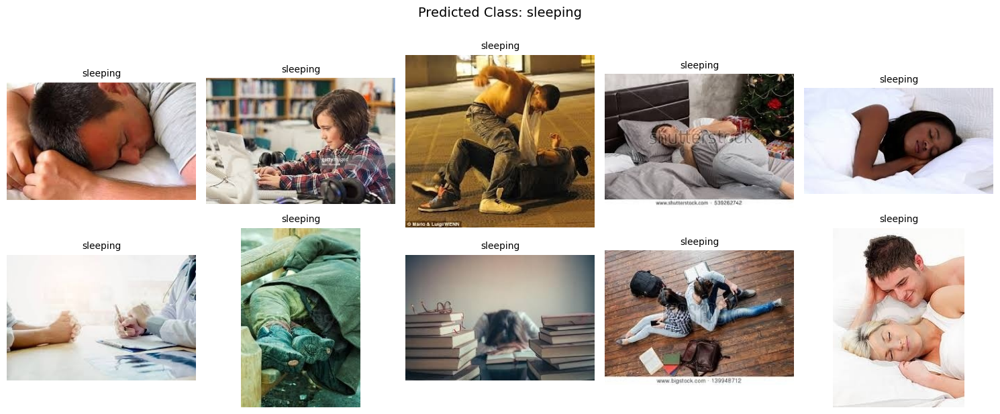

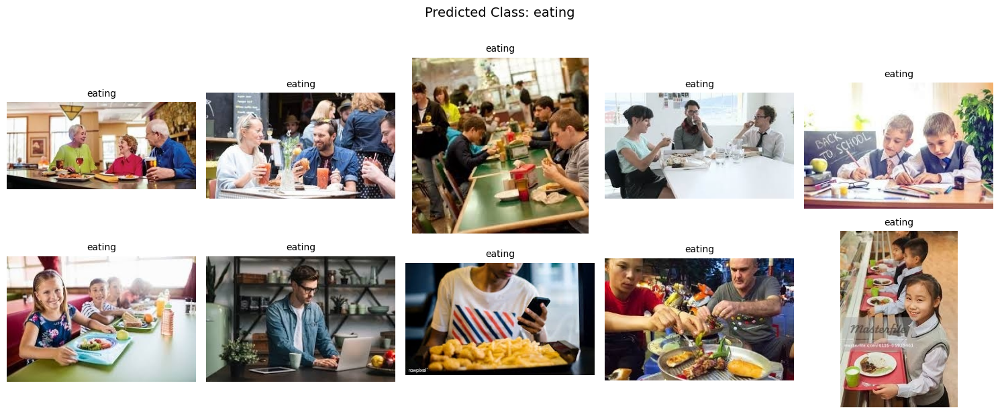

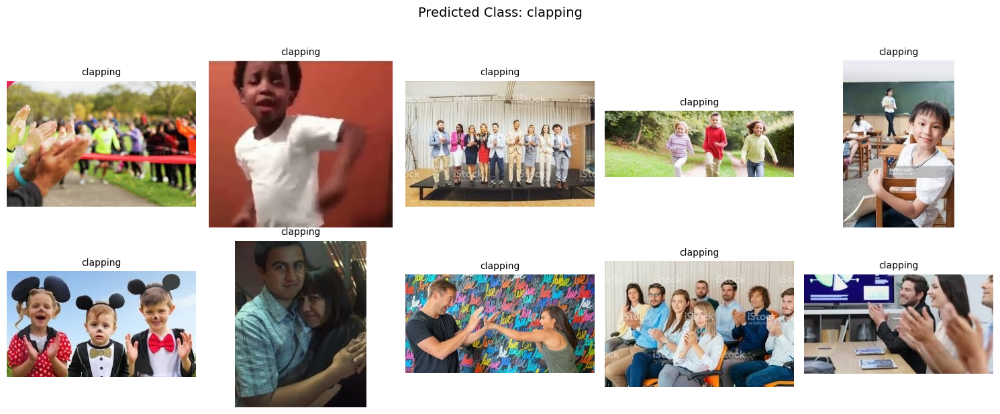

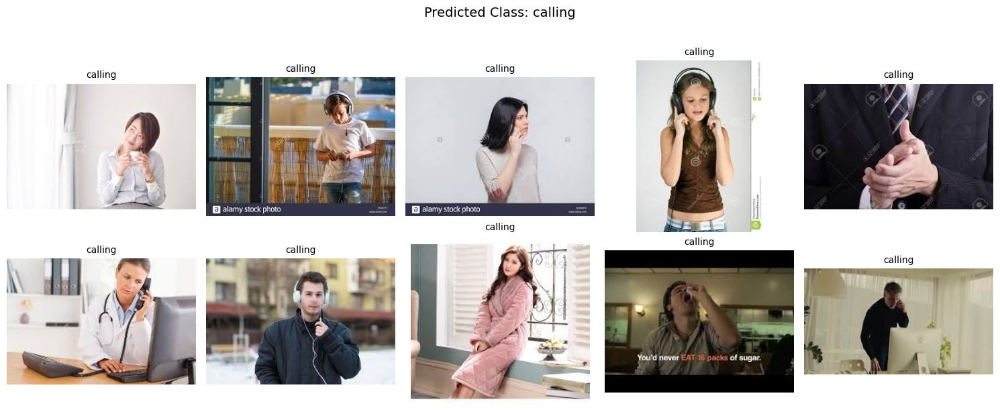

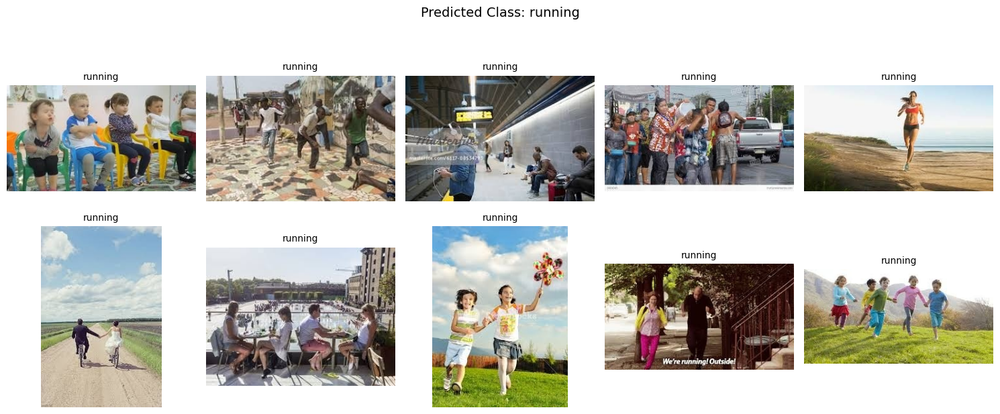

...

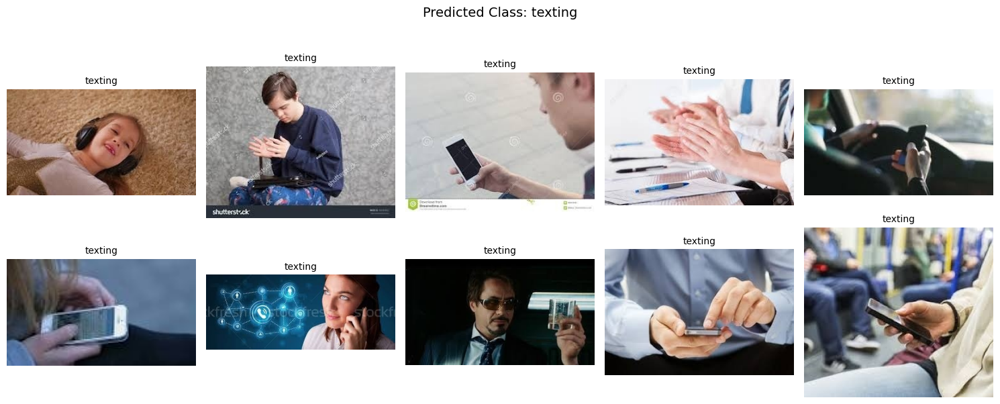

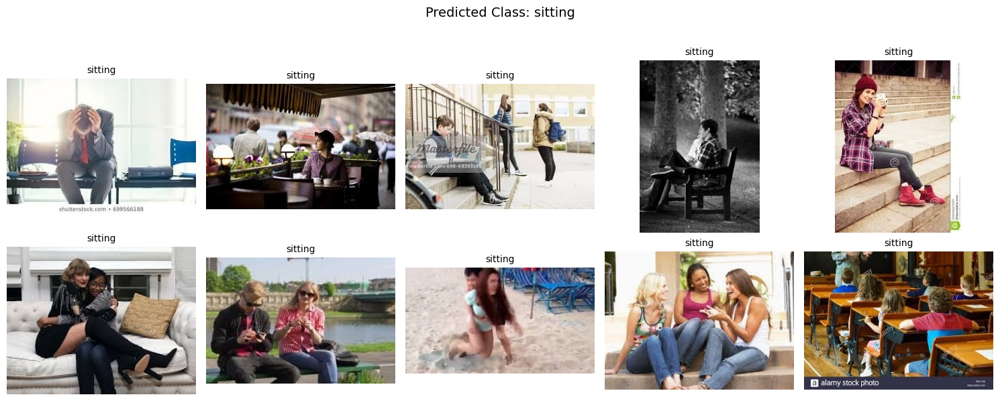

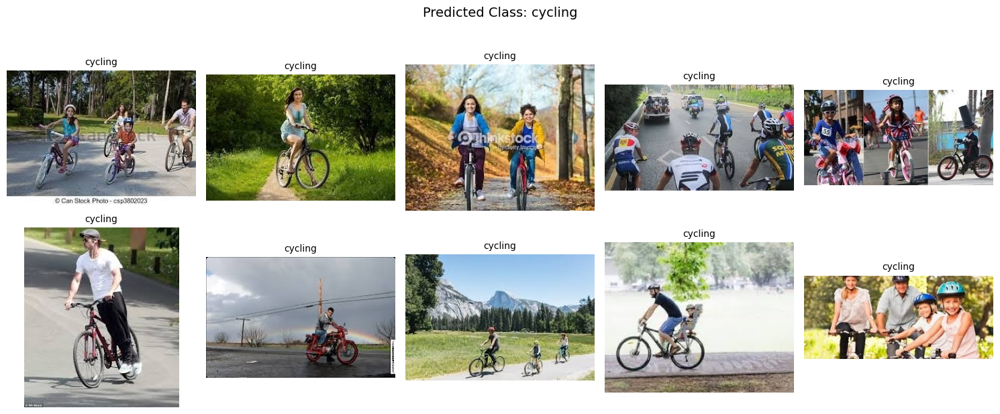

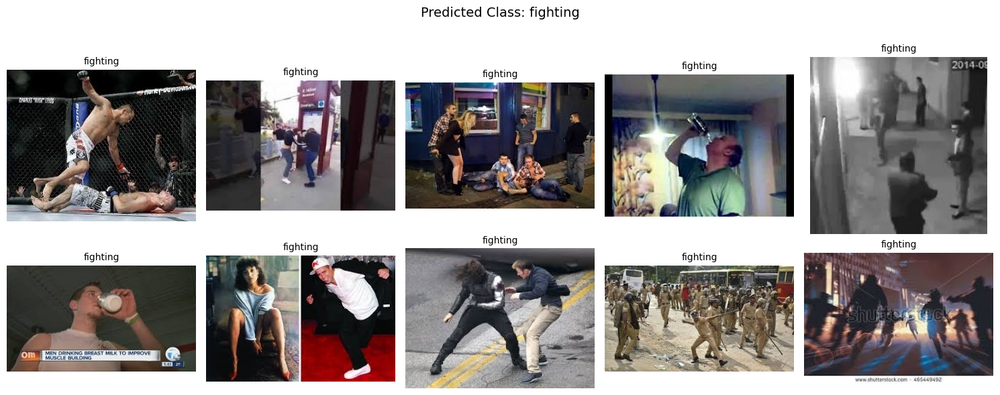

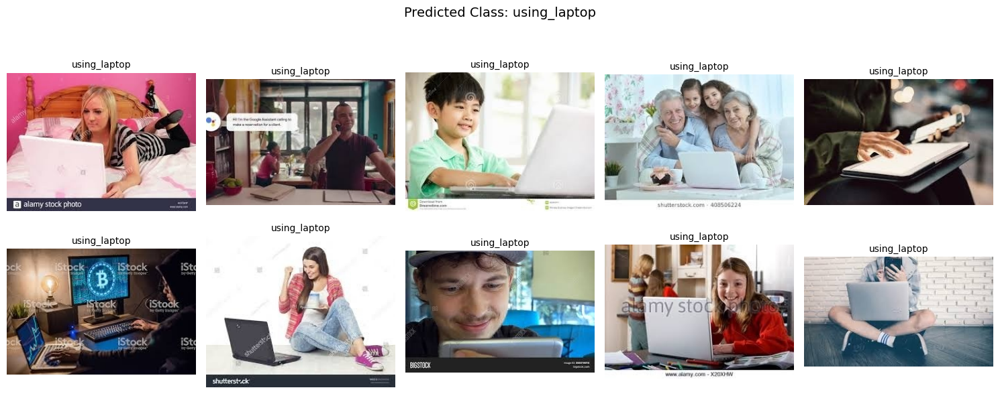

All VGG19 prediction (on test data) sample plots saved & uploaded.


In [35]:
import math
os.makedirs('plots', exist_ok=True)

num_samples_per_class = 10
unique_classes = results_df['predicted_class'].unique()

for label in unique_classes:
    sub_df = results_df[results_df['predicted_class'] == label]
    sample_df = sub_df.sample(min(num_samples_per_class, len(sub_df)), random_state=42)

    n_samples = len(sample_df)
    n_cols = 5
    n_rows = math.ceil(n_samples / n_cols)

    plt.figure(figsize=(3 * n_cols, 3 * n_rows))

    for i, (_, row) in enumerate(sample_df.iterrows()):
        img_path = f'raw/images/test/{row["filename"]}'
        img_bytes = bucket.blob(img_path).download_as_bytes()
        img = Image.open(BytesIO(img_bytes))

        plt.subplot(n_rows, n_cols, i + 1)
        plt.imshow(img)
        plt.title(f'{label}', fontsize=10)
        plt.axis('off')

    plt.suptitle(f'Predicted Class: {label}', fontsize=14, y=1.02)
    plt.tight_layout()

    plot_filename = f'plots/vgg19_svm_predicted_{label}.png'
    plt.savefig(plot_filename, bbox_inches='tight')
    plt.show()


    bucket.blob(f'results/plots/vgg19_svm_predicted_{label}.png').upload_from_filename(plot_filename)

print("All VGG19 prediction (on test data) sample plots saved & uploaded.")

In [36]:
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np


decoded_y_val = label_encoder.inverse_transform(y_val)
decoded_y_val_pred = label_encoder.inverse_transform(y_val_pred)

In [37]:
print("Classification Report:")
print(classification_report(decoded_y_val, decoded_y_val_pred))

Classification Report:
                    precision    recall  f1-score   support

           calling       0.38      0.50      0.43       168
          clapping       0.53      0.62      0.57       168
           cycling       0.95      0.98      0.97       168
           dancing       0.64      0.67      0.65       168
          drinking       0.58      0.60      0.59       168
            eating       0.81      0.78      0.79       168
          fighting       0.67      0.68      0.68       168
           hugging       0.54      0.54      0.54       168
          laughing       0.59      0.59      0.59       168
listening_to_music       0.40      0.38      0.39       168
           running       0.80      0.73      0.77       168
           sitting       0.46      0.40      0.43       168
          sleeping       0.79      0.74      0.76       168
           texting       0.45      0.40      0.43       168
      using_laptop       0.69      0.57      0.62       168

          accur

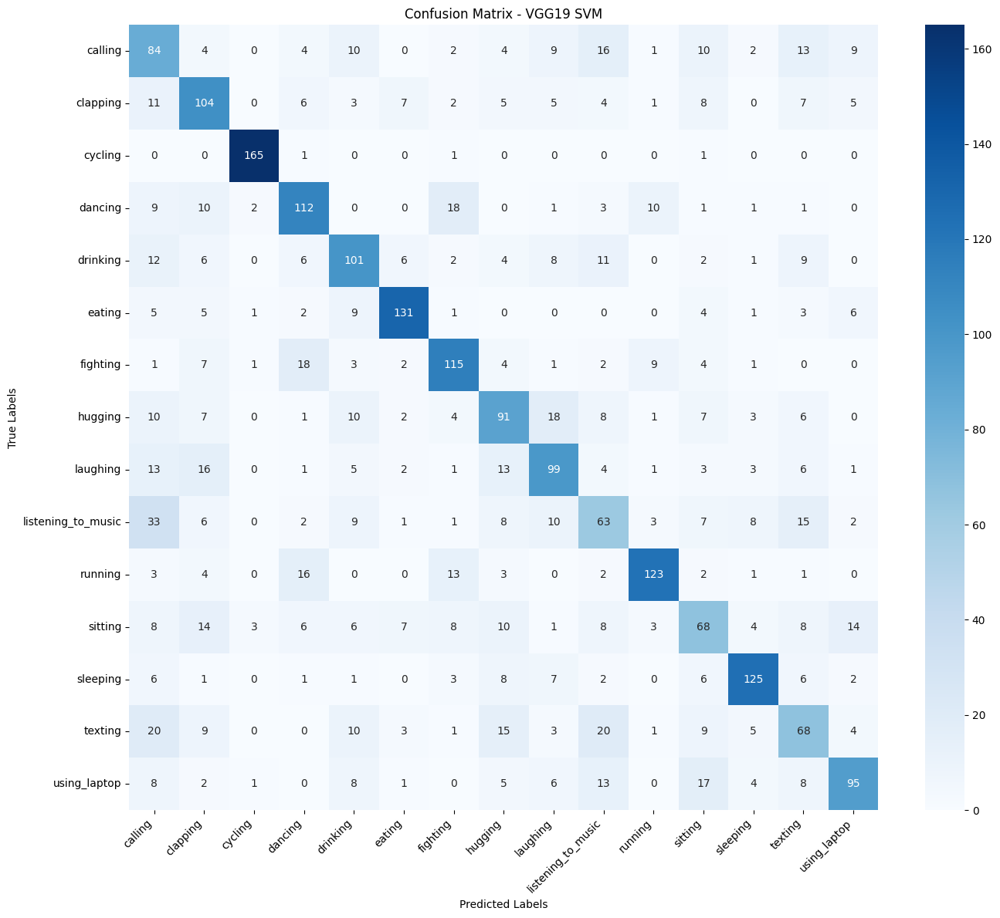

In [38]:
cm = confusion_matrix(decoded_y_val, decoded_y_val_pred, labels=label_encoder.classes_)

plt.figure(figsize=(14, 12))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=label_encoder.classes_,
            yticklabels=label_encoder.classes_)

plt.title("Confusion Matrix - VGG19 SVM")
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.xticks(rotation=45, ha='right')
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

Observation from 10 samples on predicted class label:

1. sleeping: 6 out of 10 image correct (incorrect prediction: fighting, sitting, unidentified - studying)
2. eating: 8 out of 10 image correct (incorrect prediction: studying and using laptop. Both pictures have small food element: apples and red peppers in the respective image)
3. clapping: 6 out of 10 image correct (incorrect prediction: dancing, running, sitting, hugging, fighting)
4. calling: 4 out of 10 image correct (incorrect prediction: drinking, listening to music, listening to music, clapping, sitting, singing)
5. running: 4 out of 10 image correct (incorrect prediction: sitting, fighting, sitting, unidentified - standing, unidentified - cycling, sitting)
6. hugging: 9 out of 10 image correct (incorrect prediction: unidentified - self hug or smiling or standing)
7. laughing: 8 out of 10 image correct (incorrect prediction: clapping, drinking)
8. drinking: 4 out of 10 image correct (incorrect prediction: laughing, hugging, calling (with tiny element: orange juice on table), texting, smiling or laughing, texting)
9. dancing: 4 out of 10 image correct (incorrect prediction: fighting, fighting, sleeping, fighting)
10. listening_to_music: 4 out of 10 image correct (incorrect prediction: using laptop, fighting, calling, calling, calling, unidentified- smiling or laughing)
11. texting: 5 out of 10 image correct (incorrect prediction: listening to music, clapping, clapping, calling, drinking)
12. sitting: 9 out of 10 image correct (incorrect prediction: running)
13. cycling: 10 out of 10 image correct
14. fighting: 6 out of 10 image correct (incorrect prediction: drinking, drinking, sitting and dancing)
15. using_laptop: 9 out of 10 image correct (incorrect prediction: calling)



In [47]:
decoded_y_val = label_encoder.inverse_transform(y_val)
decoded_y_val_pred = label_encoder.inverse_transform(y_val_pred)

vgg19_report_dict = classification_report(decoded_y_val, decoded_y_val_pred, output_dict=True)

vgg19_report_df = pd.DataFrame(vgg19_report_dict).transpose()

vgg19_report_df.to_csv('classification_report_vgg19.csv')

bucket.blob('results/classification_report_vgg19.csv').upload_from_filename('classification_report_vgg19.csv')

print("VGG19+SVM classification report saved and uploaded.")

VGG19+SVM classification report saved and uploaded.


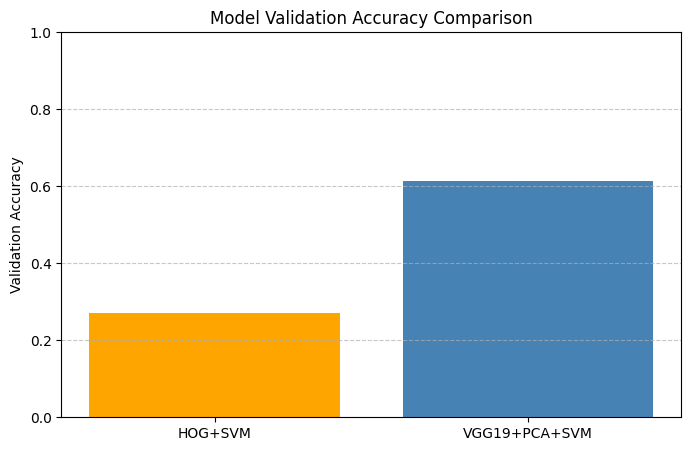

In [48]:
models = ['HOG+SVM', 'VGG19+PCA+SVM']
accuracies = [0.2710, 0.6127]

plt.figure(figsize=(8, 5))
plt.bar(models, accuracies, color=['orange', 'steelblue'])
plt.ylabel('Validation Accuracy')
plt.ylim(0, 1)
plt.title('Model Validation Accuracy Comparison')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

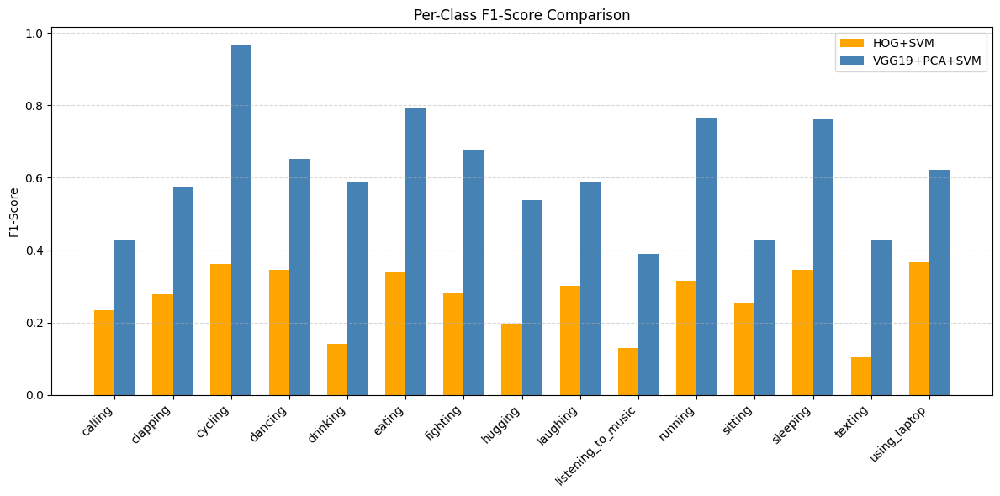

In [49]:
hog_report_df = pd.read_csv('classification_report_hog.csv', index_col=0)
vgg19_report_df = pd.read_csv('classification_report_vgg19.csv', index_col=0)

classes = [label for label in vgg19_report_df.index if label not in ['accuracy', 'macro avg', 'weighted avg']]
hog_f1 = hog_report_df.loc[classes, 'f1-score']
vgg19_f1 = vgg19_report_df.loc[classes, 'f1-score']

x = np.arange(len(classes))
width = 0.35

plt.figure(figsize=(12, 6))
plt.bar(x - width/2, hog_f1, width, label='HOG+SVM', color='orange')
plt.bar(x + width/2, vgg19_f1, width, label='VGG19+PCA+SVM', color='steelblue')

plt.ylabel('F1-Score')
plt.title('Per-Class F1-Score Comparison')
plt.xticks(x, classes, rotation=45, ha='right')
plt.legend()
plt.grid(axis='y', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()

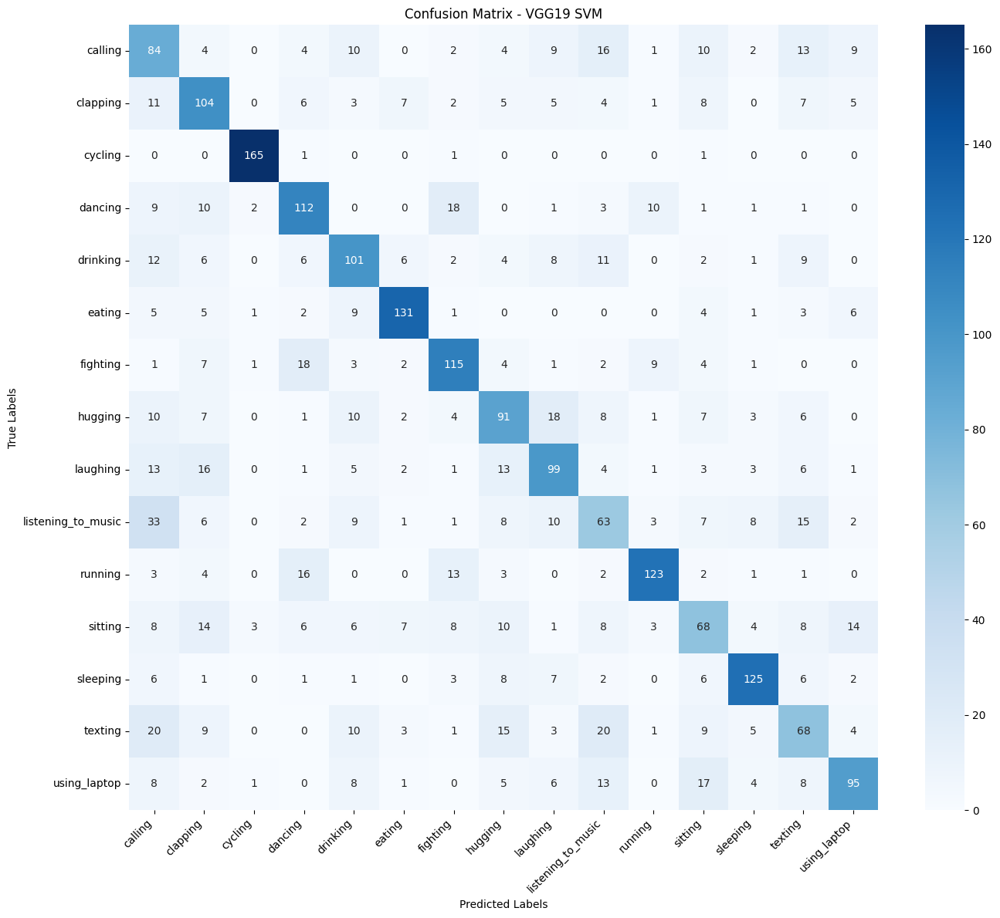

In [50]:
plt.figure(figsize=(14, 12))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=label_encoder.classes_,
            yticklabels=label_encoder.classes_)
plt.title("Confusion Matrix - VGG19 SVM")
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.xticks(rotation=45, ha='right')
plt.yticks(rotation=0)
plt.tight_layout()
plt.savefig('confusion_matrix_vgg19.png')

bucket.blob('results/confusion_matrix_vgg19.png').upload_from_filename('confusion_matrix_vgg19.png')

# First attempt
SVM-Hog model without train-test split (100% accuracy during training).
Test result was horrible, 10 images produced all unrelated.

In [ ]:
import numpy as np
import pandas as pd
import cv2
from PIL import Image
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from skimage.feature import hog
from tensorflow.keras.applications.vgg19 import VGG19, preprocess_input
from tensorflow.keras.preprocessing import image
from sklearn.decomposition import PCA
import joblib

from io import BytesIO, StringIO
from tqdm import tqdm

import matplotlib.pyplot as plt
import seaborn as sns
import math
import os

In [ ]:
def load_csv_from_gcs(path):
    blob = bucket.blob(path)
    content = blob.download_as_text()
    return pd.read_csv(StringIO(content))

train_df = load_csv_from_gcs('raw/images/Training_set.csv')
test_df = load_csv_from_gcs('raw/images/Testing_set.csv')

In [ ]:
label_encoder = LabelEncoder()
train_df['encoded_label'] = label_encoder.fit_transform(train_df['label'])
joblib.dump(label_encoder, 'label_encoder.joblib')
bucket.blob('processed/labels/label_encoder.joblib').upload_from_filename('label_encoder.joblib')

In [ ]:
def load_image_from_gcs(path, size=(224,224), as_array=True):
    blob = bucket.blob(path)
    img_bytes = blob.download_as_bytes()
    img = Image.open(BytesIO(img_bytes)).convert('RGB').resize(size)
    return np.array(img) if as_array else img

In [ ]:
def extract_hog_features(img_array):
    gray = cv2.cvtColor(img_array, cv2.COLOR_RGB2GRAY)
    features = hog(gray, orientations=9, pixels_per_cell=(8,8), cells_per_block=(2,2),
                   block_norm='L2-Hys', feature_vector=True)
    return features

In [ ]:
vgg_model = VGG19(weights='imagenet', include_top=False, pooling='avg')

def extract_vgg19_features(img_array):
    img_array = preprocess_input(img_array)
    features = vgg_model.predict(np.expand_dims(img_array, axis=0))
    return features.flatten()

80134624/80134624 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


## HOG

In [ ]:
X_train_hog, y_train_hog = [], []
for _, row in tqdm(train_df.iterrows(), total=len(train_df)):
    img = load_image_from_gcs(f'raw/images/train/{row["filename"]}')
    features = extract_hog_features(img)
    X_train_hog.append(features)
    y_train_hog.append(row['encoded_label'])

np.save('X_train_hog.npy', np.array(X_train_hog))
np.save('y_train_hog.npy', np.array(y_train_hog))
bucket.blob('processed/features/X_train_hog.npy').upload_from_filename('X_train_hog.npy')
bucket.blob('processed/features/y_train_hog.npy').upload_from_filename('y_train_hog.npy')

100%|██████████| 12600/12600 [1:11:52<00:00,  2.92it/s]


In [ ]:
X_test_hog, filenames_test = [], []

for _, row in tqdm(test_df.iterrows(), total=len(test_df)):
    img = load_image_from_gcs(f'raw/images/test/{row["filename"]}')
    features = extract_hog_features(img)
    X_test_hog.append(features)
    filenames_test.append(row['filename'])

# Save test HOG features
np.save('X_test_hog.npy', np.array(X_test_hog))

# Save test filenames to keep track
pd.DataFrame({'filename': filenames_test}).to_csv('test_filenames.csv', index=False)

# Upload both to GCS
bucket.blob('processed/features/X_test_hog.npy').upload_from_filename('X_test_hog.npy')
bucket.blob('processed/features/test_filenames.csv').upload_from_filename('test_filenames.csv')

100%|██████████| 5400/5400 [30:03<00:00,  2.99it/s]


## VGG19

In [ ]:
X_train_vgg, y_train_vgg = [], []
for _, row in tqdm(train_df.iterrows(), total=len(train_df)):
    img = load_image_from_gcs(f'raw/images/train/{row["filename"]}')
    features = extract_vgg19_features(img)
    X_train_vgg.append(features)
    y_train_vgg.append(row['encoded_label'])

np.save('X_train_vgg19.npy', np.array(X_train_vgg))
np.save('y_train_vgg19.npy', np.array(y_train_vgg))
bucket.blob('processed/features/X_train_vgg19.npy').upload_from_filename('X_train_vgg19.npy')
bucket.blob('processed/features/y_train_vgg19.npy').upload_from_filename('y_train_vgg19.npy')

  0%|          | 0/12600 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step


  0%|          | 1/12600 [00:01<3:35:50,  1.03s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


  0%|          | 2/12600 [00:01<2:38:46,  1.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


  0%|          | 3/12600 [00:02<2:20:14,  1.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


  0%|          | 4/12600 [00:02<2:18:45,  1.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


  0%|          | 5/12600 [00:03<2:12:16,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


  0%|          | 6/12600 [00:04<2:11:38,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


  0%|          | 7/12600 [00:04<2:07:36,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  0%|          | 8/12600 [00:05<2:02:48,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


  0%|          | 9/12600 [00:05<1:58:15,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  0%|          | 10/12600 [00:06<2:06:20,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  0%|          | 11/12600 [00:06<2:02:13,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  0%|          | 12/12600 [00:07<2:00:13,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  0%|          | 13/12600 [00:07<1:59:02,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  0%|          | 14/12600 [00:08<1:58:27,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  0%|          | 15/12600 [00:09<1:58:38,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  0%|          | 16/12600 [00:09<1:56:24,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  0%|          | 17/12600 [00:10<1:58:18,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  0%|          | 18/12600 [00:10<1:55:55,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  0%|          | 19/12600 [00:11<1:56:15,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  0%|          | 20/12600 [00:11<1:54:29,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  0%|          | 21/12600 [00:12<1:58:01,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  0%|          | 22/12600 [00:12<1:58:17,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


  0%|          | 23/12600 [00:13<2:08:11,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  0%|          | 24/12600 [00:14<2:04:40,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


  0%|          | 25/12600 [00:14<2:04:01,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


  0%|          | 26/12600 [00:15<2:03:07,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


  0%|          | 27/12600 [00:16<2:05:12,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


  0%|          | 28/12600 [00:16<2:05:17,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


  0%|          | 29/12600 [00:17<2:07:25,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  0%|          | 30/12600 [00:17<2:03:12,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  0%|          | 31/12600 [00:18<2:01:10,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  0%|          | 32/12600 [00:18<2:00:24,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  0%|          | 33/12600 [00:19<1:59:14,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  0%|          | 34/12600 [00:20<1:56:51,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


  0%|          | 35/12600 [00:20<1:55:48,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  0%|          | 36/12600 [00:21<2:01:48,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  0%|          | 37/12600 [00:21<2:07:27,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  0%|          | 38/12600 [00:22<2:04:19,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  0%|          | 39/12600 [00:23<2:02:08,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  0%|          | 40/12600 [00:23<2:07:08,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  0%|          | 41/12600 [00:24<2:08:57,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  0%|          | 42/12600 [00:24<2:03:41,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  0%|          | 43/12600 [00:25<2:00:16,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  0%|          | 44/12600 [00:25<2:00:04,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  0%|          | 45/12600 [00:26<1:57:18,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  0%|          | 46/12600 [00:27<1:56:14,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  0%|          | 47/12600 [00:27<1:53:34,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


  0%|          | 48/12600 [00:28<1:55:12,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


  0%|          | 49/12600 [00:28<2:02:07,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


  0%|          | 50/12600 [00:29<2:00:20,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


  0%|          | 51/12600 [00:29<2:01:35,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  0%|          | 52/12600 [00:30<1:58:07,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  0%|          | 53/12600 [00:30<1:57:13,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  0%|          | 54/12600 [00:31<1:55:56,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  0%|          | 55/12600 [00:32<1:57:10,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  0%|          | 56/12600 [00:32<1:59:55,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  0%|          | 57/12600 [00:33<1:57:51,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  0%|          | 58/12600 [00:33<1:57:14,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  0%|          | 59/12600 [00:34<1:55:55,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  0%|          | 60/12600 [00:34<1:53:16,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  0%|          | 61/12600 [00:35<1:51:19,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


  0%|          | 62/12600 [00:35<1:53:01,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  0%|          | 63/12600 [00:36<1:54:08,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  1%|          | 64/12600 [00:37<1:54:53,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  1%|          | 65/12600 [00:37<1:55:11,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  1%|          | 66/12600 [00:38<1:55:42,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  1%|          | 67/12600 [00:38<1:58:38,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  1%|          | 68/12600 [00:39<1:57:34,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  1%|          | 69/12600 [00:39<1:58:02,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


  1%|          | 70/12600 [00:40<1:58:17,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


  1%|          | 71/12600 [00:41<2:03:06,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


  1%|          | 72/12600 [00:41<2:07:06,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


  1%|          | 73/12600 [00:42<2:09:03,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


  1%|          | 74/12600 [00:42<2:04:31,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  1%|          | 75/12600 [00:43<2:04:17,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  1%|          | 76/12600 [00:44<2:00:53,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  1%|          | 77/12600 [00:44<1:58:26,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  1%|          | 78/12600 [00:45<1:57:38,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


  1%|          | 79/12600 [00:45<1:56:01,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  1%|          | 80/12600 [00:46<1:56:14,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  1%|          | 81/12600 [00:46<1:56:18,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  1%|          | 82/12600 [00:47<1:54:41,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  1%|          | 83/12600 [00:47<1:56:32,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  1%|          | 84/12600 [00:48<1:56:09,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  1%|          | 85/12600 [00:49<1:55:37,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  1%|          | 86/12600 [00:49<1:57:32,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  1%|          | 87/12600 [00:50<1:57:39,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  1%|          | 88/12600 [00:50<1:57:08,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  1%|          | 89/12600 [00:51<1:55:42,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  1%|          | 90/12600 [00:51<1:55:59,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  1%|          | 91/12600 [00:52<1:57:34,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


  1%|          | 92/12600 [00:53<2:00:36,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


  1%|          | 93/12600 [00:53<2:06:07,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


  1%|          | 94/12600 [00:54<2:02:30,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


  1%|          | 95/12600 [00:54<2:01:48,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


  1%|          | 96/12600 [00:55<1:59:16,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  1%|          | 97/12600 [00:55<1:58:10,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


  1%|          | 98/12600 [00:56<1:59:30,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  1%|          | 99/12600 [00:57<1:58:10,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  1%|          | 100/12600 [00:57<2:02:07,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  1%|          | 101/12600 [00:58<1:59:44,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  1%|          | 102/12600 [00:58<1:57:53,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  1%|          | 103/12600 [00:59<1:55:12,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  1%|          | 104/12600 [00:59<1:54:40,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  1%|          | 105/12600 [01:00<1:54:25,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  1%|          | 106/12600 [01:00<1:52:44,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  1%|          | 107/12600 [01:01<1:51:13,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


  1%|          | 108/12600 [01:01<1:51:47,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  1%|          | 109/12600 [01:02<1:59:15,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  1%|          | 110/12600 [01:03<1:56:33,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  1%|          | 111/12600 [01:03<2:10:54,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  1%|          | 112/12600 [01:04<2:04:48,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  1%|          | 113/12600 [01:05<2:01:56,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  1%|          | 114/12600 [01:05<2:05:11,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


  1%|          | 115/12600 [01:06<2:02:01,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


  1%|          | 116/12600 [01:06<2:00:23,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


  1%|          | 117/12600 [01:07<1:57:50,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


  1%|          | 118/12600 [01:07<1:58:52,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  1%|          | 119/12600 [01:08<1:57:08,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  1%|          | 120/12600 [01:09<1:59:54,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  1%|          | 121/12600 [01:09<1:59:04,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  1%|          | 122/12600 [01:10<1:56:31,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  1%|          | 123/12600 [01:10<1:55:23,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  1%|          | 124/12600 [01:11<1:53:19,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  1%|          | 125/12600 [01:11<1:51:14,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  1%|          | 126/12600 [01:12<1:51:19,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  1%|          | 127/12600 [01:12<1:51:14,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  1%|          | 128/12600 [01:13<1:52:25,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  1%|          | 129/12600 [01:13<1:53:45,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  1%|          | 130/12600 [01:14<1:54:44,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  1%|          | 131/12600 [01:15<1:57:26,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  1%|          | 132/12600 [01:15<1:54:18,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  1%|          | 133/12600 [01:16<1:53:45,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  1%|          | 134/12600 [01:16<1:53:39,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  1%|          | 135/12600 [01:17<1:54:29,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  1%|          | 136/12600 [01:17<1:55:09,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


  1%|          | 137/12600 [01:18<1:58:38,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


  1%|          | 138/12600 [01:18<1:56:59,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


  1%|          | 139/12600 [01:19<1:58:31,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


  1%|          | 140/12600 [01:20<1:58:57,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


  1%|          | 141/12600 [01:20<2:05:01,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  1%|          | 142/12600 [01:21<2:03:09,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  1%|          | 143/12600 [01:21<2:01:59,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


  1%|          | 144/12600 [01:22<1:58:04,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  1%|          | 145/12600 [01:23<1:57:36,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  1%|          | 146/12600 [01:23<1:58:56,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  1%|          | 147/12600 [01:24<1:57:34,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  1%|          | 148/12600 [01:24<1:57:13,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  1%|          | 149/12600 [01:25<1:57:40,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  1%|          | 150/12600 [01:25<1:57:19,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  1%|          | 151/12600 [01:26<1:55:34,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  1%|          | 152/12600 [01:26<1:53:08,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  1%|          | 153/12600 [01:27<1:54:56,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  1%|          | 154/12600 [01:28<1:54:17,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


  1%|          | 155/12600 [01:28<1:55:52,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  1%|          | 156/12600 [01:29<1:53:54,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  1%|          | 157/12600 [01:29<1:53:06,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  1%|▏         | 158/12600 [01:30<1:52:28,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


  1%|▏         | 159/12600 [01:30<1:55:20,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


  1%|▏         | 160/12600 [01:31<1:55:33,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


  1%|▏         | 161/12600 [01:31<1:55:48,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


  1%|▏         | 162/12600 [01:32<2:03:58,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


  1%|▏         | 163/12600 [01:33<2:02:16,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


  1%|▏         | 164/12600 [01:33<1:59:15,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  1%|▏         | 165/12600 [01:34<1:57:40,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  1%|▏         | 166/12600 [01:34<1:56:11,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  1%|▏         | 167/12600 [01:35<1:53:41,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  1%|▏         | 168/12600 [01:35<1:54:19,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  1%|▏         | 169/12600 [01:36<1:53:11,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  1%|▏         | 170/12600 [01:36<1:53:49,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  1%|▏         | 171/12600 [01:37<1:55:14,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  1%|▏         | 172/12600 [01:38<1:57:06,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  1%|▏         | 173/12600 [01:38<1:56:10,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  1%|▏         | 174/12600 [01:39<1:58:44,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  1%|▏         | 175/12600 [01:39<1:58:53,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  1%|▏         | 176/12600 [01:40<1:58:45,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  1%|▏         | 177/12600 [01:40<1:54:45,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  1%|▏         | 178/12600 [01:41<1:56:53,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  1%|▏         | 179/12600 [01:42<1:54:24,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  1%|▏         | 180/12600 [01:42<1:54:20,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  1%|▏         | 181/12600 [01:43<1:54:05,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  1%|▏         | 182/12600 [01:43<1:53:15,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


  1%|▏         | 183/12600 [01:44<1:56:01,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


  1%|▏         | 184/12600 [01:44<1:57:09,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


  1%|▏         | 185/12600 [01:45<1:57:05,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


  1%|▏         | 186/12600 [01:46<2:06:55,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  1%|▏         | 187/12600 [01:46<2:02:48,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  1%|▏         | 188/12600 [01:47<2:02:41,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  2%|▏         | 189/12600 [01:47<1:59:50,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  2%|▏         | 190/12600 [01:48<1:55:52,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  2%|▏         | 191/12600 [01:48<1:55:11,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


  2%|▏         | 192/12600 [01:49<1:54:06,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  2%|▏         | 193/12600 [01:50<1:53:42,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


  2%|▏         | 194/12600 [01:50<1:53:46,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  2%|▏         | 195/12600 [01:51<1:54:35,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  2%|▏         | 196/12600 [01:51<1:55:16,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  2%|▏         | 197/12600 [01:52<1:54:09,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  2%|▏         | 198/12600 [01:52<1:52:16,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  2%|▏         | 199/12600 [01:53<1:51:55,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  2%|▏         | 200/12600 [01:53<1:51:16,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  2%|▏         | 201/12600 [01:54<1:52:50,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  2%|▏         | 202/12600 [01:55<2:00:26,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


  2%|▏         | 203/12600 [01:55<1:58:34,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  2%|▏         | 204/12600 [01:56<1:56:35,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


  2%|▏         | 205/12600 [01:56<1:56:57,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


  2%|▏         | 206/12600 [01:57<1:55:43,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


  2%|▏         | 207/12600 [01:57<1:58:42,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


  2%|▏         | 208/12600 [01:58<1:58:04,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


  2%|▏         | 209/12600 [01:59<1:59:04,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  2%|▏         | 210/12600 [01:59<1:58:32,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  2%|▏         | 211/12600 [02:00<1:57:15,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  2%|▏         | 212/12600 [02:00<1:55:17,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  2%|▏         | 213/12600 [02:01<1:53:00,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  2%|▏         | 214/12600 [02:01<1:53:34,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  2%|▏         | 215/12600 [02:02<1:53:58,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  2%|▏         | 216/12600 [02:02<1:53:21,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  2%|▏         | 217/12600 [02:03<1:58:05,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  2%|▏         | 218/12600 [02:04<1:57:33,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  2%|▏         | 219/12600 [02:04<1:55:51,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  2%|▏         | 220/12600 [02:05<1:53:32,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  2%|▏         | 221/12600 [02:05<1:52:40,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  2%|▏         | 222/12600 [02:06<1:50:46,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  2%|▏         | 223/12600 [02:06<1:51:37,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  2%|▏         | 224/12600 [02:07<1:51:44,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  2%|▏         | 225/12600 [02:07<1:51:02,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  2%|▏         | 226/12600 [02:08<1:51:45,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  2%|▏         | 227/12600 [02:08<1:52:00,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


  2%|▏         | 228/12600 [02:09<1:53:36,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


  2%|▏         | 229/12600 [02:10<1:53:56,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


  2%|▏         | 230/12600 [02:10<1:55:11,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


  2%|▏         | 231/12600 [02:11<1:56:34,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


  2%|▏         | 232/12600 [02:11<1:58:13,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  2%|▏         | 233/12600 [02:12<1:58:41,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  2%|▏         | 234/12600 [02:12<1:56:53,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  2%|▏         | 235/12600 [02:13<1:55:58,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  2%|▏         | 236/12600 [02:13<1:54:33,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  2%|▏         | 237/12600 [02:14<1:54:35,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  2%|▏         | 238/12600 [02:15<1:53:09,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  2%|▏         | 239/12600 [02:15<1:53:00,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  2%|▏         | 240/12600 [02:16<1:51:11,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  2%|▏         | 241/12600 [02:16<1:53:42,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  2%|▏         | 242/12600 [02:17<1:53:56,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  2%|▏         | 243/12600 [02:17<1:52:19,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


  2%|▏         | 244/12600 [02:18<1:52:21,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  2%|▏         | 245/12600 [02:18<1:50:42,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


  2%|▏         | 246/12600 [02:19<1:50:46,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  2%|▏         | 247/12600 [02:19<1:50:47,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  2%|▏         | 248/12600 [02:20<1:51:53,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  2%|▏         | 249/12600 [02:21<2:00:31,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  2%|▏         | 250/12600 [02:21<1:59:37,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


  2%|▏         | 251/12600 [02:22<2:00:02,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


  2%|▏         | 252/12600 [02:22<2:00:09,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


  2%|▏         | 253/12600 [02:23<2:04:43,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


  2%|▏         | 254/12600 [02:24<2:03:44,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


  2%|▏         | 255/12600 [02:24<2:03:03,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  2%|▏         | 256/12600 [02:25<1:58:23,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  2%|▏         | 257/12600 [02:25<1:59:01,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  2%|▏         | 258/12600 [02:26<1:57:41,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  2%|▏         | 259/12600 [02:26<1:56:36,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  2%|▏         | 260/12600 [02:27<1:57:08,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  2%|▏         | 261/12600 [02:28<1:56:46,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


  2%|▏         | 262/12600 [02:28<1:56:26,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  2%|▏         | 263/12600 [02:29<1:54:37,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  2%|▏         | 264/12600 [02:29<1:59:25,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  2%|▏         | 265/12600 [02:30<1:58:52,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  2%|▏         | 266/12600 [02:30<1:55:06,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  2%|▏         | 267/12600 [02:31<2:00:35,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  2%|▏         | 268/12600 [02:32<2:03:13,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  2%|▏         | 269/12600 [02:32<2:00:52,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  2%|▏         | 270/12600 [02:33<2:01:05,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  2%|▏         | 271/12600 [02:33<1:59:18,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  2%|▏         | 272/12600 [02:34<1:59:39,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


  2%|▏         | 273/12600 [02:35<1:58:17,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


  2%|▏         | 274/12600 [02:35<1:56:28,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


  2%|▏         | 275/12600 [02:36<1:56:43,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


  2%|▏         | 276/12600 [02:36<1:57:24,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


  2%|▏         | 277/12600 [02:37<1:56:27,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  2%|▏         | 278/12600 [02:37<1:54:59,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  2%|▏         | 279/12600 [02:38<1:59:58,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


  2%|▏         | 280/12600 [02:39<1:59:10,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  2%|▏         | 281/12600 [02:39<1:56:48,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  2%|▏         | 282/12600 [02:40<1:56:29,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  2%|▏         | 283/12600 [02:40<1:54:56,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  2%|▏         | 284/12600 [02:41<1:54:08,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  2%|▏         | 285/12600 [02:41<1:52:46,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  2%|▏         | 286/12600 [02:42<1:52:20,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  2%|▏         | 287/12600 [02:42<1:51:12,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  2%|▏         | 288/12600 [02:43<1:49:46,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  2%|▏         | 289/12600 [02:43<1:49:16,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  2%|▏         | 290/12600 [02:44<1:51:56,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  2%|▏         | 291/12600 [02:45<1:53:47,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  2%|▏         | 292/12600 [02:45<1:55:38,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  2%|▏         | 293/12600 [02:46<2:01:12,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  2%|▏         | 294/12600 [02:46<2:00:54,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  2%|▏         | 295/12600 [02:47<2:00:22,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


  2%|▏         | 296/12600 [02:48<2:01:31,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


  2%|▏         | 297/12600 [02:48<2:00:00,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


  2%|▏         | 298/12600 [02:49<1:59:13,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


  2%|▏         | 299/12600 [02:49<1:59:15,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  2%|▏         | 300/12600 [02:50<1:57:38,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  2%|▏         | 301/12600 [02:50<1:54:49,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  2%|▏         | 302/12600 [02:51<1:53:44,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  2%|▏         | 303/12600 [02:52<1:54:33,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


  2%|▏         | 304/12600 [02:52<1:54:45,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  2%|▏         | 305/12600 [02:53<1:55:20,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  2%|▏         | 306/12600 [02:53<1:55:21,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  2%|▏         | 307/12600 [02:54<1:55:21,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  2%|▏         | 308/12600 [02:54<1:54:25,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  2%|▏         | 309/12600 [02:55<1:54:02,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  2%|▏         | 310/12600 [02:55<1:53:46,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  2%|▏         | 311/12600 [02:56<1:52:34,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  2%|▏         | 312/12600 [02:57<1:53:19,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


  2%|▏         | 313/12600 [02:57<2:00:28,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  2%|▏         | 314/12600 [02:58<1:58:32,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  2%|▎         | 315/12600 [02:58<1:58:31,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  3%|▎         | 316/12600 [02:59<2:03:11,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  3%|▎         | 317/12600 [03:00<1:59:54,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


  3%|▎         | 318/12600 [03:00<2:00:27,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


  3%|▎         | 319/12600 [03:01<2:00:13,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


  3%|▎         | 320/12600 [03:01<2:00:12,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


  3%|▎         | 321/12600 [03:02<1:59:22,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


  3%|▎         | 322/12600 [03:02<1:59:24,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  3%|▎         | 323/12600 [03:03<2:02:48,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  3%|▎         | 324/12600 [03:04<2:01:15,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  3%|▎         | 325/12600 [03:04<1:58:35,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  3%|▎         | 326/12600 [03:05<1:58:15,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  3%|▎         | 327/12600 [03:05<1:57:56,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  3%|▎         | 328/12600 [03:06<1:56:14,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  3%|▎         | 329/12600 [03:07<1:57:03,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  3%|▎         | 330/12600 [03:07<2:02:06,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  3%|▎         | 331/12600 [03:08<2:01:36,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  3%|▎         | 332/12600 [03:08<2:00:26,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  3%|▎         | 333/12600 [03:09<1:58:16,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  3%|▎         | 334/12600 [03:09<1:56:15,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  3%|▎         | 335/12600 [03:10<1:53:17,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  3%|▎         | 336/12600 [03:11<1:52:54,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  3%|▎         | 337/12600 [03:11<1:51:22,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  3%|▎         | 338/12600 [03:12<1:52:30,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  3%|▎         | 339/12600 [03:12<1:50:18,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


  3%|▎         | 340/12600 [03:13<1:52:17,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


  3%|▎         | 341/12600 [03:13<1:56:32,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


  3%|▎         | 342/12600 [03:14<1:57:15,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


  3%|▎         | 343/12600 [03:14<1:56:35,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


  3%|▎         | 344/12600 [03:15<1:56:44,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  3%|▎         | 345/12600 [03:16<1:57:52,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  3%|▎         | 346/12600 [03:16<2:01:09,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  3%|▎         | 347/12600 [03:17<2:05:32,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  3%|▎         | 348/12600 [03:17<2:00:46,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


  3%|▎         | 349/12600 [03:18<2:03:30,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  3%|▎         | 350/12600 [03:19<2:00:58,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


  3%|▎         | 351/12600 [03:19<2:01:20,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  3%|▎         | 352/12600 [03:20<2:05:57,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


  3%|▎         | 353/12600 [03:20<2:02:00,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


  3%|▎         | 354/12600 [03:21<1:58:07,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  3%|▎         | 355/12600 [03:22<1:55:31,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


  3%|▎         | 356/12600 [03:22<1:55:10,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  3%|▎         | 357/12600 [03:23<1:54:39,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  3%|▎         | 358/12600 [03:23<1:53:35,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  3%|▎         | 359/12600 [03:24<1:52:37,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  3%|▎         | 360/12600 [03:24<1:51:38,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  3%|▎         | 361/12600 [03:25<1:50:33,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


  3%|▎         | 362/12600 [03:25<1:52:11,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


  3%|▎         | 363/12600 [03:26<1:54:21,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


  3%|▎         | 364/12600 [03:27<1:59:47,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


  3%|▎         | 365/12600 [03:27<1:59:53,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


  3%|▎         | 366/12600 [03:28<2:04:37,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  3%|▎         | 367/12600 [03:28<2:05:57,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  3%|▎         | 368/12600 [03:29<2:01:39,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  3%|▎         | 369/12600 [03:30<1:59:09,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  3%|▎         | 370/12600 [03:30<1:54:54,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  3%|▎         | 371/12600 [03:31<2:00:18,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  3%|▎         | 372/12600 [03:31<1:59:29,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


  3%|▎         | 373/12600 [03:32<1:56:25,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  3%|▎         | 374/12600 [03:32<1:56:32,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  3%|▎         | 375/12600 [03:33<1:54:56,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


  3%|▎         | 376/12600 [03:34<1:53:51,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  3%|▎         | 377/12600 [03:34<1:53:55,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  3%|▎         | 378/12600 [03:35<1:53:32,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  3%|▎         | 379/12600 [03:35<1:52:52,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  3%|▎         | 380/12600 [03:36<1:53:55,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  3%|▎         | 381/12600 [03:36<1:54:04,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  3%|▎         | 382/12600 [03:37<1:52:35,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  3%|▎         | 383/12600 [03:37<1:55:19,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  3%|▎         | 384/12600 [03:38<1:55:17,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


  3%|▎         | 385/12600 [03:39<1:58:26,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


  3%|▎         | 386/12600 [03:39<1:57:20,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


  3%|▎         | 387/12600 [03:40<1:59:13,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


  3%|▎         | 388/12600 [03:40<1:59:31,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  3%|▎         | 389/12600 [03:41<1:55:44,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  3%|▎         | 390/12600 [03:42<1:55:50,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  3%|▎         | 391/12600 [03:42<1:53:19,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  3%|▎         | 392/12600 [03:43<1:52:04,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


  3%|▎         | 393/12600 [03:43<1:50:23,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  3%|▎         | 394/12600 [03:44<1:49:17,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  3%|▎         | 395/12600 [03:44<1:49:26,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  3%|▎         | 396/12600 [03:45<1:50:42,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  3%|▎         | 397/12600 [03:45<1:52:31,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  3%|▎         | 398/12600 [03:46<1:51:48,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  3%|▎         | 399/12600 [03:46<1:53:25,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  3%|▎         | 400/12600 [03:47<1:52:49,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  3%|▎         | 401/12600 [03:48<1:55:46,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  3%|▎         | 402/12600 [03:48<1:54:40,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  3%|▎         | 403/12600 [03:49<1:52:59,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  3%|▎         | 404/12600 [03:49<1:57:06,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  3%|▎         | 405/12600 [03:50<1:55:52,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  3%|▎         | 406/12600 [03:50<1:55:58,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


  3%|▎         | 407/12600 [03:51<1:55:53,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


  3%|▎         | 408/12600 [03:52<2:02:20,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


  3%|▎         | 409/12600 [03:52<2:04:44,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


  3%|▎         | 410/12600 [03:53<2:03:24,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


  3%|▎         | 411/12600 [03:53<2:00:58,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  3%|▎         | 412/12600 [03:54<1:58:01,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  3%|▎         | 413/12600 [03:55<1:56:02,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  3%|▎         | 414/12600 [03:55<1:54:20,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  3%|▎         | 415/12600 [03:56<1:54:10,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  3%|▎         | 416/12600 [03:56<1:52:12,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  3%|▎         | 417/12600 [03:57<1:50:42,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  3%|▎         | 418/12600 [03:57<1:52:12,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  3%|▎         | 419/12600 [03:58<1:53:16,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  3%|▎         | 420/12600 [03:58<1:52:10,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  3%|▎         | 421/12600 [03:59<1:52:58,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  3%|▎         | 422/12600 [04:00<1:51:55,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  3%|▎         | 423/12600 [04:00<2:00:05,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  3%|▎         | 424/12600 [04:01<2:02:21,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


  3%|▎         | 425/12600 [04:01<1:59:56,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  3%|▎         | 426/12600 [04:02<1:57:19,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


  3%|▎         | 427/12600 [04:03<2:03:27,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  3%|▎         | 428/12600 [04:03<2:00:44,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


  3%|▎         | 429/12600 [04:04<1:58:26,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


  3%|▎         | 430/12600 [04:04<2:03:30,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


  3%|▎         | 431/12600 [04:05<2:02:00,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


  3%|▎         | 432/12600 [04:06<1:58:57,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


  3%|▎         | 433/12600 [04:06<2:03:18,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  3%|▎         | 434/12600 [04:07<1:59:42,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  3%|▎         | 435/12600 [04:07<1:57:09,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  3%|▎         | 436/12600 [04:08<1:55:14,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  3%|▎         | 437/12600 [04:08<1:56:43,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  3%|▎         | 438/12600 [04:09<1:54:27,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  3%|▎         | 439/12600 [04:10<1:53:02,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  3%|▎         | 440/12600 [04:10<1:50:51,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  4%|▎         | 441/12600 [04:11<1:50:31,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  4%|▎         | 442/12600 [04:11<1:51:43,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  4%|▎         | 443/12600 [04:12<1:58:36,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  4%|▎         | 444/12600 [04:12<1:55:03,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  4%|▎         | 445/12600 [04:13<1:53:30,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  4%|▎         | 446/12600 [04:13<1:53:10,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  4%|▎         | 447/12600 [04:14<2:00:14,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  4%|▎         | 448/12600 [04:15<1:58:24,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  4%|▎         | 449/12600 [04:15<1:56:10,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  4%|▎         | 450/12600 [04:16<1:53:35,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


  4%|▎         | 451/12600 [04:16<1:55:15,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


  4%|▎         | 452/12600 [04:17<1:55:58,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


  4%|▎         | 453/12600 [04:18<1:58:07,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


  4%|▎         | 454/12600 [04:18<1:57:04,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


  4%|▎         | 455/12600 [04:19<1:59:03,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


  4%|▎         | 456/12600 [04:19<1:56:51,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  4%|▎         | 457/12600 [04:20<1:54:13,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  4%|▎         | 458/12600 [04:20<1:52:21,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  4%|▎         | 459/12600 [04:21<1:59:07,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  4%|▎         | 460/12600 [04:22<1:57:21,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  4%|▎         | 461/12600 [04:22<1:55:12,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  4%|▎         | 462/12600 [04:23<2:01:05,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  4%|▎         | 463/12600 [04:23<1:58:23,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  4%|▎         | 464/12600 [04:24<1:58:33,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  4%|▎         | 465/12600 [04:24<1:56:46,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  4%|▎         | 466/12600 [04:25<1:54:08,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  4%|▎         | 467/12600 [04:26<1:52:54,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


  4%|▎         | 468/12600 [04:26<1:50:38,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  4%|▎         | 469/12600 [04:27<1:50:48,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  4%|▎         | 470/12600 [04:27<1:51:49,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  4%|▎         | 471/12600 [04:28<1:51:41,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


  4%|▎         | 472/12600 [04:28<1:52:23,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  4%|▍         | 473/12600 [04:29<1:56:50,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


  4%|▍         | 474/12600 [04:29<1:56:10,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


  4%|▍         | 475/12600 [04:30<1:56:11,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


  4%|▍         | 476/12600 [04:31<1:55:43,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


  4%|▍         | 477/12600 [04:31<1:55:50,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  4%|▍         | 478/12600 [04:32<1:55:16,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  4%|▍         | 479/12600 [04:32<1:52:51,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  4%|▍         | 480/12600 [04:33<1:53:32,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  4%|▍         | 481/12600 [04:33<1:54:53,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  4%|▍         | 482/12600 [04:34<1:53:42,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


  4%|▍         | 483/12600 [04:35<1:53:59,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  4%|▍         | 484/12600 [04:35<1:51:45,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  4%|▍         | 485/12600 [04:36<1:53:21,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  4%|▍         | 486/12600 [04:36<1:51:59,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  4%|▍         | 487/12600 [04:37<1:52:10,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  4%|▍         | 488/12600 [04:37<1:51:48,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  4%|▍         | 489/12600 [04:38<1:52:53,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  4%|▍         | 490/12600 [04:38<1:49:48,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  4%|▍         | 491/12600 [04:39<1:50:55,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  4%|▍         | 492/12600 [04:40<1:50:40,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  4%|▍         | 493/12600 [04:40<1:54:13,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  4%|▍         | 494/12600 [04:41<1:53:26,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  4%|▍         | 495/12600 [04:41<1:57:05,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


  4%|▍         | 496/12600 [04:42<1:56:15,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


  4%|▍         | 497/12600 [04:42<1:57:13,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


  4%|▍         | 498/12600 [04:43<1:56:30,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


  4%|▍         | 499/12600 [04:44<1:54:26,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


  4%|▍         | 500/12600 [04:44<1:53:19,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  4%|▍         | 501/12600 [04:45<1:52:12,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  4%|▍         | 502/12600 [04:45<2:00:45,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  4%|▍         | 503/12600 [04:46<1:56:18,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  4%|▍         | 504/12600 [04:46<1:53:47,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  4%|▍         | 505/12600 [04:47<1:58:05,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  4%|▍         | 506/12600 [04:48<1:56:52,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  4%|▍         | 507/12600 [04:48<1:54:27,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  4%|▍         | 508/12600 [04:49<1:51:12,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  4%|▍         | 509/12600 [04:49<1:53:26,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  4%|▍         | 510/12600 [04:50<1:52:06,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  4%|▍         | 511/12600 [04:50<1:50:27,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  4%|▍         | 512/12600 [04:51<1:51:32,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  4%|▍         | 513/12600 [04:51<1:50:52,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  4%|▍         | 514/12600 [04:52<1:50:33,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  4%|▍         | 515/12600 [04:53<1:49:49,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  4%|▍         | 516/12600 [04:53<1:49:49,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  4%|▍         | 517/12600 [04:54<1:50:18,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  4%|▍         | 518/12600 [04:54<1:48:05,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


  4%|▍         | 519/12600 [04:55<1:50:41,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


  4%|▍         | 520/12600 [04:55<1:52:49,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


  4%|▍         | 521/12600 [04:56<1:54:08,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


  4%|▍         | 522/12600 [04:56<1:54:52,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


  4%|▍         | 523/12600 [04:57<1:56:07,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  4%|▍         | 524/12600 [04:58<1:52:45,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


  4%|▍         | 525/12600 [04:58<1:49:52,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  4%|▍         | 526/12600 [04:59<1:50:26,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  4%|▍         | 527/12600 [04:59<1:56:14,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  4%|▍         | 528/12600 [05:00<1:56:01,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


  4%|▍         | 529/12600 [05:00<1:56:06,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  4%|▍         | 530/12600 [05:01<1:59:40,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  4%|▍         | 531/12600 [05:02<1:56:26,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  4%|▍         | 532/12600 [05:02<1:53:24,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  4%|▍         | 533/12600 [05:03<1:52:35,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  4%|▍         | 534/12600 [05:03<1:54:01,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  4%|▍         | 535/12600 [05:04<1:52:31,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  4%|▍         | 536/12600 [05:04<1:51:51,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  4%|▍         | 537/12600 [05:05<1:50:25,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  4%|▍         | 538/12600 [05:05<1:49:08,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  4%|▍         | 539/12600 [05:06<1:48:18,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  4%|▍         | 540/12600 [05:07<1:49:11,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  4%|▍         | 541/12600 [05:07<1:49:22,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


  4%|▍         | 542/12600 [05:08<1:53:38,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


  4%|▍         | 543/12600 [05:08<2:00:16,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


  4%|▍         | 544/12600 [05:09<2:04:28,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


  4%|▍         | 545/12600 [05:10<2:06:43,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  4%|▍         | 546/12600 [05:10<2:03:20,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  4%|▍         | 547/12600 [05:11<1:59:25,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  4%|▍         | 548/12600 [05:11<1:56:58,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  4%|▍         | 549/12600 [05:12<1:53:54,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  4%|▍         | 550/12600 [05:12<1:52:17,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  4%|▍         | 551/12600 [05:13<1:53:29,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


  4%|▍         | 552/12600 [05:14<1:53:03,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  4%|▍         | 553/12600 [05:14<1:51:20,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  4%|▍         | 554/12600 [05:15<1:50:00,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  4%|▍         | 555/12600 [05:15<1:50:11,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  4%|▍         | 556/12600 [05:16<1:50:23,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  4%|▍         | 557/12600 [05:16<1:52:01,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  4%|▍         | 558/12600 [05:17<1:50:53,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  4%|▍         | 559/12600 [05:17<1:50:02,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  4%|▍         | 560/12600 [05:18<2:01:31,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


  4%|▍         | 561/12600 [05:19<1:57:34,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


  4%|▍         | 562/12600 [05:19<1:55:08,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  4%|▍         | 563/12600 [05:20<1:53:24,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


  4%|▍         | 564/12600 [05:20<1:54:54,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


  4%|▍         | 565/12600 [05:21<1:53:35,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


  4%|▍         | 566/12600 [05:21<1:52:46,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


  4%|▍         | 567/12600 [05:22<1:56:26,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


  5%|▍         | 568/12600 [05:23<1:55:56,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


  5%|▍         | 569/12600 [05:23<1:52:51,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  5%|▍         | 570/12600 [05:24<1:51:53,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  5%|▍         | 571/12600 [05:24<1:50:20,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  5%|▍         | 572/12600 [05:25<1:49:35,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  5%|▍         | 573/12600 [05:25<1:50:40,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  5%|▍         | 574/12600 [05:26<1:52:37,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


  5%|▍         | 575/12600 [05:27<1:57:04,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  5%|▍         | 576/12600 [05:27<1:57:25,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  5%|▍         | 577/12600 [05:28<1:54:33,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  5%|▍         | 578/12600 [05:28<1:56:11,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  5%|▍         | 579/12600 [05:29<1:53:39,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  5%|▍         | 580/12600 [05:29<1:53:31,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  5%|▍         | 581/12600 [05:30<1:52:44,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  5%|▍         | 582/12600 [05:31<1:54:58,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  5%|▍         | 583/12600 [05:31<1:53:45,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  5%|▍         | 584/12600 [05:32<1:51:28,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  5%|▍         | 585/12600 [05:32<1:52:08,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


  5%|▍         | 586/12600 [05:33<1:54:06,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


  5%|▍         | 587/12600 [05:33<1:59:13,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


  5%|▍         | 588/12600 [05:34<2:05:02,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


  5%|▍         | 589/12600 [05:35<2:01:58,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


  5%|▍         | 590/12600 [05:35<1:59:53,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  5%|▍         | 591/12600 [05:36<1:55:18,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  5%|▍         | 592/12600 [05:36<1:55:43,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  5%|▍         | 593/12600 [05:37<1:54:10,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


  5%|▍         | 594/12600 [05:38<1:54:53,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  5%|▍         | 595/12600 [05:38<1:54:41,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  5%|▍         | 596/12600 [05:39<1:54:02,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  5%|▍         | 597/12600 [05:39<1:54:58,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  5%|▍         | 598/12600 [05:40<2:01:13,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  5%|▍         | 599/12600 [05:41<1:58:13,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


  5%|▍         | 600/12600 [05:41<1:54:48,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  5%|▍         | 601/12600 [05:42<1:53:09,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


  5%|▍         | 602/12600 [05:42<1:51:03,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  5%|▍         | 603/12600 [05:43<1:49:57,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  5%|▍         | 604/12600 [05:43<1:51:58,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  5%|▍         | 605/12600 [05:44<1:51:00,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  5%|▍         | 606/12600 [05:44<1:51:12,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


  5%|▍         | 607/12600 [05:45<1:50:58,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


  5%|▍         | 608/12600 [05:45<1:53:43,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


  5%|▍         | 609/12600 [05:46<1:52:46,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


  5%|▍         | 610/12600 [05:47<1:52:54,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


  5%|▍         | 611/12600 [05:47<1:51:19,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


  5%|▍         | 612/12600 [05:48<1:54:25,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


  5%|▍         | 613/12600 [05:48<1:53:36,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  5%|▍         | 614/12600 [05:49<1:56:49,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


  5%|▍         | 615/12600 [05:50<1:55:19,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


  5%|▍         | 616/12600 [05:50<1:54:23,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  5%|▍         | 617/12600 [05:51<1:54:13,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  5%|▍         | 618/12600 [05:51<1:55:21,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  5%|▍         | 619/12600 [05:52<1:53:17,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  5%|▍         | 620/12600 [05:52<1:52:04,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  5%|▍         | 621/12600 [05:53<1:52:05,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  5%|▍         | 622/12600 [05:53<1:50:30,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  5%|▍         | 623/12600 [05:54<1:50:03,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


  5%|▍         | 624/12600 [05:55<1:49:54,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  5%|▍         | 625/12600 [05:55<1:50:16,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


  5%|▍         | 626/12600 [05:56<1:48:30,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  5%|▍         | 627/12600 [05:56<1:48:20,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  5%|▍         | 628/12600 [05:57<1:49:11,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  5%|▍         | 629/12600 [05:57<1:50:48,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  5%|▌         | 630/12600 [05:58<1:48:26,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


  5%|▌         | 631/12600 [05:58<1:50:38,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


  5%|▌         | 632/12600 [05:59<1:52:37,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


  5%|▌         | 633/12600 [05:59<1:51:09,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


  5%|▌         | 634/12600 [06:00<1:53:34,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


  5%|▌         | 635/12600 [06:01<1:52:55,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  5%|▌         | 636/12600 [06:01<1:51:48,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  5%|▌         | 637/12600 [06:02<1:48:57,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  5%|▌         | 638/12600 [06:02<1:47:11,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  5%|▌         | 639/12600 [06:03<1:49:59,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  5%|▌         | 640/12600 [06:03<1:50:18,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  5%|▌         | 641/12600 [06:04<1:50:43,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  5%|▌         | 642/12600 [06:05<1:53:06,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  5%|▌         | 643/12600 [06:05<1:51:50,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


  5%|▌         | 644/12600 [06:06<1:50:28,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  5%|▌         | 645/12600 [06:06<1:49:17,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  5%|▌         | 646/12600 [06:07<1:49:25,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  5%|▌         | 647/12600 [06:07<1:48:56,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


  5%|▌         | 648/12600 [06:08<1:47:47,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  5%|▌         | 649/12600 [06:08<1:48:36,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  5%|▌         | 650/12600 [06:09<1:54:36,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  5%|▌         | 651/12600 [06:10<1:52:59,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  5%|▌         | 652/12600 [06:10<1:52:13,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  5%|▌         | 653/12600 [06:11<1:52:06,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


  5%|▌         | 654/12600 [06:11<1:52:09,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


  5%|▌         | 655/12600 [06:12<1:53:30,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


  5%|▌         | 656/12600 [06:12<1:52:57,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


  5%|▌         | 657/12600 [06:13<1:59:39,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


  5%|▌         | 658/12600 [06:14<1:56:58,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  5%|▌         | 659/12600 [06:14<2:00:51,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  5%|▌         | 660/12600 [06:15<2:02:33,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  5%|▌         | 661/12600 [06:15<1:58:53,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  5%|▌         | 662/12600 [06:16<1:56:23,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


  5%|▌         | 663/12600 [06:17<1:55:38,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  5%|▌         | 664/12600 [06:17<1:52:57,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  5%|▌         | 665/12600 [06:18<1:50:13,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  5%|▌         | 666/12600 [06:18<1:50:18,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  5%|▌         | 667/12600 [06:19<1:49:39,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  5%|▌         | 668/12600 [06:19<1:50:11,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  5%|▌         | 669/12600 [06:20<1:51:45,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  5%|▌         | 670/12600 [06:20<1:49:16,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  5%|▌         | 671/12600 [06:21<1:49:05,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  5%|▌         | 672/12600 [06:21<1:47:57,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  5%|▌         | 673/12600 [06:22<1:50:19,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  5%|▌         | 674/12600 [06:23<1:51:59,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


  5%|▌         | 675/12600 [06:23<1:51:20,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


  5%|▌         | 676/12600 [06:24<1:55:28,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


  5%|▌         | 677/12600 [06:24<1:56:23,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


  5%|▌         | 678/12600 [06:25<1:55:47,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


  5%|▌         | 679/12600 [06:26<1:55:38,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


  5%|▌         | 680/12600 [06:26<1:57:21,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  5%|▌         | 681/12600 [06:27<1:52:45,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  5%|▌         | 682/12600 [06:27<1:51:09,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  5%|▌         | 683/12600 [06:28<1:49:09,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  5%|▌         | 684/12600 [06:28<1:47:57,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  5%|▌         | 685/12600 [06:29<1:47:53,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  5%|▌         | 686/12600 [06:29<1:47:11,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  5%|▌         | 687/12600 [06:30<1:50:00,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  5%|▌         | 688/12600 [06:30<1:49:21,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  5%|▌         | 689/12600 [06:31<1:49:18,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  5%|▌         | 690/12600 [06:32<1:48:58,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  5%|▌         | 691/12600 [06:32<1:49:20,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


  5%|▌         | 692/12600 [06:33<1:48:05,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


  6%|▌         | 693/12600 [06:33<1:48:50,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  6%|▌         | 694/12600 [06:34<1:55:10,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  6%|▌         | 695/12600 [06:35<2:00:29,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  6%|▌         | 696/12600 [06:35<1:56:49,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  6%|▌         | 697/12600 [06:36<1:54:05,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  6%|▌         | 698/12600 [06:36<1:50:14,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


  6%|▌         | 699/12600 [06:37<1:51:06,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


  6%|▌         | 700/12600 [06:37<1:50:41,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


  6%|▌         | 701/12600 [06:38<1:51:39,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


  6%|▌         | 702/12600 [06:38<1:52:11,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


  6%|▌         | 703/12600 [06:39<1:52:37,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


  6%|▌         | 704/12600 [06:40<1:52:50,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  6%|▌         | 705/12600 [06:40<1:57:31,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


  6%|▌         | 706/12600 [06:41<1:55:35,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  6%|▌         | 707/12600 [06:41<1:52:26,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  6%|▌         | 708/12600 [06:42<1:50:19,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  6%|▌         | 709/12600 [06:42<1:50:57,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  6%|▌         | 710/12600 [06:43<1:48:29,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  6%|▌         | 711/12600 [06:43<1:47:10,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


  6%|▌         | 712/12600 [06:44<1:46:15,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  6%|▌         | 713/12600 [06:45<1:47:04,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  6%|▌         | 714/12600 [06:45<1:53:26,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  6%|▌         | 715/12600 [06:46<1:52:12,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  6%|▌         | 716/12600 [06:46<1:51:35,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  6%|▌         | 717/12600 [06:47<1:48:19,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  6%|▌         | 718/12600 [06:47<1:47:45,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  6%|▌         | 719/12600 [06:48<1:48:33,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  6%|▌         | 720/12600 [06:48<1:47:41,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  6%|▌         | 721/12600 [06:49<1:54:07,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


  6%|▌         | 722/12600 [06:50<1:52:56,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


  6%|▌         | 723/12600 [06:50<1:55:08,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


  6%|▌         | 724/12600 [06:51<1:54:52,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


  6%|▌         | 725/12600 [06:51<1:55:28,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  6%|▌         | 726/12600 [06:52<1:53:37,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  6%|▌         | 727/12600 [06:52<1:51:43,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  6%|▌         | 728/12600 [06:53<1:52:08,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  6%|▌         | 729/12600 [06:54<1:52:29,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  6%|▌         | 730/12600 [06:54<1:55:14,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  6%|▌         | 731/12600 [06:55<1:56:01,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  6%|▌         | 732/12600 [06:55<1:53:59,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  6%|▌         | 733/12600 [06:56<1:52:47,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  6%|▌         | 734/12600 [06:56<1:49:43,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  6%|▌         | 735/12600 [06:57<1:49:35,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  6%|▌         | 736/12600 [06:58<1:48:25,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  6%|▌         | 737/12600 [06:58<1:49:56,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  6%|▌         | 738/12600 [06:59<1:50:04,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  6%|▌         | 739/12600 [06:59<1:47:18,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  6%|▌         | 740/12600 [07:00<1:46:22,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  6%|▌         | 741/12600 [07:00<1:53:53,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  6%|▌         | 742/12600 [07:01<1:52:31,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  6%|▌         | 743/12600 [07:01<1:50:55,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


  6%|▌         | 744/12600 [07:02<1:52:57,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


  6%|▌         | 745/12600 [07:03<1:52:33,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


  6%|▌         | 746/12600 [07:03<1:52:00,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


  6%|▌         | 747/12600 [07:04<1:52:21,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


  6%|▌         | 748/12600 [07:04<1:52:42,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  6%|▌         | 749/12600 [07:05<1:50:32,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  6%|▌         | 750/12600 [07:05<1:50:34,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  6%|▌         | 751/12600 [07:06<1:49:38,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


  6%|▌         | 752/12600 [07:07<1:51:14,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  6%|▌         | 753/12600 [07:07<1:51:46,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  6%|▌         | 754/12600 [07:08<1:51:03,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  6%|▌         | 755/12600 [07:08<1:49:19,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  6%|▌         | 756/12600 [07:09<1:47:41,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  6%|▌         | 757/12600 [07:09<1:48:45,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  6%|▌         | 758/12600 [07:10<1:49:34,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  6%|▌         | 759/12600 [07:10<1:49:46,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  6%|▌         | 760/12600 [07:11<1:48:29,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  6%|▌         | 761/12600 [07:12<1:49:28,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  6%|▌         | 762/12600 [07:12<1:50:10,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  6%|▌         | 763/12600 [07:13<1:50:06,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  6%|▌         | 764/12600 [07:13<1:49:33,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


  6%|▌         | 765/12600 [07:14<1:50:12,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  6%|▌         | 766/12600 [07:14<1:49:27,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


  6%|▌         | 767/12600 [07:15<1:49:25,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


  6%|▌         | 768/12600 [07:15<1:49:04,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


  6%|▌         | 769/12600 [07:16<1:55:32,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


  6%|▌         | 770/12600 [07:17<1:54:16,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


  6%|▌         | 771/12600 [07:17<1:59:41,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


  6%|▌         | 772/12600 [07:18<1:56:51,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  6%|▌         | 773/12600 [07:18<1:54:02,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


  6%|▌         | 774/12600 [07:19<1:51:33,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  6%|▌         | 775/12600 [07:20<1:49:33,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  6%|▌         | 776/12600 [07:20<1:50:37,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  6%|▌         | 777/12600 [07:21<1:50:57,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  6%|▌         | 778/12600 [07:21<1:49:13,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  6%|▌         | 779/12600 [07:22<1:48:52,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  6%|▌         | 780/12600 [07:22<1:48:31,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  6%|▌         | 781/12600 [07:23<1:48:30,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  6%|▌         | 782/12600 [07:23<1:48:45,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  6%|▌         | 783/12600 [07:24<1:48:34,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  6%|▌         | 784/12600 [07:24<1:48:40,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  6%|▌         | 785/12600 [07:25<1:50:58,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  6%|▌         | 786/12600 [07:26<1:49:10,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  6%|▌         | 787/12600 [07:26<1:51:23,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  6%|▋         | 788/12600 [07:27<1:50:23,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


  6%|▋         | 789/12600 [07:27<1:49:39,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


  6%|▋         | 790/12600 [07:28<1:50:47,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


  6%|▋         | 791/12600 [07:28<1:51:12,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


  6%|▋         | 792/12600 [07:29<1:51:33,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


  6%|▋         | 793/12600 [07:30<1:54:39,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  6%|▋         | 794/12600 [07:30<1:51:50,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  6%|▋         | 795/12600 [07:31<1:50:34,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  6%|▋         | 796/12600 [07:31<1:50:08,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  6%|▋         | 797/12600 [07:32<1:51:50,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


  6%|▋         | 798/12600 [07:32<1:53:33,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  6%|▋         | 799/12600 [07:33<1:51:58,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  6%|▋         | 800/12600 [07:34<1:49:59,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  6%|▋         | 801/12600 [07:34<1:48:27,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  6%|▋         | 802/12600 [07:35<1:47:40,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  6%|▋         | 803/12600 [07:35<1:48:11,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  6%|▋         | 804/12600 [07:36<1:47:48,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  6%|▋         | 805/12600 [07:36<1:46:21,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  6%|▋         | 806/12600 [07:37<1:46:47,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  6%|▋         | 807/12600 [07:37<1:48:11,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  6%|▋         | 808/12600 [07:38<1:47:34,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  6%|▋         | 809/12600 [07:38<1:48:38,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  6%|▋         | 810/12600 [07:39<1:48:45,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  6%|▋         | 811/12600 [07:40<1:47:57,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


  6%|▋         | 812/12600 [07:40<1:48:56,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


  6%|▋         | 813/12600 [07:41<1:56:08,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


  6%|▋         | 814/12600 [07:41<1:57:29,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


  6%|▋         | 815/12600 [07:42<1:57:10,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  6%|▋         | 816/12600 [07:43<1:55:54,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


  6%|▋         | 817/12600 [07:43<1:52:01,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  6%|▋         | 818/12600 [07:44<1:49:22,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


  6%|▋         | 819/12600 [07:44<1:52:24,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  7%|▋         | 820/12600 [07:45<1:51:45,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


  7%|▋         | 821/12600 [07:45<1:53:15,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


  7%|▋         | 822/12600 [07:46<1:52:08,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  7%|▋         | 823/12600 [07:47<1:51:20,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


  7%|▋         | 824/12600 [07:47<1:49:57,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  7%|▋         | 825/12600 [07:48<1:49:32,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  7%|▋         | 826/12600 [07:48<1:48:24,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  7%|▋         | 827/12600 [07:49<1:47:34,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  7%|▋         | 828/12600 [07:49<1:47:57,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  7%|▋         | 829/12600 [07:50<1:47:41,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  7%|▋         | 830/12600 [07:50<1:47:01,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  7%|▋         | 831/12600 [07:51<1:48:17,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  7%|▋         | 832/12600 [07:51<1:47:27,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  7%|▋         | 833/12600 [07:52<1:47:25,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


  7%|▋         | 834/12600 [07:53<1:47:42,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


  7%|▋         | 835/12600 [07:53<1:48:48,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


  7%|▋         | 836/12600 [07:54<1:49:55,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


  7%|▋         | 837/12600 [07:54<1:50:51,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


  7%|▋         | 838/12600 [07:55<1:56:26,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  7%|▋         | 839/12600 [07:55<1:54:36,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  7%|▋         | 840/12600 [07:56<1:52:01,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


  7%|▋         | 841/12600 [07:57<1:56:55,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  7%|▋         | 842/12600 [07:57<1:53:38,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  7%|▋         | 843/12600 [07:58<1:53:38,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


  7%|▋         | 844/12600 [07:58<1:52:23,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  7%|▋         | 845/12600 [07:59<1:52:38,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  7%|▋         | 846/12600 [07:59<1:51:54,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  7%|▋         | 847/12600 [08:00<1:53:54,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  7%|▋         | 848/12600 [08:01<1:53:31,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  7%|▋         | 849/12600 [08:01<1:52:48,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  7%|▋         | 850/12600 [08:02<1:50:51,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  7%|▋         | 851/12600 [08:02<1:50:15,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  7%|▋         | 852/12600 [08:03<1:50:55,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  7%|▋         | 853/12600 [08:03<1:48:12,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  7%|▋         | 854/12600 [08:04<1:46:34,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


  7%|▋         | 855/12600 [08:05<1:47:22,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  7%|▋         | 856/12600 [08:05<1:54:33,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


  7%|▋         | 857/12600 [08:06<1:54:26,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


  7%|▋         | 858/12600 [08:06<1:52:27,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


  7%|▋         | 859/12600 [08:07<1:54:08,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


  7%|▋         | 860/12600 [08:07<1:52:49,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  7%|▋         | 861/12600 [08:08<1:56:17,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  7%|▋         | 862/12600 [08:09<1:53:32,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  7%|▋         | 863/12600 [08:09<1:53:36,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  7%|▋         | 864/12600 [08:10<1:51:37,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  7%|▋         | 865/12600 [08:10<1:51:38,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  7%|▋         | 866/12600 [08:11<1:49:28,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  7%|▋         | 867/12600 [08:11<1:48:17,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  7%|▋         | 868/12600 [08:12<1:50:31,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  7%|▋         | 869/12600 [08:13<1:47:58,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  7%|▋         | 870/12600 [08:13<1:47:14,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  7%|▋         | 871/12600 [08:14<1:47:33,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  7%|▋         | 872/12600 [08:14<1:47:09,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  7%|▋         | 873/12600 [08:15<1:48:09,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  7%|▋         | 874/12600 [08:15<1:46:25,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  7%|▋         | 875/12600 [08:16<1:51:59,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  7%|▋         | 876/12600 [08:16<1:50:02,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  7%|▋         | 877/12600 [08:17<1:48:00,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


  7%|▋         | 878/12600 [08:18<1:47:05,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


  7%|▋         | 879/12600 [08:18<1:50:04,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


  7%|▋         | 880/12600 [08:19<1:51:52,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


  7%|▋         | 881/12600 [08:19<1:53:01,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


  7%|▋         | 882/12600 [08:20<1:52:08,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


  7%|▋         | 883/12600 [08:20<1:52:53,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  7%|▋         | 884/12600 [08:21<1:50:29,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  7%|▋         | 885/12600 [08:22<1:49:33,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  7%|▋         | 886/12600 [08:22<1:50:39,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  7%|▋         | 887/12600 [08:23<1:47:43,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  7%|▋         | 888/12600 [08:23<1:46:58,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  7%|▋         | 889/12600 [08:24<1:47:54,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  7%|▋         | 890/12600 [08:24<1:47:52,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  7%|▋         | 891/12600 [08:25<1:47:03,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  7%|▋         | 892/12600 [08:25<1:46:41,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  7%|▋         | 893/12600 [08:26<1:48:13,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  7%|▋         | 894/12600 [08:27<1:48:28,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  7%|▋         | 895/12600 [08:27<1:46:32,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


  7%|▋         | 896/12600 [08:28<1:46:44,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  7%|▋         | 897/12600 [08:28<1:46:12,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  7%|▋         | 898/12600 [08:29<1:46:16,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  7%|▋         | 899/12600 [08:29<1:46:16,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  7%|▋         | 900/12600 [08:30<1:45:26,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  7%|▋         | 901/12600 [08:30<1:48:35,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


  7%|▋         | 902/12600 [08:31<1:51:06,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


  7%|▋         | 903/12600 [08:32<1:52:52,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


  7%|▋         | 904/12600 [08:32<1:53:16,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


  7%|▋         | 905/12600 [08:33<1:54:30,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  7%|▋         | 906/12600 [08:33<1:53:14,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  7%|▋         | 907/12600 [08:34<1:52:40,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  7%|▋         | 908/12600 [08:34<1:49:41,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  7%|▋         | 909/12600 [08:35<1:48:57,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


  7%|▋         | 910/12600 [08:36<1:49:17,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  7%|▋         | 911/12600 [08:36<1:52:06,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  7%|▋         | 912/12600 [08:37<1:48:58,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  7%|▋         | 913/12600 [08:37<1:47:44,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  7%|▋         | 914/12600 [08:38<1:47:36,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  7%|▋         | 915/12600 [08:38<1:49:10,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  7%|▋         | 916/12600 [08:39<1:48:51,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  7%|▋         | 917/12600 [08:39<1:48:08,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  7%|▋         | 918/12600 [08:40<1:48:09,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  7%|▋         | 919/12600 [08:41<1:47:44,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  7%|▋         | 920/12600 [08:41<1:48:32,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  7%|▋         | 921/12600 [08:42<1:49:18,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  7%|▋         | 922/12600 [08:42<1:47:30,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  7%|▋         | 923/12600 [08:43<1:46:32,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


  7%|▋         | 924/12600 [08:43<1:47:17,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


  7%|▋         | 925/12600 [08:44<1:49:07,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


  7%|▋         | 926/12600 [08:44<1:49:33,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


  7%|▋         | 927/12600 [08:45<1:53:03,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


  7%|▋         | 928/12600 [08:46<1:52:28,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  7%|▋         | 929/12600 [08:46<1:50:34,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  7%|▋         | 930/12600 [08:47<1:49:57,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  7%|▋         | 931/12600 [08:47<1:48:13,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  7%|▋         | 932/12600 [08:48<1:47:36,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  7%|▋         | 933/12600 [08:48<1:47:03,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


  7%|▋         | 934/12600 [08:49<1:46:15,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  7%|▋         | 935/12600 [08:49<1:45:04,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


  7%|▋         | 936/12600 [08:50<1:48:43,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  7%|▋         | 937/12600 [08:51<1:50:23,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  7%|▋         | 938/12600 [08:51<1:47:22,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


  7%|▋         | 939/12600 [08:52<1:48:02,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


  7%|▋         | 940/12600 [08:52<1:45:36,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  7%|▋         | 941/12600 [08:53<1:47:04,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  7%|▋         | 942/12600 [08:53<1:46:30,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  7%|▋         | 943/12600 [08:54<1:47:01,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  7%|▋         | 944/12600 [08:54<1:48:04,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  8%|▊         | 945/12600 [08:55<1:46:56,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  8%|▊         | 946/12600 [08:56<1:46:56,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


  8%|▊         | 947/12600 [08:56<1:50:02,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


  8%|▊         | 948/12600 [08:57<1:50:58,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


  8%|▊         | 949/12600 [08:57<1:54:26,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


  8%|▊         | 950/12600 [08:58<1:51:25,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


  8%|▊         | 951/12600 [08:58<1:51:29,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  8%|▊         | 952/12600 [08:59<1:49:03,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  8%|▊         | 953/12600 [09:00<1:48:32,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  8%|▊         | 954/12600 [09:00<1:48:34,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  8%|▊         | 955/12600 [09:01<1:47:05,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  8%|▊         | 956/12600 [09:01<1:46:48,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  8%|▊         | 957/12600 [09:02<1:46:22,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  8%|▊         | 958/12600 [09:02<1:45:38,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  8%|▊         | 959/12600 [09:03<1:45:52,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  8%|▊         | 960/12600 [09:03<1:51:00,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


  8%|▊         | 961/12600 [09:04<1:49:35,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  8%|▊         | 962/12600 [09:05<1:48:26,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  8%|▊         | 963/12600 [09:05<1:48:48,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  8%|▊         | 964/12600 [09:06<1:47:47,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  8%|▊         | 965/12600 [09:06<1:46:12,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  8%|▊         | 966/12600 [09:07<1:47:12,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  8%|▊         | 967/12600 [09:07<1:45:13,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  8%|▊         | 968/12600 [09:08<1:44:25,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  8%|▊         | 969/12600 [09:08<1:46:51,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


  8%|▊         | 970/12600 [09:09<1:48:33,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


  8%|▊         | 971/12600 [09:10<1:48:57,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


  8%|▊         | 972/12600 [09:10<1:48:58,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


  8%|▊         | 973/12600 [09:11<1:49:14,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


  8%|▊         | 974/12600 [09:11<1:48:13,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


  8%|▊         | 975/12600 [09:12<1:48:16,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  8%|▊         | 976/12600 [09:12<1:48:41,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


  8%|▊         | 977/12600 [09:13<1:48:00,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  8%|▊         | 978/12600 [09:13<1:48:20,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  8%|▊         | 979/12600 [09:14<1:47:44,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  8%|▊         | 980/12600 [09:15<1:47:15,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  8%|▊         | 981/12600 [09:15<1:46:32,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  8%|▊         | 982/12600 [09:16<1:45:05,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  8%|▊         | 983/12600 [09:16<1:45:19,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


  8%|▊         | 984/12600 [09:17<1:47:41,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  8%|▊         | 985/12600 [09:17<1:48:14,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  8%|▊         | 986/12600 [09:18<1:46:29,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  8%|▊         | 987/12600 [09:18<1:45:54,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


  8%|▊         | 988/12600 [09:19<1:47:30,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  8%|▊         | 989/12600 [09:19<1:45:28,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  8%|▊         | 990/12600 [09:20<1:45:55,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  8%|▊         | 991/12600 [09:21<1:45:31,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  8%|▊         | 992/12600 [09:21<1:45:37,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


  8%|▊         | 993/12600 [09:22<1:50:49,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


  8%|▊         | 994/12600 [09:22<1:51:32,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


  8%|▊         | 995/12600 [09:23<1:53:22,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


  8%|▊         | 996/12600 [09:24<1:52:37,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  8%|▊         | 997/12600 [09:24<1:48:22,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  8%|▊         | 998/12600 [09:25<1:49:37,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


  8%|▊         | 999/12600 [09:25<1:50:01,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  8%|▊         | 1000/12600 [09:26<1:52:01,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  8%|▊         | 1001/12600 [09:26<1:51:59,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  8%|▊         | 1002/12600 [09:27<1:50:28,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  8%|▊         | 1003/12600 [09:27<1:48:58,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  8%|▊         | 1004/12600 [09:28<1:48:20,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  8%|▊         | 1005/12600 [09:29<1:47:50,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  8%|▊         | 1006/12600 [09:29<1:48:00,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  8%|▊         | 1007/12600 [09:30<1:47:17,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


  8%|▊         | 1008/12600 [09:30<1:46:15,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  8%|▊         | 1009/12600 [09:31<1:45:47,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


  8%|▊         | 1010/12600 [09:31<1:44:13,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  8%|▊         | 1011/12600 [09:32<1:44:55,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  8%|▊         | 1012/12600 [09:32<1:43:34,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  8%|▊         | 1013/12600 [09:33<1:43:48,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  8%|▊         | 1014/12600 [09:34<1:51:05,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


  8%|▊         | 1015/12600 [09:34<1:51:29,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


  8%|▊         | 1016/12600 [09:35<1:51:28,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


  8%|▊         | 1017/12600 [09:35<1:51:37,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


  8%|▊         | 1018/12600 [09:36<1:52:29,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


  8%|▊         | 1019/12600 [09:36<1:52:21,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  8%|▊         | 1020/12600 [09:37<1:52:54,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  8%|▊         | 1021/12600 [09:38<1:50:25,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  8%|▊         | 1022/12600 [09:38<1:51:09,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  8%|▊         | 1023/12600 [09:39<1:51:03,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  8%|▊         | 1024/12600 [09:39<1:49:01,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  8%|▊         | 1025/12600 [09:40<1:48:02,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  8%|▊         | 1026/12600 [09:40<1:48:04,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  8%|▊         | 1027/12600 [09:41<1:46:38,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  8%|▊         | 1028/12600 [09:42<1:46:50,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  8%|▊         | 1029/12600 [09:42<1:48:46,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  8%|▊         | 1030/12600 [09:43<1:46:24,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  8%|▊         | 1031/12600 [09:43<1:44:55,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  8%|▊         | 1032/12600 [09:44<1:44:28,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  8%|▊         | 1033/12600 [09:44<1:47:40,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  8%|▊         | 1034/12600 [09:45<1:46:53,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  8%|▊         | 1035/12600 [09:45<1:47:01,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


  8%|▊         | 1036/12600 [09:46<1:47:06,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  8%|▊         | 1037/12600 [09:46<1:46:20,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


  8%|▊         | 1038/12600 [09:47<1:46:23,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


  8%|▊         | 1039/12600 [09:48<1:46:33,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


  8%|▊         | 1040/12600 [09:48<1:47:03,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


  8%|▊         | 1041/12600 [09:49<1:46:52,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


  8%|▊         | 1042/12600 [09:49<1:47:34,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


  8%|▊         | 1043/12600 [09:50<1:45:55,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  8%|▊         | 1044/12600 [09:50<1:52:12,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  8%|▊         | 1045/12600 [09:51<1:48:34,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  8%|▊         | 1046/12600 [09:52<1:55:19,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  8%|▊         | 1047/12600 [09:52<1:52:20,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  8%|▊         | 1048/12600 [09:53<1:50:30,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  8%|▊         | 1049/12600 [09:53<1:48:56,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  8%|▊         | 1050/12600 [09:54<1:46:54,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  8%|▊         | 1051/12600 [09:54<1:46:17,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  8%|▊         | 1052/12600 [09:55<1:46:51,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  8%|▊         | 1053/12600 [09:55<1:44:38,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  8%|▊         | 1054/12600 [09:56<1:44:08,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  8%|▊         | 1055/12600 [09:57<1:44:45,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


  8%|▊         | 1056/12600 [09:57<1:43:41,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  8%|▊         | 1057/12600 [09:58<1:44:58,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  8%|▊         | 1058/12600 [09:58<1:44:26,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


  8%|▊         | 1059/12600 [09:59<1:47:09,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


  8%|▊         | 1060/12600 [09:59<1:48:40,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


  8%|▊         | 1061/12600 [10:00<1:49:14,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


  8%|▊         | 1062/12600 [10:01<1:51:24,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


  8%|▊         | 1063/12600 [10:01<1:51:15,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


  8%|▊         | 1064/12600 [10:02<1:52:20,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  8%|▊         | 1065/12600 [10:02<1:49:50,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  8%|▊         | 1066/12600 [10:03<1:48:28,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  8%|▊         | 1067/12600 [10:03<1:48:04,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  8%|▊         | 1068/12600 [10:04<1:46:31,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  8%|▊         | 1069/12600 [10:04<1:44:39,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  8%|▊         | 1070/12600 [10:05<1:45:01,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


  8%|▊         | 1071/12600 [10:06<1:45:36,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  9%|▊         | 1072/12600 [10:06<1:47:41,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  9%|▊         | 1073/12600 [10:07<1:47:23,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  9%|▊         | 1074/12600 [10:07<1:47:10,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  9%|▊         | 1075/12600 [10:08<1:45:51,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  9%|▊         | 1076/12600 [10:08<1:47:59,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  9%|▊         | 1077/12600 [10:09<1:46:21,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  9%|▊         | 1078/12600 [10:09<1:46:02,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  9%|▊         | 1079/12600 [10:10<1:51:18,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  9%|▊         | 1080/12600 [10:11<1:50:59,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  9%|▊         | 1081/12600 [10:11<1:49:56,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  9%|▊         | 1082/12600 [10:12<1:56:07,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


  9%|▊         | 1083/12600 [10:12<1:55:47,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


  9%|▊         | 1084/12600 [10:13<1:52:40,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


  9%|▊         | 1085/12600 [10:14<1:50:11,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


  9%|▊         | 1086/12600 [10:14<1:51:23,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


  9%|▊         | 1087/12600 [10:15<1:53:26,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  9%|▊         | 1088/12600 [10:15<1:51:55,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  9%|▊         | 1089/12600 [10:16<1:55:17,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


  9%|▊         | 1090/12600 [10:17<1:51:57,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  9%|▊         | 1091/12600 [10:17<1:49:52,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  9%|▊         | 1092/12600 [10:18<1:47:37,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  9%|▊         | 1093/12600 [10:18<1:53:04,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


  9%|▊         | 1094/12600 [10:19<1:49:51,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  9%|▊         | 1095/12600 [10:19<1:50:23,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  9%|▊         | 1096/12600 [10:20<1:48:09,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  9%|▊         | 1097/12600 [10:20<1:47:29,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


  9%|▊         | 1098/12600 [10:21<1:49:17,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  9%|▊         | 1099/12600 [10:22<1:49:07,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  9%|▊         | 1100/12600 [10:22<1:49:16,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  9%|▊         | 1101/12600 [10:23<1:46:01,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  9%|▊         | 1102/12600 [10:23<1:45:47,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  9%|▉         | 1103/12600 [10:24<1:44:35,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  9%|▉         | 1104/12600 [10:24<1:44:28,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


  9%|▉         | 1105/12600 [10:25<1:46:07,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


  9%|▉         | 1106/12600 [10:25<1:47:36,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


  9%|▉         | 1107/12600 [10:26<1:49:04,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


  9%|▉         | 1108/12600 [10:27<1:55:02,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


  9%|▉         | 1109/12600 [10:27<1:53:49,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  9%|▉         | 1110/12600 [10:28<1:51:04,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  9%|▉         | 1111/12600 [10:28<1:49:07,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  9%|▉         | 1112/12600 [10:29<1:47:55,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  9%|▉         | 1113/12600 [10:29<1:45:24,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  9%|▉         | 1114/12600 [10:30<1:43:21,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  9%|▉         | 1115/12600 [10:31<1:44:56,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  9%|▉         | 1116/12600 [10:31<1:44:37,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


  9%|▉         | 1117/12600 [10:32<1:44:39,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  9%|▉         | 1118/12600 [10:32<1:44:05,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


  9%|▉         | 1119/12600 [10:33<1:45:15,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  9%|▉         | 1120/12600 [10:33<1:44:12,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  9%|▉         | 1121/12600 [10:34<1:43:47,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


  9%|▉         | 1122/12600 [10:34<1:43:02,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  9%|▉         | 1123/12600 [10:35<1:43:06,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  9%|▉         | 1124/12600 [10:35<1:43:23,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  9%|▉         | 1125/12600 [10:36<2:08:41,  1.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  9%|▉         | 1126/12600 [10:37<2:00:54,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


  9%|▉         | 1127/12600 [10:38<1:57:27,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


  9%|▉         | 1128/12600 [10:38<1:54:55,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


  9%|▉         | 1129/12600 [10:39<1:51:50,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


  9%|▉         | 1130/12600 [10:39<1:50:42,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


  9%|▉         | 1131/12600 [10:40<1:51:34,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  9%|▉         | 1132/12600 [10:40<1:49:31,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  9%|▉         | 1133/12600 [10:41<1:48:33,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  9%|▉         | 1134/12600 [10:41<1:48:42,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  9%|▉         | 1135/12600 [10:42<1:47:34,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  9%|▉         | 1136/12600 [10:43<1:56:33,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  9%|▉         | 1137/12600 [10:43<1:53:07,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  9%|▉         | 1138/12600 [10:44<1:50:25,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  9%|▉         | 1139/12600 [10:44<1:50:12,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


  9%|▉         | 1140/12600 [10:45<1:48:33,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  9%|▉         | 1141/12600 [10:45<1:44:59,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  9%|▉         | 1142/12600 [10:46<1:44:00,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  9%|▉         | 1143/12600 [10:47<1:47:42,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


  9%|▉         | 1144/12600 [10:47<1:47:23,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  9%|▉         | 1145/12600 [10:48<1:44:57,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


  9%|▉         | 1146/12600 [10:48<1:46:13,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


  9%|▉         | 1147/12600 [10:49<1:47:09,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  9%|▉         | 1148/12600 [10:49<1:48:11,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


  9%|▉         | 1149/12600 [10:50<1:46:54,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


  9%|▉         | 1150/12600 [10:51<1:48:14,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


  9%|▉         | 1151/12600 [10:51<1:50:12,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


  9%|▉         | 1152/12600 [10:52<1:50:41,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


  9%|▉         | 1153/12600 [10:52<1:49:43,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  9%|▉         | 1154/12600 [10:53<1:46:44,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


  9%|▉         | 1155/12600 [10:53<1:46:41,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  9%|▉         | 1156/12600 [10:54<1:46:03,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  9%|▉         | 1157/12600 [10:55<1:48:07,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


  9%|▉         | 1158/12600 [10:55<1:49:04,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  9%|▉         | 1159/12600 [10:56<1:46:58,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  9%|▉         | 1160/12600 [10:56<1:45:47,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  9%|▉         | 1161/12600 [10:57<1:44:10,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  9%|▉         | 1162/12600 [10:57<1:44:30,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  9%|▉         | 1163/12600 [10:58<1:45:03,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  9%|▉         | 1164/12600 [10:58<1:44:47,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  9%|▉         | 1165/12600 [10:59<1:44:18,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  9%|▉         | 1166/12600 [10:59<1:44:02,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  9%|▉         | 1167/12600 [11:00<1:44:35,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  9%|▉         | 1168/12600 [11:01<1:54:01,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


  9%|▉         | 1169/12600 [11:01<1:52:39,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  9%|▉         | 1170/12600 [11:02<1:50:21,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  9%|▉         | 1171/12600 [11:02<1:49:03,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


  9%|▉         | 1172/12600 [11:03<1:48:33,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


  9%|▉         | 1173/12600 [11:04<1:50:01,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


  9%|▉         | 1174/12600 [11:04<1:49:48,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


  9%|▉         | 1175/12600 [11:05<1:55:40,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


  9%|▉         | 1176/12600 [11:05<1:51:18,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  9%|▉         | 1177/12600 [11:06<1:48:50,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  9%|▉         | 1178/12600 [11:06<1:47:06,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  9%|▉         | 1179/12600 [11:07<1:46:04,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


  9%|▉         | 1180/12600 [11:08<1:46:49,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  9%|▉         | 1181/12600 [11:08<1:44:52,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


  9%|▉         | 1182/12600 [11:09<1:44:18,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  9%|▉         | 1183/12600 [11:09<1:45:14,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


  9%|▉         | 1184/12600 [11:10<1:45:36,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  9%|▉         | 1185/12600 [11:10<1:45:29,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  9%|▉         | 1186/12600 [11:11<1:44:16,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


  9%|▉         | 1187/12600 [11:11<1:45:57,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  9%|▉         | 1188/12600 [11:12<1:46:01,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  9%|▉         | 1189/12600 [11:13<1:45:23,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  9%|▉         | 1190/12600 [11:13<1:46:23,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  9%|▉         | 1191/12600 [11:14<1:45:00,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  9%|▉         | 1192/12600 [11:14<1:45:13,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  9%|▉         | 1193/12600 [11:15<1:44:17,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


  9%|▉         | 1194/12600 [11:15<1:43:44,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


  9%|▉         | 1195/12600 [11:16<1:51:03,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


  9%|▉         | 1196/12600 [11:17<1:51:17,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 10%|▉         | 1197/12600 [11:17<1:49:54,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 10%|▉         | 1198/12600 [11:18<1:49:09,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 10%|▉         | 1199/12600 [11:18<1:46:47,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 10%|▉         | 1200/12600 [11:19<1:47:06,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 10%|▉         | 1201/12600 [11:19<1:51:46,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 10%|▉         | 1202/12600 [11:20<1:49:52,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 10%|▉         | 1203/12600 [11:21<1:50:13,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 10%|▉         | 1204/12600 [11:21<1:50:32,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 10%|▉         | 1205/12600 [11:22<1:49:18,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 10%|▉         | 1206/12600 [11:22<1:48:34,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 10%|▉         | 1207/12600 [11:23<1:50:18,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 10%|▉         | 1208/12600 [11:23<1:48:55,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 10%|▉         | 1209/12600 [11:24<1:45:56,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 10%|▉         | 1210/12600 [11:25<1:47:49,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 10%|▉         | 1211/12600 [11:25<1:51:34,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 10%|▉         | 1212/12600 [11:26<1:47:41,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 10%|▉         | 1213/12600 [11:26<1:47:18,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 10%|▉         | 1214/12600 [11:27<1:46:58,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 10%|▉         | 1215/12600 [11:27<1:46:01,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 10%|▉         | 1216/12600 [11:28<1:45:10,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 10%|▉         | 1217/12600 [11:28<1:46:29,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 10%|▉         | 1218/12600 [11:29<1:46:43,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 10%|▉         | 1219/12600 [11:30<1:46:52,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 10%|▉         | 1220/12600 [11:30<1:47:37,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 10%|▉         | 1221/12600 [11:31<1:45:30,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 10%|▉         | 1222/12600 [11:31<1:45:04,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 10%|▉         | 1223/12600 [11:32<1:44:39,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 10%|▉         | 1224/12600 [11:32<1:43:14,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 10%|▉         | 1225/12600 [11:33<1:45:03,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 10%|▉         | 1226/12600 [11:34<1:49:14,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 10%|▉         | 1227/12600 [11:34<1:47:29,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 10%|▉         | 1228/12600 [11:35<1:45:44,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 10%|▉         | 1229/12600 [11:35<1:43:57,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 10%|▉         | 1230/12600 [11:36<1:42:27,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 10%|▉         | 1231/12600 [11:36<1:43:25,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 10%|▉         | 1232/12600 [11:37<1:43:02,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 10%|▉         | 1233/12600 [11:37<1:43:41,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 10%|▉         | 1234/12600 [11:38<1:45:04,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 10%|▉         | 1235/12600 [11:38<1:47:08,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 10%|▉         | 1236/12600 [11:39<1:44:41,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 10%|▉         | 1237/12600 [11:40<1:46:32,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 10%|▉         | 1238/12600 [11:40<1:45:28,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 10%|▉         | 1239/12600 [11:41<1:46:33,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 10%|▉         | 1240/12600 [11:41<1:46:18,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 10%|▉         | 1241/12600 [11:42<1:48:43,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 10%|▉         | 1242/12600 [11:42<1:47:42,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 10%|▉         | 1243/12600 [11:43<1:48:12,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 10%|▉         | 1244/12600 [11:44<1:46:58,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 10%|▉         | 1245/12600 [11:44<1:46:46,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 10%|▉         | 1246/12600 [11:45<1:45:32,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 10%|▉         | 1247/12600 [11:45<1:43:36,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 10%|▉         | 1248/12600 [11:46<1:43:12,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 10%|▉         | 1249/12600 [11:46<1:48:18,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 10%|▉         | 1250/12600 [11:47<1:47:03,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 10%|▉         | 1251/12600 [11:47<1:45:12,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 10%|▉         | 1252/12600 [11:48<1:44:24,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 10%|▉         | 1253/12600 [11:49<1:43:49,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 10%|▉         | 1254/12600 [11:49<1:43:59,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 10%|▉         | 1255/12600 [11:50<1:44:32,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 10%|▉         | 1256/12600 [11:50<1:46:45,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 10%|▉         | 1257/12600 [11:51<1:46:09,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 10%|▉         | 1258/12600 [11:51<1:44:13,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 10%|▉         | 1259/12600 [11:52<1:44:21,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 10%|█         | 1260/12600 [11:53<1:49:42,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 10%|█         | 1261/12600 [11:53<1:53:23,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 10%|█         | 1262/12600 [11:54<1:52:40,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 10%|█         | 1263/12600 [11:54<1:51:12,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 10%|█         | 1264/12600 [11:55<1:49:43,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 10%|█         | 1265/12600 [11:55<1:49:56,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 10%|█         | 1266/12600 [11:56<1:48:42,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 10%|█         | 1267/12600 [11:57<1:47:31,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 10%|█         | 1268/12600 [11:57<1:46:33,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 10%|█         | 1269/12600 [11:58<1:44:45,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 10%|█         | 1270/12600 [11:58<1:44:41,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 10%|█         | 1271/12600 [11:59<1:50:32,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 10%|█         | 1272/12600 [12:00<1:57:06,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 10%|█         | 1273/12600 [12:00<1:54:46,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 10%|█         | 1274/12600 [12:01<1:52:12,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 10%|█         | 1275/12600 [12:01<1:50:01,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 10%|█         | 1276/12600 [12:02<1:49:10,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 10%|█         | 1277/12600 [12:02<1:48:05,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 10%|█         | 1278/12600 [12:03<1:45:54,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 10%|█         | 1279/12600 [12:03<1:45:37,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 10%|█         | 1280/12600 [12:04<1:43:50,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 10%|█         | 1281/12600 [12:05<1:44:47,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 10%|█         | 1282/12600 [12:05<1:43:49,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 10%|█         | 1283/12600 [12:06<1:42:20,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 10%|█         | 1284/12600 [12:06<1:45:27,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 10%|█         | 1285/12600 [12:07<1:47:16,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 10%|█         | 1286/12600 [12:07<1:50:53,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 10%|█         | 1287/12600 [12:08<1:51:12,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 10%|█         | 1288/12600 [12:09<1:51:32,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 10%|█         | 1289/12600 [12:09<1:49:57,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 10%|█         | 1290/12600 [12:10<1:48:00,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 10%|█         | 1291/12600 [12:10<1:46:58,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 10%|█         | 1292/12600 [12:11<1:46:20,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 10%|█         | 1293/12600 [12:11<1:45:35,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 10%|█         | 1294/12600 [12:12<1:47:04,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 10%|█         | 1295/12600 [12:13<1:45:41,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 10%|█         | 1296/12600 [12:13<1:44:54,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 10%|█         | 1297/12600 [12:14<1:42:50,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 10%|█         | 1298/12600 [12:14<1:42:39,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 10%|█         | 1299/12600 [12:15<1:43:37,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 10%|█         | 1300/12600 [12:15<1:44:59,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 10%|█         | 1301/12600 [12:16<1:46:18,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 10%|█         | 1302/12600 [12:16<1:45:05,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 10%|█         | 1303/12600 [12:17<1:43:46,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 10%|█         | 1304/12600 [12:18<1:43:19,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 10%|█         | 1305/12600 [12:18<1:43:28,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 10%|█         | 1306/12600 [12:19<1:42:46,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 10%|█         | 1307/12600 [12:19<1:49:19,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 10%|█         | 1308/12600 [12:20<1:53:50,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 10%|█         | 1309/12600 [12:21<1:52:29,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 10%|█         | 1310/12600 [12:21<1:53:09,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 10%|█         | 1311/12600 [12:22<1:51:14,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 10%|█         | 1312/12600 [12:22<1:48:26,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 10%|█         | 1313/12600 [12:23<1:48:13,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 10%|█         | 1314/12600 [12:23<1:46:03,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 10%|█         | 1315/12600 [12:24<1:46:06,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 10%|█         | 1316/12600 [12:24<1:44:31,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 10%|█         | 1317/12600 [12:25<1:44:59,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 10%|█         | 1318/12600 [12:26<1:44:26,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 10%|█         | 1319/12600 [12:26<1:43:52,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 10%|█         | 1320/12600 [12:27<1:42:25,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 10%|█         | 1321/12600 [12:27<1:42:39,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 10%|█         | 1322/12600 [12:28<1:42:54,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 10%|█         | 1323/12600 [12:28<1:43:46,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 11%|█         | 1324/12600 [12:29<1:44:44,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 11%|█         | 1325/12600 [12:29<1:44:31,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 11%|█         | 1326/12600 [12:30<1:44:48,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 11%|█         | 1327/12600 [12:31<1:43:22,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 11%|█         | 1328/12600 [12:31<1:43:49,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 11%|█         | 1329/12600 [12:32<1:45:03,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 11%|█         | 1330/12600 [12:32<1:46:01,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 11%|█         | 1331/12600 [12:33<1:46:05,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 11%|█         | 1332/12600 [12:33<1:45:57,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 11%|█         | 1333/12600 [12:34<1:44:04,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 11%|█         | 1334/12600 [12:34<1:42:49,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 11%|█         | 1335/12600 [12:35<1:42:26,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 11%|█         | 1336/12600 [12:36<1:43:26,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 11%|█         | 1337/12600 [12:36<1:44:27,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 11%|█         | 1338/12600 [12:37<1:44:54,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 11%|█         | 1339/12600 [12:37<1:44:57,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 11%|█         | 1340/12600 [12:38<1:45:57,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 11%|█         | 1341/12600 [12:38<1:46:16,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 11%|█         | 1342/12600 [12:39<1:44:57,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 11%|█         | 1343/12600 [12:39<1:45:45,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 11%|█         | 1344/12600 [12:40<1:44:44,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 11%|█         | 1345/12600 [12:41<1:49:24,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 11%|█         | 1346/12600 [12:41<1:46:52,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 11%|█         | 1347/12600 [12:42<1:46:01,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 11%|█         | 1348/12600 [12:42<1:47:56,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 11%|█         | 1349/12600 [12:43<1:47:27,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 11%|█         | 1350/12600 [12:43<1:44:25,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 11%|█         | 1351/12600 [12:44<1:42:35,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 11%|█         | 1352/12600 [12:45<1:45:53,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 11%|█         | 1353/12600 [12:45<1:46:54,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 11%|█         | 1354/12600 [12:46<1:48:35,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 11%|█         | 1355/12600 [12:46<1:49:57,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 11%|█         | 1356/12600 [12:47<1:47:07,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 11%|█         | 1357/12600 [12:47<1:44:55,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 11%|█         | 1358/12600 [12:48<1:45:14,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 11%|█         | 1359/12600 [12:49<1:44:57,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 11%|█         | 1360/12600 [12:49<1:43:09,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 11%|█         | 1361/12600 [12:50<1:43:45,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 11%|█         | 1362/12600 [12:50<1:42:37,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 11%|█         | 1363/12600 [12:51<1:43:27,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 11%|█         | 1364/12600 [12:51<1:42:43,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 11%|█         | 1365/12600 [12:52<1:42:32,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 11%|█         | 1366/12600 [12:52<1:43:34,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 11%|█         | 1367/12600 [12:53<1:44:05,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 11%|█         | 1368/12600 [12:54<1:50:15,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 11%|█         | 1369/12600 [12:54<1:50:11,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 11%|█         | 1370/12600 [12:55<1:46:57,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 11%|█         | 1371/12600 [12:55<1:46:27,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 11%|█         | 1372/12600 [12:56<1:45:06,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 11%|█         | 1373/12600 [12:56<1:44:25,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 11%|█         | 1374/12600 [12:57<1:45:35,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 11%|█         | 1375/12600 [12:58<1:51:02,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 11%|█         | 1376/12600 [12:58<1:50:23,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 11%|█         | 1377/12600 [12:59<1:54:03,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 11%|█         | 1378/12600 [13:00<1:56:03,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 11%|█         | 1379/12600 [13:00<1:52:58,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 11%|█         | 1380/12600 [13:01<1:48:42,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 11%|█         | 1381/12600 [13:01<1:45:31,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 11%|█         | 1382/12600 [13:02<1:43:02,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 11%|█         | 1383/12600 [13:02<1:45:03,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 11%|█         | 1384/12600 [13:03<1:44:57,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 11%|█         | 1385/12600 [13:03<1:44:02,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 11%|█         | 1386/12600 [13:04<1:44:05,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 11%|█         | 1387/12600 [13:04<1:42:56,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 11%|█         | 1388/12600 [13:05<1:48:52,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 11%|█         | 1389/12600 [13:06<1:47:03,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 11%|█         | 1390/12600 [13:06<1:45:49,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 11%|█         | 1391/12600 [13:07<1:44:12,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 11%|█         | 1392/12600 [13:07<1:43:46,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 11%|█         | 1393/12600 [13:08<1:44:07,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 11%|█         | 1394/12600 [13:08<1:44:27,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 11%|█         | 1395/12600 [13:09<1:52:04,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 11%|█         | 1396/12600 [13:10<1:51:32,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 11%|█         | 1397/12600 [13:10<1:49:46,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 11%|█         | 1398/12600 [13:11<1:48:22,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 11%|█         | 1399/12600 [13:11<1:48:04,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 11%|█         | 1400/12600 [13:12<1:51:30,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 11%|█         | 1401/12600 [13:13<1:49:58,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 11%|█         | 1402/12600 [13:13<1:48:12,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 11%|█         | 1403/12600 [13:14<1:47:58,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 11%|█         | 1404/12600 [13:14<1:46:50,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 11%|█         | 1405/12600 [13:15<1:45:00,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 11%|█         | 1406/12600 [13:15<1:43:12,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 11%|█         | 1407/12600 [13:16<1:44:58,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 11%|█         | 1408/12600 [13:17<1:44:51,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 11%|█         | 1409/12600 [13:17<1:45:57,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 11%|█         | 1410/12600 [13:18<1:43:54,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 11%|█         | 1411/12600 [13:18<1:47:11,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 11%|█         | 1412/12600 [13:19<1:46:27,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 11%|█         | 1413/12600 [13:19<1:46:48,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 11%|█         | 1414/12600 [13:20<1:45:43,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 11%|█         | 1415/12600 [13:20<1:44:49,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 11%|█         | 1416/12600 [13:21<1:43:48,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 11%|█         | 1417/12600 [13:22<1:42:22,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 11%|█▏        | 1418/12600 [13:22<1:42:15,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 11%|█▏        | 1419/12600 [13:23<1:48:58,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 11%|█▏        | 1420/12600 [13:23<1:48:49,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 11%|█▏        | 1421/12600 [13:24<1:47:30,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 11%|█▏        | 1422/12600 [13:25<1:48:26,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 11%|█▏        | 1423/12600 [13:25<1:47:22,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 11%|█▏        | 1424/12600 [13:26<1:48:25,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 11%|█▏        | 1425/12600 [13:26<1:44:44,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 11%|█▏        | 1426/12600 [13:27<1:46:10,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 11%|█▏        | 1427/12600 [13:27<1:46:22,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 11%|█▏        | 1428/12600 [13:28<1:46:04,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 11%|█▏        | 1429/12600 [13:28<1:44:22,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 11%|█▏        | 1430/12600 [13:29<1:45:25,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 11%|█▏        | 1431/12600 [13:30<1:45:01,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 11%|█▏        | 1432/12600 [13:30<1:44:18,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 11%|█▏        | 1433/12600 [13:31<1:42:17,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 11%|█▏        | 1434/12600 [13:31<1:41:57,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 11%|█▏        | 1435/12600 [13:32<1:41:19,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 11%|█▏        | 1436/12600 [13:32<1:41:04,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 11%|█▏        | 1437/12600 [13:33<1:39:28,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 11%|█▏        | 1438/12600 [13:33<1:41:37,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 11%|█▏        | 1439/12600 [13:34<1:40:45,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 11%|█▏        | 1440/12600 [13:35<1:47:15,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 11%|█▏        | 1441/12600 [13:35<1:45:57,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 11%|█▏        | 1442/12600 [13:36<1:46:43,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 11%|█▏        | 1443/12600 [13:36<1:45:46,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 11%|█▏        | 1444/12600 [13:37<1:46:53,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 11%|█▏        | 1445/12600 [13:38<1:51:42,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 11%|█▏        | 1446/12600 [13:38<1:49:47,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 11%|█▏        | 1447/12600 [13:39<1:47:08,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 11%|█▏        | 1448/12600 [13:39<1:48:22,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 12%|█▏        | 1449/12600 [13:40<1:46:31,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 12%|█▏        | 1450/12600 [13:40<1:44:13,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 12%|█▏        | 1451/12600 [13:41<1:43:30,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 12%|█▏        | 1452/12600 [13:42<1:48:34,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


 12%|█▏        | 1453/12600 [13:42<1:45:52,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 12%|█▏        | 1454/12600 [13:43<1:44:30,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 12%|█▏        | 1455/12600 [13:43<1:43:20,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 12%|█▏        | 1456/12600 [13:44<1:41:47,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 12%|█▏        | 1457/12600 [13:44<1:40:37,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 12%|█▏        | 1458/12600 [13:45<1:43:53,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 12%|█▏        | 1459/12600 [13:45<1:43:16,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 12%|█▏        | 1460/12600 [13:46<1:41:56,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 12%|█▏        | 1461/12600 [13:46<1:41:46,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 12%|█▏        | 1462/12600 [13:47<1:42:04,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 12%|█▏        | 1463/12600 [13:47<1:40:28,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 12%|█▏        | 1464/12600 [13:48<1:42:15,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 12%|█▏        | 1465/12600 [13:49<1:45:02,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 12%|█▏        | 1466/12600 [13:49<1:45:28,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 12%|█▏        | 1467/12600 [13:50<1:46:07,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 12%|█▏        | 1468/12600 [13:50<1:44:39,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 12%|█▏        | 1469/12600 [13:51<1:44:28,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 12%|█▏        | 1470/12600 [13:51<1:43:46,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 12%|█▏        | 1471/12600 [13:52<1:44:01,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 12%|█▏        | 1472/12600 [13:53<1:44:00,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 12%|█▏        | 1473/12600 [13:53<1:43:31,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 12%|█▏        | 1474/12600 [13:54<1:43:55,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 12%|█▏        | 1475/12600 [13:54<1:41:12,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 12%|█▏        | 1476/12600 [13:55<1:42:19,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 12%|█▏        | 1477/12600 [13:55<1:41:42,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 12%|█▏        | 1478/12600 [13:56<1:41:28,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 12%|█▏        | 1479/12600 [13:56<1:41:50,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 12%|█▏        | 1480/12600 [13:57<1:41:42,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 12%|█▏        | 1481/12600 [13:58<1:43:15,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 12%|█▏        | 1482/12600 [13:58<1:45:22,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 12%|█▏        | 1483/12600 [13:59<1:43:37,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 12%|█▏        | 1484/12600 [13:59<1:44:14,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 12%|█▏        | 1485/12600 [14:00<1:43:03,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 12%|█▏        | 1486/12600 [14:00<1:47:04,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 12%|█▏        | 1487/12600 [14:01<1:49:11,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 12%|█▏        | 1488/12600 [14:02<1:47:36,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 12%|█▏        | 1489/12600 [14:02<1:46:56,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 12%|█▏        | 1490/12600 [14:03<1:47:18,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 12%|█▏        | 1491/12600 [14:03<1:46:08,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 12%|█▏        | 1492/12600 [14:04<1:45:47,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 12%|█▏        | 1493/12600 [14:04<1:44:11,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 12%|█▏        | 1494/12600 [14:05<1:46:42,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 12%|█▏        | 1495/12600 [14:06<1:45:15,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 12%|█▏        | 1496/12600 [14:06<1:46:20,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 12%|█▏        | 1497/12600 [14:07<1:45:42,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 12%|█▏        | 1498/12600 [14:07<1:44:49,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 12%|█▏        | 1499/12600 [14:08<1:43:37,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 12%|█▏        | 1500/12600 [14:08<1:41:26,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 12%|█▏        | 1501/12600 [14:09<1:43:48,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 12%|█▏        | 1502/12600 [14:10<1:43:03,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 12%|█▏        | 1503/12600 [14:10<1:42:01,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 12%|█▏        | 1504/12600 [14:11<1:43:23,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 12%|█▏        | 1505/12600 [14:11<1:42:57,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 12%|█▏        | 1506/12600 [14:12<1:43:14,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 12%|█▏        | 1507/12600 [14:12<1:44:23,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 12%|█▏        | 1508/12600 [14:13<1:50:52,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 12%|█▏        | 1509/12600 [14:14<1:48:50,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 12%|█▏        | 1510/12600 [14:14<1:48:57,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 12%|█▏        | 1511/12600 [14:15<1:50:18,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 12%|█▏        | 1512/12600 [14:15<1:49:43,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 12%|█▏        | 1513/12600 [14:16<1:45:53,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 12%|█▏        | 1514/12600 [14:17<1:50:34,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 12%|█▏        | 1515/12600 [14:17<1:50:25,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 12%|█▏        | 1516/12600 [14:18<1:50:17,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 12%|█▏        | 1517/12600 [14:18<1:52:26,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 12%|█▏        | 1518/12600 [14:19<1:51:40,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 12%|█▏        | 1519/12600 [14:19<1:48:02,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 12%|█▏        | 1520/12600 [14:20<1:46:53,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 12%|█▏        | 1521/12600 [14:21<1:45:22,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 12%|█▏        | 1522/12600 [14:21<1:43:11,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 12%|█▏        | 1523/12600 [14:22<1:43:15,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 12%|█▏        | 1524/12600 [14:22<1:41:47,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 12%|█▏        | 1525/12600 [14:23<1:41:57,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 12%|█▏        | 1526/12600 [14:23<1:41:45,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 12%|█▏        | 1527/12600 [14:24<1:43:42,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 12%|█▏        | 1528/12600 [14:24<1:43:09,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 12%|█▏        | 1529/12600 [14:25<1:42:43,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 12%|█▏        | 1530/12600 [14:26<1:43:09,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 12%|█▏        | 1531/12600 [14:26<1:49:29,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 12%|█▏        | 1532/12600 [14:27<1:47:40,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 12%|█▏        | 1533/12600 [14:27<1:50:16,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 12%|█▏        | 1534/12600 [14:28<1:47:35,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 12%|█▏        | 1535/12600 [14:29<1:47:22,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 12%|█▏        | 1536/12600 [14:29<1:44:22,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 12%|█▏        | 1537/12600 [14:30<1:44:33,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 12%|█▏        | 1538/12600 [14:30<1:45:22,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 12%|█▏        | 1539/12600 [14:31<1:45:19,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 12%|█▏        | 1540/12600 [14:31<1:44:27,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 12%|█▏        | 1541/12600 [14:32<1:46:10,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 12%|█▏        | 1542/12600 [14:33<1:44:46,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 12%|█▏        | 1543/12600 [14:33<1:43:52,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 12%|█▏        | 1544/12600 [14:34<1:43:05,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 12%|█▏        | 1545/12600 [14:34<1:42:34,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 12%|█▏        | 1546/12600 [14:35<1:43:08,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 12%|█▏        | 1547/12600 [14:35<1:42:59,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 12%|█▏        | 1548/12600 [14:36<1:42:19,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 12%|█▏        | 1549/12600 [14:36<1:42:58,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 12%|█▏        | 1550/12600 [14:37<1:48:24,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 12%|█▏        | 1551/12600 [14:38<1:48:11,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 12%|█▏        | 1552/12600 [14:38<1:46:49,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 12%|█▏        | 1553/12600 [14:39<1:46:45,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 12%|█▏        | 1554/12600 [14:39<1:45:44,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 12%|█▏        | 1555/12600 [14:40<1:48:21,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 12%|█▏        | 1556/12600 [14:41<1:49:06,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 12%|█▏        | 1557/12600 [14:41<1:46:26,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 12%|█▏        | 1558/12600 [14:42<1:44:46,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 12%|█▏        | 1559/12600 [14:42<1:41:57,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 12%|█▏        | 1560/12600 [14:43<1:41:06,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 12%|█▏        | 1561/12600 [14:43<1:41:57,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 12%|█▏        | 1562/12600 [14:44<1:41:28,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 12%|█▏        | 1563/12600 [14:44<1:42:11,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 12%|█▏        | 1564/12600 [14:45<1:44:27,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 12%|█▏        | 1565/12600 [14:46<1:42:35,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 12%|█▏        | 1566/12600 [14:46<1:42:25,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 12%|█▏        | 1567/12600 [14:47<1:45:07,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 12%|█▏        | 1568/12600 [14:47<1:43:23,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 12%|█▏        | 1569/12600 [14:48<1:42:34,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 12%|█▏        | 1570/12600 [14:48<1:41:51,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 12%|█▏        | 1571/12600 [14:49<1:42:06,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 12%|█▏        | 1572/12600 [14:49<1:42:33,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 12%|█▏        | 1573/12600 [14:50<1:41:33,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 12%|█▏        | 1574/12600 [14:51<1:43:40,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 12%|█▎        | 1575/12600 [14:51<1:44:36,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 13%|█▎        | 1576/12600 [14:52<1:44:59,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 13%|█▎        | 1577/12600 [14:52<1:50:13,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 13%|█▎        | 1578/12600 [14:53<1:49:12,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 13%|█▎        | 1579/12600 [14:54<1:48:24,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 13%|█▎        | 1580/12600 [14:54<1:45:40,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 13%|█▎        | 1581/12600 [14:55<1:44:27,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 13%|█▎        | 1582/12600 [14:55<1:51:21,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 13%|█▎        | 1583/12600 [14:56<1:47:50,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 13%|█▎        | 1584/12600 [14:56<1:45:13,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 13%|█▎        | 1585/12600 [14:57<1:44:29,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 13%|█▎        | 1586/12600 [14:58<1:41:34,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 13%|█▎        | 1587/12600 [14:58<1:42:25,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 13%|█▎        | 1588/12600 [14:59<1:42:20,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 13%|█▎        | 1589/12600 [14:59<1:43:18,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 13%|█▎        | 1590/12600 [15:00<1:43:21,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 13%|█▎        | 1591/12600 [15:00<1:41:24,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 13%|█▎        | 1592/12600 [15:01<1:42:19,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 13%|█▎        | 1593/12600 [15:01<1:43:06,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 13%|█▎        | 1594/12600 [15:02<1:42:48,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 13%|█▎        | 1595/12600 [15:03<1:42:31,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 13%|█▎        | 1596/12600 [15:03<1:40:57,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 13%|█▎        | 1597/12600 [15:04<1:39:29,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 13%|█▎        | 1598/12600 [15:04<1:40:02,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 13%|█▎        | 1599/12600 [15:05<1:42:28,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 13%|█▎        | 1600/12600 [15:05<1:41:38,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 13%|█▎        | 1601/12600 [15:06<1:42:27,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 13%|█▎        | 1602/12600 [15:06<1:42:34,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 13%|█▎        | 1603/12600 [15:07<1:41:57,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 13%|█▎        | 1604/12600 [15:08<1:42:38,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 13%|█▎        | 1605/12600 [15:08<1:40:20,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 13%|█▎        | 1606/12600 [15:09<1:40:40,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 13%|█▎        | 1607/12600 [15:09<1:40:56,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 13%|█▎        | 1608/12600 [15:10<1:39:32,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 13%|█▎        | 1609/12600 [15:10<1:40:35,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 13%|█▎        | 1610/12600 [15:11<1:40:32,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 13%|█▎        | 1611/12600 [15:11<1:40:07,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 13%|█▎        | 1612/12600 [15:12<1:40:28,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 13%|█▎        | 1613/12600 [15:12<1:40:51,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 13%|█▎        | 1614/12600 [15:13<1:40:35,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 13%|█▎        | 1615/12600 [15:14<1:39:54,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 13%|█▎        | 1616/12600 [15:14<1:41:08,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 13%|█▎        | 1617/12600 [15:15<1:42:14,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 13%|█▎        | 1618/12600 [15:15<1:42:16,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 13%|█▎        | 1619/12600 [15:16<1:43:11,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 13%|█▎        | 1620/12600 [15:16<1:43:01,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 13%|█▎        | 1621/12600 [15:17<1:45:25,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 13%|█▎        | 1622/12600 [15:18<1:51:02,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 13%|█▎        | 1623/12600 [15:18<1:50:14,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 13%|█▎        | 1624/12600 [15:19<1:49:13,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 13%|█▎        | 1625/12600 [15:19<1:46:31,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 13%|█▎        | 1626/12600 [15:20<1:44:45,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 13%|█▎        | 1627/12600 [15:21<1:44:32,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 13%|█▎        | 1628/12600 [15:21<1:44:07,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 13%|█▎        | 1629/12600 [15:22<1:44:37,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 13%|█▎        | 1630/12600 [15:22<1:45:48,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 13%|█▎        | 1631/12600 [15:23<1:46:37,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 13%|█▎        | 1632/12600 [15:23<1:42:49,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 13%|█▎        | 1633/12600 [15:24<1:42:36,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 13%|█▎        | 1634/12600 [15:25<1:42:52,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 13%|█▎        | 1635/12600 [15:25<1:41:20,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 13%|█▎        | 1636/12600 [15:26<1:41:20,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 13%|█▎        | 1637/12600 [15:26<1:41:48,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 13%|█▎        | 1638/12600 [15:27<1:43:06,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 13%|█▎        | 1639/12600 [15:27<1:42:53,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 13%|█▎        | 1640/12600 [15:28<1:49:29,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 13%|█▎        | 1641/12600 [15:29<1:48:13,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 13%|█▎        | 1642/12600 [15:29<1:48:08,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 13%|█▎        | 1643/12600 [15:30<1:45:27,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 13%|█▎        | 1644/12600 [15:30<1:48:07,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 13%|█▎        | 1645/12600 [15:31<1:48:54,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 13%|█▎        | 1646/12600 [15:32<1:55:56,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 13%|█▎        | 1647/12600 [15:32<1:53:34,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 13%|█▎        | 1648/12600 [15:33<1:51:00,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 13%|█▎        | 1649/12600 [15:33<1:48:03,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 13%|█▎        | 1650/12600 [15:34<1:45:21,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 13%|█▎        | 1651/12600 [15:34<1:43:48,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 13%|█▎        | 1652/12600 [15:35<1:42:23,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 13%|█▎        | 1653/12600 [15:36<1:41:52,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 13%|█▎        | 1654/12600 [15:36<1:40:02,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 13%|█▎        | 1655/12600 [15:37<1:38:33,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 13%|█▎        | 1656/12600 [15:37<1:38:27,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 13%|█▎        | 1657/12600 [15:38<1:37:28,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 13%|█▎        | 1658/12600 [15:38<1:37:51,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 13%|█▎        | 1659/12600 [15:39<1:39:11,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 13%|█▎        | 1660/12600 [15:39<1:39:55,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 13%|█▎        | 1661/12600 [15:40<1:42:07,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 13%|█▎        | 1662/12600 [15:40<1:42:28,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 13%|█▎        | 1663/12600 [15:41<1:42:58,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 13%|█▎        | 1664/12600 [15:42<1:41:44,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 13%|█▎        | 1665/12600 [15:42<1:42:20,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 13%|█▎        | 1666/12600 [15:43<1:42:26,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 13%|█▎        | 1667/12600 [15:43<1:41:21,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 13%|█▎        | 1668/12600 [15:44<1:42:07,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 13%|█▎        | 1669/12600 [15:44<1:41:17,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 13%|█▎        | 1670/12600 [15:45<1:39:35,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 13%|█▎        | 1671/12600 [15:45<1:40:26,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 13%|█▎        | 1672/12600 [15:46<1:41:48,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 13%|█▎        | 1673/12600 [15:47<1:41:29,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 13%|█▎        | 1674/12600 [15:47<1:41:02,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 13%|█▎        | 1675/12600 [15:48<1:42:57,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 13%|█▎        | 1676/12600 [15:48<1:41:50,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 13%|█▎        | 1677/12600 [15:49<1:42:09,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 13%|█▎        | 1678/12600 [15:49<1:41:42,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 13%|█▎        | 1679/12600 [15:50<1:41:50,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 13%|█▎        | 1680/12600 [15:51<1:40:55,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 13%|█▎        | 1681/12600 [15:51<1:43:47,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 13%|█▎        | 1682/12600 [15:52<1:42:15,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 13%|█▎        | 1683/12600 [15:52<1:43:28,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 13%|█▎        | 1684/12600 [15:53<1:42:25,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 13%|█▎        | 1685/12600 [15:53<1:41:24,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 13%|█▎        | 1686/12600 [15:54<1:40:50,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 13%|█▎        | 1687/12600 [15:54<1:39:15,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 13%|█▎        | 1688/12600 [15:55<1:40:18,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 13%|█▎        | 1689/12600 [15:56<1:46:29,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 13%|█▎        | 1690/12600 [15:56<1:45:30,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 13%|█▎        | 1691/12600 [15:57<1:45:26,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 13%|█▎        | 1692/12600 [15:57<1:44:40,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 13%|█▎        | 1693/12600 [15:58<1:43:17,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 13%|█▎        | 1694/12600 [15:58<1:43:08,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 13%|█▎        | 1695/12600 [15:59<1:42:19,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 13%|█▎        | 1696/12600 [16:00<1:40:53,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 13%|█▎        | 1697/12600 [16:00<1:39:32,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 13%|█▎        | 1698/12600 [16:01<1:40:54,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 13%|█▎        | 1699/12600 [16:01<1:39:36,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 13%|█▎        | 1700/12600 [16:02<1:39:35,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 14%|█▎        | 1701/12600 [16:02<1:38:54,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 14%|█▎        | 1702/12600 [16:03<1:38:17,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 14%|█▎        | 1703/12600 [16:03<1:37:58,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 14%|█▎        | 1704/12600 [16:04<1:38:37,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 14%|█▎        | 1705/12600 [16:05<1:44:26,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 14%|█▎        | 1706/12600 [16:05<1:41:46,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 14%|█▎        | 1707/12600 [16:06<1:42:38,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 14%|█▎        | 1708/12600 [16:06<1:42:09,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 14%|█▎        | 1709/12600 [16:07<1:43:31,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 14%|█▎        | 1710/12600 [16:07<1:44:50,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 14%|█▎        | 1711/12600 [16:08<1:44:44,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 14%|█▎        | 1712/12600 [16:09<1:45:16,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 14%|█▎        | 1713/12600 [16:09<1:45:56,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 14%|█▎        | 1714/12600 [16:10<1:45:55,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 14%|█▎        | 1715/12600 [16:10<1:43:02,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 14%|█▎        | 1716/12600 [16:11<1:42:13,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 14%|█▎        | 1717/12600 [16:11<1:41:49,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 14%|█▎        | 1718/12600 [16:12<1:41:14,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 14%|█▎        | 1719/12600 [16:12<1:40:21,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 14%|█▎        | 1720/12600 [16:13<1:41:14,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 14%|█▎        | 1721/12600 [16:14<1:41:28,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 14%|█▎        | 1722/12600 [16:14<1:43:36,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 14%|█▎        | 1723/12600 [16:15<1:43:54,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 14%|█▎        | 1724/12600 [16:15<1:43:25,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 14%|█▎        | 1725/12600 [16:16<1:43:54,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 14%|█▎        | 1726/12600 [16:16<1:42:13,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 14%|█▎        | 1727/12600 [16:17<1:43:34,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 14%|█▎        | 1728/12600 [16:18<1:43:48,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 14%|█▎        | 1729/12600 [16:18<1:42:51,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 14%|█▎        | 1730/12600 [16:19<1:41:29,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 14%|█▎        | 1731/12600 [16:19<1:42:47,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 14%|█▎        | 1732/12600 [16:20<1:43:04,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 14%|█▍        | 1733/12600 [16:21<1:48:30,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 14%|█▍        | 1734/12600 [16:21<1:47:16,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 14%|█▍        | 1735/12600 [16:22<1:47:03,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 14%|█▍        | 1736/12600 [16:22<1:53:01,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 14%|█▍        | 1737/12600 [16:23<1:48:58,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 14%|█▍        | 1738/12600 [16:24<1:48:59,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 14%|█▍        | 1739/12600 [16:24<1:46:51,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 14%|█▍        | 1740/12600 [16:25<1:43:36,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 14%|█▍        | 1741/12600 [16:25<1:41:09,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 14%|█▍        | 1742/12600 [16:26<1:45:08,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 14%|█▍        | 1743/12600 [16:26<1:42:40,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 14%|█▍        | 1744/12600 [16:27<1:42:52,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 14%|█▍        | 1745/12600 [16:28<1:43:38,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 14%|█▍        | 1746/12600 [16:28<1:44:52,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 14%|█▍        | 1747/12600 [16:29<1:45:47,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 14%|█▍        | 1748/12600 [16:29<1:44:12,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 14%|█▍        | 1749/12600 [16:30<1:43:54,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 14%|█▍        | 1750/12600 [16:30<1:45:16,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 14%|█▍        | 1751/12600 [16:31<1:43:31,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 14%|█▍        | 1752/12600 [16:32<1:48:06,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 14%|█▍        | 1753/12600 [16:32<1:44:44,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 14%|█▍        | 1754/12600 [16:33<1:44:24,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 14%|█▍        | 1755/12600 [16:33<1:48:42,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 14%|█▍        | 1756/12600 [16:34<1:48:07,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 14%|█▍        | 1757/12600 [16:35<1:47:13,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 14%|█▍        | 1758/12600 [16:35<1:48:43,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 14%|█▍        | 1759/12600 [16:36<1:45:06,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 14%|█▍        | 1760/12600 [16:36<1:43:43,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 14%|█▍        | 1761/12600 [16:37<1:42:42,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 14%|█▍        | 1762/12600 [16:37<1:41:13,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 14%|█▍        | 1763/12600 [16:38<1:41:22,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 14%|█▍        | 1764/12600 [16:39<1:41:19,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 14%|█▍        | 1765/12600 [16:39<1:41:55,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 14%|█▍        | 1766/12600 [16:40<1:41:01,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 14%|█▍        | 1767/12600 [16:40<1:40:49,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 14%|█▍        | 1768/12600 [16:41<1:42:02,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 14%|█▍        | 1769/12600 [16:41<1:42:21,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 14%|█▍        | 1770/12600 [16:42<1:40:30,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 14%|█▍        | 1771/12600 [16:42<1:39:45,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 14%|█▍        | 1772/12600 [16:43<1:39:43,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 14%|█▍        | 1773/12600 [16:44<1:39:03,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 14%|█▍        | 1774/12600 [16:44<1:39:44,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 14%|█▍        | 1775/12600 [16:45<1:40:33,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 14%|█▍        | 1776/12600 [16:45<1:39:58,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 14%|█▍        | 1777/12600 [16:46<1:42:42,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 14%|█▍        | 1778/12600 [16:46<1:42:27,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 14%|█▍        | 1779/12600 [16:47<1:42:53,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 14%|█▍        | 1780/12600 [16:48<1:44:03,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 14%|█▍        | 1781/12600 [16:48<1:42:35,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 14%|█▍        | 1782/12600 [16:49<1:41:12,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 14%|█▍        | 1783/12600 [16:49<1:42:42,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 14%|█▍        | 1784/12600 [16:50<1:42:44,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 14%|█▍        | 1785/12600 [16:50<1:45:24,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 14%|█▍        | 1786/12600 [16:51<1:48:26,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 14%|█▍        | 1787/12600 [16:52<1:44:27,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 14%|█▍        | 1788/12600 [16:52<1:43:39,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 14%|█▍        | 1789/12600 [16:53<1:43:12,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 14%|█▍        | 1790/12600 [16:53<1:42:14,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 14%|█▍        | 1791/12600 [16:54<1:42:06,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 14%|█▍        | 1792/12600 [16:54<1:42:00,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 14%|█▍        | 1793/12600 [16:55<1:41:08,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 14%|█▍        | 1794/12600 [16:55<1:40:23,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 14%|█▍        | 1795/12600 [16:56<1:39:33,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 14%|█▍        | 1796/12600 [16:57<1:40:42,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 14%|█▍        | 1797/12600 [16:57<1:40:59,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 14%|█▍        | 1798/12600 [16:58<1:41:39,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 14%|█▍        | 1799/12600 [16:58<1:45:38,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 14%|█▍        | 1800/12600 [16:59<1:43:53,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 14%|█▍        | 1801/12600 [17:00<1:43:46,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 14%|█▍        | 1802/12600 [17:00<1:43:46,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 14%|█▍        | 1803/12600 [17:01<1:43:54,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 14%|█▍        | 1804/12600 [17:01<1:41:54,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 14%|█▍        | 1805/12600 [17:02<1:42:54,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 14%|█▍        | 1806/12600 [17:02<1:44:25,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 14%|█▍        | 1807/12600 [17:03<1:44:09,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 14%|█▍        | 1808/12600 [17:04<1:44:22,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 14%|█▍        | 1809/12600 [17:04<1:43:08,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 14%|█▍        | 1810/12600 [17:05<1:42:26,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 14%|█▍        | 1811/12600 [17:05<1:40:29,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 14%|█▍        | 1812/12600 [17:06<1:41:05,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 14%|█▍        | 1813/12600 [17:06<1:39:52,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 14%|█▍        | 1814/12600 [17:07<1:38:42,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 14%|█▍        | 1815/12600 [17:07<1:38:53,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 14%|█▍        | 1816/12600 [17:08<1:38:35,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 14%|█▍        | 1817/12600 [17:09<1:40:35,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 14%|█▍        | 1818/12600 [17:09<1:41:18,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 14%|█▍        | 1819/12600 [17:10<1:40:03,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 14%|█▍        | 1820/12600 [17:10<1:39:15,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 14%|█▍        | 1821/12600 [17:11<1:41:25,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 14%|█▍        | 1822/12600 [17:11<1:41:18,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 14%|█▍        | 1823/12600 [17:12<1:41:38,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 14%|█▍        | 1824/12600 [17:13<1:42:37,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 14%|█▍        | 1825/12600 [17:13<1:43:48,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 14%|█▍        | 1826/12600 [17:14<1:41:30,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 14%|█▍        | 1827/12600 [17:14<1:39:30,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 15%|█▍        | 1828/12600 [17:15<1:41:06,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 15%|█▍        | 1829/12600 [17:15<1:40:44,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 15%|█▍        | 1830/12600 [17:16<1:40:22,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 15%|█▍        | 1831/12600 [17:16<1:40:25,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 15%|█▍        | 1832/12600 [17:17<1:39:30,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 15%|█▍        | 1833/12600 [17:18<1:40:44,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 15%|█▍        | 1834/12600 [17:18<1:41:32,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 15%|█▍        | 1835/12600 [17:19<1:40:42,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 15%|█▍        | 1836/12600 [17:19<1:40:25,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 15%|█▍        | 1837/12600 [17:20<1:40:30,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 15%|█▍        | 1838/12600 [17:20<1:39:25,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 15%|█▍        | 1839/12600 [17:21<1:39:59,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 15%|█▍        | 1840/12600 [17:21<1:38:54,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 15%|█▍        | 1841/12600 [17:22<1:37:55,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 15%|█▍        | 1842/12600 [17:23<1:38:24,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 15%|█▍        | 1843/12600 [17:23<1:40:08,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 15%|█▍        | 1844/12600 [17:24<1:46:50,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 15%|█▍        | 1845/12600 [17:24<1:46:11,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 15%|█▍        | 1846/12600 [17:25<1:45:43,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 15%|█▍        | 1847/12600 [17:25<1:43:28,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 15%|█▍        | 1848/12600 [17:26<1:43:51,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 15%|█▍        | 1849/12600 [17:27<1:42:00,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 15%|█▍        | 1850/12600 [17:27<1:41:00,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 15%|█▍        | 1851/12600 [17:28<1:39:50,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 15%|█▍        | 1852/12600 [17:28<1:42:33,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 15%|█▍        | 1853/12600 [17:29<1:43:04,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 15%|█▍        | 1854/12600 [17:29<1:41:27,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 15%|█▍        | 1855/12600 [17:30<1:43:02,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 15%|█▍        | 1856/12600 [17:31<1:47:27,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 15%|█▍        | 1857/12600 [17:31<1:44:04,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 15%|█▍        | 1858/12600 [17:32<1:40:16,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 15%|█▍        | 1859/12600 [17:32<1:39:43,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 15%|█▍        | 1860/12600 [17:33<1:41:26,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 15%|█▍        | 1861/12600 [17:33<1:41:57,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 15%|█▍        | 1862/12600 [17:34<1:40:28,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 15%|█▍        | 1863/12600 [17:35<1:39:49,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 15%|█▍        | 1864/12600 [17:35<1:42:03,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 15%|█▍        | 1865/12600 [17:36<1:42:13,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 15%|█▍        | 1866/12600 [17:36<1:47:06,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 15%|█▍        | 1867/12600 [17:37<1:44:54,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 15%|█▍        | 1868/12600 [17:38<1:44:58,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 15%|█▍        | 1869/12600 [17:38<1:46:01,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 15%|█▍        | 1870/12600 [17:39<1:43:47,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 15%|█▍        | 1871/12600 [17:39<1:40:25,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 15%|█▍        | 1872/12600 [17:40<1:40:22,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 15%|█▍        | 1873/12600 [17:40<1:39:05,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 15%|█▍        | 1874/12600 [17:41<1:39:06,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 15%|█▍        | 1875/12600 [17:41<1:39:29,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 15%|█▍        | 1876/12600 [17:42<1:40:07,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 15%|█▍        | 1877/12600 [17:43<1:40:18,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 15%|█▍        | 1878/12600 [17:43<1:41:29,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 15%|█▍        | 1879/12600 [17:44<1:40:36,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 15%|█▍        | 1880/12600 [17:44<1:39:56,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 15%|█▍        | 1881/12600 [17:45<1:38:58,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 15%|█▍        | 1882/12600 [17:45<1:39:21,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 15%|█▍        | 1883/12600 [17:46<1:38:25,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 15%|█▍        | 1884/12600 [17:46<1:38:07,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 15%|█▍        | 1885/12600 [17:47<1:41:07,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 15%|█▍        | 1886/12600 [17:48<1:39:28,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 15%|█▍        | 1887/12600 [17:48<1:38:55,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 15%|█▍        | 1888/12600 [17:49<1:38:51,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 15%|█▍        | 1889/12600 [17:49<1:46:51,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 15%|█▌        | 1890/12600 [17:50<1:49:03,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 15%|█▌        | 1891/12600 [17:51<1:47:21,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 15%|█▌        | 1892/12600 [17:51<1:49:58,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 15%|█▌        | 1893/12600 [17:52<1:46:32,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 15%|█▌        | 1894/12600 [17:52<1:42:01,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 15%|█▌        | 1895/12600 [17:53<1:40:41,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 15%|█▌        | 1896/12600 [17:53<1:38:58,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 15%|█▌        | 1897/12600 [17:54<1:38:39,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 15%|█▌        | 1898/12600 [17:54<1:36:23,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 15%|█▌        | 1899/12600 [17:55<1:36:52,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 15%|█▌        | 1900/12600 [17:56<1:35:50,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 15%|█▌        | 1901/12600 [17:56<1:37:20,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 15%|█▌        | 1902/12600 [17:57<1:37:41,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 15%|█▌        | 1903/12600 [17:57<1:44:09,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 15%|█▌        | 1904/12600 [17:58<1:41:17,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 15%|█▌        | 1905/12600 [17:58<1:39:02,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 15%|█▌        | 1906/12600 [17:59<1:37:43,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 15%|█▌        | 1907/12600 [18:00<1:39:56,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 15%|█▌        | 1908/12600 [18:00<1:41:11,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 15%|█▌        | 1909/12600 [18:01<1:39:12,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 15%|█▌        | 1910/12600 [18:01<1:37:15,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 15%|█▌        | 1911/12600 [18:02<1:38:16,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 15%|█▌        | 1912/12600 [18:02<1:39:30,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 15%|█▌        | 1913/12600 [18:03<1:43:43,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 15%|█▌        | 1914/12600 [18:04<1:43:54,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 15%|█▌        | 1915/12600 [18:04<1:43:13,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 15%|█▌        | 1916/12600 [18:05<1:41:47,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 15%|█▌        | 1917/12600 [18:05<1:41:07,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 15%|█▌        | 1918/12600 [18:06<1:39:51,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 15%|█▌        | 1919/12600 [18:06<1:38:51,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 15%|█▌        | 1920/12600 [18:07<1:41:17,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 15%|█▌        | 1921/12600 [18:07<1:39:55,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 15%|█▌        | 1922/12600 [18:08<1:38:36,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 15%|█▌        | 1923/12600 [18:09<1:40:26,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 15%|█▌        | 1924/12600 [18:09<1:40:31,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 15%|█▌        | 1925/12600 [18:10<1:40:38,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 15%|█▌        | 1926/12600 [18:10<1:39:03,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 15%|█▌        | 1927/12600 [18:11<1:38:55,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 15%|█▌        | 1928/12600 [18:11<1:39:42,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 15%|█▌        | 1929/12600 [18:12<1:39:58,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 15%|█▌        | 1930/12600 [18:12<1:38:32,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 15%|█▌        | 1931/12600 [18:13<1:40:33,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 15%|█▌        | 1932/12600 [18:14<1:39:11,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 15%|█▌        | 1933/12600 [18:14<1:39:26,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 15%|█▌        | 1934/12600 [18:15<1:39:32,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 15%|█▌        | 1935/12600 [18:15<1:41:40,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 15%|█▌        | 1936/12600 [18:16<1:41:23,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 15%|█▌        | 1937/12600 [18:16<1:41:51,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 15%|█▌        | 1938/12600 [18:17<1:41:57,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 15%|█▌        | 1939/12600 [18:18<1:42:33,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 15%|█▌        | 1940/12600 [18:18<1:42:27,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 15%|█▌        | 1941/12600 [18:19<1:41:26,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 15%|█▌        | 1942/12600 [18:19<1:42:13,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 15%|█▌        | 1943/12600 [18:20<1:41:53,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 15%|█▌        | 1944/12600 [18:21<1:46:27,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 15%|█▌        | 1945/12600 [18:21<1:45:45,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 15%|█▌        | 1946/12600 [18:22<1:43:05,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 15%|█▌        | 1947/12600 [18:22<1:41:13,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 15%|█▌        | 1948/12600 [18:23<1:40:51,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 15%|█▌        | 1949/12600 [18:23<1:38:43,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 15%|█▌        | 1950/12600 [18:24<1:41:22,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 15%|█▌        | 1951/12600 [18:24<1:41:12,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 15%|█▌        | 1952/12600 [18:25<1:44:22,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 16%|█▌        | 1953/12600 [18:26<1:43:31,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 16%|█▌        | 1954/12600 [18:26<1:41:18,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 16%|█▌        | 1955/12600 [18:27<1:38:39,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 16%|█▌        | 1956/12600 [18:27<1:39:08,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 16%|█▌        | 1957/12600 [18:28<1:44:48,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 16%|█▌        | 1958/12600 [18:29<1:43:08,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 16%|█▌        | 1959/12600 [18:29<1:44:23,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 16%|█▌        | 1960/12600 [18:30<1:43:00,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 16%|█▌        | 1961/12600 [18:30<1:41:00,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 16%|█▌        | 1962/12600 [18:31<1:40:08,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 16%|█▌        | 1963/12600 [18:31<1:41:34,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 16%|█▌        | 1964/12600 [18:32<1:39:34,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 16%|█▌        | 1965/12600 [18:33<1:39:31,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 16%|█▌        | 1966/12600 [18:33<1:39:37,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 16%|█▌        | 1967/12600 [18:34<1:39:19,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 16%|█▌        | 1968/12600 [18:34<1:39:21,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 16%|█▌        | 1969/12600 [18:35<1:38:19,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 16%|█▌        | 1970/12600 [18:35<1:37:40,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 16%|█▌        | 1971/12600 [18:36<1:38:01,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 16%|█▌        | 1972/12600 [18:36<1:37:20,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 16%|█▌        | 1973/12600 [18:37<1:37:55,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 16%|█▌        | 1974/12600 [18:37<1:36:56,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 16%|█▌        | 1975/12600 [18:38<1:36:26,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 16%|█▌        | 1976/12600 [18:39<1:36:31,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 16%|█▌        | 1977/12600 [18:39<1:36:39,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 16%|█▌        | 1978/12600 [18:40<1:35:43,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 16%|█▌        | 1979/12600 [18:40<1:39:47,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 16%|█▌        | 1980/12600 [18:41<1:41:52,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 16%|█▌        | 1981/12600 [18:41<1:41:23,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 16%|█▌        | 1982/12600 [18:42<1:46:11,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 16%|█▌        | 1983/12600 [18:43<1:46:40,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 16%|█▌        | 1984/12600 [18:43<1:44:18,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 16%|█▌        | 1985/12600 [18:44<1:42:19,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 16%|█▌        | 1986/12600 [18:44<1:40:47,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 16%|█▌        | 1987/12600 [18:45<1:42:50,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 16%|█▌        | 1988/12600 [18:46<1:41:58,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 16%|█▌        | 1989/12600 [18:46<1:41:46,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 16%|█▌        | 1990/12600 [18:47<1:38:55,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 16%|█▌        | 1991/12600 [18:47<1:38:16,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 16%|█▌        | 1992/12600 [18:48<1:37:50,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 16%|█▌        | 1993/12600 [18:48<1:36:52,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 16%|█▌        | 1994/12600 [18:49<1:35:36,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 16%|█▌        | 1995/12600 [18:49<1:37:11,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 16%|█▌        | 1996/12600 [18:50<1:40:15,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 16%|█▌        | 1997/12600 [18:50<1:38:16,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 16%|█▌        | 1998/12600 [18:51<1:39:39,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 16%|█▌        | 1999/12600 [18:52<1:39:28,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 16%|█▌        | 2000/12600 [18:52<1:37:26,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 16%|█▌        | 2001/12600 [18:53<1:40:50,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 16%|█▌        | 2002/12600 [18:53<1:42:14,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 16%|█▌        | 2003/12600 [18:54<1:40:33,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 16%|█▌        | 2004/12600 [18:55<1:44:45,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 16%|█▌        | 2005/12600 [18:55<1:43:16,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 16%|█▌        | 2006/12600 [18:56<1:40:05,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 16%|█▌        | 2007/12600 [18:56<1:39:13,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 16%|█▌        | 2008/12600 [18:57<1:40:04,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 16%|█▌        | 2009/12600 [18:57<1:40:29,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 16%|█▌        | 2010/12600 [18:58<1:41:04,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 16%|█▌        | 2011/12600 [18:58<1:40:27,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 16%|█▌        | 2012/12600 [18:59<1:40:30,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 16%|█▌        | 2013/12600 [19:00<1:40:40,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 16%|█▌        | 2014/12600 [19:00<1:41:13,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 16%|█▌        | 2015/12600 [19:01<1:38:57,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 16%|█▌        | 2016/12600 [19:01<1:38:01,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 16%|█▌        | 2017/12600 [19:02<1:36:34,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 16%|█▌        | 2018/12600 [19:02<1:38:42,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 16%|█▌        | 2019/12600 [19:03<1:43:22,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 16%|█▌        | 2020/12600 [19:04<1:41:23,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 16%|█▌        | 2021/12600 [19:04<1:40:26,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 16%|█▌        | 2022/12600 [19:05<1:40:37,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 16%|█▌        | 2023/12600 [19:05<1:40:59,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 16%|█▌        | 2024/12600 [19:06<1:41:25,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 16%|█▌        | 2025/12600 [19:06<1:40:51,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 16%|█▌        | 2026/12600 [19:07<1:40:48,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 16%|█▌        | 2027/12600 [19:08<1:40:43,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 16%|█▌        | 2028/12600 [19:08<1:40:49,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 16%|█▌        | 2029/12600 [19:09<1:39:33,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 16%|█▌        | 2030/12600 [19:09<1:40:34,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 16%|█▌        | 2031/12600 [19:10<1:40:34,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 16%|█▌        | 2032/12600 [19:10<1:39:23,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 16%|█▌        | 2033/12600 [19:11<1:39:11,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 16%|█▌        | 2034/12600 [19:12<1:39:27,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 16%|█▌        | 2035/12600 [19:12<1:43:33,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 16%|█▌        | 2036/12600 [19:13<1:42:25,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 16%|█▌        | 2037/12600 [19:13<1:41:11,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 16%|█▌        | 2038/12600 [19:14<1:42:41,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 16%|█▌        | 2039/12600 [19:14<1:39:09,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 16%|█▌        | 2040/12600 [19:15<1:38:22,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 16%|█▌        | 2041/12600 [19:16<1:37:14,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 16%|█▌        | 2042/12600 [19:16<1:36:34,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 16%|█▌        | 2043/12600 [19:17<1:36:24,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 16%|█▌        | 2044/12600 [19:17<1:35:24,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 16%|█▌        | 2045/12600 [19:18<1:35:13,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 16%|█▌        | 2046/12600 [19:18<1:35:32,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 16%|█▌        | 2047/12600 [19:19<1:36:20,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 16%|█▋        | 2048/12600 [19:19<1:38:58,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 16%|█▋        | 2049/12600 [19:20<1:39:44,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 16%|█▋        | 2050/12600 [19:20<1:37:42,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 16%|█▋        | 2051/12600 [19:21<1:36:20,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 16%|█▋        | 2052/12600 [19:22<1:34:51,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 16%|█▋        | 2053/12600 [19:22<1:36:22,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 16%|█▋        | 2054/12600 [19:23<1:38:56,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 16%|█▋        | 2055/12600 [19:23<1:37:43,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 16%|█▋        | 2056/12600 [19:24<1:39:58,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 16%|█▋        | 2057/12600 [19:24<1:44:14,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 16%|█▋        | 2058/12600 [19:25<1:40:51,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 16%|█▋        | 2059/12600 [19:26<1:39:59,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 16%|█▋        | 2060/12600 [19:26<1:39:31,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 16%|█▋        | 2061/12600 [19:27<1:40:19,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 16%|█▋        | 2062/12600 [19:27<1:39:24,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 16%|█▋        | 2063/12600 [19:28<1:37:11,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 16%|█▋        | 2064/12600 [19:28<1:36:13,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 16%|█▋        | 2065/12600 [19:29<1:36:17,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 16%|█▋        | 2066/12600 [19:29<1:36:55,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 16%|█▋        | 2067/12600 [19:30<1:38:04,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 16%|█▋        | 2068/12600 [19:31<1:38:05,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 16%|█▋        | 2069/12600 [19:31<1:39:33,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 16%|█▋        | 2070/12600 [19:32<1:41:46,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 16%|█▋        | 2071/12600 [19:32<1:40:18,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 16%|█▋        | 2072/12600 [19:33<1:41:34,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 16%|█▋        | 2073/12600 [19:34<1:41:31,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 16%|█▋        | 2074/12600 [19:34<1:40:02,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 16%|█▋        | 2075/12600 [19:35<1:38:08,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 16%|█▋        | 2076/12600 [19:35<1:35:50,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 16%|█▋        | 2077/12600 [19:36<1:36:28,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 16%|█▋        | 2078/12600 [19:36<1:35:58,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 16%|█▋        | 2079/12600 [19:37<1:36:10,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 17%|█▋        | 2080/12600 [19:37<1:37:24,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 17%|█▋        | 2081/12600 [19:38<1:36:21,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 17%|█▋        | 2082/12600 [19:38<1:37:30,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 17%|█▋        | 2083/12600 [19:39<1:37:35,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 17%|█▋        | 2084/12600 [19:40<1:36:43,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 17%|█▋        | 2085/12600 [19:40<1:35:51,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 17%|█▋        | 2086/12600 [19:41<1:35:00,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 17%|█▋        | 2087/12600 [19:41<1:35:10,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 17%|█▋        | 2088/12600 [19:42<1:35:40,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 17%|█▋        | 2089/12600 [19:42<1:35:37,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 17%|█▋        | 2090/12600 [19:43<1:39:41,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 17%|█▋        | 2091/12600 [19:43<1:41:05,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


 17%|█▋        | 2092/12600 [19:44<1:43:26,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 17%|█▋        | 2093/12600 [19:45<1:41:58,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 17%|█▋        | 2094/12600 [19:45<1:41:54,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 17%|█▋        | 2095/12600 [19:46<1:40:34,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 17%|█▋        | 2096/12600 [19:46<1:40:03,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 17%|█▋        | 2097/12600 [19:47<1:40:19,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 17%|█▋        | 2098/12600 [19:47<1:38:51,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 17%|█▋        | 2099/12600 [19:48<1:48:05,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 17%|█▋        | 2100/12600 [19:49<1:46:15,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 17%|█▋        | 2101/12600 [19:49<1:45:17,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 17%|█▋        | 2102/12600 [19:50<1:40:59,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 17%|█▋        | 2103/12600 [19:50<1:40:38,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 17%|█▋        | 2104/12600 [19:51<1:44:12,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 17%|█▋        | 2105/12600 [19:52<1:41:01,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 17%|█▋        | 2106/12600 [19:52<1:39:35,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 17%|█▋        | 2107/12600 [19:53<1:38:08,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 17%|█▋        | 2108/12600 [19:53<1:38:03,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 17%|█▋        | 2109/12600 [19:54<1:37:32,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 17%|█▋        | 2110/12600 [19:54<1:36:31,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 17%|█▋        | 2111/12600 [19:55<1:35:56,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 17%|█▋        | 2112/12600 [19:56<1:36:46,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 17%|█▋        | 2113/12600 [19:56<1:37:15,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 17%|█▋        | 2114/12600 [19:57<1:38:20,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 17%|█▋        | 2115/12600 [19:57<1:43:19,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 17%|█▋        | 2116/12600 [19:58<2:03:31,  1.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 17%|█▋        | 2117/12600 [19:59<1:56:19,  1.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 17%|█▋        | 2118/12600 [19:59<1:50:55,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 17%|█▋        | 2119/12600 [20:00<1:46:10,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 17%|█▋        | 2120/12600 [20:01<1:43:59,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 17%|█▋        | 2121/12600 [20:01<1:41:10,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 17%|█▋        | 2122/12600 [20:02<1:39:42,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 17%|█▋        | 2123/12600 [20:02<1:38:48,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 17%|█▋        | 2124/12600 [20:03<1:37:52,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 17%|█▋        | 2125/12600 [20:03<1:37:39,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 17%|█▋        | 2126/12600 [20:04<1:35:16,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 17%|█▋        | 2127/12600 [20:04<1:34:35,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 17%|█▋        | 2128/12600 [20:05<1:34:35,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 17%|█▋        | 2129/12600 [20:05<1:35:29,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 17%|█▋        | 2130/12600 [20:06<1:35:41,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 17%|█▋        | 2131/12600 [20:07<1:34:30,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 17%|█▋        | 2132/12600 [20:07<1:36:48,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 17%|█▋        | 2133/12600 [20:08<1:37:24,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 17%|█▋        | 2134/12600 [20:08<1:37:39,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 17%|█▋        | 2135/12600 [20:09<1:37:56,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 17%|█▋        | 2136/12600 [20:09<1:38:26,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 17%|█▋        | 2137/12600 [20:10<1:38:05,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 17%|█▋        | 2138/12600 [20:11<1:40:47,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 17%|█▋        | 2139/12600 [20:11<1:39:53,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 17%|█▋        | 2140/12600 [20:12<1:38:51,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 17%|█▋        | 2141/12600 [20:12<1:40:20,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 17%|█▋        | 2142/12600 [20:13<1:42:16,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 17%|█▋        | 2143/12600 [20:13<1:40:07,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 17%|█▋        | 2144/12600 [20:14<1:39:36,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 17%|█▋        | 2145/12600 [20:15<1:40:10,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 17%|█▋        | 2146/12600 [20:15<1:39:18,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 17%|█▋        | 2147/12600 [20:16<1:39:09,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 17%|█▋        | 2148/12600 [20:16<1:38:41,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 17%|█▋        | 2149/12600 [20:17<1:38:20,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 17%|█▋        | 2150/12600 [20:17<1:37:25,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 17%|█▋        | 2151/12600 [20:18<1:37:13,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 17%|█▋        | 2152/12600 [20:18<1:37:25,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 17%|█▋        | 2153/12600 [20:19<1:37:09,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 17%|█▋        | 2154/12600 [20:20<1:36:00,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 17%|█▋        | 2155/12600 [20:20<1:36:23,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 17%|█▋        | 2156/12600 [20:21<1:38:20,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 17%|█▋        | 2157/12600 [20:21<1:37:42,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 17%|█▋        | 2158/12600 [20:22<1:40:13,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 17%|█▋        | 2159/12600 [20:22<1:40:56,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 17%|█▋        | 2160/12600 [20:23<1:46:27,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 17%|█▋        | 2161/12600 [20:24<1:50:45,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 17%|█▋        | 2162/12600 [20:24<1:46:43,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 17%|█▋        | 2163/12600 [20:25<1:44:15,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 17%|█▋        | 2164/12600 [20:26<1:41:57,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 17%|█▋        | 2165/12600 [20:26<1:43:09,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 17%|█▋        | 2166/12600 [20:27<1:40:36,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 17%|█▋        | 2167/12600 [20:27<1:38:49,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 17%|█▋        | 2168/12600 [20:28<1:37:02,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 17%|█▋        | 2169/12600 [20:28<1:38:04,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 17%|█▋        | 2170/12600 [20:29<1:39:36,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 17%|█▋        | 2171/12600 [20:29<1:38:49,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 17%|█▋        | 2172/12600 [20:30<1:37:07,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 17%|█▋        | 2173/12600 [20:31<1:37:30,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 17%|█▋        | 2174/12600 [20:31<1:39:01,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 17%|█▋        | 2175/12600 [20:32<1:39:49,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 17%|█▋        | 2176/12600 [20:32<1:38:05,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 17%|█▋        | 2177/12600 [20:33<1:38:26,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 17%|█▋        | 2178/12600 [20:33<1:39:14,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 17%|█▋        | 2179/12600 [20:34<1:39:13,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 17%|█▋        | 2180/12600 [20:35<1:39:00,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 17%|█▋        | 2181/12600 [20:35<1:38:03,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 17%|█▋        | 2182/12600 [20:36<1:38:50,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 17%|█▋        | 2183/12600 [20:36<1:39:09,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 17%|█▋        | 2184/12600 [20:37<1:39:04,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 17%|█▋        | 2185/12600 [20:37<1:37:58,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 17%|█▋        | 2186/12600 [20:38<1:39:41,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 17%|█▋        | 2187/12600 [20:39<1:37:18,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 17%|█▋        | 2188/12600 [20:39<1:36:07,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 17%|█▋        | 2189/12600 [20:40<1:35:09,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 17%|█▋        | 2190/12600 [20:40<1:36:09,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 17%|█▋        | 2191/12600 [20:41<1:36:27,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 17%|█▋        | 2192/12600 [20:41<1:36:16,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 17%|█▋        | 2193/12600 [20:42<1:37:38,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 17%|█▋        | 2194/12600 [20:42<1:39:21,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 17%|█▋        | 2195/12600 [20:43<1:36:35,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 17%|█▋        | 2196/12600 [20:44<1:35:18,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 17%|█▋        | 2197/12600 [20:44<1:37:50,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 17%|█▋        | 2198/12600 [20:45<1:37:02,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 17%|█▋        | 2199/12600 [20:45<1:36:14,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 17%|█▋        | 2200/12600 [20:46<1:35:36,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 17%|█▋        | 2201/12600 [20:46<1:35:57,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 17%|█▋        | 2202/12600 [20:47<1:44:04,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 17%|█▋        | 2203/12600 [20:48<1:41:44,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 17%|█▋        | 2204/12600 [20:48<1:41:29,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 18%|█▊        | 2205/12600 [20:49<1:45:14,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 18%|█▊        | 2206/12600 [20:49<1:42:13,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 18%|█▊        | 2207/12600 [20:50<1:40:07,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 18%|█▊        | 2208/12600 [20:50<1:38:43,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 18%|█▊        | 2209/12600 [20:51<1:39:51,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 18%|█▊        | 2210/12600 [20:52<1:38:38,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 18%|█▊        | 2211/12600 [20:52<1:38:24,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 18%|█▊        | 2212/12600 [20:53<1:38:06,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 18%|█▊        | 2213/12600 [20:53<1:38:49,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 18%|█▊        | 2214/12600 [20:54<1:38:13,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 18%|█▊        | 2215/12600 [20:54<1:37:39,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 18%|█▊        | 2216/12600 [20:55<1:37:03,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 18%|█▊        | 2217/12600 [20:56<1:39:44,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 18%|█▊        | 2218/12600 [20:56<1:36:45,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 18%|█▊        | 2219/12600 [20:57<1:38:29,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 18%|█▊        | 2220/12600 [20:57<1:36:34,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 18%|█▊        | 2221/12600 [20:58<1:35:18,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 18%|█▊        | 2222/12600 [20:58<1:34:44,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 18%|█▊        | 2223/12600 [20:59<1:34:42,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 18%|█▊        | 2224/12600 [20:59<1:37:26,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 18%|█▊        | 2225/12600 [21:00<1:39:41,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 18%|█▊        | 2226/12600 [21:01<1:40:15,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 18%|█▊        | 2227/12600 [21:01<1:43:45,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 18%|█▊        | 2228/12600 [21:02<1:45:41,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 18%|█▊        | 2229/12600 [21:03<1:42:25,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 18%|█▊        | 2230/12600 [21:03<1:41:16,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 18%|█▊        | 2231/12600 [21:04<1:39:56,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 18%|█▊        | 2232/12600 [21:04<1:39:04,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 18%|█▊        | 2233/12600 [21:05<1:38:06,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 18%|█▊        | 2234/12600 [21:05<1:38:49,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 18%|█▊        | 2235/12600 [21:06<1:36:52,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 18%|█▊        | 2236/12600 [21:06<1:36:37,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 18%|█▊        | 2237/12600 [21:07<1:37:33,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 18%|█▊        | 2238/12600 [21:08<1:37:23,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 18%|█▊        | 2239/12600 [21:08<1:36:40,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 18%|█▊        | 2240/12600 [21:09<1:36:09,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 18%|█▊        | 2241/12600 [21:09<1:35:31,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 18%|█▊        | 2242/12600 [21:10<1:35:37,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 18%|█▊        | 2243/12600 [21:10<1:38:06,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 18%|█▊        | 2244/12600 [21:11<1:36:53,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 18%|█▊        | 2245/12600 [21:11<1:36:25,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 18%|█▊        | 2246/12600 [21:12<1:36:45,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 18%|█▊        | 2247/12600 [21:13<1:37:10,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 18%|█▊        | 2248/12600 [21:13<1:38:25,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 18%|█▊        | 2249/12600 [21:14<1:37:04,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 18%|█▊        | 2250/12600 [21:14<1:38:53,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 18%|█▊        | 2251/12600 [21:15<1:38:02,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 18%|█▊        | 2252/12600 [21:15<1:38:13,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 18%|█▊        | 2253/12600 [21:16<1:38:32,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 18%|█▊        | 2254/12600 [21:17<1:38:50,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 18%|█▊        | 2255/12600 [21:17<1:38:07,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 18%|█▊        | 2256/12600 [21:18<1:36:04,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 18%|█▊        | 2257/12600 [21:18<1:35:26,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 18%|█▊        | 2258/12600 [21:19<1:35:19,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 18%|█▊        | 2259/12600 [21:19<1:34:42,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 18%|█▊        | 2260/12600 [21:20<1:35:37,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 18%|█▊        | 2261/12600 [21:20<1:37:42,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 18%|█▊        | 2262/12600 [21:21<1:38:56,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 18%|█▊        | 2263/12600 [21:22<1:37:02,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 18%|█▊        | 2264/12600 [21:22<1:36:45,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 18%|█▊        | 2265/12600 [21:23<1:35:08,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 18%|█▊        | 2266/12600 [21:23<1:35:51,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 18%|█▊        | 2267/12600 [21:24<1:37:38,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 18%|█▊        | 2268/12600 [21:24<1:36:11,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 18%|█▊        | 2269/12600 [21:25<1:38:17,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 18%|█▊        | 2270/12600 [21:26<1:51:39,  1.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 18%|█▊        | 2271/12600 [21:26<1:52:00,  1.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 18%|█▊        | 2272/12600 [21:27<1:53:30,  1.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 18%|█▊        | 2273/12600 [21:28<1:48:24,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 18%|█▊        | 2274/12600 [21:28<1:44:42,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 18%|█▊        | 2275/12600 [21:29<1:41:15,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 18%|█▊        | 2276/12600 [21:29<1:41:29,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 18%|█▊        | 2277/12600 [21:30<1:39:34,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 18%|█▊        | 2278/12600 [21:31<1:38:00,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 18%|█▊        | 2279/12600 [21:31<1:36:24,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 18%|█▊        | 2280/12600 [21:32<1:37:32,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 18%|█▊        | 2281/12600 [21:32<1:41:49,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 18%|█▊        | 2282/12600 [21:33<1:40:05,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 18%|█▊        | 2283/12600 [21:33<1:39:55,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 18%|█▊        | 2284/12600 [21:34<1:37:57,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 18%|█▊        | 2285/12600 [21:35<1:37:12,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 18%|█▊        | 2286/12600 [21:35<1:36:30,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 18%|█▊        | 2287/12600 [21:36<1:36:11,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 18%|█▊        | 2288/12600 [21:36<1:34:58,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 18%|█▊        | 2289/12600 [21:37<1:34:21,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 18%|█▊        | 2290/12600 [21:37<1:40:43,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 18%|█▊        | 2291/12600 [21:38<1:41:33,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 18%|█▊        | 2292/12600 [21:39<1:46:09,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 18%|█▊        | 2293/12600 [21:39<1:43:58,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 18%|█▊        | 2294/12600 [21:40<1:43:46,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 18%|█▊        | 2295/12600 [21:40<1:40:11,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 18%|█▊        | 2296/12600 [21:41<1:39:40,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 18%|█▊        | 2297/12600 [21:42<1:38:03,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 18%|█▊        | 2298/12600 [21:42<1:38:14,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 18%|█▊        | 2299/12600 [21:43<1:36:46,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 18%|█▊        | 2300/12600 [21:43<1:37:31,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 18%|█▊        | 2301/12600 [21:44<1:36:58,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 18%|█▊        | 2302/12600 [21:44<1:38:09,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 18%|█▊        | 2303/12600 [21:45<1:37:44,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 18%|█▊        | 2304/12600 [21:46<1:38:32,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 18%|█▊        | 2305/12600 [21:46<1:36:50,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 18%|█▊        | 2306/12600 [21:47<1:35:53,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 18%|█▊        | 2307/12600 [21:47<1:33:44,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 18%|█▊        | 2308/12600 [21:48<1:33:32,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 18%|█▊        | 2309/12600 [21:48<1:33:13,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 18%|█▊        | 2310/12600 [21:49<1:34:00,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 18%|█▊        | 2311/12600 [21:49<1:34:18,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 18%|█▊        | 2312/12600 [21:50<1:34:24,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 18%|█▊        | 2313/12600 [21:50<1:37:22,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 18%|█▊        | 2314/12600 [21:51<1:39:00,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 18%|█▊        | 2315/12600 [21:52<1:40:07,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 18%|█▊        | 2316/12600 [21:52<1:43:05,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 18%|█▊        | 2317/12600 [21:53<1:40:44,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 18%|█▊        | 2318/12600 [21:53<1:40:58,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 18%|█▊        | 2319/12600 [21:54<1:39:41,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 18%|█▊        | 2320/12600 [21:55<1:41:06,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 18%|█▊        | 2321/12600 [21:55<1:40:42,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 18%|█▊        | 2322/12600 [21:56<1:40:10,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 18%|█▊        | 2323/12600 [21:56<1:39:10,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 18%|█▊        | 2324/12600 [21:57<1:40:30,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 18%|█▊        | 2325/12600 [21:58<1:38:46,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 18%|█▊        | 2326/12600 [21:58<1:36:14,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 18%|█▊        | 2327/12600 [21:59<1:37:33,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 18%|█▊        | 2328/12600 [21:59<1:36:31,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 18%|█▊        | 2329/12600 [22:00<1:35:22,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 18%|█▊        | 2330/12600 [22:00<1:34:30,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 18%|█▊        | 2331/12600 [22:01<1:33:59,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 19%|█▊        | 2332/12600 [22:01<1:34:50,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 19%|█▊        | 2333/12600 [22:02<1:34:33,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 19%|█▊        | 2334/12600 [22:02<1:35:12,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 19%|█▊        | 2335/12600 [22:03<1:36:41,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 19%|█▊        | 2336/12600 [22:04<1:37:55,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 19%|█▊        | 2337/12600 [22:04<1:37:56,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 19%|█▊        | 2338/12600 [22:05<1:38:27,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 19%|█▊        | 2339/12600 [22:05<1:36:55,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 19%|█▊        | 2340/12600 [22:06<1:35:40,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 19%|█▊        | 2341/12600 [22:06<1:35:29,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 19%|█▊        | 2342/12600 [22:07<1:35:07,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 19%|█▊        | 2343/12600 [22:08<1:34:46,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 19%|█▊        | 2344/12600 [22:08<1:33:19,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 19%|█▊        | 2345/12600 [22:09<1:33:28,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 19%|█▊        | 2346/12600 [22:09<1:35:44,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 19%|█▊        | 2347/12600 [22:10<1:35:44,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 19%|█▊        | 2348/12600 [22:10<1:34:42,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 19%|█▊        | 2349/12600 [22:11<1:34:49,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 19%|█▊        | 2350/12600 [22:11<1:35:21,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 19%|█▊        | 2351/12600 [22:12<1:34:28,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 19%|█▊        | 2352/12600 [22:13<1:34:23,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 19%|█▊        | 2353/12600 [22:13<1:34:20,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 19%|█▊        | 2354/12600 [22:14<1:35:17,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 19%|█▊        | 2355/12600 [22:14<1:36:53,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 19%|█▊        | 2356/12600 [22:15<1:37:34,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 19%|█▊        | 2357/12600 [22:15<1:41:04,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 19%|█▊        | 2358/12600 [22:16<1:39:03,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 19%|█▊        | 2359/12600 [22:17<1:43:25,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 19%|█▊        | 2360/12600 [22:17<1:44:52,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 19%|█▊        | 2361/12600 [22:18<1:41:50,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 19%|█▊        | 2362/12600 [22:18<1:40:11,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 19%|█▉        | 2363/12600 [22:19<1:38:56,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 19%|█▉        | 2364/12600 [22:20<1:37:23,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 19%|█▉        | 2365/12600 [22:20<1:36:12,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 19%|█▉        | 2366/12600 [22:21<1:34:49,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 19%|█▉        | 2367/12600 [22:21<1:35:47,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 19%|█▉        | 2368/12600 [22:22<1:36:16,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 19%|█▉        | 2369/12600 [22:22<1:36:11,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 19%|█▉        | 2370/12600 [22:23<1:35:50,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 19%|█▉        | 2371/12600 [22:23<1:34:22,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 19%|█▉        | 2372/12600 [22:24<1:33:49,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 19%|█▉        | 2373/12600 [22:25<1:33:08,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 19%|█▉        | 2374/12600 [22:25<1:31:52,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 19%|█▉        | 2375/12600 [22:26<1:31:48,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 19%|█▉        | 2376/12600 [22:26<1:31:27,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 19%|█▉        | 2377/12600 [22:27<1:33:22,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 19%|█▉        | 2378/12600 [22:27<1:35:39,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 19%|█▉        | 2379/12600 [22:28<1:35:58,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 19%|█▉        | 2380/12600 [22:28<1:36:59,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 19%|█▉        | 2381/12600 [22:29<1:37:03,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 19%|█▉        | 2382/12600 [22:30<1:37:51,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 19%|█▉        | 2383/12600 [22:30<1:41:24,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 19%|█▉        | 2384/12600 [22:31<1:40:56,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 19%|█▉        | 2385/12600 [22:31<1:39:50,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 19%|█▉        | 2386/12600 [22:32<1:39:24,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 19%|█▉        | 2387/12600 [22:33<1:37:33,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 19%|█▉        | 2388/12600 [22:33<1:38:03,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 19%|█▉        | 2389/12600 [22:34<1:37:06,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 19%|█▉        | 2390/12600 [22:34<1:36:44,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 19%|█▉        | 2391/12600 [22:35<1:35:45,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 19%|█▉        | 2392/12600 [22:35<1:37:35,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 19%|█▉        | 2393/12600 [22:36<1:37:23,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 19%|█▉        | 2394/12600 [22:37<1:36:27,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 19%|█▉        | 2395/12600 [22:37<1:35:30,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 19%|█▉        | 2396/12600 [22:38<1:34:55,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 19%|█▉        | 2397/12600 [22:38<1:33:55,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 19%|█▉        | 2398/12600 [22:39<1:33:46,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 19%|█▉        | 2399/12600 [22:39<1:34:29,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 19%|█▉        | 2400/12600 [22:40<1:35:11,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 19%|█▉        | 2401/12600 [22:40<1:35:07,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 19%|█▉        | 2402/12600 [22:41<1:41:45,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 19%|█▉        | 2403/12600 [22:42<1:39:45,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 19%|█▉        | 2404/12600 [22:42<1:40:06,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 19%|█▉        | 2405/12600 [22:43<1:41:45,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 19%|█▉        | 2406/12600 [22:43<1:40:33,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 19%|█▉        | 2407/12600 [22:44<1:39:01,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 19%|█▉        | 2408/12600 [22:45<1:37:07,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 19%|█▉        | 2409/12600 [22:45<1:36:17,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 19%|█▉        | 2410/12600 [22:46<1:35:52,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 19%|█▉        | 2411/12600 [22:46<1:34:35,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 19%|█▉        | 2412/12600 [22:47<1:35:46,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 19%|█▉        | 2413/12600 [22:47<1:42:09,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 19%|█▉        | 2414/12600 [22:48<1:38:30,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 19%|█▉        | 2415/12600 [22:49<1:37:32,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 19%|█▉        | 2416/12600 [22:49<1:36:41,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 19%|█▉        | 2417/12600 [22:50<1:35:58,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 19%|█▉        | 2418/12600 [22:50<1:36:00,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 19%|█▉        | 2419/12600 [22:51<1:34:30,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 19%|█▉        | 2420/12600 [22:51<1:33:17,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 19%|█▉        | 2421/12600 [22:52<1:32:46,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 19%|█▉        | 2422/12600 [22:52<1:35:26,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 19%|█▉        | 2423/12600 [22:53<1:34:22,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 19%|█▉        | 2424/12600 [22:54<1:35:17,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 19%|█▉        | 2425/12600 [22:54<1:38:33,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 19%|█▉        | 2426/12600 [22:55<1:39:38,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 19%|█▉        | 2427/12600 [22:55<1:38:47,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 19%|█▉        | 2428/12600 [22:56<1:39:29,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 19%|█▉        | 2429/12600 [22:57<1:37:48,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 19%|█▉        | 2430/12600 [22:57<1:37:10,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 19%|█▉        | 2431/12600 [22:58<1:36:07,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 19%|█▉        | 2432/12600 [22:58<1:37:24,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 19%|█▉        | 2433/12600 [22:59<1:35:57,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 19%|█▉        | 2434/12600 [22:59<1:34:49,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 19%|█▉        | 2435/12600 [23:00<1:33:18,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 19%|█▉        | 2436/12600 [23:00<1:35:24,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 19%|█▉        | 2437/12600 [23:01<1:38:02,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 19%|█▉        | 2438/12600 [23:02<1:37:26,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 19%|█▉        | 2439/12600 [23:02<1:39:26,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 19%|█▉        | 2440/12600 [23:03<1:38:15,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 19%|█▉        | 2441/12600 [23:03<1:38:04,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 19%|█▉        | 2442/12600 [23:04<1:36:05,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 19%|█▉        | 2443/12600 [23:04<1:35:54,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 19%|█▉        | 2444/12600 [23:05<1:34:19,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 19%|█▉        | 2445/12600 [23:06<1:35:51,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 19%|█▉        | 2446/12600 [23:06<1:42:18,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 19%|█▉        | 2447/12600 [23:07<1:44:39,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 19%|█▉        | 2448/12600 [23:08<1:46:31,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 19%|█▉        | 2449/12600 [23:08<1:41:39,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 19%|█▉        | 2450/12600 [23:09<1:41:16,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 19%|█▉        | 2451/12600 [23:09<1:40:19,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 19%|█▉        | 2452/12600 [23:10<1:39:27,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 19%|█▉        | 2453/12600 [23:10<1:39:34,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 19%|█▉        | 2454/12600 [23:11<1:38:23,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 19%|█▉        | 2455/12600 [23:12<1:41:08,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 19%|█▉        | 2456/12600 [23:12<1:38:40,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 20%|█▉        | 2457/12600 [23:13<1:37:05,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 20%|█▉        | 2458/12600 [23:13<1:37:15,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 20%|█▉        | 2459/12600 [23:14<1:36:11,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 20%|█▉        | 2460/12600 [23:14<1:35:42,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 20%|█▉        | 2461/12600 [23:15<1:34:27,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 20%|█▉        | 2462/12600 [23:16<1:34:42,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 20%|█▉        | 2463/12600 [23:16<1:33:34,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 20%|█▉        | 2464/12600 [23:17<1:36:54,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 20%|█▉        | 2465/12600 [23:17<1:36:39,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 20%|█▉        | 2466/12600 [23:18<1:36:29,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 20%|█▉        | 2467/12600 [23:18<1:36:59,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 20%|█▉        | 2468/12600 [23:19<1:37:32,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 20%|█▉        | 2469/12600 [23:20<1:42:35,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 20%|█▉        | 2470/12600 [23:20<1:40:28,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 20%|█▉        | 2471/12600 [23:21<1:39:08,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 20%|█▉        | 2472/12600 [23:21<1:38:41,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 20%|█▉        | 2473/12600 [23:22<1:37:17,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 20%|█▉        | 2474/12600 [23:22<1:34:06,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 20%|█▉        | 2475/12600 [23:23<1:38:14,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 20%|█▉        | 2476/12600 [23:24<1:37:38,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 20%|█▉        | 2477/12600 [23:24<1:36:25,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 20%|█▉        | 2478/12600 [23:25<1:35:54,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 20%|█▉        | 2479/12600 [23:25<1:34:08,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 20%|█▉        | 2480/12600 [23:26<1:34:07,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 20%|█▉        | 2481/12600 [23:27<1:36:51,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 20%|█▉        | 2482/12600 [23:27<1:35:49,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 20%|█▉        | 2483/12600 [23:28<1:35:59,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 20%|█▉        | 2484/12600 [23:28<1:34:31,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 20%|█▉        | 2485/12600 [23:29<1:35:46,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 20%|█▉        | 2486/12600 [23:29<1:34:51,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 20%|█▉        | 2487/12600 [23:30<1:34:10,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 20%|█▉        | 2488/12600 [23:30<1:35:32,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 20%|█▉        | 2489/12600 [23:31<1:34:58,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 20%|█▉        | 2490/12600 [23:32<1:36:20,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 20%|█▉        | 2491/12600 [23:32<1:36:25,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 20%|█▉        | 2492/12600 [23:33<1:36:14,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 20%|█▉        | 2493/12600 [23:33<1:36:40,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 20%|█▉        | 2494/12600 [23:34<1:35:28,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 20%|█▉        | 2495/12600 [23:34<1:33:23,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 20%|█▉        | 2496/12600 [23:35<1:32:49,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 20%|█▉        | 2497/12600 [23:35<1:31:59,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 20%|█▉        | 2498/12600 [23:36<1:32:14,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 20%|█▉        | 2499/12600 [23:37<1:31:49,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 20%|█▉        | 2500/12600 [23:37<1:32:02,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 20%|█▉        | 2501/12600 [23:38<1:32:43,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 20%|█▉        | 2502/12600 [23:38<1:31:54,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 20%|█▉        | 2503/12600 [23:39<1:33:34,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 20%|█▉        | 2504/12600 [23:39<1:32:47,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 20%|█▉        | 2505/12600 [23:40<1:31:49,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 20%|█▉        | 2506/12600 [23:40<1:32:07,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 20%|█▉        | 2507/12600 [23:41<1:32:22,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 20%|█▉        | 2508/12600 [23:42<1:32:04,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 20%|█▉        | 2509/12600 [23:42<1:31:26,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 20%|█▉        | 2510/12600 [23:43<1:31:36,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 20%|█▉        | 2511/12600 [23:43<1:32:31,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 20%|█▉        | 2512/12600 [23:44<1:33:07,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 20%|█▉        | 2513/12600 [23:44<1:39:42,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 20%|█▉        | 2514/12600 [23:45<1:42:25,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 20%|█▉        | 2515/12600 [23:46<1:41:26,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 20%|█▉        | 2516/12600 [23:46<1:38:24,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 20%|█▉        | 2517/12600 [23:47<1:38:17,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 20%|█▉        | 2518/12600 [23:47<1:38:52,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 20%|█▉        | 2519/12600 [23:48<1:37:04,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 20%|██        | 2520/12600 [23:49<1:41:29,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 20%|██        | 2521/12600 [23:49<1:39:10,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 20%|██        | 2522/12600 [23:50<1:38:55,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 20%|██        | 2523/12600 [23:50<1:35:07,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 20%|██        | 2524/12600 [23:51<1:36:37,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 20%|██        | 2525/12600 [23:51<1:35:36,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 20%|██        | 2526/12600 [23:52<1:34:22,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 20%|██        | 2527/12600 [23:53<1:34:51,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 20%|██        | 2528/12600 [23:53<1:33:27,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 20%|██        | 2529/12600 [23:54<1:33:36,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 20%|██        | 2530/12600 [23:54<1:33:48,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 20%|██        | 2531/12600 [23:55<1:32:23,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 20%|██        | 2532/12600 [23:55<1:31:00,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 20%|██        | 2533/12600 [23:56<1:30:05,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 20%|██        | 2534/12600 [23:56<1:30:58,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 20%|██        | 2535/12600 [23:57<1:30:40,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 20%|██        | 2536/12600 [23:57<1:34:09,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 20%|██        | 2537/12600 [23:58<1:35:06,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 20%|██        | 2538/12600 [23:59<1:40:01,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 20%|██        | 2539/12600 [23:59<1:43:32,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 20%|██        | 2540/12600 [24:00<1:41:13,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 20%|██        | 2541/12600 [24:00<1:37:20,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 20%|██        | 2542/12600 [24:01<1:37:11,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 20%|██        | 2543/12600 [24:02<1:37:26,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 20%|██        | 2544/12600 [24:02<1:35:32,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 20%|██        | 2545/12600 [24:03<1:34:52,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 20%|██        | 2546/12600 [24:03<1:34:08,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 20%|██        | 2547/12600 [24:04<1:34:31,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 20%|██        | 2548/12600 [24:04<1:35:04,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 20%|██        | 2549/12600 [24:05<1:36:17,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 20%|██        | 2550/12600 [24:06<1:37:31,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 20%|██        | 2551/12600 [24:06<1:35:48,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 20%|██        | 2552/12600 [24:07<1:37:30,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 20%|██        | 2553/12600 [24:07<1:35:19,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 20%|██        | 2554/12600 [24:08<1:36:42,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 20%|██        | 2555/12600 [24:08<1:34:31,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 20%|██        | 2556/12600 [24:09<1:33:32,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 20%|██        | 2557/12600 [24:10<1:31:52,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 20%|██        | 2558/12600 [24:10<1:33:28,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 20%|██        | 2559/12600 [24:11<1:38:02,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 20%|██        | 2560/12600 [24:11<1:38:24,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 20%|██        | 2561/12600 [24:12<1:41:34,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 20%|██        | 2562/12600 [24:13<1:39:28,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 20%|██        | 2563/12600 [24:13<1:37:52,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 20%|██        | 2564/12600 [24:14<1:36:37,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 20%|██        | 2565/12600 [24:14<1:35:22,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 20%|██        | 2566/12600 [24:15<1:35:14,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 20%|██        | 2567/12600 [24:15<1:35:27,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 20%|██        | 2568/12600 [24:16<1:33:12,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 20%|██        | 2569/12600 [24:16<1:32:13,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 20%|██        | 2570/12600 [24:17<1:32:01,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 20%|██        | 2571/12600 [24:18<1:39:08,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 20%|██        | 2572/12600 [24:18<1:38:53,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 20%|██        | 2573/12600 [24:19<1:36:02,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 20%|██        | 2574/12600 [24:19<1:34:56,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 20%|██        | 2575/12600 [24:20<1:36:14,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 20%|██        | 2576/12600 [24:20<1:34:32,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 20%|██        | 2577/12600 [24:21<1:35:16,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 20%|██        | 2578/12600 [24:22<1:34:01,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 20%|██        | 2579/12600 [24:22<1:39:03,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 20%|██        | 2580/12600 [24:23<1:38:00,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 20%|██        | 2581/12600 [24:23<1:37:28,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 20%|██        | 2582/12600 [24:24<1:36:31,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 20%|██        | 2583/12600 [24:25<1:36:50,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 21%|██        | 2584/12600 [24:25<1:39:54,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 21%|██        | 2585/12600 [24:26<1:37:53,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 21%|██        | 2586/12600 [24:26<1:35:01,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 21%|██        | 2587/12600 [24:27<1:34:18,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 21%|██        | 2588/12600 [24:27<1:34:19,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 21%|██        | 2589/12600 [24:28<1:34:21,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 21%|██        | 2590/12600 [24:29<1:34:32,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 21%|██        | 2591/12600 [24:29<1:34:10,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 21%|██        | 2592/12600 [24:30<1:33:27,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 21%|██        | 2593/12600 [24:30<1:34:29,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 21%|██        | 2594/12600 [24:31<1:33:51,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 21%|██        | 2595/12600 [24:31<1:33:33,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 21%|██        | 2596/12600 [24:32<1:35:10,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 21%|██        | 2597/12600 [24:33<1:34:46,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 21%|██        | 2598/12600 [24:33<1:34:14,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 21%|██        | 2599/12600 [24:34<1:35:23,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 21%|██        | 2600/12600 [24:34<1:35:07,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 21%|██        | 2601/12600 [24:35<1:34:24,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 21%|██        | 2602/12600 [24:35<1:35:41,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 21%|██        | 2603/12600 [24:36<1:36:01,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 21%|██        | 2604/12600 [24:37<1:35:28,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 21%|██        | 2605/12600 [24:37<1:36:05,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 21%|██        | 2606/12600 [24:38<1:34:57,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 21%|██        | 2607/12600 [24:38<1:34:07,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 21%|██        | 2608/12600 [24:39<1:33:47,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 21%|██        | 2609/12600 [24:39<1:33:47,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 21%|██        | 2610/12600 [24:40<1:34:05,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 21%|██        | 2611/12600 [24:41<1:34:56,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 21%|██        | 2612/12600 [24:41<1:35:13,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 21%|██        | 2613/12600 [24:42<1:34:38,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 21%|██        | 2614/12600 [24:42<1:33:30,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 21%|██        | 2615/12600 [24:43<1:34:53,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 21%|██        | 2616/12600 [24:43<1:33:03,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 21%|██        | 2617/12600 [24:44<1:33:03,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 21%|██        | 2618/12600 [24:44<1:33:13,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 21%|██        | 2619/12600 [24:45<1:32:35,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 21%|██        | 2620/12600 [24:46<1:31:01,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 21%|██        | 2621/12600 [24:46<1:31:30,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 21%|██        | 2622/12600 [24:47<1:31:12,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 21%|██        | 2623/12600 [24:47<1:32:53,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 21%|██        | 2624/12600 [24:48<1:34:48,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 21%|██        | 2625/12600 [24:48<1:34:23,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 21%|██        | 2626/12600 [24:49<1:35:13,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 21%|██        | 2627/12600 [24:50<1:41:04,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 21%|██        | 2628/12600 [24:50<1:38:44,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 21%|██        | 2629/12600 [24:51<1:34:57,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 21%|██        | 2630/12600 [24:51<1:32:54,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 21%|██        | 2631/12600 [24:52<1:32:39,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 21%|██        | 2632/12600 [24:52<1:33:02,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 21%|██        | 2633/12600 [24:53<1:34:00,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 21%|██        | 2634/12600 [24:53<1:32:34,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 21%|██        | 2635/12600 [24:54<1:32:18,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 21%|██        | 2636/12600 [24:55<1:33:34,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 21%|██        | 2637/12600 [24:55<1:32:52,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 21%|██        | 2638/12600 [24:56<1:32:38,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 21%|██        | 2639/12600 [24:56<1:32:48,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 21%|██        | 2640/12600 [24:57<1:33:08,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 21%|██        | 2641/12600 [24:57<1:35:04,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 21%|██        | 2642/12600 [24:58<1:39:32,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 21%|██        | 2643/12600 [24:59<1:36:15,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 21%|██        | 2644/12600 [24:59<1:35:44,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 21%|██        | 2645/12600 [25:00<1:35:18,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 21%|██        | 2646/12600 [25:00<1:35:15,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 21%|██        | 2647/12600 [25:01<1:34:41,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 21%|██        | 2648/12600 [25:01<1:34:40,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 21%|██        | 2649/12600 [25:02<1:37:04,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 21%|██        | 2650/12600 [25:03<1:36:20,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 21%|██        | 2651/12600 [25:03<1:34:39,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 21%|██        | 2652/12600 [25:04<1:33:11,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 21%|██        | 2653/12600 [25:04<1:32:43,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 21%|██        | 2654/12600 [25:05<1:32:48,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 21%|██        | 2655/12600 [25:05<1:33:04,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 21%|██        | 2656/12600 [25:06<1:33:32,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 21%|██        | 2657/12600 [25:07<1:34:16,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 21%|██        | 2658/12600 [25:07<1:34:56,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 21%|██        | 2659/12600 [25:08<1:35:05,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 21%|██        | 2660/12600 [25:08<1:34:23,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 21%|██        | 2661/12600 [25:09<1:33:42,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 21%|██        | 2662/12600 [25:09<1:32:48,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 21%|██        | 2663/12600 [25:10<1:32:33,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 21%|██        | 2664/12600 [25:10<1:31:08,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 21%|██        | 2665/12600 [25:11<1:31:12,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 21%|██        | 2666/12600 [25:12<1:37:16,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 21%|██        | 2667/12600 [25:12<1:35:56,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 21%|██        | 2668/12600 [25:13<1:33:47,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


 21%|██        | 2669/12600 [25:13<1:35:18,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 21%|██        | 2670/12600 [25:14<1:36:09,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 21%|██        | 2671/12600 [25:15<1:35:47,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 21%|██        | 2672/12600 [25:15<1:37:09,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 21%|██        | 2673/12600 [25:16<1:34:50,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 21%|██        | 2674/12600 [25:16<1:35:08,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 21%|██        | 2675/12600 [25:17<1:35:39,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 21%|██        | 2676/12600 [25:17<1:33:14,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 21%|██        | 2677/12600 [25:18<1:34:55,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 21%|██▏       | 2678/12600 [25:19<1:34:18,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 21%|██▏       | 2679/12600 [25:19<1:32:49,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 21%|██▏       | 2680/12600 [25:20<1:31:28,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 21%|██▏       | 2681/12600 [25:20<1:31:52,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 21%|██▏       | 2682/12600 [25:21<1:33:22,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 21%|██▏       | 2683/12600 [25:21<1:35:08,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 21%|██▏       | 2684/12600 [25:22<1:33:22,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 21%|██▏       | 2685/12600 [25:23<1:33:37,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 21%|██▏       | 2686/12600 [25:23<1:34:53,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 21%|██▏       | 2687/12600 [25:24<1:33:09,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 21%|██▏       | 2688/12600 [25:24<1:31:06,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 21%|██▏       | 2689/12600 [25:25<1:31:52,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 21%|██▏       | 2690/12600 [25:25<1:31:29,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 21%|██▏       | 2691/12600 [25:26<1:32:36,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 21%|██▏       | 2692/12600 [25:27<1:36:42,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 21%|██▏       | 2693/12600 [25:27<1:36:28,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 21%|██▏       | 2694/12600 [25:28<1:37:50,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 21%|██▏       | 2695/12600 [25:28<1:37:19,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 21%|██▏       | 2696/12600 [25:29<1:34:55,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 21%|██▏       | 2697/12600 [25:29<1:34:02,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 21%|██▏       | 2698/12600 [25:30<1:33:12,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 21%|██▏       | 2699/12600 [25:31<1:34:29,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 21%|██▏       | 2700/12600 [25:31<1:33:24,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 21%|██▏       | 2701/12600 [25:32<1:32:03,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 21%|██▏       | 2702/12600 [25:32<1:30:27,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 21%|██▏       | 2703/12600 [25:33<1:29:58,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 21%|██▏       | 2704/12600 [25:33<1:33:04,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 21%|██▏       | 2705/12600 [25:34<1:31:19,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 21%|██▏       | 2706/12600 [25:34<1:31:24,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 21%|██▏       | 2707/12600 [25:35<1:32:29,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 21%|██▏       | 2708/12600 [25:36<1:32:04,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 22%|██▏       | 2709/12600 [25:36<1:31:34,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 22%|██▏       | 2710/12600 [25:37<1:30:08,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 22%|██▏       | 2711/12600 [25:37<1:30:31,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 22%|██▏       | 2712/12600 [25:38<1:30:53,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 22%|██▏       | 2713/12600 [25:38<1:30:12,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 22%|██▏       | 2714/12600 [25:39<1:31:33,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 22%|██▏       | 2715/12600 [25:39<1:36:56,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 22%|██▏       | 2716/12600 [25:40<1:36:51,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 22%|██▏       | 2717/12600 [25:41<1:37:47,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 22%|██▏       | 2718/12600 [25:41<1:36:49,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 22%|██▏       | 2719/12600 [25:42<1:34:27,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 22%|██▏       | 2720/12600 [25:42<1:32:15,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 22%|██▏       | 2721/12600 [25:43<1:32:07,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 22%|██▏       | 2722/12600 [25:43<1:31:23,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 22%|██▏       | 2723/12600 [25:44<1:32:07,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 22%|██▏       | 2724/12600 [25:45<1:30:21,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 22%|██▏       | 2725/12600 [25:45<1:31:37,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 22%|██▏       | 2726/12600 [25:46<1:31:11,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 22%|██▏       | 2727/12600 [25:46<1:31:23,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 22%|██▏       | 2728/12600 [25:47<1:30:28,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 22%|██▏       | 2729/12600 [25:47<1:30:44,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 22%|██▏       | 2730/12600 [25:48<1:30:38,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 22%|██▏       | 2731/12600 [25:48<1:31:20,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 22%|██▏       | 2732/12600 [25:49<1:30:22,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 22%|██▏       | 2733/12600 [25:49<1:29:31,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 22%|██▏       | 2734/12600 [25:50<1:30:09,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 22%|██▏       | 2735/12600 [25:51<1:29:52,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 22%|██▏       | 2736/12600 [25:51<1:30:53,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 22%|██▏       | 2737/12600 [25:52<1:35:24,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 22%|██▏       | 2738/12600 [25:52<1:35:54,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 22%|██▏       | 2739/12600 [25:53<1:34:47,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 22%|██▏       | 2740/12600 [25:53<1:34:24,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 22%|██▏       | 2741/12600 [25:54<1:33:53,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 22%|██▏       | 2742/12600 [25:55<1:33:45,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 22%|██▏       | 2743/12600 [25:55<1:31:36,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 22%|██▏       | 2744/12600 [25:56<1:30:49,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 22%|██▏       | 2745/12600 [25:56<1:31:27,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 22%|██▏       | 2746/12600 [25:57<1:29:53,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 22%|██▏       | 2747/12600 [25:57<1:31:02,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 22%|██▏       | 2748/12600 [25:58<1:31:30,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 22%|██▏       | 2749/12600 [25:58<1:31:56,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 22%|██▏       | 2750/12600 [25:59<1:32:03,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 22%|██▏       | 2751/12600 [26:00<1:31:11,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 22%|██▏       | 2752/12600 [26:00<1:31:34,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 22%|██▏       | 2753/12600 [26:01<1:31:49,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 22%|██▏       | 2754/12600 [26:01<1:33:03,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 22%|██▏       | 2755/12600 [26:02<1:32:43,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 22%|██▏       | 2756/12600 [26:02<1:34:29,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 22%|██▏       | 2757/12600 [26:03<1:33:40,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 22%|██▏       | 2758/12600 [26:04<1:33:48,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 22%|██▏       | 2759/12600 [26:04<1:33:38,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 22%|██▏       | 2760/12600 [26:05<1:36:04,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 22%|██▏       | 2761/12600 [26:05<1:34:40,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 22%|██▏       | 2762/12600 [26:06<1:35:17,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 22%|██▏       | 2763/12600 [26:07<1:35:01,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 22%|██▏       | 2764/12600 [26:07<1:33:34,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 22%|██▏       | 2765/12600 [26:08<1:32:15,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 22%|██▏       | 2766/12600 [26:08<1:31:53,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 22%|██▏       | 2767/12600 [26:09<1:30:16,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 22%|██▏       | 2768/12600 [26:09<1:29:03,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 22%|██▏       | 2769/12600 [26:10<1:30:41,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 22%|██▏       | 2770/12600 [26:10<1:30:50,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 22%|██▏       | 2771/12600 [26:11<1:29:51,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 22%|██▏       | 2772/12600 [26:11<1:32:19,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 22%|██▏       | 2773/12600 [26:12<1:30:31,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 22%|██▏       | 2774/12600 [26:13<1:30:00,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 22%|██▏       | 2775/12600 [26:13<1:32:06,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 22%|██▏       | 2776/12600 [26:14<1:33:02,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 22%|██▏       | 2777/12600 [26:14<1:35:11,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 22%|██▏       | 2778/12600 [26:15<1:34:49,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 22%|██▏       | 2779/12600 [26:15<1:32:52,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 22%|██▏       | 2780/12600 [26:16<1:31:41,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 22%|██▏       | 2781/12600 [26:17<1:32:13,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 22%|██▏       | 2782/12600 [26:17<1:32:30,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 22%|██▏       | 2783/12600 [26:18<1:32:42,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 22%|██▏       | 2784/12600 [26:18<1:31:50,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 22%|██▏       | 2785/12600 [26:19<1:33:59,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 22%|██▏       | 2786/12600 [26:19<1:31:50,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 22%|██▏       | 2787/12600 [26:20<1:35:51,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 22%|██▏       | 2788/12600 [26:21<1:37:36,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 22%|██▏       | 2789/12600 [26:21<1:36:46,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 22%|██▏       | 2790/12600 [26:22<1:35:23,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 22%|██▏       | 2791/12600 [26:22<1:33:53,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 22%|██▏       | 2792/12600 [26:23<1:32:48,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 22%|██▏       | 2793/12600 [26:23<1:31:46,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 22%|██▏       | 2794/12600 [26:24<1:31:16,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 22%|██▏       | 2795/12600 [26:25<1:31:15,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 22%|██▏       | 2796/12600 [26:25<1:31:03,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 22%|██▏       | 2797/12600 [26:26<1:31:44,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 22%|██▏       | 2798/12600 [26:26<1:33:00,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 22%|██▏       | 2799/12600 [26:27<1:32:51,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 22%|██▏       | 2800/12600 [26:27<1:33:01,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 22%|██▏       | 2801/12600 [26:28<1:32:21,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 22%|██▏       | 2802/12600 [26:29<1:30:50,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 22%|██▏       | 2803/12600 [26:29<1:30:42,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 22%|██▏       | 2804/12600 [26:30<1:36:11,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 22%|██▏       | 2805/12600 [26:30<1:36:05,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 22%|██▏       | 2806/12600 [26:31<1:39:44,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 22%|██▏       | 2807/12600 [26:32<1:39:04,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 22%|██▏       | 2808/12600 [26:32<1:36:22,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 22%|██▏       | 2809/12600 [26:33<1:34:50,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 22%|██▏       | 2810/12600 [26:33<1:33:26,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 22%|██▏       | 2811/12600 [26:34<1:32:18,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 22%|██▏       | 2812/12600 [26:34<1:32:50,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 22%|██▏       | 2813/12600 [26:35<1:30:39,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 22%|██▏       | 2814/12600 [26:35<1:32:48,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 22%|██▏       | 2815/12600 [26:36<1:31:48,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 22%|██▏       | 2816/12600 [26:37<1:31:12,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 22%|██▏       | 2817/12600 [26:37<1:31:48,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 22%|██▏       | 2818/12600 [26:38<1:32:14,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 22%|██▏       | 2819/12600 [26:38<1:32:42,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 22%|██▏       | 2820/12600 [26:39<1:32:22,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 22%|██▏       | 2821/12600 [26:39<1:31:30,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 22%|██▏       | 2822/12600 [26:40<1:30:25,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 22%|██▏       | 2823/12600 [26:41<1:31:00,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 22%|██▏       | 2824/12600 [26:41<1:31:28,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 22%|██▏       | 2825/12600 [26:42<1:30:59,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 22%|██▏       | 2826/12600 [26:42<1:32:04,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 22%|██▏       | 2827/12600 [26:43<1:36:15,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 22%|██▏       | 2828/12600 [26:43<1:37:04,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 22%|██▏       | 2829/12600 [26:44<1:36:35,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 22%|██▏       | 2830/12600 [26:45<1:35:47,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 22%|██▏       | 2831/12600 [26:45<1:34:17,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 22%|██▏       | 2832/12600 [26:46<1:33:39,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 22%|██▏       | 2833/12600 [26:46<1:31:50,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 22%|██▏       | 2834/12600 [26:47<1:30:11,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 22%|██▎       | 2835/12600 [26:47<1:30:58,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 23%|██▎       | 2836/12600 [26:48<1:29:42,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 23%|██▎       | 2837/12600 [26:49<1:31:14,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 23%|██▎       | 2838/12600 [26:49<1:30:22,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 23%|██▎       | 2839/12600 [26:50<1:29:27,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 23%|██▎       | 2840/12600 [26:50<1:30:42,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 23%|██▎       | 2841/12600 [26:51<1:30:56,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 23%|██▎       | 2842/12600 [26:51<1:30:00,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 23%|██▎       | 2843/12600 [26:52<1:29:34,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 23%|██▎       | 2844/12600 [26:52<1:29:14,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 23%|██▎       | 2845/12600 [26:53<1:28:23,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 23%|██▎       | 2846/12600 [26:53<1:28:48,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 23%|██▎       | 2847/12600 [26:54<1:29:33,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 23%|██▎       | 2848/12600 [26:55<1:28:25,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 23%|██▎       | 2849/12600 [26:55<1:30:00,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 23%|██▎       | 2850/12600 [26:56<1:32:27,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 23%|██▎       | 2851/12600 [26:56<1:32:32,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 23%|██▎       | 2852/12600 [26:57<1:32:40,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 23%|██▎       | 2853/12600 [26:57<1:33:41,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 23%|██▎       | 2854/12600 [26:58<1:32:32,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 23%|██▎       | 2855/12600 [26:59<1:32:29,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 23%|██▎       | 2856/12600 [26:59<1:30:40,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 23%|██▎       | 2857/12600 [27:00<1:30:24,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 23%|██▎       | 2858/12600 [27:00<1:29:40,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 23%|██▎       | 2859/12600 [27:01<1:30:02,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 23%|██▎       | 2860/12600 [27:01<1:32:11,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 23%|██▎       | 2861/12600 [27:02<1:30:30,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 23%|██▎       | 2862/12600 [27:03<1:32:18,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 23%|██▎       | 2863/12600 [27:03<1:32:19,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 23%|██▎       | 2864/12600 [27:04<1:31:50,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 23%|██▎       | 2865/12600 [27:04<1:31:07,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 23%|██▎       | 2866/12600 [27:05<1:30:41,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 23%|██▎       | 2867/12600 [27:05<1:29:01,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 23%|██▎       | 2868/12600 [27:06<1:29:07,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 23%|██▎       | 2869/12600 [27:06<1:29:21,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 23%|██▎       | 2870/12600 [27:07<1:29:17,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 23%|██▎       | 2871/12600 [27:08<1:30:35,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 23%|██▎       | 2872/12600 [27:08<1:33:30,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 23%|██▎       | 2873/12600 [27:09<1:34:28,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 23%|██▎       | 2874/12600 [27:09<1:34:01,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 23%|██▎       | 2875/12600 [27:10<1:34:00,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 23%|██▎       | 2876/12600 [27:10<1:31:34,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 23%|██▎       | 2877/12600 [27:11<1:31:20,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 23%|██▎       | 2878/12600 [27:12<1:33:23,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 23%|██▎       | 2879/12600 [27:12<1:32:49,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 23%|██▎       | 2880/12600 [27:13<1:32:31,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 23%|██▎       | 2881/12600 [27:13<1:31:56,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 23%|██▎       | 2882/12600 [27:14<1:34:19,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 23%|██▎       | 2883/12600 [27:14<1:32:33,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 23%|██▎       | 2884/12600 [27:15<1:32:22,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 23%|██▎       | 2885/12600 [27:16<1:30:22,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 23%|██▎       | 2886/12600 [27:16<1:32:16,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 23%|██▎       | 2887/12600 [27:17<1:30:40,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 23%|██▎       | 2888/12600 [27:17<1:30:09,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 23%|██▎       | 2889/12600 [27:18<1:29:35,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 23%|██▎       | 2890/12600 [27:18<1:27:59,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 23%|██▎       | 2891/12600 [27:19<1:27:19,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 23%|██▎       | 2892/12600 [27:19<1:27:58,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 23%|██▎       | 2893/12600 [27:20<1:28:51,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 23%|██▎       | 2894/12600 [27:21<1:33:18,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 23%|██▎       | 2895/12600 [27:21<1:34:03,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 23%|██▎       | 2896/12600 [27:22<1:34:45,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 23%|██▎       | 2897/12600 [27:22<1:39:49,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 23%|██▎       | 2898/12600 [27:23<1:36:42,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 23%|██▎       | 2899/12600 [27:24<1:34:29,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 23%|██▎       | 2900/12600 [27:24<1:32:28,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 23%|██▎       | 2901/12600 [27:25<1:30:36,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 23%|██▎       | 2902/12600 [27:25<1:29:50,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 23%|██▎       | 2903/12600 [27:26<1:29:19,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 23%|██▎       | 2904/12600 [27:26<1:31:42,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 23%|██▎       | 2905/12600 [27:27<1:34:58,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 23%|██▎       | 2906/12600 [27:27<1:31:32,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 23%|██▎       | 2907/12600 [27:28<1:36:18,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 23%|██▎       | 2908/12600 [27:29<1:33:43,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 23%|██▎       | 2909/12600 [27:29<1:32:14,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 23%|██▎       | 2910/12600 [27:30<1:32:20,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 23%|██▎       | 2911/12600 [27:30<1:32:15,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 23%|██▎       | 2912/12600 [27:31<1:31:11,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 23%|██▎       | 2913/12600 [27:32<1:33:07,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 23%|██▎       | 2914/12600 [27:32<1:31:25,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 23%|██▎       | 2915/12600 [27:33<1:36:14,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 23%|██▎       | 2916/12600 [27:33<1:34:12,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 23%|██▎       | 2917/12600 [27:34<1:34:02,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 23%|██▎       | 2918/12600 [27:34<1:33:50,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 23%|██▎       | 2919/12600 [27:35<1:32:05,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 23%|██▎       | 2920/12600 [27:36<1:31:12,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 23%|██▎       | 2921/12600 [27:36<1:29:36,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 23%|██▎       | 2922/12600 [27:37<1:31:00,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 23%|██▎       | 2923/12600 [27:37<1:30:03,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 23%|██▎       | 2924/12600 [27:38<1:29:03,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 23%|██▎       | 2925/12600 [27:38<1:28:26,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 23%|██▎       | 2926/12600 [27:39<1:27:46,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 23%|██▎       | 2927/12600 [27:39<1:28:04,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 23%|██▎       | 2928/12600 [27:40<1:28:26,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 23%|██▎       | 2929/12600 [27:40<1:28:13,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 23%|██▎       | 2930/12600 [27:41<1:27:32,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 23%|██▎       | 2931/12600 [27:42<1:32:30,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 23%|██▎       | 2932/12600 [27:42<1:33:18,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 23%|██▎       | 2933/12600 [27:43<1:31:19,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 23%|██▎       | 2934/12600 [27:43<1:32:29,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 23%|██▎       | 2935/12600 [27:44<1:31:56,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 23%|██▎       | 2936/12600 [27:45<1:32:42,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 23%|██▎       | 2937/12600 [27:45<1:32:03,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 23%|██▎       | 2938/12600 [27:46<1:32:01,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 23%|██▎       | 2939/12600 [27:46<1:31:43,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 23%|██▎       | 2940/12600 [27:47<1:31:49,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 23%|██▎       | 2941/12600 [27:47<1:36:05,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 23%|██▎       | 2942/12600 [27:48<1:35:19,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 23%|██▎       | 2943/12600 [27:49<1:32:51,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 23%|██▎       | 2944/12600 [27:49<1:32:30,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 23%|██▎       | 2945/12600 [27:50<1:31:22,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 23%|██▎       | 2946/12600 [27:50<1:32:20,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 23%|██▎       | 2947/12600 [27:51<1:32:03,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 23%|██▎       | 2948/12600 [27:51<1:32:06,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 23%|██▎       | 2949/12600 [27:52<1:31:16,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 23%|██▎       | 2950/12600 [27:53<1:34:52,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 23%|██▎       | 2951/12600 [27:53<1:33:14,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 23%|██▎       | 2952/12600 [27:54<1:31:53,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 23%|██▎       | 2953/12600 [27:54<1:31:00,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 23%|██▎       | 2954/12600 [27:55<1:31:12,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 23%|██▎       | 2955/12600 [27:55<1:30:01,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 23%|██▎       | 2956/12600 [27:56<1:30:11,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 23%|██▎       | 2957/12600 [27:56<1:28:27,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 23%|██▎       | 2958/12600 [27:57<1:27:42,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 23%|██▎       | 2959/12600 [27:58<1:28:20,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 23%|██▎       | 2960/12600 [27:58<1:29:52,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 24%|██▎       | 2961/12600 [27:59<1:31:06,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 24%|██▎       | 2962/12600 [27:59<1:29:49,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 24%|██▎       | 2963/12600 [28:00<1:31:55,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 24%|██▎       | 2964/12600 [28:01<1:37:11,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 24%|██▎       | 2965/12600 [28:01<1:33:58,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 24%|██▎       | 2966/12600 [28:02<1:33:57,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 24%|██▎       | 2967/12600 [28:02<1:31:43,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 24%|██▎       | 2968/12600 [28:03<1:33:00,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 24%|██▎       | 2969/12600 [28:03<1:37:14,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 24%|██▎       | 2970/12600 [28:04<1:34:42,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 24%|██▎       | 2971/12600 [28:05<1:33:52,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 24%|██▎       | 2972/12600 [28:05<1:31:48,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 24%|██▎       | 2973/12600 [28:06<1:33:23,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 24%|██▎       | 2974/12600 [28:06<1:31:42,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 24%|██▎       | 2975/12600 [28:07<1:31:18,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 24%|██▎       | 2976/12600 [28:07<1:31:21,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 24%|██▎       | 2977/12600 [28:08<1:30:30,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 24%|██▎       | 2978/12600 [28:09<1:29:50,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 24%|██▎       | 2979/12600 [28:09<1:29:01,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 24%|██▎       | 2980/12600 [28:10<1:29:45,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 24%|██▎       | 2981/12600 [28:10<1:30:45,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 24%|██▎       | 2982/12600 [28:11<1:34:45,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 24%|██▎       | 2983/12600 [28:11<1:33:42,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 24%|██▎       | 2984/12600 [28:12<1:33:25,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 24%|██▎       | 2985/12600 [28:13<1:33:08,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 24%|██▎       | 2986/12600 [28:13<1:33:17,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 24%|██▎       | 2987/12600 [28:14<1:31:46,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 24%|██▎       | 2988/12600 [28:14<1:30:26,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 24%|██▎       | 2989/12600 [28:15<1:28:29,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 24%|██▎       | 2990/12600 [28:15<1:33:50,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 24%|██▎       | 2991/12600 [28:16<1:32:57,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 24%|██▎       | 2992/12600 [28:17<1:32:13,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 24%|██▍       | 2993/12600 [28:17<1:32:00,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 24%|██▍       | 2994/12600 [28:18<1:31:38,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 24%|██▍       | 2995/12600 [28:18<1:29:58,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 24%|██▍       | 2996/12600 [28:19<1:30:18,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 24%|██▍       | 2997/12600 [28:19<1:31:17,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 24%|██▍       | 2998/12600 [28:20<1:32:04,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 24%|██▍       | 2999/12600 [28:21<1:31:04,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 24%|██▍       | 3000/12600 [28:21<1:30:35,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 24%|██▍       | 3001/12600 [28:22<1:29:11,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 24%|██▍       | 3002/12600 [28:22<1:29:43,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 24%|██▍       | 3003/12600 [28:23<1:29:47,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 24%|██▍       | 3004/12600 [28:24<1:36:36,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 24%|██▍       | 3005/12600 [28:24<1:34:20,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 24%|██▍       | 3006/12600 [28:25<1:38:13,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 24%|██▍       | 3007/12600 [28:25<1:35:27,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 24%|██▍       | 3008/12600 [28:26<1:34:30,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 24%|██▍       | 3009/12600 [28:26<1:33:03,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 24%|██▍       | 3010/12600 [28:27<1:33:24,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 24%|██▍       | 3011/12600 [28:28<1:33:09,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 24%|██▍       | 3012/12600 [28:28<1:30:40,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 24%|██▍       | 3013/12600 [28:29<1:28:45,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 24%|██▍       | 3014/12600 [28:29<1:28:35,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 24%|██▍       | 3015/12600 [28:30<1:28:22,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 24%|██▍       | 3016/12600 [28:30<1:29:13,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 24%|██▍       | 3017/12600 [28:31<1:29:56,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 24%|██▍       | 3018/12600 [28:31<1:29:47,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 24%|██▍       | 3019/12600 [28:32<1:28:43,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 24%|██▍       | 3020/12600 [28:33<1:29:41,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 24%|██▍       | 3021/12600 [28:33<1:28:28,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 24%|██▍       | 3022/12600 [28:34<1:28:05,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 24%|██▍       | 3023/12600 [28:34<1:28:49,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 24%|██▍       | 3024/12600 [28:35<1:28:56,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 24%|██▍       | 3025/12600 [28:35<1:29:28,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 24%|██▍       | 3026/12600 [28:36<1:28:30,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 24%|██▍       | 3027/12600 [28:37<1:30:31,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 24%|██▍       | 3028/12600 [28:37<1:33:38,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 24%|██▍       | 3029/12600 [28:38<1:36:19,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


 24%|██▍       | 3030/12600 [28:38<1:37:11,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 24%|██▍       | 3031/12600 [28:39<1:34:30,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 24%|██▍       | 3032/12600 [28:40<1:31:45,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 24%|██▍       | 3033/12600 [28:40<1:31:31,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 24%|██▍       | 3034/12600 [28:41<1:29:53,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 24%|██▍       | 3035/12600 [28:41<1:28:38,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 24%|██▍       | 3036/12600 [28:42<1:28:20,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 24%|██▍       | 3037/12600 [28:42<1:28:07,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 24%|██▍       | 3038/12600 [28:43<1:27:13,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 24%|██▍       | 3039/12600 [28:43<1:27:35,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 24%|██▍       | 3040/12600 [28:44<1:29:28,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 24%|██▍       | 3041/12600 [28:45<1:29:51,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 24%|██▍       | 3042/12600 [28:45<1:29:43,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 24%|██▍       | 3043/12600 [28:46<1:29:20,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 24%|██▍       | 3044/12600 [28:46<1:29:08,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 24%|██▍       | 3045/12600 [28:47<1:29:14,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 24%|██▍       | 3046/12600 [28:47<1:30:20,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 24%|██▍       | 3047/12600 [28:48<1:28:58,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 24%|██▍       | 3048/12600 [28:48<1:29:01,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 24%|██▍       | 3049/12600 [28:49<1:28:52,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 24%|██▍       | 3050/12600 [28:50<1:34:01,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 24%|██▍       | 3051/12600 [28:50<1:33:30,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 24%|██▍       | 3052/12600 [28:51<1:37:32,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 24%|██▍       | 3053/12600 [28:51<1:35:33,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 24%|██▍       | 3054/12600 [28:52<1:32:27,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 24%|██▍       | 3055/12600 [28:53<1:31:24,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 24%|██▍       | 3056/12600 [28:53<1:32:51,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 24%|██▍       | 3057/12600 [28:54<1:33:11,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 24%|██▍       | 3058/12600 [28:54<1:32:17,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 24%|██▍       | 3059/12600 [28:55<1:36:34,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 24%|██▍       | 3060/12600 [28:56<1:36:18,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 24%|██▍       | 3061/12600 [28:56<1:34:03,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 24%|██▍       | 3062/12600 [28:57<1:31:42,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 24%|██▍       | 3063/12600 [28:57<1:30:38,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 24%|██▍       | 3064/12600 [28:58<1:28:57,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 24%|██▍       | 3065/12600 [28:58<1:28:27,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 24%|██▍       | 3066/12600 [28:59<1:33:37,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 24%|██▍       | 3067/12600 [29:00<1:30:52,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 24%|██▍       | 3068/12600 [29:00<1:29:41,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 24%|██▍       | 3069/12600 [29:01<1:29:47,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 24%|██▍       | 3070/12600 [29:01<1:29:11,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 24%|██▍       | 3071/12600 [29:02<1:31:04,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 24%|██▍       | 3072/12600 [29:02<1:31:30,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 24%|██▍       | 3073/12600 [29:03<1:32:13,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 24%|██▍       | 3074/12600 [29:04<1:32:22,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 24%|██▍       | 3075/12600 [29:04<1:30:45,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 24%|██▍       | 3076/12600 [29:05<1:32:36,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 24%|██▍       | 3077/12600 [29:05<1:36:45,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 24%|██▍       | 3078/12600 [29:06<1:34:50,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 24%|██▍       | 3079/12600 [29:07<1:34:45,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 24%|██▍       | 3080/12600 [29:07<1:33:26,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 24%|██▍       | 3081/12600 [29:08<1:31:31,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 24%|██▍       | 3082/12600 [29:08<1:30:56,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 24%|██▍       | 3083/12600 [29:09<1:34:17,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 24%|██▍       | 3084/12600 [29:09<1:31:22,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 24%|██▍       | 3085/12600 [29:10<1:30:36,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 24%|██▍       | 3086/12600 [29:11<1:29:19,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 24%|██▍       | 3087/12600 [29:11<1:30:13,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 25%|██▍       | 3088/12600 [29:12<1:31:04,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 25%|██▍       | 3089/12600 [29:12<1:29:24,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 25%|██▍       | 3090/12600 [29:13<1:28:50,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 25%|██▍       | 3091/12600 [29:13<1:27:25,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 25%|██▍       | 3092/12600 [29:14<1:27:31,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 25%|██▍       | 3093/12600 [29:15<1:32:15,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 25%|██▍       | 3094/12600 [29:15<1:32:43,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 25%|██▍       | 3095/12600 [29:16<1:32:25,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 25%|██▍       | 3096/12600 [29:16<1:33:00,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 25%|██▍       | 3097/12600 [29:17<1:31:49,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 25%|██▍       | 3098/12600 [29:17<1:31:39,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 25%|██▍       | 3099/12600 [29:18<1:32:02,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 25%|██▍       | 3100/12600 [29:19<1:31:46,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 25%|██▍       | 3101/12600 [29:19<1:30:47,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 25%|██▍       | 3102/12600 [29:20<1:28:51,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 25%|██▍       | 3103/12600 [29:20<1:28:08,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 25%|██▍       | 3104/12600 [29:21<1:28:26,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 25%|██▍       | 3105/12600 [29:21<1:28:05,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 25%|██▍       | 3106/12600 [29:22<1:29:06,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 25%|██▍       | 3107/12600 [29:22<1:28:13,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 25%|██▍       | 3108/12600 [29:23<1:27:29,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 25%|██▍       | 3109/12600 [29:24<1:27:16,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 25%|██▍       | 3110/12600 [29:24<1:26:06,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 25%|██▍       | 3111/12600 [29:25<1:25:50,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 25%|██▍       | 3112/12600 [29:25<1:25:54,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 25%|██▍       | 3113/12600 [29:26<1:25:16,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 25%|██▍       | 3114/12600 [29:26<1:25:35,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 25%|██▍       | 3115/12600 [29:27<1:26:25,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 25%|██▍       | 3116/12600 [29:27<1:28:35,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 25%|██▍       | 3117/12600 [29:28<1:29:26,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 25%|██▍       | 3118/12600 [29:29<1:28:20,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 25%|██▍       | 3119/12600 [29:29<1:28:39,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 25%|██▍       | 3120/12600 [29:30<1:27:14,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 25%|██▍       | 3121/12600 [29:30<1:27:16,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 25%|██▍       | 3122/12600 [29:31<1:31:55,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 25%|██▍       | 3123/12600 [29:31<1:30:31,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 25%|██▍       | 3124/12600 [29:32<1:30:42,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 25%|██▍       | 3125/12600 [29:33<1:30:49,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 25%|██▍       | 3126/12600 [29:33<1:31:48,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 25%|██▍       | 3127/12600 [29:34<1:30:25,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 25%|██▍       | 3128/12600 [29:34<1:30:33,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 25%|██▍       | 3129/12600 [29:35<1:29:46,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 25%|██▍       | 3130/12600 [29:35<1:27:30,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 25%|██▍       | 3131/12600 [29:36<1:27:01,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 25%|██▍       | 3132/12600 [29:37<1:31:57,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 25%|██▍       | 3133/12600 [29:37<1:32:02,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 25%|██▍       | 3134/12600 [29:38<1:28:39,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 25%|██▍       | 3135/12600 [29:38<1:27:22,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 25%|██▍       | 3136/12600 [29:39<1:28:40,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 25%|██▍       | 3137/12600 [29:39<1:28:14,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 25%|██▍       | 3138/12600 [29:40<1:30:56,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 25%|██▍       | 3139/12600 [29:40<1:31:13,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 25%|██▍       | 3140/12600 [29:41<1:30:52,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 25%|██▍       | 3141/12600 [29:42<1:30:44,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 25%|██▍       | 3142/12600 [29:42<1:30:39,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 25%|██▍       | 3143/12600 [29:43<1:29:49,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 25%|██▍       | 3144/12600 [29:43<1:29:21,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 25%|██▍       | 3145/12600 [29:44<1:28:25,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 25%|██▍       | 3146/12600 [29:44<1:28:18,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 25%|██▍       | 3147/12600 [29:45<1:27:19,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 25%|██▍       | 3148/12600 [29:46<1:28:57,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 25%|██▍       | 3149/12600 [29:46<1:28:30,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 25%|██▌       | 3150/12600 [29:47<1:30:00,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 25%|██▌       | 3151/12600 [29:47<1:28:32,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 25%|██▌       | 3152/12600 [29:48<1:28:08,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 25%|██▌       | 3153/12600 [29:48<1:27:01,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 25%|██▌       | 3154/12600 [29:49<1:31:16,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 25%|██▌       | 3155/12600 [29:50<1:29:22,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 25%|██▌       | 3156/12600 [29:50<1:28:37,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 25%|██▌       | 3157/12600 [29:51<1:27:34,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 25%|██▌       | 3158/12600 [29:51<1:27:17,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 25%|██▌       | 3159/12600 [29:52<1:27:20,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 25%|██▌       | 3160/12600 [29:52<1:29:16,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 25%|██▌       | 3161/12600 [29:53<1:29:53,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 25%|██▌       | 3162/12600 [29:53<1:30:17,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 25%|██▌       | 3163/12600 [29:54<1:30:09,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 25%|██▌       | 3164/12600 [29:55<1:29:21,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 25%|██▌       | 3165/12600 [29:55<1:28:59,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 25%|██▌       | 3166/12600 [29:56<1:26:18,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 25%|██▌       | 3167/12600 [29:56<1:31:12,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 25%|██▌       | 3168/12600 [29:57<1:28:01,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 25%|██▌       | 3169/12600 [29:57<1:28:02,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 25%|██▌       | 3170/12600 [29:58<1:33:12,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 25%|██▌       | 3171/12600 [29:59<1:30:11,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 25%|██▌       | 3172/12600 [29:59<1:28:45,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 25%|██▌       | 3173/12600 [30:00<1:29:00,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 25%|██▌       | 3174/12600 [30:00<1:30:26,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 25%|██▌       | 3175/12600 [30:01<1:29:36,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 25%|██▌       | 3176/12600 [30:01<1:28:05,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 25%|██▌       | 3177/12600 [30:02<1:28:21,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 25%|██▌       | 3178/12600 [30:03<1:28:40,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 25%|██▌       | 3179/12600 [30:03<1:29:16,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 25%|██▌       | 3180/12600 [30:04<1:27:41,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 25%|██▌       | 3181/12600 [30:04<1:27:35,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 25%|██▌       | 3182/12600 [30:05<1:28:55,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 25%|██▌       | 3183/12600 [30:05<1:28:21,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 25%|██▌       | 3184/12600 [30:06<1:29:40,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 25%|██▌       | 3185/12600 [30:07<1:29:29,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 25%|██▌       | 3186/12600 [30:07<1:29:19,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 25%|██▌       | 3187/12600 [30:08<1:29:30,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 25%|██▌       | 3188/12600 [30:08<1:28:46,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 25%|██▌       | 3189/12600 [30:09<1:29:20,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 25%|██▌       | 3190/12600 [30:09<1:31:11,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 25%|██▌       | 3191/12600 [30:10<1:30:22,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 25%|██▌       | 3192/12600 [30:11<1:28:40,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 25%|██▌       | 3193/12600 [30:11<1:27:40,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 25%|██▌       | 3194/12600 [30:12<1:26:50,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 25%|██▌       | 3195/12600 [30:12<1:26:53,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 25%|██▌       | 3196/12600 [30:13<1:27:02,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 25%|██▌       | 3197/12600 [30:13<1:26:50,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 25%|██▌       | 3198/12600 [30:14<1:27:01,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 25%|██▌       | 3199/12600 [30:14<1:27:19,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 25%|██▌       | 3200/12600 [30:15<1:28:01,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 25%|██▌       | 3201/12600 [30:16<1:28:07,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 25%|██▌       | 3202/12600 [30:16<1:27:01,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 25%|██▌       | 3203/12600 [30:17<1:25:41,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 25%|██▌       | 3204/12600 [30:17<1:29:57,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 25%|██▌       | 3205/12600 [30:18<1:31:00,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 25%|██▌       | 3206/12600 [30:18<1:29:58,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 25%|██▌       | 3207/12600 [30:19<1:29:11,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 25%|██▌       | 3208/12600 [30:20<1:29:54,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 25%|██▌       | 3209/12600 [30:20<1:27:46,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 25%|██▌       | 3210/12600 [30:21<1:28:16,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 25%|██▌       | 3211/12600 [30:21<1:28:32,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 25%|██▌       | 3212/12600 [30:22<1:28:16,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 26%|██▌       | 3213/12600 [30:22<1:28:57,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 26%|██▌       | 3214/12600 [30:23<1:27:57,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 26%|██▌       | 3215/12600 [30:23<1:27:37,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 26%|██▌       | 3216/12600 [30:24<1:27:59,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 26%|██▌       | 3217/12600 [30:25<1:25:59,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 26%|██▌       | 3218/12600 [30:25<1:26:35,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 26%|██▌       | 3219/12600 [30:26<1:26:23,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 26%|██▌       | 3220/12600 [30:26<1:26:35,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 26%|██▌       | 3221/12600 [30:27<1:26:23,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 26%|██▌       | 3222/12600 [30:27<1:27:01,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 26%|██▌       | 3223/12600 [30:28<1:30:30,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 26%|██▌       | 3224/12600 [30:28<1:28:39,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 26%|██▌       | 3225/12600 [30:29<1:27:33,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 26%|██▌       | 3226/12600 [30:30<1:34:59,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 26%|██▌       | 3227/12600 [30:30<1:33:29,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 26%|██▌       | 3228/12600 [30:31<1:32:09,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 26%|██▌       | 3229/12600 [30:31<1:31:35,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 26%|██▌       | 3230/12600 [30:32<1:34:44,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 26%|██▌       | 3231/12600 [30:33<1:33:24,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 26%|██▌       | 3232/12600 [30:33<1:32:46,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 26%|██▌       | 3233/12600 [30:34<1:30:03,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 26%|██▌       | 3234/12600 [30:34<1:29:58,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 26%|██▌       | 3235/12600 [30:35<1:29:34,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 26%|██▌       | 3236/12600 [30:36<1:28:02,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 26%|██▌       | 3237/12600 [30:36<1:29:45,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 26%|██▌       | 3238/12600 [30:37<1:28:51,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 26%|██▌       | 3239/12600 [30:37<1:27:34,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 26%|██▌       | 3240/12600 [30:38<1:28:48,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 26%|██▌       | 3241/12600 [30:38<1:27:37,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 26%|██▌       | 3242/12600 [30:39<1:26:16,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 26%|██▌       | 3243/12600 [30:39<1:27:24,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 26%|██▌       | 3244/12600 [30:40<1:27:22,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 26%|██▌       | 3245/12600 [30:41<1:26:19,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 26%|██▌       | 3246/12600 [30:41<1:26:16,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 26%|██▌       | 3247/12600 [30:42<1:28:20,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 26%|██▌       | 3248/12600 [30:42<1:33:22,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 26%|██▌       | 3249/12600 [30:43<1:31:34,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 26%|██▌       | 3250/12600 [30:44<1:31:26,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 26%|██▌       | 3251/12600 [30:44<1:31:08,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 26%|██▌       | 3252/12600 [30:45<1:31:38,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 26%|██▌       | 3253/12600 [30:45<1:29:05,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 26%|██▌       | 3254/12600 [30:46<1:27:06,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 26%|██▌       | 3255/12600 [30:46<1:27:08,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 26%|██▌       | 3256/12600 [30:47<1:27:59,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 26%|██▌       | 3257/12600 [30:47<1:27:45,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 26%|██▌       | 3258/12600 [30:48<1:27:05,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 26%|██▌       | 3259/12600 [30:49<1:26:42,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 26%|██▌       | 3260/12600 [30:49<1:26:48,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 26%|██▌       | 3261/12600 [30:50<1:28:24,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 26%|██▌       | 3262/12600 [30:50<1:29:01,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 26%|██▌       | 3263/12600 [30:51<1:28:04,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 26%|██▌       | 3264/12600 [30:52<1:33:06,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 26%|██▌       | 3265/12600 [30:52<1:30:58,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 26%|██▌       | 3266/12600 [30:53<1:28:59,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 26%|██▌       | 3267/12600 [30:53<1:27:48,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 26%|██▌       | 3268/12600 [30:54<1:26:19,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 26%|██▌       | 3269/12600 [30:54<1:26:44,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 26%|██▌       | 3270/12600 [30:55<1:26:19,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 26%|██▌       | 3271/12600 [30:55<1:26:53,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 26%|██▌       | 3272/12600 [30:56<1:28:49,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 26%|██▌       | 3273/12600 [30:57<1:29:15,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 26%|██▌       | 3274/12600 [30:57<1:29:29,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 26%|██▌       | 3275/12600 [30:58<1:28:23,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 26%|██▌       | 3276/12600 [30:58<1:25:55,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 26%|██▌       | 3277/12600 [30:59<1:25:10,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 26%|██▌       | 3278/12600 [30:59<1:25:00,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 26%|██▌       | 3279/12600 [31:00<1:25:13,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 26%|██▌       | 3280/12600 [31:00<1:26:16,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 26%|██▌       | 3281/12600 [31:01<1:26:47,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 26%|██▌       | 3282/12600 [31:02<1:26:51,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 26%|██▌       | 3283/12600 [31:02<1:26:15,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 26%|██▌       | 3284/12600 [31:03<1:26:12,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 26%|██▌       | 3285/12600 [31:03<1:26:59,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 26%|██▌       | 3286/12600 [31:04<1:26:44,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 26%|██▌       | 3287/12600 [31:04<1:27:31,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 26%|██▌       | 3288/12600 [31:05<1:24:41,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 26%|██▌       | 3289/12600 [31:05<1:26:16,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 26%|██▌       | 3290/12600 [31:06<1:26:26,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 26%|██▌       | 3291/12600 [31:07<1:25:45,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 26%|██▌       | 3292/12600 [31:07<1:25:01,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 26%|██▌       | 3293/12600 [31:08<1:26:51,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 26%|██▌       | 3294/12600 [31:08<1:28:11,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 26%|██▌       | 3295/12600 [31:09<1:27:29,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 26%|██▌       | 3296/12600 [31:09<1:28:53,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 26%|██▌       | 3297/12600 [31:10<1:29:46,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 26%|██▌       | 3298/12600 [31:11<1:30:29,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 26%|██▌       | 3299/12600 [31:11<1:29:19,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 26%|██▌       | 3300/12600 [31:12<1:28:14,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 26%|██▌       | 3301/12600 [31:12<1:27:58,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 26%|██▌       | 3302/12600 [31:13<1:27:53,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 26%|██▌       | 3303/12600 [31:13<1:28:29,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 26%|██▌       | 3304/12600 [31:14<1:28:00,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 26%|██▌       | 3305/12600 [31:15<1:28:26,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 26%|██▌       | 3306/12600 [31:15<1:31:15,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 26%|██▌       | 3307/12600 [31:16<1:28:41,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 26%|██▋       | 3308/12600 [31:16<1:28:11,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 26%|██▋       | 3309/12600 [31:17<1:27:38,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 26%|██▋       | 3310/12600 [31:17<1:26:11,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 26%|██▋       | 3311/12600 [31:18<1:25:53,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 26%|██▋       | 3312/12600 [31:18<1:24:24,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 26%|██▋       | 3313/12600 [31:19<1:29:46,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 26%|██▋       | 3314/12600 [31:20<1:28:03,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 26%|██▋       | 3315/12600 [31:20<1:27:47,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 26%|██▋       | 3316/12600 [31:21<1:28:17,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 26%|██▋       | 3317/12600 [31:21<1:29:26,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 26%|██▋       | 3318/12600 [31:22<1:28:56,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 26%|██▋       | 3319/12600 [31:23<1:28:42,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 26%|██▋       | 3320/12600 [31:23<1:27:11,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 26%|██▋       | 3321/12600 [31:24<1:27:36,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 26%|██▋       | 3322/12600 [31:24<1:27:46,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 26%|██▋       | 3323/12600 [31:25<1:27:50,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 26%|██▋       | 3324/12600 [31:25<1:25:55,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 26%|██▋       | 3325/12600 [31:26<1:26:06,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 26%|██▋       | 3326/12600 [31:26<1:26:02,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 26%|██▋       | 3327/12600 [31:27<1:32:05,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 26%|██▋       | 3328/12600 [31:28<1:29:28,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 26%|██▋       | 3329/12600 [31:28<1:29:40,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 26%|██▋       | 3330/12600 [31:29<1:28:46,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 26%|██▋       | 3331/12600 [31:29<1:28:06,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 26%|██▋       | 3332/12600 [31:30<1:26:53,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 26%|██▋       | 3333/12600 [31:30<1:25:21,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 26%|██▋       | 3334/12600 [31:31<1:24:59,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 26%|██▋       | 3335/12600 [31:31<1:24:13,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 26%|██▋       | 3336/12600 [31:32<1:24:43,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 26%|██▋       | 3337/12600 [31:33<1:27:59,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 26%|██▋       | 3338/12600 [31:33<1:28:07,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 26%|██▋       | 3339/12600 [31:34<1:29:06,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 27%|██▋       | 3340/12600 [31:34<1:28:22,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 27%|██▋       | 3341/12600 [31:35<1:32:25,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 27%|██▋       | 3342/12600 [31:36<1:30:07,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 27%|██▋       | 3343/12600 [31:36<1:28:57,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 27%|██▋       | 3344/12600 [31:37<1:27:56,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 27%|██▋       | 3345/12600 [31:37<1:26:43,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 27%|██▋       | 3346/12600 [31:38<1:26:21,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 27%|██▋       | 3347/12600 [31:38<1:24:40,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 27%|██▋       | 3348/12600 [31:39<1:26:18,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 27%|██▋       | 3349/12600 [31:39<1:26:25,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 27%|██▋       | 3350/12600 [31:40<1:27:11,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 27%|██▋       | 3351/12600 [31:41<1:25:14,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 27%|██▋       | 3352/12600 [31:41<1:24:37,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 27%|██▋       | 3353/12600 [31:42<1:24:56,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 27%|██▋       | 3354/12600 [31:42<1:25:11,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 27%|██▋       | 3355/12600 [31:43<1:25:51,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 27%|██▋       | 3356/12600 [31:43<1:25:07,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 27%|██▋       | 3357/12600 [31:44<1:23:52,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 27%|██▋       | 3358/12600 [31:44<1:25:43,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 27%|██▋       | 3359/12600 [31:45<1:26:10,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 27%|██▋       | 3360/12600 [31:46<1:27:58,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 27%|██▋       | 3361/12600 [31:46<1:26:48,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 27%|██▋       | 3362/12600 [31:47<1:25:59,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 27%|██▋       | 3363/12600 [31:47<1:30:09,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 27%|██▋       | 3364/12600 [31:48<1:28:44,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 27%|██▋       | 3365/12600 [31:48<1:28:14,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 27%|██▋       | 3366/12600 [31:49<1:27:34,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 27%|██▋       | 3367/12600 [31:50<1:26:26,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 27%|██▋       | 3368/12600 [31:50<1:25:57,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 27%|██▋       | 3369/12600 [31:51<1:26:06,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 27%|██▋       | 3370/12600 [31:51<1:26:14,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 27%|██▋       | 3371/12600 [31:52<1:25:11,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 27%|██▋       | 3372/12600 [31:52<1:30:45,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 27%|██▋       | 3373/12600 [31:53<1:28:18,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 27%|██▋       | 3374/12600 [31:54<1:26:51,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 27%|██▋       | 3375/12600 [31:54<1:26:09,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 27%|██▋       | 3376/12600 [31:55<1:26:21,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 27%|██▋       | 3377/12600 [31:55<1:26:57,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 27%|██▋       | 3378/12600 [31:56<1:26:52,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 27%|██▋       | 3379/12600 [31:56<1:28:13,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 27%|██▋       | 3380/12600 [31:57<1:27:28,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 27%|██▋       | 3381/12600 [31:58<1:26:01,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 27%|██▋       | 3382/12600 [31:58<1:28:25,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 27%|██▋       | 3383/12600 [31:59<1:32:40,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 27%|██▋       | 3384/12600 [31:59<1:30:23,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 27%|██▋       | 3385/12600 [32:00<1:29:49,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 27%|██▋       | 3386/12600 [32:00<1:28:56,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 27%|██▋       | 3387/12600 [32:01<1:26:07,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 27%|██▋       | 3388/12600 [32:02<1:26:22,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 27%|██▋       | 3389/12600 [32:02<1:25:56,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 27%|██▋       | 3390/12600 [32:03<1:24:38,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 27%|██▋       | 3391/12600 [32:03<1:25:25,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 27%|██▋       | 3392/12600 [32:04<1:24:06,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 27%|██▋       | 3393/12600 [32:04<1:24:35,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 27%|██▋       | 3394/12600 [32:05<1:26:05,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 27%|██▋       | 3395/12600 [32:05<1:26:39,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 27%|██▋       | 3396/12600 [32:06<1:26:22,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 27%|██▋       | 3397/12600 [32:07<1:25:16,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 27%|██▋       | 3398/12600 [32:07<1:23:28,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 27%|██▋       | 3399/12600 [32:08<1:23:07,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 27%|██▋       | 3400/12600 [32:08<1:23:44,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 27%|██▋       | 3401/12600 [32:09<1:24:21,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 27%|██▋       | 3402/12600 [32:09<1:24:25,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 27%|██▋       | 3403/12600 [32:10<1:23:34,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 27%|██▋       | 3404/12600 [32:10<1:28:50,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 27%|██▋       | 3405/12600 [32:11<1:29:04,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 27%|██▋       | 3406/12600 [32:12<1:28:23,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 27%|██▋       | 3407/12600 [32:12<1:28:48,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 27%|██▋       | 3408/12600 [32:13<1:34:12,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 27%|██▋       | 3409/12600 [32:14<1:33:53,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 27%|██▋       | 3410/12600 [32:14<1:29:25,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 27%|██▋       | 3411/12600 [32:15<1:26:47,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 27%|██▋       | 3412/12600 [32:15<1:27:22,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 27%|██▋       | 3413/12600 [32:16<1:32:31,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 27%|██▋       | 3414/12600 [32:16<1:30:07,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 27%|██▋       | 3415/12600 [32:17<1:29:33,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 27%|██▋       | 3416/12600 [32:18<1:28:47,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 27%|██▋       | 3417/12600 [32:18<1:29:46,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 27%|██▋       | 3418/12600 [32:19<1:33:13,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 27%|██▋       | 3419/12600 [32:19<1:30:52,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 27%|██▋       | 3420/12600 [32:20<1:29:16,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 27%|██▋       | 3421/12600 [32:20<1:26:53,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 27%|██▋       | 3422/12600 [32:21<1:25:44,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 27%|██▋       | 3423/12600 [32:21<1:23:59,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 27%|██▋       | 3424/12600 [32:22<1:26:14,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 27%|██▋       | 3425/12600 [32:23<1:24:54,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 27%|██▋       | 3426/12600 [32:23<1:25:59,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 27%|██▋       | 3427/12600 [32:24<1:27:03,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


 27%|██▋       | 3428/12600 [32:24<1:28:29,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 27%|██▋       | 3429/12600 [32:25<1:29:49,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 27%|██▋       | 3430/12600 [32:26<1:28:36,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 27%|██▋       | 3431/12600 [32:26<1:28:54,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 27%|██▋       | 3432/12600 [32:27<1:26:45,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 27%|██▋       | 3433/12600 [32:27<1:31:32,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 27%|██▋       | 3434/12600 [32:28<1:28:56,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 27%|██▋       | 3435/12600 [32:28<1:28:39,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 27%|██▋       | 3436/12600 [32:29<1:26:43,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 27%|██▋       | 3437/12600 [32:30<1:26:12,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 27%|██▋       | 3438/12600 [32:30<1:25:20,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 27%|██▋       | 3439/12600 [32:31<1:24:38,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 27%|██▋       | 3440/12600 [32:31<1:23:18,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 27%|██▋       | 3441/12600 [32:32<1:23:31,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 27%|██▋       | 3442/12600 [32:32<1:23:39,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 27%|██▋       | 3443/12600 [32:33<1:25:53,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 27%|██▋       | 3444/12600 [32:33<1:27:24,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 27%|██▋       | 3445/12600 [32:34<1:25:56,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 27%|██▋       | 3446/12600 [32:35<1:24:47,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 27%|██▋       | 3447/12600 [32:35<1:23:54,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 27%|██▋       | 3448/12600 [32:36<1:26:24,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 27%|██▋       | 3449/12600 [32:36<1:28:21,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 27%|██▋       | 3450/12600 [32:37<1:28:21,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 27%|██▋       | 3451/12600 [32:37<1:29:09,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 27%|██▋       | 3452/12600 [32:38<1:27:02,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 27%|██▋       | 3453/12600 [32:39<1:25:09,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 27%|██▋       | 3454/12600 [32:39<1:24:45,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 27%|██▋       | 3455/12600 [32:40<1:25:27,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 27%|██▋       | 3456/12600 [32:40<1:24:27,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 27%|██▋       | 3457/12600 [32:41<1:22:38,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 27%|██▋       | 3458/12600 [32:41<1:24:48,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 27%|██▋       | 3459/12600 [32:42<1:23:23,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 27%|██▋       | 3460/12600 [32:42<1:23:54,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 27%|██▋       | 3461/12600 [32:43<1:23:53,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 27%|██▋       | 3462/12600 [32:44<1:25:43,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 27%|██▋       | 3463/12600 [32:44<1:24:13,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 27%|██▋       | 3464/12600 [32:45<1:26:46,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 28%|██▊       | 3465/12600 [32:45<1:26:56,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 28%|██▊       | 3466/12600 [32:46<1:24:50,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 28%|██▊       | 3467/12600 [32:46<1:31:26,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 28%|██▊       | 3468/12600 [32:47<1:29:12,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 28%|██▊       | 3469/12600 [32:48<1:26:08,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 28%|██▊       | 3470/12600 [32:48<1:27:54,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 28%|██▊       | 3471/12600 [32:49<1:27:41,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 28%|██▊       | 3472/12600 [32:49<1:28:17,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 28%|██▊       | 3473/12600 [32:50<1:28:33,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 28%|██▊       | 3474/12600 [32:50<1:27:50,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 28%|██▊       | 3475/12600 [32:51<1:28:12,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 28%|██▊       | 3476/12600 [32:52<1:28:08,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 28%|██▊       | 3477/12600 [32:52<1:27:15,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 28%|██▊       | 3478/12600 [32:53<1:27:46,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 28%|██▊       | 3479/12600 [32:53<1:26:48,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 28%|██▊       | 3480/12600 [32:54<1:30:29,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 28%|██▊       | 3481/12600 [32:55<1:27:19,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 28%|██▊       | 3482/12600 [32:55<1:25:46,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 28%|██▊       | 3483/12600 [32:56<1:24:59,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 28%|██▊       | 3484/12600 [32:56<1:25:16,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 28%|██▊       | 3485/12600 [32:57<1:25:14,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 28%|██▊       | 3486/12600 [32:57<1:29:22,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 28%|██▊       | 3487/12600 [32:58<1:28:16,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 28%|██▊       | 3488/12600 [32:59<1:28:16,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 28%|██▊       | 3489/12600 [32:59<1:26:21,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 28%|██▊       | 3490/12600 [33:00<1:25:17,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 28%|██▊       | 3491/12600 [33:00<1:23:59,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 28%|██▊       | 3492/12600 [33:01<1:25:26,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 28%|██▊       | 3493/12600 [33:01<1:28:41,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 28%|██▊       | 3494/12600 [33:02<1:27:57,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 28%|██▊       | 3495/12600 [33:03<1:27:38,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 28%|██▊       | 3496/12600 [33:03<1:27:23,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 28%|██▊       | 3497/12600 [33:04<1:27:56,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 28%|██▊       | 3498/12600 [33:04<1:25:22,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 28%|██▊       | 3499/12600 [33:05<1:24:50,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 28%|██▊       | 3500/12600 [33:05<1:25:36,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 28%|██▊       | 3501/12600 [33:06<1:27:21,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 28%|██▊       | 3502/12600 [33:06<1:26:13,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 28%|██▊       | 3503/12600 [33:07<1:25:53,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 28%|██▊       | 3504/12600 [33:08<1:24:40,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 28%|██▊       | 3505/12600 [33:08<1:22:21,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 28%|██▊       | 3506/12600 [33:09<1:26:38,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 28%|██▊       | 3507/12600 [33:09<1:29:52,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 28%|██▊       | 3508/12600 [33:10<1:30:30,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 28%|██▊       | 3509/12600 [33:11<1:28:03,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 28%|██▊       | 3510/12600 [33:11<1:27:43,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 28%|██▊       | 3511/12600 [33:12<1:25:39,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 28%|██▊       | 3512/12600 [33:12<1:24:08,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 28%|██▊       | 3513/12600 [33:13<1:25:21,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 28%|██▊       | 3514/12600 [33:13<1:27:35,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 28%|██▊       | 3515/12600 [33:14<1:28:45,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 28%|██▊       | 3516/12600 [33:15<1:28:34,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 28%|██▊       | 3517/12600 [33:15<1:32:12,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 28%|██▊       | 3518/12600 [33:16<1:29:12,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 28%|██▊       | 3519/12600 [33:16<1:25:49,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 28%|██▊       | 3520/12600 [33:17<1:25:20,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 28%|██▊       | 3521/12600 [33:17<1:25:22,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 28%|██▊       | 3522/12600 [33:18<1:23:55,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 28%|██▊       | 3523/12600 [33:18<1:23:14,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 28%|██▊       | 3524/12600 [33:19<1:22:26,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 28%|██▊       | 3525/12600 [33:20<1:22:38,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 28%|██▊       | 3526/12600 [33:20<1:21:40,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 28%|██▊       | 3527/12600 [33:21<1:21:28,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 28%|██▊       | 3528/12600 [33:21<1:21:41,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 28%|██▊       | 3529/12600 [33:22<1:21:41,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 28%|██▊       | 3530/12600 [33:22<1:23:37,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 28%|██▊       | 3531/12600 [33:23<1:23:38,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 28%|██▊       | 3532/12600 [33:23<1:22:58,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 28%|██▊       | 3533/12600 [33:24<1:24:13,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 28%|██▊       | 3534/12600 [33:25<1:24:14,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 28%|██▊       | 3535/12600 [33:25<1:24:51,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 28%|██▊       | 3536/12600 [33:26<1:24:46,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 28%|██▊       | 3537/12600 [33:26<1:25:32,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 28%|██▊       | 3538/12600 [33:27<1:25:30,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 28%|██▊       | 3539/12600 [33:27<1:27:31,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 28%|██▊       | 3540/12600 [33:28<1:25:49,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 28%|██▊       | 3541/12600 [33:28<1:25:22,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 28%|██▊       | 3542/12600 [33:29<1:26:58,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 28%|██▊       | 3543/12600 [33:30<1:25:09,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 28%|██▊       | 3544/12600 [33:30<1:23:57,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 28%|██▊       | 3545/12600 [33:31<1:24:15,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 28%|██▊       | 3546/12600 [33:31<1:24:27,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 28%|██▊       | 3547/12600 [33:32<1:24:24,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 28%|██▊       | 3548/12600 [33:32<1:26:49,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 28%|██▊       | 3549/12600 [33:33<1:26:07,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 28%|██▊       | 3550/12600 [33:34<1:25:35,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 28%|██▊       | 3551/12600 [33:34<1:24:58,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 28%|██▊       | 3552/12600 [33:35<1:28:24,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 28%|██▊       | 3553/12600 [33:35<1:25:46,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 28%|██▊       | 3554/12600 [33:36<1:23:37,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 28%|██▊       | 3555/12600 [33:36<1:23:14,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 28%|██▊       | 3556/12600 [33:37<1:23:15,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 28%|██▊       | 3557/12600 [33:37<1:23:47,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 28%|██▊       | 3558/12600 [33:38<1:24:31,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 28%|██▊       | 3559/12600 [33:39<1:25:30,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 28%|██▊       | 3560/12600 [33:39<1:24:53,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 28%|██▊       | 3561/12600 [33:40<1:25:27,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 28%|██▊       | 3562/12600 [33:40<1:25:26,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 28%|██▊       | 3563/12600 [33:41<1:24:23,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 28%|██▊       | 3564/12600 [33:41<1:23:58,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 28%|██▊       | 3565/12600 [33:42<1:26:16,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 28%|██▊       | 3566/12600 [33:43<1:24:40,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 28%|██▊       | 3567/12600 [33:43<1:22:52,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 28%|██▊       | 3568/12600 [33:44<1:22:34,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 28%|██▊       | 3569/12600 [33:44<1:21:47,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 28%|██▊       | 3570/12600 [33:45<1:22:23,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 28%|██▊       | 3571/12600 [33:45<1:22:54,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 28%|██▊       | 3572/12600 [33:46<1:27:40,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 28%|██▊       | 3573/12600 [33:47<1:25:54,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 28%|██▊       | 3574/12600 [33:47<1:24:23,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 28%|██▊       | 3575/12600 [33:48<1:23:57,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 28%|██▊       | 3576/12600 [33:48<1:23:23,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 28%|██▊       | 3577/12600 [33:49<1:23:06,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 28%|██▊       | 3578/12600 [33:49<1:22:42,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 28%|██▊       | 3579/12600 [33:50<1:21:10,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 28%|██▊       | 3580/12600 [33:50<1:24:29,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 28%|██▊       | 3581/12600 [33:51<1:26:09,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 28%|██▊       | 3582/12600 [33:52<1:26:53,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 28%|██▊       | 3583/12600 [33:52<1:27:39,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 28%|██▊       | 3584/12600 [33:53<1:28:44,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 28%|██▊       | 3585/12600 [33:53<1:26:24,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 28%|██▊       | 3586/12600 [33:54<1:24:36,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 28%|██▊       | 3587/12600 [33:54<1:23:32,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 28%|██▊       | 3588/12600 [33:55<1:22:11,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 28%|██▊       | 3589/12600 [33:55<1:22:34,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 28%|██▊       | 3590/12600 [33:56<1:22:54,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 28%|██▊       | 3591/12600 [33:57<1:21:35,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 29%|██▊       | 3592/12600 [33:57<1:22:23,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 29%|██▊       | 3593/12600 [33:58<1:22:18,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 29%|██▊       | 3594/12600 [33:58<1:23:33,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 29%|██▊       | 3595/12600 [33:59<1:28:17,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 29%|██▊       | 3596/12600 [33:59<1:25:49,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 29%|██▊       | 3597/12600 [34:00<1:24:11,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 29%|██▊       | 3598/12600 [34:01<1:24:26,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 29%|██▊       | 3599/12600 [34:01<1:23:35,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 29%|██▊       | 3600/12600 [34:02<1:28:48,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 29%|██▊       | 3601/12600 [34:02<1:27:08,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 29%|██▊       | 3602/12600 [34:03<1:24:33,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 29%|██▊       | 3603/12600 [34:04<1:30:37,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 29%|██▊       | 3604/12600 [34:04<1:29:59,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 29%|██▊       | 3605/12600 [34:05<1:30:09,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 29%|██▊       | 3606/12600 [34:05<1:32:39,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 29%|██▊       | 3607/12600 [34:06<1:29:14,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 29%|██▊       | 3608/12600 [34:06<1:27:15,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 29%|██▊       | 3609/12600 [34:07<1:25:35,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 29%|██▊       | 3610/12600 [34:08<1:24:59,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 29%|██▊       | 3611/12600 [34:08<1:23:30,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 29%|██▊       | 3612/12600 [34:09<1:23:59,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 29%|██▊       | 3613/12600 [34:09<1:24:09,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 29%|██▊       | 3614/12600 [34:10<1:24:13,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 29%|██▊       | 3615/12600 [34:10<1:22:59,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 29%|██▊       | 3616/12600 [34:11<1:24:11,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 29%|██▊       | 3617/12600 [34:11<1:23:05,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 29%|██▊       | 3618/12600 [34:12<1:24:12,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 29%|██▊       | 3619/12600 [34:13<1:23:29,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 29%|██▊       | 3620/12600 [34:13<1:24:11,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 29%|██▊       | 3621/12600 [34:14<1:22:49,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 29%|██▊       | 3622/12600 [34:14<1:22:37,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 29%|██▉       | 3623/12600 [34:15<1:22:34,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 29%|██▉       | 3624/12600 [34:15<1:22:14,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 29%|██▉       | 3625/12600 [34:16<1:26:57,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 29%|██▉       | 3626/12600 [34:17<1:26:57,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 29%|██▉       | 3627/12600 [34:17<1:26:59,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 29%|██▉       | 3628/12600 [34:18<1:25:45,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 29%|██▉       | 3629/12600 [34:18<1:25:15,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 29%|██▉       | 3630/12600 [34:19<1:24:20,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 29%|██▉       | 3631/12600 [34:19<1:26:32,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 29%|██▉       | 3632/12600 [34:20<1:25:49,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 29%|██▉       | 3633/12600 [34:21<1:25:04,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 29%|██▉       | 3634/12600 [34:21<1:26:32,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 29%|██▉       | 3635/12600 [34:22<1:24:43,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 29%|██▉       | 3636/12600 [34:22<1:23:09,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 29%|██▉       | 3637/12600 [34:23<1:21:51,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 29%|██▉       | 3638/12600 [34:23<1:21:57,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 29%|██▉       | 3639/12600 [34:24<1:21:50,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 29%|██▉       | 3640/12600 [34:24<1:23:18,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 29%|██▉       | 3641/12600 [34:25<1:22:46,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 29%|██▉       | 3642/12600 [34:26<1:24:35,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 29%|██▉       | 3643/12600 [34:26<1:25:20,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 29%|██▉       | 3644/12600 [34:27<1:23:04,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 29%|██▉       | 3645/12600 [34:27<1:22:49,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 29%|██▉       | 3646/12600 [34:28<1:22:46,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 29%|██▉       | 3647/12600 [34:28<1:25:13,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 29%|██▉       | 3648/12600 [34:29<1:26:42,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 29%|██▉       | 3649/12600 [34:30<1:27:13,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 29%|██▉       | 3650/12600 [34:30<1:26:07,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 29%|██▉       | 3651/12600 [34:31<1:24:33,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 29%|██▉       | 3652/12600 [34:31<1:23:55,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 29%|██▉       | 3653/12600 [34:32<1:23:11,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 29%|██▉       | 3654/12600 [34:32<1:24:09,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 29%|██▉       | 3655/12600 [34:33<1:24:20,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 29%|██▉       | 3656/12600 [34:33<1:23:54,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 29%|██▉       | 3657/12600 [34:34<1:23:32,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 29%|██▉       | 3658/12600 [34:35<1:23:01,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 29%|██▉       | 3659/12600 [34:35<1:22:19,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 29%|██▉       | 3660/12600 [34:36<1:23:55,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 29%|██▉       | 3661/12600 [34:36<1:23:35,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 29%|██▉       | 3662/12600 [34:37<1:23:13,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 29%|██▉       | 3663/12600 [34:37<1:21:17,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 29%|██▉       | 3664/12600 [34:38<1:23:54,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 29%|██▉       | 3665/12600 [34:38<1:22:59,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 29%|██▉       | 3666/12600 [34:39<1:23:41,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 29%|██▉       | 3667/12600 [34:40<1:24:49,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 29%|██▉       | 3668/12600 [34:40<1:25:12,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 29%|██▉       | 3669/12600 [34:41<1:24:24,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 29%|██▉       | 3670/12600 [34:41<1:25:31,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 29%|██▉       | 3671/12600 [34:42<1:29:12,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 29%|██▉       | 3672/12600 [34:43<1:27:32,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 29%|██▉       | 3673/12600 [34:43<1:27:06,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 29%|██▉       | 3674/12600 [34:44<1:26:05,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 29%|██▉       | 3675/12600 [34:44<1:25:57,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 29%|██▉       | 3676/12600 [34:45<1:24:06,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 29%|██▉       | 3677/12600 [34:45<1:25:12,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 29%|██▉       | 3678/12600 [34:46<1:24:11,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 29%|██▉       | 3679/12600 [34:47<1:24:12,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 29%|██▉       | 3680/12600 [34:47<1:22:45,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 29%|██▉       | 3681/12600 [34:48<1:23:08,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 29%|██▉       | 3682/12600 [34:48<1:23:10,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 29%|██▉       | 3683/12600 [34:49<1:22:47,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 29%|██▉       | 3684/12600 [34:49<1:22:18,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 29%|██▉       | 3685/12600 [34:50<1:21:33,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 29%|██▉       | 3686/12600 [34:50<1:21:49,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 29%|██▉       | 3687/12600 [34:51<1:20:50,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 29%|██▉       | 3688/12600 [34:52<1:22:14,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 29%|██▉       | 3689/12600 [34:52<1:22:27,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 29%|██▉       | 3690/12600 [34:53<1:21:58,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 29%|██▉       | 3691/12600 [34:53<1:22:54,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 29%|██▉       | 3692/12600 [34:54<1:22:54,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 29%|██▉       | 3693/12600 [34:54<1:24:09,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 29%|██▉       | 3694/12600 [34:55<1:26:23,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 29%|██▉       | 3695/12600 [34:56<1:25:44,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 29%|██▉       | 3696/12600 [34:56<1:25:15,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 29%|██▉       | 3697/12600 [34:57<1:23:30,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 29%|██▉       | 3698/12600 [34:57<1:20:53,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 29%|██▉       | 3699/12600 [34:58<1:19:52,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 29%|██▉       | 3700/12600 [34:58<1:20:41,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 29%|██▉       | 3701/12600 [34:59<1:21:27,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 29%|██▉       | 3702/12600 [34:59<1:21:41,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 29%|██▉       | 3703/12600 [35:00<1:21:38,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 29%|██▉       | 3704/12600 [35:00<1:21:15,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 29%|██▉       | 3705/12600 [35:01<1:20:46,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 29%|██▉       | 3706/12600 [35:02<1:22:09,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 29%|██▉       | 3707/12600 [35:02<1:22:35,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 29%|██▉       | 3708/12600 [35:03<1:21:44,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 29%|██▉       | 3709/12600 [35:03<1:21:26,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 29%|██▉       | 3710/12600 [35:04<1:22:16,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 29%|██▉       | 3711/12600 [35:04<1:21:33,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 29%|██▉       | 3712/12600 [35:05<1:23:16,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 29%|██▉       | 3713/12600 [35:05<1:23:38,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 29%|██▉       | 3714/12600 [35:06<1:24:00,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 29%|██▉       | 3715/12600 [35:07<1:24:57,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 29%|██▉       | 3716/12600 [35:07<1:25:01,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 30%|██▉       | 3717/12600 [35:08<1:24:50,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 30%|██▉       | 3718/12600 [35:08<1:23:27,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 30%|██▉       | 3719/12600 [35:09<1:22:25,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 30%|██▉       | 3720/12600 [35:09<1:22:29,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 30%|██▉       | 3721/12600 [35:10<1:26:14,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 30%|██▉       | 3722/12600 [35:11<1:24:46,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


 30%|██▉       | 3723/12600 [35:11<1:22:02,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 30%|██▉       | 3724/12600 [35:12<1:21:54,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 30%|██▉       | 3725/12600 [35:12<1:22:50,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 30%|██▉       | 3726/12600 [35:13<1:22:10,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 30%|██▉       | 3727/12600 [35:13<1:21:06,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 30%|██▉       | 3728/12600 [35:14<1:21:08,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 30%|██▉       | 3729/12600 [35:14<1:21:19,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 30%|██▉       | 3730/12600 [35:15<1:20:52,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 30%|██▉       | 3731/12600 [35:16<1:22:09,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 30%|██▉       | 3732/12600 [35:16<1:21:29,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 30%|██▉       | 3733/12600 [35:17<1:21:01,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 30%|██▉       | 3734/12600 [35:17<1:21:20,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 30%|██▉       | 3735/12600 [35:18<1:21:12,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 30%|██▉       | 3736/12600 [35:18<1:22:52,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 30%|██▉       | 3737/12600 [35:19<1:24:00,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 30%|██▉       | 3738/12600 [35:19<1:24:15,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 30%|██▉       | 3739/12600 [35:20<1:24:31,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 30%|██▉       | 3740/12600 [35:21<1:24:12,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 30%|██▉       | 3741/12600 [35:21<1:25:42,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 30%|██▉       | 3742/12600 [35:22<1:25:23,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 30%|██▉       | 3743/12600 [35:22<1:23:37,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 30%|██▉       | 3744/12600 [35:23<1:22:37,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 30%|██▉       | 3745/12600 [35:23<1:22:02,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 30%|██▉       | 3746/12600 [35:24<1:20:33,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 30%|██▉       | 3747/12600 [35:24<1:20:40,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 30%|██▉       | 3748/12600 [35:25<1:20:53,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 30%|██▉       | 3749/12600 [35:26<1:21:24,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 30%|██▉       | 3750/12600 [35:26<1:22:02,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 30%|██▉       | 3751/12600 [35:27<1:21:13,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 30%|██▉       | 3752/12600 [35:27<1:20:36,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 30%|██▉       | 3753/12600 [35:28<1:22:17,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 30%|██▉       | 3754/12600 [35:28<1:26:54,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 30%|██▉       | 3755/12600 [35:29<1:25:23,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 30%|██▉       | 3756/12600 [35:30<1:23:39,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 30%|██▉       | 3757/12600 [35:30<1:23:30,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 30%|██▉       | 3758/12600 [35:31<1:28:35,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 30%|██▉       | 3759/12600 [35:31<1:31:41,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 30%|██▉       | 3760/12600 [35:32<1:30:23,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 30%|██▉       | 3761/12600 [35:33<1:29:35,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 30%|██▉       | 3762/12600 [35:33<1:27:24,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 30%|██▉       | 3763/12600 [35:34<1:27:36,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 30%|██▉       | 3764/12600 [35:34<1:28:05,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 30%|██▉       | 3765/12600 [35:35<1:26:36,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 30%|██▉       | 3766/12600 [35:36<1:25:26,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 30%|██▉       | 3767/12600 [35:36<1:23:29,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 30%|██▉       | 3768/12600 [35:37<1:22:46,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 30%|██▉       | 3769/12600 [35:37<1:21:33,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 30%|██▉       | 3770/12600 [35:38<1:20:35,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 30%|██▉       | 3771/12600 [35:38<1:20:11,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 30%|██▉       | 3772/12600 [35:39<1:20:22,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 30%|██▉       | 3773/12600 [35:39<1:20:59,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 30%|██▉       | 3774/12600 [35:40<1:22:17,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 30%|██▉       | 3775/12600 [35:41<1:22:42,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 30%|██▉       | 3776/12600 [35:41<1:22:15,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 30%|██▉       | 3777/12600 [35:42<1:20:58,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 30%|██▉       | 3778/12600 [35:42<1:20:27,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 30%|██▉       | 3779/12600 [35:43<1:21:53,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 30%|███       | 3780/12600 [35:43<1:26:21,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 30%|███       | 3781/12600 [35:44<1:25:37,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 30%|███       | 3782/12600 [35:45<1:26:35,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 30%|███       | 3783/12600 [35:45<1:24:14,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 30%|███       | 3784/12600 [35:46<1:25:26,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 30%|███       | 3785/12600 [35:46<1:24:17,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 30%|███       | 3786/12600 [35:47<1:22:52,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 30%|███       | 3787/12600 [35:47<1:27:02,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 30%|███       | 3788/12600 [35:48<1:25:15,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 30%|███       | 3789/12600 [35:49<1:24:42,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 30%|███       | 3790/12600 [35:49<1:23:22,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 30%|███       | 3791/12600 [35:50<1:22:56,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 30%|███       | 3792/12600 [35:50<1:21:54,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 30%|███       | 3793/12600 [35:51<1:27:45,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 30%|███       | 3794/12600 [35:51<1:24:35,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 30%|███       | 3795/12600 [35:52<1:23:30,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 30%|███       | 3796/12600 [35:53<1:24:32,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 30%|███       | 3797/12600 [35:53<1:23:54,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 30%|███       | 3798/12600 [35:54<1:23:05,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 30%|███       | 3799/12600 [35:54<1:22:14,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 30%|███       | 3800/12600 [35:55<1:23:44,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 30%|███       | 3801/12600 [35:55<1:22:10,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 30%|███       | 3802/12600 [35:56<1:23:10,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 30%|███       | 3803/12600 [35:57<1:24:13,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 30%|███       | 3804/12600 [35:57<1:24:07,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 30%|███       | 3805/12600 [35:58<1:23:27,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 30%|███       | 3806/12600 [35:58<1:22:11,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 30%|███       | 3807/12600 [35:59<1:21:22,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 30%|███       | 3808/12600 [35:59<1:21:38,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 30%|███       | 3809/12600 [36:00<1:20:36,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 30%|███       | 3810/12600 [36:00<1:24:30,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 30%|███       | 3811/12600 [36:01<1:23:19,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 30%|███       | 3812/12600 [36:02<1:23:31,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 30%|███       | 3813/12600 [36:02<1:21:37,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 30%|███       | 3814/12600 [36:03<1:22:33,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 30%|███       | 3815/12600 [36:03<1:22:08,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 30%|███       | 3816/12600 [36:04<1:22:01,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 30%|███       | 3817/12600 [36:04<1:21:48,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 30%|███       | 3818/12600 [36:05<1:21:18,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 30%|███       | 3819/12600 [36:06<1:24:46,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 30%|███       | 3820/12600 [36:06<1:23:43,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 30%|███       | 3821/12600 [36:07<1:21:45,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 30%|███       | 3822/12600 [36:07<1:21:27,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 30%|███       | 3823/12600 [36:08<1:21:25,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 30%|███       | 3824/12600 [36:08<1:21:59,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 30%|███       | 3825/12600 [36:09<1:23:32,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 30%|███       | 3826/12600 [36:10<1:23:49,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 30%|███       | 3827/12600 [36:10<1:24:23,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 30%|███       | 3828/12600 [36:11<1:27:03,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 30%|███       | 3829/12600 [36:11<1:24:59,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 30%|███       | 3830/12600 [36:12<1:22:54,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 30%|███       | 3831/12600 [36:12<1:22:55,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 30%|███       | 3832/12600 [36:13<1:23:33,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 30%|███       | 3833/12600 [36:14<1:22:34,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 30%|███       | 3834/12600 [36:14<1:22:29,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 30%|███       | 3835/12600 [36:15<1:21:37,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 30%|███       | 3836/12600 [36:15<1:19:51,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 30%|███       | 3837/12600 [36:16<1:19:37,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 30%|███       | 3838/12600 [36:16<1:20:34,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 30%|███       | 3839/12600 [36:17<1:25:00,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 30%|███       | 3840/12600 [36:17<1:24:09,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 30%|███       | 3841/12600 [36:18<1:22:49,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 30%|███       | 3842/12600 [36:19<1:25:30,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 30%|███       | 3843/12600 [36:19<1:23:31,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 31%|███       | 3844/12600 [36:20<1:23:11,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 31%|███       | 3845/12600 [36:20<1:22:23,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 31%|███       | 3846/12600 [36:21<1:23:32,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 31%|███       | 3847/12600 [36:21<1:23:27,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 31%|███       | 3848/12600 [36:22<1:23:37,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 31%|███       | 3849/12600 [36:23<1:23:32,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 31%|███       | 3850/12600 [36:23<1:22:57,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 31%|███       | 3851/12600 [36:24<1:23:17,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 31%|███       | 3852/12600 [36:24<1:22:20,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 31%|███       | 3853/12600 [36:25<1:22:35,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 31%|███       | 3854/12600 [36:25<1:22:33,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 31%|███       | 3855/12600 [36:26<1:27:33,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 31%|███       | 3856/12600 [36:27<1:24:46,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 31%|███       | 3857/12600 [36:27<1:23:23,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 31%|███       | 3858/12600 [36:28<1:22:00,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 31%|███       | 3859/12600 [36:28<1:21:14,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 31%|███       | 3860/12600 [36:29<1:20:02,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 31%|███       | 3861/12600 [36:29<1:19:28,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 31%|███       | 3862/12600 [36:30<1:18:22,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 31%|███       | 3863/12600 [36:30<1:21:50,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 31%|███       | 3864/12600 [36:31<1:21:25,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 31%|███       | 3865/12600 [36:32<1:20:05,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 31%|███       | 3866/12600 [36:32<1:20:36,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 31%|███       | 3867/12600 [36:33<1:23:34,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 31%|███       | 3868/12600 [36:33<1:24:29,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 31%|███       | 3869/12600 [36:34<1:24:24,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 31%|███       | 3870/12600 [36:35<1:24:59,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 31%|███       | 3871/12600 [36:35<1:24:26,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 31%|███       | 3872/12600 [36:36<1:24:35,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 31%|███       | 3873/12600 [36:36<1:23:16,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 31%|███       | 3874/12600 [36:37<1:22:19,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 31%|███       | 3875/12600 [36:37<1:19:56,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 31%|███       | 3876/12600 [36:38<1:19:44,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 31%|███       | 3877/12600 [36:38<1:18:25,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 31%|███       | 3878/12600 [36:39<1:19:18,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 31%|███       | 3879/12600 [36:39<1:19:02,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 31%|███       | 3880/12600 [36:40<1:19:24,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 31%|███       | 3881/12600 [36:41<1:21:19,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 31%|███       | 3882/12600 [36:41<1:21:34,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 31%|███       | 3883/12600 [36:42<1:23:03,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 31%|███       | 3884/12600 [36:42<1:21:35,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 31%|███       | 3885/12600 [36:43<1:21:41,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 31%|███       | 3886/12600 [36:43<1:21:01,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 31%|███       | 3887/12600 [36:44<1:21:55,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 31%|███       | 3888/12600 [36:45<1:26:10,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 31%|███       | 3889/12600 [36:45<1:28:18,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 31%|███       | 3890/12600 [36:46<1:24:59,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 31%|███       | 3891/12600 [36:46<1:23:30,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 31%|███       | 3892/12600 [36:47<1:25:02,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 31%|███       | 3893/12600 [36:48<1:24:46,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 31%|███       | 3894/12600 [36:48<1:24:08,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 31%|███       | 3895/12600 [36:49<1:22:51,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 31%|███       | 3896/12600 [36:49<1:22:48,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 31%|███       | 3897/12600 [36:50<1:21:54,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 31%|███       | 3898/12600 [36:50<1:21:05,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 31%|███       | 3899/12600 [36:51<1:20:08,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 31%|███       | 3900/12600 [36:51<1:20:02,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 31%|███       | 3901/12600 [36:52<1:19:09,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 31%|███       | 3902/12600 [36:53<1:18:18,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 31%|███       | 3903/12600 [36:53<1:19:24,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 31%|███       | 3904/12600 [36:54<1:20:06,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 31%|███       | 3905/12600 [36:54<1:21:28,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 31%|███       | 3906/12600 [36:55<1:21:38,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 31%|███       | 3907/12600 [36:55<1:20:58,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 31%|███       | 3908/12600 [36:56<1:19:57,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 31%|███       | 3909/12600 [36:56<1:20:18,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 31%|███       | 3910/12600 [36:57<1:20:34,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 31%|███       | 3911/12600 [36:58<1:20:22,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 31%|███       | 3912/12600 [36:58<1:20:40,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 31%|███       | 3913/12600 [36:59<1:22:49,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 31%|███       | 3914/12600 [36:59<1:25:59,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 31%|███       | 3915/12600 [37:00<1:27:42,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 31%|███       | 3916/12600 [37:01<1:27:08,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 31%|███       | 3917/12600 [37:01<1:23:48,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 31%|███       | 3918/12600 [37:02<1:21:55,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 31%|███       | 3919/12600 [37:02<1:20:26,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 31%|███       | 3920/12600 [37:03<1:19:28,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 31%|███       | 3921/12600 [37:03<1:19:55,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 31%|███       | 3922/12600 [37:04<1:19:30,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 31%|███       | 3923/12600 [37:04<1:20:21,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 31%|███       | 3924/12600 [37:05<1:20:55,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 31%|███       | 3925/12600 [37:06<1:22:59,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 31%|███       | 3926/12600 [37:06<1:21:06,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 31%|███       | 3927/12600 [37:07<1:21:34,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 31%|███       | 3928/12600 [37:07<1:20:59,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 31%|███       | 3929/12600 [37:08<1:22:30,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 31%|███       | 3930/12600 [37:08<1:21:19,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 31%|███       | 3931/12600 [37:09<1:21:37,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 31%|███       | 3932/12600 [37:09<1:19:43,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 31%|███       | 3933/12600 [37:10<1:20:40,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 31%|███       | 3934/12600 [37:11<1:20:00,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 31%|███       | 3935/12600 [37:11<1:21:08,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 31%|███       | 3936/12600 [37:12<1:25:09,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 31%|███       | 3937/12600 [37:12<1:23:34,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 31%|███▏      | 3938/12600 [37:13<1:23:43,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 31%|███▏      | 3939/12600 [37:13<1:22:07,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 31%|███▏      | 3940/12600 [37:14<1:22:00,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 31%|███▏      | 3941/12600 [37:15<1:21:17,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 31%|███▏      | 3942/12600 [37:15<1:21:30,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 31%|███▏      | 3943/12600 [37:16<1:25:18,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 31%|███▏      | 3944/12600 [37:16<1:24:28,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 31%|███▏      | 3945/12600 [37:17<1:24:04,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 31%|███▏      | 3946/12600 [37:18<1:22:07,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 31%|███▏      | 3947/12600 [37:18<1:20:57,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 31%|███▏      | 3948/12600 [37:19<1:19:21,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 31%|███▏      | 3949/12600 [37:19<1:18:38,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 31%|███▏      | 3950/12600 [37:20<1:18:33,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 31%|███▏      | 3951/12600 [37:20<1:19:16,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 31%|███▏      | 3952/12600 [37:21<1:21:13,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 31%|███▏      | 3953/12600 [37:21<1:20:44,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 31%|███▏      | 3954/12600 [37:22<1:24:13,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 31%|███▏      | 3955/12600 [37:23<1:23:07,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 31%|███▏      | 3956/12600 [37:23<1:21:31,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 31%|███▏      | 3957/12600 [37:24<1:20:58,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 31%|███▏      | 3958/12600 [37:24<1:21:49,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 31%|███▏      | 3959/12600 [37:25<1:21:15,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 31%|███▏      | 3960/12600 [37:25<1:21:38,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 31%|███▏      | 3961/12600 [37:26<1:24:44,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 31%|███▏      | 3962/12600 [37:27<1:22:45,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 31%|███▏      | 3963/12600 [37:27<1:21:35,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 31%|███▏      | 3964/12600 [37:28<1:21:42,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 31%|███▏      | 3965/12600 [37:28<1:23:50,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 31%|███▏      | 3966/12600 [37:29<1:23:05,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 31%|███▏      | 3967/12600 [37:29<1:20:31,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 31%|███▏      | 3968/12600 [37:30<1:21:58,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 32%|███▏      | 3969/12600 [37:30<1:20:18,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 32%|███▏      | 3970/12600 [37:31<1:20:46,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 32%|███▏      | 3971/12600 [37:32<1:18:57,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 32%|███▏      | 3972/12600 [37:32<1:18:21,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 32%|███▏      | 3973/12600 [37:33<1:18:30,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 32%|███▏      | 3974/12600 [37:33<1:19:01,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 32%|███▏      | 3975/12600 [37:34<1:18:07,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 32%|███▏      | 3976/12600 [37:34<1:18:51,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 32%|███▏      | 3977/12600 [37:35<1:21:18,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 32%|███▏      | 3978/12600 [37:35<1:21:13,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 32%|███▏      | 3979/12600 [37:36<1:22:49,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 32%|███▏      | 3980/12600 [37:37<1:22:36,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 32%|███▏      | 3981/12600 [37:37<1:22:31,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 32%|███▏      | 3982/12600 [37:38<1:24:53,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 32%|███▏      | 3983/12600 [37:38<1:24:58,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 32%|███▏      | 3984/12600 [37:39<1:22:18,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 32%|███▏      | 3985/12600 [37:40<1:22:45,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 32%|███▏      | 3986/12600 [37:40<1:21:14,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 32%|███▏      | 3987/12600 [37:41<1:20:39,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 32%|███▏      | 3988/12600 [37:41<1:19:46,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 32%|███▏      | 3989/12600 [37:42<1:21:06,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 32%|███▏      | 3990/12600 [37:42<1:20:02,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 32%|███▏      | 3991/12600 [37:43<1:20:00,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 32%|███▏      | 3992/12600 [37:43<1:19:10,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 32%|███▏      | 3993/12600 [37:44<1:18:17,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 32%|███▏      | 3994/12600 [37:45<1:20:31,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 32%|███▏      | 3995/12600 [37:45<1:19:57,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 32%|███▏      | 3996/12600 [37:46<1:20:56,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 32%|███▏      | 3997/12600 [37:46<1:18:40,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 32%|███▏      | 3998/12600 [37:47<1:25:11,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 32%|███▏      | 3999/12600 [37:47<1:23:24,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 32%|███▏      | 4000/12600 [37:48<1:22:47,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 32%|███▏      | 4001/12600 [37:49<1:26:39,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 32%|███▏      | 4002/12600 [37:49<1:27:14,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 32%|███▏      | 4003/12600 [37:50<1:27:10,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 32%|███▏      | 4004/12600 [37:50<1:25:28,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 32%|███▏      | 4005/12600 [37:51<1:26:20,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 32%|███▏      | 4006/12600 [37:52<1:24:18,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 32%|███▏      | 4007/12600 [37:52<1:22:25,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 32%|███▏      | 4008/12600 [37:53<1:21:39,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 32%|███▏      | 4009/12600 [37:53<1:20:45,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 32%|███▏      | 4010/12600 [37:54<1:24:36,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 32%|███▏      | 4011/12600 [37:55<1:22:46,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 32%|███▏      | 4012/12600 [37:55<1:22:33,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 32%|███▏      | 4013/12600 [37:56<1:23:04,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 32%|███▏      | 4014/12600 [37:56<1:21:56,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 32%|███▏      | 4015/12600 [37:57<1:25:48,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 32%|███▏      | 4016/12600 [37:57<1:24:37,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 32%|███▏      | 4017/12600 [37:58<1:22:52,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 32%|███▏      | 4018/12600 [37:59<1:21:43,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 32%|███▏      | 4019/12600 [37:59<1:21:15,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 32%|███▏      | 4020/12600 [38:00<1:20:28,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 32%|███▏      | 4021/12600 [38:00<1:23:53,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 32%|███▏      | 4022/12600 [38:01<1:23:22,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 32%|███▏      | 4023/12600 [38:02<1:27:21,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 32%|███▏      | 4024/12600 [38:02<1:27:48,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 32%|███▏      | 4025/12600 [38:03<1:26:33,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 32%|███▏      | 4026/12600 [38:03<1:26:43,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 32%|███▏      | 4027/12600 [38:04<1:24:01,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 32%|███▏      | 4028/12600 [38:04<1:22:31,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 32%|███▏      | 4029/12600 [38:05<1:23:12,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 32%|███▏      | 4030/12600 [38:06<1:21:29,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 32%|███▏      | 4031/12600 [38:06<1:20:02,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 32%|███▏      | 4032/12600 [38:07<1:19:34,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 32%|███▏      | 4033/12600 [38:07<1:18:25,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 32%|███▏      | 4034/12600 [38:08<1:17:40,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 32%|███▏      | 4035/12600 [38:08<1:17:17,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 32%|███▏      | 4036/12600 [38:09<1:17:56,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 32%|███▏      | 4037/12600 [38:09<1:19:30,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 32%|███▏      | 4038/12600 [38:10<1:20:21,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 32%|███▏      | 4039/12600 [38:11<1:20:16,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 32%|███▏      | 4040/12600 [38:11<1:19:10,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 32%|███▏      | 4041/12600 [38:12<1:18:55,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 32%|███▏      | 4042/12600 [38:12<1:17:38,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 32%|███▏      | 4043/12600 [38:13<1:16:47,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 32%|███▏      | 4044/12600 [38:13<1:17:05,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 32%|███▏      | 4045/12600 [38:14<1:18:51,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 32%|███▏      | 4046/12600 [38:14<1:20:46,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 32%|███▏      | 4047/12600 [38:15<1:22:46,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 32%|███▏      | 4048/12600 [38:16<1:22:46,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 32%|███▏      | 4049/12600 [38:16<1:22:18,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 32%|███▏      | 4050/12600 [38:17<1:22:05,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 32%|███▏      | 4051/12600 [38:17<1:20:25,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 32%|███▏      | 4052/12600 [38:18<1:21:53,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 32%|███▏      | 4053/12600 [38:18<1:22:01,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 32%|███▏      | 4054/12600 [38:19<1:21:20,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 32%|███▏      | 4055/12600 [38:20<1:21:29,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 32%|███▏      | 4056/12600 [38:20<1:19:36,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 32%|███▏      | 4057/12600 [38:21<1:19:32,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 32%|███▏      | 4058/12600 [38:21<1:22:46,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 32%|███▏      | 4059/12600 [38:22<1:22:07,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 32%|███▏      | 4060/12600 [38:22<1:21:09,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 32%|███▏      | 4061/12600 [38:23<1:23:05,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 32%|███▏      | 4062/12600 [38:24<1:23:51,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 32%|███▏      | 4063/12600 [38:24<1:21:57,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 32%|███▏      | 4064/12600 [38:25<1:19:55,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 32%|███▏      | 4065/12600 [38:25<1:20:50,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 32%|███▏      | 4066/12600 [38:26<1:26:13,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 32%|███▏      | 4067/12600 [38:27<1:24:02,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 32%|███▏      | 4068/12600 [38:27<1:24:04,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 32%|███▏      | 4069/12600 [38:28<1:23:12,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 32%|███▏      | 4070/12600 [38:28<1:25:55,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 32%|███▏      | 4071/12600 [38:29<1:23:36,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 32%|███▏      | 4072/12600 [38:30<1:22:52,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 32%|███▏      | 4073/12600 [38:30<1:20:37,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 32%|███▏      | 4074/12600 [38:31<1:24:19,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 32%|███▏      | 4075/12600 [38:31<1:22:18,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 32%|███▏      | 4076/12600 [38:32<1:20:31,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 32%|███▏      | 4077/12600 [38:32<1:19:53,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 32%|███▏      | 4078/12600 [38:33<1:19:00,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 32%|███▏      | 4079/12600 [38:33<1:18:29,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 32%|███▏      | 4080/12600 [38:34<1:20:15,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 32%|███▏      | 4081/12600 [38:35<1:20:49,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 32%|███▏      | 4082/12600 [38:35<1:19:18,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 32%|███▏      | 4083/12600 [38:36<1:18:58,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 32%|███▏      | 4084/12600 [38:36<1:19:55,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 32%|███▏      | 4085/12600 [38:37<1:20:54,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 32%|███▏      | 4086/12600 [38:37<1:22:00,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 32%|███▏      | 4087/12600 [38:38<1:21:09,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 32%|███▏      | 4088/12600 [38:39<1:21:01,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 32%|███▏      | 4089/12600 [38:39<1:22:17,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 32%|███▏      | 4090/12600 [38:40<1:24:47,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 32%|███▏      | 4091/12600 [38:40<1:28:08,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 32%|███▏      | 4092/12600 [38:41<1:25:30,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 32%|███▏      | 4093/12600 [38:42<1:23:48,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 32%|███▏      | 4094/12600 [38:42<1:22:22,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 32%|███▎      | 4095/12600 [38:43<1:20:56,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 33%|███▎      | 4096/12600 [38:43<1:20:31,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 33%|███▎      | 4097/12600 [38:44<1:19:37,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 33%|███▎      | 4098/12600 [38:44<1:19:15,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 33%|███▎      | 4099/12600 [38:45<1:18:22,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 33%|███▎      | 4100/12600 [38:45<1:17:17,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 33%|███▎      | 4101/12600 [38:46<1:19:35,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 33%|███▎      | 4102/12600 [38:47<1:19:00,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 33%|███▎      | 4103/12600 [38:47<1:18:47,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 33%|███▎      | 4104/12600 [38:48<1:19:18,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 33%|███▎      | 4105/12600 [38:48<1:18:25,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 33%|███▎      | 4106/12600 [38:49<1:17:42,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 33%|███▎      | 4107/12600 [38:49<1:17:38,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 33%|███▎      | 4108/12600 [38:50<1:18:56,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 33%|███▎      | 4109/12600 [38:50<1:17:36,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 33%|███▎      | 4110/12600 [38:51<1:18:02,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 33%|███▎      | 4111/12600 [38:52<1:20:12,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 33%|███▎      | 4112/12600 [38:52<1:20:50,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 33%|███▎      | 4113/12600 [38:53<1:20:06,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 33%|███▎      | 4114/12600 [38:53<1:20:57,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 33%|███▎      | 4115/12600 [38:54<1:19:02,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 33%|███▎      | 4116/12600 [38:54<1:18:45,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 33%|███▎      | 4117/12600 [38:55<1:19:45,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 33%|███▎      | 4118/12600 [38:56<1:18:33,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 33%|███▎      | 4119/12600 [38:56<1:17:12,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 33%|███▎      | 4120/12600 [38:57<1:18:59,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 33%|███▎      | 4121/12600 [38:57<1:19:38,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 33%|███▎      | 4122/12600 [38:58<1:19:21,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 33%|███▎      | 4123/12600 [38:58<1:19:17,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 33%|███▎      | 4124/12600 [38:59<1:17:40,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 33%|███▎      | 4125/12600 [38:59<1:18:03,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 33%|███▎      | 4126/12600 [39:00<1:18:32,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 33%|███▎      | 4127/12600 [39:01<1:17:51,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 33%|███▎      | 4128/12600 [39:01<1:17:06,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 33%|███▎      | 4129/12600 [39:02<1:17:20,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 33%|███▎      | 4130/12600 [39:02<1:16:13,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 33%|███▎      | 4131/12600 [39:03<1:16:36,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 33%|███▎      | 4132/12600 [39:03<1:18:27,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 33%|███▎      | 4133/12600 [39:04<1:35:23,  1.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 33%|███▎      | 4134/12600 [39:05<1:32:13,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 33%|███▎      | 4135/12600 [39:05<1:29:09,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 33%|███▎      | 4136/12600 [39:06<1:26:18,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 33%|███▎      | 4137/12600 [39:07<1:23:31,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 33%|███▎      | 4138/12600 [39:07<1:21:38,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 33%|███▎      | 4139/12600 [39:08<1:19:29,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 33%|███▎      | 4140/12600 [39:08<1:19:30,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 33%|███▎      | 4141/12600 [39:09<1:18:18,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 33%|███▎      | 4142/12600 [39:09<1:18:13,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 33%|███▎      | 4143/12600 [39:10<1:17:51,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 33%|███▎      | 4144/12600 [39:10<1:18:21,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 33%|███▎      | 4145/12600 [39:11<1:18:00,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 33%|███▎      | 4146/12600 [39:12<1:20:29,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 33%|███▎      | 4147/12600 [39:12<1:21:06,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 33%|███▎      | 4148/12600 [39:13<1:19:35,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 33%|███▎      | 4149/12600 [39:13<1:18:59,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 33%|███▎      | 4150/12600 [39:14<1:19:56,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 33%|███▎      | 4151/12600 [39:14<1:19:36,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 33%|███▎      | 4152/12600 [39:15<1:20:03,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 33%|███▎      | 4153/12600 [39:16<1:21:26,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 33%|███▎      | 4154/12600 [39:16<1:21:41,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 33%|███▎      | 4155/12600 [39:17<1:20:23,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 33%|███▎      | 4156/12600 [39:17<1:19:10,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 33%|███▎      | 4157/12600 [39:18<1:19:51,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 33%|███▎      | 4158/12600 [39:18<1:21:22,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 33%|███▎      | 4159/12600 [39:19<1:19:21,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 33%|███▎      | 4160/12600 [39:19<1:18:59,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 33%|███▎      | 4161/12600 [39:20<1:19:54,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 33%|███▎      | 4162/12600 [39:21<1:18:10,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 33%|███▎      | 4163/12600 [39:21<1:18:38,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 33%|███▎      | 4164/12600 [39:22<1:18:24,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 33%|███▎      | 4165/12600 [39:22<1:19:50,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 33%|███▎      | 4166/12600 [39:23<1:19:09,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 33%|███▎      | 4167/12600 [39:23<1:19:11,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 33%|███▎      | 4168/12600 [39:24<1:18:02,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 33%|███▎      | 4169/12600 [39:24<1:18:03,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 33%|███▎      | 4170/12600 [39:25<1:18:41,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 33%|███▎      | 4171/12600 [39:26<1:18:30,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 33%|███▎      | 4172/12600 [39:26<1:19:09,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 33%|███▎      | 4173/12600 [39:27<1:17:37,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 33%|███▎      | 4174/12600 [39:27<1:18:11,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 33%|███▎      | 4175/12600 [39:28<1:18:21,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 33%|███▎      | 4176/12600 [39:28<1:19:05,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 33%|███▎      | 4177/12600 [39:29<1:20:29,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 33%|███▎      | 4178/12600 [39:30<1:20:22,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 33%|███▎      | 4179/12600 [39:30<1:19:51,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 33%|███▎      | 4180/12600 [39:31<1:20:11,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 33%|███▎      | 4181/12600 [39:31<1:19:15,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 33%|███▎      | 4182/12600 [39:32<1:19:18,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 33%|███▎      | 4183/12600 [39:32<1:20:32,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 33%|███▎      | 4184/12600 [39:33<1:20:52,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 33%|███▎      | 4185/12600 [39:34<1:18:48,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 33%|███▎      | 4186/12600 [39:34<1:18:08,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 33%|███▎      | 4187/12600 [39:35<1:18:56,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 33%|███▎      | 4188/12600 [39:35<1:18:28,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 33%|███▎      | 4189/12600 [39:36<1:18:36,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 33%|███▎      | 4190/12600 [39:36<1:17:45,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 33%|███▎      | 4191/12600 [39:37<1:17:55,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 33%|███▎      | 4192/12600 [39:37<1:18:37,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 33%|███▎      | 4193/12600 [39:38<1:17:47,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 33%|███▎      | 4194/12600 [39:39<1:18:01,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 33%|███▎      | 4195/12600 [39:39<1:17:42,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 33%|███▎      | 4196/12600 [39:40<1:18:08,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 33%|███▎      | 4197/12600 [39:40<1:16:59,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 33%|███▎      | 4198/12600 [39:41<1:17:09,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 33%|███▎      | 4199/12600 [39:41<1:19:11,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 33%|███▎      | 4200/12600 [39:42<1:19:40,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 33%|███▎      | 4201/12600 [39:43<1:20:12,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 33%|███▎      | 4202/12600 [39:43<1:20:46,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 33%|███▎      | 4203/12600 [39:44<1:19:52,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 33%|███▎      | 4204/12600 [39:44<1:19:39,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 33%|███▎      | 4205/12600 [39:45<1:21:22,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 33%|███▎      | 4206/12600 [39:45<1:21:24,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 33%|███▎      | 4207/12600 [39:46<1:20:31,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 33%|███▎      | 4208/12600 [39:47<1:19:47,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 33%|███▎      | 4209/12600 [39:47<1:18:58,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 33%|███▎      | 4210/12600 [39:48<1:18:46,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 33%|███▎      | 4211/12600 [39:48<1:18:12,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 33%|███▎      | 4212/12600 [39:49<1:17:37,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 33%|███▎      | 4213/12600 [39:49<1:18:13,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 33%|███▎      | 4214/12600 [39:50<1:18:33,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 33%|███▎      | 4215/12600 [39:50<1:18:03,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 33%|███▎      | 4216/12600 [39:51<1:18:01,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 33%|███▎      | 4217/12600 [39:52<1:17:31,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 33%|███▎      | 4218/12600 [39:52<1:17:10,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 33%|███▎      | 4219/12600 [39:53<1:16:29,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 33%|███▎      | 4220/12600 [39:53<1:17:54,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 34%|███▎      | 4221/12600 [39:54<1:17:12,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 34%|███▎      | 4222/12600 [39:54<1:21:55,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 34%|███▎      | 4223/12600 [39:55<1:20:25,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 34%|███▎      | 4224/12600 [39:56<1:20:17,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 34%|███▎      | 4225/12600 [39:56<1:20:54,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 34%|███▎      | 4226/12600 [39:57<1:19:45,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 34%|███▎      | 4227/12600 [39:57<1:19:06,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 34%|███▎      | 4228/12600 [39:58<1:17:42,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 34%|███▎      | 4229/12600 [39:58<1:18:57,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 34%|███▎      | 4230/12600 [39:59<1:17:54,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 34%|███▎      | 4231/12600 [39:59<1:19:04,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 34%|███▎      | 4232/12600 [40:00<1:19:33,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 34%|███▎      | 4233/12600 [40:01<1:19:26,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 34%|███▎      | 4234/12600 [40:01<1:18:15,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 34%|███▎      | 4235/12600 [40:02<1:18:18,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 34%|███▎      | 4236/12600 [40:02<1:21:07,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 34%|███▎      | 4237/12600 [40:03<1:19:50,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 34%|███▎      | 4238/12600 [40:03<1:18:47,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 34%|███▎      | 4239/12600 [40:04<1:19:32,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 34%|███▎      | 4240/12600 [40:05<1:18:06,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 34%|███▎      | 4241/12600 [40:05<1:17:30,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 34%|███▎      | 4242/12600 [40:06<1:16:45,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 34%|███▎      | 4243/12600 [40:06<1:17:11,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 34%|███▎      | 4244/12600 [40:07<1:19:57,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 34%|███▎      | 4245/12600 [40:08<1:24:44,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 34%|███▎      | 4246/12600 [40:08<1:22:28,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 34%|███▎      | 4247/12600 [40:09<1:23:57,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 34%|███▎      | 4248/12600 [40:09<1:21:34,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 34%|███▎      | 4249/12600 [40:10<1:20:08,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 34%|███▎      | 4250/12600 [40:10<1:17:55,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 34%|███▎      | 4251/12600 [40:11<1:17:49,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 34%|███▎      | 4252/12600 [40:11<1:17:19,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 34%|███▍      | 4253/12600 [40:12<1:18:03,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 34%|███▍      | 4254/12600 [40:13<1:16:58,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 34%|███▍      | 4255/12600 [40:13<1:16:31,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 34%|███▍      | 4256/12600 [40:14<1:16:31,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 34%|███▍      | 4257/12600 [40:14<1:16:01,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 34%|███▍      | 4258/12600 [40:15<1:16:38,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 34%|███▍      | 4259/12600 [40:15<1:16:17,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 34%|███▍      | 4260/12600 [40:16<1:15:21,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 34%|███▍      | 4261/12600 [40:16<1:16:06,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 34%|███▍      | 4262/12600 [40:17<1:16:09,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 34%|███▍      | 4263/12600 [40:17<1:16:34,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 34%|███▍      | 4264/12600 [40:18<1:17:10,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 34%|███▍      | 4265/12600 [40:19<1:17:16,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 34%|███▍      | 4266/12600 [40:19<1:19:43,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 34%|███▍      | 4267/12600 [40:20<1:20:03,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 34%|███▍      | 4268/12600 [40:20<1:22:06,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 34%|███▍      | 4269/12600 [40:21<1:21:39,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 34%|███▍      | 4270/12600 [40:22<1:20:02,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 34%|███▍      | 4271/12600 [40:22<1:19:08,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 34%|███▍      | 4272/12600 [40:23<1:17:01,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 34%|███▍      | 4273/12600 [40:23<1:18:03,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 34%|███▍      | 4274/12600 [40:24<1:19:13,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 34%|███▍      | 4275/12600 [40:24<1:17:45,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 34%|███▍      | 4276/12600 [40:25<1:16:57,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 34%|███▍      | 4277/12600 [40:25<1:18:24,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 34%|███▍      | 4278/12600 [40:26<1:17:30,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 34%|███▍      | 4279/12600 [40:27<1:16:28,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 34%|███▍      | 4280/12600 [40:27<1:16:46,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 34%|███▍      | 4281/12600 [40:28<1:17:33,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 34%|███▍      | 4282/12600 [40:28<1:16:27,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 34%|███▍      | 4283/12600 [40:29<1:17:06,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 34%|███▍      | 4284/12600 [40:29<1:17:02,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 34%|███▍      | 4285/12600 [40:30<1:16:23,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 34%|███▍      | 4286/12600 [40:30<1:15:21,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 34%|███▍      | 4287/12600 [40:31<1:15:54,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 34%|███▍      | 4288/12600 [40:32<1:16:49,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 34%|███▍      | 4289/12600 [40:32<1:17:57,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 34%|███▍      | 4290/12600 [40:33<1:22:03,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 34%|███▍      | 4291/12600 [40:33<1:20:44,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 34%|███▍      | 4292/12600 [40:34<1:21:16,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 34%|███▍      | 4293/12600 [40:35<1:20:35,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 34%|███▍      | 4294/12600 [40:35<1:18:36,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 34%|███▍      | 4295/12600 [40:36<1:21:43,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 34%|███▍      | 4296/12600 [40:36<1:20:02,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 34%|███▍      | 4297/12600 [40:37<1:17:51,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 34%|███▍      | 4298/12600 [40:37<1:16:51,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 34%|███▍      | 4299/12600 [40:38<1:17:00,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 34%|███▍      | 4300/12600 [40:38<1:15:44,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 34%|███▍      | 4301/12600 [40:39<1:16:12,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 34%|███▍      | 4302/12600 [40:39<1:14:48,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 34%|███▍      | 4303/12600 [40:40<1:15:23,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 34%|███▍      | 4304/12600 [40:41<1:19:45,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 34%|███▍      | 4305/12600 [40:41<1:22:02,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 34%|███▍      | 4306/12600 [40:42<1:23:56,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 34%|███▍      | 4307/12600 [40:42<1:21:14,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 34%|███▍      | 4308/12600 [40:43<1:21:48,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 34%|███▍      | 4309/12600 [40:44<1:19:44,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 34%|███▍      | 4310/12600 [40:44<1:18:21,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 34%|███▍      | 4311/12600 [40:45<1:20:36,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 34%|███▍      | 4312/12600 [40:45<1:20:34,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 34%|███▍      | 4313/12600 [40:46<1:19:46,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 34%|███▍      | 4314/12600 [40:46<1:18:09,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 34%|███▍      | 4315/12600 [40:47<1:17:21,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 34%|███▍      | 4316/12600 [40:48<1:16:55,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 34%|███▍      | 4317/12600 [40:48<1:15:26,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 34%|███▍      | 4318/12600 [40:49<1:16:01,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 34%|███▍      | 4319/12600 [40:49<1:17:31,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 34%|███▍      | 4320/12600 [40:50<1:21:33,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 34%|███▍      | 4321/12600 [40:50<1:19:20,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 34%|███▍      | 4322/12600 [40:51<1:17:58,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 34%|███▍      | 4323/12600 [40:52<1:17:05,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 34%|███▍      | 4324/12600 [40:52<1:15:34,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 34%|███▍      | 4325/12600 [40:53<1:16:20,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 34%|███▍      | 4326/12600 [40:53<1:15:57,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 34%|███▍      | 4327/12600 [40:54<1:15:41,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 34%|███▍      | 4328/12600 [40:54<1:15:02,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 34%|███▍      | 4329/12600 [40:55<1:16:25,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 34%|███▍      | 4330/12600 [40:55<1:15:01,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 34%|███▍      | 4331/12600 [40:56<1:15:48,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 34%|███▍      | 4332/12600 [40:57<1:17:35,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 34%|███▍      | 4333/12600 [40:57<1:18:15,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 34%|███▍      | 4334/12600 [40:58<1:17:38,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 34%|███▍      | 4335/12600 [40:58<1:22:13,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 34%|███▍      | 4336/12600 [40:59<1:25:32,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 34%|███▍      | 4337/12600 [41:00<1:23:01,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 34%|███▍      | 4338/12600 [41:00<1:21:24,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 34%|███▍      | 4339/12600 [41:01<1:19:47,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 34%|███▍      | 4340/12600 [41:01<1:19:12,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 34%|███▍      | 4341/12600 [41:02<1:18:58,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 34%|███▍      | 4342/12600 [41:02<1:18:47,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 34%|███▍      | 4343/12600 [41:03<1:18:03,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 34%|███▍      | 4344/12600 [41:03<1:17:56,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 34%|███▍      | 4345/12600 [41:04<1:18:22,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 34%|███▍      | 4346/12600 [41:05<1:15:59,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 34%|███▍      | 4347/12600 [41:05<1:15:20,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 35%|███▍      | 4348/12600 [41:06<1:15:56,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 35%|███▍      | 4349/12600 [41:06<1:16:16,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 35%|███▍      | 4350/12600 [41:07<1:16:37,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 35%|███▍      | 4351/12600 [41:07<1:15:45,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 35%|███▍      | 4352/12600 [41:08<1:15:52,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 35%|███▍      | 4353/12600 [41:08<1:15:51,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 35%|███▍      | 4354/12600 [41:09<1:17:56,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 35%|███▍      | 4355/12600 [41:10<1:18:37,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 35%|███▍      | 4356/12600 [41:10<1:20:09,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 35%|███▍      | 4357/12600 [41:11<1:19:44,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 35%|███▍      | 4358/12600 [41:11<1:18:36,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 35%|███▍      | 4359/12600 [41:12<1:17:05,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 35%|███▍      | 4360/12600 [41:12<1:15:42,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 35%|███▍      | 4361/12600 [41:13<1:14:47,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 35%|███▍      | 4362/12600 [41:14<1:14:47,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 35%|███▍      | 4363/12600 [41:14<1:14:18,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 35%|███▍      | 4364/12600 [41:15<1:15:15,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 35%|███▍      | 4365/12600 [41:15<1:16:26,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 35%|███▍      | 4366/12600 [41:16<1:15:47,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 35%|███▍      | 4367/12600 [41:16<1:15:22,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 35%|███▍      | 4368/12600 [41:17<1:14:41,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 35%|███▍      | 4369/12600 [41:17<1:13:50,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 35%|███▍      | 4370/12600 [41:18<1:14:06,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 35%|███▍      | 4371/12600 [41:18<1:14:52,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 35%|███▍      | 4372/12600 [41:19<1:14:33,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 35%|███▍      | 4373/12600 [41:20<1:14:45,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 35%|███▍      | 4374/12600 [41:20<1:15:39,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 35%|███▍      | 4375/12600 [41:21<1:17:22,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 35%|███▍      | 4376/12600 [41:21<1:22:22,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 35%|███▍      | 4377/12600 [41:22<1:23:14,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 35%|███▍      | 4378/12600 [41:23<1:22:19,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 35%|███▍      | 4379/12600 [41:23<1:22:56,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 35%|███▍      | 4380/12600 [41:24<1:22:32,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 35%|███▍      | 4381/12600 [41:24<1:19:19,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 35%|███▍      | 4382/12600 [41:25<1:17:09,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 35%|███▍      | 4383/12600 [41:25<1:17:05,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 35%|███▍      | 4384/12600 [41:26<1:16:02,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 35%|███▍      | 4385/12600 [41:26<1:15:19,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 35%|███▍      | 4386/12600 [41:27<1:15:36,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 35%|███▍      | 4387/12600 [41:28<1:15:53,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 35%|███▍      | 4388/12600 [41:28<1:15:58,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 35%|███▍      | 4389/12600 [41:29<1:15:39,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 35%|███▍      | 4390/12600 [41:29<1:17:18,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 35%|███▍      | 4391/12600 [41:30<1:16:45,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 35%|███▍      | 4392/12600 [41:30<1:17:01,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 35%|███▍      | 4393/12600 [41:31<1:15:19,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 35%|███▍      | 4394/12600 [41:32<1:17:08,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 35%|███▍      | 4395/12600 [41:32<1:16:42,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 35%|███▍      | 4396/12600 [41:33<1:16:22,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 35%|███▍      | 4397/12600 [41:33<1:17:38,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 35%|███▍      | 4398/12600 [41:34<1:17:06,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


 35%|███▍      | 4399/12600 [41:34<1:18:35,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 35%|███▍      | 4400/12600 [41:35<1:18:54,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 35%|███▍      | 4401/12600 [41:36<1:18:36,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 35%|███▍      | 4402/12600 [41:36<1:18:29,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 35%|███▍      | 4403/12600 [41:37<1:18:28,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 35%|███▍      | 4404/12600 [41:37<1:22:28,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 35%|███▍      | 4405/12600 [41:38<1:20:10,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 35%|███▍      | 4406/12600 [41:38<1:18:26,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 35%|███▍      | 4407/12600 [41:39<1:16:56,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 35%|███▍      | 4408/12600 [41:40<1:17:24,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 35%|███▍      | 4409/12600 [41:40<1:16:15,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 35%|███▌      | 4410/12600 [41:41<1:17:08,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 35%|███▌      | 4411/12600 [41:41<1:18:35,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 35%|███▌      | 4412/12600 [41:42<1:17:16,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 35%|███▌      | 4413/12600 [41:42<1:16:38,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 35%|███▌      | 4414/12600 [41:43<1:15:34,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 35%|███▌      | 4415/12600 [41:43<1:16:04,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 35%|███▌      | 4416/12600 [41:44<1:15:40,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 35%|███▌      | 4417/12600 [41:45<1:15:11,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 35%|███▌      | 4418/12600 [41:45<1:15:42,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 35%|███▌      | 4419/12600 [41:46<1:15:50,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 35%|███▌      | 4420/12600 [41:46<1:14:49,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 35%|███▌      | 4421/12600 [41:47<1:16:57,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 35%|███▌      | 4422/12600 [41:47<1:17:40,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 35%|███▌      | 4423/12600 [41:48<1:16:54,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 35%|███▌      | 4424/12600 [41:49<1:20:16,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 35%|███▌      | 4425/12600 [41:49<1:18:04,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 35%|███▌      | 4426/12600 [41:50<1:17:50,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 35%|███▌      | 4427/12600 [41:50<1:16:04,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 35%|███▌      | 4428/12600 [41:51<1:15:11,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 35%|███▌      | 4429/12600 [41:51<1:17:13,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 35%|███▌      | 4430/12600 [41:52<1:16:36,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 35%|███▌      | 4431/12600 [41:53<1:18:22,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 35%|███▌      | 4432/12600 [41:53<1:18:07,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 35%|███▌      | 4433/12600 [41:54<1:18:07,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 35%|███▌      | 4434/12600 [41:54<1:16:40,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 35%|███▌      | 4435/12600 [41:55<1:17:15,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 35%|███▌      | 4436/12600 [41:55<1:16:51,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 35%|███▌      | 4437/12600 [41:56<1:17:09,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 35%|███▌      | 4438/12600 [41:56<1:16:08,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 35%|███▌      | 4439/12600 [41:57<1:16:01,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 35%|███▌      | 4440/12600 [41:58<1:16:36,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 35%|███▌      | 4441/12600 [41:58<1:15:37,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 35%|███▌      | 4442/12600 [41:59<1:15:49,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 35%|███▌      | 4443/12600 [41:59<1:16:56,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 35%|███▌      | 4444/12600 [42:00<1:21:05,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 35%|███▌      | 4445/12600 [42:01<1:20:28,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 35%|███▌      | 4446/12600 [42:01<1:20:00,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 35%|███▌      | 4447/12600 [42:02<1:19:10,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 35%|███▌      | 4448/12600 [42:02<1:18:56,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 35%|███▌      | 4449/12600 [42:03<1:16:56,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 35%|███▌      | 4450/12600 [42:03<1:15:59,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 35%|███▌      | 4451/12600 [42:04<1:15:42,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 35%|███▌      | 4452/12600 [42:04<1:15:00,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 35%|███▌      | 4453/12600 [42:05<1:15:45,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 35%|███▌      | 4454/12600 [42:06<1:14:22,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 35%|███▌      | 4455/12600 [42:06<1:14:35,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 35%|███▌      | 4456/12600 [42:07<1:15:04,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 35%|███▌      | 4457/12600 [42:07<1:15:24,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 35%|███▌      | 4458/12600 [42:08<1:13:43,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 35%|███▌      | 4459/12600 [42:08<1:13:50,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 35%|███▌      | 4460/12600 [42:09<1:13:12,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 35%|███▌      | 4461/12600 [42:09<1:13:12,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 35%|███▌      | 4462/12600 [42:10<1:13:32,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 35%|███▌      | 4463/12600 [42:10<1:14:17,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 35%|███▌      | 4464/12600 [42:11<1:13:48,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 35%|███▌      | 4465/12600 [42:12<1:17:53,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 35%|███▌      | 4466/12600 [42:12<1:20:40,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 35%|███▌      | 4467/12600 [42:13<1:22:53,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 35%|███▌      | 4468/12600 [42:14<1:24:28,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 35%|███▌      | 4469/12600 [42:14<1:21:34,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 35%|███▌      | 4470/12600 [42:15<1:20:21,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 35%|███▌      | 4471/12600 [42:15<1:18:45,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 35%|███▌      | 4472/12600 [42:16<1:18:06,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 36%|███▌      | 4473/12600 [42:16<1:16:11,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 36%|███▌      | 4474/12600 [42:17<1:16:19,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 36%|███▌      | 4475/12600 [42:17<1:16:17,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 36%|███▌      | 4476/12600 [42:18<1:16:31,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 36%|███▌      | 4477/12600 [42:19<1:16:26,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 36%|███▌      | 4478/12600 [42:19<1:14:58,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 36%|███▌      | 4479/12600 [42:20<1:15:42,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 36%|███▌      | 4480/12600 [42:20<1:14:34,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 36%|███▌      | 4481/12600 [42:21<1:15:05,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 36%|███▌      | 4482/12600 [42:21<1:16:39,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 36%|███▌      | 4483/12600 [42:22<1:17:41,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 36%|███▌      | 4484/12600 [42:23<1:16:27,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 36%|███▌      | 4485/12600 [42:23<1:16:07,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 36%|███▌      | 4486/12600 [42:24<1:21:37,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 36%|███▌      | 4487/12600 [42:24<1:22:32,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 36%|███▌      | 4488/12600 [42:25<1:21:55,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 36%|███▌      | 4489/12600 [42:26<1:20:47,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 36%|███▌      | 4490/12600 [42:26<1:19:32,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 36%|███▌      | 4491/12600 [42:27<1:17:15,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 36%|███▌      | 4492/12600 [42:27<1:15:35,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 36%|███▌      | 4493/12600 [42:28<1:15:41,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 36%|███▌      | 4494/12600 [42:28<1:16:01,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 36%|███▌      | 4495/12600 [42:29<1:14:32,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 36%|███▌      | 4496/12600 [42:29<1:15:21,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 36%|███▌      | 4497/12600 [42:30<1:15:46,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 36%|███▌      | 4498/12600 [42:31<1:15:28,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 36%|███▌      | 4499/12600 [42:31<1:14:59,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 36%|███▌      | 4500/12600 [42:32<1:14:49,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 36%|███▌      | 4501/12600 [42:32<1:15:16,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 36%|███▌      | 4502/12600 [42:33<1:15:33,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 36%|███▌      | 4503/12600 [42:33<1:14:34,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 36%|███▌      | 4504/12600 [42:34<1:14:22,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 36%|███▌      | 4505/12600 [42:34<1:13:55,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 36%|███▌      | 4506/12600 [42:35<1:14:38,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 36%|███▌      | 4507/12600 [42:36<1:14:59,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 36%|███▌      | 4508/12600 [42:36<1:14:18,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 36%|███▌      | 4509/12600 [42:37<1:16:17,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 36%|███▌      | 4510/12600 [42:37<1:16:26,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 36%|███▌      | 4511/12600 [42:38<1:17:58,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 36%|███▌      | 4512/12600 [42:38<1:17:50,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 36%|███▌      | 4513/12600 [42:39<1:18:29,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 36%|███▌      | 4514/12600 [42:40<1:17:20,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 36%|███▌      | 4515/12600 [42:40<1:15:40,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 36%|███▌      | 4516/12600 [42:41<1:16:16,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 36%|███▌      | 4517/12600 [42:41<1:15:20,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 36%|███▌      | 4518/12600 [42:42<1:14:29,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 36%|███▌      | 4519/12600 [42:42<1:15:04,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 36%|███▌      | 4520/12600 [42:43<1:14:12,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 36%|███▌      | 4521/12600 [42:43<1:14:12,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 36%|███▌      | 4522/12600 [42:44<1:13:33,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 36%|███▌      | 4523/12600 [42:45<1:14:16,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 36%|███▌      | 4524/12600 [42:45<1:13:57,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 36%|███▌      | 4525/12600 [42:46<1:13:33,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 36%|███▌      | 4526/12600 [42:46<1:15:03,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 36%|███▌      | 4527/12600 [42:47<1:14:37,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 36%|███▌      | 4528/12600 [42:47<1:15:30,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 36%|███▌      | 4529/12600 [42:48<1:15:56,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 36%|███▌      | 4530/12600 [42:48<1:16:23,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 36%|███▌      | 4531/12600 [42:49<1:16:57,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 36%|███▌      | 4532/12600 [42:50<1:20:21,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 36%|███▌      | 4533/12600 [42:50<1:19:34,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 36%|███▌      | 4534/12600 [42:51<1:21:22,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 36%|███▌      | 4535/12600 [42:51<1:19:35,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 36%|███▌      | 4536/12600 [42:52<1:16:47,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 36%|███▌      | 4537/12600 [42:53<1:16:37,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 36%|███▌      | 4538/12600 [42:53<1:18:10,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 36%|███▌      | 4539/12600 [42:54<1:16:51,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 36%|███▌      | 4540/12600 [42:54<1:15:05,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 36%|███▌      | 4541/12600 [42:55<1:14:22,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 36%|███▌      | 4542/12600 [42:55<1:13:21,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 36%|███▌      | 4543/12600 [42:56<1:14:00,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 36%|███▌      | 4544/12600 [42:56<1:14:30,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 36%|███▌      | 4545/12600 [42:57<1:14:18,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 36%|███▌      | 4546/12600 [42:58<1:13:39,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 36%|███▌      | 4547/12600 [42:58<1:13:41,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 36%|███▌      | 4548/12600 [42:59<1:13:45,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 36%|███▌      | 4549/12600 [42:59<1:14:09,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 36%|███▌      | 4550/12600 [43:00<1:13:34,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 36%|███▌      | 4551/12600 [43:00<1:13:56,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 36%|███▌      | 4552/12600 [43:01<1:13:48,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 36%|███▌      | 4553/12600 [43:01<1:16:16,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 36%|███▌      | 4554/12600 [43:02<1:17:38,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 36%|███▌      | 4555/12600 [43:03<1:17:56,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 36%|███▌      | 4556/12600 [43:03<1:17:53,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 36%|███▌      | 4557/12600 [43:04<1:17:43,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 36%|███▌      | 4558/12600 [43:04<1:16:37,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 36%|███▌      | 4559/12600 [43:05<1:15:00,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 36%|███▌      | 4560/12600 [43:05<1:15:55,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 36%|███▌      | 4561/12600 [43:06<1:14:31,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 36%|███▌      | 4562/12600 [43:07<1:14:15,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 36%|███▌      | 4563/12600 [43:07<1:13:09,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 36%|███▌      | 4564/12600 [43:08<1:12:46,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 36%|███▌      | 4565/12600 [43:08<1:12:02,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 36%|███▌      | 4566/12600 [43:09<1:14:06,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 36%|███▌      | 4567/12600 [43:09<1:15:11,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 36%|███▋      | 4568/12600 [43:10<1:15:40,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 36%|███▋      | 4569/12600 [43:10<1:15:46,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 36%|███▋      | 4570/12600 [43:11<1:14:36,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 36%|███▋      | 4571/12600 [43:12<1:18:24,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 36%|███▋      | 4572/12600 [43:12<1:15:33,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 36%|███▋      | 4573/12600 [43:13<1:15:59,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 36%|███▋      | 4574/12600 [43:13<1:15:17,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 36%|███▋      | 4575/12600 [43:14<1:16:22,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 36%|███▋      | 4576/12600 [43:14<1:16:00,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 36%|███▋      | 4577/12600 [43:15<1:16:11,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 36%|███▋      | 4578/12600 [43:16<1:17:01,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 36%|███▋      | 4579/12600 [43:16<1:17:09,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 36%|███▋      | 4580/12600 [43:17<1:17:45,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 36%|███▋      | 4581/12600 [43:17<1:16:34,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 36%|███▋      | 4582/12600 [43:18<1:15:30,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 36%|███▋      | 4583/12600 [43:18<1:16:09,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 36%|███▋      | 4584/12600 [43:19<1:15:30,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 36%|███▋      | 4585/12600 [43:20<1:17:07,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 36%|███▋      | 4586/12600 [43:20<1:16:10,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 36%|███▋      | 4587/12600 [43:21<1:14:53,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 36%|███▋      | 4588/12600 [43:21<1:14:52,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 36%|███▋      | 4589/12600 [43:22<1:15:00,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 36%|███▋      | 4590/12600 [43:22<1:14:45,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 36%|███▋      | 4591/12600 [43:23<1:14:10,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 36%|███▋      | 4592/12600 [43:23<1:13:57,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 36%|███▋      | 4593/12600 [43:24<1:13:36,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 36%|███▋      | 4594/12600 [43:25<1:13:45,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 36%|███▋      | 4595/12600 [43:25<1:13:59,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 36%|███▋      | 4596/12600 [43:26<1:14:18,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 36%|███▋      | 4597/12600 [43:26<1:15:14,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 36%|███▋      | 4598/12600 [43:27<1:16:01,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 36%|███▋      | 4599/12600 [43:27<1:15:47,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 37%|███▋      | 4600/12600 [43:28<1:15:51,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 37%|███▋      | 4601/12600 [43:29<1:16:23,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 37%|███▋      | 4602/12600 [43:29<1:20:07,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 37%|███▋      | 4603/12600 [43:31<2:10:22,  1.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 37%|███▋      | 4604/12600 [43:32<1:52:20,  1.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 37%|███▋      | 4605/12600 [43:33<2:10:32,  1.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 37%|███▋      | 4606/12600 [43:33<1:52:19,  1.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 37%|███▋      | 4607/12600 [43:35<2:10:33,  1.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 37%|███▋      | 4608/12600 [43:35<1:52:56,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 37%|███▋      | 4609/12600 [43:37<2:14:40,  1.01s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 37%|███▋      | 4610/12600 [43:37<1:57:02,  1.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 37%|███▋      | 4611/12600 [43:39<2:11:44,  1.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 37%|███▋      | 4612/12600 [43:39<1:55:56,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 37%|███▋      | 4613/12600 [43:40<2:11:12,  1.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 37%|███▋      | 4614/12600 [43:41<1:55:45,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 37%|███▋      | 4615/12600 [43:42<2:09:56,  1.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 37%|███▋      | 4616/12600 [43:43<1:54:01,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 37%|███▋      | 4617/12600 [43:44<2:07:58,  1.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 37%|███▋      | 4618/12600 [43:45<1:53:16,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 37%|███▋      | 4619/12600 [43:46<2:07:28,  1.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 37%|███▋      | 4620/12600 [43:46<1:53:40,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 37%|███▋      | 4621/12600 [43:48<2:08:39,  1.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 37%|███▋      | 4622/12600 [43:48<1:53:17,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 37%|███▋      | 4623/12600 [43:49<2:07:37,  1.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 37%|███▋      | 4624/12600 [43:50<1:52:27,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 37%|███▋      | 4625/12600 [43:51<2:10:37,  1.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 37%|███▋      | 4626/12600 [43:52<1:54:14,  1.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 37%|███▋      | 4627/12600 [43:53<2:10:54,  1.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 37%|███▋      | 4628/12600 [43:54<1:52:44,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 37%|███▋      | 4629/12600 [43:55<2:10:34,  1.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 37%|███▋      | 4630/12600 [43:55<1:52:42,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 37%|███▋      | 4631/12600 [43:57<2:09:24,  1.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 37%|███▋      | 4632/12600 [43:57<1:52:23,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 37%|███▋      | 4633/12600 [43:59<2:09:04,  1.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 37%|███▋      | 4634/12600 [43:59<1:55:14,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 37%|███▋      | 4635/12600 [44:00<2:08:21,  1.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 37%|███▋      | 4636/12600 [44:01<1:53:49,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 37%|███▋      | 4637/12600 [44:02<2:09:26,  1.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 37%|███▋      | 4638/12600 [44:03<1:52:02,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 37%|███▋      | 4639/12600 [44:04<2:10:08,  1.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 37%|███▋      | 4640/12600 [44:05<1:53:11,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 37%|███▋      | 4641/12600 [44:06<2:09:56,  1.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 37%|███▋      | 4642/12600 [44:06<1:52:32,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 37%|███▋      | 4643/12600 [44:08<2:10:08,  1.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 37%|███▋      | 4644/12600 [44:08<1:53:16,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 37%|███▋      | 4645/12600 [44:10<2:11:38,  1.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 37%|███▋      | 4646/12600 [44:10<1:53:12,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 37%|███▋      | 4647/12600 [44:11<2:09:51,  1.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 37%|███▋      | 4648/12600 [44:12<1:53:43,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 37%|███▋      | 4649/12600 [44:13<2:09:56,  1.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 37%|███▋      | 4650/12600 [44:14<1:52:04,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 37%|███▋      | 4651/12600 [44:15<2:09:02,  1.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 37%|███▋      | 4652/12600 [44:16<1:52:23,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 37%|███▋      | 4653/12600 [44:17<2:09:45,  1.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 37%|███▋      | 4654/12600 [44:17<1:52:50,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 37%|███▋      | 4655/12600 [44:19<2:11:07,  1.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 37%|███▋      | 4656/12600 [44:19<1:52:56,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 37%|███▋      | 4657/12600 [44:21<2:10:11,  1.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 37%|███▋      | 4658/12600 [44:21<1:52:22,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 37%|███▋      | 4659/12600 [44:22<2:09:59,  1.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 37%|███▋      | 4660/12600 [44:23<1:55:22,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 37%|███▋      | 4661/12600 [44:24<2:08:12,  1.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 37%|███▋      | 4662/12600 [44:25<1:54:10,  1.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 37%|███▋      | 4663/12600 [44:26<2:07:19,  1.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 37%|███▋      | 4664/12600 [44:27<1:52:19,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 37%|███▋      | 4665/12600 [44:28<2:28:30,  1.12s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 37%|███▋      | 4666/12600 [44:29<2:06:57,  1.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 37%|███▋      | 4667/12600 [44:30<2:18:38,  1.05s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 37%|███▋      | 4668/12600 [44:31<1:58:45,  1.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 37%|███▋      | 4669/12600 [44:32<2:12:31,  1.00s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 37%|███▋      | 4670/12600 [44:33<1:56:15,  1.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 37%|███▋      | 4671/12600 [44:34<2:09:31,  1.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 37%|███▋      | 4672/12600 [44:34<1:53:24,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 37%|███▋      | 4673/12600 [44:36<2:09:34,  1.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 37%|███▋      | 4674/12600 [44:36<1:53:39,  1.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 37%|███▋      | 4675/12600 [44:38<2:08:46,  1.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 37%|███▋      | 4676/12600 [44:38<1:52:56,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 37%|███▋      | 4677/12600 [44:39<2:07:21,  1.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 37%|███▋      | 4678/12600 [44:40<1:53:46,  1.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 37%|███▋      | 4679/12600 [44:41<2:07:52,  1.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 37%|███▋      | 4680/12600 [44:42<1:54:38,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 37%|███▋      | 4681/12600 [44:43<2:07:40,  1.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 37%|███▋      | 4682/12600 [44:44<1:53:02,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 37%|███▋      | 4683/12600 [44:45<2:07:33,  1.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 37%|███▋      | 4684/12600 [44:45<1:50:56,  1.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 37%|███▋      | 4685/12600 [44:47<2:08:50,  1.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 37%|███▋      | 4686/12600 [44:47<1:52:18,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 37%|███▋      | 4687/12600 [44:48<2:07:47,  1.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 37%|███▋      | 4688/12600 [44:49<1:51:47,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 37%|███▋      | 4689/12600 [44:50<2:07:51,  1.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 37%|███▋      | 4690/12600 [44:51<1:51:15,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 37%|███▋      | 4691/12600 [44:52<2:07:19,  1.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 37%|███▋      | 4692/12600 [44:53<1:55:21,  1.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 37%|███▋      | 4693/12600 [44:54<2:07:25,  1.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 37%|███▋      | 4694/12600 [44:55<1:55:38,  1.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 37%|███▋      | 4695/12600 [44:56<2:05:50,  1.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 37%|███▋      | 4696/12600 [44:56<1:55:19,  1.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 37%|███▋      | 4697/12600 [44:58<2:05:41,  1.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 37%|███▋      | 4698/12600 [44:58<1:54:11,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 37%|███▋      | 4699/12600 [44:59<2:05:35,  1.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 37%|███▋      | 4700/12600 [45:00<1:54:52,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 37%|███▋      | 4701/12600 [45:01<2:05:09,  1.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 37%|███▋      | 4702/12600 [45:02<1:48:14,  1.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 37%|███▋      | 4703/12600 [45:02<1:38:00,  1.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 37%|███▋      | 4704/12600 [45:03<1:31:53,  1.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 37%|███▋      | 4705/12600 [45:03<1:26:32,  1.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 37%|███▋      | 4706/12600 [45:04<1:25:47,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 37%|███▋      | 4707/12600 [45:05<1:22:08,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 37%|███▋      | 4708/12600 [45:05<1:19:25,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 37%|███▋      | 4709/12600 [45:06<1:18:23,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 37%|███▋      | 4710/12600 [45:06<1:17:06,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 37%|███▋      | 4711/12600 [45:07<1:17:33,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 37%|███▋      | 4712/12600 [45:07<1:17:42,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 37%|███▋      | 4713/12600 [45:08<1:17:30,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 37%|███▋      | 4714/12600 [45:09<1:15:59,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 37%|███▋      | 4715/12600 [45:09<1:14:29,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 37%|███▋      | 4716/12600 [45:10<1:13:42,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 37%|███▋      | 4717/12600 [45:10<1:13:05,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 37%|███▋      | 4718/12600 [45:11<1:13:37,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 37%|███▋      | 4719/12600 [45:11<1:12:25,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 37%|███▋      | 4720/12600 [45:12<1:12:09,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 37%|███▋      | 4721/12600 [45:12<1:12:14,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 37%|███▋      | 4722/12600 [45:13<1:13:47,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 37%|███▋      | 4723/12600 [45:14<1:13:17,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 37%|███▋      | 4724/12600 [45:14<1:12:55,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 38%|███▊      | 4725/12600 [45:15<1:13:46,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 38%|███▊      | 4726/12600 [45:15<1:15:31,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 38%|███▊      | 4727/12600 [45:16<1:14:32,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 38%|███▊      | 4728/12600 [45:16<1:13:15,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 38%|███▊      | 4729/12600 [45:17<1:12:09,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 38%|███▊      | 4730/12600 [45:18<1:12:33,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 38%|███▊      | 4731/12600 [45:18<1:14:18,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 38%|███▊      | 4732/12600 [45:19<1:14:46,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 38%|███▊      | 4733/12600 [45:19<1:15:00,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 38%|███▊      | 4734/12600 [45:20<1:15:48,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 38%|███▊      | 4735/12600 [45:20<1:15:43,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 38%|███▊      | 4736/12600 [45:21<1:14:56,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 38%|███▊      | 4737/12600 [45:22<1:13:46,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 38%|███▊      | 4738/12600 [45:22<1:13:09,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 38%|███▊      | 4739/12600 [45:23<1:14:18,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 38%|███▊      | 4740/12600 [45:23<1:13:04,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 38%|███▊      | 4741/12600 [45:24<1:14:15,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 38%|███▊      | 4742/12600 [45:24<1:13:00,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 38%|███▊      | 4743/12600 [45:25<1:12:24,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 38%|███▊      | 4744/12600 [45:25<1:11:54,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 38%|███▊      | 4745/12600 [45:26<1:12:26,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 38%|███▊      | 4746/12600 [45:27<1:12:33,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 38%|███▊      | 4747/12600 [45:27<1:12:35,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 38%|███▊      | 4748/12600 [45:28<1:12:51,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 38%|███▊      | 4749/12600 [45:28<1:11:57,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 38%|███▊      | 4750/12600 [45:29<1:11:59,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 38%|███▊      | 4751/12600 [45:29<1:12:33,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 38%|███▊      | 4752/12600 [45:30<1:12:10,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 38%|███▊      | 4753/12600 [45:30<1:12:38,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 38%|███▊      | 4754/12600 [45:31<1:12:50,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 38%|███▊      | 4755/12600 [45:32<1:16:14,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 38%|███▊      | 4756/12600 [45:32<1:15:26,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 38%|███▊      | 4757/12600 [45:33<1:15:26,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 38%|███▊      | 4758/12600 [45:33<1:14:27,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 38%|███▊      | 4759/12600 [45:34<1:14:02,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 38%|███▊      | 4760/12600 [45:34<1:12:24,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 38%|███▊      | 4761/12600 [45:35<1:12:55,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 38%|███▊      | 4762/12600 [45:36<1:12:55,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 38%|███▊      | 4763/12600 [45:36<1:12:12,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 38%|███▊      | 4764/12600 [45:37<1:14:09,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 38%|███▊      | 4765/12600 [45:37<1:13:22,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 38%|███▊      | 4766/12600 [45:38<1:13:17,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 38%|███▊      | 4767/12600 [45:38<1:16:14,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 38%|███▊      | 4768/12600 [45:39<1:14:37,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 38%|███▊      | 4769/12600 [45:40<1:14:26,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 38%|███▊      | 4770/12600 [45:40<1:14:03,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 38%|███▊      | 4771/12600 [45:41<1:13:14,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 38%|███▊      | 4772/12600 [45:41<1:13:26,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 38%|███▊      | 4773/12600 [45:42<1:13:26,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 38%|███▊      | 4774/12600 [45:42<1:15:43,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 38%|███▊      | 4775/12600 [45:43<1:15:44,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 38%|███▊      | 4776/12600 [45:44<1:16:40,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 38%|███▊      | 4777/12600 [45:44<1:16:57,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 38%|███▊      | 4778/12600 [45:45<1:15:53,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 38%|███▊      | 4779/12600 [45:45<1:18:37,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 38%|███▊      | 4780/12600 [45:46<1:16:16,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 38%|███▊      | 4781/12600 [45:46<1:15:43,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 38%|███▊      | 4782/12600 [45:47<1:14:22,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 38%|███▊      | 4783/12600 [45:48<1:13:58,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 38%|███▊      | 4784/12600 [45:48<1:13:29,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 38%|███▊      | 4785/12600 [45:49<1:18:22,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 38%|███▊      | 4786/12600 [45:49<1:15:39,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 38%|███▊      | 4787/12600 [45:50<1:14:41,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 38%|███▊      | 4788/12600 [45:50<1:14:32,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 38%|███▊      | 4789/12600 [45:51<1:13:25,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 38%|███▊      | 4790/12600 [45:52<1:13:10,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 38%|███▊      | 4791/12600 [45:52<1:13:00,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 38%|███▊      | 4792/12600 [45:53<1:13:50,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 38%|███▊      | 4793/12600 [45:53<1:14:02,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 38%|███▊      | 4794/12600 [45:54<1:13:28,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 38%|███▊      | 4795/12600 [45:54<1:12:47,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 38%|███▊      | 4796/12600 [45:55<1:12:25,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 38%|███▊      | 4797/12600 [45:56<1:15:28,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 38%|███▊      | 4798/12600 [45:56<1:15:37,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 38%|███▊      | 4799/12600 [45:57<1:19:22,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 38%|███▊      | 4800/12600 [45:57<1:18:17,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 38%|███▊      | 4801/12600 [45:58<1:16:03,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 38%|███▊      | 4802/12600 [45:59<1:14:24,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 38%|███▊      | 4803/12600 [45:59<1:12:22,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 38%|███▊      | 4804/12600 [46:00<1:14:54,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 38%|███▊      | 4805/12600 [46:00<1:14:52,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 38%|███▊      | 4806/12600 [46:01<1:13:33,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 38%|███▊      | 4807/12600 [46:01<1:12:40,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 38%|███▊      | 4808/12600 [46:02<1:12:34,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 38%|███▊      | 4809/12600 [46:02<1:12:37,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 38%|███▊      | 4810/12600 [46:03<1:11:46,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 38%|███▊      | 4811/12600 [46:04<1:11:05,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 38%|███▊      | 4812/12600 [46:04<1:12:09,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 38%|███▊      | 4813/12600 [46:05<1:10:51,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 38%|███▊      | 4814/12600 [46:05<1:13:13,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 38%|███▊      | 4815/12600 [46:06<1:13:18,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 38%|███▊      | 4816/12600 [46:06<1:15:58,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 38%|███▊      | 4817/12600 [46:07<1:15:15,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 38%|███▊      | 4818/12600 [46:08<1:14:41,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 38%|███▊      | 4819/12600 [46:08<1:15:54,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 38%|███▊      | 4820/12600 [46:09<1:14:28,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


 38%|███▊      | 4821/12600 [46:09<1:14:54,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 38%|███▊      | 4822/12600 [46:10<1:14:37,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 38%|███▊      | 4823/12600 [46:10<1:14:48,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 38%|███▊      | 4824/12600 [46:11<1:13:16,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 38%|███▊      | 4825/12600 [46:12<1:12:52,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 38%|███▊      | 4826/12600 [46:12<1:11:42,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 38%|███▊      | 4827/12600 [46:13<1:10:33,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 38%|███▊      | 4828/12600 [46:13<1:11:49,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 38%|███▊      | 4829/12600 [46:14<1:11:43,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 38%|███▊      | 4830/12600 [46:14<1:13:01,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 38%|███▊      | 4831/12600 [46:15<1:12:30,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 38%|███▊      | 4832/12600 [46:15<1:12:39,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 38%|███▊      | 4833/12600 [46:16<1:12:36,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 38%|███▊      | 4834/12600 [46:17<1:11:33,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 38%|███▊      | 4835/12600 [46:17<1:11:04,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 38%|███▊      | 4836/12600 [46:18<1:10:20,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 38%|███▊      | 4837/12600 [46:18<1:12:10,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 38%|███▊      | 4838/12600 [46:19<1:12:44,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 38%|███▊      | 4839/12600 [46:19<1:12:48,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 38%|███▊      | 4840/12600 [46:20<1:11:20,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 38%|███▊      | 4841/12600 [46:20<1:11:28,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 38%|███▊      | 4842/12600 [46:21<1:13:13,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 38%|███▊      | 4843/12600 [46:22<1:14:31,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 38%|███▊      | 4844/12600 [46:22<1:14:19,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 38%|███▊      | 4845/12600 [46:23<1:14:39,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 38%|███▊      | 4846/12600 [46:23<1:14:12,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 38%|███▊      | 4847/12600 [46:24<1:13:31,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 38%|███▊      | 4848/12600 [46:24<1:12:49,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 38%|███▊      | 4849/12600 [46:25<1:13:47,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 38%|███▊      | 4850/12600 [46:26<1:12:19,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 38%|███▊      | 4851/12600 [46:26<1:11:20,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 39%|███▊      | 4852/12600 [46:27<1:12:29,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 39%|███▊      | 4853/12600 [46:27<1:12:54,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 39%|███▊      | 4854/12600 [46:28<1:12:12,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 39%|███▊      | 4855/12600 [46:28<1:11:59,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 39%|███▊      | 4856/12600 [46:29<1:11:54,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 39%|███▊      | 4857/12600 [46:29<1:11:24,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 39%|███▊      | 4858/12600 [46:30<1:13:27,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 39%|███▊      | 4859/12600 [46:31<1:12:52,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 39%|███▊      | 4860/12600 [46:31<1:12:44,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 39%|███▊      | 4861/12600 [46:32<1:12:56,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 39%|███▊      | 4862/12600 [46:32<1:12:05,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 39%|███▊      | 4863/12600 [46:33<1:10:55,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 39%|███▊      | 4864/12600 [46:33<1:12:44,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 39%|███▊      | 4865/12600 [46:34<1:13:43,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 39%|███▊      | 4866/12600 [46:35<1:14:04,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 39%|███▊      | 4867/12600 [46:35<1:14:00,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 39%|███▊      | 4868/12600 [46:36<1:13:14,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 39%|███▊      | 4869/12600 [46:36<1:11:58,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 39%|███▊      | 4870/12600 [46:37<1:10:58,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 39%|███▊      | 4871/12600 [46:37<1:10:26,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 39%|███▊      | 4872/12600 [46:38<1:10:09,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 39%|███▊      | 4873/12600 [46:38<1:10:12,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 39%|███▊      | 4874/12600 [46:39<1:10:17,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 39%|███▊      | 4875/12600 [46:39<1:09:57,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 39%|███▊      | 4876/12600 [46:40<1:10:00,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 39%|███▊      | 4877/12600 [46:41<1:10:32,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 39%|███▊      | 4878/12600 [46:41<1:11:09,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 39%|███▊      | 4879/12600 [46:42<1:10:50,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 39%|███▊      | 4880/12600 [46:42<1:12:01,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 39%|███▊      | 4881/12600 [46:43<1:12:00,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 39%|███▊      | 4882/12600 [46:43<1:12:16,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 39%|███▉      | 4883/12600 [46:44<1:11:41,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 39%|███▉      | 4884/12600 [46:45<1:11:39,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 39%|███▉      | 4885/12600 [46:45<1:11:20,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 39%|███▉      | 4886/12600 [46:46<1:16:43,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 39%|███▉      | 4887/12600 [46:46<1:15:30,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 39%|███▉      | 4888/12600 [46:47<1:18:28,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 39%|███▉      | 4889/12600 [46:48<1:18:12,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 39%|███▉      | 4890/12600 [46:48<1:16:17,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 39%|███▉      | 4891/12600 [46:49<1:15:25,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 39%|███▉      | 4892/12600 [46:49<1:13:01,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 39%|███▉      | 4893/12600 [46:50<1:11:58,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 39%|███▉      | 4894/12600 [46:50<1:11:14,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 39%|███▉      | 4895/12600 [46:51<1:11:11,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 39%|███▉      | 4896/12600 [46:51<1:11:02,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 39%|███▉      | 4897/12600 [46:52<1:10:18,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 39%|███▉      | 4898/12600 [46:53<1:10:15,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 39%|███▉      | 4899/12600 [46:53<1:10:38,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 39%|███▉      | 4900/12600 [46:54<1:10:10,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 39%|███▉      | 4901/12600 [46:54<1:10:18,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 39%|███▉      | 4902/12600 [46:55<1:10:44,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 39%|███▉      | 4903/12600 [46:55<1:10:44,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 39%|███▉      | 4904/12600 [46:56<1:10:29,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 39%|███▉      | 4905/12600 [46:56<1:12:11,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 39%|███▉      | 4906/12600 [46:57<1:11:01,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 39%|███▉      | 4907/12600 [46:58<1:11:06,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 39%|███▉      | 4908/12600 [46:58<1:11:27,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 39%|███▉      | 4909/12600 [46:59<1:12:00,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 39%|███▉      | 4910/12600 [46:59<1:13:39,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 39%|███▉      | 4911/12600 [47:00<1:12:49,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 39%|███▉      | 4912/12600 [47:00<1:16:05,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 39%|███▉      | 4913/12600 [47:01<1:14:51,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 39%|███▉      | 4914/12600 [47:02<1:12:58,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 39%|███▉      | 4915/12600 [47:02<1:13:21,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 39%|███▉      | 4916/12600 [47:03<1:12:32,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 39%|███▉      | 4917/12600 [47:03<1:11:51,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 39%|███▉      | 4918/12600 [47:04<1:10:49,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 39%|███▉      | 4919/12600 [47:04<1:10:20,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 39%|███▉      | 4920/12600 [47:05<1:10:18,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 39%|███▉      | 4921/12600 [47:05<1:09:27,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 39%|███▉      | 4922/12600 [47:06<1:09:24,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 39%|███▉      | 4923/12600 [47:06<1:08:41,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 39%|███▉      | 4924/12600 [47:07<1:08:37,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 39%|███▉      | 4925/12600 [47:08<1:10:04,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 39%|███▉      | 4926/12600 [47:08<1:10:45,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 39%|███▉      | 4927/12600 [47:09<1:12:41,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 39%|███▉      | 4928/12600 [47:09<1:12:20,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 39%|███▉      | 4929/12600 [47:11<1:37:44,  1.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 39%|███▉      | 4930/12600 [47:11<1:30:39,  1.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 39%|███▉      | 4931/12600 [47:12<1:30:37,  1.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 39%|███▉      | 4932/12600 [47:12<1:25:31,  1.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 39%|███▉      | 4933/12600 [47:13<1:21:39,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 39%|███▉      | 4934/12600 [47:14<1:18:14,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 39%|███▉      | 4935/12600 [47:14<1:15:28,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 39%|███▉      | 4936/12600 [47:15<1:13:28,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 39%|███▉      | 4937/12600 [47:15<1:12:22,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 39%|███▉      | 4938/12600 [47:16<1:11:46,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 39%|███▉      | 4939/12600 [47:16<1:11:52,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 39%|███▉      | 4940/12600 [47:17<1:11:41,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 39%|███▉      | 4941/12600 [47:17<1:11:26,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 39%|███▉      | 4942/12600 [47:18<1:11:52,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 39%|███▉      | 4943/12600 [47:18<1:12:03,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 39%|███▉      | 4944/12600 [47:19<1:11:14,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 39%|███▉      | 4945/12600 [47:20<1:10:41,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 39%|███▉      | 4946/12600 [47:20<1:09:53,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 39%|███▉      | 4947/12600 [47:21<1:10:21,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 39%|███▉      | 4948/12600 [47:21<1:10:33,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 39%|███▉      | 4949/12600 [47:22<1:11:05,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 39%|███▉      | 4950/12600 [47:22<1:10:18,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 39%|███▉      | 4951/12600 [47:23<1:11:12,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 39%|███▉      | 4952/12600 [47:23<1:11:03,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 39%|███▉      | 4953/12600 [47:24<1:11:52,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 39%|███▉      | 4954/12600 [47:25<1:12:47,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 39%|███▉      | 4955/12600 [47:25<1:13:37,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 39%|███▉      | 4956/12600 [47:26<1:13:01,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 39%|███▉      | 4957/12600 [47:26<1:12:41,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 39%|███▉      | 4958/12600 [47:27<1:12:35,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 39%|███▉      | 4959/12600 [47:27<1:10:38,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 39%|███▉      | 4960/12600 [47:28<1:10:34,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 39%|███▉      | 4961/12600 [47:29<1:10:06,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 39%|███▉      | 4962/12600 [47:29<1:08:55,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 39%|███▉      | 4963/12600 [47:30<1:09:31,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 39%|███▉      | 4964/12600 [47:30<1:09:39,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 39%|███▉      | 4965/12600 [47:31<1:10:20,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 39%|███▉      | 4966/12600 [47:31<1:11:02,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 39%|███▉      | 4967/12600 [47:32<1:10:40,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 39%|███▉      | 4968/12600 [47:32<1:10:36,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 39%|███▉      | 4969/12600 [47:33<1:10:59,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 39%|███▉      | 4970/12600 [47:34<1:11:15,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 39%|███▉      | 4971/12600 [47:34<1:11:13,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 39%|███▉      | 4972/12600 [47:35<1:10:07,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 39%|███▉      | 4973/12600 [47:35<1:13:39,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 39%|███▉      | 4974/12600 [47:36<1:13:59,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 39%|███▉      | 4975/12600 [47:36<1:13:22,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 39%|███▉      | 4976/12600 [47:37<1:14:04,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 40%|███▉      | 4977/12600 [47:38<1:14:07,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 40%|███▉      | 4978/12600 [47:38<1:13:22,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 40%|███▉      | 4979/12600 [47:39<1:11:10,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 40%|███▉      | 4980/12600 [47:39<1:13:39,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 40%|███▉      | 4981/12600 [47:40<1:12:12,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 40%|███▉      | 4982/12600 [47:40<1:11:17,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 40%|███▉      | 4983/12600 [47:41<1:10:27,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 40%|███▉      | 4984/12600 [47:41<1:09:56,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 40%|███▉      | 4985/12600 [47:42<1:10:30,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 40%|███▉      | 4986/12600 [47:43<1:10:05,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 40%|███▉      | 4987/12600 [47:43<1:10:26,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 40%|███▉      | 4988/12600 [47:44<1:10:50,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 40%|███▉      | 4989/12600 [47:44<1:10:39,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 40%|███▉      | 4990/12600 [47:45<1:14:07,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 40%|███▉      | 4991/12600 [47:45<1:12:52,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 40%|███▉      | 4992/12600 [47:46<1:12:02,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 40%|███▉      | 4993/12600 [47:47<1:10:34,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 40%|███▉      | 4994/12600 [47:47<1:14:34,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 40%|███▉      | 4995/12600 [47:48<1:13:02,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 40%|███▉      | 4996/12600 [47:48<1:12:10,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 40%|███▉      | 4997/12600 [47:49<1:12:02,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


 40%|███▉      | 4998/12600 [47:50<1:13:31,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 40%|███▉      | 4999/12600 [47:50<1:13:30,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 40%|███▉      | 5000/12600 [47:51<1:13:18,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 40%|███▉      | 5001/12600 [47:51<1:13:05,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 40%|███▉      | 5002/12600 [47:52<1:12:13,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 40%|███▉      | 5003/12600 [47:52<1:11:29,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 40%|███▉      | 5004/12600 [47:53<1:10:09,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 40%|███▉      | 5005/12600 [47:54<1:13:15,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 40%|███▉      | 5006/12600 [47:54<1:11:57,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 40%|███▉      | 5007/12600 [47:55<1:10:39,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 40%|███▉      | 5008/12600 [47:55<1:14:23,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 40%|███▉      | 5009/12600 [47:56<1:13:18,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 40%|███▉      | 5010/12600 [47:56<1:12:20,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 40%|███▉      | 5011/12600 [47:57<1:12:13,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 40%|███▉      | 5012/12600 [47:57<1:12:06,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 40%|███▉      | 5013/12600 [47:58<1:11:20,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 40%|███▉      | 5014/12600 [47:59<1:11:10,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 40%|███▉      | 5015/12600 [47:59<1:12:42,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 40%|███▉      | 5016/12600 [48:00<1:12:40,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 40%|███▉      | 5017/12600 [48:00<1:11:51,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 40%|███▉      | 5018/12600 [48:01<1:10:44,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 40%|███▉      | 5019/12600 [48:01<1:11:17,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 40%|███▉      | 5020/12600 [48:02<1:12:21,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 40%|███▉      | 5021/12600 [48:03<1:13:49,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 40%|███▉      | 5022/12600 [48:03<1:13:59,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 40%|███▉      | 5023/12600 [48:04<1:13:03,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 40%|███▉      | 5024/12600 [48:04<1:11:24,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 40%|███▉      | 5025/12600 [48:05<1:11:08,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 40%|███▉      | 5026/12600 [48:05<1:10:23,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 40%|███▉      | 5027/12600 [48:06<1:09:17,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 40%|███▉      | 5028/12600 [48:07<1:13:42,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 40%|███▉      | 5029/12600 [48:07<1:12:43,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 40%|███▉      | 5030/12600 [48:08<1:10:20,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 40%|███▉      | 5031/12600 [48:08<1:09:21,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 40%|███▉      | 5032/12600 [48:09<1:08:15,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 40%|███▉      | 5033/12600 [48:09<1:08:18,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 40%|███▉      | 5034/12600 [48:10<1:08:36,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 40%|███▉      | 5035/12600 [48:10<1:08:57,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 40%|███▉      | 5036/12600 [48:11<1:10:57,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 40%|███▉      | 5037/12600 [48:12<1:10:52,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 40%|███▉      | 5038/12600 [48:12<1:09:33,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 40%|███▉      | 5039/12600 [48:13<1:09:22,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 40%|████      | 5040/12600 [48:13<1:10:41,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 40%|████      | 5041/12600 [48:14<1:11:38,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 40%|████      | 5042/12600 [48:14<1:11:34,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 40%|████      | 5043/12600 [48:15<1:17:08,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 40%|████      | 5044/12600 [48:16<1:16:28,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 40%|████      | 5045/12600 [48:16<1:14:33,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 40%|████      | 5046/12600 [48:17<1:12:03,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 40%|████      | 5047/12600 [48:17<1:11:23,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 40%|████      | 5048/12600 [48:18<1:10:51,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 40%|████      | 5049/12600 [48:18<1:10:23,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 40%|████      | 5050/12600 [48:19<1:10:27,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 40%|████      | 5051/12600 [48:20<1:09:52,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 40%|████      | 5052/12600 [48:20<1:08:27,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 40%|████      | 5053/12600 [48:21<1:09:12,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 40%|████      | 5054/12600 [48:21<1:09:59,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 40%|████      | 5055/12600 [48:22<1:09:28,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 40%|████      | 5056/12600 [48:22<1:10:10,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 40%|████      | 5057/12600 [48:23<1:12:14,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 40%|████      | 5058/12600 [48:23<1:10:43,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 40%|████      | 5059/12600 [48:24<1:10:18,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 40%|████      | 5060/12600 [48:25<1:10:20,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 40%|████      | 5061/12600 [48:25<1:14:19,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 40%|████      | 5062/12600 [48:26<1:13:13,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 40%|████      | 5063/12600 [48:26<1:13:33,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 40%|████      | 5064/12600 [48:27<1:13:46,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 40%|████      | 5065/12600 [48:28<1:14:29,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 40%|████      | 5066/12600 [48:28<1:13:50,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 40%|████      | 5067/12600 [48:29<1:12:28,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 40%|████      | 5068/12600 [48:29<1:11:16,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 40%|████      | 5069/12600 [48:30<1:10:11,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 40%|████      | 5070/12600 [48:30<1:09:10,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 40%|████      | 5071/12600 [48:31<1:10:21,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 40%|████      | 5072/12600 [48:31<1:10:00,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 40%|████      | 5073/12600 [48:32<1:09:45,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 40%|████      | 5074/12600 [48:33<1:08:46,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 40%|████      | 5075/12600 [48:33<1:09:10,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 40%|████      | 5076/12600 [48:34<1:09:38,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 40%|████      | 5077/12600 [48:34<1:10:16,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 40%|████      | 5078/12600 [48:35<1:13:51,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 40%|████      | 5079/12600 [48:35<1:13:09,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 40%|████      | 5080/12600 [48:36<1:15:45,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 40%|████      | 5081/12600 [48:37<1:13:13,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 40%|████      | 5082/12600 [48:37<1:12:44,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 40%|████      | 5083/12600 [48:38<1:15:33,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 40%|████      | 5084/12600 [48:38<1:13:27,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 40%|████      | 5085/12600 [48:39<1:13:38,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 40%|████      | 5086/12600 [48:40<1:13:47,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 40%|████      | 5087/12600 [48:40<1:13:58,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 40%|████      | 5088/12600 [48:41<1:13:04,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 40%|████      | 5089/12600 [48:41<1:12:20,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 40%|████      | 5090/12600 [48:42<1:12:19,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 40%|████      | 5091/12600 [48:42<1:10:56,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 40%|████      | 5092/12600 [48:43<1:14:22,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 40%|████      | 5093/12600 [48:44<1:13:36,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 40%|████      | 5094/12600 [48:44<1:12:21,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 40%|████      | 5095/12600 [48:45<1:10:45,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 40%|████      | 5096/12600 [48:45<1:10:42,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 40%|████      | 5097/12600 [48:46<1:10:18,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 40%|████      | 5098/12600 [48:46<1:09:55,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 40%|████      | 5099/12600 [48:47<1:09:52,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 40%|████      | 5100/12600 [48:48<1:09:16,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 40%|████      | 5101/12600 [48:48<1:09:31,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 40%|████      | 5102/12600 [48:49<1:09:31,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 40%|████      | 5103/12600 [48:49<1:13:55,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 41%|████      | 5104/12600 [48:50<1:12:18,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 41%|████      | 5105/12600 [48:50<1:12:46,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 41%|████      | 5106/12600 [48:51<1:12:01,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 41%|████      | 5107/12600 [48:52<1:12:31,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 41%|████      | 5108/12600 [48:52<1:11:26,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 41%|████      | 5109/12600 [48:53<1:10:14,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 41%|████      | 5110/12600 [48:53<1:10:11,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 41%|████      | 5111/12600 [48:54<1:10:29,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 41%|████      | 5112/12600 [48:54<1:10:56,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 41%|████      | 5113/12600 [48:55<1:10:23,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 41%|████      | 5114/12600 [48:56<1:09:38,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 41%|████      | 5115/12600 [48:56<1:08:34,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 41%|████      | 5116/12600 [48:57<1:11:42,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 41%|████      | 5117/12600 [48:57<1:11:25,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 41%|████      | 5118/12600 [48:58<1:10:43,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 41%|████      | 5119/12600 [48:58<1:09:31,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 41%|████      | 5120/12600 [48:59<1:09:37,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 41%|████      | 5121/12600 [48:59<1:09:15,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 41%|████      | 5122/12600 [49:00<1:09:08,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 41%|████      | 5123/12600 [49:01<1:09:18,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 41%|████      | 5124/12600 [49:01<1:08:19,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 41%|████      | 5125/12600 [49:02<1:08:48,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 41%|████      | 5126/12600 [49:02<1:12:17,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 41%|████      | 5127/12600 [49:03<1:11:42,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 41%|████      | 5128/12600 [49:04<1:15:56,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 41%|████      | 5129/12600 [49:04<1:14:55,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 41%|████      | 5130/12600 [49:05<1:14:50,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 41%|████      | 5131/12600 [49:05<1:14:13,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 41%|████      | 5132/12600 [49:06<1:15:58,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 41%|████      | 5133/12600 [49:07<1:13:14,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 41%|████      | 5134/12600 [49:07<1:12:50,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 41%|████      | 5135/12600 [49:08<1:11:49,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 41%|████      | 5136/12600 [49:08<1:10:23,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 41%|████      | 5137/12600 [49:09<1:10:09,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 41%|████      | 5138/12600 [49:09<1:10:20,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 41%|████      | 5139/12600 [49:10<1:09:27,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 41%|████      | 5140/12600 [49:10<1:08:33,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 41%|████      | 5141/12600 [49:11<1:08:29,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 41%|████      | 5142/12600 [49:12<1:08:49,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 41%|████      | 5143/12600 [49:12<1:08:13,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 41%|████      | 5144/12600 [49:13<1:08:54,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 41%|████      | 5145/12600 [49:13<1:08:17,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 41%|████      | 5146/12600 [49:14<1:10:05,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 41%|████      | 5147/12600 [49:14<1:10:08,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 41%|████      | 5148/12600 [49:15<1:09:13,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 41%|████      | 5149/12600 [49:15<1:10:00,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 41%|████      | 5150/12600 [49:16<1:11:16,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 41%|████      | 5151/12600 [49:17<1:11:01,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 41%|████      | 5152/12600 [49:17<1:11:16,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 41%|████      | 5153/12600 [49:18<1:14:46,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 41%|████      | 5154/12600 [49:19<1:16:16,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 41%|████      | 5155/12600 [49:19<1:15:03,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 41%|████      | 5156/12600 [49:20<1:13:50,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 41%|████      | 5157/12600 [49:20<1:11:14,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 41%|████      | 5158/12600 [49:21<1:11:15,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 41%|████      | 5159/12600 [49:21<1:09:33,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 41%|████      | 5160/12600 [49:22<1:10:34,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 41%|████      | 5161/12600 [49:22<1:09:11,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 41%|████      | 5162/12600 [49:23<1:08:21,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 41%|████      | 5163/12600 [49:23<1:07:32,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 41%|████      | 5164/12600 [49:24<1:07:43,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 41%|████      | 5165/12600 [49:25<1:08:35,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 41%|████      | 5166/12600 [49:25<1:09:47,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 41%|████      | 5167/12600 [49:26<1:08:48,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 41%|████      | 5168/12600 [49:26<1:14:25,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 41%|████      | 5169/12600 [49:27<1:11:59,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 41%|████      | 5170/12600 [49:28<1:11:26,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 41%|████      | 5171/12600 [49:28<1:11:29,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 41%|████      | 5172/12600 [49:29<1:11:16,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 41%|████      | 5173/12600 [49:29<1:14:52,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 41%|████      | 5174/12600 [49:30<1:16:58,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 41%|████      | 5175/12600 [49:31<1:15:08,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 41%|████      | 5176/12600 [49:31<1:13:40,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 41%|████      | 5177/12600 [49:32<1:12:34,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 41%|████      | 5178/12600 [49:32<1:12:47,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 41%|████      | 5179/12600 [49:33<1:11:23,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 41%|████      | 5180/12600 [49:33<1:10:41,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 41%|████      | 5181/12600 [49:34<1:10:40,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 41%|████      | 5182/12600 [49:35<1:10:36,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 41%|████      | 5183/12600 [49:35<1:09:57,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 41%|████      | 5184/12600 [49:36<1:09:06,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 41%|████      | 5185/12600 [49:36<1:08:18,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 41%|████      | 5186/12600 [49:37<1:08:05,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 41%|████      | 5187/12600 [49:37<1:08:26,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 41%|████      | 5188/12600 [49:38<1:07:24,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 41%|████      | 5189/12600 [49:38<1:08:26,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 41%|████      | 5190/12600 [49:39<1:08:06,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 41%|████      | 5191/12600 [49:40<1:08:18,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 41%|████      | 5192/12600 [49:40<1:09:03,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 41%|████      | 5193/12600 [49:41<1:08:39,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 41%|████      | 5194/12600 [49:41<1:08:56,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 41%|████      | 5195/12600 [49:42<1:08:33,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 41%|████      | 5196/12600 [49:42<1:12:47,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 41%|████      | 5197/12600 [49:43<1:12:16,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 41%|████▏     | 5198/12600 [49:44<1:11:29,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 41%|████▏     | 5199/12600 [49:44<1:12:23,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 41%|████▏     | 5200/12600 [49:45<1:11:55,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 41%|████▏     | 5201/12600 [49:45<1:11:18,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 41%|████▏     | 5202/12600 [49:46<1:10:20,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 41%|████▏     | 5203/12600 [49:46<1:09:36,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 41%|████▏     | 5204/12600 [49:47<1:08:08,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 41%|████▏     | 5205/12600 [49:47<1:08:23,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 41%|████▏     | 5206/12600 [49:48<1:08:18,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 41%|████▏     | 5207/12600 [49:49<1:07:54,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 41%|████▏     | 5208/12600 [49:49<1:08:23,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 41%|████▏     | 5209/12600 [49:50<1:08:59,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 41%|████▏     | 5210/12600 [49:50<1:07:51,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 41%|████▏     | 5211/12600 [49:51<1:07:00,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 41%|████▏     | 5212/12600 [49:51<1:11:30,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 41%|████▏     | 5213/12600 [49:52<1:10:52,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 41%|████▏     | 5214/12600 [49:53<1:10:58,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 41%|████▏     | 5215/12600 [49:53<1:09:35,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 41%|████▏     | 5216/12600 [49:54<1:10:23,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 41%|████▏     | 5217/12600 [49:54<1:10:22,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 41%|████▏     | 5218/12600 [49:55<1:14:58,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 41%|████▏     | 5219/12600 [49:56<1:14:58,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 41%|████▏     | 5220/12600 [49:56<1:13:27,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 41%|████▏     | 5221/12600 [49:57<1:11:40,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 41%|████▏     | 5222/12600 [49:57<1:10:15,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 41%|████▏     | 5223/12600 [49:58<1:09:34,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 41%|████▏     | 5224/12600 [49:58<1:09:26,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 41%|████▏     | 5225/12600 [49:59<1:09:57,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 41%|████▏     | 5226/12600 [50:00<1:09:21,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 41%|████▏     | 5227/12600 [50:00<1:09:57,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 41%|████▏     | 5228/12600 [50:01<1:08:24,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 42%|████▏     | 5229/12600 [50:01<1:12:35,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 42%|████▏     | 5230/12600 [50:02<1:10:21,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 42%|████▏     | 5231/12600 [50:02<1:09:47,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 42%|████▏     | 5232/12600 [50:03<1:08:41,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 42%|████▏     | 5233/12600 [50:04<1:11:38,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 42%|████▏     | 5234/12600 [50:04<1:10:28,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 42%|████▏     | 5235/12600 [50:05<1:09:50,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 42%|████▏     | 5236/12600 [50:05<1:09:10,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 42%|████▏     | 5237/12600 [50:06<1:08:05,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 42%|████▏     | 5238/12600 [50:06<1:07:29,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 42%|████▏     | 5239/12600 [50:07<1:08:57,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 42%|████▏     | 5240/12600 [50:08<1:12:45,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 42%|████▏     | 5241/12600 [50:08<1:12:00,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 42%|████▏     | 5242/12600 [50:09<1:16:04,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 42%|████▏     | 5243/12600 [50:09<1:12:59,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 42%|████▏     | 5244/12600 [50:10<1:11:09,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 42%|████▏     | 5245/12600 [50:10<1:09:42,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 42%|████▏     | 5246/12600 [50:11<1:08:23,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 42%|████▏     | 5247/12600 [50:12<1:07:32,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 42%|████▏     | 5248/12600 [50:12<1:07:02,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 42%|████▏     | 5249/12600 [50:13<1:07:48,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 42%|████▏     | 5250/12600 [50:13<1:07:06,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 42%|████▏     | 5251/12600 [50:14<1:06:40,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 42%|████▏     | 5252/12600 [50:14<1:06:57,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 42%|████▏     | 5253/12600 [50:15<1:07:09,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 42%|████▏     | 5254/12600 [50:15<1:07:23,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 42%|████▏     | 5255/12600 [50:16<1:07:33,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 42%|████▏     | 5256/12600 [50:16<1:06:36,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 42%|████▏     | 5257/12600 [50:17<1:07:08,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 42%|████▏     | 5258/12600 [50:18<1:07:12,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 42%|████▏     | 5259/12600 [50:18<1:06:57,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 42%|████▏     | 5260/12600 [50:19<1:08:49,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 42%|████▏     | 5261/12600 [50:19<1:09:11,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 42%|████▏     | 5262/12600 [50:20<1:09:52,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 42%|████▏     | 5263/12600 [50:20<1:12:27,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 42%|████▏     | 5264/12600 [50:21<1:12:12,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 42%|████▏     | 5265/12600 [50:22<1:11:02,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 42%|████▏     | 5266/12600 [50:22<1:11:59,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 42%|████▏     | 5267/12600 [50:23<1:10:48,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 42%|████▏     | 5268/12600 [50:23<1:08:39,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 42%|████▏     | 5269/12600 [50:24<1:07:21,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 42%|████▏     | 5270/12600 [50:24<1:06:56,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 42%|████▏     | 5271/12600 [50:25<1:06:04,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 42%|████▏     | 5272/12600 [50:25<1:06:53,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 42%|████▏     | 5273/12600 [50:26<1:07:27,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 42%|████▏     | 5274/12600 [50:27<1:08:24,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 42%|████▏     | 5275/12600 [50:27<1:10:06,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 42%|████▏     | 5276/12600 [50:28<1:09:30,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 42%|████▏     | 5277/12600 [50:28<1:09:42,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 42%|████▏     | 5278/12600 [50:29<1:08:35,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 42%|████▏     | 5279/12600 [50:29<1:07:34,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 42%|████▏     | 5280/12600 [50:30<1:07:06,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 42%|████▏     | 5281/12600 [50:30<1:06:29,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 42%|████▏     | 5282/12600 [50:31<1:06:08,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 42%|████▏     | 5283/12600 [50:32<1:10:30,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 42%|████▏     | 5284/12600 [50:32<1:10:54,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 42%|████▏     | 5285/12600 [50:33<1:11:11,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 42%|████▏     | 5286/12600 [50:34<1:15:22,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 42%|████▏     | 5287/12600 [50:34<1:15:09,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 42%|████▏     | 5288/12600 [50:35<1:13:42,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 42%|████▏     | 5289/12600 [50:35<1:11:21,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 42%|████▏     | 5290/12600 [50:36<1:10:53,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 42%|████▏     | 5291/12600 [50:36<1:10:45,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 42%|████▏     | 5292/12600 [50:37<1:13:51,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 42%|████▏     | 5293/12600 [50:38<1:11:58,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 42%|████▏     | 5294/12600 [50:38<1:10:49,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 42%|████▏     | 5295/12600 [50:39<1:09:44,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 42%|████▏     | 5296/12600 [50:39<1:10:08,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 42%|████▏     | 5297/12600 [50:40<1:10:48,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 42%|████▏     | 5298/12600 [50:40<1:09:23,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 42%|████▏     | 5299/12600 [50:41<1:08:54,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 42%|████▏     | 5300/12600 [50:42<1:07:55,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 42%|████▏     | 5301/12600 [50:42<1:08:26,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 42%|████▏     | 5302/12600 [50:43<1:08:08,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 42%|████▏     | 5303/12600 [50:43<1:07:47,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 42%|████▏     | 5304/12600 [50:44<1:07:25,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 42%|████▏     | 5305/12600 [50:44<1:07:58,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 42%|████▏     | 5306/12600 [50:45<1:10:19,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 42%|████▏     | 5307/12600 [50:46<1:11:53,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 42%|████▏     | 5308/12600 [50:46<1:11:44,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 42%|████▏     | 5309/12600 [50:47<1:10:46,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 42%|████▏     | 5310/12600 [50:47<1:09:41,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 42%|████▏     | 5311/12600 [50:48<1:10:39,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 42%|████▏     | 5312/12600 [50:48<1:09:19,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 42%|████▏     | 5313/12600 [50:49<1:08:31,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 42%|████▏     | 5314/12600 [50:50<1:08:19,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 42%|████▏     | 5315/12600 [50:50<1:07:51,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 42%|████▏     | 5316/12600 [50:51<1:07:38,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 42%|████▏     | 5317/12600 [50:51<1:08:11,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 42%|████▏     | 5318/12600 [50:52<1:06:53,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 42%|████▏     | 5319/12600 [50:52<1:06:08,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 42%|████▏     | 5320/12600 [50:53<1:05:55,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 42%|████▏     | 5321/12600 [50:53<1:07:09,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 42%|████▏     | 5322/12600 [50:54<1:07:36,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 42%|████▏     | 5323/12600 [50:55<1:09:11,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 42%|████▏     | 5324/12600 [50:55<1:08:16,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 42%|████▏     | 5325/12600 [50:56<1:07:46,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 42%|████▏     | 5326/12600 [50:56<1:08:09,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 42%|████▏     | 5327/12600 [50:57<1:07:48,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 42%|████▏     | 5328/12600 [50:57<1:11:38,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 42%|████▏     | 5329/12600 [50:58<1:11:02,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 42%|████▏     | 5330/12600 [50:59<1:11:22,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 42%|████▏     | 5331/12600 [50:59<1:09:44,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 42%|████▏     | 5332/12600 [51:00<1:08:17,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 42%|████▏     | 5333/12600 [51:00<1:08:06,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 42%|████▏     | 5334/12600 [51:01<1:08:48,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 42%|████▏     | 5335/12600 [51:01<1:07:26,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 42%|████▏     | 5336/12600 [51:02<1:07:14,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 42%|████▏     | 5337/12600 [51:03<1:06:58,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 42%|████▏     | 5338/12600 [51:03<1:06:58,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 42%|████▏     | 5339/12600 [51:04<1:05:57,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 42%|████▏     | 5340/12600 [51:04<1:05:45,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 42%|████▏     | 5341/12600 [51:05<1:05:52,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 42%|████▏     | 5342/12600 [51:05<1:05:34,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 42%|████▏     | 5343/12600 [51:06<1:05:43,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 42%|████▏     | 5344/12600 [51:06<1:05:39,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 42%|████▏     | 5345/12600 [51:07<1:06:28,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 42%|████▏     | 5346/12600 [51:07<1:07:55,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 42%|████▏     | 5347/12600 [51:08<1:07:09,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 42%|████▏     | 5348/12600 [51:09<1:08:29,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 42%|████▏     | 5349/12600 [51:09<1:11:48,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 42%|████▏     | 5350/12600 [51:10<1:11:00,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 42%|████▏     | 5351/12600 [51:10<1:11:07,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 42%|████▏     | 5352/12600 [51:11<1:10:33,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 42%|████▏     | 5353/12600 [51:12<1:09:44,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 42%|████▏     | 5354/12600 [51:12<1:10:05,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 42%|████▎     | 5355/12600 [51:13<1:12:35,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 43%|████▎     | 5356/12600 [51:13<1:10:27,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 43%|████▎     | 5357/12600 [51:14<1:09:10,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 43%|████▎     | 5358/12600 [51:14<1:09:01,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 43%|████▎     | 5359/12600 [51:15<1:10:09,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 43%|████▎     | 5360/12600 [51:16<1:09:43,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 43%|████▎     | 5361/12600 [51:16<1:08:45,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 43%|████▎     | 5362/12600 [51:17<1:07:29,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 43%|████▎     | 5363/12600 [51:17<1:07:29,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 43%|████▎     | 5364/12600 [51:18<1:06:32,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 43%|████▎     | 5365/12600 [51:18<1:06:20,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 43%|████▎     | 5366/12600 [51:19<1:06:37,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 43%|████▎     | 5367/12600 [51:19<1:06:59,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 43%|████▎     | 5368/12600 [51:20<1:11:30,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 43%|████▎     | 5369/12600 [51:21<1:11:16,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 43%|████▎     | 5370/12600 [51:21<1:09:33,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 43%|████▎     | 5371/12600 [51:22<1:09:39,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 43%|████▎     | 5372/12600 [51:22<1:09:33,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 43%|████▎     | 5373/12600 [51:23<1:10:17,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 43%|████▎     | 5374/12600 [51:24<1:13:21,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 43%|████▎     | 5375/12600 [51:24<1:11:05,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 43%|████▎     | 5376/12600 [51:25<1:08:20,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 43%|████▎     | 5377/12600 [51:25<1:06:36,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 43%|████▎     | 5378/12600 [51:26<1:07:15,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 43%|████▎     | 5379/12600 [51:26<1:06:37,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 43%|████▎     | 5380/12600 [51:27<1:06:21,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 43%|████▎     | 5381/12600 [51:28<1:06:40,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 43%|████▎     | 5382/12600 [51:28<1:07:54,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 43%|████▎     | 5383/12600 [51:29<1:07:58,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 43%|████▎     | 5384/12600 [51:29<1:07:44,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 43%|████▎     | 5385/12600 [51:30<1:07:34,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 43%|████▎     | 5386/12600 [51:30<1:08:28,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 43%|████▎     | 5387/12600 [51:31<1:08:00,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 43%|████▎     | 5388/12600 [51:31<1:07:53,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 43%|████▎     | 5389/12600 [51:32<1:06:28,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 43%|████▎     | 5390/12600 [51:33<1:05:38,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 43%|████▎     | 5391/12600 [51:33<1:06:49,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 43%|████▎     | 5392/12600 [51:34<1:05:59,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 43%|████▎     | 5393/12600 [51:34<1:08:20,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 43%|████▎     | 5394/12600 [51:35<1:10:04,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 43%|████▎     | 5395/12600 [51:35<1:09:52,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 43%|████▎     | 5396/12600 [51:36<1:09:10,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 43%|████▎     | 5397/12600 [51:37<1:11:54,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 43%|████▎     | 5398/12600 [51:37<1:11:42,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 43%|████▎     | 5399/12600 [51:38<1:10:46,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 43%|████▎     | 5400/12600 [51:38<1:11:07,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 43%|████▎     | 5401/12600 [51:39<1:10:11,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 43%|████▎     | 5402/12600 [51:40<1:08:15,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 43%|████▎     | 5403/12600 [51:40<1:08:50,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 43%|████▎     | 5404/12600 [51:41<1:07:08,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 43%|████▎     | 5405/12600 [51:41<1:07:54,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 43%|████▎     | 5406/12600 [51:42<1:07:26,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 43%|████▎     | 5407/12600 [51:42<1:06:41,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 43%|████▎     | 5408/12600 [51:43<1:07:09,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 43%|████▎     | 5409/12600 [51:43<1:07:14,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 43%|████▎     | 5410/12600 [51:44<1:06:42,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 43%|████▎     | 5411/12600 [51:45<1:05:36,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 43%|████▎     | 5412/12600 [51:45<1:09:10,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 43%|████▎     | 5413/12600 [51:46<1:07:45,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 43%|████▎     | 5414/12600 [51:46<1:06:58,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 43%|████▎     | 5415/12600 [51:47<1:06:15,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 43%|████▎     | 5416/12600 [51:47<1:07:48,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 43%|████▎     | 5417/12600 [51:48<1:08:01,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 43%|████▎     | 5418/12600 [51:49<1:13:13,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 43%|████▎     | 5419/12600 [51:49<1:10:48,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 43%|████▎     | 5420/12600 [51:50<1:09:30,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 43%|████▎     | 5421/12600 [51:50<1:08:31,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 43%|████▎     | 5422/12600 [51:51<1:08:19,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 43%|████▎     | 5423/12600 [51:51<1:08:18,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 43%|████▎     | 5424/12600 [51:52<1:08:10,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 43%|████▎     | 5425/12600 [51:53<1:06:52,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 43%|████▎     | 5426/12600 [51:53<1:06:16,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 43%|████▎     | 5427/12600 [51:54<1:05:49,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 43%|████▎     | 5428/12600 [51:54<1:05:31,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 43%|████▎     | 5429/12600 [51:55<1:05:58,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 43%|████▎     | 5430/12600 [51:55<1:05:13,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 43%|████▎     | 5431/12600 [51:56<1:06:11,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 43%|████▎     | 5432/12600 [51:56<1:06:27,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 43%|████▎     | 5433/12600 [51:57<1:05:58,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 43%|████▎     | 5434/12600 [51:58<1:06:47,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 43%|████▎     | 5435/12600 [51:58<1:07:39,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 43%|████▎     | 5436/12600 [51:59<1:07:25,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 43%|████▎     | 5437/12600 [51:59<1:10:22,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 43%|████▎     | 5438/12600 [52:00<1:09:23,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 43%|████▎     | 5439/12600 [52:01<1:10:01,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 43%|████▎     | 5440/12600 [52:01<1:09:03,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 43%|████▎     | 5441/12600 [52:02<1:12:09,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 43%|████▎     | 5442/12600 [52:02<1:15:03,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 43%|████▎     | 5443/12600 [52:03<1:13:02,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 43%|████▎     | 5444/12600 [52:04<1:10:26,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 43%|████▎     | 5445/12600 [52:04<1:08:49,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 43%|████▎     | 5446/12600 [52:05<1:07:43,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 43%|████▎     | 5447/12600 [52:05<1:07:11,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 43%|████▎     | 5448/12600 [52:06<1:05:58,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 43%|████▎     | 5449/12600 [52:06<1:04:28,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 43%|████▎     | 5450/12600 [52:07<1:04:23,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 43%|████▎     | 5451/12600 [52:07<1:03:35,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 43%|████▎     | 5452/12600 [52:08<1:03:31,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 43%|████▎     | 5453/12600 [52:08<1:04:38,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 43%|████▎     | 5454/12600 [52:09<1:10:04,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 43%|████▎     | 5455/12600 [52:10<1:08:54,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 43%|████▎     | 5456/12600 [52:10<1:07:48,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 43%|████▎     | 5457/12600 [52:11<1:06:03,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 43%|████▎     | 5458/12600 [52:11<1:05:41,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 43%|████▎     | 5459/12600 [52:12<1:07:12,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 43%|████▎     | 5460/12600 [52:12<1:07:07,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 43%|████▎     | 5461/12600 [52:13<1:07:46,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 43%|████▎     | 5462/12600 [52:14<1:07:51,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 43%|████▎     | 5463/12600 [52:14<1:07:02,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 43%|████▎     | 5464/12600 [52:15<1:06:32,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 43%|████▎     | 5465/12600 [52:15<1:10:27,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 43%|████▎     | 5466/12600 [52:16<1:09:03,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 43%|████▎     | 5467/12600 [52:16<1:09:04,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 43%|████▎     | 5468/12600 [52:17<1:08:46,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 43%|████▎     | 5469/12600 [52:18<1:07:42,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 43%|████▎     | 5470/12600 [52:18<1:10:49,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 43%|████▎     | 5471/12600 [52:19<1:09:37,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 43%|████▎     | 5472/12600 [52:19<1:08:44,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 43%|████▎     | 5473/12600 [52:20<1:11:12,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 43%|████▎     | 5474/12600 [52:21<1:08:20,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 43%|████▎     | 5475/12600 [52:21<1:11:21,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 43%|████▎     | 5476/12600 [52:22<1:08:35,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 43%|████▎     | 5477/12600 [52:22<1:06:58,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 43%|████▎     | 5478/12600 [52:23<1:06:38,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 43%|████▎     | 5479/12600 [52:23<1:08:18,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 43%|████▎     | 5480/12600 [52:24<1:07:10,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 44%|████▎     | 5481/12600 [52:25<1:07:09,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 44%|████▎     | 5482/12600 [52:25<1:07:54,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 44%|████▎     | 5483/12600 [52:26<1:07:25,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 44%|████▎     | 5484/12600 [52:26<1:07:25,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 44%|████▎     | 5485/12600 [52:27<1:07:34,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 44%|████▎     | 5486/12600 [52:27<1:06:32,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 44%|████▎     | 5487/12600 [52:28<1:05:26,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 44%|████▎     | 5488/12600 [52:28<1:04:51,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 44%|████▎     | 5489/12600 [52:29<1:05:12,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 44%|████▎     | 5490/12600 [52:30<1:05:08,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 44%|████▎     | 5491/12600 [52:30<1:05:44,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 44%|████▎     | 5492/12600 [52:31<1:04:35,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 44%|████▎     | 5493/12600 [52:31<1:04:50,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 44%|████▎     | 5494/12600 [52:32<1:05:41,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 44%|████▎     | 5495/12600 [52:32<1:05:05,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 44%|████▎     | 5496/12600 [52:33<1:05:13,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 44%|████▎     | 5497/12600 [52:33<1:05:10,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 44%|████▎     | 5498/12600 [52:34<1:06:12,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 44%|████▎     | 5499/12600 [52:34<1:05:02,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 44%|████▎     | 5500/12600 [52:35<1:08:39,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 44%|████▎     | 5501/12600 [52:36<1:07:22,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 44%|████▎     | 5502/12600 [52:36<1:05:53,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 44%|████▎     | 5503/12600 [52:37<1:06:35,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 44%|████▎     | 5504/12600 [52:37<1:06:55,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 44%|████▎     | 5505/12600 [52:38<1:06:56,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 44%|████▎     | 5506/12600 [52:38<1:06:36,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 44%|████▎     | 5507/12600 [52:39<1:07:21,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 44%|████▎     | 5508/12600 [52:40<1:07:56,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 44%|████▎     | 5509/12600 [52:40<1:06:32,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 44%|████▎     | 5510/12600 [52:41<1:05:41,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 44%|████▎     | 5511/12600 [52:41<1:07:05,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 44%|████▎     | 5512/12600 [52:42<1:06:14,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 44%|████▍     | 5513/12600 [52:42<1:06:42,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 44%|████▍     | 5514/12600 [52:43<1:06:07,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 44%|████▍     | 5515/12600 [52:44<1:05:25,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 44%|████▍     | 5516/12600 [52:44<1:08:10,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 44%|████▍     | 5517/12600 [52:45<1:06:43,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 44%|████▍     | 5518/12600 [52:45<1:06:13,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 44%|████▍     | 5519/12600 [52:46<1:05:55,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 44%|████▍     | 5520/12600 [52:46<1:05:33,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 44%|████▍     | 5521/12600 [52:47<1:05:59,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 44%|████▍     | 5522/12600 [52:48<1:09:40,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 44%|████▍     | 5523/12600 [52:48<1:08:50,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 44%|████▍     | 5524/12600 [52:49<1:08:50,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 44%|████▍     | 5525/12600 [52:49<1:08:47,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 44%|████▍     | 5526/12600 [52:50<1:07:43,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 44%|████▍     | 5527/12600 [52:50<1:07:20,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 44%|████▍     | 5528/12600 [52:51<1:08:47,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 44%|████▍     | 5529/12600 [52:52<1:08:36,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 44%|████▍     | 5530/12600 [52:52<1:07:46,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 44%|████▍     | 5531/12600 [52:53<1:07:02,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 44%|████▍     | 5532/12600 [52:53<1:06:28,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 44%|████▍     | 5533/12600 [52:54<1:06:09,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 44%|████▍     | 5534/12600 [52:54<1:07:18,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 44%|████▍     | 5535/12600 [52:55<1:06:27,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 44%|████▍     | 5536/12600 [52:56<1:06:20,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 44%|████▍     | 5537/12600 [52:56<1:05:51,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 44%|████▍     | 5538/12600 [52:57<1:04:25,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 44%|████▍     | 5539/12600 [52:57<1:04:33,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 44%|████▍     | 5540/12600 [52:58<1:07:54,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 44%|████▍     | 5541/12600 [52:58<1:07:21,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 44%|████▍     | 5542/12600 [52:59<1:06:24,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 44%|████▍     | 5543/12600 [52:59<1:05:38,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 44%|████▍     | 5544/12600 [53:00<1:04:58,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 44%|████▍     | 5545/12600 [53:01<1:04:49,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 44%|████▍     | 5546/12600 [53:01<1:04:30,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 44%|████▍     | 5547/12600 [53:02<1:04:27,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 44%|████▍     | 5548/12600 [53:02<1:06:53,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 44%|████▍     | 5549/12600 [53:03<1:07:35,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 44%|████▍     | 5550/12600 [53:03<1:07:18,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 44%|████▍     | 5551/12600 [53:04<1:07:16,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 44%|████▍     | 5552/12600 [53:05<1:06:32,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 44%|████▍     | 5553/12600 [53:05<1:05:51,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 44%|████▍     | 5554/12600 [53:06<1:05:25,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 44%|████▍     | 5555/12600 [53:06<1:05:55,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 44%|████▍     | 5556/12600 [53:07<1:09:15,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 44%|████▍     | 5557/12600 [53:07<1:08:12,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 44%|████▍     | 5558/12600 [53:08<1:07:20,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 44%|████▍     | 5559/12600 [53:09<1:10:13,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 44%|████▍     | 5560/12600 [53:09<1:08:02,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 44%|████▍     | 5561/12600 [53:10<1:07:41,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 44%|████▍     | 5562/12600 [53:10<1:06:22,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 44%|████▍     | 5563/12600 [53:11<1:05:52,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 44%|████▍     | 5564/12600 [53:11<1:04:34,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 44%|████▍     | 5565/12600 [53:12<1:04:45,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 44%|████▍     | 5566/12600 [53:12<1:05:06,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 44%|████▍     | 5567/12600 [53:13<1:05:54,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 44%|████▍     | 5568/12600 [53:14<1:04:57,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 44%|████▍     | 5569/12600 [53:14<1:04:30,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 44%|████▍     | 5570/12600 [53:15<1:04:40,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 44%|████▍     | 5571/12600 [53:15<1:05:24,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 44%|████▍     | 5572/12600 [53:16<1:08:25,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 44%|████▍     | 5573/12600 [53:16<1:07:37,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 44%|████▍     | 5574/12600 [53:17<1:06:59,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 44%|████▍     | 5575/12600 [53:18<1:07:43,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 44%|████▍     | 5576/12600 [53:18<1:06:14,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 44%|████▍     | 5577/12600 [53:19<1:07:48,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 44%|████▍     | 5578/12600 [53:19<1:07:53,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 44%|████▍     | 5579/12600 [53:20<1:07:49,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 44%|████▍     | 5580/12600 [53:21<1:07:35,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 44%|████▍     | 5581/12600 [53:21<1:06:15,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 44%|████▍     | 5582/12600 [53:22<1:05:31,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 44%|████▍     | 5583/12600 [53:22<1:03:58,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 44%|████▍     | 5584/12600 [53:23<1:03:12,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 44%|████▍     | 5585/12600 [53:23<1:03:24,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 44%|████▍     | 5586/12600 [53:24<1:07:07,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 44%|████▍     | 5587/12600 [53:24<1:06:31,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 44%|████▍     | 5588/12600 [53:25<1:06:05,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 44%|████▍     | 5589/12600 [53:26<1:06:06,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 44%|████▍     | 5590/12600 [53:26<1:06:48,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 44%|████▍     | 5591/12600 [53:27<1:05:58,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 44%|████▍     | 5592/12600 [53:27<1:04:47,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 44%|████▍     | 5593/12600 [53:28<1:05:39,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 44%|████▍     | 5594/12600 [53:28<1:06:43,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 44%|████▍     | 5595/12600 [53:29<1:09:11,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 44%|████▍     | 5596/12600 [53:30<1:10:52,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 44%|████▍     | 5597/12600 [53:30<1:09:32,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 44%|████▍     | 5598/12600 [53:31<1:08:42,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 44%|████▍     | 5599/12600 [53:31<1:07:07,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 44%|████▍     | 5600/12600 [53:32<1:06:56,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 44%|████▍     | 5601/12600 [53:32<1:06:00,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 44%|████▍     | 5602/12600 [53:33<1:06:15,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 44%|████▍     | 5603/12600 [53:34<1:04:24,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 44%|████▍     | 5604/12600 [53:34<1:06:03,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 44%|████▍     | 5605/12600 [53:35<1:04:38,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 44%|████▍     | 5606/12600 [53:35<1:03:40,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 44%|████▍     | 5607/12600 [53:36<1:03:27,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 45%|████▍     | 5608/12600 [53:36<1:02:36,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 45%|████▍     | 5609/12600 [53:37<1:03:22,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 45%|████▍     | 5610/12600 [53:37<1:03:33,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 45%|████▍     | 5611/12600 [53:38<1:04:00,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 45%|████▍     | 5612/12600 [53:38<1:04:00,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 45%|████▍     | 5613/12600 [53:39<1:04:03,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 45%|████▍     | 5614/12600 [53:40<1:03:43,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 45%|████▍     | 5615/12600 [53:40<1:03:42,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 45%|████▍     | 5616/12600 [53:41<1:04:31,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 45%|████▍     | 5617/12600 [53:41<1:04:44,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 45%|████▍     | 5618/12600 [53:42<1:05:09,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 45%|████▍     | 5619/12600 [53:42<1:06:10,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 45%|████▍     | 5620/12600 [53:43<1:05:28,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 45%|████▍     | 5621/12600 [53:44<1:06:10,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 45%|████▍     | 5622/12600 [53:44<1:07:18,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 45%|████▍     | 5623/12600 [53:45<1:05:51,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 45%|████▍     | 5624/12600 [53:45<1:05:24,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 45%|████▍     | 5625/12600 [53:46<1:06:05,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 45%|████▍     | 5626/12600 [53:46<1:05:25,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 45%|████▍     | 5627/12600 [53:47<1:05:26,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 45%|████▍     | 5628/12600 [53:47<1:04:03,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 45%|████▍     | 5629/12600 [53:48<1:03:05,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 45%|████▍     | 5630/12600 [53:48<1:03:22,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 45%|████▍     | 5631/12600 [53:49<1:04:51,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 45%|████▍     | 5632/12600 [53:50<1:05:15,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 45%|████▍     | 5633/12600 [53:50<1:06:06,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 45%|████▍     | 5634/12600 [53:51<1:05:14,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 45%|████▍     | 5635/12600 [53:51<1:05:07,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 45%|████▍     | 5636/12600 [53:52<1:03:46,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 45%|████▍     | 5637/12600 [53:52<1:06:04,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 45%|████▍     | 5638/12600 [53:53<1:07:24,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 45%|████▍     | 5639/12600 [53:54<1:09:53,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 45%|████▍     | 5640/12600 [53:54<1:09:00,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 45%|████▍     | 5641/12600 [53:55<1:07:54,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 45%|████▍     | 5642/12600 [53:55<1:06:42,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 45%|████▍     | 5643/12600 [53:56<1:06:10,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 45%|████▍     | 5644/12600 [53:57<1:08:54,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 45%|████▍     | 5645/12600 [53:57<1:07:43,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 45%|████▍     | 5646/12600 [53:58<1:08:01,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 45%|████▍     | 5647/12600 [53:58<1:06:45,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 45%|████▍     | 5648/12600 [53:59<1:06:22,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 45%|████▍     | 5649/12600 [54:00<1:06:40,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 45%|████▍     | 5650/12600 [54:00<1:05:32,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 45%|████▍     | 5651/12600 [54:01<1:04:26,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 45%|████▍     | 5652/12600 [54:01<1:05:08,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 45%|████▍     | 5653/12600 [54:02<1:08:44,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 45%|████▍     | 5654/12600 [54:02<1:08:28,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 45%|████▍     | 5655/12600 [54:03<1:06:42,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 45%|████▍     | 5656/12600 [54:03<1:05:37,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 45%|████▍     | 5657/12600 [54:04<1:05:23,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 45%|████▍     | 5658/12600 [54:05<1:04:52,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 45%|████▍     | 5659/12600 [54:05<1:06:19,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 45%|████▍     | 5660/12600 [54:06<1:06:54,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 45%|████▍     | 5661/12600 [54:06<1:07:36,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 45%|████▍     | 5662/12600 [54:07<1:06:57,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 45%|████▍     | 5663/12600 [54:08<1:07:02,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 45%|████▍     | 5664/12600 [54:08<1:07:14,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 45%|████▍     | 5665/12600 [54:09<1:05:29,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 45%|████▍     | 5666/12600 [54:09<1:08:20,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 45%|████▍     | 5667/12600 [54:10<1:06:29,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 45%|████▍     | 5668/12600 [54:10<1:04:13,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 45%|████▍     | 5669/12600 [54:11<1:04:08,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 45%|████▌     | 5670/12600 [54:12<1:05:45,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 45%|████▌     | 5671/12600 [54:12<1:05:18,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 45%|████▌     | 5672/12600 [54:13<1:04:40,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 45%|████▌     | 5673/12600 [54:13<1:04:10,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 45%|████▌     | 5674/12600 [54:14<1:04:35,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 45%|████▌     | 5675/12600 [54:14<1:06:56,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 45%|████▌     | 5676/12600 [54:15<1:06:16,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 45%|████▌     | 5677/12600 [54:15<1:04:46,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 45%|████▌     | 5678/12600 [54:16<1:04:22,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 45%|████▌     | 5679/12600 [54:17<1:04:30,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 45%|████▌     | 5680/12600 [54:17<1:04:05,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 45%|████▌     | 5681/12600 [54:18<1:04:55,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 45%|████▌     | 5682/12600 [54:18<1:07:51,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 45%|████▌     | 5683/12600 [54:19<1:07:32,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 45%|████▌     | 5684/12600 [54:20<1:10:32,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 45%|████▌     | 5685/12600 [54:20<1:09:07,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 45%|████▌     | 5686/12600 [54:21<1:10:46,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 45%|████▌     | 5687/12600 [54:21<1:10:37,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 45%|████▌     | 5688/12600 [54:22<1:08:13,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 45%|████▌     | 5689/12600 [54:23<1:07:00,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 45%|████▌     | 5690/12600 [54:23<1:06:22,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 45%|████▌     | 5691/12600 [54:24<1:05:31,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 45%|████▌     | 5692/12600 [54:24<1:04:27,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 45%|████▌     | 5693/12600 [54:25<1:04:53,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 45%|████▌     | 5694/12600 [54:25<1:03:44,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 45%|████▌     | 5695/12600 [54:26<1:02:47,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 45%|████▌     | 5696/12600 [54:26<1:03:27,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 45%|████▌     | 5697/12600 [54:27<1:09:56,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 45%|████▌     | 5698/12600 [54:28<1:07:53,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 45%|████▌     | 5699/12600 [54:28<1:06:51,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 45%|████▌     | 5700/12600 [54:29<1:06:06,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 45%|████▌     | 5701/12600 [54:29<1:06:14,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 45%|████▌     | 5702/12600 [54:30<1:05:38,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 45%|████▌     | 5703/12600 [54:31<1:05:55,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 45%|████▌     | 5704/12600 [54:31<1:08:27,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 45%|████▌     | 5705/12600 [54:32<1:09:51,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 45%|████▌     | 5706/12600 [54:32<1:08:09,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 45%|████▌     | 5707/12600 [54:33<1:07:37,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 45%|████▌     | 5708/12600 [54:33<1:06:46,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 45%|████▌     | 5709/12600 [54:34<1:06:58,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 45%|████▌     | 5710/12600 [54:35<1:04:54,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 45%|████▌     | 5711/12600 [54:35<1:05:05,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 45%|████▌     | 5712/12600 [54:36<1:04:32,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 45%|████▌     | 5713/12600 [54:36<1:03:57,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 45%|████▌     | 5714/12600 [54:37<1:05:16,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 45%|████▌     | 5715/12600 [54:38<1:07:47,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 45%|████▌     | 5716/12600 [54:38<1:06:14,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 45%|████▌     | 5717/12600 [54:39<1:04:43,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 45%|████▌     | 5718/12600 [54:39<1:04:48,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 45%|████▌     | 5719/12600 [54:40<1:04:37,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 45%|████▌     | 5720/12600 [54:40<1:04:36,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 45%|████▌     | 5721/12600 [54:41<1:04:55,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 45%|████▌     | 5722/12600 [54:41<1:04:10,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 45%|████▌     | 5723/12600 [54:42<1:03:15,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 45%|████▌     | 5724/12600 [54:43<1:06:48,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 45%|████▌     | 5725/12600 [54:43<1:06:24,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 45%|████▌     | 5726/12600 [54:44<1:06:01,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 45%|████▌     | 5727/12600 [54:44<1:05:10,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 45%|████▌     | 5728/12600 [54:45<1:04:37,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 45%|████▌     | 5729/12600 [54:45<1:04:04,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 45%|████▌     | 5730/12600 [54:46<1:03:36,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 45%|████▌     | 5731/12600 [54:47<1:04:45,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 45%|████▌     | 5732/12600 [54:47<1:05:11,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 46%|████▌     | 5733/12600 [54:48<1:05:02,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 46%|████▌     | 5734/12600 [54:48<1:04:43,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 46%|████▌     | 5735/12600 [54:49<1:03:47,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 46%|████▌     | 5736/12600 [54:49<1:02:59,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 46%|████▌     | 5737/12600 [54:50<1:03:55,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 46%|████▌     | 5738/12600 [54:50<1:02:59,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 46%|████▌     | 5739/12600 [54:51<1:02:45,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 46%|████▌     | 5740/12600 [54:51<1:02:38,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 46%|████▌     | 5741/12600 [54:52<1:06:39,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 46%|████▌     | 5742/12600 [54:53<1:06:43,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 46%|████▌     | 5743/12600 [54:53<1:06:17,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 46%|████▌     | 5744/12600 [54:54<1:11:03,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 46%|████▌     | 5745/12600 [54:55<1:11:40,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 46%|████▌     | 5746/12600 [54:55<1:09:35,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 46%|████▌     | 5747/12600 [54:56<1:08:12,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 46%|████▌     | 5748/12600 [54:56<1:08:04,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 46%|████▌     | 5749/12600 [54:57<1:07:23,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 46%|████▌     | 5750/12600 [54:58<1:06:18,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 46%|████▌     | 5751/12600 [54:58<1:06:18,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 46%|████▌     | 5752/12600 [54:59<1:04:27,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 46%|████▌     | 5753/12600 [54:59<1:04:18,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 46%|████▌     | 5754/12600 [55:00<1:03:49,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 46%|████▌     | 5755/12600 [55:00<1:03:26,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 46%|████▌     | 5756/12600 [55:01<1:02:43,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 46%|████▌     | 5757/12600 [55:01<1:05:33,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 46%|████▌     | 5758/12600 [55:02<1:04:54,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 46%|████▌     | 5759/12600 [55:03<1:06:24,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 46%|████▌     | 5760/12600 [55:03<1:06:08,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 46%|████▌     | 5761/12600 [55:04<1:05:55,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 46%|████▌     | 5762/12600 [55:04<1:04:03,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 46%|████▌     | 5763/12600 [55:05<1:07:06,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 46%|████▌     | 5764/12600 [55:05<1:05:18,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 46%|████▌     | 5765/12600 [55:06<1:06:22,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 46%|████▌     | 5766/12600 [55:07<1:05:43,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 46%|████▌     | 5767/12600 [55:07<1:05:46,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


 46%|████▌     | 5768/12600 [55:08<1:06:28,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 46%|████▌     | 5769/12600 [55:08<1:07:19,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 46%|████▌     | 5770/12600 [55:09<1:08:23,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 46%|████▌     | 5771/12600 [55:10<1:08:11,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 46%|████▌     | 5772/12600 [55:10<1:05:48,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 46%|████▌     | 5773/12600 [55:11<1:04:01,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 46%|████▌     | 5774/12600 [55:11<1:02:56,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 46%|████▌     | 5775/12600 [55:12<1:07:21,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 46%|████▌     | 5776/12600 [55:12<1:05:00,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 46%|████▌     | 5777/12600 [55:13<1:04:15,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 46%|████▌     | 5778/12600 [55:14<1:03:29,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 46%|████▌     | 5779/12600 [55:14<1:07:16,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 46%|████▌     | 5780/12600 [55:15<1:06:12,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 46%|████▌     | 5781/12600 [55:15<1:07:08,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 46%|████▌     | 5782/12600 [55:16<1:05:33,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 46%|████▌     | 5783/12600 [55:17<1:05:01,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 46%|████▌     | 5784/12600 [55:17<1:04:21,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 46%|████▌     | 5785/12600 [55:18<1:04:13,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 46%|████▌     | 5786/12600 [55:18<1:03:40,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 46%|████▌     | 5787/12600 [55:19<1:03:18,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 46%|████▌     | 5788/12600 [55:19<1:02:11,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 46%|████▌     | 5789/12600 [55:20<1:02:29,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 46%|████▌     | 5790/12600 [55:20<1:02:24,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 46%|████▌     | 5791/12600 [55:21<1:06:42,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 46%|████▌     | 5792/12600 [55:22<1:07:01,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 46%|████▌     | 5793/12600 [55:22<1:08:01,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 46%|████▌     | 5794/12600 [55:23<1:06:16,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 46%|████▌     | 5795/12600 [55:23<1:05:56,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 46%|████▌     | 5796/12600 [55:24<1:06:17,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 46%|████▌     | 5797/12600 [55:25<1:05:11,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 46%|████▌     | 5798/12600 [55:25<1:04:54,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 46%|████▌     | 5799/12600 [55:26<1:04:47,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 46%|████▌     | 5800/12600 [55:26<1:04:23,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 46%|████▌     | 5801/12600 [55:27<1:04:23,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 46%|████▌     | 5802/12600 [55:27<1:03:12,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 46%|████▌     | 5803/12600 [55:28<1:03:00,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 46%|████▌     | 5804/12600 [55:28<1:04:12,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 46%|████▌     | 5805/12600 [55:29<1:03:30,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 46%|████▌     | 5806/12600 [55:30<1:04:16,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 46%|████▌     | 5807/12600 [55:30<1:05:11,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 46%|████▌     | 5808/12600 [55:31<1:05:33,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 46%|████▌     | 5809/12600 [55:31<1:04:40,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 46%|████▌     | 5810/12600 [55:32<1:03:58,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 46%|████▌     | 5811/12600 [55:32<1:03:30,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 46%|████▌     | 5812/12600 [55:33<1:03:44,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 46%|████▌     | 5813/12600 [55:34<1:07:53,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 46%|████▌     | 5814/12600 [55:34<1:08:11,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 46%|████▌     | 5815/12600 [55:35<1:08:05,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 46%|████▌     | 5816/12600 [55:35<1:06:33,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 46%|████▌     | 5817/12600 [55:36<1:05:33,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 46%|████▌     | 5818/12600 [55:37<1:04:40,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 46%|████▌     | 5819/12600 [55:37<1:04:04,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 46%|████▌     | 5820/12600 [55:38<1:03:31,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 46%|████▌     | 5821/12600 [55:38<1:02:40,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 46%|████▌     | 5822/12600 [55:39<1:02:25,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 46%|████▌     | 5823/12600 [55:39<1:01:51,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 46%|████▌     | 5824/12600 [55:40<1:01:51,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 46%|████▌     | 5825/12600 [55:40<1:03:36,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 46%|████▌     | 5826/12600 [55:41<1:03:01,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 46%|████▌     | 5827/12600 [55:42<1:06:38,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 46%|████▋     | 5828/12600 [55:42<1:04:52,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 46%|████▋     | 5829/12600 [55:43<1:05:16,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 46%|████▋     | 5830/12600 [55:43<1:04:02,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 46%|████▋     | 5831/12600 [55:44<1:03:15,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 46%|████▋     | 5832/12600 [55:44<1:03:21,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 46%|████▋     | 5833/12600 [55:45<1:02:33,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 46%|████▋     | 5834/12600 [55:46<1:03:14,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 46%|████▋     | 5835/12600 [55:46<1:06:08,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 46%|████▋     | 5836/12600 [55:47<1:08:29,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 46%|████▋     | 5837/12600 [55:47<1:07:26,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 46%|████▋     | 5838/12600 [55:48<1:07:06,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 46%|████▋     | 5839/12600 [55:49<1:09:50,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 46%|████▋     | 5840/12600 [55:49<1:07:22,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 46%|████▋     | 5841/12600 [55:50<1:05:06,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 46%|████▋     | 5842/12600 [55:50<1:04:54,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 46%|████▋     | 5843/12600 [55:51<1:03:33,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 46%|████▋     | 5844/12600 [55:51<1:03:10,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 46%|████▋     | 5845/12600 [55:52<1:03:24,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 46%|████▋     | 5846/12600 [55:53<1:02:45,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 46%|████▋     | 5847/12600 [55:53<1:01:48,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 46%|████▋     | 5848/12600 [55:54<1:01:01,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 46%|████▋     | 5849/12600 [55:54<1:01:51,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 46%|████▋     | 5850/12600 [55:55<1:01:30,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 46%|████▋     | 5851/12600 [55:55<1:00:42,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 46%|████▋     | 5852/12600 [55:56<1:00:43,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 46%|████▋     | 5853/12600 [55:56<1:01:13,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 46%|████▋     | 5854/12600 [55:57<1:01:28,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 46%|████▋     | 5855/12600 [55:57<1:02:25,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 46%|████▋     | 5856/12600 [55:58<1:02:26,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 46%|████▋     | 5857/12600 [55:59<1:03:15,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 46%|████▋     | 5858/12600 [55:59<1:07:02,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 46%|████▋     | 5859/12600 [56:00<1:06:22,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 47%|████▋     | 5860/12600 [56:00<1:04:19,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 47%|████▋     | 5861/12600 [56:01<1:03:55,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 47%|████▋     | 5862/12600 [56:01<1:04:08,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 47%|████▋     | 5863/12600 [56:02<1:04:36,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 47%|████▋     | 5864/12600 [56:03<1:03:12,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 47%|████▋     | 5865/12600 [56:03<1:02:28,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 47%|████▋     | 5866/12600 [56:04<1:02:03,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 47%|████▋     | 5867/12600 [56:04<1:02:04,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 47%|████▋     | 5868/12600 [56:05<1:01:18,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 47%|████▋     | 5869/12600 [56:05<1:04:58,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 47%|████▋     | 5870/12600 [56:06<1:04:46,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 47%|████▋     | 5871/12600 [56:07<1:03:24,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 47%|████▋     | 5872/12600 [56:07<1:02:25,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 47%|████▋     | 5873/12600 [56:08<1:06:02,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 47%|████▋     | 5874/12600 [56:08<1:04:05,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 47%|████▋     | 5875/12600 [56:09<1:03:00,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 47%|████▋     | 5876/12600 [56:09<1:02:16,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 47%|████▋     | 5877/12600 [56:10<1:04:22,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 47%|████▋     | 5878/12600 [56:11<1:03:28,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 47%|████▋     | 5879/12600 [56:11<1:03:31,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 47%|████▋     | 5880/12600 [56:12<1:03:57,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 47%|████▋     | 5881/12600 [56:12<1:04:55,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 47%|████▋     | 5882/12600 [56:13<1:03:19,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 47%|████▋     | 5883/12600 [56:13<1:02:22,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 47%|████▋     | 5884/12600 [56:14<1:02:33,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 47%|████▋     | 5885/12600 [56:14<1:02:30,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 47%|████▋     | 5886/12600 [56:15<1:02:04,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 47%|████▋     | 5887/12600 [56:16<1:02:34,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 47%|████▋     | 5888/12600 [56:16<1:02:10,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 47%|████▋     | 5889/12600 [56:17<1:01:29,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 47%|████▋     | 5890/12600 [56:17<1:01:39,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 47%|████▋     | 5891/12600 [56:18<1:02:16,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 47%|████▋     | 5892/12600 [56:18<1:02:34,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 47%|████▋     | 5893/12600 [56:19<1:02:15,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 47%|████▋     | 5894/12600 [56:19<1:01:22,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 47%|████▋     | 5895/12600 [56:20<1:00:45,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 47%|████▋     | 5896/12600 [56:21<1:00:49,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 47%|████▋     | 5897/12600 [56:21<1:01:35,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 47%|████▋     | 5898/12600 [56:22<1:02:11,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 47%|████▋     | 5899/12600 [56:22<1:03:09,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 47%|████▋     | 5900/12600 [56:23<1:04:12,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 47%|████▋     | 5901/12600 [56:23<1:04:32,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 47%|████▋     | 5902/12600 [56:24<1:06:27,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 47%|████▋     | 5903/12600 [56:25<1:08:13,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 47%|████▋     | 5904/12600 [56:25<1:06:13,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 47%|████▋     | 5905/12600 [56:26<1:04:03,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 47%|████▋     | 5906/12600 [56:26<1:04:16,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 47%|████▋     | 5907/12600 [56:27<1:03:09,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 47%|████▋     | 5908/12600 [56:27<1:02:25,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 47%|████▋     | 5909/12600 [56:28<1:02:13,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 47%|████▋     | 5910/12600 [56:29<1:03:05,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 47%|████▋     | 5911/12600 [56:29<1:03:19,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 47%|████▋     | 5912/12600 [56:30<1:03:41,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 47%|████▋     | 5913/12600 [56:30<1:01:54,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 47%|████▋     | 5914/12600 [56:31<1:02:20,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 47%|████▋     | 5915/12600 [56:31<1:01:56,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 47%|████▋     | 5916/12600 [56:32<1:02:17,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 47%|████▋     | 5917/12600 [56:33<1:05:47,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 47%|████▋     | 5918/12600 [56:33<1:04:19,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 47%|████▋     | 5919/12600 [56:34<1:03:30,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 47%|████▋     | 5920/12600 [56:34<1:02:18,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 47%|████▋     | 5921/12600 [56:35<1:02:06,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 47%|████▋     | 5922/12600 [56:35<1:03:33,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 47%|████▋     | 5923/12600 [56:36<1:05:08,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 47%|████▋     | 5924/12600 [56:37<1:04:45,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 47%|████▋     | 5925/12600 [56:37<1:05:48,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 47%|████▋     | 5926/12600 [56:38<1:04:59,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 47%|████▋     | 5927/12600 [56:38<1:07:24,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 47%|████▋     | 5928/12600 [56:39<1:04:58,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 47%|████▋     | 5929/12600 [56:40<1:05:21,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 47%|████▋     | 5930/12600 [56:40<1:04:59,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 47%|████▋     | 5931/12600 [56:41<1:04:10,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 47%|████▋     | 5932/12600 [56:41<1:01:55,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 47%|████▋     | 5933/12600 [56:42<1:02:17,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 47%|████▋     | 5934/12600 [56:42<1:03:03,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 47%|████▋     | 5935/12600 [56:43<1:02:10,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 47%|████▋     | 5936/12600 [56:43<1:01:16,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 47%|████▋     | 5937/12600 [56:44<1:02:34,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 47%|████▋     | 5938/12600 [56:45<1:01:33,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 47%|████▋     | 5939/12600 [56:45<1:01:23,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 47%|████▋     | 5940/12600 [56:46<1:01:55,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 47%|████▋     | 5941/12600 [56:46<1:02:23,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 47%|████▋     | 5942/12600 [56:47<1:01:47,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 47%|████▋     | 5943/12600 [56:47<1:00:52,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 47%|████▋     | 5944/12600 [56:48<1:01:25,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


 47%|████▋     | 5945/12600 [56:49<1:03:21,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 47%|████▋     | 5946/12600 [56:49<1:03:03,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 47%|████▋     | 5947/12600 [56:50<1:06:09,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 47%|████▋     | 5948/12600 [56:50<1:04:21,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 47%|████▋     | 5949/12600 [56:51<1:03:06,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 47%|████▋     | 5950/12600 [56:51<1:02:29,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 47%|████▋     | 5951/12600 [56:52<1:02:16,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 47%|████▋     | 5952/12600 [56:52<1:02:07,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 47%|████▋     | 5953/12600 [56:53<1:01:55,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 47%|████▋     | 5954/12600 [56:54<1:01:24,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 47%|████▋     | 5955/12600 [56:54<1:00:42,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 47%|████▋     | 5956/12600 [56:55<1:01:22,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 47%|████▋     | 5957/12600 [56:55<1:01:43,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 47%|████▋     | 5958/12600 [56:56<1:01:21,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 47%|████▋     | 5959/12600 [56:56<1:00:59,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 47%|████▋     | 5960/12600 [56:57<1:00:53,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 47%|████▋     | 5961/12600 [56:57<1:02:03,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 47%|████▋     | 5962/12600 [56:58<1:01:45,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 47%|████▋     | 5963/12600 [56:59<1:03:17,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 47%|████▋     | 5964/12600 [56:59<1:02:59,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 47%|████▋     | 5965/12600 [57:00<1:02:39,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 47%|████▋     | 5966/12600 [57:00<1:06:14,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 47%|████▋     | 5967/12600 [57:01<1:06:13,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 47%|████▋     | 5968/12600 [57:02<1:05:57,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 47%|████▋     | 5969/12600 [57:02<1:05:51,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 47%|████▋     | 5970/12600 [57:03<1:04:35,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 47%|████▋     | 5971/12600 [57:03<1:03:33,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 47%|████▋     | 5972/12600 [57:04<1:02:32,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 47%|████▋     | 5973/12600 [57:04<1:02:04,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 47%|████▋     | 5974/12600 [57:05<1:02:00,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 47%|████▋     | 5975/12600 [57:06<1:00:53,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 47%|████▋     | 5976/12600 [57:06<1:00:57,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 47%|████▋     | 5977/12600 [57:07<1:00:31,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 47%|████▋     | 5978/12600 [57:07<1:01:06,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 47%|████▋     | 5979/12600 [57:08<1:02:45,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 47%|████▋     | 5980/12600 [57:08<1:02:17,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 47%|████▋     | 5981/12600 [57:09<1:02:16,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 47%|████▋     | 5982/12600 [57:09<1:01:30,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 47%|████▋     | 5983/12600 [57:10<1:01:14,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 47%|████▋     | 5984/12600 [57:11<1:03:40,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 48%|████▊     | 5985/12600 [57:11<1:03:26,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 48%|████▊     | 5986/12600 [57:12<1:02:52,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 48%|████▊     | 5987/12600 [57:12<1:02:04,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 48%|████▊     | 5988/12600 [57:13<1:05:07,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 48%|████▊     | 5989/12600 [57:14<1:05:57,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 48%|████▊     | 5990/12600 [57:14<1:04:34,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 48%|████▊     | 5991/12600 [57:15<1:06:22,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 48%|████▊     | 5992/12600 [57:15<1:04:19,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 48%|████▊     | 5993/12600 [57:16<1:03:01,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 48%|████▊     | 5994/12600 [57:16<1:02:06,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 48%|████▊     | 5995/12600 [57:17<1:01:54,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 48%|████▊     | 5996/12600 [57:18<1:01:48,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 48%|████▊     | 5997/12600 [57:18<1:02:22,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 48%|████▊     | 5998/12600 [57:19<1:01:24,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 48%|████▊     | 5999/12600 [57:19<1:00:31,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 48%|████▊     | 6000/12600 [57:20<1:00:03,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 48%|████▊     | 6001/12600 [57:20<59:36,  1.84it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 48%|████▊     | 6002/12600 [57:21<59:30,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 48%|████▊     | 6003/12600 [57:21<59:41,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 48%|████▊     | 6004/12600 [57:22<59:53,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 48%|████▊     | 6005/12600 [57:22<1:01:14,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 48%|████▊     | 6006/12600 [57:23<1:01:18,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 48%|████▊     | 6007/12600 [57:24<1:02:30,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 48%|████▊     | 6008/12600 [57:24<1:04:00,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 48%|████▊     | 6009/12600 [57:25<1:02:57,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 48%|████▊     | 6010/12600 [57:25<1:04:05,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 48%|████▊     | 6011/12600 [57:26<1:03:30,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 48%|████▊     | 6012/12600 [57:27<1:04:02,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 48%|████▊     | 6013/12600 [57:27<1:04:33,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 48%|████▊     | 6014/12600 [57:28<1:04:52,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 48%|████▊     | 6015/12600 [57:28<1:03:29,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 48%|████▊     | 6016/12600 [57:29<1:02:32,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 48%|████▊     | 6017/12600 [57:29<1:02:32,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 48%|████▊     | 6018/12600 [57:30<1:01:40,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 48%|████▊     | 6019/12600 [57:30<1:01:04,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 48%|████▊     | 6020/12600 [57:31<1:02:10,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 48%|████▊     | 6021/12600 [57:32<1:01:46,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 48%|████▊     | 6022/12600 [57:32<1:04:42,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 48%|████▊     | 6023/12600 [57:33<1:03:33,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 48%|████▊     | 6024/12600 [57:33<1:03:15,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 48%|████▊     | 6025/12600 [57:34<1:02:32,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 48%|████▊     | 6026/12600 [57:35<1:02:27,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 48%|████▊     | 6027/12600 [57:35<1:00:30,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 48%|████▊     | 6028/12600 [57:36<59:56,  1.83it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 48%|████▊     | 6029/12600 [57:36<1:01:18,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 48%|████▊     | 6030/12600 [57:37<1:00:26,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 48%|████▊     | 6031/12600 [57:37<1:01:14,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 48%|████▊     | 6032/12600 [57:38<1:02:59,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 48%|████▊     | 6033/12600 [57:38<1:02:58,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 48%|████▊     | 6034/12600 [57:39<1:03:55,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 48%|████▊     | 6035/12600 [57:40<1:05:16,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 48%|████▊     | 6036/12600 [57:40<1:03:47,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 48%|████▊     | 6037/12600 [57:41<1:02:36,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 48%|████▊     | 6038/12600 [57:41<1:01:44,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 48%|████▊     | 6039/12600 [57:42<1:02:07,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 48%|████▊     | 6040/12600 [57:42<1:00:37,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 48%|████▊     | 6041/12600 [57:43<1:01:13,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 48%|████▊     | 6042/12600 [57:44<1:00:40,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 48%|████▊     | 6043/12600 [57:44<1:01:07,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 48%|████▊     | 6044/12600 [57:45<1:01:22,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 48%|████▊     | 6045/12600 [57:45<1:00:58,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 48%|████▊     | 6046/12600 [57:46<59:47,  1.83it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 48%|████▊     | 6047/12600 [57:46<59:48,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 48%|████▊     | 6048/12600 [57:47<1:00:03,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 48%|████▊     | 6049/12600 [57:47<59:56,  1.82it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 48%|████▊     | 6050/12600 [57:48<1:01:48,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 48%|████▊     | 6051/12600 [57:49<1:01:47,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 48%|████▊     | 6052/12600 [57:49<1:01:20,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 48%|████▊     | 6053/12600 [57:50<1:02:09,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 48%|████▊     | 6054/12600 [57:50<1:03:42,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 48%|████▊     | 6055/12600 [57:51<1:03:44,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 48%|████▊     | 6056/12600 [57:52<1:04:49,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 48%|████▊     | 6057/12600 [57:52<1:03:24,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 48%|████▊     | 6058/12600 [57:53<1:04:34,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 48%|████▊     | 6059/12600 [57:53<1:02:46,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 48%|████▊     | 6060/12600 [57:54<1:02:42,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 48%|████▊     | 6061/12600 [57:54<1:02:35,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 48%|████▊     | 6062/12600 [57:55<1:01:45,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 48%|████▊     | 6063/12600 [57:56<1:01:43,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 48%|████▊     | 6064/12600 [57:56<1:01:16,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 48%|████▊     | 6065/12600 [57:57<1:01:18,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 48%|████▊     | 6066/12600 [57:57<1:00:12,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 48%|████▊     | 6067/12600 [57:58<1:00:25,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 48%|████▊     | 6068/12600 [57:58<1:00:21,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 48%|████▊     | 6069/12600 [57:59<1:00:56,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 48%|████▊     | 6070/12600 [57:59<59:45,  1.82it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 48%|████▊     | 6071/12600 [58:00<59:32,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 48%|████▊     | 6072/12600 [58:00<1:00:30,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 48%|████▊     | 6073/12600 [58:01<59:56,  1.81it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 48%|████▊     | 6074/12600 [58:02<59:02,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 48%|████▊     | 6075/12600 [58:02<58:19,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 48%|████▊     | 6076/12600 [58:03<59:37,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 48%|████▊     | 6077/12600 [58:03<1:01:22,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 48%|████▊     | 6078/12600 [58:04<1:01:45,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 48%|████▊     | 6079/12600 [58:04<1:02:10,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 48%|████▊     | 6080/12600 [58:05<1:02:45,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 48%|████▊     | 6081/12600 [58:06<1:01:16,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 48%|████▊     | 6082/12600 [58:06<1:00:16,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 48%|████▊     | 6083/12600 [58:07<59:47,  1.82it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 48%|████▊     | 6084/12600 [58:07<59:31,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 48%|████▊     | 6085/12600 [58:08<59:47,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 48%|████▊     | 6086/12600 [58:08<59:20,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 48%|████▊     | 6087/12600 [58:09<1:00:15,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 48%|████▊     | 6088/12600 [58:09<1:01:34,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 48%|████▊     | 6089/12600 [58:10<1:03:50,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 48%|████▊     | 6090/12600 [58:11<1:03:09,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 48%|████▊     | 6091/12600 [58:11<1:02:38,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 48%|████▊     | 6092/12600 [58:12<1:02:55,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 48%|████▊     | 6093/12600 [58:12<1:01:51,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 48%|████▊     | 6094/12600 [58:13<1:02:06,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 48%|████▊     | 6095/12600 [58:13<1:02:12,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 48%|████▊     | 6096/12600 [58:14<1:01:54,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 48%|████▊     | 6097/12600 [58:15<1:00:27,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 48%|████▊     | 6098/12600 [58:15<1:01:24,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 48%|████▊     | 6099/12600 [58:16<1:01:01,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 48%|████▊     | 6100/12600 [58:16<1:01:39,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 48%|████▊     | 6101/12600 [58:17<1:02:02,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 48%|████▊     | 6102/12600 [58:17<1:02:16,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 48%|████▊     | 6103/12600 [58:18<1:02:39,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 48%|████▊     | 6104/12600 [58:19<1:02:13,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 48%|████▊     | 6105/12600 [58:19<1:02:34,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 48%|████▊     | 6106/12600 [58:20<1:05:12,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 48%|████▊     | 6107/12600 [58:21<1:06:46,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 48%|████▊     | 6108/12600 [58:21<1:04:12,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 48%|████▊     | 6109/12600 [58:22<1:03:40,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 48%|████▊     | 6110/12600 [58:22<1:02:59,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 48%|████▊     | 6111/12600 [58:23<1:01:39,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 49%|████▊     | 6112/12600 [58:23<1:03:05,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 49%|████▊     | 6113/12600 [58:24<1:01:31,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 49%|████▊     | 6114/12600 [58:24<1:01:34,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 49%|████▊     | 6115/12600 [58:25<1:01:16,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 49%|████▊     | 6116/12600 [58:26<1:00:39,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 49%|████▊     | 6117/12600 [58:26<1:01:16,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 49%|████▊     | 6118/12600 [58:27<1:00:46,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 49%|████▊     | 6119/12600 [58:27<1:00:14,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 49%|████▊     | 6120/12600 [58:28<59:54,  1.80it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 49%|████▊     | 6121/12600 [58:28<1:02:06,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 49%|████▊     | 6122/12600 [58:29<1:02:24,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 49%|████▊     | 6123/12600 [58:30<1:04:10,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 49%|████▊     | 6124/12600 [58:30<1:02:41,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 49%|████▊     | 6125/12600 [58:31<1:02:32,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 49%|████▊     | 6126/12600 [58:31<1:02:27,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 49%|████▊     | 6127/12600 [58:32<1:02:08,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 49%|████▊     | 6128/12600 [58:32<1:01:07,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 49%|████▊     | 6129/12600 [58:33<1:01:03,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 49%|████▊     | 6130/12600 [58:34<1:01:13,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 49%|████▊     | 6131/12600 [58:34<1:00:46,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 49%|████▊     | 6132/12600 [58:35<1:01:34,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 49%|████▊     | 6133/12600 [58:35<1:00:26,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 49%|████▊     | 6134/12600 [58:36<1:00:10,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 49%|████▊     | 6135/12600 [58:36<58:51,  1.83it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 49%|████▊     | 6136/12600 [58:37<1:01:41,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 49%|████▊     | 6137/12600 [58:38<1:01:58,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 49%|████▊     | 6138/12600 [58:38<1:02:37,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 49%|████▊     | 6139/12600 [58:39<1:01:58,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 49%|████▊     | 6140/12600 [58:39<1:00:05,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 49%|████▊     | 6141/12600 [58:40<59:24,  1.81it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 49%|████▊     | 6142/12600 [58:40<1:00:18,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 49%|████▉     | 6143/12600 [58:41<1:00:53,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 49%|████▉     | 6144/12600 [58:41<1:00:41,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 49%|████▉     | 6145/12600 [58:42<1:01:27,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 49%|████▉     | 6146/12600 [58:43<1:02:10,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 49%|████▉     | 6147/12600 [58:43<1:01:05,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 49%|████▉     | 6148/12600 [58:44<1:00:11,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 49%|████▉     | 6149/12600 [58:44<1:00:09,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 49%|████▉     | 6150/12600 [58:45<1:12:35,  1.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 49%|████▉     | 6151/12600 [58:46<1:08:49,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 49%|████▉     | 6152/12600 [58:46<1:06:37,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 49%|████▉     | 6153/12600 [58:47<1:04:14,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 49%|████▉     | 6154/12600 [58:48<1:03:26,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 49%|████▉     | 6155/12600 [58:48<1:02:09,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 49%|████▉     | 6156/12600 [58:49<1:01:01,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 49%|████▉     | 6157/12600 [58:49<1:01:02,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 49%|████▉     | 6158/12600 [58:50<1:01:09,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 49%|████▉     | 6159/12600 [58:50<1:00:17,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 49%|████▉     | 6160/12600 [58:51<59:54,  1.79it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 49%|████▉     | 6161/12600 [58:51<59:20,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 49%|████▉     | 6162/12600 [58:52<59:18,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 49%|████▉     | 6163/12600 [58:52<59:12,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 49%|████▉     | 6164/12600 [58:53<1:02:14,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 49%|████▉     | 6165/12600 [58:54<1:03:12,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 49%|████▉     | 6166/12600 [58:54<1:03:10,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 49%|████▉     | 6167/12600 [58:55<1:02:52,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 49%|████▉     | 6168/12600 [58:55<1:03:00,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 49%|████▉     | 6169/12600 [58:56<1:01:48,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 49%|████▉     | 6170/12600 [58:57<1:00:55,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 49%|████▉     | 6171/12600 [58:57<1:00:12,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 49%|████▉     | 6172/12600 [58:58<1:00:53,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 49%|████▉     | 6173/12600 [58:58<1:00:22,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 49%|████▉     | 6174/12600 [58:59<1:00:05,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 49%|████▉     | 6175/12600 [58:59<59:57,  1.79it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 49%|████▉     | 6176/12600 [59:00<59:26,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 49%|████▉     | 6177/12600 [59:01<1:00:40,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 49%|████▉     | 6178/12600 [59:01<1:00:48,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 49%|████▉     | 6179/12600 [59:02<1:00:31,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 49%|████▉     | 6180/12600 [59:02<1:00:31,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 49%|████▉     | 6181/12600 [59:03<59:48,  1.79it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 49%|████▉     | 6182/12600 [59:03<59:06,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 49%|████▉     | 6183/12600 [59:04<59:31,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 49%|████▉     | 6184/12600 [59:04<1:01:01,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 49%|████▉     | 6185/12600 [59:05<1:00:07,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 49%|████▉     | 6186/12600 [59:06<1:02:27,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 49%|████▉     | 6187/12600 [59:06<1:01:34,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 49%|████▉     | 6188/12600 [59:07<1:02:04,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 49%|████▉     | 6189/12600 [59:07<1:02:04,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 49%|████▉     | 6190/12600 [59:08<1:05:41,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 49%|████▉     | 6191/12600 [59:09<1:04:01,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 49%|████▉     | 6192/12600 [59:09<1:02:09,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 49%|████▉     | 6193/12600 [59:10<1:00:51,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 49%|████▉     | 6194/12600 [59:10<1:00:44,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 49%|████▉     | 6195/12600 [59:11<59:49,  1.78it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 49%|████▉     | 6196/12600 [59:11<58:56,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 49%|████▉     | 6197/12600 [59:12<58:11,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 49%|████▉     | 6198/12600 [59:12<58:27,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 49%|████▉     | 6199/12600 [59:13<58:00,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 49%|████▉     | 6200/12600 [59:14<58:20,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 49%|████▉     | 6201/12600 [59:14<58:50,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 49%|████▉     | 6202/12600 [59:15<59:29,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 49%|████▉     | 6203/12600 [59:15<1:00:17,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 49%|████▉     | 6204/12600 [59:16<59:58,  1.78it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 49%|████▉     | 6205/12600 [59:16<1:00:01,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 49%|████▉     | 6206/12600 [59:17<1:01:21,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 49%|████▉     | 6207/12600 [59:18<1:00:12,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 49%|████▉     | 6208/12600 [59:18<1:00:44,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 49%|████▉     | 6209/12600 [59:19<1:02:14,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 49%|████▉     | 6210/12600 [59:19<1:03:19,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 49%|████▉     | 6211/12600 [59:20<1:03:16,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 49%|████▉     | 6212/12600 [59:21<1:02:42,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 49%|████▉     | 6213/12600 [59:21<1:01:20,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 49%|████▉     | 6214/12600 [59:22<1:00:25,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 49%|████▉     | 6215/12600 [59:22<1:00:28,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 49%|████▉     | 6216/12600 [59:23<1:00:28,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 49%|████▉     | 6217/12600 [59:23<1:01:09,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 49%|████▉     | 6218/12600 [59:24<1:00:22,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 49%|████▉     | 6219/12600 [59:24<1:01:56,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 49%|████▉     | 6220/12600 [59:25<1:00:19,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 49%|████▉     | 6221/12600 [59:26<59:13,  1.79it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 49%|████▉     | 6222/12600 [59:26<1:00:41,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 49%|████▉     | 6223/12600 [59:27<1:00:02,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 49%|████▉     | 6224/12600 [59:27<59:46,  1.78it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 49%|████▉     | 6225/12600 [59:28<59:25,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 49%|████▉     | 6226/12600 [59:28<59:14,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 49%|████▉     | 6227/12600 [59:29<1:01:18,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 49%|████▉     | 6228/12600 [59:30<1:00:23,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 49%|████▉     | 6229/12600 [59:30<1:00:05,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 49%|████▉     | 6230/12600 [59:31<1:02:26,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 49%|████▉     | 6231/12600 [59:31<1:02:30,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 49%|████▉     | 6232/12600 [59:32<1:02:08,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 49%|████▉     | 6233/12600 [59:33<1:02:45,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 49%|████▉     | 6234/12600 [59:33<1:05:38,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 49%|████▉     | 6235/12600 [59:34<1:03:52,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 49%|████▉     | 6236/12600 [59:34<1:02:28,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 50%|████▉     | 6237/12600 [59:35<1:02:09,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 50%|████▉     | 6238/12600 [59:36<1:02:20,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 50%|████▉     | 6239/12600 [59:36<1:01:43,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 50%|████▉     | 6240/12600 [59:37<1:01:05,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 50%|████▉     | 6241/12600 [59:37<1:01:47,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 50%|████▉     | 6242/12600 [59:38<1:00:34,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 50%|████▉     | 6243/12600 [59:38<59:39,  1.78it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 50%|████▉     | 6244/12600 [59:39<59:25,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 50%|████▉     | 6245/12600 [59:39<59:21,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 50%|████▉     | 6246/12600 [59:40<1:00:07,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 50%|████▉     | 6247/12600 [59:41<59:38,  1.78it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 50%|████▉     | 6248/12600 [59:41<59:15,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 50%|████▉     | 6249/12600 [59:42<59:13,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 50%|████▉     | 6250/12600 [59:42<1:00:07,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 50%|████▉     | 6251/12600 [59:43<59:26,  1.78it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 50%|████▉     | 6252/12600 [59:43<1:01:49,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 50%|████▉     | 6253/12600 [59:44<1:01:51,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 50%|████▉     | 6254/12600 [59:45<1:03:44,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 50%|████▉     | 6255/12600 [59:45<1:03:07,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 50%|████▉     | 6256/12600 [59:46<1:02:26,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 50%|████▉     | 6257/12600 [59:46<1:02:09,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 50%|████▉     | 6258/12600 [59:47<1:00:08,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 50%|████▉     | 6259/12600 [59:47<59:18,  1.78it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 50%|████▉     | 6260/12600 [59:48<59:15,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 50%|████▉     | 6261/12600 [59:49<58:19,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 50%|████▉     | 6262/12600 [59:49<59:35,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 50%|████▉     | 6263/12600 [59:50<59:13,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 50%|████▉     | 6264/12600 [59:50<1:00:24,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 50%|████▉     | 6265/12600 [59:51<59:41,  1.77it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 50%|████▉     | 6266/12600 [59:51<59:02,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 50%|████▉     | 6267/12600 [59:52<58:17,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 50%|████▉     | 6268/12600 [59:53<58:16,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 50%|████▉     | 6269/12600 [59:53<57:50,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 50%|████▉     | 6270/12600 [59:54<58:27,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 50%|████▉     | 6271/12600 [59:54<57:48,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 50%|████▉     | 6272/12600 [59:55<58:44,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 50%|████▉     | 6273/12600 [59:55<58:06,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 50%|████▉     | 6274/12600 [59:56<58:37,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 50%|████▉     | 6275/12600 [59:56<1:01:27,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 50%|████▉     | 6276/12600 [59:57<1:00:11,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 50%|████▉     | 6277/12600 [59:58<1:00:59,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 50%|████▉     | 6278/12600 [59:58<1:00:57,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 50%|████▉     | 6279/12600 [59:59<1:00:40,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 50%|████▉     | 6280/12600 [59:59<59:35,  1.77it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 50%|████▉     | 6281/12600 [1:00:00<59:36,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 50%|████▉     | 6282/12600 [1:00:00<1:00:08,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 50%|████▉     | 6283/12600 [1:00:01<59:08,  1.78it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 50%|████▉     | 6284/12600 [1:00:02<58:22,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 50%|████▉     | 6285/12600 [1:00:02<58:28,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 50%|████▉     | 6286/12600 [1:00:03<58:26,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 50%|████▉     | 6287/12600 [1:00:03<1:02:17,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 50%|████▉     | 6288/12600 [1:00:04<1:01:05,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 50%|████▉     | 6289/12600 [1:00:05<1:02:57,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 50%|████▉     | 6290/12600 [1:00:05<1:01:52,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 50%|████▉     | 6291/12600 [1:00:06<1:00:51,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 50%|████▉     | 6292/12600 [1:00:06<1:00:08,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 50%|████▉     | 6293/12600 [1:00:07<59:37,  1.76it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 50%|████▉     | 6294/12600 [1:00:07<59:43,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 50%|████▉     | 6295/12600 [1:00:08<58:48,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 50%|████▉     | 6296/12600 [1:00:08<1:00:09,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 50%|████▉     | 6297/12600 [1:00:09<59:52,  1.75it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 50%|████▉     | 6298/12600 [1:00:10<59:42,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 50%|████▉     | 6299/12600 [1:00:10<59:27,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 50%|█████     | 6300/12600 [1:00:11<59:30,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 50%|█████     | 6301/12600 [1:00:11<59:03,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 50%|█████     | 6302/12600 [1:00:12<58:44,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 50%|█████     | 6303/12600 [1:00:13<1:02:29,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 50%|█████     | 6304/12600 [1:00:13<1:00:00,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 50%|█████     | 6305/12600 [1:00:14<58:17,  1.80it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 50%|█████     | 6306/12600 [1:00:14<59:13,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 50%|█████     | 6307/12600 [1:00:15<58:49,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 50%|█████     | 6308/12600 [1:00:15<58:38,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 50%|█████     | 6309/12600 [1:00:16<58:12,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 50%|█████     | 6310/12600 [1:00:16<59:06,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 50%|█████     | 6311/12600 [1:00:17<59:30,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 50%|█████     | 6312/12600 [1:00:18<59:11,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 50%|█████     | 6313/12600 [1:00:18<58:53,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 50%|█████     | 6314/12600 [1:00:19<57:58,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 50%|█████     | 6315/12600 [1:00:19<58:10,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 50%|█████     | 6316/12600 [1:00:20<57:59,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 50%|█████     | 6317/12600 [1:00:20<58:42,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 50%|█████     | 6318/12600 [1:00:21<57:53,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 50%|█████     | 6319/12600 [1:00:21<59:00,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 50%|█████     | 6320/12600 [1:00:22<1:00:27,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 50%|█████     | 6321/12600 [1:00:23<1:01:59,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 50%|█████     | 6322/12600 [1:00:23<1:02:44,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 50%|█████     | 6323/12600 [1:00:24<1:01:51,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 50%|█████     | 6324/12600 [1:00:24<1:01:35,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 50%|█████     | 6325/12600 [1:00:25<59:56,  1.74it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 50%|█████     | 6326/12600 [1:00:25<58:18,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 50%|█████     | 6327/12600 [1:00:26<58:39,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 50%|█████     | 6328/12600 [1:00:27<57:39,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 50%|█████     | 6329/12600 [1:00:27<56:48,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 50%|█████     | 6330/12600 [1:00:28<58:16,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 50%|█████     | 6331/12600 [1:00:28<58:52,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 50%|█████     | 6332/12600 [1:00:29<58:05,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 50%|█████     | 6333/12600 [1:00:29<58:13,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 50%|█████     | 6334/12600 [1:00:30<57:31,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 50%|█████     | 6335/12600 [1:00:30<57:23,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 50%|█████     | 6336/12600 [1:00:31<57:11,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 50%|█████     | 6337/12600 [1:00:32<57:07,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 50%|█████     | 6338/12600 [1:00:32<57:08,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 50%|█████     | 6339/12600 [1:00:33<56:54,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 50%|█████     | 6340/12600 [1:00:33<58:46,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 50%|█████     | 6341/12600 [1:00:34<58:40,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 50%|█████     | 6342/12600 [1:00:34<59:35,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 50%|█████     | 6343/12600 [1:00:35<59:10,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 50%|█████     | 6344/12600 [1:00:36<59:48,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 50%|█████     | 6345/12600 [1:00:36<59:48,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 50%|█████     | 6346/12600 [1:00:37<1:03:17,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 50%|█████     | 6347/12600 [1:00:37<1:00:42,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 50%|█████     | 6348/12600 [1:00:38<1:00:07,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 50%|█████     | 6349/12600 [1:00:38<59:11,  1.76it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 50%|█████     | 6350/12600 [1:00:39<58:18,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 50%|█████     | 6351/12600 [1:00:40<58:05,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 50%|█████     | 6352/12600 [1:00:40<58:42,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 50%|█████     | 6353/12600 [1:00:41<59:05,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 50%|█████     | 6354/12600 [1:00:41<58:57,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 50%|█████     | 6355/12600 [1:00:42<59:47,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 50%|█████     | 6356/12600 [1:00:42<59:12,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 50%|█████     | 6357/12600 [1:00:43<58:27,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 50%|█████     | 6358/12600 [1:00:44<58:54,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 50%|█████     | 6359/12600 [1:00:44<58:24,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 50%|█████     | 6360/12600 [1:00:45<58:06,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 50%|█████     | 6361/12600 [1:00:45<57:41,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 50%|█████     | 6362/12600 [1:00:46<57:05,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 50%|█████     | 6363/12600 [1:00:46<57:57,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 51%|█████     | 6364/12600 [1:00:47<58:11,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 51%|█████     | 6365/12600 [1:00:47<58:26,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 51%|█████     | 6366/12600 [1:00:48<1:01:06,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 51%|█████     | 6367/12600 [1:00:49<1:03:09,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 51%|█████     | 6368/12600 [1:00:49<1:01:48,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 51%|█████     | 6369/12600 [1:00:50<1:00:49,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 51%|█████     | 6370/12600 [1:00:50<1:00:06,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 51%|█████     | 6371/12600 [1:00:51<58:06,  1.79it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 51%|█████     | 6372/12600 [1:00:51<58:34,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 51%|█████     | 6373/12600 [1:00:52<56:54,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 51%|█████     | 6374/12600 [1:00:53<56:19,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 51%|█████     | 6375/12600 [1:00:53<56:09,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 51%|█████     | 6376/12600 [1:00:54<56:21,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 51%|█████     | 6377/12600 [1:00:54<56:20,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 51%|█████     | 6378/12600 [1:00:55<57:51,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 51%|█████     | 6379/12600 [1:00:55<57:56,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 51%|█████     | 6380/12600 [1:00:56<57:50,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 51%|█████     | 6381/12600 [1:00:56<58:59,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 51%|█████     | 6382/12600 [1:00:57<58:54,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 51%|█████     | 6383/12600 [1:00:58<58:23,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 51%|█████     | 6384/12600 [1:00:58<58:23,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 51%|█████     | 6385/12600 [1:00:59<59:21,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 51%|█████     | 6386/12600 [1:00:59<1:00:08,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 51%|█████     | 6387/12600 [1:01:00<59:43,  1.73it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 51%|█████     | 6388/12600 [1:01:00<59:56,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 51%|█████     | 6389/12600 [1:01:01<59:21,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 51%|█████     | 6390/12600 [1:01:02<59:15,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 51%|█████     | 6391/12600 [1:01:02<58:58,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 51%|█████     | 6392/12600 [1:01:03<58:42,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 51%|█████     | 6393/12600 [1:01:03<58:54,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 51%|█████     | 6394/12600 [1:01:04<57:45,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 51%|█████     | 6395/12600 [1:01:04<58:10,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 51%|█████     | 6396/12600 [1:01:05<58:11,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 51%|█████     | 6397/12600 [1:01:06<58:04,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 51%|█████     | 6398/12600 [1:01:06<57:42,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 51%|█████     | 6399/12600 [1:01:07<58:16,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 51%|█████     | 6400/12600 [1:01:07<57:43,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 51%|█████     | 6401/12600 [1:01:08<58:08,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 51%|█████     | 6402/12600 [1:01:08<57:49,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 51%|█████     | 6403/12600 [1:01:09<56:57,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 51%|█████     | 6404/12600 [1:01:09<57:21,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 51%|█████     | 6405/12600 [1:01:10<1:00:00,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 51%|█████     | 6406/12600 [1:01:11<58:43,  1.76it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 51%|█████     | 6407/12600 [1:01:11<59:07,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 51%|█████     | 6408/12600 [1:01:12<58:56,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 51%|█████     | 6409/12600 [1:01:12<59:44,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 51%|█████     | 6410/12600 [1:01:13<1:01:33,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 51%|█████     | 6411/12600 [1:01:14<1:00:21,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 51%|█████     | 6412/12600 [1:01:14<1:00:39,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 51%|█████     | 6413/12600 [1:01:15<59:12,  1.74it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 51%|█████     | 6414/12600 [1:01:15<58:57,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 51%|█████     | 6415/12600 [1:01:16<59:20,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 51%|█████     | 6416/12600 [1:01:16<58:03,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 51%|█████     | 6417/12600 [1:01:17<57:12,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 51%|█████     | 6418/12600 [1:01:17<56:55,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 51%|█████     | 6419/12600 [1:01:18<57:43,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 51%|█████     | 6420/12600 [1:01:19<56:46,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 51%|█████     | 6421/12600 [1:01:19<56:15,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 51%|█████     | 6422/12600 [1:01:20<56:50,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 51%|█████     | 6423/12600 [1:01:20<56:02,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 51%|█████     | 6424/12600 [1:01:21<56:58,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 51%|█████     | 6425/12600 [1:01:21<56:25,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 51%|█████     | 6426/12600 [1:01:22<57:52,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 51%|█████     | 6427/12600 [1:01:22<56:53,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 51%|█████     | 6428/12600 [1:01:23<56:40,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 51%|█████     | 6429/12600 [1:01:24<56:34,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 51%|█████     | 6430/12600 [1:01:24<56:51,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 51%|█████     | 6431/12600 [1:01:25<57:57,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 51%|█████     | 6432/12600 [1:01:25<58:05,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 51%|█████     | 6433/12600 [1:01:26<57:58,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 51%|█████     | 6434/12600 [1:01:26<57:34,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 51%|█████     | 6435/12600 [1:01:27<57:24,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 51%|█████     | 6436/12600 [1:01:27<57:35,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 51%|█████     | 6437/12600 [1:01:28<57:00,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 51%|█████     | 6438/12600 [1:01:29<57:41,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 51%|█████     | 6439/12600 [1:01:29<57:36,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 51%|█████     | 6440/12600 [1:01:30<56:32,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 51%|█████     | 6441/12600 [1:01:30<56:28,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 51%|█████     | 6442/12600 [1:01:31<57:35,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 51%|█████     | 6443/12600 [1:01:31<59:06,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 51%|█████     | 6444/12600 [1:01:32<58:53,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 51%|█████     | 6445/12600 [1:01:33<58:45,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 51%|█████     | 6446/12600 [1:01:33<57:49,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 51%|█████     | 6447/12600 [1:01:34<56:49,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 51%|█████     | 6448/12600 [1:01:34<56:10,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 51%|█████     | 6449/12600 [1:01:35<55:42,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 51%|█████     | 6450/12600 [1:01:35<56:08,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 51%|█████     | 6451/12600 [1:01:36<57:23,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 51%|█████     | 6452/12600 [1:01:36<58:31,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 51%|█████     | 6453/12600 [1:01:37<57:57,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 51%|█████     | 6454/12600 [1:01:38<1:00:15,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 51%|█████     | 6455/12600 [1:01:38<1:02:09,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 51%|█████     | 6456/12600 [1:01:39<1:00:31,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 51%|█████     | 6457/12600 [1:01:39<58:53,  1.74it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 51%|█████▏    | 6458/12600 [1:01:40<58:08,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 51%|█████▏    | 6459/12600 [1:01:41<58:13,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 51%|█████▏    | 6460/12600 [1:01:41<57:20,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 51%|█████▏    | 6461/12600 [1:01:42<56:33,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 51%|█████▏    | 6462/12600 [1:01:42<55:48,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 51%|█████▏    | 6463/12600 [1:01:43<56:41,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 51%|█████▏    | 6464/12600 [1:01:43<55:58,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 51%|█████▏    | 6465/12600 [1:01:44<57:43,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 51%|█████▏    | 6466/12600 [1:01:44<57:24,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 51%|█████▏    | 6467/12600 [1:01:45<59:11,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 51%|█████▏    | 6468/12600 [1:01:46<58:12,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 51%|█████▏    | 6469/12600 [1:01:46<57:57,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 51%|█████▏    | 6470/12600 [1:01:47<57:02,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 51%|█████▏    | 6471/12600 [1:01:47<57:49,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 51%|█████▏    | 6472/12600 [1:01:48<57:28,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 51%|█████▏    | 6473/12600 [1:01:48<57:02,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 51%|█████▏    | 6474/12600 [1:01:49<57:15,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 51%|█████▏    | 6475/12600 [1:01:49<58:11,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 51%|█████▏    | 6476/12600 [1:01:50<57:31,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 51%|█████▏    | 6477/12600 [1:01:51<58:28,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 51%|█████▏    | 6478/12600 [1:01:51<57:33,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 51%|█████▏    | 6479/12600 [1:01:52<57:59,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 51%|█████▏    | 6480/12600 [1:01:52<58:03,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 51%|█████▏    | 6481/12600 [1:01:53<57:49,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 51%|█████▏    | 6482/12600 [1:01:53<57:21,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 51%|█████▏    | 6483/12600 [1:01:54<56:56,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 51%|█████▏    | 6484/12600 [1:01:55<56:27,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 51%|█████▏    | 6485/12600 [1:01:55<56:44,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 51%|█████▏    | 6486/12600 [1:01:56<56:46,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 51%|█████▏    | 6487/12600 [1:01:56<56:02,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 51%|█████▏    | 6488/12600 [1:01:57<55:45,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 52%|█████▏    | 6489/12600 [1:01:57<56:16,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 52%|█████▏    | 6490/12600 [1:01:58<56:03,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 52%|█████▏    | 6491/12600 [1:01:58<56:37,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 52%|█████▏    | 6492/12600 [1:01:59<57:31,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 52%|█████▏    | 6493/12600 [1:02:00<58:00,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 52%|█████▏    | 6494/12600 [1:02:00<57:14,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 52%|█████▏    | 6495/12600 [1:02:01<59:09,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 52%|█████▏    | 6496/12600 [1:02:01<59:05,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 52%|█████▏    | 6497/12600 [1:02:02<1:01:18,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 52%|█████▏    | 6498/12600 [1:02:03<1:01:53,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 52%|█████▏    | 6499/12600 [1:02:03<1:03:47,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 52%|█████▏    | 6500/12600 [1:02:04<1:01:17,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 52%|█████▏    | 6501/12600 [1:02:04<59:42,  1.70it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 52%|█████▏    | 6502/12600 [1:02:05<58:18,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 52%|█████▏    | 6503/12600 [1:02:06<1:00:21,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 52%|█████▏    | 6504/12600 [1:02:06<58:26,  1.74it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 52%|█████▏    | 6505/12600 [1:02:07<58:15,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 52%|█████▏    | 6506/12600 [1:02:07<58:35,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 52%|█████▏    | 6507/12600 [1:02:08<58:09,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 52%|█████▏    | 6508/12600 [1:02:08<57:13,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 52%|█████▏    | 6509/12600 [1:02:09<57:05,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 52%|█████▏    | 6510/12600 [1:02:09<57:39,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 52%|█████▏    | 6511/12600 [1:02:10<57:35,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 52%|█████▏    | 6512/12600 [1:02:11<56:27,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 52%|█████▏    | 6513/12600 [1:02:11<55:55,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 52%|█████▏    | 6514/12600 [1:02:12<55:51,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 52%|█████▏    | 6515/12600 [1:02:12<56:12,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 52%|█████▏    | 6516/12600 [1:02:13<56:11,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 52%|█████▏    | 6517/12600 [1:02:13<57:21,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 52%|█████▏    | 6518/12600 [1:02:14<57:21,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 52%|█████▏    | 6519/12600 [1:02:15<1:03:21,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 52%|█████▏    | 6520/12600 [1:02:15<1:02:25,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 52%|█████▏    | 6521/12600 [1:02:16<1:00:50,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 52%|█████▏    | 6522/12600 [1:02:16<59:20,  1.71it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 52%|█████▏    | 6523/12600 [1:02:17<57:54,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 52%|█████▏    | 6524/12600 [1:02:18<57:07,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 52%|█████▏    | 6525/12600 [1:02:18<56:44,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 52%|█████▏    | 6526/12600 [1:02:19<58:13,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 52%|█████▏    | 6527/12600 [1:02:19<57:04,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 52%|█████▏    | 6528/12600 [1:02:20<57:07,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 52%|█████▏    | 6529/12600 [1:02:20<56:39,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 52%|█████▏    | 6530/12600 [1:02:21<57:30,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 52%|█████▏    | 6531/12600 [1:02:21<56:38,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 52%|█████▏    | 6532/12600 [1:02:22<56:25,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 52%|█████▏    | 6533/12600 [1:02:23<56:11,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 52%|█████▏    | 6534/12600 [1:02:23<56:03,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 52%|█████▏    | 6535/12600 [1:02:24<57:08,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 52%|█████▏    | 6536/12600 [1:02:24<57:55,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 52%|█████▏    | 6537/12600 [1:02:25<58:02,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 52%|█████▏    | 6538/12600 [1:02:25<57:25,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 52%|█████▏    | 6539/12600 [1:02:26<1:00:23,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 52%|█████▏    | 6540/12600 [1:02:27<59:20,  1.70it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 52%|█████▏    | 6541/12600 [1:02:27<59:07,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 52%|█████▏    | 6542/12600 [1:02:28<58:17,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 52%|█████▏    | 6543/12600 [1:02:28<57:50,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 52%|█████▏    | 6544/12600 [1:02:29<1:00:26,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 52%|█████▏    | 6545/12600 [1:02:30<58:38,  1.72it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 52%|█████▏    | 6546/12600 [1:02:30<57:33,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 52%|█████▏    | 6547/12600 [1:02:31<56:38,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 52%|█████▏    | 6548/12600 [1:02:31<56:05,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 52%|█████▏    | 6549/12600 [1:02:32<56:16,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 52%|█████▏    | 6550/12600 [1:02:32<55:29,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 52%|█████▏    | 6551/12600 [1:02:33<55:47,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 52%|█████▏    | 6552/12600 [1:02:33<56:05,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 52%|█████▏    | 6553/12600 [1:02:34<55:13,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 52%|█████▏    | 6554/12600 [1:02:35<55:52,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 52%|█████▏    | 6555/12600 [1:02:35<54:52,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 52%|█████▏    | 6556/12600 [1:02:36<54:47,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 52%|█████▏    | 6557/12600 [1:02:36<55:28,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 52%|█████▏    | 6558/12600 [1:02:37<55:57,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 52%|█████▏    | 6559/12600 [1:02:37<54:56,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 52%|█████▏    | 6560/12600 [1:02:38<54:25,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 52%|█████▏    | 6561/12600 [1:02:38<54:05,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 52%|█████▏    | 6562/12600 [1:02:39<55:46,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 52%|█████▏    | 6563/12600 [1:02:39<56:14,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 52%|█████▏    | 6564/12600 [1:02:40<57:23,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 52%|█████▏    | 6565/12600 [1:02:41<57:23,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 52%|█████▏    | 6566/12600 [1:02:41<59:38,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 52%|█████▏    | 6567/12600 [1:02:42<58:33,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 52%|█████▏    | 6568/12600 [1:02:42<57:32,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 52%|█████▏    | 6569/12600 [1:02:43<56:25,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 52%|█████▏    | 6570/12600 [1:02:43<56:18,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 52%|█████▏    | 6571/12600 [1:02:44<55:46,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 52%|█████▏    | 6572/12600 [1:02:45<55:32,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 52%|█████▏    | 6573/12600 [1:02:45<55:24,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 52%|█████▏    | 6574/12600 [1:02:46<55:55,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 52%|█████▏    | 6575/12600 [1:02:46<56:12,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 52%|█████▏    | 6576/12600 [1:02:47<55:13,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 52%|█████▏    | 6577/12600 [1:02:47<55:44,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 52%|█████▏    | 6578/12600 [1:02:48<55:38,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 52%|█████▏    | 6579/12600 [1:02:48<55:59,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 52%|█████▏    | 6580/12600 [1:02:49<55:51,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 52%|█████▏    | 6581/12600 [1:02:50<59:14,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 52%|█████▏    | 6582/12600 [1:02:50<57:34,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 52%|█████▏    | 6583/12600 [1:02:51<57:46,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 52%|█████▏    | 6584/12600 [1:02:51<57:18,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 52%|█████▏    | 6585/12600 [1:02:52<59:34,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 52%|█████▏    | 6586/12600 [1:02:53<1:00:08,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 52%|█████▏    | 6587/12600 [1:02:53<59:02,  1.70it/s]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 52%|█████▏    | 6588/12600 [1:02:54<57:13,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 52%|█████▏    | 6589/12600 [1:02:54<56:32,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 52%|█████▏    | 6590/12600 [1:02:55<55:19,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 52%|█████▏    | 6591/12600 [1:02:55<54:39,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 52%|█████▏    | 6592/12600 [1:02:56<55:04,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 52%|█████▏    | 6593/12600 [1:02:56<55:19,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 52%|█████▏    | 6594/12600 [1:02:57<55:27,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 52%|█████▏    | 6595/12600 [1:02:58<55:03,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 52%|█████▏    | 6596/12600 [1:02:58<55:39,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 52%|█████▏    | 6597/12600 [1:02:59<55:00,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 52%|█████▏    | 6598/12600 [1:02:59<54:46,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 52%|█████▏    | 6599/12600 [1:03:00<55:21,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 52%|█████▏    | 6600/12600 [1:03:00<55:36,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 52%|█████▏    | 6601/12600 [1:03:01<54:32,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 52%|█████▏    | 6602/12600 [1:03:01<57:06,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 52%|█████▏    | 6603/12600 [1:03:02<57:11,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 52%|█████▏    | 6604/12600 [1:03:03<55:48,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 52%|█████▏    | 6605/12600 [1:03:03<54:49,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 52%|█████▏    | 6606/12600 [1:03:04<55:45,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 52%|█████▏    | 6607/12600 [1:03:04<55:40,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 52%|█████▏    | 6608/12600 [1:03:05<55:05,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 52%|█████▏    | 6609/12600 [1:03:05<55:31,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 52%|█████▏    | 6610/12600 [1:03:06<56:51,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 52%|█████▏    | 6611/12600 [1:03:06<56:02,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 52%|█████▏    | 6612/12600 [1:03:07<55:42,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 52%|█████▏    | 6613/12600 [1:03:08<56:04,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 52%|█████▏    | 6614/12600 [1:03:08<55:06,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 52%|█████▎    | 6615/12600 [1:03:09<54:49,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 53%|█████▎    | 6616/12600 [1:03:09<54:32,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 53%|█████▎    | 6617/12600 [1:03:10<58:17,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 53%|█████▎    | 6618/12600 [1:03:10<57:19,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 53%|█████▎    | 6619/12600 [1:03:11<55:52,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 53%|█████▎    | 6620/12600 [1:03:12<57:01,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 53%|█████▎    | 6621/12600 [1:03:12<56:36,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 53%|█████▎    | 6622/12600 [1:03:13<56:12,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 53%|█████▎    | 6623/12600 [1:03:13<56:07,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 53%|█████▎    | 6624/12600 [1:03:14<55:33,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 53%|█████▎    | 6625/12600 [1:03:14<55:16,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 53%|█████▎    | 6626/12600 [1:03:15<55:02,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 53%|█████▎    | 6627/12600 [1:03:15<54:59,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 53%|█████▎    | 6628/12600 [1:03:16<56:00,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 53%|█████▎    | 6629/12600 [1:03:17<55:52,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 53%|█████▎    | 6630/12600 [1:03:17<55:38,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 53%|█████▎    | 6631/12600 [1:03:18<56:01,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 53%|█████▎    | 6632/12600 [1:03:18<56:00,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 53%|█████▎    | 6633/12600 [1:03:19<55:08,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 53%|█████▎    | 6634/12600 [1:03:19<55:19,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 53%|█████▎    | 6635/12600 [1:03:20<54:33,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 53%|█████▎    | 6636/12600 [1:03:20<54:40,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 53%|█████▎    | 6637/12600 [1:03:21<54:53,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 53%|█████▎    | 6638/12600 [1:03:22<54:39,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 53%|█████▎    | 6639/12600 [1:03:22<54:34,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 53%|█████▎    | 6640/12600 [1:03:23<54:22,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 53%|█████▎    | 6641/12600 [1:03:23<53:47,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 53%|█████▎    | 6642/12600 [1:03:24<54:43,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 53%|█████▎    | 6643/12600 [1:03:24<55:01,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 53%|█████▎    | 6644/12600 [1:03:25<54:26,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 53%|█████▎    | 6645/12600 [1:03:25<55:12,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 53%|█████▎    | 6646/12600 [1:03:26<55:49,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 53%|█████▎    | 6647/12600 [1:03:27<55:28,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 53%|█████▎    | 6648/12600 [1:03:27<55:34,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 53%|█████▎    | 6649/12600 [1:03:28<54:15,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 53%|█████▎    | 6650/12600 [1:03:28<54:05,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 53%|█████▎    | 6651/12600 [1:03:29<57:11,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 53%|█████▎    | 6652/12600 [1:03:29<57:13,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 53%|█████▎    | 6653/12600 [1:03:30<56:11,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 53%|█████▎    | 6654/12600 [1:03:30<56:26,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 53%|█████▎    | 6655/12600 [1:03:31<56:26,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 53%|█████▎    | 6656/12600 [1:03:32<55:17,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 53%|█████▎    | 6657/12600 [1:03:32<54:43,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 53%|█████▎    | 6658/12600 [1:03:33<55:31,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 53%|█████▎    | 6659/12600 [1:03:33<54:32,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 53%|█████▎    | 6660/12600 [1:03:34<54:29,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 53%|█████▎    | 6661/12600 [1:03:34<54:31,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 53%|█████▎    | 6662/12600 [1:03:35<54:13,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 53%|█████▎    | 6663/12600 [1:03:35<54:31,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 53%|█████▎    | 6664/12600 [1:03:36<54:58,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 53%|█████▎    | 6665/12600 [1:03:37<53:57,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 53%|█████▎    | 6666/12600 [1:03:37<53:42,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 53%|█████▎    | 6667/12600 [1:03:38<53:51,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 53%|█████▎    | 6668/12600 [1:03:38<53:16,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 53%|█████▎    | 6669/12600 [1:03:39<53:17,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 53%|█████▎    | 6670/12600 [1:03:39<54:42,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 53%|█████▎    | 6671/12600 [1:03:40<56:11,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 53%|█████▎    | 6672/12600 [1:03:40<55:23,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 53%|█████▎    | 6673/12600 [1:03:41<55:45,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 53%|█████▎    | 6674/12600 [1:03:42<55:52,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 53%|█████▎    | 6675/12600 [1:03:42<58:24,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 53%|█████▎    | 6676/12600 [1:03:43<57:50,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 53%|█████▎    | 6677/12600 [1:03:43<57:58,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 53%|█████▎    | 6678/12600 [1:03:44<57:02,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 53%|█████▎    | 6679/12600 [1:03:44<56:26,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 53%|█████▎    | 6680/12600 [1:03:45<59:19,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 53%|█████▎    | 6681/12600 [1:03:46<56:53,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 53%|█████▎    | 6682/12600 [1:03:46<59:05,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 53%|█████▎    | 6683/12600 [1:03:47<58:29,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 53%|█████▎    | 6684/12600 [1:03:47<57:28,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 53%|█████▎    | 6685/12600 [1:03:48<56:30,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 53%|█████▎    | 6686/12600 [1:03:49<55:45,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 53%|█████▎    | 6687/12600 [1:03:49<54:42,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 53%|█████▎    | 6688/12600 [1:03:50<54:31,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 53%|█████▎    | 6689/12600 [1:03:50<54:46,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 53%|█████▎    | 6690/12600 [1:03:51<54:06,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 53%|█████▎    | 6691/12600 [1:03:51<53:43,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 53%|█████▎    | 6692/12600 [1:03:52<53:23,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 53%|█████▎    | 6693/12600 [1:03:52<54:45,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 53%|█████▎    | 6694/12600 [1:03:53<54:27,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 53%|█████▎    | 6695/12600 [1:03:53<54:22,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 53%|█████▎    | 6696/12600 [1:03:54<54:43,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 53%|█████▎    | 6697/12600 [1:03:55<54:57,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 53%|█████▎    | 6698/12600 [1:03:55<55:15,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 53%|█████▎    | 6699/12600 [1:03:56<55:26,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 53%|█████▎    | 6700/12600 [1:03:56<53:58,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 53%|█████▎    | 6701/12600 [1:03:57<53:24,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 53%|█████▎    | 6702/12600 [1:03:57<53:56,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 53%|█████▎    | 6703/12600 [1:03:58<54:45,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 53%|█████▎    | 6704/12600 [1:03:58<54:39,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 53%|█████▎    | 6705/12600 [1:03:59<53:43,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 53%|█████▎    | 6706/12600 [1:04:00<53:52,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 53%|█████▎    | 6707/12600 [1:04:00<54:56,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 53%|█████▎    | 6708/12600 [1:04:01<53:53,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 53%|█████▎    | 6709/12600 [1:04:01<53:45,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 53%|█████▎    | 6710/12600 [1:04:02<53:20,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 53%|█████▎    | 6711/12600 [1:04:02<52:44,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 53%|█████▎    | 6712/12600 [1:04:03<51:56,  1.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 53%|█████▎    | 6713/12600 [1:04:03<52:20,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 53%|█████▎    | 6714/12600 [1:04:04<54:19,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 53%|█████▎    | 6715/12600 [1:04:04<53:09,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 53%|█████▎    | 6716/12600 [1:04:05<53:08,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 53%|█████▎    | 6717/12600 [1:04:06<53:26,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 53%|█████▎    | 6718/12600 [1:04:06<55:36,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 53%|█████▎    | 6719/12600 [1:04:07<57:42,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 53%|█████▎    | 6720/12600 [1:04:07<58:06,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 53%|█████▎    | 6721/12600 [1:04:08<57:23,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 53%|█████▎    | 6722/12600 [1:04:09<56:50,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 53%|█████▎    | 6723/12600 [1:04:09<55:52,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 53%|█████▎    | 6724/12600 [1:04:10<55:20,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 53%|█████▎    | 6725/12600 [1:04:10<55:03,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 53%|█████▎    | 6726/12600 [1:04:11<55:15,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 53%|█████▎    | 6727/12600 [1:04:11<54:58,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 53%|█████▎    | 6728/12600 [1:04:12<55:25,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 53%|█████▎    | 6729/12600 [1:04:12<54:55,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 53%|█████▎    | 6730/12600 [1:04:13<54:48,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 53%|█████▎    | 6731/12600 [1:04:14<54:36,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 53%|█████▎    | 6732/12600 [1:04:14<56:01,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 53%|█████▎    | 6733/12600 [1:04:15<55:48,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 53%|█████▎    | 6734/12600 [1:04:15<54:33,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 53%|█████▎    | 6735/12600 [1:04:16<53:54,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 53%|█████▎    | 6736/12600 [1:04:16<53:44,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 53%|█████▎    | 6737/12600 [1:04:17<53:34,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 53%|█████▎    | 6738/12600 [1:04:17<53:04,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 53%|█████▎    | 6739/12600 [1:04:18<52:37,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 53%|█████▎    | 6740/12600 [1:04:18<52:16,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 54%|█████▎    | 6741/12600 [1:04:19<54:02,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 54%|█████▎    | 6742/12600 [1:04:20<55:17,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 54%|█████▎    | 6743/12600 [1:04:20<55:50,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 54%|█████▎    | 6744/12600 [1:04:21<58:20,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 54%|█████▎    | 6745/12600 [1:04:22<58:09,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 54%|█████▎    | 6746/12600 [1:04:22<56:23,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 54%|█████▎    | 6747/12600 [1:04:23<59:00,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 54%|█████▎    | 6748/12600 [1:04:23<56:56,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 54%|█████▎    | 6749/12600 [1:04:24<56:09,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 54%|█████▎    | 6750/12600 [1:04:24<55:56,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 54%|█████▎    | 6751/12600 [1:04:25<54:56,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 54%|█████▎    | 6752/12600 [1:04:25<54:16,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 54%|█████▎    | 6753/12600 [1:04:26<53:40,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 54%|█████▎    | 6754/12600 [1:04:27<53:38,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 54%|█████▎    | 6755/12600 [1:04:27<53:57,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 54%|█████▎    | 6756/12600 [1:04:28<54:10,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 54%|█████▎    | 6757/12600 [1:04:28<53:42,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 54%|█████▎    | 6758/12600 [1:04:29<54:53,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 54%|█████▎    | 6759/12600 [1:04:29<58:34,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


 54%|█████▎    | 6760/12600 [1:04:30<57:01,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 54%|█████▎    | 6761/12600 [1:04:31<56:11,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 54%|█████▎    | 6762/12600 [1:04:31<57:38,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 54%|█████▎    | 6763/12600 [1:04:32<56:57,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 54%|█████▎    | 6764/12600 [1:04:32<56:17,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 54%|█████▎    | 6765/12600 [1:04:33<55:37,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 54%|█████▎    | 6766/12600 [1:04:33<55:30,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 54%|█████▎    | 6767/12600 [1:04:34<54:22,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 54%|█████▎    | 6768/12600 [1:04:35<53:38,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 54%|█████▎    | 6769/12600 [1:04:35<53:52,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 54%|█████▎    | 6770/12600 [1:04:36<57:04,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 54%|█████▎    | 6771/12600 [1:04:36<56:39,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 54%|█████▎    | 6772/12600 [1:04:37<55:32,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 54%|█████▍    | 6773/12600 [1:04:37<54:39,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 54%|█████▍    | 6774/12600 [1:04:38<54:56,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 54%|█████▍    | 6775/12600 [1:04:39<53:58,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 54%|█████▍    | 6776/12600 [1:04:39<53:08,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 54%|█████▍    | 6777/12600 [1:04:40<52:54,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 54%|█████▍    | 6778/12600 [1:04:40<53:55,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 54%|█████▍    | 6779/12600 [1:04:41<53:31,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 54%|█████▍    | 6780/12600 [1:04:41<53:30,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 54%|█████▍    | 6781/12600 [1:04:42<52:58,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 54%|█████▍    | 6782/12600 [1:04:42<52:55,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 54%|█████▍    | 6783/12600 [1:04:43<52:34,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 54%|█████▍    | 6784/12600 [1:04:43<52:20,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 54%|█████▍    | 6785/12600 [1:04:44<53:29,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 54%|█████▍    | 6786/12600 [1:04:45<54:15,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 54%|█████▍    | 6787/12600 [1:04:45<54:15,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 54%|█████▍    | 6788/12600 [1:04:46<55:47,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 54%|█████▍    | 6789/12600 [1:04:46<54:46,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 54%|█████▍    | 6790/12600 [1:04:47<54:33,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 54%|█████▍    | 6791/12600 [1:04:47<53:48,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 54%|█████▍    | 6792/12600 [1:04:48<53:44,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 54%|█████▍    | 6793/12600 [1:04:48<53:06,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 54%|█████▍    | 6794/12600 [1:04:49<53:35,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 54%|█████▍    | 6795/12600 [1:04:50<53:42,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 54%|█████▍    | 6796/12600 [1:04:50<53:16,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 54%|█████▍    | 6797/12600 [1:04:51<53:05,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 54%|█████▍    | 6798/12600 [1:04:51<53:40,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 54%|█████▍    | 6799/12600 [1:04:52<54:10,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 54%|█████▍    | 6800/12600 [1:04:52<54:08,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 54%|█████▍    | 6801/12600 [1:04:53<53:11,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 54%|█████▍    | 6802/12600 [1:04:53<52:33,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 54%|█████▍    | 6803/12600 [1:04:54<52:30,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 54%|█████▍    | 6804/12600 [1:04:55<52:33,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 54%|█████▍    | 6805/12600 [1:04:55<52:39,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 54%|█████▍    | 6806/12600 [1:04:56<52:55,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 54%|█████▍    | 6807/12600 [1:04:56<53:12,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 54%|█████▍    | 6808/12600 [1:04:57<53:51,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 54%|█████▍    | 6809/12600 [1:04:57<54:41,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 54%|█████▍    | 6810/12600 [1:04:58<54:45,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 54%|█████▍    | 6811/12600 [1:04:59<55:27,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 54%|█████▍    | 6812/12600 [1:04:59<54:56,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 54%|█████▍    | 6813/12600 [1:05:00<54:36,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 54%|█████▍    | 6814/12600 [1:05:00<54:37,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 54%|█████▍    | 6815/12600 [1:05:01<54:22,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 54%|█████▍    | 6816/12600 [1:05:01<53:52,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 54%|█████▍    | 6817/12600 [1:05:02<53:31,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 54%|█████▍    | 6818/12600 [1:05:02<53:23,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 54%|█████▍    | 6819/12600 [1:05:03<55:09,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 54%|█████▍    | 6820/12600 [1:05:04<54:11,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 54%|█████▍    | 6821/12600 [1:05:04<54:09,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 54%|█████▍    | 6822/12600 [1:05:05<54:17,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 54%|█████▍    | 6823/12600 [1:05:05<54:30,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 54%|█████▍    | 6824/12600 [1:05:06<54:29,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 54%|█████▍    | 6825/12600 [1:05:06<54:22,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 54%|█████▍    | 6826/12600 [1:05:07<54:15,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 54%|█████▍    | 6827/12600 [1:05:08<54:45,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 54%|█████▍    | 6828/12600 [1:05:08<54:32,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 54%|█████▍    | 6829/12600 [1:05:09<53:09,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 54%|█████▍    | 6830/12600 [1:05:09<53:40,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 54%|█████▍    | 6831/12600 [1:05:10<54:53,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 54%|█████▍    | 6832/12600 [1:05:10<55:07,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 54%|█████▍    | 6833/12600 [1:05:11<57:45,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 54%|█████▍    | 6834/12600 [1:05:12<56:36,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 54%|█████▍    | 6835/12600 [1:05:12<55:50,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 54%|█████▍    | 6836/12600 [1:05:13<54:10,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 54%|█████▍    | 6837/12600 [1:05:13<53:53,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 54%|█████▍    | 6838/12600 [1:05:14<54:03,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 54%|█████▍    | 6839/12600 [1:05:14<53:25,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 54%|█████▍    | 6840/12600 [1:05:15<54:02,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 54%|█████▍    | 6841/12600 [1:05:15<53:09,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 54%|█████▍    | 6842/12600 [1:05:16<53:52,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 54%|█████▍    | 6843/12600 [1:05:17<53:36,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 54%|█████▍    | 6844/12600 [1:05:17<53:05,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 54%|█████▍    | 6845/12600 [1:05:18<53:15,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 54%|█████▍    | 6846/12600 [1:05:18<53:47,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 54%|█████▍    | 6847/12600 [1:05:19<53:41,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 54%|█████▍    | 6848/12600 [1:05:19<52:58,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 54%|█████▍    | 6849/12600 [1:05:20<52:15,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 54%|█████▍    | 6850/12600 [1:05:20<52:07,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 54%|█████▍    | 6851/12600 [1:05:21<52:40,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 54%|█████▍    | 6852/12600 [1:05:22<53:35,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 54%|█████▍    | 6853/12600 [1:05:22<54:05,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 54%|█████▍    | 6854/12600 [1:05:23<54:17,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 54%|█████▍    | 6855/12600 [1:05:23<54:42,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 54%|█████▍    | 6856/12600 [1:05:24<55:39,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 54%|█████▍    | 6857/12600 [1:05:24<54:27,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 54%|█████▍    | 6858/12600 [1:05:25<53:56,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 54%|█████▍    | 6859/12600 [1:05:26<53:44,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 54%|█████▍    | 6860/12600 [1:05:26<53:17,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 54%|█████▍    | 6861/12600 [1:05:27<54:06,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 54%|█████▍    | 6862/12600 [1:05:27<53:05,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 54%|█████▍    | 6863/12600 [1:05:28<52:02,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 54%|█████▍    | 6864/12600 [1:05:28<51:47,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 54%|█████▍    | 6865/12600 [1:05:29<52:59,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 54%|█████▍    | 6866/12600 [1:05:29<52:40,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 55%|█████▍    | 6867/12600 [1:05:30<52:28,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 55%|█████▍    | 6868/12600 [1:05:30<52:22,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 55%|█████▍    | 6869/12600 [1:05:31<51:43,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 55%|█████▍    | 6870/12600 [1:05:32<52:22,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 55%|█████▍    | 6871/12600 [1:05:32<53:15,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 55%|█████▍    | 6872/12600 [1:05:33<53:24,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 55%|█████▍    | 6873/12600 [1:05:33<52:33,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 55%|█████▍    | 6874/12600 [1:05:34<54:46,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 55%|█████▍    | 6875/12600 [1:05:34<55:04,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 55%|█████▍    | 6876/12600 [1:05:35<54:52,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 55%|█████▍    | 6877/12600 [1:05:36<55:52,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 55%|█████▍    | 6878/12600 [1:05:36<54:48,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 55%|█████▍    | 6879/12600 [1:05:37<54:31,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 55%|█████▍    | 6880/12600 [1:05:37<54:14,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 55%|█████▍    | 6881/12600 [1:05:38<54:09,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 55%|█████▍    | 6882/12600 [1:05:38<53:46,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 55%|█████▍    | 6883/12600 [1:05:39<54:05,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 55%|█████▍    | 6884/12600 [1:05:40<54:14,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 55%|█████▍    | 6885/12600 [1:05:40<54:35,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 55%|█████▍    | 6886/12600 [1:05:41<54:20,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 55%|█████▍    | 6887/12600 [1:05:41<53:52,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 55%|█████▍    | 6888/12600 [1:05:42<55:40,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 55%|█████▍    | 6889/12600 [1:05:42<55:37,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 55%|█████▍    | 6890/12600 [1:05:43<54:52,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 55%|█████▍    | 6891/12600 [1:05:44<55:02,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 55%|█████▍    | 6892/12600 [1:05:44<54:40,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 55%|█████▍    | 6893/12600 [1:05:45<54:02,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 55%|█████▍    | 6894/12600 [1:05:45<54:37,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 55%|█████▍    | 6895/12600 [1:05:46<54:13,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 55%|█████▍    | 6896/12600 [1:05:47<54:58,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 55%|█████▍    | 6897/12600 [1:05:47<57:03,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 55%|█████▍    | 6898/12600 [1:05:48<57:04,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 55%|█████▍    | 6899/12600 [1:05:48<55:49,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 55%|█████▍    | 6900/12600 [1:05:49<55:21,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 55%|█████▍    | 6901/12600 [1:05:49<54:45,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 55%|█████▍    | 6902/12600 [1:05:50<54:25,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 55%|█████▍    | 6903/12600 [1:05:51<52:55,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 55%|█████▍    | 6904/12600 [1:05:51<51:42,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 55%|█████▍    | 6905/12600 [1:05:52<54:25,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 55%|█████▍    | 6906/12600 [1:05:52<54:30,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 55%|█████▍    | 6907/12600 [1:05:53<53:53,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 55%|█████▍    | 6908/12600 [1:05:53<53:13,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 55%|█████▍    | 6909/12600 [1:05:54<54:30,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 55%|█████▍    | 6910/12600 [1:05:55<54:39,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 55%|█████▍    | 6911/12600 [1:05:55<55:31,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 55%|█████▍    | 6912/12600 [1:05:56<54:53,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 55%|█████▍    | 6913/12600 [1:05:56<57:04,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 55%|█████▍    | 6914/12600 [1:05:57<55:03,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 55%|█████▍    | 6915/12600 [1:05:58<55:29,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 55%|█████▍    | 6916/12600 [1:05:58<54:49,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 55%|█████▍    | 6917/12600 [1:05:59<53:49,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 55%|█████▍    | 6918/12600 [1:05:59<54:43,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 55%|█████▍    | 6919/12600 [1:06:00<55:19,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 55%|█████▍    | 6920/12600 [1:06:00<54:25,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 55%|█████▍    | 6921/12600 [1:06:01<54:57,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 55%|█████▍    | 6922/12600 [1:06:01<53:47,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 55%|█████▍    | 6923/12600 [1:06:02<54:15,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 55%|█████▍    | 6924/12600 [1:06:03<53:55,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 55%|█████▍    | 6925/12600 [1:06:03<54:38,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 55%|█████▍    | 6926/12600 [1:06:04<55:14,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 55%|█████▍    | 6927/12600 [1:06:04<54:10,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 55%|█████▍    | 6928/12600 [1:06:05<53:37,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 55%|█████▍    | 6929/12600 [1:06:05<52:44,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 55%|█████▌    | 6930/12600 [1:06:06<52:17,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 55%|█████▌    | 6931/12600 [1:06:07<52:18,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 55%|█████▌    | 6932/12600 [1:06:07<51:42,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 55%|█████▌    | 6933/12600 [1:06:08<51:51,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 55%|█████▌    | 6934/12600 [1:06:08<52:00,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 55%|█████▌    | 6935/12600 [1:06:09<52:10,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 55%|█████▌    | 6936/12600 [1:06:09<52:29,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 55%|█████▌    | 6937/12600 [1:06:10<51:55,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 55%|█████▌    | 6938/12600 [1:06:10<51:40,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 55%|█████▌    | 6939/12600 [1:06:11<51:57,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 55%|█████▌    | 6940/12600 [1:06:12<52:22,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 55%|█████▌    | 6941/12600 [1:06:12<53:04,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 55%|█████▌    | 6942/12600 [1:06:13<53:41,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 55%|█████▌    | 6943/12600 [1:06:13<53:25,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 55%|█████▌    | 6944/12600 [1:06:14<55:38,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 55%|█████▌    | 6945/12600 [1:06:14<54:34,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 55%|█████▌    | 6946/12600 [1:06:15<55:13,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 55%|█████▌    | 6947/12600 [1:06:16<54:23,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 55%|█████▌    | 6948/12600 [1:06:16<54:30,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 55%|█████▌    | 6949/12600 [1:06:17<53:07,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 55%|█████▌    | 6950/12600 [1:06:17<51:56,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 55%|█████▌    | 6951/12600 [1:06:18<52:27,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 55%|█████▌    | 6952/12600 [1:06:18<51:48,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 55%|█████▌    | 6953/12600 [1:06:19<52:15,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 55%|█████▌    | 6954/12600 [1:06:19<52:30,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 55%|█████▌    | 6955/12600 [1:06:20<53:05,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 55%|█████▌    | 6956/12600 [1:06:21<52:45,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 55%|█████▌    | 6957/12600 [1:06:21<52:54,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 55%|█████▌    | 6958/12600 [1:06:22<55:32,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 55%|█████▌    | 6959/12600 [1:06:22<54:37,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 55%|█████▌    | 6960/12600 [1:06:23<54:11,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 55%|█████▌    | 6961/12600 [1:06:24<54:02,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 55%|█████▌    | 6962/12600 [1:06:24<53:38,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 55%|█████▌    | 6963/12600 [1:06:25<54:10,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 55%|█████▌    | 6964/12600 [1:06:25<54:44,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 55%|█████▌    | 6965/12600 [1:06:26<54:41,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 55%|█████▌    | 6966/12600 [1:06:26<54:29,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 55%|█████▌    | 6967/12600 [1:06:27<53:37,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 55%|█████▌    | 6968/12600 [1:06:28<52:17,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 55%|█████▌    | 6969/12600 [1:06:28<52:46,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 55%|█████▌    | 6970/12600 [1:06:29<52:37,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 55%|█████▌    | 6971/12600 [1:06:29<52:06,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 55%|█████▌    | 6972/12600 [1:06:30<52:16,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 55%|█████▌    | 6973/12600 [1:06:30<51:31,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 55%|█████▌    | 6974/12600 [1:06:31<54:33,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 55%|█████▌    | 6975/12600 [1:06:31<52:59,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 55%|█████▌    | 6976/12600 [1:06:32<53:03,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 55%|█████▌    | 6977/12600 [1:06:33<52:12,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 55%|█████▌    | 6978/12600 [1:06:33<51:58,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 55%|█████▌    | 6979/12600 [1:06:34<51:52,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 55%|█████▌    | 6980/12600 [1:06:34<52:41,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 55%|█████▌    | 6981/12600 [1:06:35<53:06,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 55%|█████▌    | 6982/12600 [1:06:35<52:19,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 55%|█████▌    | 6983/12600 [1:06:36<52:27,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 55%|█████▌    | 6984/12600 [1:06:36<51:45,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 55%|█████▌    | 6985/12600 [1:06:37<52:26,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 55%|█████▌    | 6986/12600 [1:06:38<52:37,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 55%|█████▌    | 6987/12600 [1:06:38<52:13,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 55%|█████▌    | 6988/12600 [1:06:39<54:41,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 55%|█████▌    | 6989/12600 [1:06:39<54:05,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 55%|█████▌    | 6990/12600 [1:06:40<53:47,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 55%|█████▌    | 6991/12600 [1:06:41<53:49,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 55%|█████▌    | 6992/12600 [1:06:41<53:11,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 56%|█████▌    | 6993/12600 [1:06:42<52:47,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 56%|█████▌    | 6994/12600 [1:06:42<52:27,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 56%|█████▌    | 6995/12600 [1:06:43<52:01,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 56%|█████▌    | 6996/12600 [1:06:43<52:59,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 56%|█████▌    | 6997/12600 [1:06:44<52:19,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 56%|█████▌    | 6998/12600 [1:06:44<52:04,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 56%|█████▌    | 6999/12600 [1:06:45<51:31,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 56%|█████▌    | 7000/12600 [1:06:46<51:30,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 56%|█████▌    | 7001/12600 [1:06:46<51:29,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 56%|█████▌    | 7002/12600 [1:06:47<51:26,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 56%|█████▌    | 7003/12600 [1:06:47<51:59,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 56%|█████▌    | 7004/12600 [1:06:48<52:17,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 56%|█████▌    | 7005/12600 [1:06:48<52:17,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 56%|█████▌    | 7006/12600 [1:06:49<52:23,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 56%|█████▌    | 7007/12600 [1:06:49<52:43,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 56%|█████▌    | 7008/12600 [1:06:50<52:50,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 56%|█████▌    | 7009/12600 [1:06:51<53:12,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 56%|█████▌    | 7010/12600 [1:06:51<53:43,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 56%|█████▌    | 7011/12600 [1:06:52<53:16,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 56%|█████▌    | 7012/12600 [1:06:52<52:32,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 56%|█████▌    | 7013/12600 [1:06:53<52:23,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 56%|█████▌    | 7014/12600 [1:06:53<52:23,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 56%|█████▌    | 7015/12600 [1:06:54<52:33,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 56%|█████▌    | 7016/12600 [1:06:55<52:48,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 56%|█████▌    | 7017/12600 [1:06:55<52:04,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 56%|█████▌    | 7018/12600 [1:06:56<51:37,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 56%|█████▌    | 7019/12600 [1:06:56<51:00,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 56%|█████▌    | 7020/12600 [1:06:57<51:15,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 56%|█████▌    | 7021/12600 [1:06:57<51:04,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 56%|█████▌    | 7022/12600 [1:06:58<51:02,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 56%|█████▌    | 7023/12600 [1:06:58<51:38,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 56%|█████▌    | 7024/12600 [1:06:59<51:24,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 56%|█████▌    | 7025/12600 [1:07:00<52:32,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 56%|█████▌    | 7026/12600 [1:07:00<53:10,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 56%|█████▌    | 7027/12600 [1:07:01<51:54,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 56%|█████▌    | 7028/12600 [1:07:01<51:56,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 56%|█████▌    | 7029/12600 [1:07:02<53:14,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 56%|█████▌    | 7030/12600 [1:07:02<55:00,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 56%|█████▌    | 7031/12600 [1:07:03<53:47,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 56%|█████▌    | 7032/12600 [1:07:04<53:46,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 56%|█████▌    | 7033/12600 [1:07:04<54:02,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 56%|█████▌    | 7034/12600 [1:07:05<52:53,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 56%|█████▌    | 7035/12600 [1:07:05<51:43,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 56%|█████▌    | 7036/12600 [1:07:06<50:53,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 56%|█████▌    | 7037/12600 [1:07:06<51:40,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 56%|█████▌    | 7038/12600 [1:07:07<55:32,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 56%|█████▌    | 7039/12600 [1:07:08<53:26,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 56%|█████▌    | 7040/12600 [1:07:08<52:22,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 56%|█████▌    | 7041/12600 [1:07:09<54:42,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 56%|█████▌    | 7042/12600 [1:07:09<53:19,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 56%|█████▌    | 7043/12600 [1:07:10<53:05,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 56%|█████▌    | 7044/12600 [1:07:10<53:06,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 56%|█████▌    | 7045/12600 [1:07:11<52:26,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 56%|█████▌    | 7046/12600 [1:07:12<51:59,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 56%|█████▌    | 7047/12600 [1:07:12<50:55,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 56%|█████▌    | 7048/12600 [1:07:13<52:13,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 56%|█████▌    | 7049/12600 [1:07:13<51:20,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 56%|█████▌    | 7050/12600 [1:07:14<51:30,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 56%|█████▌    | 7051/12600 [1:07:14<53:57,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 56%|█████▌    | 7052/12600 [1:07:15<53:12,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 56%|█████▌    | 7053/12600 [1:07:16<53:04,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 56%|█████▌    | 7054/12600 [1:07:16<54:34,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 56%|█████▌    | 7055/12600 [1:07:17<56:44,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 56%|█████▌    | 7056/12600 [1:07:17<54:53,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 56%|█████▌    | 7057/12600 [1:07:18<54:25,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 56%|█████▌    | 7058/12600 [1:07:19<53:50,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 56%|█████▌    | 7059/12600 [1:07:19<53:24,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 56%|█████▌    | 7060/12600 [1:07:20<52:37,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 56%|█████▌    | 7061/12600 [1:07:20<52:18,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 56%|█████▌    | 7062/12600 [1:07:21<51:59,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 56%|█████▌    | 7063/12600 [1:07:21<51:54,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 56%|█████▌    | 7064/12600 [1:07:22<51:13,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 56%|█████▌    | 7065/12600 [1:07:22<50:36,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 56%|█████▌    | 7066/12600 [1:07:23<50:14,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 56%|█████▌    | 7067/12600 [1:07:23<49:37,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 56%|█████▌    | 7068/12600 [1:07:24<49:29,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 56%|█████▌    | 7069/12600 [1:07:25<49:04,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 56%|█████▌    | 7070/12600 [1:07:25<49:10,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 56%|█████▌    | 7071/12600 [1:07:26<52:39,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 56%|█████▌    | 7072/12600 [1:07:26<52:28,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 56%|█████▌    | 7073/12600 [1:07:27<52:14,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 56%|█████▌    | 7074/12600 [1:07:27<54:20,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 56%|█████▌    | 7075/12600 [1:07:28<54:18,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 56%|█████▌    | 7076/12600 [1:07:29<53:26,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 56%|█████▌    | 7077/12600 [1:07:29<54:36,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 56%|█████▌    | 7078/12600 [1:07:30<53:35,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 56%|█████▌    | 7079/12600 [1:07:30<52:03,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 56%|█████▌    | 7080/12600 [1:07:31<53:37,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 56%|█████▌    | 7081/12600 [1:07:32<53:36,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 56%|█████▌    | 7082/12600 [1:07:32<53:25,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 56%|█████▌    | 7083/12600 [1:07:33<52:23,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 56%|█████▌    | 7084/12600 [1:07:33<51:49,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 56%|█████▌    | 7085/12600 [1:07:34<51:41,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 56%|█████▌    | 7086/12600 [1:07:34<52:00,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 56%|█████▌    | 7087/12600 [1:07:35<52:00,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 56%|█████▋    | 7088/12600 [1:07:35<52:31,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 56%|█████▋    | 7089/12600 [1:07:36<52:38,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 56%|█████▋    | 7090/12600 [1:07:37<52:04,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 56%|█████▋    | 7091/12600 [1:07:37<51:38,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 56%|█████▋    | 7092/12600 [1:07:38<51:51,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 56%|█████▋    | 7093/12600 [1:07:38<51:50,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 56%|█████▋    | 7094/12600 [1:07:39<51:37,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 56%|█████▋    | 7095/12600 [1:07:40<54:38,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 56%|█████▋    | 7096/12600 [1:07:40<55:41,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 56%|█████▋    | 7097/12600 [1:07:41<56:49,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 56%|█████▋    | 7098/12600 [1:07:42<58:45,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 56%|█████▋    | 7099/12600 [1:07:42<56:40,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 56%|█████▋    | 7100/12600 [1:07:43<54:49,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 56%|█████▋    | 7101/12600 [1:07:43<53:05,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 56%|█████▋    | 7102/12600 [1:07:44<52:28,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 56%|█████▋    | 7103/12600 [1:07:44<51:57,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 56%|█████▋    | 7104/12600 [1:07:45<52:05,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 56%|█████▋    | 7105/12600 [1:07:46<55:00,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 56%|█████▋    | 7106/12600 [1:07:46<53:13,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 56%|█████▋    | 7107/12600 [1:07:47<55:18,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 56%|█████▋    | 7108/12600 [1:07:47<53:45,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 56%|█████▋    | 7109/12600 [1:07:48<52:17,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 56%|█████▋    | 7110/12600 [1:07:48<54:25,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 56%|█████▋    | 7111/12600 [1:07:49<53:20,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 56%|█████▋    | 7112/12600 [1:07:50<53:41,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 56%|█████▋    | 7113/12600 [1:07:50<52:01,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 56%|█████▋    | 7114/12600 [1:07:51<51:22,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 56%|█████▋    | 7115/12600 [1:07:51<51:06,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 56%|█████▋    | 7116/12600 [1:07:52<50:25,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 56%|█████▋    | 7117/12600 [1:07:52<50:48,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 56%|█████▋    | 7118/12600 [1:07:53<51:34,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 56%|█████▋    | 7119/12600 [1:07:53<51:35,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 57%|█████▋    | 7120/12600 [1:07:54<52:13,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 57%|█████▋    | 7121/12600 [1:07:55<52:48,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 57%|█████▋    | 7122/12600 [1:07:55<51:57,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 57%|█████▋    | 7123/12600 [1:07:56<51:51,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 57%|█████▋    | 7124/12600 [1:07:56<50:32,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 57%|█████▋    | 7125/12600 [1:07:57<50:43,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 57%|█████▋    | 7126/12600 [1:07:57<50:31,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 57%|█████▋    | 7127/12600 [1:07:58<51:05,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 57%|█████▋    | 7128/12600 [1:07:59<50:20,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 57%|█████▋    | 7129/12600 [1:07:59<50:43,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 57%|█████▋    | 7130/12600 [1:08:00<49:50,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 57%|█████▋    | 7131/12600 [1:08:00<49:07,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 57%|█████▋    | 7132/12600 [1:08:01<50:12,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 57%|█████▋    | 7133/12600 [1:08:01<49:45,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 57%|█████▋    | 7134/12600 [1:08:02<49:36,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 57%|█████▋    | 7135/12600 [1:08:02<49:05,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 57%|█████▋    | 7136/12600 [1:08:03<49:23,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 57%|█████▋    | 7137/12600 [1:08:03<50:22,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 57%|█████▋    | 7138/12600 [1:08:04<49:48,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 57%|█████▋    | 7139/12600 [1:08:05<51:08,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 57%|█████▋    | 7140/12600 [1:08:05<53:18,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 57%|█████▋    | 7141/12600 [1:08:06<52:58,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 57%|█████▋    | 7142/12600 [1:08:06<52:19,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 57%|█████▋    | 7143/12600 [1:08:07<51:44,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 57%|█████▋    | 7144/12600 [1:08:07<50:34,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 57%|█████▋    | 7145/12600 [1:08:08<50:34,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 57%|█████▋    | 7146/12600 [1:08:09<53:59,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 57%|█████▋    | 7147/12600 [1:08:09<52:58,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 57%|█████▋    | 7148/12600 [1:08:10<55:25,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 57%|█████▋    | 7149/12600 [1:08:10<53:29,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 57%|█████▋    | 7150/12600 [1:08:11<52:35,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 57%|█████▋    | 7151/12600 [1:08:12<51:41,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 57%|█████▋    | 7152/12600 [1:08:12<51:12,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 57%|█████▋    | 7153/12600 [1:08:13<50:14,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 57%|█████▋    | 7154/12600 [1:08:13<49:31,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 57%|█████▋    | 7155/12600 [1:08:14<50:17,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 57%|█████▋    | 7156/12600 [1:08:14<50:40,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 57%|█████▋    | 7157/12600 [1:08:15<51:09,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 57%|█████▋    | 7158/12600 [1:08:15<50:52,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 57%|█████▋    | 7159/12600 [1:08:16<50:48,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 57%|█████▋    | 7160/12600 [1:08:16<50:05,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 57%|█████▋    | 7161/12600 [1:08:17<50:28,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 57%|█████▋    | 7162/12600 [1:08:18<52:06,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 57%|█████▋    | 7163/12600 [1:08:18<51:09,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 57%|█████▋    | 7164/12600 [1:08:19<51:20,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 57%|█████▋    | 7165/12600 [1:08:19<51:10,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 57%|█████▋    | 7166/12600 [1:08:20<50:05,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 57%|█████▋    | 7167/12600 [1:08:20<50:03,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 57%|█████▋    | 7168/12600 [1:08:21<50:27,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 57%|█████▋    | 7169/12600 [1:08:22<51:49,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 57%|█████▋    | 7170/12600 [1:08:22<51:31,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 57%|█████▋    | 7171/12600 [1:08:23<50:58,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 57%|█████▋    | 7172/12600 [1:08:23<51:00,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 57%|█████▋    | 7173/12600 [1:08:24<50:16,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 57%|█████▋    | 7174/12600 [1:08:24<50:01,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 57%|█████▋    | 7175/12600 [1:08:25<50:21,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 57%|█████▋    | 7176/12600 [1:08:25<49:53,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 57%|█████▋    | 7177/12600 [1:08:26<50:39,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 57%|█████▋    | 7178/12600 [1:08:27<51:00,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 57%|█████▋    | 7179/12600 [1:08:27<51:00,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 57%|█████▋    | 7180/12600 [1:08:28<51:54,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 57%|█████▋    | 7181/12600 [1:08:28<52:22,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 57%|█████▋    | 7182/12600 [1:08:29<51:34,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 57%|█████▋    | 7183/12600 [1:08:30<52:07,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 57%|█████▋    | 7184/12600 [1:08:30<52:02,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 57%|█████▋    | 7185/12600 [1:08:31<52:01,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 57%|█████▋    | 7186/12600 [1:08:31<53:22,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 57%|█████▋    | 7187/12600 [1:08:32<53:48,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 57%|█████▋    | 7188/12600 [1:08:32<51:57,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 57%|█████▋    | 7189/12600 [1:08:33<51:24,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 57%|█████▋    | 7190/12600 [1:08:34<50:25,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 57%|█████▋    | 7191/12600 [1:08:34<50:08,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 57%|█████▋    | 7192/12600 [1:08:35<50:23,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 57%|█████▋    | 7193/12600 [1:08:35<50:10,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 57%|█████▋    | 7194/12600 [1:08:36<49:52,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 57%|█████▋    | 7195/12600 [1:08:36<49:57,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 57%|█████▋    | 7196/12600 [1:08:37<50:41,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 57%|█████▋    | 7197/12600 [1:08:37<50:42,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 57%|█████▋    | 7198/12600 [1:08:38<49:45,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 57%|█████▋    | 7199/12600 [1:08:39<49:19,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 57%|█████▋    | 7200/12600 [1:08:39<50:08,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 57%|█████▋    | 7201/12600 [1:08:40<49:50,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 57%|█████▋    | 7202/12600 [1:08:40<50:11,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 57%|█████▋    | 7203/12600 [1:08:41<50:49,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 57%|█████▋    | 7204/12600 [1:08:41<50:23,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 57%|█████▋    | 7205/12600 [1:08:42<50:07,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 57%|█████▋    | 7206/12600 [1:08:43<52:16,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 57%|█████▋    | 7207/12600 [1:08:43<54:22,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 57%|█████▋    | 7208/12600 [1:08:44<53:28,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 57%|█████▋    | 7209/12600 [1:08:44<54:10,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 57%|█████▋    | 7210/12600 [1:08:45<52:50,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 57%|█████▋    | 7211/12600 [1:08:45<51:30,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 57%|█████▋    | 7212/12600 [1:08:46<53:38,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 57%|█████▋    | 7213/12600 [1:08:47<51:56,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 57%|█████▋    | 7214/12600 [1:08:47<50:48,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 57%|█████▋    | 7215/12600 [1:08:48<50:40,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 57%|█████▋    | 7216/12600 [1:08:48<50:37,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 57%|█████▋    | 7217/12600 [1:08:49<50:18,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 57%|█████▋    | 7218/12600 [1:08:49<49:38,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 57%|█████▋    | 7219/12600 [1:08:50<50:32,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 57%|█████▋    | 7220/12600 [1:08:51<50:22,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 57%|█████▋    | 7221/12600 [1:08:51<50:58,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 57%|█████▋    | 7222/12600 [1:08:52<50:06,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 57%|█████▋    | 7223/12600 [1:08:52<49:44,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 57%|█████▋    | 7224/12600 [1:08:53<49:48,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 57%|█████▋    | 7225/12600 [1:08:53<49:54,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 57%|█████▋    | 7226/12600 [1:08:54<50:54,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 57%|█████▋    | 7227/12600 [1:08:55<53:34,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 57%|█████▋    | 7228/12600 [1:08:55<54:24,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 57%|█████▋    | 7229/12600 [1:08:56<55:34,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 57%|█████▋    | 7230/12600 [1:08:56<54:38,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 57%|█████▋    | 7231/12600 [1:08:57<53:41,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 57%|█████▋    | 7232/12600 [1:08:58<51:42,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 57%|█████▋    | 7233/12600 [1:08:58<50:34,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 57%|█████▋    | 7234/12600 [1:08:59<50:47,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 57%|█████▋    | 7235/12600 [1:08:59<50:38,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 57%|█████▋    | 7236/12600 [1:09:00<50:21,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 57%|█████▋    | 7237/12600 [1:09:00<50:00,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 57%|█████▋    | 7238/12600 [1:09:01<49:23,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 57%|█████▋    | 7239/12600 [1:09:01<50:49,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 57%|█████▋    | 7240/12600 [1:09:02<50:12,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 57%|█████▋    | 7241/12600 [1:09:03<50:27,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 57%|█████▋    | 7242/12600 [1:09:03<50:45,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 57%|█████▋    | 7243/12600 [1:09:04<49:52,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 57%|█████▋    | 7244/12600 [1:09:04<49:35,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 57%|█████▊    | 7245/12600 [1:09:05<50:49,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 58%|█████▊    | 7246/12600 [1:09:05<50:16,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 58%|█████▊    | 7247/12600 [1:09:06<49:58,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 58%|█████▊    | 7248/12600 [1:09:07<49:26,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 58%|█████▊    | 7249/12600 [1:09:07<50:02,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 58%|█████▊    | 7250/12600 [1:09:08<52:21,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 58%|█████▊    | 7251/12600 [1:09:08<51:59,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 58%|█████▊    | 7252/12600 [1:09:09<51:10,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 58%|█████▊    | 7253/12600 [1:09:09<51:22,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 58%|█████▊    | 7254/12600 [1:09:10<50:30,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 58%|█████▊    | 7255/12600 [1:09:11<51:03,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 58%|█████▊    | 7256/12600 [1:09:11<50:39,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 58%|█████▊    | 7257/12600 [1:09:12<52:51,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 58%|█████▊    | 7258/12600 [1:09:12<51:52,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 58%|█████▊    | 7259/12600 [1:09:13<53:54,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 58%|█████▊    | 7260/12600 [1:09:14<52:26,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 58%|█████▊    | 7261/12600 [1:09:14<53:00,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 58%|█████▊    | 7262/12600 [1:09:15<52:43,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 58%|█████▊    | 7263/12600 [1:09:15<50:40,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 58%|█████▊    | 7264/12600 [1:09:16<50:15,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 58%|█████▊    | 7265/12600 [1:09:16<50:10,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 58%|█████▊    | 7266/12600 [1:09:17<49:41,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 58%|█████▊    | 7267/12600 [1:09:17<48:40,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 58%|█████▊    | 7268/12600 [1:09:18<50:34,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 58%|█████▊    | 7269/12600 [1:09:19<49:34,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 58%|█████▊    | 7270/12600 [1:09:19<48:51,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 58%|█████▊    | 7271/12600 [1:09:20<50:20,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 58%|█████▊    | 7272/12600 [1:09:20<50:38,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 58%|█████▊    | 7273/12600 [1:09:21<50:37,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 58%|█████▊    | 7274/12600 [1:09:21<50:28,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 58%|█████▊    | 7275/12600 [1:09:22<50:32,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 58%|█████▊    | 7276/12600 [1:09:23<49:43,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 58%|█████▊    | 7277/12600 [1:09:23<49:43,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 58%|█████▊    | 7278/12600 [1:09:24<49:39,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 58%|█████▊    | 7279/12600 [1:09:24<48:42,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 58%|█████▊    | 7280/12600 [1:09:25<49:32,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 58%|█████▊    | 7281/12600 [1:09:25<49:32,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 58%|█████▊    | 7282/12600 [1:09:26<48:53,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 58%|█████▊    | 7283/12600 [1:09:26<48:20,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 58%|█████▊    | 7284/12600 [1:09:27<49:07,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 58%|█████▊    | 7285/12600 [1:09:28<48:45,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 58%|█████▊    | 7286/12600 [1:09:28<49:46,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 58%|█████▊    | 7287/12600 [1:09:29<50:07,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 58%|█████▊    | 7288/12600 [1:09:29<48:57,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 58%|█████▊    | 7289/12600 [1:09:30<48:56,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 58%|█████▊    | 7290/12600 [1:09:30<49:25,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 58%|█████▊    | 7291/12600 [1:09:31<48:41,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 58%|█████▊    | 7292/12600 [1:09:31<48:31,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 58%|█████▊    | 7293/12600 [1:09:32<49:55,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 58%|█████▊    | 7294/12600 [1:09:33<51:30,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 58%|█████▊    | 7295/12600 [1:09:33<51:49,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 58%|█████▊    | 7296/12600 [1:09:34<53:55,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 58%|█████▊    | 7297/12600 [1:09:35<54:05,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 58%|█████▊    | 7298/12600 [1:09:35<52:30,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 58%|█████▊    | 7299/12600 [1:09:36<52:26,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 58%|█████▊    | 7300/12600 [1:09:36<50:55,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 58%|█████▊    | 7301/12600 [1:09:37<50:10,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 58%|█████▊    | 7302/12600 [1:09:37<50:31,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 58%|█████▊    | 7303/12600 [1:09:38<49:53,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 58%|█████▊    | 7304/12600 [1:09:38<48:41,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 58%|█████▊    | 7305/12600 [1:09:39<49:00,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 58%|█████▊    | 7306/12600 [1:09:40<49:39,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 58%|█████▊    | 7307/12600 [1:09:40<49:24,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 58%|█████▊    | 7308/12600 [1:09:41<49:04,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 58%|█████▊    | 7309/12600 [1:09:41<49:22,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 58%|█████▊    | 7310/12600 [1:09:42<48:21,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 58%|█████▊    | 7311/12600 [1:09:42<47:21,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 58%|█████▊    | 7312/12600 [1:09:43<47:22,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 58%|█████▊    | 7313/12600 [1:09:43<47:52,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 58%|█████▊    | 7314/12600 [1:09:44<48:20,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 58%|█████▊    | 7315/12600 [1:09:44<47:55,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 58%|█████▊    | 7316/12600 [1:09:45<48:46,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 58%|█████▊    | 7317/12600 [1:09:46<49:00,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 58%|█████▊    | 7318/12600 [1:09:46<49:28,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 58%|█████▊    | 7319/12600 [1:09:47<49:47,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 58%|█████▊    | 7320/12600 [1:09:47<49:28,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 58%|█████▊    | 7321/12600 [1:09:48<49:28,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 58%|█████▊    | 7322/12600 [1:09:48<49:30,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 58%|█████▊    | 7323/12600 [1:09:49<49:31,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 58%|█████▊    | 7324/12600 [1:09:49<48:18,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 58%|█████▊    | 7325/12600 [1:09:50<47:58,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 58%|█████▊    | 7326/12600 [1:09:51<48:32,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 58%|█████▊    | 7327/12600 [1:09:51<48:21,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 58%|█████▊    | 7328/12600 [1:09:52<48:32,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 58%|█████▊    | 7329/12600 [1:09:52<48:52,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 58%|█████▊    | 7330/12600 [1:09:53<48:44,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 58%|█████▊    | 7331/12600 [1:09:53<50:28,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 58%|█████▊    | 7332/12600 [1:09:54<48:45,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 58%|█████▊    | 7333/12600 [1:09:54<48:06,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 58%|█████▊    | 7334/12600 [1:09:55<47:55,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 58%|█████▊    | 7335/12600 [1:09:56<47:43,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 58%|█████▊    | 7336/12600 [1:09:56<49:26,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 58%|█████▊    | 7337/12600 [1:09:57<52:22,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 58%|█████▊    | 7338/12600 [1:09:57<53:44,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 58%|█████▊    | 7339/12600 [1:09:58<52:49,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 58%|█████▊    | 7340/12600 [1:09:59<51:52,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 58%|█████▊    | 7341/12600 [1:09:59<51:05,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 58%|█████▊    | 7342/12600 [1:10:00<53:18,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 58%|█████▊    | 7343/12600 [1:10:00<52:32,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 58%|█████▊    | 7344/12600 [1:10:01<50:46,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 58%|█████▊    | 7345/12600 [1:10:02<49:29,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 58%|█████▊    | 7346/12600 [1:10:02<51:21,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 58%|█████▊    | 7347/12600 [1:10:03<50:21,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 58%|█████▊    | 7348/12600 [1:10:03<49:23,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 58%|█████▊    | 7349/12600 [1:10:04<51:33,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 58%|█████▊    | 7350/12600 [1:10:04<50:14,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 58%|█████▊    | 7351/12600 [1:10:05<49:25,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 58%|█████▊    | 7352/12600 [1:10:06<49:03,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 58%|█████▊    | 7353/12600 [1:10:06<48:53,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 58%|█████▊    | 7354/12600 [1:10:07<49:15,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 58%|█████▊    | 7355/12600 [1:10:07<48:37,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 58%|█████▊    | 7356/12600 [1:10:08<48:46,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 58%|█████▊    | 7357/12600 [1:10:08<48:38,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 58%|█████▊    | 7358/12600 [1:10:09<49:06,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 58%|█████▊    | 7359/12600 [1:10:09<48:11,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 58%|█████▊    | 7360/12600 [1:10:10<48:23,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 58%|█████▊    | 7361/12600 [1:10:11<50:49,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 58%|█████▊    | 7362/12600 [1:10:11<51:26,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 58%|█████▊    | 7363/12600 [1:10:12<51:49,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 58%|█████▊    | 7364/12600 [1:10:12<52:02,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 58%|█████▊    | 7365/12600 [1:10:13<50:43,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 58%|█████▊    | 7366/12600 [1:10:14<49:51,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 58%|█████▊    | 7367/12600 [1:10:14<48:38,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 58%|█████▊    | 7368/12600 [1:10:15<51:20,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 58%|█████▊    | 7369/12600 [1:10:15<52:41,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 58%|█████▊    | 7370/12600 [1:10:16<51:35,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 58%|█████▊    | 7371/12600 [1:10:16<50:03,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 59%|█████▊    | 7372/12600 [1:10:17<49:34,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 59%|█████▊    | 7373/12600 [1:10:18<49:27,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 59%|█████▊    | 7374/12600 [1:10:18<49:07,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 59%|█████▊    | 7375/12600 [1:10:19<48:38,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 59%|█████▊    | 7376/12600 [1:10:19<47:54,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 59%|█████▊    | 7377/12600 [1:10:20<47:44,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 59%|█████▊    | 7378/12600 [1:10:20<47:51,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 59%|█████▊    | 7379/12600 [1:10:21<47:29,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 59%|█████▊    | 7380/12600 [1:10:21<47:30,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 59%|█████▊    | 7381/12600 [1:10:22<47:42,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 59%|█████▊    | 7382/12600 [1:10:22<47:59,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 59%|█████▊    | 7383/12600 [1:10:23<48:15,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 59%|█████▊    | 7384/12600 [1:10:24<50:39,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 59%|█████▊    | 7385/12600 [1:10:24<50:53,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 59%|█████▊    | 7386/12600 [1:10:25<50:50,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 59%|█████▊    | 7387/12600 [1:10:26<52:21,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 59%|█████▊    | 7388/12600 [1:10:26<51:51,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 59%|█████▊    | 7389/12600 [1:10:27<50:57,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 59%|█████▊    | 7390/12600 [1:10:27<49:30,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 59%|█████▊    | 7391/12600 [1:10:28<48:29,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 59%|█████▊    | 7392/12600 [1:10:28<49:38,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 59%|█████▊    | 7393/12600 [1:10:29<48:31,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 59%|█████▊    | 7394/12600 [1:10:29<49:56,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 59%|█████▊    | 7395/12600 [1:10:30<50:12,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 59%|█████▊    | 7396/12600 [1:10:31<49:03,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 59%|█████▊    | 7397/12600 [1:10:31<48:39,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 59%|█████▊    | 7398/12600 [1:10:32<48:59,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 59%|█████▊    | 7399/12600 [1:10:32<48:20,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 59%|█████▊    | 7400/12600 [1:10:33<47:49,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 59%|█████▊    | 7401/12600 [1:10:33<47:46,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 59%|█████▊    | 7402/12600 [1:10:34<47:25,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 59%|█████▉    | 7403/12600 [1:10:34<47:44,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 59%|█████▉    | 7404/12600 [1:10:35<48:02,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 59%|█████▉    | 7405/12600 [1:10:36<48:18,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 59%|█████▉    | 7406/12600 [1:10:36<49:06,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 59%|█████▉    | 7407/12600 [1:10:37<48:56,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 59%|█████▉    | 7408/12600 [1:10:37<48:30,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 59%|█████▉    | 7409/12600 [1:10:38<47:42,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 59%|█████▉    | 7410/12600 [1:10:38<47:51,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 59%|█████▉    | 7411/12600 [1:10:39<47:43,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 59%|█████▉    | 7412/12600 [1:10:39<47:42,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 59%|█████▉    | 7413/12600 [1:10:40<47:11,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 59%|█████▉    | 7414/12600 [1:10:41<48:14,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 59%|█████▉    | 7415/12600 [1:10:41<47:57,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 59%|█████▉    | 7416/12600 [1:10:42<47:28,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 59%|█████▉    | 7417/12600 [1:10:42<48:14,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 59%|█████▉    | 7418/12600 [1:10:43<47:45,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 59%|█████▉    | 7419/12600 [1:10:43<47:49,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 59%|█████▉    | 7420/12600 [1:10:44<49:31,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 59%|█████▉    | 7421/12600 [1:10:44<48:22,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 59%|█████▉    | 7422/12600 [1:10:45<48:13,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 59%|█████▉    | 7423/12600 [1:10:46<48:12,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 59%|█████▉    | 7424/12600 [1:10:46<47:12,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 59%|█████▉    | 7425/12600 [1:10:47<48:03,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 59%|█████▉    | 7426/12600 [1:10:47<48:04,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 59%|█████▉    | 7427/12600 [1:10:48<47:57,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 59%|█████▉    | 7428/12600 [1:10:48<49:15,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 59%|█████▉    | 7429/12600 [1:10:49<49:10,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 59%|█████▉    | 7430/12600 [1:10:50<48:18,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 59%|█████▉    | 7431/12600 [1:10:50<48:46,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 59%|█████▉    | 7432/12600 [1:10:51<48:02,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 59%|█████▉    | 7433/12600 [1:10:51<47:27,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 59%|█████▉    | 7434/12600 [1:10:52<47:26,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 59%|█████▉    | 7435/12600 [1:10:52<47:03,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 59%|█████▉    | 7436/12600 [1:10:53<47:30,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 59%|█████▉    | 7437/12600 [1:10:53<47:28,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 59%|█████▉    | 7438/12600 [1:10:54<47:38,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 59%|█████▉    | 7439/12600 [1:10:54<47:28,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 59%|█████▉    | 7440/12600 [1:10:55<47:02,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 59%|█████▉    | 7441/12600 [1:10:56<50:21,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 59%|█████▉    | 7442/12600 [1:10:56<49:20,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 59%|█████▉    | 7443/12600 [1:10:57<48:42,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 59%|█████▉    | 7444/12600 [1:10:57<48:02,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 59%|█████▉    | 7445/12600 [1:10:58<51:19,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 59%|█████▉    | 7446/12600 [1:10:59<50:35,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 59%|█████▉    | 7447/12600 [1:10:59<49:32,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 59%|█████▉    | 7448/12600 [1:11:00<48:34,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 59%|█████▉    | 7449/12600 [1:11:00<48:20,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 59%|█████▉    | 7450/12600 [1:11:01<48:45,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 59%|█████▉    | 7451/12600 [1:11:01<48:30,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 59%|█████▉    | 7452/12600 [1:11:02<48:44,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 59%|█████▉    | 7453/12600 [1:11:03<48:36,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 59%|█████▉    | 7454/12600 [1:11:03<48:20,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 59%|█████▉    | 7455/12600 [1:11:04<47:46,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 59%|█████▉    | 7456/12600 [1:11:04<47:59,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 59%|█████▉    | 7457/12600 [1:11:05<47:48,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 59%|█████▉    | 7458/12600 [1:11:05<47:36,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 59%|█████▉    | 7459/12600 [1:11:06<49:05,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 59%|█████▉    | 7460/12600 [1:11:06<48:14,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 59%|█████▉    | 7461/12600 [1:11:07<48:23,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 59%|█████▉    | 7462/12600 [1:11:08<50:39,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 59%|█████▉    | 7463/12600 [1:11:08<51:10,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 59%|█████▉    | 7464/12600 [1:11:09<50:12,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 59%|█████▉    | 7465/12600 [1:11:09<48:50,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 59%|█████▉    | 7466/12600 [1:11:10<47:48,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 59%|█████▉    | 7467/12600 [1:11:10<48:18,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


 59%|█████▉    | 7468/12600 [1:11:11<47:36,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 59%|█████▉    | 7469/12600 [1:11:12<46:31,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 59%|█████▉    | 7470/12600 [1:11:12<46:52,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 59%|█████▉    | 7471/12600 [1:11:13<49:52,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 59%|█████▉    | 7472/12600 [1:11:13<50:28,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 59%|█████▉    | 7473/12600 [1:11:14<50:11,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 59%|█████▉    | 7474/12600 [1:11:15<50:43,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 59%|█████▉    | 7475/12600 [1:11:15<49:29,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 59%|█████▉    | 7476/12600 [1:11:16<48:14,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 59%|█████▉    | 7477/12600 [1:11:16<47:02,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 59%|█████▉    | 7478/12600 [1:11:17<47:10,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 59%|█████▉    | 7479/12600 [1:11:17<48:05,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 59%|█████▉    | 7480/12600 [1:11:18<51:29,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 59%|█████▉    | 7481/12600 [1:11:19<50:09,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 59%|█████▉    | 7482/12600 [1:11:19<49:10,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 59%|█████▉    | 7483/12600 [1:11:20<48:51,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 59%|█████▉    | 7484/12600 [1:11:20<49:38,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 59%|█████▉    | 7485/12600 [1:11:21<48:12,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 59%|█████▉    | 7486/12600 [1:11:21<47:56,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 59%|█████▉    | 7487/12600 [1:11:22<47:41,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 59%|█████▉    | 7488/12600 [1:11:22<47:16,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 59%|█████▉    | 7489/12600 [1:11:23<50:28,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 59%|█████▉    | 7490/12600 [1:11:24<49:48,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 59%|█████▉    | 7491/12600 [1:11:24<48:44,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 59%|█████▉    | 7492/12600 [1:11:25<48:01,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 59%|█████▉    | 7493/12600 [1:11:25<47:41,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 59%|█████▉    | 7494/12600 [1:11:26<47:55,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 59%|█████▉    | 7495/12600 [1:11:26<48:31,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 59%|█████▉    | 7496/12600 [1:11:27<50:49,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 60%|█████▉    | 7497/12600 [1:11:28<49:12,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 60%|█████▉    | 7498/12600 [1:11:28<50:17,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 60%|█████▉    | 7499/12600 [1:11:29<48:52,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 60%|█████▉    | 7500/12600 [1:11:29<48:28,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 60%|█████▉    | 7501/12600 [1:11:30<47:33,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 60%|█████▉    | 7502/12600 [1:11:31<49:54,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 60%|█████▉    | 7503/12600 [1:11:31<49:03,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 60%|█████▉    | 7504/12600 [1:11:32<48:05,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 60%|█████▉    | 7505/12600 [1:11:32<47:22,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 60%|█████▉    | 7506/12600 [1:11:33<47:13,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 60%|█████▉    | 7507/12600 [1:11:33<47:02,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 60%|█████▉    | 7508/12600 [1:11:34<47:12,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 60%|█████▉    | 7509/12600 [1:11:34<47:03,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 60%|█████▉    | 7510/12600 [1:11:35<46:23,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 60%|█████▉    | 7511/12600 [1:11:35<46:17,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 60%|█████▉    | 7512/12600 [1:11:36<46:27,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 60%|█████▉    | 7513/12600 [1:11:37<46:24,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 60%|█████▉    | 7514/12600 [1:11:37<46:31,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 60%|█████▉    | 7515/12600 [1:11:38<49:28,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 60%|█████▉    | 7516/12600 [1:11:38<48:11,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 60%|█████▉    | 7517/12600 [1:11:39<47:37,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 60%|█████▉    | 7518/12600 [1:11:39<47:34,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 60%|█████▉    | 7519/12600 [1:11:40<47:06,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 60%|█████▉    | 7520/12600 [1:11:41<46:43,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 60%|█████▉    | 7521/12600 [1:11:41<46:28,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 60%|█████▉    | 7522/12600 [1:11:42<46:28,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 60%|█████▉    | 7523/12600 [1:11:42<47:08,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 60%|█████▉    | 7524/12600 [1:11:43<46:28,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 60%|█████▉    | 7525/12600 [1:11:43<47:14,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 60%|█████▉    | 7526/12600 [1:11:44<46:33,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 60%|█████▉    | 7527/12600 [1:11:44<47:06,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 60%|█████▉    | 7528/12600 [1:11:45<47:28,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 60%|█████▉    | 7529/12600 [1:11:46<46:31,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 60%|█████▉    | 7530/12600 [1:11:46<46:49,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 60%|█████▉    | 7531/12600 [1:11:47<47:08,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 60%|█████▉    | 7532/12600 [1:11:47<46:58,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 60%|█████▉    | 7533/12600 [1:11:48<47:39,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 60%|█████▉    | 7534/12600 [1:11:48<47:17,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 60%|█████▉    | 7535/12600 [1:11:49<46:46,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 60%|█████▉    | 7536/12600 [1:11:49<47:01,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 60%|█████▉    | 7537/12600 [1:11:50<47:20,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 60%|█████▉    | 7538/12600 [1:11:51<47:59,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 60%|█████▉    | 7539/12600 [1:11:51<48:24,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 60%|█████▉    | 7540/12600 [1:11:52<48:28,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 60%|█████▉    | 7541/12600 [1:11:52<47:44,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 60%|█████▉    | 7542/12600 [1:11:53<47:26,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 60%|█████▉    | 7543/12600 [1:11:53<47:30,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 60%|█████▉    | 7544/12600 [1:11:54<49:57,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 60%|█████▉    | 7545/12600 [1:11:55<48:53,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 60%|█████▉    | 7546/12600 [1:11:55<50:47,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 60%|█████▉    | 7547/12600 [1:11:56<49:03,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 60%|█████▉    | 7548/12600 [1:11:56<47:58,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 60%|█████▉    | 7549/12600 [1:11:57<47:03,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 60%|█████▉    | 7550/12600 [1:11:57<47:19,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 60%|█████▉    | 7551/12600 [1:11:58<46:25,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 60%|█████▉    | 7552/12600 [1:11:59<45:34,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 60%|█████▉    | 7553/12600 [1:11:59<45:18,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 60%|█████▉    | 7554/12600 [1:12:00<45:16,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 60%|█████▉    | 7555/12600 [1:12:00<45:49,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 60%|█████▉    | 7556/12600 [1:12:01<46:16,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 60%|█████▉    | 7557/12600 [1:12:01<46:33,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 60%|█████▉    | 7558/12600 [1:12:02<46:05,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 60%|█████▉    | 7559/12600 [1:12:02<46:48,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 60%|██████    | 7560/12600 [1:12:03<46:59,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 60%|██████    | 7561/12600 [1:12:04<47:04,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 60%|██████    | 7562/12600 [1:12:04<47:08,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 60%|██████    | 7563/12600 [1:12:05<47:17,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 60%|██████    | 7564/12600 [1:12:05<46:41,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 60%|██████    | 7565/12600 [1:12:06<46:06,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 60%|██████    | 7566/12600 [1:12:06<46:10,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 60%|██████    | 7567/12600 [1:12:07<46:40,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 60%|██████    | 7568/12600 [1:12:08<49:47,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 60%|██████    | 7569/12600 [1:12:08<48:17,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 60%|██████    | 7570/12600 [1:12:09<47:40,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 60%|██████    | 7571/12600 [1:12:09<47:54,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 60%|██████    | 7572/12600 [1:12:10<48:00,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 60%|██████    | 7573/12600 [1:12:10<47:33,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 60%|██████    | 7574/12600 [1:12:11<50:18,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 60%|██████    | 7575/12600 [1:12:12<48:37,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 60%|██████    | 7576/12600 [1:12:12<47:15,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 60%|██████    | 7577/12600 [1:12:13<48:02,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 60%|██████    | 7578/12600 [1:12:13<47:07,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 60%|██████    | 7579/12600 [1:12:14<46:47,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 60%|██████    | 7580/12600 [1:12:14<47:09,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 60%|██████    | 7581/12600 [1:12:15<49:32,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 60%|██████    | 7582/12600 [1:12:16<49:32,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 60%|██████    | 7583/12600 [1:12:16<48:37,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 60%|██████    | 7584/12600 [1:12:17<48:40,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 60%|██████    | 7585/12600 [1:12:17<48:48,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 60%|██████    | 7586/12600 [1:12:18<48:26,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 60%|██████    | 7587/12600 [1:12:18<47:06,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 60%|██████    | 7588/12600 [1:12:19<47:27,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 60%|██████    | 7589/12600 [1:12:20<49:18,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 60%|██████    | 7590/12600 [1:12:20<48:06,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 60%|██████    | 7591/12600 [1:12:21<47:27,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 60%|██████    | 7592/12600 [1:12:21<47:21,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 60%|██████    | 7593/12600 [1:12:22<46:39,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 60%|██████    | 7594/12600 [1:12:22<46:49,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 60%|██████    | 7595/12600 [1:12:23<46:17,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 60%|██████    | 7596/12600 [1:12:23<46:30,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 60%|██████    | 7597/12600 [1:12:24<46:26,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 60%|██████    | 7598/12600 [1:12:25<46:15,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 60%|██████    | 7599/12600 [1:12:25<47:04,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 60%|██████    | 7600/12600 [1:12:26<45:56,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 60%|██████    | 7601/12600 [1:12:26<45:54,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 60%|██████    | 7602/12600 [1:12:27<46:20,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 60%|██████    | 7603/12600 [1:12:27<46:23,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 60%|██████    | 7604/12600 [1:12:28<46:55,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 60%|██████    | 7605/12600 [1:12:29<47:08,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 60%|██████    | 7606/12600 [1:12:29<47:44,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 60%|██████    | 7607/12600 [1:12:30<48:07,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 60%|██████    | 7608/12600 [1:12:30<47:14,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 60%|██████    | 7609/12600 [1:12:31<46:46,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 60%|██████    | 7610/12600 [1:12:31<45:51,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 60%|██████    | 7611/12600 [1:12:32<44:59,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 60%|██████    | 7612/12600 [1:12:32<45:43,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 60%|██████    | 7613/12600 [1:12:33<45:50,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 60%|██████    | 7614/12600 [1:12:34<45:30,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 60%|██████    | 7615/12600 [1:12:34<45:49,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 60%|██████    | 7616/12600 [1:12:35<45:39,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 60%|██████    | 7617/12600 [1:12:35<44:59,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 60%|██████    | 7618/12600 [1:12:36<46:08,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 60%|██████    | 7619/12600 [1:12:36<48:33,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 60%|██████    | 7620/12600 [1:12:37<47:38,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 60%|██████    | 7621/12600 [1:12:37<47:31,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 60%|██████    | 7622/12600 [1:12:38<49:03,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 60%|██████    | 7623/12600 [1:12:39<48:40,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 61%|██████    | 7624/12600 [1:12:39<47:17,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 61%|██████    | 7625/12600 [1:12:40<46:38,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 61%|██████    | 7626/12600 [1:12:40<47:11,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 61%|██████    | 7627/12600 [1:12:41<48:55,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 61%|██████    | 7628/12600 [1:12:42<49:42,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 61%|██████    | 7629/12600 [1:12:42<50:01,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 61%|██████    | 7630/12600 [1:12:43<48:54,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 61%|██████    | 7631/12600 [1:12:43<48:12,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 61%|██████    | 7632/12600 [1:12:44<47:12,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 61%|██████    | 7633/12600 [1:12:44<47:37,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 61%|██████    | 7634/12600 [1:12:45<46:47,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 61%|██████    | 7635/12600 [1:12:46<46:09,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 61%|██████    | 7636/12600 [1:12:46<45:29,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 61%|██████    | 7637/12600 [1:12:47<45:20,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 61%|██████    | 7638/12600 [1:12:47<45:14,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 61%|██████    | 7639/12600 [1:12:48<45:17,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 61%|██████    | 7640/12600 [1:12:48<44:45,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 61%|██████    | 7641/12600 [1:12:49<45:40,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 61%|██████    | 7642/12600 [1:12:49<46:01,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 61%|██████    | 7643/12600 [1:12:50<46:10,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 61%|██████    | 7644/12600 [1:12:51<45:56,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 61%|██████    | 7645/12600 [1:12:51<44:55,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 61%|██████    | 7646/12600 [1:12:52<45:47,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 61%|██████    | 7647/12600 [1:12:52<45:16,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 61%|██████    | 7648/12600 [1:12:53<45:23,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 61%|██████    | 7649/12600 [1:12:53<44:51,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 61%|██████    | 7650/12600 [1:12:54<47:41,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 61%|██████    | 7651/12600 [1:12:54<46:55,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 61%|██████    | 7652/12600 [1:12:55<47:24,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 61%|██████    | 7653/12600 [1:12:56<47:51,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 61%|██████    | 7654/12600 [1:12:56<48:19,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 61%|██████    | 7655/12600 [1:12:57<48:02,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 61%|██████    | 7656/12600 [1:12:57<47:10,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 61%|██████    | 7657/12600 [1:12:58<46:48,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 61%|██████    | 7658/12600 [1:12:58<45:24,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 61%|██████    | 7659/12600 [1:12:59<47:17,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 61%|██████    | 7660/12600 [1:13:00<45:57,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 61%|██████    | 7661/12600 [1:13:00<46:08,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 61%|██████    | 7662/12600 [1:13:01<46:15,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 61%|██████    | 7663/12600 [1:13:01<45:57,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 61%|██████    | 7664/12600 [1:13:02<45:09,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 61%|██████    | 7665/12600 [1:13:02<46:02,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 61%|██████    | 7666/12600 [1:13:03<46:13,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 61%|██████    | 7667/12600 [1:13:03<45:53,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 61%|██████    | 7668/12600 [1:13:04<45:54,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 61%|██████    | 7669/12600 [1:13:05<45:23,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 61%|██████    | 7670/12600 [1:13:05<47:40,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 61%|██████    | 7671/12600 [1:13:06<49:04,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 61%|██████    | 7672/12600 [1:13:06<49:47,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 61%|██████    | 7673/12600 [1:13:07<48:21,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 61%|██████    | 7674/12600 [1:13:08<48:12,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 61%|██████    | 7675/12600 [1:13:08<48:14,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 61%|██████    | 7676/12600 [1:13:09<47:57,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 61%|██████    | 7677/12600 [1:13:09<47:40,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 61%|██████    | 7678/12600 [1:13:10<49:23,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 61%|██████    | 7679/12600 [1:13:11<47:58,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 61%|██████    | 7680/12600 [1:13:11<46:50,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 61%|██████    | 7681/12600 [1:13:12<47:00,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 61%|██████    | 7682/12600 [1:13:12<46:00,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 61%|██████    | 7683/12600 [1:13:13<44:57,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 61%|██████    | 7684/12600 [1:13:13<44:32,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 61%|██████    | 7685/12600 [1:13:14<48:14,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 61%|██████    | 7686/12600 [1:13:15<53:30,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 61%|██████    | 7687/12600 [1:13:15<51:47,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 61%|██████    | 7688/12600 [1:13:16<49:43,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 61%|██████    | 7689/12600 [1:13:16<48:26,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 61%|██████    | 7690/12600 [1:13:17<47:29,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 61%|██████    | 7691/12600 [1:13:18<46:37,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 61%|██████    | 7692/12600 [1:13:18<46:50,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 61%|██████    | 7693/12600 [1:13:19<47:10,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 61%|██████    | 7694/12600 [1:13:19<47:06,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 61%|██████    | 7695/12600 [1:13:20<47:18,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 61%|██████    | 7696/12600 [1:13:20<46:39,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 61%|██████    | 7697/12600 [1:13:21<45:45,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 61%|██████    | 7698/12600 [1:13:22<45:49,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 61%|██████    | 7699/12600 [1:13:22<45:31,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 61%|██████    | 7700/12600 [1:13:23<45:48,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 61%|██████    | 7701/12600 [1:13:23<45:28,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 61%|██████    | 7702/12600 [1:13:24<46:43,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 61%|██████    | 7703/12600 [1:13:24<45:37,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 61%|██████    | 7704/12600 [1:13:25<45:36,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 61%|██████    | 7705/12600 [1:13:25<45:21,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 61%|██████    | 7706/12600 [1:13:26<48:09,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 61%|██████    | 7707/12600 [1:13:27<47:38,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 61%|██████    | 7708/12600 [1:13:27<46:59,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 61%|██████    | 7709/12600 [1:13:28<45:46,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 61%|██████    | 7710/12600 [1:13:28<45:09,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 61%|██████    | 7711/12600 [1:13:29<45:13,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 61%|██████    | 7712/12600 [1:13:29<45:25,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 61%|██████    | 7713/12600 [1:13:30<45:39,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 61%|██████    | 7714/12600 [1:13:31<46:48,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 61%|██████    | 7715/12600 [1:13:31<46:06,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 61%|██████    | 7716/12600 [1:13:32<46:57,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 61%|██████    | 7717/12600 [1:13:32<46:43,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 61%|██████▏   | 7718/12600 [1:13:33<46:24,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 61%|██████▏   | 7719/12600 [1:13:33<46:38,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 61%|██████▏   | 7720/12600 [1:13:34<45:44,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 61%|██████▏   | 7721/12600 [1:13:35<44:52,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 61%|██████▏   | 7722/12600 [1:13:35<44:54,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 61%|██████▏   | 7723/12600 [1:13:36<44:51,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 61%|██████▏   | 7724/12600 [1:13:36<44:01,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 61%|██████▏   | 7725/12600 [1:13:37<43:51,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 61%|██████▏   | 7726/12600 [1:13:37<43:54,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 61%|██████▏   | 7727/12600 [1:13:38<43:50,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 61%|██████▏   | 7728/12600 [1:13:38<44:00,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 61%|██████▏   | 7729/12600 [1:13:39<44:18,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 61%|██████▏   | 7730/12600 [1:13:39<44:34,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 61%|██████▏   | 7731/12600 [1:13:40<43:55,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 61%|██████▏   | 7732/12600 [1:13:40<43:43,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 61%|██████▏   | 7733/12600 [1:13:41<44:02,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 61%|██████▏   | 7734/12600 [1:13:42<44:11,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 61%|██████▏   | 7735/12600 [1:13:42<43:36,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 61%|██████▏   | 7736/12600 [1:13:43<44:26,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 61%|██████▏   | 7737/12600 [1:13:43<45:10,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 61%|██████▏   | 7738/12600 [1:13:44<45:54,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 61%|██████▏   | 7739/12600 [1:13:44<46:28,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 61%|██████▏   | 7740/12600 [1:13:45<46:59,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 61%|██████▏   | 7741/12600 [1:13:46<45:50,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 61%|██████▏   | 7742/12600 [1:13:46<45:17,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 61%|██████▏   | 7743/12600 [1:13:47<44:25,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 61%|██████▏   | 7744/12600 [1:13:47<43:52,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 61%|██████▏   | 7745/12600 [1:13:48<43:48,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 61%|██████▏   | 7746/12600 [1:13:48<44:37,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 61%|██████▏   | 7747/12600 [1:13:49<44:58,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 61%|██████▏   | 7748/12600 [1:13:49<44:39,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 62%|██████▏   | 7749/12600 [1:13:50<44:19,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 62%|██████▏   | 7750/12600 [1:13:50<43:57,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 62%|██████▏   | 7751/12600 [1:13:51<43:59,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 62%|██████▏   | 7752/12600 [1:13:52<43:54,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 62%|██████▏   | 7753/12600 [1:13:52<44:04,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 62%|██████▏   | 7754/12600 [1:13:53<43:44,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 62%|██████▏   | 7755/12600 [1:13:53<43:47,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 62%|██████▏   | 7756/12600 [1:13:54<43:38,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 62%|██████▏   | 7757/12600 [1:13:54<43:49,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 62%|██████▏   | 7758/12600 [1:13:55<44:27,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 62%|██████▏   | 7759/12600 [1:13:55<45:36,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 62%|██████▏   | 7760/12600 [1:13:56<46:14,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 62%|██████▏   | 7761/12600 [1:13:57<46:53,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 62%|██████▏   | 7762/12600 [1:13:57<47:13,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 62%|██████▏   | 7763/12600 [1:13:58<46:47,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 62%|██████▏   | 7764/12600 [1:13:58<46:00,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 62%|██████▏   | 7765/12600 [1:13:59<45:04,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 62%|██████▏   | 7766/12600 [1:13:59<45:28,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 62%|██████▏   | 7767/12600 [1:14:00<46:08,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 62%|██████▏   | 7768/12600 [1:14:01<45:47,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 62%|██████▏   | 7769/12600 [1:14:01<44:53,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 62%|██████▏   | 7770/12600 [1:14:02<45:03,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 62%|██████▏   | 7771/12600 [1:14:02<44:50,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 62%|██████▏   | 7772/12600 [1:14:03<45:47,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 62%|██████▏   | 7773/12600 [1:14:03<45:46,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 62%|██████▏   | 7774/12600 [1:14:04<45:33,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 62%|██████▏   | 7775/12600 [1:14:04<45:17,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 62%|██████▏   | 7776/12600 [1:14:05<45:01,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 62%|██████▏   | 7777/12600 [1:14:06<44:44,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 62%|██████▏   | 7778/12600 [1:14:06<44:20,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 62%|██████▏   | 7779/12600 [1:14:07<43:42,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 62%|██████▏   | 7780/12600 [1:14:07<43:40,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 62%|██████▏   | 7781/12600 [1:14:08<44:09,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 62%|██████▏   | 7782/12600 [1:14:08<45:24,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 62%|██████▏   | 7783/12600 [1:14:09<45:24,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 62%|██████▏   | 7784/12600 [1:14:10<45:37,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 62%|██████▏   | 7785/12600 [1:14:10<45:38,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 62%|██████▏   | 7786/12600 [1:14:11<46:03,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 62%|██████▏   | 7787/12600 [1:14:11<45:33,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 62%|██████▏   | 7788/12600 [1:14:12<47:42,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 62%|██████▏   | 7789/12600 [1:14:12<46:20,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 62%|██████▏   | 7790/12600 [1:14:13<48:15,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 62%|██████▏   | 7791/12600 [1:14:14<47:01,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 62%|██████▏   | 7792/12600 [1:14:14<46:34,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 62%|██████▏   | 7793/12600 [1:14:15<45:24,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 62%|██████▏   | 7794/12600 [1:14:15<45:11,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 62%|██████▏   | 7795/12600 [1:14:16<44:19,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 62%|██████▏   | 7796/12600 [1:14:16<44:01,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 62%|██████▏   | 7797/12600 [1:14:17<43:34,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 62%|██████▏   | 7798/12600 [1:14:17<43:29,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 62%|██████▏   | 7799/12600 [1:14:18<44:33,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 62%|██████▏   | 7800/12600 [1:14:19<43:54,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 62%|██████▏   | 7801/12600 [1:14:19<44:11,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 62%|██████▏   | 7802/12600 [1:14:20<44:15,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 62%|██████▏   | 7803/12600 [1:14:20<46:28,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 62%|██████▏   | 7804/12600 [1:14:21<45:22,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 62%|██████▏   | 7805/12600 [1:14:21<45:34,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 62%|██████▏   | 7806/12600 [1:14:22<45:24,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 62%|██████▏   | 7807/12600 [1:14:23<45:36,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 62%|██████▏   | 7808/12600 [1:14:23<44:51,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 62%|██████▏   | 7809/12600 [1:14:24<45:03,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 62%|██████▏   | 7810/12600 [1:14:24<45:13,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 62%|██████▏   | 7811/12600 [1:14:25<44:30,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 62%|██████▏   | 7812/12600 [1:14:25<44:16,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 62%|██████▏   | 7813/12600 [1:14:26<44:17,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 62%|██████▏   | 7814/12600 [1:14:26<44:28,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 62%|██████▏   | 7815/12600 [1:14:27<43:50,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 62%|██████▏   | 7816/12600 [1:14:28<43:41,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 62%|██████▏   | 7817/12600 [1:14:28<43:41,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 62%|██████▏   | 7818/12600 [1:14:29<43:26,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 62%|██████▏   | 7819/12600 [1:14:29<43:21,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 62%|██████▏   | 7820/12600 [1:14:30<45:44,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 62%|██████▏   | 7821/12600 [1:14:30<45:05,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 62%|██████▏   | 7822/12600 [1:14:31<44:45,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 62%|██████▏   | 7823/12600 [1:14:32<47:25,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 62%|██████▏   | 7824/12600 [1:14:32<45:58,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 62%|██████▏   | 7825/12600 [1:14:33<45:40,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 62%|██████▏   | 7826/12600 [1:14:33<48:01,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 62%|██████▏   | 7827/12600 [1:14:34<49:35,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 62%|██████▏   | 7828/12600 [1:14:35<49:46,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 62%|██████▏   | 7829/12600 [1:14:35<48:08,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 62%|██████▏   | 7830/12600 [1:14:36<47:09,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 62%|██████▏   | 7831/12600 [1:14:36<46:25,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 62%|██████▏   | 7832/12600 [1:14:37<45:24,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 62%|██████▏   | 7833/12600 [1:14:37<44:46,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 62%|██████▏   | 7834/12600 [1:14:38<44:25,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 62%|██████▏   | 7835/12600 [1:14:39<44:49,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 62%|██████▏   | 7836/12600 [1:14:39<45:23,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 62%|██████▏   | 7837/12600 [1:14:40<45:08,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 62%|██████▏   | 7838/12600 [1:14:40<46:57,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 62%|██████▏   | 7839/12600 [1:14:41<45:24,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 62%|██████▏   | 7840/12600 [1:14:41<44:39,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 62%|██████▏   | 7841/12600 [1:14:42<43:52,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 62%|██████▏   | 7842/12600 [1:14:42<43:48,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 62%|██████▏   | 7843/12600 [1:14:43<43:51,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 62%|██████▏   | 7844/12600 [1:14:44<43:14,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 62%|██████▏   | 7845/12600 [1:14:44<43:37,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 62%|██████▏   | 7846/12600 [1:14:45<43:47,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 62%|██████▏   | 7847/12600 [1:14:45<44:08,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 62%|██████▏   | 7848/12600 [1:14:46<45:32,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 62%|██████▏   | 7849/12600 [1:14:46<45:03,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 62%|██████▏   | 7850/12600 [1:14:47<44:22,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 62%|██████▏   | 7851/12600 [1:14:48<44:49,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 62%|██████▏   | 7852/12600 [1:14:48<45:01,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 62%|██████▏   | 7853/12600 [1:14:49<44:13,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 62%|██████▏   | 7854/12600 [1:14:49<45:11,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 62%|██████▏   | 7855/12600 [1:14:50<44:53,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 62%|██████▏   | 7856/12600 [1:14:50<44:15,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 62%|██████▏   | 7857/12600 [1:14:51<44:08,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 62%|██████▏   | 7858/12600 [1:14:52<45:29,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 62%|██████▏   | 7859/12600 [1:14:52<48:14,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 62%|██████▏   | 7860/12600 [1:14:53<46:26,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 62%|██████▏   | 7861/12600 [1:14:53<45:46,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 62%|██████▏   | 7862/12600 [1:14:54<44:49,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 62%|██████▏   | 7863/12600 [1:14:54<44:26,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 62%|██████▏   | 7864/12600 [1:14:55<43:44,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 62%|██████▏   | 7865/12600 [1:14:56<44:00,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 62%|██████▏   | 7866/12600 [1:14:56<43:35,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 62%|██████▏   | 7867/12600 [1:14:57<44:00,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 62%|██████▏   | 7868/12600 [1:14:57<44:09,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 62%|██████▏   | 7869/12600 [1:14:58<43:29,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 62%|██████▏   | 7870/12600 [1:14:58<46:12,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 62%|██████▏   | 7871/12600 [1:14:59<45:47,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 62%|██████▏   | 7872/12600 [1:15:00<45:18,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 62%|██████▏   | 7873/12600 [1:15:00<45:11,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 62%|██████▏   | 7874/12600 [1:15:01<46:16,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 62%|██████▎   | 7875/12600 [1:15:01<45:18,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 63%|██████▎   | 7876/12600 [1:15:02<44:55,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 63%|██████▎   | 7877/12600 [1:15:02<46:54,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 63%|██████▎   | 7878/12600 [1:15:03<46:46,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 63%|██████▎   | 7879/12600 [1:15:04<45:31,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 63%|██████▎   | 7880/12600 [1:15:04<46:03,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 63%|██████▎   | 7881/12600 [1:15:05<45:23,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 63%|██████▎   | 7882/12600 [1:15:05<45:57,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 63%|██████▎   | 7883/12600 [1:15:06<45:06,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 63%|██████▎   | 7884/12600 [1:15:06<44:35,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 63%|██████▎   | 7885/12600 [1:15:07<45:07,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 63%|██████▎   | 7886/12600 [1:15:08<45:28,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 63%|██████▎   | 7887/12600 [1:15:08<44:04,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 63%|██████▎   | 7888/12600 [1:15:09<44:04,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 63%|██████▎   | 7889/12600 [1:15:09<44:34,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 63%|██████▎   | 7890/12600 [1:15:10<44:25,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 63%|██████▎   | 7891/12600 [1:15:10<44:38,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 63%|██████▎   | 7892/12600 [1:15:11<45:06,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 63%|██████▎   | 7893/12600 [1:15:12<44:58,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 63%|██████▎   | 7894/12600 [1:15:12<44:48,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 63%|██████▎   | 7895/12600 [1:15:13<45:34,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 63%|██████▎   | 7896/12600 [1:15:13<44:14,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 63%|██████▎   | 7897/12600 [1:15:14<44:00,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 63%|██████▎   | 7898/12600 [1:15:14<44:14,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 63%|██████▎   | 7899/12600 [1:15:15<47:06,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 63%|██████▎   | 7900/12600 [1:15:16<45:25,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 63%|██████▎   | 7901/12600 [1:15:16<44:19,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 63%|██████▎   | 7902/12600 [1:15:17<43:34,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 63%|██████▎   | 7903/12600 [1:15:17<43:28,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 63%|██████▎   | 7904/12600 [1:15:18<44:01,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 63%|██████▎   | 7905/12600 [1:15:18<43:43,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 63%|██████▎   | 7906/12600 [1:15:19<43:40,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 63%|██████▎   | 7907/12600 [1:15:19<42:47,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 63%|██████▎   | 7908/12600 [1:15:20<43:05,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 63%|██████▎   | 7909/12600 [1:15:21<42:34,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 63%|██████▎   | 7910/12600 [1:15:21<42:17,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 63%|██████▎   | 7911/12600 [1:15:22<42:42,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 63%|██████▎   | 7912/12600 [1:15:22<43:40,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 63%|██████▎   | 7913/12600 [1:15:23<43:09,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 63%|██████▎   | 7914/12600 [1:15:23<46:40,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 63%|██████▎   | 7915/12600 [1:15:24<46:50,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 63%|██████▎   | 7916/12600 [1:15:25<46:19,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 63%|██████▎   | 7917/12600 [1:15:25<45:35,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 63%|██████▎   | 7918/12600 [1:15:26<45:01,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 63%|██████▎   | 7919/12600 [1:15:26<45:04,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 63%|██████▎   | 7920/12600 [1:15:27<43:59,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 63%|██████▎   | 7921/12600 [1:15:27<43:20,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 63%|██████▎   | 7922/12600 [1:15:28<42:49,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 63%|██████▎   | 7923/12600 [1:15:29<42:35,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 63%|██████▎   | 7924/12600 [1:15:29<44:59,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 63%|██████▎   | 7925/12600 [1:15:30<44:06,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 63%|██████▎   | 7926/12600 [1:15:30<44:05,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 63%|██████▎   | 7927/12600 [1:15:31<46:26,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 63%|██████▎   | 7928/12600 [1:15:31<45:37,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 63%|██████▎   | 7929/12600 [1:15:32<44:53,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 63%|██████▎   | 7930/12600 [1:15:33<45:40,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 63%|██████▎   | 7931/12600 [1:15:33<44:53,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 63%|██████▎   | 7932/12600 [1:15:34<44:36,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 63%|██████▎   | 7933/12600 [1:15:34<44:02,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 63%|██████▎   | 7934/12600 [1:15:35<43:46,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 63%|██████▎   | 7935/12600 [1:15:35<43:56,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 63%|██████▎   | 7936/12600 [1:15:36<44:07,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 63%|██████▎   | 7937/12600 [1:15:37<43:43,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 63%|██████▎   | 7938/12600 [1:15:37<44:23,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


 63%|██████▎   | 7939/12600 [1:15:38<45:41,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 63%|██████▎   | 7940/12600 [1:15:38<45:03,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 63%|██████▎   | 7941/12600 [1:15:39<44:07,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 63%|██████▎   | 7942/12600 [1:15:39<43:57,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 63%|██████▎   | 7943/12600 [1:15:40<43:55,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 63%|██████▎   | 7944/12600 [1:15:41<43:48,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 63%|██████▎   | 7945/12600 [1:15:41<43:48,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 63%|██████▎   | 7946/12600 [1:15:42<43:27,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 63%|██████▎   | 7947/12600 [1:15:42<42:55,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 63%|██████▎   | 7948/12600 [1:15:43<45:20,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 63%|██████▎   | 7949/12600 [1:15:43<44:10,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 63%|██████▎   | 7950/12600 [1:15:44<44:00,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 63%|██████▎   | 7951/12600 [1:15:45<43:57,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 63%|██████▎   | 7952/12600 [1:15:45<44:18,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 63%|██████▎   | 7953/12600 [1:15:46<43:20,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 63%|██████▎   | 7954/12600 [1:15:46<43:16,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 63%|██████▎   | 7955/12600 [1:15:47<45:38,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 63%|██████▎   | 7956/12600 [1:15:47<44:57,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 63%|██████▎   | 7957/12600 [1:15:48<47:06,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 63%|██████▎   | 7958/12600 [1:15:49<48:15,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 63%|██████▎   | 7959/12600 [1:15:49<46:44,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 63%|██████▎   | 7960/12600 [1:15:50<46:32,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 63%|██████▎   | 7961/12600 [1:15:51<45:53,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 63%|██████▎   | 7962/12600 [1:15:51<45:53,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 63%|██████▎   | 7963/12600 [1:15:52<46:00,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 63%|██████▎   | 7964/12600 [1:15:52<45:24,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 63%|██████▎   | 7965/12600 [1:15:53<44:20,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 63%|██████▎   | 7966/12600 [1:15:53<44:22,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 63%|██████▎   | 7967/12600 [1:15:54<44:01,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 63%|██████▎   | 7968/12600 [1:15:54<43:28,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 63%|██████▎   | 7969/12600 [1:15:55<42:43,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 63%|██████▎   | 7970/12600 [1:15:56<42:53,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 63%|██████▎   | 7971/12600 [1:15:56<43:40,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 63%|██████▎   | 7972/12600 [1:15:57<43:03,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 63%|██████▎   | 7973/12600 [1:15:57<43:06,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 63%|██████▎   | 7974/12600 [1:15:58<43:01,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 63%|██████▎   | 7975/12600 [1:15:58<42:52,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 63%|██████▎   | 7976/12600 [1:15:59<42:42,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 63%|██████▎   | 7977/12600 [1:16:00<43:28,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 63%|██████▎   | 7978/12600 [1:16:00<43:13,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 63%|██████▎   | 7979/12600 [1:16:01<45:31,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 63%|██████▎   | 7980/12600 [1:16:01<44:25,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 63%|██████▎   | 7981/12600 [1:16:02<43:48,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 63%|██████▎   | 7982/12600 [1:16:02<44:08,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 63%|██████▎   | 7983/12600 [1:16:03<43:53,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 63%|██████▎   | 7984/12600 [1:16:04<43:19,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 63%|██████▎   | 7985/12600 [1:16:04<42:21,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 63%|██████▎   | 7986/12600 [1:16:05<42:39,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 63%|██████▎   | 7987/12600 [1:16:05<43:32,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 63%|██████▎   | 7988/12600 [1:16:06<43:38,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 63%|██████▎   | 7989/12600 [1:16:06<43:24,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 63%|██████▎   | 7990/12600 [1:16:07<43:26,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 63%|██████▎   | 7991/12600 [1:16:07<43:01,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 63%|██████▎   | 7992/12600 [1:16:08<42:28,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 63%|██████▎   | 7993/12600 [1:16:09<41:51,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 63%|██████▎   | 7994/12600 [1:16:09<42:26,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 63%|██████▎   | 7995/12600 [1:16:10<42:25,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 63%|██████▎   | 7996/12600 [1:16:10<42:04,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 63%|██████▎   | 7997/12600 [1:16:11<41:30,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 63%|██████▎   | 7998/12600 [1:16:11<42:23,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 63%|██████▎   | 7999/12600 [1:16:12<41:59,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 63%|██████▎   | 8000/12600 [1:16:12<42:44,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 64%|██████▎   | 8001/12600 [1:16:13<42:20,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 64%|██████▎   | 8002/12600 [1:16:14<42:44,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 64%|██████▎   | 8003/12600 [1:16:14<43:45,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 64%|██████▎   | 8004/12600 [1:16:15<43:56,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 64%|██████▎   | 8005/12600 [1:16:15<44:01,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 64%|██████▎   | 8006/12600 [1:16:16<43:37,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 64%|██████▎   | 8007/12600 [1:16:16<42:32,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 64%|██████▎   | 8008/12600 [1:16:17<42:26,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 64%|██████▎   | 8009/12600 [1:16:17<42:43,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 64%|██████▎   | 8010/12600 [1:16:18<42:21,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 64%|██████▎   | 8011/12600 [1:16:19<44:47,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 64%|██████▎   | 8012/12600 [1:16:19<43:23,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 64%|██████▎   | 8013/12600 [1:16:20<42:32,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 64%|██████▎   | 8014/12600 [1:16:20<42:49,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 64%|██████▎   | 8015/12600 [1:16:21<42:23,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 64%|██████▎   | 8016/12600 [1:16:21<41:55,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 64%|██████▎   | 8017/12600 [1:16:22<42:05,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 64%|██████▎   | 8018/12600 [1:16:22<41:38,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 64%|██████▎   | 8019/12600 [1:16:23<42:19,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 64%|██████▎   | 8020/12600 [1:16:24<42:40,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 64%|██████▎   | 8021/12600 [1:16:24<42:50,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 64%|██████▎   | 8022/12600 [1:16:25<42:49,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 64%|██████▎   | 8023/12600 [1:16:25<42:04,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 64%|██████▎   | 8024/12600 [1:16:26<42:53,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 64%|██████▎   | 8025/12600 [1:16:26<43:00,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 64%|██████▎   | 8026/12600 [1:16:27<43:04,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 64%|██████▎   | 8027/12600 [1:16:28<44:33,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 64%|██████▎   | 8028/12600 [1:16:28<44:49,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 64%|██████▎   | 8029/12600 [1:16:29<44:48,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 64%|██████▎   | 8030/12600 [1:16:29<43:42,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 64%|██████▎   | 8031/12600 [1:16:30<42:53,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 64%|██████▎   | 8032/12600 [1:16:30<42:36,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 64%|██████▍   | 8033/12600 [1:16:31<42:11,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 64%|██████▍   | 8034/12600 [1:16:32<43:38,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 64%|██████▍   | 8035/12600 [1:16:32<43:12,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 64%|██████▍   | 8036/12600 [1:16:33<42:16,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 64%|██████▍   | 8037/12600 [1:16:33<42:01,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 64%|██████▍   | 8038/12600 [1:16:34<41:49,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 64%|██████▍   | 8039/12600 [1:16:34<42:18,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 64%|██████▍   | 8040/12600 [1:16:35<41:56,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 64%|██████▍   | 8041/12600 [1:16:35<41:30,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 64%|██████▍   | 8042/12600 [1:16:36<41:39,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 64%|██████▍   | 8043/12600 [1:16:37<42:16,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 64%|██████▍   | 8044/12600 [1:16:37<42:11,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 64%|██████▍   | 8045/12600 [1:16:38<42:14,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 64%|██████▍   | 8046/12600 [1:16:38<43:04,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 64%|██████▍   | 8047/12600 [1:16:39<45:38,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 64%|██████▍   | 8048/12600 [1:16:39<44:56,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 64%|██████▍   | 8049/12600 [1:16:40<44:21,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 64%|██████▍   | 8050/12600 [1:16:41<46:07,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 64%|██████▍   | 8051/12600 [1:16:41<44:51,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 64%|██████▍   | 8052/12600 [1:16:42<44:40,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 64%|██████▍   | 8053/12600 [1:16:42<44:29,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 64%|██████▍   | 8054/12600 [1:16:43<43:57,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 64%|██████▍   | 8055/12600 [1:16:44<43:05,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 64%|██████▍   | 8056/12600 [1:16:44<43:14,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 64%|██████▍   | 8057/12600 [1:16:45<45:34,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 64%|██████▍   | 8058/12600 [1:16:45<44:00,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 64%|██████▍   | 8059/12600 [1:16:46<43:33,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 64%|██████▍   | 8060/12600 [1:16:46<43:07,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 64%|██████▍   | 8061/12600 [1:16:47<42:52,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 64%|██████▍   | 8062/12600 [1:16:48<42:20,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 64%|██████▍   | 8063/12600 [1:16:48<42:23,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 64%|██████▍   | 8064/12600 [1:16:49<42:05,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 64%|██████▍   | 8065/12600 [1:16:49<42:10,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


 64%|██████▍   | 8066/12600 [1:16:50<41:31,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 64%|██████▍   | 8067/12600 [1:16:50<40:49,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 64%|██████▍   | 8068/12600 [1:16:51<41:16,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 64%|██████▍   | 8069/12600 [1:16:51<41:29,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 64%|██████▍   | 8070/12600 [1:16:52<42:38,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 64%|██████▍   | 8071/12600 [1:16:53<44:44,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 64%|██████▍   | 8072/12600 [1:16:53<44:05,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 64%|██████▍   | 8073/12600 [1:16:54<42:38,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 64%|██████▍   | 8074/12600 [1:16:54<43:20,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 64%|██████▍   | 8075/12600 [1:16:55<43:00,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 64%|██████▍   | 8076/12600 [1:16:55<42:52,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 64%|██████▍   | 8077/12600 [1:16:56<42:19,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 64%|██████▍   | 8078/12600 [1:16:57<42:48,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 64%|██████▍   | 8079/12600 [1:16:57<41:37,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 64%|██████▍   | 8080/12600 [1:16:58<43:19,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 64%|██████▍   | 8081/12600 [1:16:58<43:33,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 64%|██████▍   | 8082/12600 [1:16:59<43:12,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 64%|██████▍   | 8083/12600 [1:16:59<42:57,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 64%|██████▍   | 8084/12600 [1:17:00<42:11,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 64%|██████▍   | 8085/12600 [1:17:01<42:19,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 64%|██████▍   | 8086/12600 [1:17:01<42:07,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 64%|██████▍   | 8087/12600 [1:17:02<42:11,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 64%|██████▍   | 8088/12600 [1:17:02<41:45,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 64%|██████▍   | 8089/12600 [1:17:03<41:11,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 64%|██████▍   | 8090/12600 [1:17:03<41:16,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 64%|██████▍   | 8091/12600 [1:17:04<44:00,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 64%|██████▍   | 8092/12600 [1:17:05<43:32,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 64%|██████▍   | 8093/12600 [1:17:05<43:03,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 64%|██████▍   | 8094/12600 [1:17:06<43:23,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 64%|██████▍   | 8095/12600 [1:17:06<42:52,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 64%|██████▍   | 8096/12600 [1:17:07<42:34,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 64%|██████▍   | 8097/12600 [1:17:07<42:33,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 64%|██████▍   | 8098/12600 [1:17:08<42:24,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 64%|██████▍   | 8099/12600 [1:17:08<42:07,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 64%|██████▍   | 8100/12600 [1:17:09<42:02,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 64%|██████▍   | 8101/12600 [1:17:10<41:35,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 64%|██████▍   | 8102/12600 [1:17:10<40:50,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 64%|██████▍   | 8103/12600 [1:17:11<41:18,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 64%|██████▍   | 8104/12600 [1:17:11<41:35,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 64%|██████▍   | 8105/12600 [1:17:12<41:08,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 64%|██████▍   | 8106/12600 [1:17:12<41:01,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 64%|██████▍   | 8107/12600 [1:17:13<42:16,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 64%|██████▍   | 8108/12600 [1:17:13<42:12,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 64%|██████▍   | 8109/12600 [1:17:14<42:20,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 64%|██████▍   | 8110/12600 [1:17:15<42:36,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 64%|██████▍   | 8111/12600 [1:17:15<42:20,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 64%|██████▍   | 8112/12600 [1:17:16<41:57,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 64%|██████▍   | 8113/12600 [1:17:16<43:59,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 64%|██████▍   | 8114/12600 [1:17:17<43:16,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 64%|██████▍   | 8115/12600 [1:17:18<43:57,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 64%|██████▍   | 8116/12600 [1:17:18<43:32,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 64%|██████▍   | 8117/12600 [1:17:19<42:52,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 64%|██████▍   | 8118/12600 [1:17:19<42:31,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 64%|██████▍   | 8119/12600 [1:17:20<41:44,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 64%|██████▍   | 8120/12600 [1:17:20<42:26,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 64%|██████▍   | 8121/12600 [1:17:21<41:51,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 64%|██████▍   | 8122/12600 [1:17:21<41:27,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 64%|██████▍   | 8123/12600 [1:17:22<41:07,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 64%|██████▍   | 8124/12600 [1:17:22<40:27,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 64%|██████▍   | 8125/12600 [1:17:23<40:34,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 64%|██████▍   | 8126/12600 [1:17:24<40:33,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 64%|██████▍   | 8127/12600 [1:17:24<42:55,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 65%|██████▍   | 8128/12600 [1:17:25<42:29,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 65%|██████▍   | 8129/12600 [1:17:25<42:31,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 65%|██████▍   | 8130/12600 [1:17:26<42:32,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 65%|██████▍   | 8131/12600 [1:17:27<42:45,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 65%|██████▍   | 8132/12600 [1:17:27<41:38,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 65%|██████▍   | 8133/12600 [1:17:28<41:21,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 65%|██████▍   | 8134/12600 [1:17:28<42:17,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 65%|██████▍   | 8135/12600 [1:17:29<42:44,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 65%|██████▍   | 8136/12600 [1:17:29<43:47,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 65%|██████▍   | 8137/12600 [1:17:30<44:27,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 65%|██████▍   | 8138/12600 [1:17:31<44:04,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 65%|██████▍   | 8139/12600 [1:17:31<43:37,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 65%|██████▍   | 8140/12600 [1:17:32<42:29,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 65%|██████▍   | 8141/12600 [1:17:32<42:20,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 65%|██████▍   | 8142/12600 [1:17:33<41:29,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 65%|██████▍   | 8143/12600 [1:17:33<41:49,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 65%|██████▍   | 8144/12600 [1:17:34<41:08,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 65%|██████▍   | 8145/12600 [1:17:34<40:56,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 65%|██████▍   | 8146/12600 [1:17:35<41:14,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 65%|██████▍   | 8147/12600 [1:17:36<41:02,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 65%|██████▍   | 8148/12600 [1:17:36<40:36,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 65%|██████▍   | 8149/12600 [1:17:37<40:58,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 65%|██████▍   | 8150/12600 [1:17:37<41:25,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 65%|██████▍   | 8151/12600 [1:17:38<41:50,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 65%|██████▍   | 8152/12600 [1:17:39<44:42,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 65%|██████▍   | 8153/12600 [1:17:39<43:44,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 65%|██████▍   | 8154/12600 [1:17:40<42:59,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 65%|██████▍   | 8155/12600 [1:17:40<42:24,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 65%|██████▍   | 8156/12600 [1:17:41<41:51,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 65%|██████▍   | 8157/12600 [1:17:41<42:15,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 65%|██████▍   | 8158/12600 [1:17:42<42:01,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 65%|██████▍   | 8159/12600 [1:17:42<41:45,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 65%|██████▍   | 8160/12600 [1:17:43<42:10,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 65%|██████▍   | 8161/12600 [1:17:44<41:26,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 65%|██████▍   | 8162/12600 [1:17:44<41:13,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 65%|██████▍   | 8163/12600 [1:17:45<40:31,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


 65%|██████▍   | 8164/12600 [1:17:45<43:13,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 65%|██████▍   | 8165/12600 [1:17:46<42:06,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 65%|██████▍   | 8166/12600 [1:17:46<41:08,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 65%|██████▍   | 8167/12600 [1:17:47<48:34,  1.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 65%|██████▍   | 8168/12600 [1:17:48<45:50,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 65%|██████▍   | 8169/12600 [1:17:48<44:16,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 65%|██████▍   | 8170/12600 [1:17:49<43:06,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 65%|██████▍   | 8171/12600 [1:17:49<42:11,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 65%|██████▍   | 8172/12600 [1:17:50<42:15,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 65%|██████▍   | 8173/12600 [1:17:51<41:01,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 65%|██████▍   | 8174/12600 [1:17:51<40:39,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 65%|██████▍   | 8175/12600 [1:17:52<40:43,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 65%|██████▍   | 8176/12600 [1:17:52<40:57,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 65%|██████▍   | 8177/12600 [1:17:53<41:01,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 65%|██████▍   | 8178/12600 [1:17:53<40:39,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 65%|██████▍   | 8179/12600 [1:17:54<41:50,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 65%|██████▍   | 8180/12600 [1:17:54<41:39,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 65%|██████▍   | 8181/12600 [1:17:55<41:37,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 65%|██████▍   | 8182/12600 [1:17:56<42:29,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 65%|██████▍   | 8183/12600 [1:17:56<41:46,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 65%|██████▍   | 8184/12600 [1:17:57<41:07,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 65%|██████▍   | 8185/12600 [1:17:57<41:27,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 65%|██████▍   | 8186/12600 [1:17:58<41:28,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 65%|██████▍   | 8187/12600 [1:17:58<42:37,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 65%|██████▍   | 8188/12600 [1:17:59<41:28,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 65%|██████▍   | 8189/12600 [1:18:00<41:15,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 65%|██████▌   | 8190/12600 [1:18:00<41:40,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 65%|██████▌   | 8191/12600 [1:18:01<41:56,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 65%|██████▌   | 8192/12600 [1:18:01<43:28,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 65%|██████▌   | 8193/12600 [1:18:02<42:04,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 65%|██████▌   | 8194/12600 [1:18:02<42:17,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 65%|██████▌   | 8195/12600 [1:18:03<41:58,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 65%|██████▌   | 8196/12600 [1:18:04<42:06,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 65%|██████▌   | 8197/12600 [1:18:04<43:59,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 65%|██████▌   | 8198/12600 [1:18:05<42:38,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 65%|██████▌   | 8199/12600 [1:18:05<41:29,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 65%|██████▌   | 8200/12600 [1:18:06<42:36,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 65%|██████▌   | 8201/12600 [1:18:06<42:24,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 65%|██████▌   | 8202/12600 [1:18:07<43:10,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 65%|██████▌   | 8203/12600 [1:18:08<43:34,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 65%|██████▌   | 8204/12600 [1:18:08<43:36,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 65%|██████▌   | 8205/12600 [1:18:09<42:25,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 65%|██████▌   | 8206/12600 [1:18:09<42:03,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 65%|██████▌   | 8207/12600 [1:18:10<41:05,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 65%|██████▌   | 8208/12600 [1:18:11<40:52,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 65%|██████▌   | 8209/12600 [1:18:11<40:26,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 65%|██████▌   | 8210/12600 [1:18:12<40:07,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 65%|██████▌   | 8211/12600 [1:18:12<39:42,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 65%|██████▌   | 8212/12600 [1:18:13<39:18,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 65%|██████▌   | 8213/12600 [1:18:13<39:29,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 65%|██████▌   | 8214/12600 [1:18:14<39:50,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 65%|██████▌   | 8215/12600 [1:18:14<40:36,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 65%|██████▌   | 8216/12600 [1:18:15<40:24,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 65%|██████▌   | 8217/12600 [1:18:15<40:54,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 65%|██████▌   | 8218/12600 [1:18:16<40:25,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 65%|██████▌   | 8219/12600 [1:18:17<40:01,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 65%|██████▌   | 8220/12600 [1:18:17<40:34,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 65%|██████▌   | 8221/12600 [1:18:18<40:35,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 65%|██████▌   | 8222/12600 [1:18:18<39:59,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 65%|██████▌   | 8223/12600 [1:18:19<40:46,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 65%|██████▌   | 8224/12600 [1:18:19<40:54,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 65%|██████▌   | 8225/12600 [1:18:20<40:49,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 65%|██████▌   | 8226/12600 [1:18:20<41:04,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 65%|██████▌   | 8227/12600 [1:18:21<40:57,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 65%|██████▌   | 8228/12600 [1:18:22<41:11,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 65%|██████▌   | 8229/12600 [1:18:22<40:52,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 65%|██████▌   | 8230/12600 [1:18:23<40:22,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 65%|██████▌   | 8231/12600 [1:18:23<40:30,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 65%|██████▌   | 8232/12600 [1:18:24<40:35,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 65%|██████▌   | 8233/12600 [1:18:24<40:16,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 65%|██████▌   | 8234/12600 [1:18:25<40:08,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 65%|██████▌   | 8235/12600 [1:18:25<40:35,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 65%|██████▌   | 8236/12600 [1:18:26<40:03,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 65%|██████▌   | 8237/12600 [1:18:27<39:49,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 65%|██████▌   | 8238/12600 [1:18:27<39:43,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 65%|██████▌   | 8239/12600 [1:18:28<39:30,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 65%|██████▌   | 8240/12600 [1:18:28<39:35,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 65%|██████▌   | 8241/12600 [1:18:29<40:23,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 65%|██████▌   | 8242/12600 [1:18:29<39:44,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 65%|██████▌   | 8243/12600 [1:18:30<39:47,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 65%|██████▌   | 8244/12600 [1:18:30<40:20,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 65%|██████▌   | 8245/12600 [1:18:31<41:55,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 65%|██████▌   | 8246/12600 [1:18:32<41:51,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 65%|██████▌   | 8247/12600 [1:18:32<43:36,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 65%|██████▌   | 8248/12600 [1:18:33<42:34,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 65%|██████▌   | 8249/12600 [1:18:33<43:26,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 65%|██████▌   | 8250/12600 [1:18:34<42:29,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 65%|██████▌   | 8251/12600 [1:18:35<41:35,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 65%|██████▌   | 8252/12600 [1:18:35<41:01,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 66%|██████▌   | 8253/12600 [1:18:36<40:41,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 66%|██████▌   | 8254/12600 [1:18:36<40:10,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 66%|██████▌   | 8255/12600 [1:18:37<40:26,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 66%|██████▌   | 8256/12600 [1:18:37<40:09,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 66%|██████▌   | 8257/12600 [1:18:38<40:03,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 66%|██████▌   | 8258/12600 [1:18:38<40:09,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 66%|██████▌   | 8259/12600 [1:18:39<39:46,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 66%|██████▌   | 8260/12600 [1:18:40<41:25,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 66%|██████▌   | 8261/12600 [1:18:40<40:50,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 66%|██████▌   | 8262/12600 [1:18:41<40:42,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 66%|██████▌   | 8263/12600 [1:18:41<41:49,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 66%|██████▌   | 8264/12600 [1:18:42<41:11,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 66%|██████▌   | 8265/12600 [1:18:42<40:59,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 66%|██████▌   | 8266/12600 [1:18:43<40:40,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 66%|██████▌   | 8267/12600 [1:18:44<40:59,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 66%|██████▌   | 8268/12600 [1:18:44<40:39,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 66%|██████▌   | 8269/12600 [1:18:45<40:49,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 66%|██████▌   | 8270/12600 [1:18:45<42:32,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 66%|██████▌   | 8271/12600 [1:18:46<42:48,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 66%|██████▌   | 8272/12600 [1:18:46<41:55,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 66%|██████▌   | 8273/12600 [1:18:47<41:21,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 66%|██████▌   | 8274/12600 [1:18:48<40:21,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 66%|██████▌   | 8275/12600 [1:18:48<40:23,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 66%|██████▌   | 8276/12600 [1:18:49<39:58,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 66%|██████▌   | 8277/12600 [1:18:49<40:57,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 66%|██████▌   | 8278/12600 [1:18:50<41:53,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 66%|██████▌   | 8279/12600 [1:18:50<41:15,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 66%|██████▌   | 8280/12600 [1:18:51<40:50,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 66%|██████▌   | 8281/12600 [1:18:52<40:40,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 66%|██████▌   | 8282/12600 [1:18:52<40:59,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 66%|██████▌   | 8283/12600 [1:18:53<39:56,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 66%|██████▌   | 8284/12600 [1:18:53<40:33,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 66%|██████▌   | 8285/12600 [1:18:54<40:48,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 66%|██████▌   | 8286/12600 [1:18:54<40:36,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 66%|██████▌   | 8287/12600 [1:18:55<40:24,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 66%|██████▌   | 8288/12600 [1:18:55<39:50,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 66%|██████▌   | 8289/12600 [1:18:56<40:18,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 66%|██████▌   | 8290/12600 [1:18:57<40:32,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 66%|██████▌   | 8291/12600 [1:18:57<40:53,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 66%|██████▌   | 8292/12600 [1:18:58<41:21,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 66%|██████▌   | 8293/12600 [1:18:58<41:18,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 66%|██████▌   | 8294/12600 [1:18:59<41:08,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 66%|██████▌   | 8295/12600 [1:18:59<40:04,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 66%|██████▌   | 8296/12600 [1:19:00<39:56,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 66%|██████▌   | 8297/12600 [1:19:01<40:17,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 66%|██████▌   | 8298/12600 [1:19:01<39:34,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 66%|██████▌   | 8299/12600 [1:19:02<39:08,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 66%|██████▌   | 8300/12600 [1:19:02<39:54,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 66%|██████▌   | 8301/12600 [1:19:03<40:35,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 66%|██████▌   | 8302/12600 [1:19:03<40:20,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 66%|██████▌   | 8303/12600 [1:19:04<39:45,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 66%|██████▌   | 8304/12600 [1:19:04<39:43,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 66%|██████▌   | 8305/12600 [1:19:05<40:18,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 66%|██████▌   | 8306/12600 [1:19:06<42:13,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 66%|██████▌   | 8307/12600 [1:19:06<41:27,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 66%|██████▌   | 8308/12600 [1:19:07<40:39,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 66%|██████▌   | 8309/12600 [1:19:07<40:18,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 66%|██████▌   | 8310/12600 [1:19:08<40:11,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 66%|██████▌   | 8311/12600 [1:19:08<40:31,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 66%|██████▌   | 8312/12600 [1:19:09<40:22,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 66%|██████▌   | 8313/12600 [1:19:10<42:05,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 66%|██████▌   | 8314/12600 [1:19:10<43:07,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 66%|██████▌   | 8315/12600 [1:19:11<43:04,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 66%|██████▌   | 8316/12600 [1:19:11<41:54,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 66%|██████▌   | 8317/12600 [1:19:12<44:08,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 66%|██████▌   | 8318/12600 [1:19:13<43:06,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 66%|██████▌   | 8319/12600 [1:19:13<41:55,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 66%|██████▌   | 8320/12600 [1:19:14<41:46,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 66%|██████▌   | 8321/12600 [1:19:14<40:46,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 66%|██████▌   | 8322/12600 [1:19:15<40:19,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 66%|██████▌   | 8323/12600 [1:19:15<39:47,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 66%|██████▌   | 8324/12600 [1:19:16<39:48,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 66%|██████▌   | 8325/12600 [1:19:17<40:08,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 66%|██████▌   | 8326/12600 [1:19:17<39:41,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 66%|██████▌   | 8327/12600 [1:19:18<39:13,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 66%|██████▌   | 8328/12600 [1:19:18<38:56,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 66%|██████▌   | 8329/12600 [1:19:19<38:56,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 66%|██████▌   | 8330/12600 [1:19:19<38:44,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 66%|██████▌   | 8331/12600 [1:19:20<38:32,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 66%|██████▌   | 8332/12600 [1:19:20<39:17,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 66%|██████▌   | 8333/12600 [1:19:21<38:34,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 66%|██████▌   | 8334/12600 [1:19:22<40:22,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 66%|██████▌   | 8335/12600 [1:19:22<40:30,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 66%|██████▌   | 8336/12600 [1:19:23<42:19,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 66%|██████▌   | 8337/12600 [1:19:23<41:53,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 66%|██████▌   | 8338/12600 [1:19:24<41:17,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 66%|██████▌   | 8339/12600 [1:19:24<40:20,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 66%|██████▌   | 8340/12600 [1:19:25<39:38,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 66%|██████▌   | 8341/12600 [1:19:26<39:22,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 66%|██████▌   | 8342/12600 [1:19:26<40:01,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 66%|██████▌   | 8343/12600 [1:19:27<40:16,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 66%|██████▌   | 8344/12600 [1:19:27<39:46,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 66%|██████▌   | 8345/12600 [1:19:28<40:21,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 66%|██████▌   | 8346/12600 [1:19:28<39:29,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 66%|██████▌   | 8347/12600 [1:19:29<38:56,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 66%|██████▋   | 8348/12600 [1:19:30<40:32,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 66%|██████▋   | 8349/12600 [1:19:30<41:08,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 66%|██████▋   | 8350/12600 [1:19:31<40:50,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 66%|██████▋   | 8351/12600 [1:19:31<42:32,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 66%|██████▋   | 8352/12600 [1:19:32<41:50,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 66%|██████▋   | 8353/12600 [1:19:33<42:31,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 66%|██████▋   | 8354/12600 [1:19:33<41:07,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 66%|██████▋   | 8355/12600 [1:19:34<42:28,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 66%|██████▋   | 8356/12600 [1:19:34<41:07,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 66%|██████▋   | 8357/12600 [1:19:35<43:52,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 66%|██████▋   | 8358/12600 [1:19:36<42:58,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 66%|██████▋   | 8359/12600 [1:19:36<41:57,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 66%|██████▋   | 8360/12600 [1:19:37<41:00,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 66%|██████▋   | 8361/12600 [1:19:37<40:07,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 66%|██████▋   | 8362/12600 [1:19:38<39:44,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 66%|██████▋   | 8363/12600 [1:19:38<39:19,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 66%|██████▋   | 8364/12600 [1:19:39<39:15,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 66%|██████▋   | 8365/12600 [1:19:39<39:53,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 66%|██████▋   | 8366/12600 [1:19:40<39:35,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 66%|██████▋   | 8367/12600 [1:19:41<39:33,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 66%|██████▋   | 8368/12600 [1:19:41<39:30,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 66%|██████▋   | 8369/12600 [1:19:42<39:22,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 66%|██████▋   | 8370/12600 [1:19:42<38:53,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 66%|██████▋   | 8371/12600 [1:19:43<39:28,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 66%|██████▋   | 8372/12600 [1:19:43<39:17,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 66%|██████▋   | 8373/12600 [1:19:44<39:21,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 66%|██████▋   | 8374/12600 [1:19:44<39:54,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 66%|██████▋   | 8375/12600 [1:19:45<39:41,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 66%|██████▋   | 8376/12600 [1:19:46<39:12,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 66%|██████▋   | 8377/12600 [1:19:46<39:01,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 66%|██████▋   | 8378/12600 [1:19:47<39:30,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 66%|██████▋   | 8379/12600 [1:19:47<41:48,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 67%|██████▋   | 8380/12600 [1:19:48<43:42,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 67%|██████▋   | 8381/12600 [1:19:49<42:25,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 67%|██████▋   | 8382/12600 [1:19:49<40:58,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 67%|██████▋   | 8383/12600 [1:19:50<40:31,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 67%|██████▋   | 8384/12600 [1:19:50<40:19,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 67%|██████▋   | 8385/12600 [1:19:51<39:42,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 67%|██████▋   | 8386/12600 [1:19:51<39:23,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 67%|██████▋   | 8387/12600 [1:19:52<39:40,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 67%|██████▋   | 8388/12600 [1:19:53<40:13,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 67%|██████▋   | 8389/12600 [1:19:53<39:31,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 67%|██████▋   | 8390/12600 [1:19:54<39:16,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 67%|██████▋   | 8391/12600 [1:19:54<39:12,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 67%|██████▋   | 8392/12600 [1:19:55<38:12,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 67%|██████▋   | 8393/12600 [1:19:55<39:03,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 67%|██████▋   | 8394/12600 [1:19:56<39:03,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 67%|██████▋   | 8395/12600 [1:19:57<41:37,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 67%|██████▋   | 8396/12600 [1:19:57<41:04,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 67%|██████▋   | 8397/12600 [1:19:58<40:29,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 67%|██████▋   | 8398/12600 [1:19:58<40:27,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 67%|██████▋   | 8399/12600 [1:19:59<40:34,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 67%|██████▋   | 8400/12600 [1:19:59<40:41,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 67%|██████▋   | 8401/12600 [1:20:00<40:08,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 67%|██████▋   | 8402/12600 [1:20:01<40:13,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 67%|██████▋   | 8403/12600 [1:20:01<39:37,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 67%|██████▋   | 8404/12600 [1:20:02<39:15,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 67%|██████▋   | 8405/12600 [1:20:02<39:13,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 67%|██████▋   | 8406/12600 [1:20:03<38:34,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 67%|██████▋   | 8407/12600 [1:20:03<38:35,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 67%|██████▋   | 8408/12600 [1:20:04<39:00,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 67%|██████▋   | 8409/12600 [1:20:04<39:27,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 67%|██████▋   | 8410/12600 [1:20:05<39:44,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 67%|██████▋   | 8411/12600 [1:20:06<39:50,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 67%|██████▋   | 8412/12600 [1:20:06<39:41,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 67%|██████▋   | 8413/12600 [1:20:07<39:00,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 67%|██████▋   | 8414/12600 [1:20:07<38:53,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 67%|██████▋   | 8415/12600 [1:20:08<38:50,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 67%|██████▋   | 8416/12600 [1:20:08<38:41,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 67%|██████▋   | 8417/12600 [1:20:09<38:19,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 67%|██████▋   | 8418/12600 [1:20:09<37:55,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 67%|██████▋   | 8419/12600 [1:20:10<38:34,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 67%|██████▋   | 8420/12600 [1:20:11<39:24,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 67%|██████▋   | 8421/12600 [1:20:11<39:45,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 67%|██████▋   | 8422/12600 [1:20:12<39:59,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 67%|██████▋   | 8423/12600 [1:20:12<40:00,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 67%|██████▋   | 8424/12600 [1:20:13<39:44,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 67%|██████▋   | 8425/12600 [1:20:14<41:55,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 67%|██████▋   | 8426/12600 [1:20:14<41:29,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 67%|██████▋   | 8427/12600 [1:20:15<40:43,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 67%|██████▋   | 8428/12600 [1:20:15<40:06,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 67%|██████▋   | 8429/12600 [1:20:16<40:04,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 67%|██████▋   | 8430/12600 [1:20:16<39:46,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 67%|██████▋   | 8431/12600 [1:20:17<39:34,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 67%|██████▋   | 8432/12600 [1:20:18<39:30,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 67%|██████▋   | 8433/12600 [1:20:18<39:20,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 67%|██████▋   | 8434/12600 [1:20:19<39:18,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 67%|██████▋   | 8435/12600 [1:20:19<39:02,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 67%|██████▋   | 8436/12600 [1:20:20<39:33,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 67%|██████▋   | 8437/12600 [1:20:20<40:09,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 67%|██████▋   | 8438/12600 [1:20:21<39:51,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 67%|██████▋   | 8439/12600 [1:20:21<39:02,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 67%|██████▋   | 8440/12600 [1:20:22<39:29,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 67%|██████▋   | 8441/12600 [1:20:23<39:08,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 67%|██████▋   | 8442/12600 [1:20:23<38:35,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 67%|██████▋   | 8443/12600 [1:20:24<39:28,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 67%|██████▋   | 8444/12600 [1:20:24<39:19,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 67%|██████▋   | 8445/12600 [1:20:25<39:35,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 67%|██████▋   | 8446/12600 [1:20:25<39:42,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 67%|██████▋   | 8447/12600 [1:20:26<39:58,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 67%|██████▋   | 8448/12600 [1:20:27<39:53,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 67%|██████▋   | 8449/12600 [1:20:27<40:37,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 67%|██████▋   | 8450/12600 [1:20:28<40:17,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 67%|██████▋   | 8451/12600 [1:20:28<40:02,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 67%|██████▋   | 8452/12600 [1:20:29<39:19,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 67%|██████▋   | 8453/12600 [1:20:29<38:49,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 67%|██████▋   | 8454/12600 [1:20:30<38:47,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 67%|██████▋   | 8455/12600 [1:20:31<38:46,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 67%|██████▋   | 8456/12600 [1:20:31<38:10,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 67%|██████▋   | 8457/12600 [1:20:32<38:07,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 67%|██████▋   | 8458/12600 [1:20:32<39:14,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 67%|██████▋   | 8459/12600 [1:20:33<39:53,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 67%|██████▋   | 8460/12600 [1:20:33<38:56,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 67%|██████▋   | 8461/12600 [1:20:34<39:19,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 67%|██████▋   | 8462/12600 [1:20:35<38:31,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 67%|██████▋   | 8463/12600 [1:20:35<39:45,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 67%|██████▋   | 8464/12600 [1:20:36<38:36,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 67%|██████▋   | 8465/12600 [1:20:36<38:06,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 67%|██████▋   | 8466/12600 [1:20:37<39:20,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


 67%|██████▋   | 8467/12600 [1:20:37<40:11,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 67%|██████▋   | 8468/12600 [1:20:38<39:56,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 67%|██████▋   | 8469/12600 [1:20:39<40:13,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 67%|██████▋   | 8470/12600 [1:20:39<39:32,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 67%|██████▋   | 8471/12600 [1:20:40<38:59,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 67%|██████▋   | 8472/12600 [1:20:40<38:42,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 67%|██████▋   | 8473/12600 [1:20:41<38:33,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 67%|██████▋   | 8474/12600 [1:20:41<37:45,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 67%|██████▋   | 8475/12600 [1:20:42<38:21,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 67%|██████▋   | 8476/12600 [1:20:42<37:32,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 67%|██████▋   | 8477/12600 [1:20:43<36:57,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 67%|██████▋   | 8478/12600 [1:20:44<39:21,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 67%|██████▋   | 8479/12600 [1:20:44<39:45,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 67%|██████▋   | 8480/12600 [1:20:45<38:37,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 67%|██████▋   | 8481/12600 [1:20:45<37:59,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 67%|██████▋   | 8482/12600 [1:20:46<38:04,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 67%|██████▋   | 8483/12600 [1:20:46<37:21,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 67%|██████▋   | 8484/12600 [1:20:47<37:00,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 67%|██████▋   | 8485/12600 [1:20:47<38:00,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 67%|██████▋   | 8486/12600 [1:20:48<38:33,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 67%|██████▋   | 8487/12600 [1:20:49<38:31,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 67%|██████▋   | 8488/12600 [1:20:49<38:17,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 67%|██████▋   | 8489/12600 [1:20:50<38:43,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 67%|██████▋   | 8490/12600 [1:20:50<38:53,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 67%|██████▋   | 8491/12600 [1:20:51<39:25,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 67%|██████▋   | 8492/12600 [1:20:51<38:41,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 67%|██████▋   | 8493/12600 [1:20:52<38:19,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 67%|██████▋   | 8494/12600 [1:20:53<38:32,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 67%|██████▋   | 8495/12600 [1:20:53<40:21,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 67%|██████▋   | 8496/12600 [1:20:54<40:04,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 67%|██████▋   | 8497/12600 [1:20:54<39:33,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 67%|██████▋   | 8498/12600 [1:20:55<39:19,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 67%|██████▋   | 8499/12600 [1:20:55<38:27,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 67%|██████▋   | 8500/12600 [1:20:56<40:08,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 67%|██████▋   | 8501/12600 [1:20:57<39:59,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 67%|██████▋   | 8502/12600 [1:20:57<39:30,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 67%|██████▋   | 8503/12600 [1:20:58<38:56,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 67%|██████▋   | 8504/12600 [1:20:58<38:46,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 68%|██████▊   | 8505/12600 [1:20:59<38:42,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 68%|██████▊   | 8506/12600 [1:20:59<38:14,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 68%|██████▊   | 8507/12600 [1:21:00<38:13,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 68%|██████▊   | 8508/12600 [1:21:01<38:15,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 68%|██████▊   | 8509/12600 [1:21:01<39:00,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 68%|██████▊   | 8510/12600 [1:21:02<38:37,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 68%|██████▊   | 8511/12600 [1:21:02<38:44,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 68%|██████▊   | 8512/12600 [1:21:03<39:56,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 68%|██████▊   | 8513/12600 [1:21:03<39:15,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 68%|██████▊   | 8514/12600 [1:21:04<39:17,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 68%|██████▊   | 8515/12600 [1:21:05<38:48,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 68%|██████▊   | 8516/12600 [1:21:05<38:14,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 68%|██████▊   | 8517/12600 [1:21:06<38:16,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 68%|██████▊   | 8518/12600 [1:21:06<37:50,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 68%|██████▊   | 8519/12600 [1:21:07<37:51,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 68%|██████▊   | 8520/12600 [1:21:07<37:41,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 68%|██████▊   | 8521/12600 [1:21:08<37:00,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 68%|██████▊   | 8522/12600 [1:21:08<37:51,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 68%|██████▊   | 8523/12600 [1:21:09<38:50,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 68%|██████▊   | 8524/12600 [1:21:10<38:32,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 68%|██████▊   | 8525/12600 [1:21:10<37:48,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 68%|██████▊   | 8526/12600 [1:21:11<37:22,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 68%|██████▊   | 8527/12600 [1:21:11<38:05,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 68%|██████▊   | 8528/12600 [1:21:12<40:08,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 68%|██████▊   | 8529/12600 [1:21:13<39:17,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 68%|██████▊   | 8530/12600 [1:21:13<39:19,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 68%|██████▊   | 8531/12600 [1:21:14<38:36,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 68%|██████▊   | 8532/12600 [1:21:14<39:01,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 68%|██████▊   | 8533/12600 [1:21:15<39:28,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 68%|██████▊   | 8534/12600 [1:21:15<39:19,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 68%|██████▊   | 8535/12600 [1:21:16<38:54,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 68%|██████▊   | 8536/12600 [1:21:17<38:07,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 68%|██████▊   | 8537/12600 [1:21:17<37:30,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 68%|██████▊   | 8538/12600 [1:21:18<36:44,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 68%|██████▊   | 8539/12600 [1:21:18<37:06,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 68%|██████▊   | 8540/12600 [1:21:19<38:38,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 68%|██████▊   | 8541/12600 [1:21:19<38:25,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 68%|██████▊   | 8542/12600 [1:21:20<38:10,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 68%|██████▊   | 8543/12600 [1:21:20<37:46,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 68%|██████▊   | 8544/12600 [1:21:21<37:50,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 68%|██████▊   | 8545/12600 [1:21:22<37:29,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 68%|██████▊   | 8546/12600 [1:21:22<37:31,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 68%|██████▊   | 8547/12600 [1:21:23<37:35,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 68%|██████▊   | 8548/12600 [1:21:23<36:51,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 68%|██████▊   | 8549/12600 [1:21:24<37:10,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 68%|██████▊   | 8550/12600 [1:21:24<37:30,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 68%|██████▊   | 8551/12600 [1:21:25<37:35,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 68%|██████▊   | 8552/12600 [1:21:25<37:40,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 68%|██████▊   | 8553/12600 [1:21:26<37:02,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 68%|██████▊   | 8554/12600 [1:21:26<37:07,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 68%|██████▊   | 8555/12600 [1:21:27<38:54,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 68%|██████▊   | 8556/12600 [1:21:28<39:13,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 68%|██████▊   | 8557/12600 [1:21:28<39:10,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 68%|██████▊   | 8558/12600 [1:21:29<39:07,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 68%|██████▊   | 8559/12600 [1:21:29<38:32,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 68%|██████▊   | 8560/12600 [1:21:30<37:32,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 68%|██████▊   | 8561/12600 [1:21:31<37:29,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 68%|██████▊   | 8562/12600 [1:21:31<37:06,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 68%|██████▊   | 8563/12600 [1:21:32<37:16,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 68%|██████▊   | 8564/12600 [1:21:32<37:21,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 68%|██████▊   | 8565/12600 [1:21:33<37:29,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 68%|██████▊   | 8566/12600 [1:21:33<37:33,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 68%|██████▊   | 8567/12600 [1:21:34<38:13,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 68%|██████▊   | 8568/12600 [1:21:34<38:00,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 68%|██████▊   | 8569/12600 [1:21:35<37:34,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 68%|██████▊   | 8570/12600 [1:21:36<39:21,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 68%|██████▊   | 8571/12600 [1:21:36<38:28,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 68%|██████▊   | 8572/12600 [1:21:37<37:35,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 68%|██████▊   | 8573/12600 [1:21:37<37:19,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 68%|██████▊   | 8574/12600 [1:21:38<38:06,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 68%|██████▊   | 8575/12600 [1:21:38<38:13,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 68%|██████▊   | 8576/12600 [1:21:39<38:02,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 68%|██████▊   | 8577/12600 [1:21:40<40:55,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 68%|██████▊   | 8578/12600 [1:21:40<40:39,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 68%|██████▊   | 8579/12600 [1:21:41<39:45,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 68%|██████▊   | 8580/12600 [1:21:41<39:37,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 68%|██████▊   | 8581/12600 [1:21:42<39:30,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 68%|██████▊   | 8582/12600 [1:21:43<38:38,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 68%|██████▊   | 8583/12600 [1:21:43<37:50,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 68%|██████▊   | 8584/12600 [1:21:44<36:55,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 68%|██████▊   | 8585/12600 [1:21:44<37:07,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 68%|██████▊   | 8586/12600 [1:21:45<36:46,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 68%|██████▊   | 8587/12600 [1:21:45<37:57,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 68%|██████▊   | 8588/12600 [1:21:46<38:30,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 68%|██████▊   | 8589/12600 [1:21:47<38:27,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 68%|██████▊   | 8590/12600 [1:21:47<37:55,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 68%|██████▊   | 8591/12600 [1:21:48<38:14,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 68%|██████▊   | 8592/12600 [1:21:48<37:35,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 68%|██████▊   | 8593/12600 [1:21:49<37:01,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 68%|██████▊   | 8594/12600 [1:21:49<38:05,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 68%|██████▊   | 8595/12600 [1:21:50<37:57,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 68%|██████▊   | 8596/12600 [1:21:51<40:30,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 68%|██████▊   | 8597/12600 [1:21:51<39:22,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 68%|██████▊   | 8598/12600 [1:21:52<38:42,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 68%|██████▊   | 8599/12600 [1:21:52<38:46,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 68%|██████▊   | 8600/12600 [1:21:53<38:53,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 68%|██████▊   | 8601/12600 [1:21:53<38:26,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 68%|██████▊   | 8602/12600 [1:21:54<39:12,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 68%|██████▊   | 8603/12600 [1:21:55<38:13,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 68%|██████▊   | 8604/12600 [1:21:55<37:35,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 68%|██████▊   | 8605/12600 [1:21:56<37:02,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 68%|██████▊   | 8606/12600 [1:21:56<36:48,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 68%|██████▊   | 8607/12600 [1:21:57<36:50,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 68%|██████▊   | 8608/12600 [1:21:57<38:34,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 68%|██████▊   | 8609/12600 [1:21:58<38:07,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 68%|██████▊   | 8610/12600 [1:21:59<38:21,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 68%|██████▊   | 8611/12600 [1:21:59<38:09,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 68%|██████▊   | 8612/12600 [1:22:00<37:34,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 68%|██████▊   | 8613/12600 [1:22:00<37:22,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 68%|██████▊   | 8614/12600 [1:22:01<37:25,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 68%|██████▊   | 8615/12600 [1:22:01<37:25,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 68%|██████▊   | 8616/12600 [1:22:02<37:35,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 68%|██████▊   | 8617/12600 [1:22:02<37:36,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 68%|██████▊   | 8618/12600 [1:22:03<37:57,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 68%|██████▊   | 8619/12600 [1:22:04<37:12,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 68%|██████▊   | 8620/12600 [1:22:04<37:08,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 68%|██████▊   | 8621/12600 [1:22:05<38:37,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 68%|██████▊   | 8622/12600 [1:22:05<39:16,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 68%|██████▊   | 8623/12600 [1:22:06<39:05,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 68%|██████▊   | 8624/12600 [1:22:07<38:51,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 68%|██████▊   | 8625/12600 [1:22:07<38:44,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 68%|██████▊   | 8626/12600 [1:22:08<38:10,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 68%|██████▊   | 8627/12600 [1:22:08<37:46,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 68%|██████▊   | 8628/12600 [1:22:09<37:46,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 68%|██████▊   | 8629/12600 [1:22:09<37:36,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 68%|██████▊   | 8630/12600 [1:22:10<37:41,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 68%|██████▊   | 8631/12600 [1:22:11<37:39,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 69%|██████▊   | 8632/12600 [1:22:11<38:09,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 69%|██████▊   | 8633/12600 [1:22:12<37:18,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 69%|██████▊   | 8634/12600 [1:22:12<37:27,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 69%|██████▊   | 8635/12600 [1:22:13<40:07,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 69%|██████▊   | 8636/12600 [1:22:13<39:00,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 69%|██████▊   | 8637/12600 [1:22:14<38:16,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 69%|██████▊   | 8638/12600 [1:22:15<37:45,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 69%|██████▊   | 8639/12600 [1:22:15<36:59,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 69%|██████▊   | 8640/12600 [1:22:16<36:59,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 69%|██████▊   | 8641/12600 [1:22:16<37:17,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 69%|██████▊   | 8642/12600 [1:22:17<37:42,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 69%|██████▊   | 8643/12600 [1:22:17<38:31,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 69%|██████▊   | 8644/12600 [1:22:18<38:25,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 69%|██████▊   | 8645/12600 [1:22:19<40:31,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 69%|██████▊   | 8646/12600 [1:22:19<39:41,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 69%|██████▊   | 8647/12600 [1:22:20<39:27,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 69%|██████▊   | 8648/12600 [1:22:20<38:43,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 69%|██████▊   | 8649/12600 [1:22:21<38:09,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 69%|██████▊   | 8650/12600 [1:22:22<37:35,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 69%|██████▊   | 8651/12600 [1:22:22<36:45,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 69%|██████▊   | 8652/12600 [1:22:23<36:54,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 69%|██████▊   | 8653/12600 [1:22:23<36:55,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 69%|██████▊   | 8654/12600 [1:22:24<36:28,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 69%|██████▊   | 8655/12600 [1:22:24<36:07,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 69%|██████▊   | 8656/12600 [1:22:25<36:06,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 69%|██████▊   | 8657/12600 [1:22:25<36:31,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 69%|██████▊   | 8658/12600 [1:22:26<36:52,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 69%|██████▊   | 8659/12600 [1:22:27<36:56,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 69%|██████▊   | 8660/12600 [1:22:27<37:27,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 69%|██████▊   | 8661/12600 [1:22:28<36:50,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 69%|██████▊   | 8662/12600 [1:22:28<36:40,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 69%|██████▉   | 8663/12600 [1:22:29<36:46,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 69%|██████▉   | 8664/12600 [1:22:29<36:57,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 69%|██████▉   | 8665/12600 [1:22:30<37:07,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 69%|██████▉   | 8666/12600 [1:22:31<36:57,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 69%|██████▉   | 8667/12600 [1:22:31<38:28,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 69%|██████▉   | 8668/12600 [1:22:32<37:47,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 69%|██████▉   | 8669/12600 [1:22:32<37:12,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 69%|██████▉   | 8670/12600 [1:22:33<36:29,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 69%|██████▉   | 8671/12600 [1:22:33<36:58,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 69%|██████▉   | 8672/12600 [1:22:34<37:28,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 69%|██████▉   | 8673/12600 [1:22:35<37:15,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 69%|██████▉   | 8674/12600 [1:22:35<36:59,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 69%|██████▉   | 8675/12600 [1:22:36<36:41,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 69%|██████▉   | 8676/12600 [1:22:36<36:31,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 69%|██████▉   | 8677/12600 [1:22:37<35:59,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 69%|██████▉   | 8678/12600 [1:22:37<35:37,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 69%|██████▉   | 8679/12600 [1:22:38<35:50,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 69%|██████▉   | 8680/12600 [1:22:38<35:46,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 69%|██████▉   | 8681/12600 [1:22:39<35:29,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 69%|██████▉   | 8682/12600 [1:22:39<36:03,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 69%|██████▉   | 8683/12600 [1:22:40<36:11,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 69%|██████▉   | 8684/12600 [1:22:41<36:10,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 69%|██████▉   | 8685/12600 [1:22:41<36:21,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 69%|██████▉   | 8686/12600 [1:22:42<36:18,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 69%|██████▉   | 8687/12600 [1:22:42<36:42,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 69%|██████▉   | 8688/12600 [1:22:43<36:40,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 69%|██████▉   | 8689/12600 [1:22:43<37:01,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 69%|██████▉   | 8690/12600 [1:22:44<37:09,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 69%|██████▉   | 8691/12600 [1:22:45<37:08,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 69%|██████▉   | 8692/12600 [1:22:45<36:38,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 69%|██████▉   | 8693/12600 [1:22:46<36:21,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 69%|██████▉   | 8694/12600 [1:22:46<36:05,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 69%|██████▉   | 8695/12600 [1:22:47<35:40,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 69%|██████▉   | 8696/12600 [1:22:47<35:55,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 69%|██████▉   | 8697/12600 [1:22:48<35:51,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 69%|██████▉   | 8698/12600 [1:22:48<36:20,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 69%|██████▉   | 8699/12600 [1:22:49<36:09,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 69%|██████▉   | 8700/12600 [1:22:50<35:46,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 69%|██████▉   | 8701/12600 [1:22:50<36:05,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 69%|██████▉   | 8702/12600 [1:22:51<35:38,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 69%|██████▉   | 8703/12600 [1:22:51<36:07,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 69%|██████▉   | 8704/12600 [1:22:52<36:30,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 69%|██████▉   | 8705/12600 [1:22:52<35:32,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 69%|██████▉   | 8706/12600 [1:22:53<35:15,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 69%|██████▉   | 8707/12600 [1:22:53<35:24,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 69%|██████▉   | 8708/12600 [1:22:54<35:28,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 69%|██████▉   | 8709/12600 [1:22:54<36:13,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 69%|██████▉   | 8710/12600 [1:22:55<36:30,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 69%|██████▉   | 8711/12600 [1:22:56<37:09,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 69%|██████▉   | 8712/12600 [1:22:56<37:12,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 69%|██████▉   | 8713/12600 [1:22:57<37:58,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 69%|██████▉   | 8714/12600 [1:22:57<36:58,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 69%|██████▉   | 8715/12600 [1:22:58<36:15,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 69%|██████▉   | 8716/12600 [1:22:58<36:36,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 69%|██████▉   | 8717/12600 [1:22:59<36:44,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 69%|██████▉   | 8718/12600 [1:23:00<39:28,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 69%|██████▉   | 8719/12600 [1:23:00<38:10,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 69%|██████▉   | 8720/12600 [1:23:01<37:19,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 69%|██████▉   | 8721/12600 [1:23:01<36:41,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 69%|██████▉   | 8722/12600 [1:23:02<36:11,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 69%|██████▉   | 8723/12600 [1:23:03<36:18,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 69%|██████▉   | 8724/12600 [1:23:03<36:04,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 69%|██████▉   | 8725/12600 [1:23:04<35:55,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 69%|██████▉   | 8726/12600 [1:23:04<35:31,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 69%|██████▉   | 8727/12600 [1:23:05<36:04,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 69%|██████▉   | 8728/12600 [1:23:05<36:11,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 69%|██████▉   | 8729/12600 [1:23:06<36:02,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 69%|██████▉   | 8730/12600 [1:23:06<35:29,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 69%|██████▉   | 8731/12600 [1:23:07<37:54,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 69%|██████▉   | 8732/12600 [1:23:08<37:55,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 69%|██████▉   | 8733/12600 [1:23:08<37:14,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 69%|██████▉   | 8734/12600 [1:23:09<37:47,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 69%|██████▉   | 8735/12600 [1:23:09<37:19,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 69%|██████▉   | 8736/12600 [1:23:10<37:33,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 69%|██████▉   | 8737/12600 [1:23:11<36:59,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 69%|██████▉   | 8738/12600 [1:23:11<36:52,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 69%|██████▉   | 8739/12600 [1:23:12<36:55,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 69%|██████▉   | 8740/12600 [1:23:12<36:44,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 69%|██████▉   | 8741/12600 [1:23:13<36:21,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 69%|██████▉   | 8742/12600 [1:23:13<36:17,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 69%|██████▉   | 8743/12600 [1:23:14<36:23,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 69%|██████▉   | 8744/12600 [1:23:14<36:39,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 69%|██████▉   | 8745/12600 [1:23:15<37:08,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 69%|██████▉   | 8746/12600 [1:23:16<36:35,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 69%|██████▉   | 8747/12600 [1:23:16<36:02,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 69%|██████▉   | 8748/12600 [1:23:17<35:49,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 69%|██████▉   | 8749/12600 [1:23:17<36:36,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 69%|██████▉   | 8750/12600 [1:23:18<36:21,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 69%|██████▉   | 8751/12600 [1:23:18<36:01,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 69%|██████▉   | 8752/12600 [1:23:19<35:26,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 69%|██████▉   | 8753/12600 [1:23:20<35:52,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 69%|██████▉   | 8754/12600 [1:23:20<36:16,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 69%|██████▉   | 8755/12600 [1:23:21<36:18,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 69%|██████▉   | 8756/12600 [1:23:21<36:46,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 70%|██████▉   | 8757/12600 [1:23:22<36:48,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 70%|██████▉   | 8758/12600 [1:23:22<36:21,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 70%|██████▉   | 8759/12600 [1:23:23<36:40,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 70%|██████▉   | 8760/12600 [1:23:24<36:20,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 70%|██████▉   | 8761/12600 [1:23:24<36:10,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 70%|██████▉   | 8762/12600 [1:23:25<36:15,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 70%|██████▉   | 8763/12600 [1:23:25<35:15,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 70%|██████▉   | 8764/12600 [1:23:26<37:31,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 70%|██████▉   | 8765/12600 [1:23:26<36:58,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 70%|██████▉   | 8766/12600 [1:23:27<36:44,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 70%|██████▉   | 8767/12600 [1:23:28<36:13,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 70%|██████▉   | 8768/12600 [1:23:28<36:57,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 70%|██████▉   | 8769/12600 [1:23:29<36:32,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 70%|██████▉   | 8770/12600 [1:23:29<37:09,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 70%|██████▉   | 8771/12600 [1:23:30<36:12,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 70%|██████▉   | 8772/12600 [1:23:30<36:02,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 70%|██████▉   | 8773/12600 [1:23:31<35:31,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 70%|██████▉   | 8774/12600 [1:23:31<34:57,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 70%|██████▉   | 8775/12600 [1:23:32<34:44,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 70%|██████▉   | 8776/12600 [1:23:33<35:02,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 70%|██████▉   | 8777/12600 [1:23:33<36:50,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 70%|██████▉   | 8778/12600 [1:23:34<36:58,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 70%|██████▉   | 8779/12600 [1:23:35<39:44,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 70%|██████▉   | 8780/12600 [1:23:35<38:46,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 70%|██████▉   | 8781/12600 [1:23:36<37:17,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 70%|██████▉   | 8782/12600 [1:23:36<36:39,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 70%|██████▉   | 8783/12600 [1:23:37<36:21,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 70%|██████▉   | 8784/12600 [1:23:37<36:04,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 70%|██████▉   | 8785/12600 [1:23:38<35:45,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 70%|██████▉   | 8786/12600 [1:23:38<35:18,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 70%|██████▉   | 8787/12600 [1:23:39<35:16,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 70%|██████▉   | 8788/12600 [1:23:40<37:25,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 70%|██████▉   | 8789/12600 [1:23:40<36:35,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 70%|██████▉   | 8790/12600 [1:23:41<35:25,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 70%|██████▉   | 8791/12600 [1:23:41<36:01,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 70%|██████▉   | 8792/12600 [1:23:42<35:53,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 70%|██████▉   | 8793/12600 [1:23:42<35:35,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 70%|██████▉   | 8794/12600 [1:23:43<34:58,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 70%|██████▉   | 8795/12600 [1:23:43<34:49,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 70%|██████▉   | 8796/12600 [1:23:44<34:27,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 70%|██████▉   | 8797/12600 [1:23:45<35:28,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 70%|██████▉   | 8798/12600 [1:23:45<36:10,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 70%|██████▉   | 8799/12600 [1:23:46<36:27,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 70%|██████▉   | 8800/12600 [1:23:46<36:36,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 70%|██████▉   | 8801/12600 [1:23:47<36:03,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 70%|██████▉   | 8802/12600 [1:23:47<36:08,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 70%|██████▉   | 8803/12600 [1:23:48<36:41,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 70%|██████▉   | 8804/12600 [1:23:49<35:50,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 70%|██████▉   | 8805/12600 [1:23:49<35:21,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 70%|██████▉   | 8806/12600 [1:23:50<35:23,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 70%|██████▉   | 8807/12600 [1:23:50<34:54,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 70%|██████▉   | 8808/12600 [1:23:51<35:26,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 70%|██████▉   | 8809/12600 [1:23:51<34:55,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 70%|██████▉   | 8810/12600 [1:23:52<34:45,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 70%|██████▉   | 8811/12600 [1:23:52<34:40,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 70%|██████▉   | 8812/12600 [1:23:53<34:57,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 70%|██████▉   | 8813/12600 [1:23:54<34:36,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 70%|██████▉   | 8814/12600 [1:23:54<34:47,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 70%|██████▉   | 8815/12600 [1:23:55<34:42,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 70%|██████▉   | 8816/12600 [1:23:55<36:45,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 70%|██████▉   | 8817/12600 [1:23:56<35:38,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 70%|██████▉   | 8818/12600 [1:23:56<35:08,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 70%|██████▉   | 8819/12600 [1:23:57<35:19,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 70%|███████   | 8820/12600 [1:23:58<35:53,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 70%|███████   | 8821/12600 [1:23:58<36:03,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 70%|███████   | 8822/12600 [1:23:59<35:49,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 70%|███████   | 8823/12600 [1:23:59<36:04,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 70%|███████   | 8824/12600 [1:24:00<37:20,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 70%|███████   | 8825/12600 [1:24:00<36:50,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 70%|███████   | 8826/12600 [1:24:01<36:13,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 70%|███████   | 8827/12600 [1:24:02<35:59,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 70%|███████   | 8828/12600 [1:24:02<36:10,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 70%|███████   | 8829/12600 [1:24:03<35:22,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 70%|███████   | 8830/12600 [1:24:03<35:40,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 70%|███████   | 8831/12600 [1:24:04<35:06,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 70%|███████   | 8832/12600 [1:24:04<35:07,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 70%|███████   | 8833/12600 [1:24:05<35:05,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 70%|███████   | 8834/12600 [1:24:05<35:03,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 70%|███████   | 8835/12600 [1:24:06<35:06,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 70%|███████   | 8836/12600 [1:24:07<34:24,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 70%|███████   | 8837/12600 [1:24:07<35:00,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 70%|███████   | 8838/12600 [1:24:08<34:10,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 70%|███████   | 8839/12600 [1:24:08<34:09,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 70%|███████   | 8840/12600 [1:24:09<34:11,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 70%|███████   | 8841/12600 [1:24:09<33:48,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 70%|███████   | 8842/12600 [1:24:10<34:38,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 70%|███████   | 8843/12600 [1:24:10<35:37,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 70%|███████   | 8844/12600 [1:24:11<36:04,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 70%|███████   | 8845/12600 [1:24:12<36:26,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 70%|███████   | 8846/12600 [1:24:12<37:03,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 70%|███████   | 8847/12600 [1:24:13<36:26,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 70%|███████   | 8848/12600 [1:24:13<35:45,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 70%|███████   | 8849/12600 [1:24:14<35:34,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 70%|███████   | 8850/12600 [1:24:15<35:25,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 70%|███████   | 8851/12600 [1:24:15<35:22,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 70%|███████   | 8852/12600 [1:24:16<35:27,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 70%|███████   | 8853/12600 [1:24:16<35:36,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 70%|███████   | 8854/12600 [1:24:17<35:06,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 70%|███████   | 8855/12600 [1:24:17<34:59,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 70%|███████   | 8856/12600 [1:24:18<34:36,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 70%|███████   | 8857/12600 [1:24:18<34:50,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 70%|███████   | 8858/12600 [1:24:19<35:05,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 70%|███████   | 8859/12600 [1:24:20<37:04,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 70%|███████   | 8860/12600 [1:24:20<36:25,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 70%|███████   | 8861/12600 [1:24:21<37:29,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 70%|███████   | 8862/12600 [1:24:21<37:06,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 70%|███████   | 8863/12600 [1:24:22<35:57,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 70%|███████   | 8864/12600 [1:24:23<35:48,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 70%|███████   | 8865/12600 [1:24:23<35:40,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 70%|███████   | 8866/12600 [1:24:24<36:02,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 70%|███████   | 8867/12600 [1:24:24<36:18,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 70%|███████   | 8868/12600 [1:24:25<35:37,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 70%|███████   | 8869/12600 [1:24:25<35:58,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 70%|███████   | 8870/12600 [1:24:26<35:19,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 70%|███████   | 8871/12600 [1:24:27<34:49,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 70%|███████   | 8872/12600 [1:24:27<35:03,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 70%|███████   | 8873/12600 [1:24:28<34:13,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 70%|███████   | 8874/12600 [1:24:28<33:52,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 70%|███████   | 8875/12600 [1:24:29<33:37,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 70%|███████   | 8876/12600 [1:24:29<33:39,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 70%|███████   | 8877/12600 [1:24:30<33:37,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 70%|███████   | 8878/12600 [1:24:30<36:25,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 70%|███████   | 8879/12600 [1:24:31<35:10,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 70%|███████   | 8880/12600 [1:24:32<35:14,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 70%|███████   | 8881/12600 [1:24:32<35:05,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 70%|███████   | 8882/12600 [1:24:33<34:29,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 70%|███████   | 8883/12600 [1:24:33<33:53,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 71%|███████   | 8884/12600 [1:24:34<33:47,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 71%|███████   | 8885/12600 [1:24:34<33:59,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 71%|███████   | 8886/12600 [1:24:35<34:34,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 71%|███████   | 8887/12600 [1:24:35<35:05,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 71%|███████   | 8888/12600 [1:24:36<35:15,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 71%|███████   | 8889/12600 [1:24:37<35:10,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 71%|███████   | 8890/12600 [1:24:37<35:53,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 71%|███████   | 8891/12600 [1:24:38<35:21,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 71%|███████   | 8892/12600 [1:24:38<35:30,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 71%|███████   | 8893/12600 [1:24:39<35:21,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 71%|███████   | 8894/12600 [1:24:39<34:42,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 71%|███████   | 8895/12600 [1:24:40<34:20,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 71%|███████   | 8896/12600 [1:24:41<34:25,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 71%|███████   | 8897/12600 [1:24:41<34:01,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 71%|███████   | 8898/12600 [1:24:42<33:47,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 71%|███████   | 8899/12600 [1:24:42<33:43,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 71%|███████   | 8900/12600 [1:24:43<34:11,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 71%|███████   | 8901/12600 [1:24:43<34:14,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 71%|███████   | 8902/12600 [1:24:44<33:52,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 71%|███████   | 8903/12600 [1:24:44<34:17,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 71%|███████   | 8904/12600 [1:24:45<33:54,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 71%|███████   | 8905/12600 [1:24:46<35:43,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 71%|███████   | 8906/12600 [1:24:46<34:42,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 71%|███████   | 8907/12600 [1:24:47<35:08,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 71%|███████   | 8908/12600 [1:24:47<35:21,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 71%|███████   | 8909/12600 [1:24:48<35:17,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 71%|███████   | 8910/12600 [1:24:48<35:16,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 71%|███████   | 8911/12600 [1:24:49<35:52,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 71%|███████   | 8912/12600 [1:24:50<37:17,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 71%|███████   | 8913/12600 [1:24:50<36:49,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 71%|███████   | 8914/12600 [1:24:51<35:52,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 71%|███████   | 8915/12600 [1:24:51<34:42,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 71%|███████   | 8916/12600 [1:24:52<36:11,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 71%|███████   | 8917/12600 [1:24:53<37:32,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 71%|███████   | 8918/12600 [1:24:53<35:54,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 71%|███████   | 8919/12600 [1:24:54<34:48,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 71%|███████   | 8920/12600 [1:24:54<34:35,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 71%|███████   | 8921/12600 [1:24:55<34:10,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 71%|███████   | 8922/12600 [1:24:55<35:37,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 71%|███████   | 8923/12600 [1:24:56<34:48,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 71%|███████   | 8924/12600 [1:24:57<34:08,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 71%|███████   | 8925/12600 [1:24:57<34:05,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 71%|███████   | 8926/12600 [1:24:58<33:53,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 71%|███████   | 8927/12600 [1:24:58<33:06,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 71%|███████   | 8928/12600 [1:24:59<33:43,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 71%|███████   | 8929/12600 [1:24:59<33:17,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 71%|███████   | 8930/12600 [1:25:00<33:25,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 71%|███████   | 8931/12600 [1:25:00<34:28,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 71%|███████   | 8932/12600 [1:25:01<34:31,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 71%|███████   | 8933/12600 [1:25:02<34:09,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 71%|███████   | 8934/12600 [1:25:02<35:50,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 71%|███████   | 8935/12600 [1:25:03<35:06,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 71%|███████   | 8936/12600 [1:25:03<34:30,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 71%|███████   | 8937/12600 [1:25:04<34:39,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 71%|███████   | 8938/12600 [1:25:04<33:59,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 71%|███████   | 8939/12600 [1:25:05<33:51,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 71%|███████   | 8940/12600 [1:25:05<33:36,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 71%|███████   | 8941/12600 [1:25:06<33:10,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 71%|███████   | 8942/12600 [1:25:07<33:52,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 71%|███████   | 8943/12600 [1:25:07<34:00,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 71%|███████   | 8944/12600 [1:25:08<33:31,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 71%|███████   | 8945/12600 [1:25:08<33:13,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 71%|███████   | 8946/12600 [1:25:09<33:08,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 71%|███████   | 8947/12600 [1:25:09<33:35,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 71%|███████   | 8948/12600 [1:25:10<33:21,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 71%|███████   | 8949/12600 [1:25:10<33:39,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 71%|███████   | 8950/12600 [1:25:11<33:46,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 71%|███████   | 8951/12600 [1:25:12<33:23,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 71%|███████   | 8952/12600 [1:25:12<33:00,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 71%|███████   | 8953/12600 [1:25:13<33:32,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 71%|███████   | 8954/12600 [1:25:13<33:20,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 71%|███████   | 8955/12600 [1:25:14<33:31,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 71%|███████   | 8956/12600 [1:25:14<34:07,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 71%|███████   | 8957/12600 [1:25:15<34:19,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 71%|███████   | 8958/12600 [1:25:16<35:43,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 71%|███████   | 8959/12600 [1:25:16<35:02,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 71%|███████   | 8960/12600 [1:25:17<34:04,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 71%|███████   | 8961/12600 [1:25:17<34:10,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 71%|███████   | 8962/12600 [1:25:18<34:13,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 71%|███████   | 8963/12600 [1:25:18<33:28,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 71%|███████   | 8964/12600 [1:25:19<33:41,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 71%|███████   | 8965/12600 [1:25:19<33:32,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 71%|███████   | 8966/12600 [1:25:20<32:57,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 71%|███████   | 8967/12600 [1:25:20<32:40,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 71%|███████   | 8968/12600 [1:25:21<32:23,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 71%|███████   | 8969/12600 [1:25:21<32:53,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 71%|███████   | 8970/12600 [1:25:22<32:43,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 71%|███████   | 8971/12600 [1:25:23<32:55,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 71%|███████   | 8972/12600 [1:25:23<33:03,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 71%|███████   | 8973/12600 [1:25:24<33:29,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 71%|███████   | 8974/12600 [1:25:24<33:56,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 71%|███████   | 8975/12600 [1:25:25<34:23,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 71%|███████   | 8976/12600 [1:25:25<34:12,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 71%|███████   | 8977/12600 [1:25:26<34:30,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 71%|███████▏  | 8978/12600 [1:25:27<34:57,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 71%|███████▏  | 8979/12600 [1:25:27<35:06,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 71%|███████▏  | 8980/12600 [1:25:28<34:03,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 71%|███████▏  | 8981/12600 [1:25:28<33:35,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 71%|███████▏  | 8982/12600 [1:25:29<33:21,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 71%|███████▏  | 8983/12600 [1:25:29<33:44,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 71%|███████▏  | 8984/12600 [1:25:30<33:33,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 71%|███████▏  | 8985/12600 [1:25:30<33:32,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 71%|███████▏  | 8986/12600 [1:25:31<33:21,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 71%|███████▏  | 8987/12600 [1:25:32<33:36,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 71%|███████▏  | 8988/12600 [1:25:32<33:58,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 71%|███████▏  | 8989/12600 [1:25:33<33:06,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 71%|███████▏  | 8990/12600 [1:25:33<33:01,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 71%|███████▏  | 8991/12600 [1:25:34<33:08,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 71%|███████▏  | 8992/12600 [1:25:34<33:21,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 71%|███████▏  | 8993/12600 [1:25:35<33:33,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 71%|███████▏  | 8994/12600 [1:25:35<33:10,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 71%|███████▏  | 8995/12600 [1:25:36<33:09,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 71%|███████▏  | 8996/12600 [1:25:37<32:42,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 71%|███████▏  | 8997/12600 [1:25:37<32:59,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 71%|███████▏  | 8998/12600 [1:25:38<33:36,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 71%|███████▏  | 8999/12600 [1:25:38<33:58,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 71%|███████▏  | 9000/12600 [1:25:39<34:35,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 71%|███████▏  | 9001/12600 [1:25:39<34:28,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 71%|███████▏  | 9002/12600 [1:25:40<34:33,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 71%|███████▏  | 9003/12600 [1:25:41<33:46,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 71%|███████▏  | 9004/12600 [1:25:41<33:12,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 71%|███████▏  | 9005/12600 [1:25:42<32:37,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 71%|███████▏  | 9006/12600 [1:25:42<32:23,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 71%|███████▏  | 9007/12600 [1:25:43<32:21,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 71%|███████▏  | 9008/12600 [1:25:43<32:03,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 72%|███████▏  | 9009/12600 [1:25:44<32:13,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 72%|███████▏  | 9010/12600 [1:25:44<33:11,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 72%|███████▏  | 9011/12600 [1:25:45<33:16,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 72%|███████▏  | 9012/12600 [1:25:45<32:49,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 72%|███████▏  | 9013/12600 [1:25:46<33:06,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 72%|███████▏  | 9014/12600 [1:25:47<33:09,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 72%|███████▏  | 9015/12600 [1:25:47<33:02,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 72%|███████▏  | 9016/12600 [1:25:48<32:41,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 72%|███████▏  | 9017/12600 [1:25:48<32:56,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 72%|███████▏  | 9018/12600 [1:25:49<34:27,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 72%|███████▏  | 9019/12600 [1:25:49<34:43,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 72%|███████▏  | 9020/12600 [1:25:50<34:42,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 72%|███████▏  | 9021/12600 [1:25:51<34:48,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 72%|███████▏  | 9022/12600 [1:25:51<34:30,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 72%|███████▏  | 9023/12600 [1:25:52<35:07,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 72%|███████▏  | 9024/12600 [1:25:52<34:42,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 72%|███████▏  | 9025/12600 [1:25:53<34:51,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 72%|███████▏  | 9026/12600 [1:25:53<33:51,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 72%|███████▏  | 9027/12600 [1:25:54<34:07,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 72%|███████▏  | 9028/12600 [1:25:55<33:44,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 72%|███████▏  | 9029/12600 [1:25:55<32:51,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 72%|███████▏  | 9030/12600 [1:25:56<32:20,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 72%|███████▏  | 9031/12600 [1:25:56<32:43,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 72%|███████▏  | 9032/12600 [1:25:57<32:43,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 72%|███████▏  | 9033/12600 [1:25:57<33:13,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 72%|███████▏  | 9034/12600 [1:25:58<32:54,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 72%|███████▏  | 9035/12600 [1:25:58<32:42,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 72%|███████▏  | 9036/12600 [1:25:59<33:18,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 72%|███████▏  | 9037/12600 [1:26:00<33:19,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 72%|███████▏  | 9038/12600 [1:26:00<33:02,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 72%|███████▏  | 9039/12600 [1:26:01<33:04,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 72%|███████▏  | 9040/12600 [1:26:01<32:44,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 72%|███████▏  | 9041/12600 [1:26:02<32:55,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 72%|███████▏  | 9042/12600 [1:26:02<32:26,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 72%|███████▏  | 9043/12600 [1:26:03<32:45,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 72%|███████▏  | 9044/12600 [1:26:03<33:09,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 72%|███████▏  | 9045/12600 [1:26:04<33:37,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 72%|███████▏  | 9046/12600 [1:26:05<34:03,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 72%|███████▏  | 9047/12600 [1:26:05<34:03,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 72%|███████▏  | 9048/12600 [1:26:06<33:36,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 72%|███████▏  | 9049/12600 [1:26:06<33:30,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 72%|███████▏  | 9050/12600 [1:26:07<32:56,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 72%|███████▏  | 9051/12600 [1:26:08<35:00,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 72%|███████▏  | 9052/12600 [1:26:08<33:58,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 72%|███████▏  | 9053/12600 [1:26:09<32:57,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 72%|███████▏  | 9054/12600 [1:26:09<33:00,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 72%|███████▏  | 9055/12600 [1:26:10<32:56,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 72%|███████▏  | 9056/12600 [1:26:10<33:04,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 72%|███████▏  | 9057/12600 [1:26:11<34:31,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 72%|███████▏  | 9058/12600 [1:26:11<33:39,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 72%|███████▏  | 9059/12600 [1:26:12<33:17,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 72%|███████▏  | 9060/12600 [1:26:13<32:24,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 72%|███████▏  | 9061/12600 [1:26:13<32:53,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 72%|███████▏  | 9062/12600 [1:26:14<32:33,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 72%|███████▏  | 9063/12600 [1:26:14<32:22,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 72%|███████▏  | 9064/12600 [1:26:15<33:53,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 72%|███████▏  | 9065/12600 [1:26:15<35:29,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 72%|███████▏  | 9066/12600 [1:26:16<34:34,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 72%|███████▏  | 9067/12600 [1:26:17<34:27,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 72%|███████▏  | 9068/12600 [1:26:17<34:25,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 72%|███████▏  | 9069/12600 [1:26:18<33:45,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 72%|███████▏  | 9070/12600 [1:26:18<33:33,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 72%|███████▏  | 9071/12600 [1:26:19<33:17,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 72%|███████▏  | 9072/12600 [1:26:19<33:07,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 72%|███████▏  | 9073/12600 [1:26:20<32:43,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 72%|███████▏  | 9074/12600 [1:26:20<32:09,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 72%|███████▏  | 9075/12600 [1:26:21<32:30,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 72%|███████▏  | 9076/12600 [1:26:22<32:33,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 72%|███████▏  | 9077/12600 [1:26:22<33:02,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 72%|███████▏  | 9078/12600 [1:26:23<32:58,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 72%|███████▏  | 9079/12600 [1:26:23<32:59,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 72%|███████▏  | 9080/12600 [1:26:24<32:51,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 72%|███████▏  | 9081/12600 [1:26:24<32:34,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 72%|███████▏  | 9082/12600 [1:26:25<32:26,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 72%|███████▏  | 9083/12600 [1:26:26<32:55,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 72%|███████▏  | 9084/12600 [1:26:26<32:18,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 72%|███████▏  | 9085/12600 [1:26:27<32:22,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 72%|███████▏  | 9086/12600 [1:26:27<32:17,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 72%|███████▏  | 9087/12600 [1:26:28<34:31,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 72%|███████▏  | 9088/12600 [1:26:28<34:03,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 72%|███████▏  | 9089/12600 [1:26:29<35:04,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 72%|███████▏  | 9090/12600 [1:26:30<34:27,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 72%|███████▏  | 9091/12600 [1:26:30<34:50,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 72%|███████▏  | 9092/12600 [1:26:31<34:09,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 72%|███████▏  | 9093/12600 [1:26:31<33:43,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 72%|███████▏  | 9094/12600 [1:26:32<33:46,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 72%|███████▏  | 9095/12600 [1:26:32<33:51,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 72%|███████▏  | 9096/12600 [1:26:33<33:20,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 72%|███████▏  | 9097/12600 [1:26:34<32:53,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 72%|███████▏  | 9098/12600 [1:26:34<32:42,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 72%|███████▏  | 9099/12600 [1:26:35<32:26,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 72%|███████▏  | 9100/12600 [1:26:35<32:13,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 72%|███████▏  | 9101/12600 [1:26:36<32:07,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 72%|███████▏  | 9102/12600 [1:26:36<33:29,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 72%|███████▏  | 9103/12600 [1:26:37<33:34,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 72%|███████▏  | 9104/12600 [1:26:38<32:59,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 72%|███████▏  | 9105/12600 [1:26:38<32:09,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 72%|███████▏  | 9106/12600 [1:26:39<31:53,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 72%|███████▏  | 9107/12600 [1:26:39<31:30,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 72%|███████▏  | 9108/12600 [1:26:40<31:37,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 72%|███████▏  | 9109/12600 [1:26:40<32:11,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 72%|███████▏  | 9110/12600 [1:26:41<32:24,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 72%|███████▏  | 9111/12600 [1:26:41<34:08,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 72%|███████▏  | 9112/12600 [1:26:42<33:59,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 72%|███████▏  | 9113/12600 [1:26:43<33:35,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 72%|███████▏  | 9114/12600 [1:26:43<32:57,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 72%|███████▏  | 9115/12600 [1:26:44<32:36,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 72%|███████▏  | 9116/12600 [1:26:44<32:40,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 72%|███████▏  | 9117/12600 [1:26:45<33:29,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 72%|███████▏  | 9118/12600 [1:26:45<32:55,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 72%|███████▏  | 9119/12600 [1:26:46<33:20,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 72%|███████▏  | 9120/12600 [1:26:47<32:28,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 72%|███████▏  | 9121/12600 [1:26:47<32:10,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 72%|███████▏  | 9122/12600 [1:26:48<32:15,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 72%|███████▏  | 9123/12600 [1:26:48<32:16,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 72%|███████▏  | 9124/12600 [1:26:49<32:28,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 72%|███████▏  | 9125/12600 [1:26:49<31:59,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 72%|███████▏  | 9126/12600 [1:26:50<31:36,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 72%|███████▏  | 9127/12600 [1:26:50<31:54,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 72%|███████▏  | 9128/12600 [1:26:51<32:22,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 72%|███████▏  | 9129/12600 [1:26:52<32:33,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 72%|███████▏  | 9130/12600 [1:26:52<32:33,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 72%|███████▏  | 9131/12600 [1:26:53<32:38,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 72%|███████▏  | 9132/12600 [1:26:53<32:31,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 72%|███████▏  | 9133/12600 [1:26:54<32:17,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 72%|███████▏  | 9134/12600 [1:26:54<32:26,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 72%|███████▎  | 9135/12600 [1:26:55<32:43,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 73%|███████▎  | 9136/12600 [1:26:55<32:26,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 73%|███████▎  | 9137/12600 [1:26:56<31:58,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 73%|███████▎  | 9138/12600 [1:26:57<31:50,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 73%|███████▎  | 9139/12600 [1:26:57<31:20,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 73%|███████▎  | 9140/12600 [1:26:58<32:26,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 73%|███████▎  | 9141/12600 [1:26:58<32:23,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 73%|███████▎  | 9142/12600 [1:26:59<32:10,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 73%|███████▎  | 9143/12600 [1:26:59<32:33,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


 73%|███████▎  | 9144/12600 [1:27:00<34:18,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step


 73%|███████▎  | 9145/12600 [1:27:01<35:27,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


 73%|███████▎  | 9146/12600 [1:27:01<36:20,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 73%|███████▎  | 9147/12600 [1:27:02<35:31,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 73%|███████▎  | 9148/12600 [1:27:03<34:36,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 73%|███████▎  | 9149/12600 [1:27:03<34:06,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 73%|███████▎  | 9150/12600 [1:27:04<33:02,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 73%|███████▎  | 9151/12600 [1:27:04<33:58,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 73%|███████▎  | 9152/12600 [1:27:05<33:17,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 73%|███████▎  | 9153/12600 [1:27:05<34:23,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 73%|███████▎  | 9154/12600 [1:27:06<35:22,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 73%|███████▎  | 9155/12600 [1:27:07<34:47,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 73%|███████▎  | 9156/12600 [1:27:07<34:13,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 73%|███████▎  | 9157/12600 [1:27:08<33:33,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 73%|███████▎  | 9158/12600 [1:27:08<32:41,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 73%|███████▎  | 9159/12600 [1:27:09<32:30,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 73%|███████▎  | 9160/12600 [1:27:09<32:07,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 73%|███████▎  | 9161/12600 [1:27:10<31:47,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 73%|███████▎  | 9162/12600 [1:27:11<31:27,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 73%|███████▎  | 9163/12600 [1:27:11<31:48,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 73%|███████▎  | 9164/12600 [1:27:12<31:31,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 73%|███████▎  | 9165/12600 [1:27:12<31:19,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 73%|███████▎  | 9166/12600 [1:27:13<31:33,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 73%|███████▎  | 9167/12600 [1:27:13<32:26,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 73%|███████▎  | 9168/12600 [1:27:14<32:09,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 73%|███████▎  | 9169/12600 [1:27:14<31:59,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 73%|███████▎  | 9170/12600 [1:27:15<32:29,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 73%|███████▎  | 9171/12600 [1:27:16<31:37,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 73%|███████▎  | 9172/12600 [1:27:16<31:15,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 73%|███████▎  | 9173/12600 [1:27:17<31:08,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 73%|███████▎  | 9174/12600 [1:27:17<31:22,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 73%|███████▎  | 9175/12600 [1:27:18<31:53,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 73%|███████▎  | 9176/12600 [1:27:18<32:27,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 73%|███████▎  | 9177/12600 [1:27:19<32:30,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 73%|███████▎  | 9178/12600 [1:27:20<32:41,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 73%|███████▎  | 9179/12600 [1:27:20<32:25,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 73%|███████▎  | 9180/12600 [1:27:21<31:55,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 73%|███████▎  | 9181/12600 [1:27:21<31:18,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 73%|███████▎  | 9182/12600 [1:27:22<32:32,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 73%|███████▎  | 9183/12600 [1:27:22<32:06,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 73%|███████▎  | 9184/12600 [1:27:23<32:01,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 73%|███████▎  | 9185/12600 [1:27:23<31:47,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 73%|███████▎  | 9186/12600 [1:27:24<31:50,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 73%|███████▎  | 9187/12600 [1:27:25<31:31,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 73%|███████▎  | 9188/12600 [1:27:25<31:23,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 73%|███████▎  | 9189/12600 [1:27:26<31:45,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 73%|███████▎  | 9190/12600 [1:27:26<31:56,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 73%|███████▎  | 9191/12600 [1:27:27<31:30,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 73%|███████▎  | 9192/12600 [1:27:27<31:36,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 73%|███████▎  | 9193/12600 [1:27:28<31:30,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 73%|███████▎  | 9194/12600 [1:27:29<33:06,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 73%|███████▎  | 9195/12600 [1:27:29<32:53,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 73%|███████▎  | 9196/12600 [1:27:30<32:33,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


 73%|███████▎  | 9197/12600 [1:27:30<32:59,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


 73%|███████▎  | 9198/12600 [1:27:31<34:23,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


 73%|███████▎  | 9199/12600 [1:27:32<35:31,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


 73%|███████▎  | 9200/12600 [1:27:32<35:59,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


 73%|███████▎  | 9201/12600 [1:27:33<37:16,  1.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 73%|███████▎  | 9202/12600 [1:27:34<35:50,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 73%|███████▎  | 9203/12600 [1:27:34<35:31,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 73%|███████▎  | 9204/12600 [1:27:35<34:42,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 73%|███████▎  | 9205/12600 [1:27:35<33:56,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 73%|███████▎  | 9206/12600 [1:27:36<33:10,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 73%|███████▎  | 9207/12600 [1:27:37<35:06,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 73%|███████▎  | 9208/12600 [1:27:37<34:37,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 73%|███████▎  | 9209/12600 [1:27:38<33:33,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 73%|███████▎  | 9210/12600 [1:27:38<33:54,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 73%|███████▎  | 9211/12600 [1:27:39<33:17,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 73%|███████▎  | 9212/12600 [1:27:39<32:47,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 73%|███████▎  | 9213/12600 [1:27:40<32:29,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 73%|███████▎  | 9214/12600 [1:27:41<31:53,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 73%|███████▎  | 9215/12600 [1:27:41<32:11,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 73%|███████▎  | 9216/12600 [1:27:42<32:09,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 73%|███████▎  | 9217/12600 [1:27:42<31:36,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 73%|███████▎  | 9218/12600 [1:27:43<31:59,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 73%|███████▎  | 9219/12600 [1:27:43<31:35,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 73%|███████▎  | 9220/12600 [1:27:44<33:02,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 73%|███████▎  | 9221/12600 [1:27:45<33:02,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 73%|███████▎  | 9222/12600 [1:27:45<32:38,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 73%|███████▎  | 9223/12600 [1:27:46<32:49,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 73%|███████▎  | 9224/12600 [1:27:46<31:58,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 73%|███████▎  | 9225/12600 [1:27:47<31:10,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 73%|███████▎  | 9226/12600 [1:27:47<31:12,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 73%|███████▎  | 9227/12600 [1:27:48<31:46,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 73%|███████▎  | 9228/12600 [1:27:49<31:56,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 73%|███████▎  | 9229/12600 [1:27:49<31:24,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 73%|███████▎  | 9230/12600 [1:27:50<31:18,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 73%|███████▎  | 9231/12600 [1:27:50<30:51,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 73%|███████▎  | 9232/12600 [1:27:51<30:58,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 73%|███████▎  | 9233/12600 [1:27:51<30:26,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 73%|███████▎  | 9234/12600 [1:27:52<30:49,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 73%|███████▎  | 9235/12600 [1:27:52<31:24,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 73%|███████▎  | 9236/12600 [1:27:53<31:11,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 73%|███████▎  | 9237/12600 [1:27:53<31:12,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 73%|███████▎  | 9238/12600 [1:27:54<30:41,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 73%|███████▎  | 9239/12600 [1:27:55<30:28,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 73%|███████▎  | 9240/12600 [1:27:55<30:31,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 73%|███████▎  | 9241/12600 [1:27:56<30:21,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 73%|███████▎  | 9242/12600 [1:27:56<31:04,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 73%|███████▎  | 9243/12600 [1:27:57<31:46,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 73%|███████▎  | 9244/12600 [1:27:57<32:18,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 73%|███████▎  | 9245/12600 [1:27:58<32:05,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 73%|███████▎  | 9246/12600 [1:27:59<31:45,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 73%|███████▎  | 9247/12600 [1:27:59<31:58,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 73%|███████▎  | 9248/12600 [1:28:00<33:37,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 73%|███████▎  | 9249/12600 [1:28:00<32:55,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 73%|███████▎  | 9250/12600 [1:28:01<31:36,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 73%|███████▎  | 9251/12600 [1:28:01<32:02,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 73%|███████▎  | 9252/12600 [1:28:02<31:20,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 73%|███████▎  | 9253/12600 [1:28:03<30:50,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 73%|███████▎  | 9254/12600 [1:28:03<31:10,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 73%|███████▎  | 9255/12600 [1:28:04<32:00,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 73%|███████▎  | 9256/12600 [1:28:04<31:57,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 73%|███████▎  | 9257/12600 [1:28:05<31:20,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 73%|███████▎  | 9258/12600 [1:28:05<32:29,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 73%|███████▎  | 9259/12600 [1:28:06<33:07,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 73%|███████▎  | 9260/12600 [1:28:07<33:01,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 74%|███████▎  | 9261/12600 [1:28:07<32:14,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 74%|███████▎  | 9262/12600 [1:28:08<31:40,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 74%|███████▎  | 9263/12600 [1:28:08<31:27,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 74%|███████▎  | 9264/12600 [1:28:09<31:39,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 74%|███████▎  | 9265/12600 [1:28:10<33:46,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 74%|███████▎  | 9266/12600 [1:28:10<32:57,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 74%|███████▎  | 9267/12600 [1:28:11<32:30,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 74%|███████▎  | 9268/12600 [1:28:11<32:25,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 74%|███████▎  | 9269/12600 [1:28:12<32:30,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 74%|███████▎  | 9270/12600 [1:28:12<31:51,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 74%|███████▎  | 9271/12600 [1:28:13<31:31,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 74%|███████▎  | 9272/12600 [1:28:14<31:12,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 74%|███████▎  | 9273/12600 [1:28:14<30:48,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 74%|███████▎  | 9274/12600 [1:28:15<30:56,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 74%|███████▎  | 9275/12600 [1:28:15<30:30,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 74%|███████▎  | 9276/12600 [1:28:16<30:34,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 74%|███████▎  | 9277/12600 [1:28:16<30:12,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 74%|███████▎  | 9278/12600 [1:28:17<30:44,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 74%|███████▎  | 9279/12600 [1:28:17<31:57,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 74%|███████▎  | 9280/12600 [1:28:18<31:39,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 74%|███████▎  | 9281/12600 [1:28:19<30:43,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 74%|███████▎  | 9282/12600 [1:28:19<30:31,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 74%|███████▎  | 9283/12600 [1:28:20<30:24,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 74%|███████▎  | 9284/12600 [1:28:20<30:14,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 74%|███████▎  | 9285/12600 [1:28:21<30:44,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 74%|███████▎  | 9286/12600 [1:28:21<31:33,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 74%|███████▎  | 9287/12600 [1:28:22<31:48,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 74%|███████▎  | 9288/12600 [1:28:23<32:04,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 74%|███████▎  | 9289/12600 [1:28:23<33:17,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 74%|███████▎  | 9290/12600 [1:28:24<32:03,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 74%|███████▎  | 9291/12600 [1:28:24<31:30,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 74%|███████▎  | 9292/12600 [1:28:25<31:20,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 74%|███████▍  | 9293/12600 [1:28:25<30:32,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 74%|███████▍  | 9294/12600 [1:28:26<30:13,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 74%|███████▍  | 9295/12600 [1:28:26<30:28,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 74%|███████▍  | 9296/12600 [1:28:27<30:48,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 74%|███████▍  | 9297/12600 [1:28:28<30:28,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 74%|███████▍  | 9298/12600 [1:28:28<30:30,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 74%|███████▍  | 9299/12600 [1:28:29<30:36,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 74%|███████▍  | 9300/12600 [1:28:29<30:25,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 74%|███████▍  | 9301/12600 [1:28:30<30:14,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 74%|███████▍  | 9302/12600 [1:28:30<30:17,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 74%|███████▍  | 9303/12600 [1:28:31<30:11,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 74%|███████▍  | 9304/12600 [1:28:31<30:17,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 74%|███████▍  | 9305/12600 [1:28:32<31:45,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 74%|███████▍  | 9306/12600 [1:28:33<33:15,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 74%|███████▍  | 9307/12600 [1:28:33<32:15,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 74%|███████▍  | 9308/12600 [1:28:34<32:16,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 74%|███████▍  | 9309/12600 [1:28:34<32:24,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 74%|███████▍  | 9310/12600 [1:28:35<33:21,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 74%|███████▍  | 9311/12600 [1:28:36<33:01,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 74%|███████▍  | 9312/12600 [1:28:36<32:16,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 74%|███████▍  | 9313/12600 [1:28:37<31:29,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 74%|███████▍  | 9314/12600 [1:28:37<31:43,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 74%|███████▍  | 9315/12600 [1:28:38<30:57,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 74%|███████▍  | 9316/12600 [1:28:38<31:16,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 74%|███████▍  | 9317/12600 [1:28:39<30:24,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 74%|███████▍  | 9318/12600 [1:28:40<30:30,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 74%|███████▍  | 9319/12600 [1:28:40<31:17,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 74%|███████▍  | 9320/12600 [1:28:41<31:15,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 74%|███████▍  | 9321/12600 [1:28:41<30:54,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 74%|███████▍  | 9322/12600 [1:28:42<30:43,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 74%|███████▍  | 9323/12600 [1:28:42<30:40,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 74%|███████▍  | 9324/12600 [1:28:43<31:05,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 74%|███████▍  | 9325/12600 [1:28:44<30:28,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 74%|███████▍  | 9326/12600 [1:28:44<30:00,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 74%|███████▍  | 9327/12600 [1:28:45<29:38,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 74%|███████▍  | 9328/12600 [1:28:45<30:01,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 74%|███████▍  | 9329/12600 [1:28:46<30:12,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 74%|███████▍  | 9330/12600 [1:28:46<29:55,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 74%|███████▍  | 9331/12600 [1:28:47<30:40,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 74%|███████▍  | 9332/12600 [1:28:47<31:01,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 74%|███████▍  | 9333/12600 [1:28:48<31:09,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 74%|███████▍  | 9334/12600 [1:28:49<31:29,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 74%|███████▍  | 9335/12600 [1:28:49<31:30,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 74%|███████▍  | 9336/12600 [1:28:50<30:45,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 74%|███████▍  | 9337/12600 [1:28:50<30:23,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 74%|███████▍  | 9338/12600 [1:28:51<30:10,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 74%|███████▍  | 9339/12600 [1:28:51<31:42,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 74%|███████▍  | 9340/12600 [1:28:52<30:52,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 74%|███████▍  | 9341/12600 [1:28:53<30:26,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 74%|███████▍  | 9342/12600 [1:28:53<30:58,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 74%|███████▍  | 9343/12600 [1:28:54<31:32,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 74%|███████▍  | 9344/12600 [1:28:54<30:58,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 74%|███████▍  | 9345/12600 [1:28:55<30:35,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 74%|███████▍  | 9346/12600 [1:28:55<30:08,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 74%|███████▍  | 9347/12600 [1:28:56<30:42,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 74%|███████▍  | 9348/12600 [1:28:57<30:29,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 74%|███████▍  | 9349/12600 [1:28:57<29:58,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 74%|███████▍  | 9350/12600 [1:28:58<30:06,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 74%|███████▍  | 9351/12600 [1:28:58<29:31,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 74%|███████▍  | 9352/12600 [1:28:59<30:03,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 74%|███████▍  | 9353/12600 [1:28:59<30:19,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 74%|███████▍  | 9354/12600 [1:29:00<30:49,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 74%|███████▍  | 9355/12600 [1:29:00<30:50,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


 74%|███████▍  | 9356/12600 [1:29:01<31:25,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 74%|███████▍  | 9357/12600 [1:29:02<30:55,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 74%|███████▍  | 9358/12600 [1:29:02<30:25,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 74%|███████▍  | 9359/12600 [1:29:03<30:02,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 74%|███████▍  | 9360/12600 [1:29:03<30:28,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 74%|███████▍  | 9361/12600 [1:29:04<30:28,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 74%|███████▍  | 9362/12600 [1:29:04<30:20,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 74%|███████▍  | 9363/12600 [1:29:05<30:28,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 74%|███████▍  | 9364/12600 [1:29:06<31:51,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 74%|███████▍  | 9365/12600 [1:29:06<31:15,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 74%|███████▍  | 9366/12600 [1:29:07<30:55,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 74%|███████▍  | 9367/12600 [1:29:07<30:42,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 74%|███████▍  | 9368/12600 [1:29:08<31:46,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 74%|███████▍  | 9369/12600 [1:29:08<31:08,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 74%|███████▍  | 9370/12600 [1:29:09<30:42,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 74%|███████▍  | 9371/12600 [1:29:10<30:20,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 74%|███████▍  | 9372/12600 [1:29:10<29:50,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 74%|███████▍  | 9373/12600 [1:29:11<29:38,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 74%|███████▍  | 9374/12600 [1:29:11<29:47,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 74%|███████▍  | 9375/12600 [1:29:12<29:54,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 74%|███████▍  | 9376/12600 [1:29:12<30:00,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 74%|███████▍  | 9377/12600 [1:29:13<31:30,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 74%|███████▍  | 9378/12600 [1:29:14<31:54,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 74%|███████▍  | 9379/12600 [1:29:14<31:47,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 74%|███████▍  | 9380/12600 [1:29:15<31:25,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 74%|███████▍  | 9381/12600 [1:29:15<31:33,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 74%|███████▍  | 9382/12600 [1:29:16<30:46,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 74%|███████▍  | 9383/12600 [1:29:16<30:16,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 74%|███████▍  | 9384/12600 [1:29:17<30:06,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 74%|███████▍  | 9385/12600 [1:29:18<31:00,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 74%|███████▍  | 9386/12600 [1:29:18<30:09,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 74%|███████▍  | 9387/12600 [1:29:19<29:59,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 75%|███████▍  | 9388/12600 [1:29:19<29:55,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 75%|███████▍  | 9389/12600 [1:29:20<29:51,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 75%|███████▍  | 9390/12600 [1:29:20<29:38,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 75%|███████▍  | 9391/12600 [1:29:21<29:41,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 75%|███████▍  | 9392/12600 [1:29:21<29:45,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 75%|███████▍  | 9393/12600 [1:29:22<29:36,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 75%|███████▍  | 9394/12600 [1:29:23<29:12,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 75%|███████▍  | 9395/12600 [1:29:23<29:02,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 75%|███████▍  | 9396/12600 [1:29:24<29:24,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 75%|███████▍  | 9397/12600 [1:29:24<29:29,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 75%|███████▍  | 9398/12600 [1:29:25<30:02,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 75%|███████▍  | 9399/12600 [1:29:25<29:52,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 75%|███████▍  | 9400/12600 [1:29:26<30:19,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 75%|███████▍  | 9401/12600 [1:29:26<29:57,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 75%|███████▍  | 9402/12600 [1:29:27<29:53,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 75%|███████▍  | 9403/12600 [1:29:28<29:35,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 75%|███████▍  | 9404/12600 [1:29:28<29:03,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 75%|███████▍  | 9405/12600 [1:29:29<29:08,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 75%|███████▍  | 9406/12600 [1:29:29<29:13,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 75%|███████▍  | 9407/12600 [1:29:30<28:58,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 75%|███████▍  | 9408/12600 [1:29:30<28:56,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 75%|███████▍  | 9409/12600 [1:29:31<29:19,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 75%|███████▍  | 9410/12600 [1:29:31<29:01,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 75%|███████▍  | 9411/12600 [1:29:32<29:21,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 75%|███████▍  | 9412/12600 [1:29:33<29:14,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 75%|███████▍  | 9413/12600 [1:29:33<29:22,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 75%|███████▍  | 9414/12600 [1:29:34<29:04,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 75%|███████▍  | 9415/12600 [1:29:34<28:49,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 75%|███████▍  | 9416/12600 [1:29:35<29:40,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 75%|███████▍  | 9417/12600 [1:29:35<29:43,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 75%|███████▍  | 9418/12600 [1:29:36<29:23,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 75%|███████▍  | 9419/12600 [1:29:36<30:51,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 75%|███████▍  | 9420/12600 [1:29:37<30:39,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 75%|███████▍  | 9421/12600 [1:29:38<30:42,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 75%|███████▍  | 9422/12600 [1:29:38<30:44,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 75%|███████▍  | 9423/12600 [1:29:39<31:37,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 75%|███████▍  | 9424/12600 [1:29:40<32:51,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 75%|███████▍  | 9425/12600 [1:29:40<32:10,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 75%|███████▍  | 9426/12600 [1:29:41<30:46,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 75%|███████▍  | 9427/12600 [1:29:41<30:27,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 75%|███████▍  | 9428/12600 [1:29:42<30:14,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 75%|███████▍  | 9429/12600 [1:29:42<31:22,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 75%|███████▍  | 9430/12600 [1:29:43<30:26,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 75%|███████▍  | 9431/12600 [1:29:43<30:08,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 75%|███████▍  | 9432/12600 [1:29:44<29:38,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 75%|███████▍  | 9433/12600 [1:29:45<29:33,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 75%|███████▍  | 9434/12600 [1:29:45<28:55,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 75%|███████▍  | 9435/12600 [1:29:46<30:39,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 75%|███████▍  | 9436/12600 [1:29:46<30:01,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 75%|███████▍  | 9437/12600 [1:29:47<30:01,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 75%|███████▍  | 9438/12600 [1:29:47<29:08,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 75%|███████▍  | 9439/12600 [1:29:48<28:53,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 75%|███████▍  | 9440/12600 [1:29:49<31:10,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 75%|███████▍  | 9441/12600 [1:29:49<31:41,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 75%|███████▍  | 9442/12600 [1:29:50<30:44,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 75%|███████▍  | 9443/12600 [1:29:51<32:44,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 75%|███████▍  | 9444/12600 [1:29:51<31:48,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 75%|███████▍  | 9445/12600 [1:29:52<32:59,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 75%|███████▍  | 9446/12600 [1:29:52<31:38,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 75%|███████▍  | 9447/12600 [1:29:53<32:47,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 75%|███████▍  | 9448/12600 [1:29:53<31:16,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 75%|███████▍  | 9449/12600 [1:29:54<30:39,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 75%|███████▌  | 9450/12600 [1:29:55<29:55,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 75%|███████▌  | 9451/12600 [1:29:55<29:43,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 75%|███████▌  | 9452/12600 [1:29:56<29:19,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 75%|███████▌  | 9453/12600 [1:29:56<29:15,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 75%|███████▌  | 9454/12600 [1:29:57<29:25,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 75%|███████▌  | 9455/12600 [1:29:57<29:07,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 75%|███████▌  | 9456/12600 [1:29:58<29:00,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 75%|███████▌  | 9457/12600 [1:29:58<28:49,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 75%|███████▌  | 9458/12600 [1:29:59<29:17,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 75%|███████▌  | 9459/12600 [1:30:00<29:15,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 75%|███████▌  | 9460/12600 [1:30:00<29:16,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 75%|███████▌  | 9461/12600 [1:30:01<29:04,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 75%|███████▌  | 9462/12600 [1:30:01<28:42,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 75%|███████▌  | 9463/12600 [1:30:02<29:13,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 75%|███████▌  | 9464/12600 [1:30:02<29:57,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 75%|███████▌  | 9465/12600 [1:30:03<29:49,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 75%|███████▌  | 9466/12600 [1:30:04<29:52,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 75%|███████▌  | 9467/12600 [1:30:04<29:33,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 75%|███████▌  | 9468/12600 [1:30:05<28:56,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 75%|███████▌  | 9469/12600 [1:30:05<29:01,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 75%|███████▌  | 9470/12600 [1:30:06<28:49,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 75%|███████▌  | 9471/12600 [1:30:06<28:55,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 75%|███████▌  | 9472/12600 [1:30:07<28:46,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 75%|███████▌  | 9473/12600 [1:30:07<28:31,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 75%|███████▌  | 9474/12600 [1:30:08<28:13,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 75%|███████▌  | 9475/12600 [1:30:08<28:34,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 75%|███████▌  | 9476/12600 [1:30:09<29:03,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 75%|███████▌  | 9477/12600 [1:30:10<29:13,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 75%|███████▌  | 9478/12600 [1:30:10<29:57,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 75%|███████▌  | 9479/12600 [1:30:11<29:29,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 75%|███████▌  | 9480/12600 [1:30:11<29:39,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 75%|███████▌  | 9481/12600 [1:30:12<29:11,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 75%|███████▌  | 9482/12600 [1:30:12<29:19,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 75%|███████▌  | 9483/12600 [1:30:13<29:21,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 75%|███████▌  | 9484/12600 [1:30:14<29:46,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 75%|███████▌  | 9485/12600 [1:30:14<31:08,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 75%|███████▌  | 9486/12600 [1:30:15<32:17,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 75%|███████▌  | 9487/12600 [1:30:16<32:25,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 75%|███████▌  | 9488/12600 [1:30:16<32:07,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 75%|███████▌  | 9489/12600 [1:30:17<30:58,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 75%|███████▌  | 9490/12600 [1:30:17<30:44,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 75%|███████▌  | 9491/12600 [1:30:18<30:28,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 75%|███████▌  | 9492/12600 [1:30:18<30:32,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 75%|███████▌  | 9493/12600 [1:30:19<29:50,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 75%|███████▌  | 9494/12600 [1:30:20<29:33,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 75%|███████▌  | 9495/12600 [1:30:20<28:57,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 75%|███████▌  | 9496/12600 [1:30:21<28:54,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 75%|███████▌  | 9497/12600 [1:30:21<28:44,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 75%|███████▌  | 9498/12600 [1:30:22<28:14,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 75%|███████▌  | 9499/12600 [1:30:22<28:31,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 75%|███████▌  | 9500/12600 [1:30:23<28:51,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 75%|███████▌  | 9501/12600 [1:30:23<29:00,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 75%|███████▌  | 9502/12600 [1:30:24<29:00,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 75%|███████▌  | 9503/12600 [1:30:25<28:43,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 75%|███████▌  | 9504/12600 [1:30:25<28:10,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 75%|███████▌  | 9505/12600 [1:30:26<30:09,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 75%|███████▌  | 9506/12600 [1:30:26<29:14,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 75%|███████▌  | 9507/12600 [1:30:27<29:26,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 75%|███████▌  | 9508/12600 [1:30:28<31:04,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 75%|███████▌  | 9509/12600 [1:30:28<30:39,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 75%|███████▌  | 9510/12600 [1:30:29<30:12,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 75%|███████▌  | 9511/12600 [1:30:29<29:13,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 75%|███████▌  | 9512/12600 [1:30:30<28:51,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 76%|███████▌  | 9513/12600 [1:30:30<28:24,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 76%|███████▌  | 9514/12600 [1:30:31<29:00,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 76%|███████▌  | 9515/12600 [1:30:31<28:55,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 76%|███████▌  | 9516/12600 [1:30:32<28:59,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 76%|███████▌  | 9517/12600 [1:30:33<28:21,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 76%|███████▌  | 9518/12600 [1:30:33<28:12,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 76%|███████▌  | 9519/12600 [1:30:34<28:18,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 76%|███████▌  | 9520/12600 [1:30:34<28:06,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 76%|███████▌  | 9521/12600 [1:30:35<28:12,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 76%|███████▌  | 9522/12600 [1:30:35<28:13,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 76%|███████▌  | 9523/12600 [1:30:36<28:26,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 76%|███████▌  | 9524/12600 [1:30:36<28:10,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 76%|███████▌  | 9525/12600 [1:30:37<28:09,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 76%|███████▌  | 9526/12600 [1:30:38<28:37,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 76%|███████▌  | 9527/12600 [1:30:38<28:55,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 76%|███████▌  | 9528/12600 [1:30:39<29:09,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 76%|███████▌  | 9529/12600 [1:30:39<29:16,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 76%|███████▌  | 9530/12600 [1:30:40<30:59,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 76%|███████▌  | 9531/12600 [1:30:41<30:15,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 76%|███████▌  | 9532/12600 [1:30:41<30:16,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 76%|███████▌  | 9533/12600 [1:30:42<29:28,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 76%|███████▌  | 9534/12600 [1:30:42<28:53,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 76%|███████▌  | 9535/12600 [1:30:43<29:24,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 76%|███████▌  | 9536/12600 [1:30:43<28:34,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 76%|███████▌  | 9537/12600 [1:30:44<28:20,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 76%|███████▌  | 9538/12600 [1:30:44<28:46,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 76%|███████▌  | 9539/12600 [1:30:45<28:36,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 76%|███████▌  | 9540/12600 [1:30:46<28:42,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 76%|███████▌  | 9541/12600 [1:30:46<28:44,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 76%|███████▌  | 9542/12600 [1:30:47<28:23,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 76%|███████▌  | 9543/12600 [1:30:47<28:32,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 76%|███████▌  | 9544/12600 [1:30:48<28:34,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 76%|███████▌  | 9545/12600 [1:30:48<28:10,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 76%|███████▌  | 9546/12600 [1:30:49<28:20,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 76%|███████▌  | 9547/12600 [1:30:49<28:05,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 76%|███████▌  | 9548/12600 [1:30:50<27:46,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 76%|███████▌  | 9549/12600 [1:30:51<28:01,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 76%|███████▌  | 9550/12600 [1:30:51<28:06,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 76%|███████▌  | 9551/12600 [1:30:52<28:50,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 76%|███████▌  | 9552/12600 [1:30:52<28:37,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 76%|███████▌  | 9553/12600 [1:30:53<28:36,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 76%|███████▌  | 9554/12600 [1:30:53<29:56,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 76%|███████▌  | 9555/12600 [1:30:54<29:38,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 76%|███████▌  | 9556/12600 [1:30:55<29:14,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 76%|███████▌  | 9557/12600 [1:30:55<28:47,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 76%|███████▌  | 9558/12600 [1:30:56<28:35,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 76%|███████▌  | 9559/12600 [1:30:56<28:50,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 76%|███████▌  | 9560/12600 [1:30:57<29:18,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 76%|███████▌  | 9561/12600 [1:30:58<30:43,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 76%|███████▌  | 9562/12600 [1:30:58<29:47,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 76%|███████▌  | 9563/12600 [1:30:59<28:58,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 76%|███████▌  | 9564/12600 [1:30:59<28:51,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 76%|███████▌  | 9565/12600 [1:31:00<28:41,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 76%|███████▌  | 9566/12600 [1:31:00<28:24,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 76%|███████▌  | 9567/12600 [1:31:01<27:59,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 76%|███████▌  | 9568/12600 [1:31:01<28:04,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 76%|███████▌  | 9569/12600 [1:31:02<27:56,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 76%|███████▌  | 9570/12600 [1:31:02<28:02,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 76%|███████▌  | 9571/12600 [1:31:03<28:20,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 76%|███████▌  | 9572/12600 [1:31:04<28:41,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 76%|███████▌  | 9573/12600 [1:31:04<29:54,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


 76%|███████▌  | 9574/12600 [1:31:05<30:09,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 76%|███████▌  | 9575/12600 [1:31:06<30:05,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 76%|███████▌  | 9576/12600 [1:31:06<30:01,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


 76%|███████▌  | 9577/12600 [1:31:07<30:17,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 76%|███████▌  | 9578/12600 [1:31:07<29:30,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 76%|███████▌  | 9579/12600 [1:31:08<28:34,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 76%|███████▌  | 9580/12600 [1:31:08<28:51,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 76%|███████▌  | 9581/12600 [1:31:09<28:31,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 76%|███████▌  | 9582/12600 [1:31:09<28:00,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 76%|███████▌  | 9583/12600 [1:31:10<28:04,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 76%|███████▌  | 9584/12600 [1:31:11<27:48,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 76%|███████▌  | 9585/12600 [1:31:11<28:17,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 76%|███████▌  | 9586/12600 [1:31:12<28:17,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 76%|███████▌  | 9587/12600 [1:31:12<28:29,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 76%|███████▌  | 9588/12600 [1:31:13<28:39,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 76%|███████▌  | 9589/12600 [1:31:13<29:06,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 76%|███████▌  | 9590/12600 [1:31:14<28:30,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 76%|███████▌  | 9591/12600 [1:31:15<28:39,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 76%|███████▌  | 9592/12600 [1:31:15<28:13,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 76%|███████▌  | 9593/12600 [1:31:16<27:56,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 76%|███████▌  | 9594/12600 [1:31:16<28:02,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 76%|███████▌  | 9595/12600 [1:31:17<27:43,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 76%|███████▌  | 9596/12600 [1:31:17<28:02,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 76%|███████▌  | 9597/12600 [1:31:18<27:51,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 76%|███████▌  | 9598/12600 [1:31:19<28:57,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 76%|███████▌  | 9599/12600 [1:31:19<28:43,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 76%|███████▌  | 9600/12600 [1:31:20<28:12,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 76%|███████▌  | 9601/12600 [1:31:20<27:59,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 76%|███████▌  | 9602/12600 [1:31:21<27:23,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 76%|███████▌  | 9603/12600 [1:31:21<28:39,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 76%|███████▌  | 9604/12600 [1:31:22<27:53,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 76%|███████▌  | 9605/12600 [1:31:22<27:26,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 76%|███████▌  | 9606/12600 [1:31:23<27:17,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 76%|███████▌  | 9607/12600 [1:31:23<27:22,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 76%|███████▋  | 9608/12600 [1:31:24<27:13,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 76%|███████▋  | 9609/12600 [1:31:25<27:33,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 76%|███████▋  | 9610/12600 [1:31:25<27:07,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 76%|███████▋  | 9611/12600 [1:31:26<27:43,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 76%|███████▋  | 9612/12600 [1:31:26<27:57,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 76%|███████▋  | 9613/12600 [1:31:27<27:55,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 76%|███████▋  | 9614/12600 [1:31:27<28:44,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 76%|███████▋  | 9615/12600 [1:31:28<28:31,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 76%|███████▋  | 9616/12600 [1:31:29<28:06,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 76%|███████▋  | 9617/12600 [1:31:29<29:31,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 76%|███████▋  | 9618/12600 [1:31:30<29:01,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 76%|███████▋  | 9619/12600 [1:31:30<28:45,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 76%|███████▋  | 9620/12600 [1:31:31<29:12,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 76%|███████▋  | 9621/12600 [1:31:32<28:46,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 76%|███████▋  | 9622/12600 [1:31:32<29:39,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 76%|███████▋  | 9623/12600 [1:31:33<29:16,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 76%|███████▋  | 9624/12600 [1:31:33<29:14,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 76%|███████▋  | 9625/12600 [1:31:34<28:27,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 76%|███████▋  | 9626/12600 [1:31:34<27:41,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 76%|███████▋  | 9627/12600 [1:31:35<27:12,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 76%|███████▋  | 9628/12600 [1:31:35<27:24,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 76%|███████▋  | 9629/12600 [1:31:36<28:46,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 76%|███████▋  | 9630/12600 [1:31:37<28:14,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 76%|███████▋  | 9631/12600 [1:31:37<28:06,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 76%|███████▋  | 9632/12600 [1:31:38<27:52,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 76%|███████▋  | 9633/12600 [1:31:38<27:22,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 76%|███████▋  | 9634/12600 [1:31:39<27:20,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 76%|███████▋  | 9635/12600 [1:31:39<27:19,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 76%|███████▋  | 9636/12600 [1:31:40<27:14,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 76%|███████▋  | 9637/12600 [1:31:41<27:50,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 76%|███████▋  | 9638/12600 [1:31:41<27:53,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 76%|███████▋  | 9639/12600 [1:31:42<27:14,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 77%|███████▋  | 9640/12600 [1:31:42<28:35,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 77%|███████▋  | 9641/12600 [1:31:43<28:07,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 77%|███████▋  | 9642/12600 [1:31:43<29:16,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 77%|███████▋  | 9643/12600 [1:31:44<29:25,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 77%|███████▋  | 9644/12600 [1:31:45<28:41,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 77%|███████▋  | 9645/12600 [1:31:45<28:06,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 77%|███████▋  | 9646/12600 [1:31:46<27:43,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 77%|███████▋  | 9647/12600 [1:31:46<27:17,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 77%|███████▋  | 9648/12600 [1:31:47<27:17,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 77%|███████▋  | 9649/12600 [1:31:47<27:40,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 77%|███████▋  | 9650/12600 [1:31:48<26:59,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 77%|███████▋  | 9651/12600 [1:31:48<26:54,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 77%|███████▋  | 9652/12600 [1:31:49<27:20,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 77%|███████▋  | 9653/12600 [1:31:50<27:14,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 77%|███████▋  | 9654/12600 [1:31:50<26:57,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 77%|███████▋  | 9655/12600 [1:31:51<27:01,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 77%|███████▋  | 9656/12600 [1:31:51<27:02,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 77%|███████▋  | 9657/12600 [1:31:52<27:15,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 77%|███████▋  | 9658/12600 [1:31:52<27:07,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 77%|███████▋  | 9659/12600 [1:31:53<26:46,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 77%|███████▋  | 9660/12600 [1:31:53<27:03,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 77%|███████▋  | 9661/12600 [1:31:54<26:38,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 77%|███████▋  | 9662/12600 [1:31:55<28:07,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 77%|███████▋  | 9663/12600 [1:31:55<28:04,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 77%|███████▋  | 9664/12600 [1:31:56<28:15,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 77%|███████▋  | 9665/12600 [1:31:56<28:09,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 77%|███████▋  | 9666/12600 [1:31:57<27:49,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 77%|███████▋  | 9667/12600 [1:31:57<27:40,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 77%|███████▋  | 9668/12600 [1:31:58<27:24,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 77%|███████▋  | 9669/12600 [1:31:59<27:04,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 77%|███████▋  | 9670/12600 [1:31:59<27:04,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 77%|███████▋  | 9671/12600 [1:32:00<26:53,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 77%|███████▋  | 9672/12600 [1:32:00<26:42,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 77%|███████▋  | 9673/12600 [1:32:01<26:49,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 77%|███████▋  | 9674/12600 [1:32:01<26:52,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 77%|███████▋  | 9675/12600 [1:32:02<26:22,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 77%|███████▋  | 9676/12600 [1:32:02<26:30,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 77%|███████▋  | 9677/12600 [1:32:03<26:37,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 77%|███████▋  | 9678/12600 [1:32:03<26:35,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 77%|███████▋  | 9679/12600 [1:32:04<26:53,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 77%|███████▋  | 9680/12600 [1:32:05<26:42,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 77%|███████▋  | 9681/12600 [1:32:05<27:21,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 77%|███████▋  | 9682/12600 [1:32:06<26:52,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 77%|███████▋  | 9683/12600 [1:32:06<28:11,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 77%|███████▋  | 9684/12600 [1:32:07<27:53,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 77%|███████▋  | 9685/12600 [1:32:07<27:35,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 77%|███████▋  | 9686/12600 [1:32:08<27:49,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 77%|███████▋  | 9687/12600 [1:32:09<27:45,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 77%|███████▋  | 9688/12600 [1:32:09<27:55,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 77%|███████▋  | 9689/12600 [1:32:10<27:51,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 77%|███████▋  | 9690/12600 [1:32:10<27:27,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 77%|███████▋  | 9691/12600 [1:32:11<27:21,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 77%|███████▋  | 9692/12600 [1:32:11<26:59,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 77%|███████▋  | 9693/12600 [1:32:12<26:39,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 77%|███████▋  | 9694/12600 [1:32:12<26:41,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 77%|███████▋  | 9695/12600 [1:32:13<26:59,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 77%|███████▋  | 9696/12600 [1:32:14<26:57,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 77%|███████▋  | 9697/12600 [1:32:14<26:47,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 77%|███████▋  | 9698/12600 [1:32:15<26:26,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 77%|███████▋  | 9699/12600 [1:32:15<26:19,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 77%|███████▋  | 9700/12600 [1:32:16<26:02,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 77%|███████▋  | 9701/12600 [1:32:16<26:27,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 77%|███████▋  | 9702/12600 [1:32:17<26:14,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 77%|███████▋  | 9703/12600 [1:32:17<26:46,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 77%|███████▋  | 9704/12600 [1:32:18<26:43,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 77%|███████▋  | 9705/12600 [1:32:19<27:13,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 77%|███████▋  | 9706/12600 [1:32:19<27:13,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 77%|███████▋  | 9707/12600 [1:32:20<27:19,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 77%|███████▋  | 9708/12600 [1:32:20<27:25,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 77%|███████▋  | 9709/12600 [1:32:21<28:10,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 77%|███████▋  | 9710/12600 [1:32:21<28:06,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 77%|███████▋  | 9711/12600 [1:32:22<27:34,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 77%|███████▋  | 9712/12600 [1:32:23<26:54,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 77%|███████▋  | 9713/12600 [1:32:23<27:27,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 77%|███████▋  | 9714/12600 [1:32:24<27:09,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 77%|███████▋  | 9715/12600 [1:32:24<27:08,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 77%|███████▋  | 9716/12600 [1:32:25<27:00,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 77%|███████▋  | 9717/12600 [1:32:25<27:08,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 77%|███████▋  | 9718/12600 [1:32:26<26:57,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 77%|███████▋  | 9719/12600 [1:32:27<26:44,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 77%|███████▋  | 9720/12600 [1:32:27<26:37,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 77%|███████▋  | 9721/12600 [1:32:28<26:37,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 77%|███████▋  | 9722/12600 [1:32:28<26:16,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 77%|███████▋  | 9723/12600 [1:32:29<26:55,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 77%|███████▋  | 9724/12600 [1:32:29<26:43,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 77%|███████▋  | 9725/12600 [1:32:30<26:53,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 77%|███████▋  | 9726/12600 [1:32:30<26:45,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 77%|███████▋  | 9727/12600 [1:32:31<26:33,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 77%|███████▋  | 9728/12600 [1:32:32<27:01,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 77%|███████▋  | 9729/12600 [1:32:32<27:04,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 77%|███████▋  | 9730/12600 [1:32:33<27:35,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 77%|███████▋  | 9731/12600 [1:32:33<27:15,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 77%|███████▋  | 9732/12600 [1:32:34<27:25,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 77%|███████▋  | 9733/12600 [1:32:34<27:36,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 77%|███████▋  | 9734/12600 [1:32:35<27:10,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 77%|███████▋  | 9735/12600 [1:32:36<26:53,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 77%|███████▋  | 9736/12600 [1:32:36<26:59,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 77%|███████▋  | 9737/12600 [1:32:37<26:54,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 77%|███████▋  | 9738/12600 [1:32:37<27:02,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 77%|███████▋  | 9739/12600 [1:32:38<26:36,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 77%|███████▋  | 9740/12600 [1:32:38<26:47,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 77%|███████▋  | 9741/12600 [1:32:39<26:38,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 77%|███████▋  | 9742/12600 [1:32:39<26:51,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 77%|███████▋  | 9743/12600 [1:32:40<26:41,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 77%|███████▋  | 9744/12600 [1:32:41<26:53,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 77%|███████▋  | 9745/12600 [1:32:41<26:52,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 77%|███████▋  | 9746/12600 [1:32:42<27:28,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 77%|███████▋  | 9747/12600 [1:32:42<26:53,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 77%|███████▋  | 9748/12600 [1:32:43<26:40,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 77%|███████▋  | 9749/12600 [1:32:43<26:51,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 77%|███████▋  | 9750/12600 [1:32:44<26:15,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 77%|███████▋  | 9751/12600 [1:32:45<26:21,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 77%|███████▋  | 9752/12600 [1:32:45<26:54,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 77%|███████▋  | 9753/12600 [1:32:46<27:27,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 77%|███████▋  | 9754/12600 [1:32:46<27:38,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 77%|███████▋  | 9755/12600 [1:32:47<27:22,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 77%|███████▋  | 9756/12600 [1:32:47<27:26,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 77%|███████▋  | 9757/12600 [1:32:48<27:09,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 77%|███████▋  | 9758/12600 [1:32:49<27:04,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 77%|███████▋  | 9759/12600 [1:32:49<26:27,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 77%|███████▋  | 9760/12600 [1:32:50<26:37,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 77%|███████▋  | 9761/12600 [1:32:50<26:09,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 77%|███████▋  | 9762/12600 [1:32:51<25:46,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 77%|███████▋  | 9763/12600 [1:32:51<25:45,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 77%|███████▋  | 9764/12600 [1:32:52<25:48,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 78%|███████▊  | 9765/12600 [1:32:52<26:44,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 78%|███████▊  | 9766/12600 [1:32:53<26:54,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 78%|███████▊  | 9767/12600 [1:32:54<26:18,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 78%|███████▊  | 9768/12600 [1:32:54<27:03,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 78%|███████▊  | 9769/12600 [1:32:55<27:03,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 78%|███████▊  | 9770/12600 [1:32:55<26:41,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 78%|███████▊  | 9771/12600 [1:32:56<26:49,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 78%|███████▊  | 9772/12600 [1:32:56<26:30,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 78%|███████▊  | 9773/12600 [1:32:57<25:56,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 78%|███████▊  | 9774/12600 [1:32:58<26:37,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 78%|███████▊  | 9775/12600 [1:32:58<27:02,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 78%|███████▊  | 9776/12600 [1:32:59<27:13,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 78%|███████▊  | 9777/12600 [1:32:59<26:51,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 78%|███████▊  | 9778/12600 [1:33:00<27:16,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 78%|███████▊  | 9779/12600 [1:33:00<26:39,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 78%|███████▊  | 9780/12600 [1:33:01<26:33,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 78%|███████▊  | 9781/12600 [1:33:02<26:44,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 78%|███████▊  | 9782/12600 [1:33:02<26:19,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 78%|███████▊  | 9783/12600 [1:33:03<25:47,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 78%|███████▊  | 9784/12600 [1:33:03<26:13,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 78%|███████▊  | 9785/12600 [1:33:04<25:51,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 78%|███████▊  | 9786/12600 [1:33:04<25:40,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 78%|███████▊  | 9787/12600 [1:33:05<25:32,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 78%|███████▊  | 9788/12600 [1:33:05<25:55,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 78%|███████▊  | 9789/12600 [1:33:06<25:49,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 78%|███████▊  | 9790/12600 [1:33:06<25:33,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 78%|███████▊  | 9791/12600 [1:33:07<27:37,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 78%|███████▊  | 9792/12600 [1:33:08<27:04,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 78%|███████▊  | 9793/12600 [1:33:08<26:53,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 78%|███████▊  | 9794/12600 [1:33:09<27:00,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 78%|███████▊  | 9795/12600 [1:33:09<26:44,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 78%|███████▊  | 9796/12600 [1:33:10<26:53,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 78%|███████▊  | 9797/12600 [1:33:11<26:43,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 78%|███████▊  | 9798/12600 [1:33:11<28:04,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 78%|███████▊  | 9799/12600 [1:33:12<27:51,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 78%|███████▊  | 9800/12600 [1:33:12<28:12,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 78%|███████▊  | 9801/12600 [1:33:13<27:41,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 78%|███████▊  | 9802/12600 [1:33:14<27:05,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 78%|███████▊  | 9803/12600 [1:33:14<26:35,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 78%|███████▊  | 9804/12600 [1:33:15<26:22,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 78%|███████▊  | 9805/12600 [1:33:15<25:43,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 78%|███████▊  | 9806/12600 [1:33:16<25:21,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 78%|███████▊  | 9807/12600 [1:33:16<27:02,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 78%|███████▊  | 9808/12600 [1:33:17<26:30,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 78%|███████▊  | 9809/12600 [1:33:17<25:51,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 78%|███████▊  | 9810/12600 [1:33:18<25:25,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 78%|███████▊  | 9811/12600 [1:33:19<25:32,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 78%|███████▊  | 9812/12600 [1:33:19<25:30,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 78%|███████▊  | 9813/12600 [1:33:20<25:36,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 78%|███████▊  | 9814/12600 [1:33:20<25:40,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 78%|███████▊  | 9815/12600 [1:33:21<25:43,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 78%|███████▊  | 9816/12600 [1:33:21<25:16,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 78%|███████▊  | 9817/12600 [1:33:22<25:17,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 78%|███████▊  | 9818/12600 [1:33:22<25:10,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 78%|███████▊  | 9819/12600 [1:33:23<25:44,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 78%|███████▊  | 9820/12600 [1:33:24<27:08,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 78%|███████▊  | 9821/12600 [1:33:24<27:16,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 78%|███████▊  | 9822/12600 [1:33:25<26:59,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 78%|███████▊  | 9823/12600 [1:33:25<26:20,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 78%|███████▊  | 9824/12600 [1:33:26<26:05,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 78%|███████▊  | 9825/12600 [1:33:26<26:25,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 78%|███████▊  | 9826/12600 [1:33:27<26:07,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 78%|███████▊  | 9827/12600 [1:33:28<26:07,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 78%|███████▊  | 9828/12600 [1:33:28<25:43,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 78%|███████▊  | 9829/12600 [1:33:29<25:51,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 78%|███████▊  | 9830/12600 [1:33:29<25:34,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 78%|███████▊  | 9831/12600 [1:33:30<26:33,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 78%|███████▊  | 9832/12600 [1:33:30<26:13,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 78%|███████▊  | 9833/12600 [1:33:31<26:54,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 78%|███████▊  | 9834/12600 [1:33:32<26:15,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 78%|███████▊  | 9835/12600 [1:33:32<25:54,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 78%|███████▊  | 9836/12600 [1:33:33<25:47,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 78%|███████▊  | 9837/12600 [1:33:33<27:08,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 78%|███████▊  | 9838/12600 [1:33:34<26:34,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 78%|███████▊  | 9839/12600 [1:33:34<26:14,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 78%|███████▊  | 9840/12600 [1:33:35<26:18,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 78%|███████▊  | 9841/12600 [1:33:36<26:39,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 78%|███████▊  | 9842/12600 [1:33:36<26:33,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 78%|███████▊  | 9843/12600 [1:33:37<26:21,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 78%|███████▊  | 9844/12600 [1:33:37<26:47,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 78%|███████▊  | 9845/12600 [1:33:38<26:02,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 78%|███████▊  | 9846/12600 [1:33:38<25:33,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 78%|███████▊  | 9847/12600 [1:33:39<25:39,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 78%|███████▊  | 9848/12600 [1:33:39<25:24,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 78%|███████▊  | 9849/12600 [1:33:40<25:06,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 78%|███████▊  | 9850/12600 [1:33:41<24:47,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 78%|███████▊  | 9851/12600 [1:33:41<24:51,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 78%|███████▊  | 9852/12600 [1:33:42<25:05,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 78%|███████▊  | 9853/12600 [1:33:42<25:30,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 78%|███████▊  | 9854/12600 [1:33:43<25:38,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 78%|███████▊  | 9855/12600 [1:33:43<25:15,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 78%|███████▊  | 9856/12600 [1:33:44<26:30,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 78%|███████▊  | 9857/12600 [1:33:45<27:30,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 78%|███████▊  | 9858/12600 [1:33:45<29:26,  1.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 78%|███████▊  | 9859/12600 [1:33:46<28:23,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 78%|███████▊  | 9860/12600 [1:33:47<28:07,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 78%|███████▊  | 9861/12600 [1:33:47<27:15,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 78%|███████▊  | 9862/12600 [1:33:48<26:57,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 78%|███████▊  | 9863/12600 [1:33:48<27:30,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 78%|███████▊  | 9864/12600 [1:33:49<27:16,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 78%|███████▊  | 9865/12600 [1:33:49<26:58,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 78%|███████▊  | 9866/12600 [1:33:50<27:37,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 78%|███████▊  | 9867/12600 [1:33:51<26:40,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 78%|███████▊  | 9868/12600 [1:33:51<25:43,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 78%|███████▊  | 9869/12600 [1:33:52<25:13,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 78%|███████▊  | 9870/12600 [1:33:52<25:11,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 78%|███████▊  | 9871/12600 [1:33:53<25:23,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 78%|███████▊  | 9872/12600 [1:33:53<24:59,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 78%|███████▊  | 9873/12600 [1:33:54<25:04,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 78%|███████▊  | 9874/12600 [1:33:54<24:55,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 78%|███████▊  | 9875/12600 [1:33:55<25:00,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 78%|███████▊  | 9876/12600 [1:33:56<25:27,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 78%|███████▊  | 9877/12600 [1:33:56<24:59,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 78%|███████▊  | 9878/12600 [1:33:57<25:17,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 78%|███████▊  | 9879/12600 [1:33:57<24:49,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 78%|███████▊  | 9880/12600 [1:33:58<24:46,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 78%|███████▊  | 9881/12600 [1:33:58<24:36,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 78%|███████▊  | 9882/12600 [1:33:59<24:57,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 78%|███████▊  | 9883/12600 [1:33:59<24:47,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 78%|███████▊  | 9884/12600 [1:34:00<25:08,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 78%|███████▊  | 9885/12600 [1:34:01<25:09,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 78%|███████▊  | 9886/12600 [1:34:01<25:16,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 78%|███████▊  | 9887/12600 [1:34:02<26:30,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 78%|███████▊  | 9888/12600 [1:34:02<26:18,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 78%|███████▊  | 9889/12600 [1:34:03<25:53,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 78%|███████▊  | 9890/12600 [1:34:03<25:47,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 78%|███████▊  | 9891/12600 [1:34:04<25:34,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 79%|███████▊  | 9892/12600 [1:34:05<25:35,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 79%|███████▊  | 9893/12600 [1:34:05<25:04,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 79%|███████▊  | 9894/12600 [1:34:06<25:09,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 79%|███████▊  | 9895/12600 [1:34:06<25:17,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 79%|███████▊  | 9896/12600 [1:34:07<25:09,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 79%|███████▊  | 9897/12600 [1:34:07<24:56,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 79%|███████▊  | 9898/12600 [1:34:08<25:27,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 79%|███████▊  | 9899/12600 [1:34:08<25:18,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 79%|███████▊  | 9900/12600 [1:34:09<25:43,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 79%|███████▊  | 9901/12600 [1:34:10<25:32,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 79%|███████▊  | 9902/12600 [1:34:10<25:16,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 79%|███████▊  | 9903/12600 [1:34:11<24:53,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 79%|███████▊  | 9904/12600 [1:34:11<24:40,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 79%|███████▊  | 9905/12600 [1:34:12<24:30,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 79%|███████▊  | 9906/12600 [1:34:12<24:20,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 79%|███████▊  | 9907/12600 [1:34:13<24:58,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 79%|███████▊  | 9908/12600 [1:34:13<24:53,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 79%|███████▊  | 9909/12600 [1:34:14<24:53,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 79%|███████▊  | 9910/12600 [1:34:15<25:00,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 79%|███████▊  | 9911/12600 [1:34:15<25:27,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 79%|███████▊  | 9912/12600 [1:34:16<24:59,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 79%|███████▊  | 9913/12600 [1:34:16<24:47,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 79%|███████▊  | 9914/12600 [1:34:17<24:59,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 79%|███████▊  | 9915/12600 [1:34:17<25:26,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 79%|███████▊  | 9916/12600 [1:34:18<25:08,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 79%|███████▊  | 9917/12600 [1:34:18<24:55,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 79%|███████▊  | 9918/12600 [1:34:19<24:34,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 79%|███████▊  | 9919/12600 [1:34:20<25:11,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 79%|███████▊  | 9920/12600 [1:34:20<25:33,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 79%|███████▊  | 9921/12600 [1:34:21<24:58,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 79%|███████▊  | 9922/12600 [1:34:21<25:02,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 79%|███████▉  | 9923/12600 [1:34:22<24:44,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 79%|███████▉  | 9924/12600 [1:34:22<25:27,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 79%|███████▉  | 9925/12600 [1:34:23<25:43,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 79%|███████▉  | 9926/12600 [1:34:24<25:49,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 79%|███████▉  | 9927/12600 [1:34:24<25:49,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 79%|███████▉  | 9928/12600 [1:34:25<25:09,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 79%|███████▉  | 9929/12600 [1:34:25<24:54,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 79%|███████▉  | 9930/12600 [1:34:26<24:57,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 79%|███████▉  | 9931/12600 [1:34:26<25:34,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 79%|███████▉  | 9932/12600 [1:34:27<25:22,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 79%|███████▉  | 9933/12600 [1:34:28<25:37,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 79%|███████▉  | 9934/12600 [1:34:28<25:06,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 79%|███████▉  | 9935/12600 [1:34:29<24:38,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 79%|███████▉  | 9936/12600 [1:34:29<25:29,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 79%|███████▉  | 9937/12600 [1:34:30<25:15,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 79%|███████▉  | 9938/12600 [1:34:30<25:01,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 79%|███████▉  | 9939/12600 [1:34:31<24:33,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 79%|███████▉  | 9940/12600 [1:34:31<24:30,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 79%|███████▉  | 9941/12600 [1:34:32<24:25,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 79%|███████▉  | 9942/12600 [1:34:33<23:53,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 79%|███████▉  | 9943/12600 [1:34:33<24:27,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 79%|███████▉  | 9944/12600 [1:34:34<24:35,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 79%|███████▉  | 9945/12600 [1:34:34<24:49,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 79%|███████▉  | 9946/12600 [1:34:35<24:58,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 79%|███████▉  | 9947/12600 [1:34:35<24:28,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 79%|███████▉  | 9948/12600 [1:34:36<26:02,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 79%|███████▉  | 9949/12600 [1:34:37<25:23,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 79%|███████▉  | 9950/12600 [1:34:37<25:02,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 79%|███████▉  | 9951/12600 [1:34:38<24:39,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 79%|███████▉  | 9952/12600 [1:34:38<24:44,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 79%|███████▉  | 9953/12600 [1:34:39<24:50,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 79%|███████▉  | 9954/12600 [1:34:39<24:49,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 79%|███████▉  | 9955/12600 [1:34:40<25:14,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 79%|███████▉  | 9956/12600 [1:34:40<24:50,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 79%|███████▉  | 9957/12600 [1:34:41<24:29,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 79%|███████▉  | 9958/12600 [1:34:42<24:12,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 79%|███████▉  | 9959/12600 [1:34:42<23:50,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 79%|███████▉  | 9960/12600 [1:34:43<24:01,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 79%|███████▉  | 9961/12600 [1:34:43<23:39,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 79%|███████▉  | 9962/12600 [1:34:44<23:52,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 79%|███████▉  | 9963/12600 [1:34:44<23:48,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 79%|███████▉  | 9964/12600 [1:34:45<24:12,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 79%|███████▉  | 9965/12600 [1:34:45<24:13,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 79%|███████▉  | 9966/12600 [1:34:46<24:01,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 79%|███████▉  | 9967/12600 [1:34:46<24:13,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 79%|███████▉  | 9968/12600 [1:34:47<24:36,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 79%|███████▉  | 9969/12600 [1:34:48<24:32,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 79%|███████▉  | 9970/12600 [1:34:48<24:43,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 79%|███████▉  | 9971/12600 [1:34:49<24:31,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 79%|███████▉  | 9972/12600 [1:34:49<24:20,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 79%|███████▉  | 9973/12600 [1:34:50<24:11,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 79%|███████▉  | 9974/12600 [1:34:50<23:58,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 79%|███████▉  | 9975/12600 [1:34:51<24:18,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 79%|███████▉  | 9976/12600 [1:34:51<24:19,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 79%|███████▉  | 9977/12600 [1:34:52<24:22,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 79%|███████▉  | 9978/12600 [1:34:53<24:49,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 79%|███████▉  | 9979/12600 [1:34:53<25:00,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 79%|███████▉  | 9980/12600 [1:34:54<24:44,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 79%|███████▉  | 9981/12600 [1:34:54<24:18,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 79%|███████▉  | 9982/12600 [1:34:55<23:56,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 79%|███████▉  | 9983/12600 [1:34:55<24:03,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 79%|███████▉  | 9984/12600 [1:34:56<23:48,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 79%|███████▉  | 9985/12600 [1:34:57<24:05,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 79%|███████▉  | 9986/12600 [1:34:57<23:50,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 79%|███████▉  | 9987/12600 [1:34:58<23:40,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 79%|███████▉  | 9988/12600 [1:34:58<23:28,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 79%|███████▉  | 9989/12600 [1:34:59<23:35,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 79%|███████▉  | 9990/12600 [1:34:59<23:17,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 79%|███████▉  | 9991/12600 [1:35:00<23:40,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 79%|███████▉  | 9992/12600 [1:35:00<23:42,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 79%|███████▉  | 9993/12600 [1:35:01<24:03,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 79%|███████▉  | 9994/12600 [1:35:01<24:07,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 79%|███████▉  | 9995/12600 [1:35:02<24:15,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 79%|███████▉  | 9996/12600 [1:35:03<23:55,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 79%|███████▉  | 9997/12600 [1:35:03<23:57,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 79%|███████▉  | 9998/12600 [1:35:04<24:12,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 79%|███████▉  | 9999/12600 [1:35:04<24:18,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 79%|███████▉  | 10000/12600 [1:35:05<25:39,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 79%|███████▉  | 10001/12600 [1:35:05<25:10,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 79%|███████▉  | 10002/12600 [1:35:06<24:38,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 79%|███████▉  | 10003/12600 [1:35:07<24:22,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 79%|███████▉  | 10004/12600 [1:35:07<24:12,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 79%|███████▉  | 10005/12600 [1:35:08<24:07,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 79%|███████▉  | 10006/12600 [1:35:08<23:49,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 79%|███████▉  | 10007/12600 [1:35:09<23:51,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 79%|███████▉  | 10008/12600 [1:35:09<23:42,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 79%|███████▉  | 10009/12600 [1:35:10<23:46,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 79%|███████▉  | 10010/12600 [1:35:10<23:43,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 79%|███████▉  | 10011/12600 [1:35:11<23:30,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


 79%|███████▉  | 10012/12600 [1:35:11<23:24,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 79%|███████▉  | 10013/12600 [1:35:12<22:54,  1.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 79%|███████▉  | 10014/12600 [1:35:12<22:43,  1.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 79%|███████▉  | 10015/12600 [1:35:13<24:41,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 79%|███████▉  | 10016/12600 [1:35:14<24:38,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 80%|███████▉  | 10017/12600 [1:35:14<24:21,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 80%|███████▉  | 10018/12600 [1:35:15<24:33,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 80%|███████▉  | 10019/12600 [1:35:15<24:13,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 80%|███████▉  | 10020/12600 [1:35:16<24:13,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 80%|███████▉  | 10021/12600 [1:35:17<25:43,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 80%|███████▉  | 10022/12600 [1:35:17<26:22,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 80%|███████▉  | 10023/12600 [1:35:18<26:50,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 80%|███████▉  | 10024/12600 [1:35:18<25:39,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 80%|███████▉  | 10025/12600 [1:35:19<25:11,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 80%|███████▉  | 10026/12600 [1:35:20<24:34,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 80%|███████▉  | 10027/12600 [1:35:20<24:15,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 80%|███████▉  | 10028/12600 [1:35:21<24:32,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 80%|███████▉  | 10029/12600 [1:35:21<24:14,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 80%|███████▉  | 10030/12600 [1:35:22<24:12,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 80%|███████▉  | 10031/12600 [1:35:22<24:18,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 80%|███████▉  | 10032/12600 [1:35:23<24:26,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 80%|███████▉  | 10033/12600 [1:35:24<24:26,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 80%|███████▉  | 10034/12600 [1:35:24<23:55,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 80%|███████▉  | 10035/12600 [1:35:25<23:44,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


 80%|███████▉  | 10036/12600 [1:35:25<24:01,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 80%|███████▉  | 10037/12600 [1:35:26<23:29,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 80%|███████▉  | 10038/12600 [1:35:26<23:53,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 80%|███████▉  | 10039/12600 [1:35:27<23:48,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 80%|███████▉  | 10040/12600 [1:35:27<24:22,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 80%|███████▉  | 10041/12600 [1:35:28<25:56,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 80%|███████▉  | 10042/12600 [1:35:29<25:43,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 80%|███████▉  | 10043/12600 [1:35:29<25:24,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 80%|███████▉  | 10044/12600 [1:35:30<25:38,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 80%|███████▉  | 10045/12600 [1:35:31<25:13,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 80%|███████▉  | 10046/12600 [1:35:31<24:34,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 80%|███████▉  | 10047/12600 [1:35:32<24:04,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 80%|███████▉  | 10048/12600 [1:35:32<23:55,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 80%|███████▉  | 10049/12600 [1:35:33<24:19,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 80%|███████▉  | 10050/12600 [1:35:33<24:07,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 80%|███████▉  | 10051/12600 [1:35:34<23:50,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 80%|███████▉  | 10052/12600 [1:35:34<23:53,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 80%|███████▉  | 10053/12600 [1:35:35<24:01,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 80%|███████▉  | 10054/12600 [1:35:36<23:49,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 80%|███████▉  | 10055/12600 [1:35:36<23:42,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 80%|███████▉  | 10056/12600 [1:35:37<23:31,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 80%|███████▉  | 10057/12600 [1:35:37<24:19,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 80%|███████▉  | 10058/12600 [1:35:38<23:59,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 80%|███████▉  | 10059/12600 [1:35:38<23:43,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 80%|███████▉  | 10060/12600 [1:35:39<25:06,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 80%|███████▉  | 10061/12600 [1:35:40<24:36,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 80%|███████▉  | 10062/12600 [1:35:40<24:54,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 80%|███████▉  | 10063/12600 [1:35:41<25:14,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 80%|███████▉  | 10064/12600 [1:35:41<25:12,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 80%|███████▉  | 10065/12600 [1:35:42<25:16,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 80%|███████▉  | 10066/12600 [1:35:43<25:39,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 80%|███████▉  | 10067/12600 [1:35:43<25:09,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 80%|███████▉  | 10068/12600 [1:35:44<24:41,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 80%|███████▉  | 10069/12600 [1:35:44<24:14,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 80%|███████▉  | 10070/12600 [1:35:45<23:45,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 80%|███████▉  | 10071/12600 [1:35:45<23:07,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 80%|███████▉  | 10072/12600 [1:35:46<23:07,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 80%|███████▉  | 10073/12600 [1:35:47<24:21,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


 80%|███████▉  | 10074/12600 [1:35:47<23:41,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 80%|███████▉  | 10075/12600 [1:35:48<23:51,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 80%|███████▉  | 10076/12600 [1:35:48<23:31,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 80%|███████▉  | 10077/12600 [1:35:49<23:33,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 80%|███████▉  | 10078/12600 [1:35:49<23:37,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 80%|███████▉  | 10079/12600 [1:35:50<23:42,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 80%|████████  | 10080/12600 [1:35:50<23:40,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 80%|████████  | 10081/12600 [1:35:51<23:18,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 80%|████████  | 10082/12600 [1:35:52<23:32,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 80%|████████  | 10083/12600 [1:35:52<23:24,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 80%|████████  | 10084/12600 [1:35:53<22:58,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 80%|████████  | 10085/12600 [1:35:53<22:58,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 80%|████████  | 10086/12600 [1:35:54<23:08,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 80%|████████  | 10087/12600 [1:35:54<23:41,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 80%|████████  | 10088/12600 [1:35:55<23:28,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 80%|████████  | 10089/12600 [1:35:55<23:51,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 80%|████████  | 10090/12600 [1:35:56<23:21,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 80%|████████  | 10091/12600 [1:35:57<23:43,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 80%|████████  | 10092/12600 [1:35:57<23:46,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 80%|████████  | 10093/12600 [1:35:58<23:21,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 80%|████████  | 10094/12600 [1:35:58<22:56,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 80%|████████  | 10095/12600 [1:35:59<23:01,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 80%|████████  | 10096/12600 [1:35:59<22:59,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 80%|████████  | 10097/12600 [1:36:00<22:44,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


 80%|████████  | 10098/12600 [1:36:00<22:59,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 80%|████████  | 10099/12600 [1:36:01<23:20,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 80%|████████  | 10100/12600 [1:36:02<23:08,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 80%|████████  | 10101/12600 [1:36:02<23:09,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 80%|████████  | 10102/12600 [1:36:03<23:10,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 80%|████████  | 10103/12600 [1:36:03<23:36,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 80%|████████  | 10104/12600 [1:36:04<23:09,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 80%|████████  | 10105/12600 [1:36:04<23:11,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 80%|████████  | 10106/12600 [1:36:05<23:02,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 80%|████████  | 10107/12600 [1:36:05<22:44,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 80%|████████  | 10108/12600 [1:36:06<22:54,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 80%|████████  | 10109/12600 [1:36:07<23:05,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 80%|████████  | 10110/12600 [1:36:07<23:35,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 80%|████████  | 10111/12600 [1:36:08<23:58,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 80%|████████  | 10112/12600 [1:36:08<23:40,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 80%|████████  | 10113/12600 [1:36:09<23:21,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 80%|████████  | 10114/12600 [1:36:09<23:07,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 80%|████████  | 10115/12600 [1:36:10<23:19,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 80%|████████  | 10116/12600 [1:36:11<22:54,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 80%|████████  | 10117/12600 [1:36:11<22:37,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 80%|████████  | 10118/12600 [1:36:12<22:46,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 80%|████████  | 10119/12600 [1:36:12<23:57,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 80%|████████  | 10120/12600 [1:36:13<23:39,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 80%|████████  | 10121/12600 [1:36:13<23:18,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 80%|████████  | 10122/12600 [1:36:14<22:36,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 80%|████████  | 10123/12600 [1:36:14<23:01,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 80%|████████  | 10124/12600 [1:36:15<23:00,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 80%|████████  | 10125/12600 [1:36:16<23:02,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 80%|████████  | 10126/12600 [1:36:16<22:57,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 80%|████████  | 10127/12600 [1:36:17<23:01,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 80%|████████  | 10128/12600 [1:36:17<22:49,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 80%|████████  | 10129/12600 [1:36:18<22:21,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 80%|████████  | 10130/12600 [1:36:18<23:45,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 80%|████████  | 10131/12600 [1:36:19<23:37,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 80%|████████  | 10132/12600 [1:36:20<24:33,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 80%|████████  | 10133/12600 [1:36:20<24:06,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 80%|████████  | 10134/12600 [1:36:21<23:57,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 80%|████████  | 10135/12600 [1:36:21<23:06,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 80%|████████  | 10136/12600 [1:36:22<23:08,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 80%|████████  | 10137/12600 [1:36:22<23:00,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 80%|████████  | 10138/12600 [1:36:23<22:35,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 80%|████████  | 10139/12600 [1:36:24<23:48,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 80%|████████  | 10140/12600 [1:36:24<22:57,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 80%|████████  | 10141/12600 [1:36:25<22:46,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 80%|████████  | 10142/12600 [1:36:25<22:23,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 80%|████████  | 10143/12600 [1:36:26<22:07,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 81%|████████  | 10144/12600 [1:36:26<22:16,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 81%|████████  | 10145/12600 [1:36:27<23:55,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 81%|████████  | 10146/12600 [1:36:27<23:29,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 81%|████████  | 10147/12600 [1:36:28<23:02,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 81%|████████  | 10148/12600 [1:36:29<22:47,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 81%|████████  | 10149/12600 [1:36:29<22:43,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 81%|████████  | 10150/12600 [1:36:30<22:36,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 81%|████████  | 10151/12600 [1:36:30<22:22,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 81%|████████  | 10152/12600 [1:36:31<23:19,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 81%|████████  | 10153/12600 [1:36:31<23:16,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 81%|████████  | 10154/12600 [1:36:32<23:34,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 81%|████████  | 10155/12600 [1:36:33<23:35,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 81%|████████  | 10156/12600 [1:36:33<24:51,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 81%|████████  | 10157/12600 [1:36:34<24:09,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 81%|████████  | 10158/12600 [1:36:34<23:02,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 81%|████████  | 10159/12600 [1:36:35<23:23,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 81%|████████  | 10160/12600 [1:36:35<23:12,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 81%|████████  | 10161/12600 [1:36:36<22:37,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 81%|████████  | 10162/12600 [1:36:37<23:02,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 81%|████████  | 10163/12600 [1:36:37<24:05,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 81%|████████  | 10164/12600 [1:36:38<23:21,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 81%|████████  | 10165/12600 [1:36:38<23:23,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 81%|████████  | 10166/12600 [1:36:39<22:48,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 81%|████████  | 10167/12600 [1:36:39<22:57,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 81%|████████  | 10168/12600 [1:36:40<22:17,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 81%|████████  | 10169/12600 [1:36:40<22:12,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 81%|████████  | 10170/12600 [1:36:41<23:15,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 81%|████████  | 10171/12600 [1:36:42<23:17,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 81%|████████  | 10172/12600 [1:36:43<27:32,  1.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 81%|████████  | 10173/12600 [1:36:43<26:02,  1.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 81%|████████  | 10174/12600 [1:36:44<25:23,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 81%|████████  | 10175/12600 [1:36:44<24:57,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 81%|████████  | 10176/12600 [1:36:45<25:11,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 81%|████████  | 10177/12600 [1:36:46<24:49,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 81%|████████  | 10178/12600 [1:36:46<23:55,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 81%|████████  | 10179/12600 [1:36:47<23:46,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 81%|████████  | 10180/12600 [1:36:47<23:24,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 81%|████████  | 10181/12600 [1:36:48<23:09,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 81%|████████  | 10182/12600 [1:36:48<23:13,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 81%|████████  | 10183/12600 [1:36:49<22:46,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 81%|████████  | 10184/12600 [1:36:50<22:48,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 81%|████████  | 10185/12600 [1:36:50<23:08,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 81%|████████  | 10186/12600 [1:36:51<22:58,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 81%|████████  | 10187/12600 [1:36:51<23:15,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 81%|████████  | 10188/12600 [1:36:52<24:03,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 81%|████████  | 10189/12600 [1:36:52<23:25,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 81%|████████  | 10190/12600 [1:36:53<23:14,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 81%|████████  | 10191/12600 [1:36:54<23:16,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 81%|████████  | 10192/12600 [1:36:54<23:15,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 81%|████████  | 10193/12600 [1:36:55<22:57,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 81%|████████  | 10194/12600 [1:36:55<22:37,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 81%|████████  | 10195/12600 [1:36:56<22:34,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 81%|████████  | 10196/12600 [1:36:56<22:30,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 81%|████████  | 10197/12600 [1:36:57<22:34,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 81%|████████  | 10198/12600 [1:36:58<22:45,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 81%|████████  | 10199/12600 [1:36:58<22:47,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 81%|████████  | 10200/12600 [1:36:59<22:42,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 81%|████████  | 10201/12600 [1:36:59<23:04,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 81%|████████  | 10202/12600 [1:37:00<22:34,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 81%|████████  | 10203/12600 [1:37:00<22:26,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 81%|████████  | 10204/12600 [1:37:01<22:29,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 81%|████████  | 10205/12600 [1:37:02<22:34,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 81%|████████  | 10206/12600 [1:37:02<22:44,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 81%|████████  | 10207/12600 [1:37:03<22:24,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 81%|████████  | 10208/12600 [1:37:03<22:39,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 81%|████████  | 10209/12600 [1:37:04<22:45,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 81%|████████  | 10210/12600 [1:37:04<22:10,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 81%|████████  | 10211/12600 [1:37:05<22:29,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 81%|████████  | 10212/12600 [1:37:05<22:16,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 81%|████████  | 10213/12600 [1:37:06<22:09,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 81%|████████  | 10214/12600 [1:37:07<22:10,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 81%|████████  | 10215/12600 [1:37:07<22:03,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 81%|████████  | 10216/12600 [1:37:08<23:05,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 81%|████████  | 10217/12600 [1:37:08<22:44,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 81%|████████  | 10218/12600 [1:37:09<22:55,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 81%|████████  | 10219/12600 [1:37:10<24:00,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 81%|████████  | 10220/12600 [1:37:10<23:54,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 81%|████████  | 10221/12600 [1:37:11<23:43,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 81%|████████  | 10222/12600 [1:37:11<23:03,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 81%|████████  | 10223/12600 [1:37:12<22:44,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 81%|████████  | 10224/12600 [1:37:12<22:23,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 81%|████████  | 10225/12600 [1:37:13<22:21,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 81%|████████  | 10226/12600 [1:37:14<22:21,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 81%|████████  | 10227/12600 [1:37:14<22:22,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 81%|████████  | 10228/12600 [1:37:15<22:20,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 81%|████████  | 10229/12600 [1:37:15<22:10,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 81%|████████  | 10230/12600 [1:37:16<22:15,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 81%|████████  | 10231/12600 [1:37:16<22:05,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 81%|████████  | 10232/12600 [1:37:17<22:19,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 81%|████████  | 10233/12600 [1:37:17<22:16,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 81%|████████  | 10234/12600 [1:37:18<21:49,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 81%|████████  | 10235/12600 [1:37:19<21:45,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 81%|████████  | 10236/12600 [1:37:19<21:49,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 81%|████████  | 10237/12600 [1:37:20<21:52,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 81%|████████▏ | 10238/12600 [1:37:20<21:42,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 81%|████████▏ | 10239/12600 [1:37:21<22:32,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 81%|████████▏ | 10240/12600 [1:37:21<22:59,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 81%|████████▏ | 10241/12600 [1:37:22<22:53,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 81%|████████▏ | 10242/12600 [1:37:23<22:36,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 81%|████████▏ | 10243/12600 [1:37:23<22:26,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 81%|████████▏ | 10244/12600 [1:37:24<21:55,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 81%|████████▏ | 10245/12600 [1:37:24<21:45,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 81%|████████▏ | 10246/12600 [1:37:25<21:49,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 81%|████████▏ | 10247/12600 [1:37:25<21:52,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 81%|████████▏ | 10248/12600 [1:37:26<21:49,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 81%|████████▏ | 10249/12600 [1:37:26<21:39,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 81%|████████▏ | 10250/12600 [1:37:27<21:27,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 81%|████████▏ | 10251/12600 [1:37:28<21:14,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 81%|████████▏ | 10252/12600 [1:37:28<21:30,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 81%|████████▏ | 10253/12600 [1:37:29<21:48,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 81%|████████▏ | 10254/12600 [1:37:29<21:56,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 81%|████████▏ | 10255/12600 [1:37:30<21:41,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 81%|████████▏ | 10256/12600 [1:37:30<21:32,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 81%|████████▏ | 10257/12600 [1:37:31<21:27,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 81%|████████▏ | 10258/12600 [1:37:31<21:24,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 81%|████████▏ | 10259/12600 [1:37:32<21:22,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 81%|████████▏ | 10260/12600 [1:37:33<21:31,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 81%|████████▏ | 10261/12600 [1:37:33<21:16,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 81%|████████▏ | 10262/12600 [1:37:34<21:40,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 81%|████████▏ | 10263/12600 [1:37:34<21:49,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 81%|████████▏ | 10264/12600 [1:37:35<22:04,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 81%|████████▏ | 10265/12600 [1:37:35<22:35,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 81%|████████▏ | 10266/12600 [1:37:36<22:11,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 81%|████████▏ | 10267/12600 [1:37:36<21:43,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 81%|████████▏ | 10268/12600 [1:37:37<21:29,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 82%|████████▏ | 10269/12600 [1:37:38<21:35,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 82%|████████▏ | 10270/12600 [1:37:38<21:21,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 82%|████████▏ | 10271/12600 [1:37:39<21:41,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 82%|████████▏ | 10272/12600 [1:37:39<21:25,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 82%|████████▏ | 10273/12600 [1:37:40<21:16,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 82%|████████▏ | 10274/12600 [1:37:40<21:27,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 82%|████████▏ | 10275/12600 [1:37:41<21:32,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 82%|████████▏ | 10276/12600 [1:37:41<21:46,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 82%|████████▏ | 10277/12600 [1:37:42<21:39,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 82%|████████▏ | 10278/12600 [1:37:43<21:19,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 82%|████████▏ | 10279/12600 [1:37:43<21:20,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 82%|████████▏ | 10280/12600 [1:37:44<21:28,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 82%|████████▏ | 10281/12600 [1:37:44<21:29,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 82%|████████▏ | 10282/12600 [1:37:45<22:09,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 82%|████████▏ | 10283/12600 [1:37:45<22:21,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 82%|████████▏ | 10284/12600 [1:37:46<22:26,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 82%|████████▏ | 10285/12600 [1:37:47<23:24,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 82%|████████▏ | 10286/12600 [1:37:47<24:00,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 82%|████████▏ | 10287/12600 [1:37:48<23:46,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 82%|████████▏ | 10288/12600 [1:37:49<23:24,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 82%|████████▏ | 10289/12600 [1:37:49<22:29,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 82%|████████▏ | 10290/12600 [1:37:50<21:59,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 82%|████████▏ | 10291/12600 [1:37:50<22:10,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 82%|████████▏ | 10292/12600 [1:37:51<21:52,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 82%|████████▏ | 10293/12600 [1:37:51<22:15,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 82%|████████▏ | 10294/12600 [1:37:52<21:53,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 82%|████████▏ | 10295/12600 [1:37:52<22:17,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 82%|████████▏ | 10296/12600 [1:37:53<22:06,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 82%|████████▏ | 10297/12600 [1:37:54<21:44,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 82%|████████▏ | 10298/12600 [1:37:54<21:21,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 82%|████████▏ | 10299/12600 [1:37:55<21:14,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 82%|████████▏ | 10300/12600 [1:37:55<21:32,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 82%|████████▏ | 10301/12600 [1:37:56<21:16,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 82%|████████▏ | 10302/12600 [1:37:56<21:16,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 82%|████████▏ | 10303/12600 [1:37:57<21:14,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 82%|████████▏ | 10304/12600 [1:37:57<21:28,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 82%|████████▏ | 10305/12600 [1:37:58<21:17,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 82%|████████▏ | 10306/12600 [1:37:59<22:49,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 82%|████████▏ | 10307/12600 [1:37:59<22:37,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 82%|████████▏ | 10308/12600 [1:38:00<23:16,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 82%|████████▏ | 10309/12600 [1:38:01<23:03,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 82%|████████▏ | 10310/12600 [1:38:01<22:36,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 82%|████████▏ | 10311/12600 [1:38:02<22:06,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 82%|████████▏ | 10312/12600 [1:38:02<21:43,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 82%|████████▏ | 10313/12600 [1:38:03<22:16,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 82%|████████▏ | 10314/12600 [1:38:03<21:38,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 82%|████████▏ | 10315/12600 [1:38:04<21:25,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 82%|████████▏ | 10316/12600 [1:38:04<21:35,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 82%|████████▏ | 10317/12600 [1:38:05<21:05,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 82%|████████▏ | 10318/12600 [1:38:06<21:04,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 82%|████████▏ | 10319/12600 [1:38:06<21:16,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 82%|████████▏ | 10320/12600 [1:38:07<21:06,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 82%|████████▏ | 10321/12600 [1:38:07<20:55,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 82%|████████▏ | 10322/12600 [1:38:08<20:36,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 82%|████████▏ | 10323/12600 [1:38:08<20:34,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 82%|████████▏ | 10324/12600 [1:38:09<20:43,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 82%|████████▏ | 10325/12600 [1:38:09<20:47,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 82%|████████▏ | 10326/12600 [1:38:10<20:59,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 82%|████████▏ | 10327/12600 [1:38:11<20:54,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 82%|████████▏ | 10328/12600 [1:38:11<21:03,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 82%|████████▏ | 10329/12600 [1:38:12<21:09,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 82%|████████▏ | 10330/12600 [1:38:12<21:17,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 82%|████████▏ | 10331/12600 [1:38:13<21:09,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 82%|████████▏ | 10332/12600 [1:38:13<21:09,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 82%|████████▏ | 10333/12600 [1:38:14<21:05,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 82%|████████▏ | 10334/12600 [1:38:14<20:55,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 82%|████████▏ | 10335/12600 [1:38:15<21:06,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 82%|████████▏ | 10336/12600 [1:38:16<21:05,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 82%|████████▏ | 10337/12600 [1:38:16<21:08,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 82%|████████▏ | 10338/12600 [1:38:17<20:54,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 82%|████████▏ | 10339/12600 [1:38:17<21:03,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 82%|████████▏ | 10340/12600 [1:38:18<21:28,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 82%|████████▏ | 10341/12600 [1:38:18<22:16,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 82%|████████▏ | 10342/12600 [1:38:19<21:38,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 82%|████████▏ | 10343/12600 [1:38:20<21:31,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 82%|████████▏ | 10344/12600 [1:38:20<21:10,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 82%|████████▏ | 10345/12600 [1:38:21<21:19,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 82%|████████▏ | 10346/12600 [1:38:21<20:56,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 82%|████████▏ | 10347/12600 [1:38:22<21:02,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 82%|████████▏ | 10348/12600 [1:38:22<21:02,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 82%|████████▏ | 10349/12600 [1:38:23<21:00,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 82%|████████▏ | 10350/12600 [1:38:23<20:45,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 82%|████████▏ | 10351/12600 [1:38:24<20:52,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 82%|████████▏ | 10352/12600 [1:38:25<21:31,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 82%|████████▏ | 10353/12600 [1:38:25<21:41,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 82%|████████▏ | 10354/12600 [1:38:26<21:41,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 82%|████████▏ | 10355/12600 [1:38:26<21:34,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 82%|████████▏ | 10356/12600 [1:38:27<21:11,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 82%|████████▏ | 10357/12600 [1:38:27<21:11,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 82%|████████▏ | 10358/12600 [1:38:28<21:13,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 82%|████████▏ | 10359/12600 [1:38:29<21:05,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 82%|████████▏ | 10360/12600 [1:38:29<20:56,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 82%|████████▏ | 10361/12600 [1:38:30<20:53,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 82%|████████▏ | 10362/12600 [1:38:30<20:48,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 82%|████████▏ | 10363/12600 [1:38:31<20:37,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 82%|████████▏ | 10364/12600 [1:38:31<21:07,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 82%|████████▏ | 10365/12600 [1:38:32<20:56,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 82%|████████▏ | 10366/12600 [1:38:33<20:51,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 82%|████████▏ | 10367/12600 [1:38:33<20:54,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 82%|████████▏ | 10368/12600 [1:38:34<21:00,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 82%|████████▏ | 10369/12600 [1:38:34<21:02,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 82%|████████▏ | 10370/12600 [1:38:35<21:16,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 82%|████████▏ | 10371/12600 [1:38:35<21:26,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 82%|████████▏ | 10372/12600 [1:38:36<21:25,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 82%|████████▏ | 10373/12600 [1:38:37<21:20,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 82%|████████▏ | 10374/12600 [1:38:37<21:05,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 82%|████████▏ | 10375/12600 [1:38:38<21:46,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 82%|████████▏ | 10376/12600 [1:38:38<21:39,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 82%|████████▏ | 10377/12600 [1:38:39<21:16,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 82%|████████▏ | 10378/12600 [1:38:39<21:34,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 82%|████████▏ | 10379/12600 [1:38:40<21:38,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 82%|████████▏ | 10380/12600 [1:38:41<22:16,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 82%|████████▏ | 10381/12600 [1:38:41<21:52,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 82%|████████▏ | 10382/12600 [1:38:42<21:22,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 82%|████████▏ | 10383/12600 [1:38:42<21:36,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 82%|████████▏ | 10384/12600 [1:38:43<21:30,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 82%|████████▏ | 10385/12600 [1:38:44<21:32,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 82%|████████▏ | 10386/12600 [1:38:44<21:53,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 82%|████████▏ | 10387/12600 [1:38:45<21:21,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 82%|████████▏ | 10388/12600 [1:38:45<21:05,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 82%|████████▏ | 10389/12600 [1:38:46<21:15,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 82%|████████▏ | 10390/12600 [1:38:47<21:59,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 82%|████████▏ | 10391/12600 [1:38:47<21:29,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 82%|████████▏ | 10392/12600 [1:38:48<21:15,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 82%|████████▏ | 10393/12600 [1:38:48<20:50,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 82%|████████▏ | 10394/12600 [1:38:49<20:57,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 82%|████████▎ | 10395/12600 [1:38:49<22:00,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 83%|████████▎ | 10396/12600 [1:38:50<22:05,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 83%|████████▎ | 10397/12600 [1:38:51<21:47,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 83%|████████▎ | 10398/12600 [1:38:51<21:34,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 83%|████████▎ | 10399/12600 [1:38:52<21:52,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 83%|████████▎ | 10400/12600 [1:38:52<21:23,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 83%|████████▎ | 10401/12600 [1:38:53<20:58,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 83%|████████▎ | 10402/12600 [1:38:53<20:45,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 83%|████████▎ | 10403/12600 [1:38:54<20:23,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 83%|████████▎ | 10404/12600 [1:38:55<20:20,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 83%|████████▎ | 10405/12600 [1:38:55<20:20,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 83%|████████▎ | 10406/12600 [1:38:56<20:13,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 83%|████████▎ | 10407/12600 [1:38:56<20:01,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 83%|████████▎ | 10408/12600 [1:38:57<20:04,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 83%|████████▎ | 10409/12600 [1:38:57<20:07,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 83%|████████▎ | 10410/12600 [1:38:58<20:23,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 83%|████████▎ | 10411/12600 [1:38:58<20:27,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 83%|████████▎ | 10412/12600 [1:38:59<20:31,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 83%|████████▎ | 10413/12600 [1:39:00<20:31,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 83%|████████▎ | 10414/12600 [1:39:00<20:34,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 83%|████████▎ | 10415/12600 [1:39:01<21:04,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 83%|████████▎ | 10416/12600 [1:39:01<21:03,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 83%|████████▎ | 10417/12600 [1:39:02<21:03,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 83%|████████▎ | 10418/12600 [1:39:03<21:53,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 83%|████████▎ | 10419/12600 [1:39:03<21:43,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 83%|████████▎ | 10420/12600 [1:39:04<22:25,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 83%|████████▎ | 10421/12600 [1:39:04<21:47,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 83%|████████▎ | 10422/12600 [1:39:05<21:15,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 83%|████████▎ | 10423/12600 [1:39:05<20:47,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 83%|████████▎ | 10424/12600 [1:39:06<20:34,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 83%|████████▎ | 10425/12600 [1:39:07<20:21,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 83%|████████▎ | 10426/12600 [1:39:07<20:10,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 83%|████████▎ | 10427/12600 [1:39:08<20:04,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 83%|████████▎ | 10428/12600 [1:39:08<19:50,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 83%|████████▎ | 10429/12600 [1:39:09<20:52,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 83%|████████▎ | 10430/12600 [1:39:09<20:41,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 83%|████████▎ | 10431/12600 [1:39:10<20:42,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 83%|████████▎ | 10432/12600 [1:39:11<20:35,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 83%|████████▎ | 10433/12600 [1:39:11<20:26,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 83%|████████▎ | 10434/12600 [1:39:12<20:14,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 83%|████████▎ | 10435/12600 [1:39:12<20:18,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 83%|████████▎ | 10436/12600 [1:39:13<20:39,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 83%|████████▎ | 10437/12600 [1:39:13<20:43,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 83%|████████▎ | 10438/12600 [1:39:14<21:24,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 83%|████████▎ | 10439/12600 [1:39:15<21:13,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 83%|████████▎ | 10440/12600 [1:39:15<21:16,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 83%|████████▎ | 10441/12600 [1:39:16<21:17,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 83%|████████▎ | 10442/12600 [1:39:16<21:01,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 83%|████████▎ | 10443/12600 [1:39:17<20:22,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 83%|████████▎ | 10444/12600 [1:39:17<20:05,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 83%|████████▎ | 10445/12600 [1:39:18<20:09,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 83%|████████▎ | 10446/12600 [1:39:19<20:18,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 83%|████████▎ | 10447/12600 [1:39:19<19:53,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 83%|████████▎ | 10448/12600 [1:39:20<19:42,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 83%|████████▎ | 10449/12600 [1:39:20<20:10,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 83%|████████▎ | 10450/12600 [1:39:21<20:17,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 83%|████████▎ | 10451/12600 [1:39:21<20:10,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 83%|████████▎ | 10452/12600 [1:39:22<20:05,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 83%|████████▎ | 10453/12600 [1:39:22<20:17,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 83%|████████▎ | 10454/12600 [1:39:23<20:27,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 83%|████████▎ | 10455/12600 [1:39:24<20:07,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 83%|████████▎ | 10456/12600 [1:39:24<19:33,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 83%|████████▎ | 10457/12600 [1:39:25<19:25,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 83%|████████▎ | 10458/12600 [1:39:25<19:52,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 83%|████████▎ | 10459/12600 [1:39:26<19:42,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 83%|████████▎ | 10460/12600 [1:39:26<19:26,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 83%|████████▎ | 10461/12600 [1:39:27<19:38,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 83%|████████▎ | 10462/12600 [1:39:28<20:52,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 83%|████████▎ | 10463/12600 [1:39:28<21:11,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 83%|████████▎ | 10464/12600 [1:39:29<21:13,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 83%|████████▎ | 10465/12600 [1:39:29<20:46,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 83%|████████▎ | 10466/12600 [1:39:30<20:33,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 83%|████████▎ | 10467/12600 [1:39:31<21:18,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 83%|████████▎ | 10468/12600 [1:39:31<21:02,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 83%|████████▎ | 10469/12600 [1:39:32<20:41,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 83%|████████▎ | 10470/12600 [1:39:32<20:11,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 83%|████████▎ | 10471/12600 [1:39:33<20:07,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 83%|████████▎ | 10472/12600 [1:39:33<19:56,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 83%|████████▎ | 10473/12600 [1:39:34<19:49,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 83%|████████▎ | 10474/12600 [1:39:34<19:55,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 83%|████████▎ | 10475/12600 [1:39:35<19:35,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 83%|████████▎ | 10476/12600 [1:39:36<19:23,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 83%|████████▎ | 10477/12600 [1:39:36<19:33,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 83%|████████▎ | 10478/12600 [1:39:37<19:16,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 83%|████████▎ | 10479/12600 [1:39:37<19:06,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 83%|████████▎ | 10480/12600 [1:39:38<19:09,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 83%|████████▎ | 10481/12600 [1:39:38<19:16,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 83%|████████▎ | 10482/12600 [1:39:39<19:24,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 83%|████████▎ | 10483/12600 [1:39:39<20:28,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


 83%|████████▎ | 10484/12600 [1:39:40<20:27,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 83%|████████▎ | 10485/12600 [1:39:41<20:14,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 83%|████████▎ | 10486/12600 [1:39:41<20:20,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 83%|████████▎ | 10487/12600 [1:39:42<20:25,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 83%|████████▎ | 10488/12600 [1:39:42<20:34,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 83%|████████▎ | 10489/12600 [1:39:43<20:04,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 83%|████████▎ | 10490/12600 [1:39:43<20:02,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 83%|████████▎ | 10491/12600 [1:39:44<20:02,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 83%|████████▎ | 10492/12600 [1:39:45<19:48,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 83%|████████▎ | 10493/12600 [1:39:45<19:57,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 83%|████████▎ | 10494/12600 [1:39:46<19:53,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 83%|████████▎ | 10495/12600 [1:39:46<19:37,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 83%|████████▎ | 10496/12600 [1:39:47<20:05,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 83%|████████▎ | 10497/12600 [1:39:47<20:12,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 83%|████████▎ | 10498/12600 [1:39:48<20:04,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 83%|████████▎ | 10499/12600 [1:39:49<19:52,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 83%|████████▎ | 10500/12600 [1:39:49<20:01,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 83%|████████▎ | 10501/12600 [1:39:50<20:33,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 83%|████████▎ | 10502/12600 [1:39:50<20:16,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 83%|████████▎ | 10503/12600 [1:39:51<20:05,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 83%|████████▎ | 10504/12600 [1:39:52<20:40,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 83%|████████▎ | 10505/12600 [1:39:52<20:17,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 83%|████████▎ | 10506/12600 [1:39:53<20:20,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 83%|████████▎ | 10507/12600 [1:39:53<20:21,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 83%|████████▎ | 10508/12600 [1:39:54<20:09,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 83%|████████▎ | 10509/12600 [1:39:54<19:36,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 83%|████████▎ | 10510/12600 [1:39:55<19:42,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 83%|████████▎ | 10511/12600 [1:39:55<19:25,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 83%|████████▎ | 10512/12600 [1:39:56<20:17,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 83%|████████▎ | 10513/12600 [1:39:57<20:05,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 83%|████████▎ | 10514/12600 [1:39:57<20:48,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 83%|████████▎ | 10515/12600 [1:39:58<20:10,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 83%|████████▎ | 10516/12600 [1:39:58<19:45,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 83%|████████▎ | 10517/12600 [1:39:59<19:17,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 83%|████████▎ | 10518/12600 [1:39:59<19:16,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 83%|████████▎ | 10519/12600 [1:40:00<19:17,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 83%|████████▎ | 10520/12600 [1:40:01<19:17,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 84%|████████▎ | 10521/12600 [1:40:01<19:18,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 84%|████████▎ | 10522/12600 [1:40:02<19:16,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 84%|████████▎ | 10523/12600 [1:40:02<20:04,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 84%|████████▎ | 10524/12600 [1:40:03<19:47,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 84%|████████▎ | 10525/12600 [1:40:03<19:39,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 84%|████████▎ | 10526/12600 [1:40:04<20:42,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 84%|████████▎ | 10527/12600 [1:40:05<20:47,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 84%|████████▎ | 10528/12600 [1:40:05<20:22,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 84%|████████▎ | 10529/12600 [1:40:06<21:14,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 84%|████████▎ | 10530/12600 [1:40:07<20:38,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 84%|████████▎ | 10531/12600 [1:40:07<20:06,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 84%|████████▎ | 10532/12600 [1:40:08<19:53,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 84%|████████▎ | 10533/12600 [1:40:08<20:02,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 84%|████████▎ | 10534/12600 [1:40:09<19:47,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 84%|████████▎ | 10535/12600 [1:40:09<19:31,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 84%|████████▎ | 10536/12600 [1:40:10<19:12,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 84%|████████▎ | 10537/12600 [1:40:10<19:52,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 84%|████████▎ | 10538/12600 [1:40:11<19:42,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 84%|████████▎ | 10539/12600 [1:40:12<19:32,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 84%|████████▎ | 10540/12600 [1:40:12<19:37,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 84%|████████▎ | 10541/12600 [1:40:13<19:16,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 84%|████████▎ | 10542/12600 [1:40:13<19:17,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 84%|████████▎ | 10543/12600 [1:40:14<20:22,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 84%|████████▎ | 10544/12600 [1:40:15<19:47,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 84%|████████▎ | 10545/12600 [1:40:15<20:22,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 84%|████████▎ | 10546/12600 [1:40:16<19:58,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 84%|████████▎ | 10547/12600 [1:40:16<19:25,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 84%|████████▎ | 10548/12600 [1:40:17<19:30,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 84%|████████▎ | 10549/12600 [1:40:17<20:36,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 84%|████████▎ | 10550/12600 [1:40:18<20:26,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 84%|████████▎ | 10551/12600 [1:40:19<20:16,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 84%|████████▎ | 10552/12600 [1:40:19<19:36,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 84%|████████▍ | 10553/12600 [1:40:20<19:21,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 84%|████████▍ | 10554/12600 [1:40:20<19:19,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 84%|████████▍ | 10555/12600 [1:40:21<19:25,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 84%|████████▍ | 10556/12600 [1:40:21<19:37,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 84%|████████▍ | 10557/12600 [1:40:22<19:38,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 84%|████████▍ | 10558/12600 [1:40:23<19:18,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 84%|████████▍ | 10559/12600 [1:40:23<19:12,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 84%|████████▍ | 10560/12600 [1:40:24<19:12,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 84%|████████▍ | 10561/12600 [1:40:24<19:34,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 84%|████████▍ | 10562/12600 [1:40:25<19:07,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 84%|████████▍ | 10563/12600 [1:40:25<19:25,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 84%|████████▍ | 10564/12600 [1:40:26<19:29,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 84%|████████▍ | 10565/12600 [1:40:27<19:20,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 84%|████████▍ | 10566/12600 [1:40:27<18:59,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 84%|████████▍ | 10567/12600 [1:40:28<19:01,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 84%|████████▍ | 10568/12600 [1:40:28<19:05,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 84%|████████▍ | 10569/12600 [1:40:29<18:58,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 84%|████████▍ | 10570/12600 [1:40:29<19:02,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 84%|████████▍ | 10571/12600 [1:40:30<19:22,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 84%|████████▍ | 10572/12600 [1:40:31<20:05,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 84%|████████▍ | 10573/12600 [1:40:31<19:52,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 84%|████████▍ | 10574/12600 [1:40:32<19:22,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 84%|████████▍ | 10575/12600 [1:40:32<18:56,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 84%|████████▍ | 10576/12600 [1:40:33<18:45,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 84%|████████▍ | 10577/12600 [1:40:33<18:40,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 84%|████████▍ | 10578/12600 [1:40:34<18:20,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 84%|████████▍ | 10579/12600 [1:40:34<18:32,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 84%|████████▍ | 10580/12600 [1:40:35<18:43,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 84%|████████▍ | 10581/12600 [1:40:36<18:45,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 84%|████████▍ | 10582/12600 [1:40:36<18:55,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 84%|████████▍ | 10583/12600 [1:40:37<18:46,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 84%|████████▍ | 10584/12600 [1:40:37<18:48,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 84%|████████▍ | 10585/12600 [1:40:38<18:51,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 84%|████████▍ | 10586/12600 [1:40:38<18:36,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 84%|████████▍ | 10587/12600 [1:40:39<18:34,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 84%|████████▍ | 10588/12600 [1:40:39<18:21,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 84%|████████▍ | 10589/12600 [1:40:40<18:21,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 84%|████████▍ | 10590/12600 [1:40:41<18:34,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 84%|████████▍ | 10591/12600 [1:40:41<18:32,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 84%|████████▍ | 10592/12600 [1:40:42<18:42,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 84%|████████▍ | 10593/12600 [1:40:42<18:38,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 84%|████████▍ | 10594/12600 [1:40:43<18:57,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 84%|████████▍ | 10595/12600 [1:40:43<19:22,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 84%|████████▍ | 10596/12600 [1:40:44<19:23,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 84%|████████▍ | 10597/12600 [1:40:45<19:01,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 84%|████████▍ | 10598/12600 [1:40:45<18:43,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 84%|████████▍ | 10599/12600 [1:40:46<18:19,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 84%|████████▍ | 10600/12600 [1:40:46<18:23,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 84%|████████▍ | 10601/12600 [1:40:47<18:42,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 84%|████████▍ | 10602/12600 [1:40:47<18:49,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 84%|████████▍ | 10603/12600 [1:40:48<18:38,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 84%|████████▍ | 10604/12600 [1:40:48<18:29,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 84%|████████▍ | 10605/12600 [1:40:49<18:18,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 84%|████████▍ | 10606/12600 [1:40:50<18:20,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 84%|████████▍ | 10607/12600 [1:40:50<18:56,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 84%|████████▍ | 10608/12600 [1:40:51<18:39,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 84%|████████▍ | 10609/12600 [1:40:51<19:05,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 84%|████████▍ | 10610/12600 [1:40:52<18:43,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 84%|████████▍ | 10611/12600 [1:40:52<18:23,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 84%|████████▍ | 10612/12600 [1:40:53<18:19,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 84%|████████▍ | 10613/12600 [1:40:54<18:37,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 84%|████████▍ | 10614/12600 [1:40:54<18:28,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 84%|████████▍ | 10615/12600 [1:40:55<18:41,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 84%|████████▍ | 10616/12600 [1:40:55<19:46,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 84%|████████▍ | 10617/12600 [1:40:56<19:25,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 84%|████████▍ | 10618/12600 [1:40:56<19:37,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 84%|████████▍ | 10619/12600 [1:40:57<18:56,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 84%|████████▍ | 10620/12600 [1:40:58<18:58,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 84%|████████▍ | 10621/12600 [1:40:58<18:41,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 84%|████████▍ | 10622/12600 [1:40:59<19:04,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 84%|████████▍ | 10623/12600 [1:40:59<18:52,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 84%|████████▍ | 10624/12600 [1:41:00<18:33,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 84%|████████▍ | 10625/12600 [1:41:00<18:20,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 84%|████████▍ | 10626/12600 [1:41:01<18:45,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 84%|████████▍ | 10627/12600 [1:41:02<18:20,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 84%|████████▍ | 10628/12600 [1:41:02<18:04,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 84%|████████▍ | 10629/12600 [1:41:03<18:13,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 84%|████████▍ | 10630/12600 [1:41:03<18:01,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 84%|████████▍ | 10631/12600 [1:41:04<18:07,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 84%|████████▍ | 10632/12600 [1:41:04<19:19,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 84%|████████▍ | 10633/12600 [1:41:05<18:57,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 84%|████████▍ | 10634/12600 [1:41:05<18:33,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 84%|████████▍ | 10635/12600 [1:41:06<18:31,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 84%|████████▍ | 10636/12600 [1:41:07<18:18,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 84%|████████▍ | 10637/12600 [1:41:07<18:22,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 84%|████████▍ | 10638/12600 [1:41:08<18:43,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 84%|████████▍ | 10639/12600 [1:41:08<19:12,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


 84%|████████▍ | 10640/12600 [1:41:09<19:25,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 84%|████████▍ | 10641/12600 [1:41:10<19:23,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 84%|████████▍ | 10642/12600 [1:41:10<19:07,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 84%|████████▍ | 10643/12600 [1:41:11<18:42,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 84%|████████▍ | 10644/12600 [1:41:11<18:33,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 84%|████████▍ | 10645/12600 [1:41:12<18:29,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 84%|████████▍ | 10646/12600 [1:41:12<18:20,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 84%|████████▍ | 10647/12600 [1:41:13<18:08,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 85%|████████▍ | 10648/12600 [1:41:13<18:11,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 85%|████████▍ | 10649/12600 [1:41:14<18:42,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 85%|████████▍ | 10650/12600 [1:41:15<18:41,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 85%|████████▍ | 10651/12600 [1:41:15<18:31,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 85%|████████▍ | 10652/12600 [1:41:16<18:59,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 85%|████████▍ | 10653/12600 [1:41:16<18:34,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 85%|████████▍ | 10654/12600 [1:41:17<18:23,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 85%|████████▍ | 10655/12600 [1:41:17<18:11,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 85%|████████▍ | 10656/12600 [1:41:18<17:58,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 85%|████████▍ | 10657/12600 [1:41:19<18:08,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 85%|████████▍ | 10658/12600 [1:41:19<18:11,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 85%|████████▍ | 10659/12600 [1:41:20<18:12,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 85%|████████▍ | 10660/12600 [1:41:20<18:13,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 85%|████████▍ | 10661/12600 [1:41:21<18:18,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 85%|████████▍ | 10662/12600 [1:41:21<18:33,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 85%|████████▍ | 10663/12600 [1:41:22<18:28,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 85%|████████▍ | 10664/12600 [1:41:23<18:06,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 85%|████████▍ | 10665/12600 [1:41:23<17:55,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 85%|████████▍ | 10666/12600 [1:41:24<17:57,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 85%|████████▍ | 10667/12600 [1:41:24<17:35,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 85%|████████▍ | 10668/12600 [1:41:25<18:01,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 85%|████████▍ | 10669/12600 [1:41:25<17:52,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 85%|████████▍ | 10670/12600 [1:41:26<17:24,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 85%|████████▍ | 10671/12600 [1:41:26<17:30,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 85%|████████▍ | 10672/12600 [1:41:27<17:19,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 85%|████████▍ | 10673/12600 [1:41:27<17:19,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 85%|████████▍ | 10674/12600 [1:41:28<17:18,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 85%|████████▍ | 10675/12600 [1:41:29<17:27,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 85%|████████▍ | 10676/12600 [1:41:29<17:43,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 85%|████████▍ | 10677/12600 [1:41:30<17:28,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 85%|████████▍ | 10678/12600 [1:41:30<17:29,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 85%|████████▍ | 10679/12600 [1:41:31<17:30,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 85%|████████▍ | 10680/12600 [1:41:31<17:38,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 85%|████████▍ | 10681/12600 [1:41:32<18:02,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 85%|████████▍ | 10682/12600 [1:41:32<17:57,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 85%|████████▍ | 10683/12600 [1:41:33<18:01,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 85%|████████▍ | 10684/12600 [1:41:34<17:55,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 85%|████████▍ | 10685/12600 [1:41:34<17:47,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 85%|████████▍ | 10686/12600 [1:41:35<17:55,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 85%|████████▍ | 10687/12600 [1:41:35<18:51,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 85%|████████▍ | 10688/12600 [1:41:36<18:27,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 85%|████████▍ | 10689/12600 [1:41:37<19:31,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 85%|████████▍ | 10690/12600 [1:41:37<19:07,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 85%|████████▍ | 10691/12600 [1:41:38<18:43,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 85%|████████▍ | 10692/12600 [1:41:38<18:36,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 85%|████████▍ | 10693/12600 [1:41:39<18:09,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 85%|████████▍ | 10694/12600 [1:41:39<17:51,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 85%|████████▍ | 10695/12600 [1:41:40<17:56,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 85%|████████▍ | 10696/12600 [1:41:40<17:31,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 85%|████████▍ | 10697/12600 [1:41:41<17:48,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 85%|████████▍ | 10698/12600 [1:41:42<17:39,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 85%|████████▍ | 10699/12600 [1:41:42<17:19,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 85%|████████▍ | 10700/12600 [1:41:43<17:22,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 85%|████████▍ | 10701/12600 [1:41:43<17:33,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 85%|████████▍ | 10702/12600 [1:41:44<17:22,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 85%|████████▍ | 10703/12600 [1:41:44<17:24,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 85%|████████▍ | 10704/12600 [1:41:45<18:16,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 85%|████████▍ | 10705/12600 [1:41:46<18:06,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 85%|████████▍ | 10706/12600 [1:41:46<18:12,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 85%|████████▍ | 10707/12600 [1:41:47<18:22,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 85%|████████▍ | 10708/12600 [1:41:47<18:26,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 85%|████████▍ | 10709/12600 [1:41:48<17:57,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 85%|████████▌ | 10710/12600 [1:41:48<17:34,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 85%|████████▌ | 10711/12600 [1:41:49<17:50,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 85%|████████▌ | 10712/12600 [1:41:50<17:46,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 85%|████████▌ | 10713/12600 [1:41:50<17:33,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 85%|████████▌ | 10714/12600 [1:41:51<17:46,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 85%|████████▌ | 10715/12600 [1:41:51<17:56,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 85%|████████▌ | 10716/12600 [1:41:52<17:43,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 85%|████████▌ | 10717/12600 [1:41:52<17:49,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 85%|████████▌ | 10718/12600 [1:41:53<17:32,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 85%|████████▌ | 10719/12600 [1:41:53<17:29,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 85%|████████▌ | 10720/12600 [1:41:54<17:39,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 85%|████████▌ | 10721/12600 [1:41:55<17:16,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 85%|████████▌ | 10722/12600 [1:41:55<17:23,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 85%|████████▌ | 10723/12600 [1:41:56<16:55,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 85%|████████▌ | 10724/12600 [1:41:56<18:02,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 85%|████████▌ | 10725/12600 [1:41:57<19:04,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 85%|████████▌ | 10726/12600 [1:41:58<19:36,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 85%|████████▌ | 10727/12600 [1:41:58<19:12,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 85%|████████▌ | 10728/12600 [1:41:59<19:43,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 85%|████████▌ | 10729/12600 [1:41:59<18:58,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 85%|████████▌ | 10730/12600 [1:42:00<18:32,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 85%|████████▌ | 10731/12600 [1:42:01<18:10,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 85%|████████▌ | 10732/12600 [1:42:01<18:19,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 85%|████████▌ | 10733/12600 [1:42:02<18:12,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 85%|████████▌ | 10734/12600 [1:42:02<18:24,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 85%|████████▌ | 10735/12600 [1:42:03<17:56,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 85%|████████▌ | 10736/12600 [1:42:03<17:30,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 85%|████████▌ | 10737/12600 [1:42:04<17:45,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 85%|████████▌ | 10738/12600 [1:42:05<17:43,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 85%|████████▌ | 10739/12600 [1:42:05<17:46,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 85%|████████▌ | 10740/12600 [1:42:06<18:00,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 85%|████████▌ | 10741/12600 [1:42:06<17:42,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 85%|████████▌ | 10742/12600 [1:42:07<17:36,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 85%|████████▌ | 10743/12600 [1:42:07<17:33,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 85%|████████▌ | 10744/12600 [1:42:08<17:34,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 85%|████████▌ | 10745/12600 [1:42:09<17:32,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 85%|████████▌ | 10746/12600 [1:42:09<17:04,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 85%|████████▌ | 10747/12600 [1:42:10<17:24,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 85%|████████▌ | 10748/12600 [1:42:10<18:05,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 85%|████████▌ | 10749/12600 [1:42:11<18:15,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 85%|████████▌ | 10750/12600 [1:42:12<18:58,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 85%|████████▌ | 10751/12600 [1:42:12<18:28,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 85%|████████▌ | 10752/12600 [1:42:13<18:07,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 85%|████████▌ | 10753/12600 [1:42:13<17:40,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 85%|████████▌ | 10754/12600 [1:42:14<17:27,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 85%|████████▌ | 10755/12600 [1:42:14<17:28,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 85%|████████▌ | 10756/12600 [1:42:15<17:16,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 85%|████████▌ | 10757/12600 [1:42:16<17:16,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 85%|████████▌ | 10758/12600 [1:42:16<17:01,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 85%|████████▌ | 10759/12600 [1:42:17<16:57,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 85%|████████▌ | 10760/12600 [1:42:17<16:51,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 85%|████████▌ | 10761/12600 [1:42:18<16:50,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 85%|████████▌ | 10762/12600 [1:42:18<16:52,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 85%|████████▌ | 10763/12600 [1:42:19<17:15,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 85%|████████▌ | 10764/12600 [1:42:19<17:05,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 85%|████████▌ | 10765/12600 [1:42:20<16:48,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 85%|████████▌ | 10766/12600 [1:42:20<16:57,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 85%|████████▌ | 10767/12600 [1:42:21<16:48,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 85%|████████▌ | 10768/12600 [1:42:22<17:11,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 85%|████████▌ | 10769/12600 [1:42:22<17:13,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 85%|████████▌ | 10770/12600 [1:42:23<17:36,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 85%|████████▌ | 10771/12600 [1:42:23<17:32,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 85%|████████▌ | 10772/12600 [1:42:24<17:44,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 86%|████████▌ | 10773/12600 [1:42:25<17:41,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 86%|████████▌ | 10774/12600 [1:42:25<17:24,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 86%|████████▌ | 10775/12600 [1:42:26<17:13,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 86%|████████▌ | 10776/12600 [1:42:26<16:54,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 86%|████████▌ | 10777/12600 [1:42:27<17:11,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 86%|████████▌ | 10778/12600 [1:42:27<17:01,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 86%|████████▌ | 10779/12600 [1:42:28<16:50,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 86%|████████▌ | 10780/12600 [1:42:29<17:49,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 86%|████████▌ | 10781/12600 [1:42:29<17:17,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 86%|████████▌ | 10782/12600 [1:42:30<16:55,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 86%|████████▌ | 10783/12600 [1:42:30<17:00,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 86%|████████▌ | 10784/12600 [1:42:31<17:59,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 86%|████████▌ | 10785/12600 [1:42:31<17:31,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 86%|████████▌ | 10786/12600 [1:42:32<17:29,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 86%|████████▌ | 10787/12600 [1:42:32<17:13,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 86%|████████▌ | 10788/12600 [1:42:33<16:53,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 86%|████████▌ | 10789/12600 [1:42:34<16:42,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 86%|████████▌ | 10790/12600 [1:42:34<16:43,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 86%|████████▌ | 10791/12600 [1:42:35<16:57,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 86%|████████▌ | 10792/12600 [1:42:35<17:11,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 86%|████████▌ | 10793/12600 [1:42:36<17:22,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 86%|████████▌ | 10794/12600 [1:42:36<17:19,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 86%|████████▌ | 10795/12600 [1:42:37<16:59,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 86%|████████▌ | 10796/12600 [1:42:38<17:00,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 86%|████████▌ | 10797/12600 [1:42:38<16:37,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 86%|████████▌ | 10798/12600 [1:42:39<16:28,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 86%|████████▌ | 10799/12600 [1:42:39<17:03,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 86%|████████▌ | 10800/12600 [1:42:40<16:48,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 86%|████████▌ | 10801/12600 [1:42:40<16:38,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 86%|████████▌ | 10802/12600 [1:42:41<16:35,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 86%|████████▌ | 10803/12600 [1:42:41<16:23,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 86%|████████▌ | 10804/12600 [1:42:42<16:42,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 86%|████████▌ | 10805/12600 [1:42:43<16:54,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 86%|████████▌ | 10806/12600 [1:42:43<16:41,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 86%|████████▌ | 10807/12600 [1:42:44<16:27,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 86%|████████▌ | 10808/12600 [1:42:44<16:14,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 86%|████████▌ | 10809/12600 [1:42:45<16:19,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 86%|████████▌ | 10810/12600 [1:42:45<16:43,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 86%|████████▌ | 10811/12600 [1:42:46<16:30,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 86%|████████▌ | 10812/12600 [1:42:46<16:27,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 86%|████████▌ | 10813/12600 [1:42:47<17:15,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 86%|████████▌ | 10814/12600 [1:42:48<17:49,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 86%|████████▌ | 10815/12600 [1:42:48<18:09,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 86%|████████▌ | 10816/12600 [1:42:49<17:46,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 86%|████████▌ | 10817/12600 [1:42:49<17:15,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 86%|████████▌ | 10818/12600 [1:42:50<16:47,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 86%|████████▌ | 10819/12600 [1:42:51<16:38,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 86%|████████▌ | 10820/12600 [1:42:51<16:26,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 86%|████████▌ | 10821/12600 [1:42:52<16:16,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 86%|████████▌ | 10822/12600 [1:42:52<16:26,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 86%|████████▌ | 10823/12600 [1:42:53<16:29,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 86%|████████▌ | 10824/12600 [1:42:53<16:36,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 86%|████████▌ | 10825/12600 [1:42:54<16:42,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 86%|████████▌ | 10826/12600 [1:42:54<16:29,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 86%|████████▌ | 10827/12600 [1:42:55<16:32,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 86%|████████▌ | 10828/12600 [1:42:56<16:33,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 86%|████████▌ | 10829/12600 [1:42:56<17:11,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 86%|████████▌ | 10830/12600 [1:42:57<17:25,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 86%|████████▌ | 10831/12600 [1:42:57<17:17,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 86%|████████▌ | 10832/12600 [1:42:58<17:09,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 86%|████████▌ | 10833/12600 [1:42:58<17:04,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 86%|████████▌ | 10834/12600 [1:42:59<17:01,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 86%|████████▌ | 10835/12600 [1:43:00<17:11,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 86%|████████▌ | 10836/12600 [1:43:00<17:08,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 86%|████████▌ | 10837/12600 [1:43:01<17:06,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 86%|████████▌ | 10838/12600 [1:43:02<17:54,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 86%|████████▌ | 10839/12600 [1:43:02<17:36,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 86%|████████▌ | 10840/12600 [1:43:03<17:33,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 86%|████████▌ | 10841/12600 [1:43:03<17:18,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 86%|████████▌ | 10842/12600 [1:43:04<17:01,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 86%|████████▌ | 10843/12600 [1:43:04<16:33,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 86%|████████▌ | 10844/12600 [1:43:05<16:21,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 86%|████████▌ | 10845/12600 [1:43:05<16:13,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 86%|████████▌ | 10846/12600 [1:43:06<16:31,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 86%|████████▌ | 10847/12600 [1:43:07<16:09,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 86%|████████▌ | 10848/12600 [1:43:07<16:13,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 86%|████████▌ | 10849/12600 [1:43:08<16:12,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 86%|████████▌ | 10850/12600 [1:43:08<16:07,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 86%|████████▌ | 10851/12600 [1:43:09<16:03,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 86%|████████▌ | 10852/12600 [1:43:09<16:58,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 86%|████████▌ | 10853/12600 [1:43:10<17:31,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 86%|████████▌ | 10854/12600 [1:43:11<16:59,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 86%|████████▌ | 10855/12600 [1:43:11<17:04,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 86%|████████▌ | 10856/12600 [1:43:12<16:39,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 86%|████████▌ | 10857/12600 [1:43:12<16:46,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 86%|████████▌ | 10858/12600 [1:43:13<17:08,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 86%|████████▌ | 10859/12600 [1:43:14<17:03,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 86%|████████▌ | 10860/12600 [1:43:14<17:04,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 86%|████████▌ | 10861/12600 [1:43:15<16:43,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 86%|████████▌ | 10862/12600 [1:43:15<16:27,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 86%|████████▌ | 10863/12600 [1:43:16<16:11,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 86%|████████▌ | 10864/12600 [1:43:16<16:00,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 86%|████████▌ | 10865/12600 [1:43:17<15:50,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 86%|████████▌ | 10866/12600 [1:43:17<15:48,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 86%|████████▌ | 10867/12600 [1:43:18<15:33,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 86%|████████▋ | 10868/12600 [1:43:18<15:42,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 86%|████████▋ | 10869/12600 [1:43:19<16:07,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 86%|████████▋ | 10870/12600 [1:43:20<16:41,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 86%|████████▋ | 10871/12600 [1:43:20<16:28,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 86%|████████▋ | 10872/12600 [1:43:21<16:14,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 86%|████████▋ | 10873/12600 [1:43:21<16:06,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 86%|████████▋ | 10874/12600 [1:43:22<16:11,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 86%|████████▋ | 10875/12600 [1:43:22<16:11,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 86%|████████▋ | 10876/12600 [1:43:23<15:55,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 86%|████████▋ | 10877/12600 [1:43:24<15:53,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 86%|████████▋ | 10878/12600 [1:43:24<15:36,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 86%|████████▋ | 10879/12600 [1:43:25<15:56,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 86%|████████▋ | 10880/12600 [1:43:25<17:02,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 86%|████████▋ | 10881/12600 [1:43:26<16:58,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 86%|████████▋ | 10882/12600 [1:43:26<16:39,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 86%|████████▋ | 10883/12600 [1:43:27<16:36,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 86%|████████▋ | 10884/12600 [1:43:28<16:08,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 86%|████████▋ | 10885/12600 [1:43:28<16:09,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 86%|████████▋ | 10886/12600 [1:43:29<15:49,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 86%|████████▋ | 10887/12600 [1:43:29<15:51,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 86%|████████▋ | 10888/12600 [1:43:30<15:38,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 86%|████████▋ | 10889/12600 [1:43:30<15:48,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 86%|████████▋ | 10890/12600 [1:43:32<27:27,  1.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 86%|████████▋ | 10891/12600 [1:43:33<23:47,  1.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 86%|████████▋ | 10892/12600 [1:43:34<27:25,  1.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 86%|████████▋ | 10893/12600 [1:43:35<23:57,  1.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 86%|████████▋ | 10894/12600 [1:43:36<27:27,  1.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 86%|████████▋ | 10895/12600 [1:43:36<24:22,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 86%|████████▋ | 10896/12600 [1:43:38<28:17,  1.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 86%|████████▋ | 10897/12600 [1:43:38<25:18,  1.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 86%|████████▋ | 10898/12600 [1:43:40<27:33,  1.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 86%|████████▋ | 10899/12600 [1:43:40<24:40,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 87%|████████▋ | 10900/12600 [1:43:41<27:14,  1.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 87%|████████▋ | 10901/12600 [1:43:42<24:20,  1.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 87%|████████▋ | 10902/12600 [1:43:43<27:20,  1.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 87%|████████▋ | 10903/12600 [1:43:44<24:31,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 87%|████████▋ | 10904/12600 [1:43:45<27:04,  1.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 87%|████████▋ | 10905/12600 [1:43:46<24:30,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 87%|████████▋ | 10906/12600 [1:43:47<27:36,  1.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 87%|████████▋ | 10907/12600 [1:43:48<24:24,  1.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 87%|████████▋ | 10908/12600 [1:43:49<27:25,  1.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 87%|████████▋ | 10909/12600 [1:43:49<24:58,  1.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 87%|████████▋ | 10910/12600 [1:43:51<27:13,  1.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 87%|████████▋ | 10911/12600 [1:43:51<24:48,  1.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 87%|████████▋ | 10912/12600 [1:43:52<26:57,  1.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 87%|████████▋ | 10913/12600 [1:43:53<24:18,  1.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 87%|████████▋ | 10914/12600 [1:43:54<26:51,  1.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 87%|████████▋ | 10915/12600 [1:43:55<25:20,  1.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 87%|████████▋ | 10916/12600 [1:43:56<26:23,  1.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 87%|████████▋ | 10917/12600 [1:43:57<24:53,  1.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 87%|████████▋ | 10918/12600 [1:43:58<26:04,  1.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 87%|████████▋ | 10919/12600 [1:43:59<24:48,  1.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 87%|████████▋ | 10920/12600 [1:44:00<25:48,  1.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 87%|████████▋ | 10921/12600 [1:44:00<24:59,  1.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 87%|████████▋ | 10922/12600 [1:44:01<25:49,  1.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 87%|████████▋ | 10923/12600 [1:44:02<25:00,  1.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 87%|████████▋ | 10924/12600 [1:44:03<25:53,  1.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 87%|████████▋ | 10925/12600 [1:44:04<24:52,  1.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 87%|████████▋ | 10926/12600 [1:44:05<25:53,  1.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 87%|████████▋ | 10927/12600 [1:44:06<25:01,  1.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 87%|████████▋ | 10928/12600 [1:44:07<25:43,  1.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 87%|████████▋ | 10929/12600 [1:44:08<24:54,  1.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 87%|████████▋ | 10930/12600 [1:44:09<25:48,  1.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 87%|████████▋ | 10931/12600 [1:44:10<24:40,  1.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 87%|████████▋ | 10932/12600 [1:44:11<25:39,  1.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 87%|████████▋ | 10933/12600 [1:44:11<25:45,  1.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 87%|████████▋ | 10934/12600 [1:44:12<25:09,  1.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 87%|████████▋ | 10935/12600 [1:44:13<25:18,  1.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 87%|████████▋ | 10936/12600 [1:44:14<25:02,  1.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 87%|████████▋ | 10937/12600 [1:44:15<25:37,  1.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 87%|████████▋ | 10938/12600 [1:44:16<24:57,  1.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 87%|████████▋ | 10939/12600 [1:44:17<25:40,  1.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 87%|████████▋ | 10940/12600 [1:44:18<24:46,  1.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 87%|████████▋ | 10941/12600 [1:44:19<25:39,  1.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 87%|████████▋ | 10942/12600 [1:44:20<24:29,  1.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 87%|████████▋ | 10943/12600 [1:44:21<25:43,  1.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 87%|████████▋ | 10944/12600 [1:44:21<24:28,  1.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 87%|████████▋ | 10945/12600 [1:44:22<25:39,  1.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 87%|████████▋ | 10946/12600 [1:44:23<24:30,  1.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 87%|████████▋ | 10947/12600 [1:44:24<25:31,  1.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 87%|████████▋ | 10948/12600 [1:44:25<24:31,  1.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 87%|████████▋ | 10949/12600 [1:44:26<25:41,  1.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 87%|████████▋ | 10950/12600 [1:44:27<24:21,  1.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 87%|████████▋ | 10951/12600 [1:44:28<25:36,  1.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 87%|████████▋ | 10952/12600 [1:44:29<24:42,  1.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 87%|████████▋ | 10953/12600 [1:44:30<25:25,  1.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 87%|████████▋ | 10954/12600 [1:44:31<24:48,  1.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 87%|████████▋ | 10955/12600 [1:44:31<25:02,  1.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 87%|████████▋ | 10956/12600 [1:44:32<24:47,  1.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 87%|████████▋ | 10957/12600 [1:44:33<25:12,  1.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 87%|████████▋ | 10958/12600 [1:44:34<24:51,  1.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 87%|████████▋ | 10959/12600 [1:44:35<25:46,  1.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 87%|████████▋ | 10960/12600 [1:44:36<24:21,  1.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 87%|████████▋ | 10961/12600 [1:44:37<25:30,  1.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 87%|████████▋ | 10962/12600 [1:44:38<23:50,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 87%|████████▋ | 10963/12600 [1:44:39<26:34,  1.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 87%|████████▋ | 10964/12600 [1:44:40<23:37,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 87%|████████▋ | 10965/12600 [1:44:41<26:24,  1.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 87%|████████▋ | 10966/12600 [1:44:41<23:20,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 87%|████████▋ | 10967/12600 [1:44:43<26:20,  1.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 87%|████████▋ | 10968/12600 [1:44:43<23:22,  1.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 87%|████████▋ | 10969/12600 [1:44:44<26:10,  1.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 87%|████████▋ | 10970/12600 [1:44:45<23:11,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 87%|████████▋ | 10971/12600 [1:44:46<26:19,  1.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 87%|████████▋ | 10972/12600 [1:44:47<23:17,  1.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 87%|████████▋ | 10973/12600 [1:44:48<26:25,  1.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 87%|████████▋ | 10974/12600 [1:44:49<22:56,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 87%|████████▋ | 10975/12600 [1:44:50<26:15,  1.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 87%|████████▋ | 10976/12600 [1:44:50<22:49,  1.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 87%|████████▋ | 10977/12600 [1:44:52<26:33,  1.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 87%|████████▋ | 10978/12600 [1:44:52<22:54,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 87%|████████▋ | 10979/12600 [1:44:54<26:35,  1.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 87%|████████▋ | 10980/12600 [1:44:54<22:51,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 87%|████████▋ | 10981/12600 [1:44:55<26:24,  1.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 87%|████████▋ | 10982/12600 [1:44:56<23:06,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 87%|████████▋ | 10983/12600 [1:44:57<26:16,  1.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 87%|████████▋ | 10984/12600 [1:44:58<22:53,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 87%|████████▋ | 10985/12600 [1:44:59<27:09,  1.01s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 87%|████████▋ | 10986/12600 [1:45:00<23:10,  1.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 87%|████████▋ | 10987/12600 [1:45:01<26:28,  1.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 87%|████████▋ | 10988/12600 [1:45:01<22:51,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 87%|████████▋ | 10989/12600 [1:45:02<20:38,  1.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 87%|████████▋ | 10990/12600 [1:45:03<20:02,  1.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 87%|████████▋ | 10991/12600 [1:45:03<18:31,  1.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 87%|████████▋ | 10992/12600 [1:45:04<17:39,  1.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 87%|████████▋ | 10993/12600 [1:45:04<17:03,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 87%|████████▋ | 10994/12600 [1:45:05<16:32,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 87%|████████▋ | 10995/12600 [1:45:06<16:17,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 87%|████████▋ | 10996/12600 [1:45:06<15:49,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 87%|████████▋ | 10997/12600 [1:45:07<15:08,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 87%|████████▋ | 10998/12600 [1:45:07<15:02,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 87%|████████▋ | 10999/12600 [1:45:08<14:51,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 87%|████████▋ | 11000/12600 [1:45:08<14:53,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 87%|████████▋ | 11001/12600 [1:45:09<14:47,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 87%|████████▋ | 11002/12600 [1:45:09<14:52,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 87%|████████▋ | 11003/12600 [1:45:10<14:43,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 87%|████████▋ | 11004/12600 [1:45:11<14:35,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 87%|████████▋ | 11005/12600 [1:45:11<14:34,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 87%|████████▋ | 11006/12600 [1:45:12<14:40,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 87%|████████▋ | 11007/12600 [1:45:12<14:38,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 87%|████████▋ | 11008/12600 [1:45:13<14:23,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 87%|████████▋ | 11009/12600 [1:45:13<14:20,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 87%|████████▋ | 11010/12600 [1:45:14<14:18,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 87%|████████▋ | 11011/12600 [1:45:14<14:09,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 87%|████████▋ | 11012/12600 [1:45:15<14:10,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 87%|████████▋ | 11013/12600 [1:45:15<14:22,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 87%|████████▋ | 11014/12600 [1:45:16<14:28,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 87%|████████▋ | 11015/12600 [1:45:17<14:47,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 87%|████████▋ | 11016/12600 [1:45:17<15:25,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 87%|████████▋ | 11017/12600 [1:45:18<15:28,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 87%|████████▋ | 11018/12600 [1:45:18<16:02,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 87%|████████▋ | 11019/12600 [1:45:19<15:42,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 87%|████████▋ | 11020/12600 [1:45:20<15:22,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 87%|████████▋ | 11021/12600 [1:45:20<14:52,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 87%|████████▋ | 11022/12600 [1:45:21<14:38,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 87%|████████▋ | 11023/12600 [1:45:21<14:43,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 87%|████████▋ | 11024/12600 [1:45:22<14:52,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 88%|████████▊ | 11025/12600 [1:45:22<14:43,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 88%|████████▊ | 11026/12600 [1:45:23<14:34,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 88%|████████▊ | 11027/12600 [1:45:24<15:33,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 88%|████████▊ | 11028/12600 [1:45:24<15:21,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 88%|████████▊ | 11029/12600 [1:45:25<15:05,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 88%|████████▊ | 11030/12600 [1:45:25<14:35,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 88%|████████▊ | 11031/12600 [1:45:26<15:12,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 88%|████████▊ | 11032/12600 [1:45:26<14:48,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 88%|████████▊ | 11033/12600 [1:45:27<15:04,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 88%|████████▊ | 11034/12600 [1:45:28<14:51,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 88%|████████▊ | 11035/12600 [1:45:28<14:50,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 88%|████████▊ | 11036/12600 [1:45:29<15:37,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 88%|████████▊ | 11037/12600 [1:45:29<15:58,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 88%|████████▊ | 11038/12600 [1:45:30<15:42,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 88%|████████▊ | 11039/12600 [1:45:31<15:34,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 88%|████████▊ | 11040/12600 [1:45:31<15:35,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 88%|████████▊ | 11041/12600 [1:45:32<15:09,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 88%|████████▊ | 11042/12600 [1:45:32<14:54,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 88%|████████▊ | 11043/12600 [1:45:33<14:33,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 88%|████████▊ | 11044/12600 [1:45:33<14:27,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 88%|████████▊ | 11045/12600 [1:45:34<14:25,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 88%|████████▊ | 11046/12600 [1:45:34<14:26,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 88%|████████▊ | 11047/12600 [1:45:35<14:16,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 88%|████████▊ | 11048/12600 [1:45:36<14:16,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 88%|████████▊ | 11049/12600 [1:45:36<14:19,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 88%|████████▊ | 11050/12600 [1:45:37<14:30,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 88%|████████▊ | 11051/12600 [1:45:37<14:29,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 88%|████████▊ | 11052/12600 [1:45:38<14:33,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 88%|████████▊ | 11053/12600 [1:45:38<14:41,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 88%|████████▊ | 11054/12600 [1:45:39<14:27,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 88%|████████▊ | 11055/12600 [1:45:40<14:54,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 88%|████████▊ | 11056/12600 [1:45:40<14:39,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 88%|████████▊ | 11057/12600 [1:45:41<14:26,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 88%|████████▊ | 11058/12600 [1:45:41<14:32,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 88%|████████▊ | 11059/12600 [1:45:42<14:44,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 88%|████████▊ | 11060/12600 [1:45:43<15:29,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 88%|████████▊ | 11061/12600 [1:45:43<15:37,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 88%|████████▊ | 11062/12600 [1:45:44<15:37,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 88%|████████▊ | 11063/12600 [1:45:44<15:30,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 88%|████████▊ | 11064/12600 [1:45:45<14:49,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 88%|████████▊ | 11065/12600 [1:45:45<14:30,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 88%|████████▊ | 11066/12600 [1:45:46<14:36,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 88%|████████▊ | 11067/12600 [1:45:47<14:33,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 88%|████████▊ | 11068/12600 [1:45:47<14:43,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 88%|████████▊ | 11069/12600 [1:45:48<14:28,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 88%|████████▊ | 11070/12600 [1:45:48<14:14,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 88%|████████▊ | 11071/12600 [1:45:49<14:14,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 88%|████████▊ | 11072/12600 [1:45:49<14:17,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 88%|████████▊ | 11073/12600 [1:45:50<14:34,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 88%|████████▊ | 11074/12600 [1:45:51<14:16,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 88%|████████▊ | 11075/12600 [1:45:51<14:12,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 88%|████████▊ | 11076/12600 [1:45:52<13:54,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 88%|████████▊ | 11077/12600 [1:45:52<14:02,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 88%|████████▊ | 11078/12600 [1:45:53<13:57,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 88%|████████▊ | 11079/12600 [1:45:53<14:00,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 88%|████████▊ | 11080/12600 [1:45:54<14:02,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 88%|████████▊ | 11081/12600 [1:45:54<14:22,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 88%|████████▊ | 11082/12600 [1:45:55<14:33,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 88%|████████▊ | 11083/12600 [1:45:56<14:25,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 88%|████████▊ | 11084/12600 [1:45:56<14:38,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 88%|████████▊ | 11085/12600 [1:45:57<14:14,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 88%|████████▊ | 11086/12600 [1:45:57<14:01,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 88%|████████▊ | 11087/12600 [1:45:58<14:04,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 88%|████████▊ | 11088/12600 [1:45:58<14:01,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 88%|████████▊ | 11089/12600 [1:45:59<13:45,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 88%|████████▊ | 11090/12600 [1:45:59<13:48,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 88%|████████▊ | 11091/12600 [1:46:00<13:37,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 88%|████████▊ | 11092/12600 [1:46:01<13:46,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 88%|████████▊ | 11093/12600 [1:46:01<13:44,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 88%|████████▊ | 11094/12600 [1:46:02<13:47,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 88%|████████▊ | 11095/12600 [1:46:02<14:02,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 88%|████████▊ | 11096/12600 [1:46:03<13:53,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 88%|████████▊ | 11097/12600 [1:46:03<14:05,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 88%|████████▊ | 11098/12600 [1:46:04<13:58,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 88%|████████▊ | 11099/12600 [1:46:04<14:13,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 88%|████████▊ | 11100/12600 [1:46:05<14:33,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 88%|████████▊ | 11101/12600 [1:46:06<14:32,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 88%|████████▊ | 11102/12600 [1:46:06<14:11,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 88%|████████▊ | 11103/12600 [1:46:07<14:06,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 88%|████████▊ | 11104/12600 [1:46:07<14:30,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 88%|████████▊ | 11105/12600 [1:46:08<14:28,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 88%|████████▊ | 11106/12600 [1:46:09<14:37,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 88%|████████▊ | 11107/12600 [1:46:09<14:29,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 88%|████████▊ | 11108/12600 [1:46:10<14:06,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 88%|████████▊ | 11109/12600 [1:46:10<13:53,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 88%|████████▊ | 11110/12600 [1:46:11<13:51,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 88%|████████▊ | 11111/12600 [1:46:11<13:54,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 88%|████████▊ | 11112/12600 [1:46:12<13:46,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 88%|████████▊ | 11113/12600 [1:46:12<13:54,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 88%|████████▊ | 11114/12600 [1:46:13<13:58,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 88%|████████▊ | 11115/12600 [1:46:14<14:07,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 88%|████████▊ | 11116/12600 [1:46:14<13:59,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 88%|████████▊ | 11117/12600 [1:46:15<13:56,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 88%|████████▊ | 11118/12600 [1:46:15<13:38,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 88%|████████▊ | 11119/12600 [1:46:16<13:36,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 88%|████████▊ | 11120/12600 [1:46:16<13:37,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 88%|████████▊ | 11121/12600 [1:46:17<14:16,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 88%|████████▊ | 11122/12600 [1:46:18<14:04,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 88%|████████▊ | 11123/12600 [1:46:18<14:04,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 88%|████████▊ | 11124/12600 [1:46:19<13:52,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 88%|████████▊ | 11125/12600 [1:46:19<13:50,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 88%|████████▊ | 11126/12600 [1:46:20<14:16,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 88%|████████▊ | 11127/12600 [1:46:20<14:29,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 88%|████████▊ | 11128/12600 [1:46:21<14:33,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 88%|████████▊ | 11129/12600 [1:46:22<14:30,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 88%|████████▊ | 11130/12600 [1:46:22<14:03,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 88%|████████▊ | 11131/12600 [1:46:23<13:39,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 88%|████████▊ | 11132/12600 [1:46:23<13:33,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 88%|████████▊ | 11133/12600 [1:46:24<13:36,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 88%|████████▊ | 11134/12600 [1:46:24<13:44,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 88%|████████▊ | 11135/12600 [1:46:25<13:37,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 88%|████████▊ | 11136/12600 [1:46:25<13:44,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 88%|████████▊ | 11137/12600 [1:46:26<13:45,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 88%|████████▊ | 11138/12600 [1:46:27<13:26,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 88%|████████▊ | 11139/12600 [1:46:27<13:30,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 88%|████████▊ | 11140/12600 [1:46:28<13:24,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 88%|████████▊ | 11141/12600 [1:46:28<13:16,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 88%|████████▊ | 11142/12600 [1:46:29<13:13,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 88%|████████▊ | 11143/12600 [1:46:29<13:07,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 88%|████████▊ | 11144/12600 [1:46:30<13:16,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 88%|████████▊ | 11145/12600 [1:46:30<13:22,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 88%|████████▊ | 11146/12600 [1:46:31<13:31,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 88%|████████▊ | 11147/12600 [1:46:32<13:33,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 88%|████████▊ | 11148/12600 [1:46:32<13:51,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 88%|████████▊ | 11149/12600 [1:46:33<14:02,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 88%|████████▊ | 11150/12600 [1:46:33<14:08,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 88%|████████▊ | 11151/12600 [1:46:34<13:57,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 89%|████████▊ | 11152/12600 [1:46:34<13:44,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 89%|████████▊ | 11153/12600 [1:46:35<13:36,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 89%|████████▊ | 11154/12600 [1:46:36<13:36,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 89%|████████▊ | 11155/12600 [1:46:36<13:21,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 89%|████████▊ | 11156/12600 [1:46:37<13:26,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 89%|████████▊ | 11157/12600 [1:46:37<13:36,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 89%|████████▊ | 11158/12600 [1:46:38<13:29,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 89%|████████▊ | 11159/12600 [1:46:38<13:27,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 89%|████████▊ | 11160/12600 [1:46:39<13:20,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 89%|████████▊ | 11161/12600 [1:46:39<13:30,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 89%|████████▊ | 11162/12600 [1:46:40<13:24,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 89%|████████▊ | 11163/12600 [1:46:41<13:14,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 89%|████████▊ | 11164/12600 [1:46:41<13:04,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 89%|████████▊ | 11165/12600 [1:46:42<12:59,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 89%|████████▊ | 11166/12600 [1:46:42<12:54,  1.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 89%|████████▊ | 11167/12600 [1:46:43<13:01,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 89%|████████▊ | 11168/12600 [1:46:43<13:21,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 89%|████████▊ | 11169/12600 [1:46:44<14:11,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 89%|████████▊ | 11170/12600 [1:46:45<14:26,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 89%|████████▊ | 11171/12600 [1:46:45<14:15,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 89%|████████▊ | 11172/12600 [1:46:46<14:05,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 89%|████████▊ | 11173/12600 [1:46:46<13:51,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 89%|████████▊ | 11174/12600 [1:46:47<13:25,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 89%|████████▊ | 11175/12600 [1:46:47<13:36,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 89%|████████▊ | 11176/12600 [1:46:48<13:34,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 89%|████████▊ | 11177/12600 [1:46:49<13:17,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 89%|████████▊ | 11178/12600 [1:46:49<12:57,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 89%|████████▊ | 11179/12600 [1:46:50<12:56,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 89%|████████▊ | 11180/12600 [1:46:50<12:53,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 89%|████████▊ | 11181/12600 [1:46:51<13:07,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 89%|████████▊ | 11182/12600 [1:46:51<13:25,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 89%|████████▉ | 11183/12600 [1:46:52<13:13,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 89%|████████▉ | 11184/12600 [1:46:52<13:12,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 89%|████████▉ | 11185/12600 [1:46:53<13:12,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 89%|████████▉ | 11186/12600 [1:46:54<13:02,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 89%|████████▉ | 11187/12600 [1:46:54<13:35,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 89%|████████▉ | 11188/12600 [1:46:55<13:19,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 89%|████████▉ | 11189/12600 [1:46:55<13:16,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 89%|████████▉ | 11190/12600 [1:46:56<13:15,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 89%|████████▉ | 11191/12600 [1:46:56<12:59,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 89%|████████▉ | 11192/12600 [1:46:57<13:16,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 89%|████████▉ | 11193/12600 [1:46:58<13:22,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 89%|████████▉ | 11194/12600 [1:46:58<13:27,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 89%|████████▉ | 11195/12600 [1:46:59<13:38,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 89%|████████▉ | 11196/12600 [1:46:59<13:41,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 89%|████████▉ | 11197/12600 [1:47:00<13:26,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 89%|████████▉ | 11198/12600 [1:47:00<13:08,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 89%|████████▉ | 11199/12600 [1:47:01<12:57,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 89%|████████▉ | 11200/12600 [1:47:01<12:53,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 89%|████████▉ | 11201/12600 [1:47:02<12:56,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 89%|████████▉ | 11202/12600 [1:47:03<12:57,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 89%|████████▉ | 11203/12600 [1:47:03<12:47,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 89%|████████▉ | 11204/12600 [1:47:04<12:51,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 89%|████████▉ | 11205/12600 [1:47:04<13:03,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 89%|████████▉ | 11206/12600 [1:47:05<12:53,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 89%|████████▉ | 11207/12600 [1:47:05<13:38,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 89%|████████▉ | 11208/12600 [1:47:06<13:17,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 89%|████████▉ | 11209/12600 [1:47:07<13:10,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 89%|████████▉ | 11210/12600 [1:47:07<13:07,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 89%|████████▉ | 11211/12600 [1:47:08<13:08,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 89%|████████▉ | 11212/12600 [1:47:08<13:13,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 89%|████████▉ | 11213/12600 [1:47:09<13:04,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 89%|████████▉ | 11214/12600 [1:47:09<13:14,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 89%|████████▉ | 11215/12600 [1:47:10<13:06,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 89%|████████▉ | 11216/12600 [1:47:11<13:44,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 89%|████████▉ | 11217/12600 [1:47:11<13:30,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 89%|████████▉ | 11218/12600 [1:47:12<13:13,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 89%|████████▉ | 11219/12600 [1:47:12<12:58,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 89%|████████▉ | 11220/12600 [1:47:13<13:03,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 89%|████████▉ | 11221/12600 [1:47:13<12:58,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 89%|████████▉ | 11222/12600 [1:47:14<12:55,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 89%|████████▉ | 11223/12600 [1:47:15<12:49,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 89%|████████▉ | 11224/12600 [1:47:15<13:39,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 89%|████████▉ | 11225/12600 [1:47:16<13:17,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 89%|████████▉ | 11226/12600 [1:47:16<13:06,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 89%|████████▉ | 11227/12600 [1:47:17<13:07,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 89%|████████▉ | 11228/12600 [1:47:17<13:03,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 89%|████████▉ | 11229/12600 [1:47:18<13:02,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 89%|████████▉ | 11230/12600 [1:47:19<13:03,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 89%|████████▉ | 11231/12600 [1:47:19<13:00,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 89%|████████▉ | 11232/12600 [1:47:20<12:59,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 89%|████████▉ | 11233/12600 [1:47:20<13:01,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 89%|████████▉ | 11234/12600 [1:47:21<12:52,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 89%|████████▉ | 11235/12600 [1:47:21<12:59,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 89%|████████▉ | 11236/12600 [1:47:22<12:54,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 89%|████████▉ | 11237/12600 [1:47:23<12:44,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 89%|████████▉ | 11238/12600 [1:47:23<13:22,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 89%|████████▉ | 11239/12600 [1:47:24<13:24,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 89%|████████▉ | 11240/12600 [1:47:24<13:18,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 89%|████████▉ | 11241/12600 [1:47:25<12:54,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 89%|████████▉ | 11242/12600 [1:47:25<12:51,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 89%|████████▉ | 11243/12600 [1:47:26<12:51,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 89%|████████▉ | 11244/12600 [1:47:27<12:31,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 89%|████████▉ | 11245/12600 [1:47:27<12:44,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 89%|████████▉ | 11246/12600 [1:47:28<12:30,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 89%|████████▉ | 11247/12600 [1:47:28<12:21,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 89%|████████▉ | 11248/12600 [1:47:29<12:23,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 89%|████████▉ | 11249/12600 [1:47:29<12:27,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 89%|████████▉ | 11250/12600 [1:47:30<12:27,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 89%|████████▉ | 11251/12600 [1:47:31<13:06,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 89%|████████▉ | 11252/12600 [1:47:31<12:48,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 89%|████████▉ | 11253/12600 [1:47:32<12:39,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 89%|████████▉ | 11254/12600 [1:47:32<12:30,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 89%|████████▉ | 11255/12600 [1:47:33<12:36,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 89%|████████▉ | 11256/12600 [1:47:33<12:29,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 89%|████████▉ | 11257/12600 [1:47:34<13:44,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 89%|████████▉ | 11258/12600 [1:47:35<13:38,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 89%|████████▉ | 11259/12600 [1:47:35<13:19,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 89%|████████▉ | 11260/12600 [1:47:36<13:09,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 89%|████████▉ | 11261/12600 [1:47:36<13:34,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 89%|████████▉ | 11262/12600 [1:47:37<13:03,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 89%|████████▉ | 11263/12600 [1:47:38<12:54,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 89%|████████▉ | 11264/12600 [1:47:38<12:48,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 89%|████████▉ | 11265/12600 [1:47:39<13:25,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 89%|████████▉ | 11266/12600 [1:47:39<13:03,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 89%|████████▉ | 11267/12600 [1:47:40<13:02,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 89%|████████▉ | 11268/12600 [1:47:40<12:48,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 89%|████████▉ | 11269/12600 [1:47:41<12:43,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 89%|████████▉ | 11270/12600 [1:47:42<13:33,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 89%|████████▉ | 11271/12600 [1:47:42<13:37,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 89%|████████▉ | 11272/12600 [1:47:43<13:14,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 89%|████████▉ | 11273/12600 [1:47:43<12:53,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 89%|████████▉ | 11274/12600 [1:47:44<12:37,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 89%|████████▉ | 11275/12600 [1:47:45<12:35,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 89%|████████▉ | 11276/12600 [1:47:45<12:36,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 90%|████████▉ | 11277/12600 [1:47:46<12:19,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 90%|████████▉ | 11278/12600 [1:47:46<12:30,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 90%|████████▉ | 11279/12600 [1:47:47<12:35,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 90%|████████▉ | 11280/12600 [1:47:47<12:43,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 90%|████████▉ | 11281/12600 [1:47:48<12:52,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 90%|████████▉ | 11282/12600 [1:47:49<12:43,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 90%|████████▉ | 11283/12600 [1:47:49<12:27,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 90%|████████▉ | 11284/12600 [1:47:50<12:30,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 90%|████████▉ | 11285/12600 [1:47:50<12:34,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 90%|████████▉ | 11286/12600 [1:47:51<12:38,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 90%|████████▉ | 11287/12600 [1:47:52<12:56,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 90%|████████▉ | 11288/12600 [1:47:52<12:32,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 90%|████████▉ | 11289/12600 [1:47:53<12:28,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 90%|████████▉ | 11290/12600 [1:47:53<12:27,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 90%|████████▉ | 11291/12600 [1:47:54<12:24,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 90%|████████▉ | 11292/12600 [1:47:54<12:21,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 90%|████████▉ | 11293/12600 [1:47:55<12:31,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 90%|████████▉ | 11294/12600 [1:47:55<12:18,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 90%|████████▉ | 11295/12600 [1:47:56<12:03,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 90%|████████▉ | 11296/12600 [1:47:57<12:05,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 90%|████████▉ | 11297/12600 [1:47:57<12:02,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 90%|████████▉ | 11298/12600 [1:47:58<12:11,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 90%|████████▉ | 11299/12600 [1:47:58<12:02,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 90%|████████▉ | 11300/12600 [1:47:59<12:07,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 90%|████████▉ | 11301/12600 [1:47:59<12:03,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 90%|████████▉ | 11302/12600 [1:48:00<12:00,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 90%|████████▉ | 11303/12600 [1:48:00<12:09,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 90%|████████▉ | 11304/12600 [1:48:01<12:28,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 90%|████████▉ | 11305/12600 [1:48:02<12:44,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 90%|████████▉ | 11306/12600 [1:48:02<12:42,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 90%|████████▉ | 11307/12600 [1:48:03<12:26,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 90%|████████▉ | 11308/12600 [1:48:03<12:13,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 90%|████████▉ | 11309/12600 [1:48:04<12:22,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 90%|████████▉ | 11310/12600 [1:48:05<12:27,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 90%|████████▉ | 11311/12600 [1:48:05<12:00,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 90%|████████▉ | 11312/12600 [1:48:06<12:05,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 90%|████████▉ | 11313/12600 [1:48:06<11:55,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 90%|████████▉ | 11314/12600 [1:48:07<11:49,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 90%|████████▉ | 11315/12600 [1:48:07<11:44,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 90%|████████▉ | 11316/12600 [1:48:08<11:44,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 90%|████████▉ | 11317/12600 [1:48:08<11:51,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 90%|████████▉ | 11318/12600 [1:48:09<11:58,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 90%|████████▉ | 11319/12600 [1:48:10<12:01,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 90%|████████▉ | 11320/12600 [1:48:10<11:51,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 90%|████████▉ | 11321/12600 [1:48:11<11:40,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 90%|████████▉ | 11322/12600 [1:48:11<11:47,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 90%|████████▉ | 11323/12600 [1:48:12<12:38,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 90%|████████▉ | 11324/12600 [1:48:12<12:31,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 90%|████████▉ | 11325/12600 [1:48:13<12:31,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 90%|████████▉ | 11326/12600 [1:48:14<12:21,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 90%|████████▉ | 11327/12600 [1:48:14<12:20,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 90%|████████▉ | 11328/12600 [1:48:15<12:33,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 90%|████████▉ | 11329/12600 [1:48:15<12:24,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 90%|████████▉ | 11330/12600 [1:48:16<12:05,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 90%|████████▉ | 11331/12600 [1:48:16<11:58,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 90%|████████▉ | 11332/12600 [1:48:17<11:47,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 90%|████████▉ | 11333/12600 [1:48:18<11:44,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 90%|████████▉ | 11334/12600 [1:48:18<11:37,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 90%|████████▉ | 11335/12600 [1:48:19<11:49,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 90%|████████▉ | 11336/12600 [1:48:19<11:56,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 90%|████████▉ | 11337/12600 [1:48:20<11:43,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 90%|████████▉ | 11338/12600 [1:48:20<11:51,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 90%|████████▉ | 11339/12600 [1:48:21<11:47,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 90%|█████████ | 11340/12600 [1:48:21<11:37,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 90%|█████████ | 11341/12600 [1:48:22<11:30,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 90%|█████████ | 11342/12600 [1:48:23<11:35,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 90%|█████████ | 11343/12600 [1:48:23<11:42,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 90%|█████████ | 11344/12600 [1:48:24<11:43,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 90%|█████████ | 11345/12600 [1:48:24<11:40,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 90%|█████████ | 11346/12600 [1:48:25<11:37,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 90%|█████████ | 11347/12600 [1:48:25<11:34,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


 90%|█████████ | 11348/12600 [1:48:26<11:50,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 90%|█████████ | 11349/12600 [1:48:27<12:00,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 90%|█████████ | 11350/12600 [1:48:27<12:04,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 90%|█████████ | 11351/12600 [1:48:28<12:14,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 90%|█████████ | 11352/12600 [1:48:28<11:59,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 90%|█████████ | 11353/12600 [1:48:29<11:51,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 90%|█████████ | 11354/12600 [1:48:29<11:50,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 90%|█████████ | 11355/12600 [1:48:30<11:36,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 90%|█████████ | 11356/12600 [1:48:30<11:25,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 90%|█████████ | 11357/12600 [1:48:31<11:20,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 90%|█████████ | 11358/12600 [1:48:32<11:40,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 90%|█████████ | 11359/12600 [1:48:32<11:48,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 90%|█████████ | 11360/12600 [1:48:33<11:53,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 90%|█████████ | 11361/12600 [1:48:33<11:58,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 90%|█████████ | 11362/12600 [1:48:34<11:47,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 90%|█████████ | 11363/12600 [1:48:34<11:42,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 90%|█████████ | 11364/12600 [1:48:35<11:40,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 90%|█████████ | 11365/12600 [1:48:36<11:39,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 90%|█████████ | 11366/12600 [1:48:36<11:46,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 90%|█████████ | 11367/12600 [1:48:37<11:34,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 90%|█████████ | 11368/12600 [1:48:37<11:37,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 90%|█████████ | 11369/12600 [1:48:38<11:37,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 90%|█████████ | 11370/12600 [1:48:38<11:37,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 90%|█████████ | 11371/12600 [1:48:39<11:39,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 90%|█████████ | 11372/12600 [1:48:40<11:42,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 90%|█████████ | 11373/12600 [1:48:40<11:29,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 90%|█████████ | 11374/12600 [1:48:41<11:21,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 90%|█████████ | 11375/12600 [1:48:41<11:23,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 90%|█████████ | 11376/12600 [1:48:42<11:11,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 90%|█████████ | 11377/12600 [1:48:42<11:19,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 90%|█████████ | 11378/12600 [1:48:43<11:08,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 90%|█████████ | 11379/12600 [1:48:43<11:11,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 90%|█████████ | 11380/12600 [1:48:44<11:07,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 90%|█████████ | 11381/12600 [1:48:45<11:38,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 90%|█████████ | 11382/12600 [1:48:45<11:41,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 90%|█████████ | 11383/12600 [1:48:46<11:37,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 90%|█████████ | 11384/12600 [1:48:46<11:38,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 90%|█████████ | 11385/12600 [1:48:47<11:24,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 90%|█████████ | 11386/12600 [1:48:47<11:20,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 90%|█████████ | 11387/12600 [1:48:48<11:15,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 90%|█████████ | 11388/12600 [1:48:49<11:09,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 90%|█████████ | 11389/12600 [1:48:49<11:14,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 90%|█████████ | 11390/12600 [1:48:50<11:24,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 90%|█████████ | 11391/12600 [1:48:50<11:31,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 90%|█████████ | 11392/12600 [1:48:51<11:44,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 90%|█████████ | 11393/12600 [1:48:51<11:39,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 90%|█████████ | 11394/12600 [1:48:52<11:43,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 90%|█████████ | 11395/12600 [1:48:53<11:18,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 90%|█████████ | 11396/12600 [1:48:53<11:18,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 90%|█████████ | 11397/12600 [1:48:54<11:10,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 90%|█████████ | 11398/12600 [1:48:54<11:13,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 90%|█████████ | 11399/12600 [1:48:55<11:17,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 90%|█████████ | 11400/12600 [1:48:55<11:15,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 90%|█████████ | 11401/12600 [1:48:56<11:08,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 90%|█████████ | 11402/12600 [1:48:56<11:02,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 90%|█████████ | 11403/12600 [1:48:57<10:59,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 91%|█████████ | 11404/12600 [1:48:58<10:58,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 91%|█████████ | 11405/12600 [1:48:58<11:09,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 91%|█████████ | 11406/12600 [1:48:59<11:38,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 91%|█████████ | 11407/12600 [1:48:59<11:28,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 91%|█████████ | 11408/12600 [1:49:00<11:14,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 91%|█████████ | 11409/12600 [1:49:00<11:13,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 91%|█████████ | 11410/12600 [1:49:01<11:20,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 91%|█████████ | 11411/12600 [1:49:02<11:22,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 91%|█████████ | 11412/12600 [1:49:02<11:30,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 91%|█████████ | 11413/12600 [1:49:03<11:33,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 91%|█████████ | 11414/12600 [1:49:03<11:27,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 91%|█████████ | 11415/12600 [1:49:04<11:19,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 91%|█████████ | 11416/12600 [1:49:04<11:16,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 91%|█████████ | 11417/12600 [1:49:05<11:07,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 91%|█████████ | 11418/12600 [1:49:06<11:00,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 91%|█████████ | 11419/12600 [1:49:06<11:03,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 91%|█████████ | 11420/12600 [1:49:07<10:53,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 91%|█████████ | 11421/12600 [1:49:07<10:59,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 91%|█████████ | 11422/12600 [1:49:08<10:50,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 91%|█████████ | 11423/12600 [1:49:08<11:05,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 91%|█████████ | 11424/12600 [1:49:09<11:04,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 91%|█████████ | 11425/12600 [1:49:09<11:03,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 91%|█████████ | 11426/12600 [1:49:10<11:01,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 91%|█████████ | 11427/12600 [1:49:11<11:09,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 91%|█████████ | 11428/12600 [1:49:11<10:55,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 91%|█████████ | 11429/12600 [1:49:12<10:45,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 91%|█████████ | 11430/12600 [1:49:12<10:43,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 91%|█████████ | 11431/12600 [1:49:13<10:54,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 91%|█████████ | 11432/12600 [1:49:13<10:46,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 91%|█████████ | 11433/12600 [1:49:14<10:46,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 91%|█████████ | 11434/12600 [1:49:15<10:59,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 91%|█████████ | 11435/12600 [1:49:15<11:13,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 91%|█████████ | 11436/12600 [1:49:16<11:06,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 91%|█████████ | 11437/12600 [1:49:16<11:09,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 91%|█████████ | 11438/12600 [1:49:17<11:46,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 91%|█████████ | 11439/12600 [1:49:18<11:52,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 91%|█████████ | 11440/12600 [1:49:18<11:35,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 91%|█████████ | 11441/12600 [1:49:19<11:23,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 91%|█████████ | 11442/12600 [1:49:19<11:12,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 91%|█████████ | 11443/12600 [1:49:20<11:26,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 91%|█████████ | 11444/12600 [1:49:20<11:19,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 91%|█████████ | 11445/12600 [1:49:21<11:08,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 91%|█████████ | 11446/12600 [1:49:22<10:54,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 91%|█████████ | 11447/12600 [1:49:22<10:49,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 91%|█████████ | 11448/12600 [1:49:23<10:55,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 91%|█████████ | 11449/12600 [1:49:23<10:41,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 91%|█████████ | 11450/12600 [1:49:24<11:30,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 91%|█████████ | 11451/12600 [1:49:25<11:17,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 91%|█████████ | 11452/12600 [1:49:25<11:05,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 91%|█████████ | 11453/12600 [1:49:26<11:30,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 91%|█████████ | 11454/12600 [1:49:26<11:14,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 91%|█████████ | 11455/12600 [1:49:27<10:54,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 91%|█████████ | 11456/12600 [1:49:27<10:57,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 91%|█████████ | 11457/12600 [1:49:28<11:37,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 91%|█████████ | 11458/12600 [1:49:29<11:33,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 91%|█████████ | 11459/12600 [1:49:29<11:53,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 91%|█████████ | 11460/12600 [1:49:30<11:34,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 91%|█████████ | 11461/12600 [1:49:30<11:15,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 91%|█████████ | 11462/12600 [1:49:31<11:14,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 91%|█████████ | 11463/12600 [1:49:32<10:56,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 91%|█████████ | 11464/12600 [1:49:32<10:47,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 91%|█████████ | 11465/12600 [1:49:33<10:46,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 91%|█████████ | 11466/12600 [1:49:33<10:51,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 91%|█████████ | 11467/12600 [1:49:34<10:49,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 91%|█████████ | 11468/12600 [1:49:34<10:37,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 91%|█████████ | 11469/12600 [1:49:35<10:41,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 91%|█████████ | 11470/12600 [1:49:36<10:44,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 91%|█████████ | 11471/12600 [1:49:36<10:42,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 91%|█████████ | 11472/12600 [1:49:37<10:33,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 91%|█████████ | 11473/12600 [1:49:37<10:30,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 91%|█████████ | 11474/12600 [1:49:38<10:44,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 91%|█████████ | 11475/12600 [1:49:38<10:54,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 91%|█████████ | 11476/12600 [1:49:39<10:49,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 91%|█████████ | 11477/12600 [1:49:40<10:32,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 91%|█████████ | 11478/12600 [1:49:40<10:39,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 91%|█████████ | 11479/12600 [1:49:41<11:12,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


 91%|█████████ | 11480/12600 [1:49:41<11:24,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 91%|█████████ | 11481/12600 [1:49:42<11:33,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 91%|█████████ | 11482/12600 [1:49:43<11:17,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 91%|█████████ | 11483/12600 [1:49:43<11:04,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 91%|█████████ | 11484/12600 [1:49:44<10:55,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 91%|█████████ | 11485/12600 [1:49:44<10:53,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 91%|█████████ | 11486/12600 [1:49:45<10:55,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 91%|█████████ | 11487/12600 [1:49:46<10:51,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 91%|█████████ | 11488/12600 [1:49:46<10:46,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 91%|█████████ | 11489/12600 [1:49:47<10:40,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 91%|█████████ | 11490/12600 [1:49:47<10:26,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 91%|█████████ | 11491/12600 [1:49:48<10:17,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 91%|█████████ | 11492/12600 [1:49:48<10:16,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 91%|█████████ | 11493/12600 [1:49:49<10:15,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 91%|█████████ | 11494/12600 [1:49:49<10:09,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 91%|█████████ | 11495/12600 [1:49:50<10:14,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 91%|█████████ | 11496/12600 [1:49:51<10:26,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 91%|█████████ | 11497/12600 [1:49:51<10:24,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 91%|█████████▏| 11498/12600 [1:49:52<10:21,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 91%|█████████▏| 11499/12600 [1:49:52<10:14,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 91%|█████████▏| 11500/12600 [1:49:53<10:35,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 91%|█████████▏| 11501/12600 [1:49:53<10:31,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 91%|█████████▏| 11502/12600 [1:49:54<10:38,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 91%|█████████▏| 11503/12600 [1:49:55<10:38,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 91%|█████████▏| 11504/12600 [1:49:55<10:22,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 91%|█████████▏| 11505/12600 [1:49:56<10:19,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 91%|█████████▏| 11506/12600 [1:49:56<10:24,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 91%|█████████▏| 11507/12600 [1:49:57<10:31,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 91%|█████████▏| 11508/12600 [1:49:57<10:25,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 91%|█████████▏| 11509/12600 [1:49:58<10:20,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 91%|█████████▏| 11510/12600 [1:49:59<10:10,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 91%|█████████▏| 11511/12600 [1:49:59<10:15,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 91%|█████████▏| 11512/12600 [1:50:00<10:02,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 91%|█████████▏| 11513/12600 [1:50:00<10:01,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 91%|█████████▏| 11514/12600 [1:50:01<10:00,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 91%|█████████▏| 11515/12600 [1:50:01<09:55,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 91%|█████████▏| 11516/12600 [1:50:02<09:58,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 91%|█████████▏| 11517/12600 [1:50:02<10:01,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 91%|█████████▏| 11518/12600 [1:50:03<10:00,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 91%|█████████▏| 11519/12600 [1:50:04<10:13,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 91%|█████████▏| 11520/12600 [1:50:04<10:11,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 91%|█████████▏| 11521/12600 [1:50:05<10:10,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 91%|█████████▏| 11522/12600 [1:50:05<10:18,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 91%|█████████▏| 11523/12600 [1:50:06<10:21,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 91%|█████████▏| 11524/12600 [1:50:06<10:23,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 91%|█████████▏| 11525/12600 [1:50:07<10:43,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 91%|█████████▏| 11526/12600 [1:50:08<10:58,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 91%|█████████▏| 11527/12600 [1:50:08<10:50,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 91%|█████████▏| 11528/12600 [1:50:09<10:35,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 92%|█████████▏| 11529/12600 [1:50:09<10:25,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 92%|█████████▏| 11530/12600 [1:50:10<10:08,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 92%|█████████▏| 11531/12600 [1:50:11<10:15,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 92%|█████████▏| 11532/12600 [1:50:11<10:11,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 92%|█████████▏| 11533/12600 [1:50:12<10:11,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 92%|█████████▏| 11534/12600 [1:50:12<10:09,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 92%|█████████▏| 11535/12600 [1:50:13<10:10,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 92%|█████████▏| 11536/12600 [1:50:14<10:35,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 92%|█████████▏| 11537/12600 [1:50:14<10:30,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 92%|█████████▏| 11538/12600 [1:50:15<10:20,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 92%|█████████▏| 11539/12600 [1:50:15<10:13,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 92%|█████████▏| 11540/12600 [1:50:16<10:11,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 92%|█████████▏| 11541/12600 [1:50:16<10:25,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 92%|█████████▏| 11542/12600 [1:50:17<10:25,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 92%|█████████▏| 11543/12600 [1:50:18<10:33,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 92%|█████████▏| 11544/12600 [1:50:18<10:31,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 92%|█████████▏| 11545/12600 [1:50:19<10:23,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 92%|█████████▏| 11546/12600 [1:50:19<10:19,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 92%|█████████▏| 11547/12600 [1:50:20<10:30,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 92%|█████████▏| 11548/12600 [1:50:21<10:15,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 92%|█████████▏| 11549/12600 [1:50:21<10:01,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 92%|█████████▏| 11550/12600 [1:50:22<09:48,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 92%|█████████▏| 11551/12600 [1:50:22<09:40,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 92%|█████████▏| 11552/12600 [1:50:23<10:00,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 92%|█████████▏| 11553/12600 [1:50:23<10:09,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 92%|█████████▏| 11554/12600 [1:50:24<10:06,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 92%|█████████▏| 11555/12600 [1:50:25<09:55,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 92%|█████████▏| 11556/12600 [1:50:25<09:57,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 92%|█████████▏| 11557/12600 [1:50:26<10:00,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 92%|█████████▏| 11558/12600 [1:50:26<09:56,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 92%|█████████▏| 11559/12600 [1:50:27<10:03,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 92%|█████████▏| 11560/12600 [1:50:27<10:13,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 92%|█████████▏| 11561/12600 [1:50:28<09:58,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 92%|█████████▏| 11562/12600 [1:50:29<10:07,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 92%|█████████▏| 11563/12600 [1:50:29<10:06,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 92%|█████████▏| 11564/12600 [1:50:30<09:53,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


 92%|█████████▏| 11565/12600 [1:50:30<09:55,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 92%|█████████▏| 11566/12600 [1:50:31<10:03,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 92%|█████████▏| 11567/12600 [1:50:32<10:27,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 92%|█████████▏| 11568/12600 [1:50:32<10:30,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 92%|█████████▏| 11569/12600 [1:50:33<10:20,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 92%|█████████▏| 11570/12600 [1:50:33<10:03,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 92%|█████████▏| 11571/12600 [1:50:34<09:55,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 92%|█████████▏| 11572/12600 [1:50:34<09:43,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 92%|█████████▏| 11573/12600 [1:50:35<09:35,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 92%|█████████▏| 11574/12600 [1:50:36<09:44,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 92%|█████████▏| 11575/12600 [1:50:36<09:31,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 92%|█████████▏| 11576/12600 [1:50:37<09:26,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 92%|█████████▏| 11577/12600 [1:50:37<09:40,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 92%|█████████▏| 11578/12600 [1:50:38<09:31,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 92%|█████████▏| 11579/12600 [1:50:38<09:31,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 92%|█████████▏| 11580/12600 [1:50:39<09:28,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 92%|█████████▏| 11581/12600 [1:50:39<09:39,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 92%|█████████▏| 11582/12600 [1:50:40<09:37,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 92%|█████████▏| 11583/12600 [1:50:41<09:31,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 92%|█████████▏| 11584/12600 [1:50:41<09:25,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 92%|█████████▏| 11585/12600 [1:50:42<09:52,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 92%|█████████▏| 11586/12600 [1:50:42<10:02,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 92%|█████████▏| 11587/12600 [1:50:43<10:00,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


 92%|█████████▏| 11588/12600 [1:50:44<10:04,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 92%|█████████▏| 11589/12600 [1:50:44<10:34,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


 92%|█████████▏| 11590/12600 [1:50:45<10:30,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 92%|█████████▏| 11591/12600 [1:50:45<10:10,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 92%|█████████▏| 11592/12600 [1:50:46<10:01,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 92%|█████████▏| 11593/12600 [1:50:47<10:03,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 92%|█████████▏| 11594/12600 [1:50:47<09:51,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 92%|█████████▏| 11595/12600 [1:50:48<09:56,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 92%|█████████▏| 11596/12600 [1:50:48<09:53,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 92%|█████████▏| 11597/12600 [1:50:49<09:43,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 92%|█████████▏| 11598/12600 [1:50:50<09:24,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 92%|█████████▏| 11599/12600 [1:50:50<09:12,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 92%|█████████▏| 11600/12600 [1:50:51<09:14,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 92%|█████████▏| 11601/12600 [1:50:51<09:22,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 92%|█████████▏| 11602/12600 [1:50:52<09:21,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 92%|█████████▏| 11603/12600 [1:50:52<09:26,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 92%|█████████▏| 11604/12600 [1:50:53<09:12,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 92%|█████████▏| 11605/12600 [1:50:53<09:21,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 92%|█████████▏| 11606/12600 [1:50:54<09:22,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 92%|█████████▏| 11607/12600 [1:50:55<09:12,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 92%|█████████▏| 11608/12600 [1:50:55<09:05,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 92%|█████████▏| 11609/12600 [1:50:56<09:25,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 92%|█████████▏| 11610/12600 [1:50:56<09:28,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 92%|█████████▏| 11611/12600 [1:50:57<09:42,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 92%|█████████▏| 11612/12600 [1:50:57<09:42,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 92%|█████████▏| 11613/12600 [1:50:58<09:34,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 92%|█████████▏| 11614/12600 [1:50:59<09:28,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 92%|█████████▏| 11615/12600 [1:50:59<09:25,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 92%|█████████▏| 11616/12600 [1:51:00<09:24,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 92%|█████████▏| 11617/12600 [1:51:00<09:31,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 92%|█████████▏| 11618/12600 [1:51:01<09:30,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 92%|█████████▏| 11619/12600 [1:51:02<09:29,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 92%|█████████▏| 11620/12600 [1:51:02<09:29,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 92%|█████████▏| 11621/12600 [1:51:03<09:27,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 92%|█████████▏| 11622/12600 [1:51:03<09:51,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 92%|█████████▏| 11623/12600 [1:51:04<09:42,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 92%|█████████▏| 11624/12600 [1:51:05<09:42,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 92%|█████████▏| 11625/12600 [1:51:05<09:26,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 92%|█████████▏| 11626/12600 [1:51:06<09:16,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 92%|█████████▏| 11627/12600 [1:51:06<09:18,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 92%|█████████▏| 11628/12600 [1:51:07<09:10,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 92%|█████████▏| 11629/12600 [1:51:07<09:11,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 92%|█████████▏| 11630/12600 [1:51:08<09:07,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 92%|█████████▏| 11631/12600 [1:51:09<09:42,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 92%|█████████▏| 11632/12600 [1:51:09<09:39,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 92%|█████████▏| 11633/12600 [1:51:10<09:32,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 92%|█████████▏| 11634/12600 [1:51:10<09:56,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 92%|█████████▏| 11635/12600 [1:51:11<09:32,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 92%|█████████▏| 11636/12600 [1:51:11<09:22,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 92%|█████████▏| 11637/12600 [1:51:12<09:18,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 92%|█████████▏| 11638/12600 [1:51:13<09:21,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 92%|█████████▏| 11639/12600 [1:51:13<09:13,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 92%|█████████▏| 11640/12600 [1:51:14<09:14,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 92%|█████████▏| 11641/12600 [1:51:14<09:07,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 92%|█████████▏| 11642/12600 [1:51:15<09:03,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 92%|█████████▏| 11643/12600 [1:51:15<09:07,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 92%|█████████▏| 11644/12600 [1:51:16<08:56,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 92%|█████████▏| 11645/12600 [1:51:17<08:58,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 92%|█████████▏| 11646/12600 [1:51:17<08:54,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 92%|█████████▏| 11647/12600 [1:51:18<08:54,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 92%|█████████▏| 11648/12600 [1:51:18<09:09,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 92%|█████████▏| 11649/12600 [1:51:19<09:03,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 92%|█████████▏| 11650/12600 [1:51:19<08:59,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 92%|█████████▏| 11651/12600 [1:51:20<08:56,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 92%|█████████▏| 11652/12600 [1:51:21<08:51,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 92%|█████████▏| 11653/12600 [1:51:21<09:07,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 92%|█████████▏| 11654/12600 [1:51:22<09:28,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 92%|█████████▎| 11655/12600 [1:51:22<09:22,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 93%|█████████▎| 11656/12600 [1:51:23<09:24,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 93%|█████████▎| 11657/12600 [1:51:24<09:46,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 93%|█████████▎| 11658/12600 [1:51:24<09:28,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 93%|█████████▎| 11659/12600 [1:51:25<09:13,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 93%|█████████▎| 11660/12600 [1:51:25<09:33,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 93%|█████████▎| 11661/12600 [1:51:26<09:29,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 93%|█████████▎| 11662/12600 [1:51:27<09:08,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 93%|█████████▎| 11663/12600 [1:51:27<09:12,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 93%|█████████▎| 11664/12600 [1:51:28<09:03,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 93%|█████████▎| 11665/12600 [1:51:28<09:12,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 93%|█████████▎| 11666/12600 [1:51:29<09:02,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 93%|█████████▎| 11667/12600 [1:51:30<09:01,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 93%|█████████▎| 11668/12600 [1:51:30<08:51,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 93%|█████████▎| 11669/12600 [1:51:31<08:39,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 93%|█████████▎| 11670/12600 [1:51:31<08:30,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 93%|█████████▎| 11671/12600 [1:51:32<08:41,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 93%|█████████▎| 11672/12600 [1:51:32<08:51,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 93%|█████████▎| 11673/12600 [1:51:33<08:46,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


 93%|█████████▎| 11674/12600 [1:51:33<09:00,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 93%|█████████▎| 11675/12600 [1:51:34<09:05,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 93%|█████████▎| 11676/12600 [1:51:35<09:11,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 93%|█████████▎| 11677/12600 [1:51:35<09:14,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 93%|█████████▎| 11678/12600 [1:51:36<08:54,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 93%|█████████▎| 11679/12600 [1:51:36<08:58,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 93%|█████████▎| 11680/12600 [1:51:37<08:51,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 93%|█████████▎| 11681/12600 [1:51:38<08:36,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 93%|█████████▎| 11682/12600 [1:51:38<08:32,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 93%|█████████▎| 11683/12600 [1:51:39<08:36,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 93%|█████████▎| 11684/12600 [1:51:39<08:30,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 93%|█████████▎| 11685/12600 [1:51:40<08:39,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 93%|█████████▎| 11686/12600 [1:51:40<08:39,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 93%|█████████▎| 11687/12600 [1:51:41<08:39,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 93%|█████████▎| 11688/12600 [1:51:42<09:11,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 93%|█████████▎| 11689/12600 [1:51:42<08:57,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 93%|█████████▎| 11690/12600 [1:51:43<08:50,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 93%|█████████▎| 11691/12600 [1:51:43<08:45,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 93%|█████████▎| 11692/12600 [1:51:44<08:39,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 93%|█████████▎| 11693/12600 [1:51:45<09:06,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 93%|█████████▎| 11694/12600 [1:51:45<08:57,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 93%|█████████▎| 11695/12600 [1:51:46<08:45,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 93%|█████████▎| 11696/12600 [1:51:46<08:54,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 93%|█████████▎| 11697/12600 [1:51:47<09:01,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 93%|█████████▎| 11698/12600 [1:51:47<08:58,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 93%|█████████▎| 11699/12600 [1:51:48<09:17,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 93%|█████████▎| 11700/12600 [1:51:49<08:54,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 93%|█████████▎| 11701/12600 [1:51:49<09:13,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 93%|█████████▎| 11702/12600 [1:51:50<09:02,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 93%|█████████▎| 11703/12600 [1:51:51<08:57,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 93%|█████████▎| 11704/12600 [1:51:51<08:36,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 93%|█████████▎| 11705/12600 [1:51:52<08:22,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 93%|█████████▎| 11706/12600 [1:51:52<08:25,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 93%|█████████▎| 11707/12600 [1:51:53<08:24,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 93%|█████████▎| 11708/12600 [1:51:53<09:24,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 93%|█████████▎| 11709/12600 [1:51:54<09:04,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 93%|█████████▎| 11710/12600 [1:51:55<08:45,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 93%|█████████▎| 11711/12600 [1:51:55<08:48,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 93%|█████████▎| 11712/12600 [1:51:56<08:43,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 93%|█████████▎| 11713/12600 [1:51:56<08:32,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 93%|█████████▎| 11714/12600 [1:51:57<08:44,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 93%|█████████▎| 11715/12600 [1:51:58<09:08,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 93%|█████████▎| 11716/12600 [1:51:58<08:57,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 93%|█████████▎| 11717/12600 [1:51:59<08:55,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 93%|█████████▎| 11718/12600 [1:51:59<08:47,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 93%|█████████▎| 11719/12600 [1:52:00<08:36,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 93%|█████████▎| 11720/12600 [1:52:01<08:34,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 93%|█████████▎| 11721/12600 [1:52:01<08:22,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 93%|█████████▎| 11722/12600 [1:52:02<08:19,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 93%|█████████▎| 11723/12600 [1:52:02<08:16,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 93%|█████████▎| 11724/12600 [1:52:03<08:06,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 93%|█████████▎| 11725/12600 [1:52:03<08:19,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 93%|█████████▎| 11726/12600 [1:52:04<08:18,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 93%|█████████▎| 11727/12600 [1:52:04<08:16,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 93%|█████████▎| 11728/12600 [1:52:05<08:14,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 93%|█████████▎| 11729/12600 [1:52:06<08:15,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 93%|█████████▎| 11730/12600 [1:52:06<08:04,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 93%|█████████▎| 11731/12600 [1:52:07<08:07,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 93%|█████████▎| 11732/12600 [1:52:07<08:04,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 93%|█████████▎| 11733/12600 [1:52:08<08:04,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 93%|█████████▎| 11734/12600 [1:52:08<08:04,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 93%|█████████▎| 11735/12600 [1:52:09<08:03,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 93%|█████████▎| 11736/12600 [1:52:10<08:15,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 93%|█████████▎| 11737/12600 [1:52:10<08:08,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 93%|█████████▎| 11738/12600 [1:52:11<07:58,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 93%|█████████▎| 11739/12600 [1:52:11<08:15,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 93%|█████████▎| 11740/12600 [1:52:12<08:23,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 93%|█████████▎| 11741/12600 [1:52:12<08:20,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 93%|█████████▎| 11742/12600 [1:52:13<08:16,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 93%|█████████▎| 11743/12600 [1:52:14<08:04,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 93%|█████████▎| 11744/12600 [1:52:14<08:00,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 93%|█████████▎| 11745/12600 [1:52:15<08:07,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 93%|█████████▎| 11746/12600 [1:52:15<08:02,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 93%|█████████▎| 11747/12600 [1:52:16<08:03,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 93%|█████████▎| 11748/12600 [1:52:16<08:02,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 93%|█████████▎| 11749/12600 [1:52:17<07:53,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 93%|█████████▎| 11750/12600 [1:52:17<08:00,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 93%|█████████▎| 11751/12600 [1:52:18<07:57,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 93%|█████████▎| 11752/12600 [1:52:19<07:50,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 93%|█████████▎| 11753/12600 [1:52:19<07:50,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 93%|█████████▎| 11754/12600 [1:52:20<07:40,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 93%|█████████▎| 11755/12600 [1:52:20<07:32,  1.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 93%|█████████▎| 11756/12600 [1:52:21<07:48,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 93%|█████████▎| 11757/12600 [1:52:21<07:41,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 93%|█████████▎| 11758/12600 [1:52:22<07:46,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 93%|█████████▎| 11759/12600 [1:52:22<07:48,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 93%|█████████▎| 11760/12600 [1:52:23<07:49,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 93%|█████████▎| 11761/12600 [1:52:24<07:49,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 93%|█████████▎| 11762/12600 [1:52:24<07:47,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 93%|█████████▎| 11763/12600 [1:52:25<08:03,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 93%|█████████▎| 11764/12600 [1:52:25<08:05,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 93%|█████████▎| 11765/12600 [1:52:26<08:11,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 93%|█████████▎| 11766/12600 [1:52:26<08:01,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 93%|█████████▎| 11767/12600 [1:52:27<07:53,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 93%|█████████▎| 11768/12600 [1:52:28<07:52,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 93%|█████████▎| 11769/12600 [1:52:28<07:47,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 93%|█████████▎| 11770/12600 [1:52:29<07:39,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 93%|█████████▎| 11771/12600 [1:52:29<07:42,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 93%|█████████▎| 11772/12600 [1:52:30<07:42,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 93%|█████████▎| 11773/12600 [1:52:30<07:48,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 93%|█████████▎| 11774/12600 [1:52:31<07:46,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 93%|█████████▎| 11775/12600 [1:52:32<07:54,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 93%|█████████▎| 11776/12600 [1:52:32<07:49,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 93%|█████████▎| 11777/12600 [1:52:33<07:47,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 93%|█████████▎| 11778/12600 [1:52:33<07:46,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 93%|█████████▎| 11779/12600 [1:52:34<07:38,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 93%|█████████▎| 11780/12600 [1:52:34<07:45,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 94%|█████████▎| 11781/12600 [1:52:35<07:42,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 94%|█████████▎| 11782/12600 [1:52:36<07:48,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 94%|█████████▎| 11783/12600 [1:52:36<07:53,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 94%|█████████▎| 11784/12600 [1:52:37<07:55,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 94%|█████████▎| 11785/12600 [1:52:37<07:48,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 94%|█████████▎| 11786/12600 [1:52:38<07:45,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 94%|█████████▎| 11787/12600 [1:52:38<07:41,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 94%|█████████▎| 11788/12600 [1:52:39<07:48,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 94%|█████████▎| 11789/12600 [1:52:40<07:45,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 94%|█████████▎| 11790/12600 [1:52:40<07:33,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 94%|█████████▎| 11791/12600 [1:52:41<07:37,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 94%|█████████▎| 11792/12600 [1:52:41<07:36,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 94%|█████████▎| 11793/12600 [1:52:42<07:39,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 94%|█████████▎| 11794/12600 [1:52:42<07:46,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 94%|█████████▎| 11795/12600 [1:52:43<07:51,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 94%|█████████▎| 11796/12600 [1:52:44<07:34,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 94%|█████████▎| 11797/12600 [1:52:44<07:34,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 94%|█████████▎| 11798/12600 [1:52:45<07:30,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 94%|█████████▎| 11799/12600 [1:52:45<07:40,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 94%|█████████▎| 11800/12600 [1:52:46<07:36,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 94%|█████████▎| 11801/12600 [1:52:46<07:31,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 94%|█████████▎| 11802/12600 [1:52:47<07:36,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 94%|█████████▎| 11803/12600 [1:52:47<07:31,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 94%|█████████▎| 11804/12600 [1:52:48<07:42,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 94%|█████████▎| 11805/12600 [1:52:49<07:48,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 94%|█████████▎| 11806/12600 [1:52:49<07:47,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 94%|█████████▎| 11807/12600 [1:52:50<07:45,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 94%|█████████▎| 11808/12600 [1:52:51<07:52,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 94%|█████████▎| 11809/12600 [1:52:51<07:46,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 94%|█████████▎| 11810/12600 [1:52:52<07:42,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 94%|█████████▎| 11811/12600 [1:52:52<07:40,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 94%|█████████▎| 11812/12600 [1:52:53<07:28,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 94%|█████████▍| 11813/12600 [1:52:53<07:18,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 94%|█████████▍| 11814/12600 [1:52:54<07:16,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 94%|█████████▍| 11815/12600 [1:52:54<07:20,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 94%|█████████▍| 11816/12600 [1:52:55<07:28,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 94%|█████████▍| 11817/12600 [1:52:56<07:21,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 94%|█████████▍| 11818/12600 [1:52:56<07:24,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 94%|█████████▍| 11819/12600 [1:52:57<07:23,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 94%|█████████▍| 11820/12600 [1:52:57<07:15,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 94%|█████████▍| 11821/12600 [1:52:58<07:15,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 94%|█████████▍| 11822/12600 [1:52:58<07:07,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 94%|█████████▍| 11823/12600 [1:52:59<07:07,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 94%|█████████▍| 11824/12600 [1:52:59<07:10,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 94%|█████████▍| 11825/12600 [1:53:00<07:02,  1.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 94%|█████████▍| 11826/12600 [1:53:01<07:05,  1.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 94%|█████████▍| 11827/12600 [1:53:01<07:12,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 94%|█████████▍| 11828/12600 [1:53:02<07:25,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 94%|█████████▍| 11829/12600 [1:53:02<07:27,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 94%|█████████▍| 11830/12600 [1:53:03<07:41,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 94%|█████████▍| 11831/12600 [1:53:04<07:33,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 94%|█████████▍| 11832/12600 [1:53:04<07:25,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 94%|█████████▍| 11833/12600 [1:53:05<07:22,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 94%|█████████▍| 11834/12600 [1:53:05<07:21,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 94%|█████████▍| 11835/12600 [1:53:06<07:14,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 94%|█████████▍| 11836/12600 [1:53:06<07:19,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 94%|█████████▍| 11837/12600 [1:53:07<07:20,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 94%|█████████▍| 11838/12600 [1:53:07<07:11,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 94%|█████████▍| 11839/12600 [1:53:08<07:12,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 94%|█████████▍| 11840/12600 [1:53:09<07:10,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 94%|█████████▍| 11841/12600 [1:53:09<07:11,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 94%|█████████▍| 11842/12600 [1:53:10<07:15,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 94%|█████████▍| 11843/12600 [1:53:10<07:14,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 94%|█████████▍| 11844/12600 [1:53:11<07:10,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 94%|█████████▍| 11845/12600 [1:53:11<07:09,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 94%|█████████▍| 11846/12600 [1:53:12<07:05,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 94%|█████████▍| 11847/12600 [1:53:13<07:08,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 94%|█████████▍| 11848/12600 [1:53:13<07:02,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 94%|█████████▍| 11849/12600 [1:53:14<07:07,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 94%|█████████▍| 11850/12600 [1:53:14<07:13,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 94%|█████████▍| 11851/12600 [1:53:15<07:12,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 94%|█████████▍| 11852/12600 [1:53:16<07:21,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 94%|█████████▍| 11853/12600 [1:53:16<07:16,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 94%|█████████▍| 11854/12600 [1:53:17<07:19,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 94%|█████████▍| 11855/12600 [1:53:17<07:17,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 94%|█████████▍| 11856/12600 [1:53:18<07:14,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 94%|█████████▍| 11857/12600 [1:53:18<07:10,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 94%|█████████▍| 11858/12600 [1:53:19<07:08,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 94%|█████████▍| 11859/12600 [1:53:20<07:08,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 94%|█████████▍| 11860/12600 [1:53:20<07:00,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 94%|█████████▍| 11861/12600 [1:53:21<06:56,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 94%|█████████▍| 11862/12600 [1:53:21<06:47,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 94%|█████████▍| 11863/12600 [1:53:22<06:43,  1.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 94%|█████████▍| 11864/12600 [1:53:22<06:54,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 94%|█████████▍| 11865/12600 [1:53:23<06:55,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 94%|█████████▍| 11866/12600 [1:53:24<07:00,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 94%|█████████▍| 11867/12600 [1:53:24<07:04,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 94%|█████████▍| 11868/12600 [1:53:25<07:01,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 94%|█████████▍| 11869/12600 [1:53:25<06:57,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 94%|█████████▍| 11870/12600 [1:53:26<07:07,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 94%|█████████▍| 11871/12600 [1:53:26<07:04,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 94%|█████████▍| 11872/12600 [1:53:27<07:07,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 94%|█████████▍| 11873/12600 [1:53:28<07:05,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 94%|█████████▍| 11874/12600 [1:53:28<07:00,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 94%|█████████▍| 11875/12600 [1:53:29<07:03,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 94%|█████████▍| 11876/12600 [1:53:29<07:10,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 94%|█████████▍| 11877/12600 [1:53:30<07:11,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 94%|█████████▍| 11878/12600 [1:53:31<07:04,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 94%|█████████▍| 11879/12600 [1:53:31<07:00,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 94%|█████████▍| 11880/12600 [1:53:32<06:53,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 94%|█████████▍| 11881/12600 [1:53:32<06:55,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 94%|█████████▍| 11882/12600 [1:53:33<06:46,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 94%|█████████▍| 11883/12600 [1:53:33<06:55,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 94%|█████████▍| 11884/12600 [1:53:34<06:57,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 94%|█████████▍| 11885/12600 [1:53:35<06:57,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 94%|█████████▍| 11886/12600 [1:53:35<06:59,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 94%|█████████▍| 11887/12600 [1:53:36<06:47,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 94%|█████████▍| 11888/12600 [1:53:36<06:40,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 94%|█████████▍| 11889/12600 [1:53:37<06:37,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 94%|█████████▍| 11890/12600 [1:53:37<06:40,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 94%|█████████▍| 11891/12600 [1:53:38<06:51,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 94%|█████████▍| 11892/12600 [1:53:39<06:42,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 94%|█████████▍| 11893/12600 [1:53:39<06:50,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 94%|█████████▍| 11894/12600 [1:53:40<06:54,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 94%|█████████▍| 11895/12600 [1:53:40<06:46,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 94%|█████████▍| 11896/12600 [1:53:41<07:05,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 94%|█████████▍| 11897/12600 [1:53:42<07:04,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 94%|█████████▍| 11898/12600 [1:53:42<06:51,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 94%|█████████▍| 11899/12600 [1:53:43<06:44,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 94%|█████████▍| 11900/12600 [1:53:43<06:41,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 94%|█████████▍| 11901/12600 [1:53:44<06:37,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 94%|█████████▍| 11902/12600 [1:53:44<06:45,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 94%|█████████▍| 11903/12600 [1:53:45<06:40,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 94%|█████████▍| 11904/12600 [1:53:46<06:31,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 94%|█████████▍| 11905/12600 [1:53:46<06:43,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 94%|█████████▍| 11906/12600 [1:53:47<06:47,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 94%|█████████▍| 11907/12600 [1:53:47<06:43,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 95%|█████████▍| 11908/12600 [1:53:48<06:51,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 95%|█████████▍| 11909/12600 [1:53:49<06:46,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 95%|█████████▍| 11910/12600 [1:53:49<06:35,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 95%|█████████▍| 11911/12600 [1:53:50<06:53,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 95%|█████████▍| 11912/12600 [1:53:50<06:44,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 95%|█████████▍| 11913/12600 [1:53:51<06:38,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 95%|█████████▍| 11914/12600 [1:53:51<06:42,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


 95%|█████████▍| 11915/12600 [1:53:52<06:50,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 95%|█████████▍| 11916/12600 [1:53:53<06:42,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 95%|█████████▍| 11917/12600 [1:53:53<06:44,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 95%|█████████▍| 11918/12600 [1:53:54<06:50,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 95%|█████████▍| 11919/12600 [1:53:54<06:43,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 95%|█████████▍| 11920/12600 [1:53:55<06:29,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 95%|█████████▍| 11921/12600 [1:53:56<06:28,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 95%|█████████▍| 11922/12600 [1:53:56<06:50,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 95%|█████████▍| 11923/12600 [1:53:57<06:43,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 95%|█████████▍| 11924/12600 [1:53:57<06:31,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 95%|█████████▍| 11925/12600 [1:53:58<06:30,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 95%|█████████▍| 11926/12600 [1:53:58<06:24,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 95%|█████████▍| 11927/12600 [1:53:59<06:26,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 95%|█████████▍| 11928/12600 [1:54:00<06:21,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 95%|█████████▍| 11929/12600 [1:54:00<06:16,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 95%|█████████▍| 11930/12600 [1:54:01<06:14,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 95%|█████████▍| 11931/12600 [1:54:01<06:12,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 95%|█████████▍| 11932/12600 [1:54:02<06:21,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 95%|█████████▍| 11933/12600 [1:54:02<06:17,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 95%|█████████▍| 11934/12600 [1:54:03<06:15,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 95%|█████████▍| 11935/12600 [1:54:04<06:16,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 95%|█████████▍| 11936/12600 [1:54:04<06:19,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 95%|█████████▍| 11937/12600 [1:54:05<06:23,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 95%|█████████▍| 11938/12600 [1:54:05<06:39,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 95%|█████████▍| 11939/12600 [1:54:06<06:44,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 95%|█████████▍| 11940/12600 [1:54:07<06:48,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 95%|█████████▍| 11941/12600 [1:54:07<06:34,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 95%|█████████▍| 11942/12600 [1:54:08<06:33,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 95%|█████████▍| 11943/12600 [1:54:08<06:26,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 95%|█████████▍| 11944/12600 [1:54:09<06:15,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 95%|█████████▍| 11945/12600 [1:54:09<06:06,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 95%|█████████▍| 11946/12600 [1:54:10<06:04,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 95%|█████████▍| 11947/12600 [1:54:11<06:00,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 95%|█████████▍| 11948/12600 [1:54:11<06:05,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 95%|█████████▍| 11949/12600 [1:54:12<06:05,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 95%|█████████▍| 11950/12600 [1:54:12<06:04,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 95%|█████████▍| 11951/12600 [1:54:13<06:13,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 95%|█████████▍| 11952/12600 [1:54:13<06:17,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 95%|█████████▍| 11953/12600 [1:54:14<06:13,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 95%|█████████▍| 11954/12600 [1:54:15<06:39,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 95%|█████████▍| 11955/12600 [1:54:15<06:28,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 95%|█████████▍| 11956/12600 [1:54:16<06:36,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 95%|█████████▍| 11957/12600 [1:54:16<06:24,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 95%|█████████▍| 11958/12600 [1:54:17<06:19,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 95%|█████████▍| 11959/12600 [1:54:18<06:19,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 95%|█████████▍| 11960/12600 [1:54:18<06:18,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 95%|█████████▍| 11961/12600 [1:54:19<06:18,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 95%|█████████▍| 11962/12600 [1:54:19<06:17,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 95%|█████████▍| 11963/12600 [1:54:20<06:14,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 95%|█████████▍| 11964/12600 [1:54:21<06:09,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 95%|█████████▍| 11965/12600 [1:54:21<06:09,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 95%|█████████▍| 11966/12600 [1:54:22<06:05,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 95%|█████████▍| 11967/12600 [1:54:22<06:07,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 95%|█████████▍| 11968/12600 [1:54:23<06:05,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 95%|█████████▍| 11969/12600 [1:54:23<06:03,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 95%|█████████▌| 11970/12600 [1:54:24<06:03,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 95%|█████████▌| 11971/12600 [1:54:25<06:03,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 95%|█████████▌| 11972/12600 [1:54:25<06:07,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 95%|█████████▌| 11973/12600 [1:54:26<06:05,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 95%|█████████▌| 11974/12600 [1:54:26<06:04,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 95%|█████████▌| 11975/12600 [1:54:27<05:59,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 95%|█████████▌| 11976/12600 [1:54:28<06:00,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 95%|█████████▌| 11977/12600 [1:54:28<06:05,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 95%|█████████▌| 11978/12600 [1:54:29<06:01,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 95%|█████████▌| 11979/12600 [1:54:29<05:59,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 95%|█████████▌| 11980/12600 [1:54:30<06:07,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 95%|█████████▌| 11981/12600 [1:54:30<06:06,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 95%|█████████▌| 11982/12600 [1:54:31<06:02,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 95%|█████████▌| 11983/12600 [1:54:32<06:19,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 95%|█████████▌| 11984/12600 [1:54:32<06:10,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 95%|█████████▌| 11985/12600 [1:54:33<06:10,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 95%|█████████▌| 11986/12600 [1:54:33<06:06,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 95%|█████████▌| 11987/12600 [1:54:34<06:07,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 95%|█████████▌| 11988/12600 [1:54:35<06:03,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 95%|█████████▌| 11989/12600 [1:54:35<05:59,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 95%|█████████▌| 11990/12600 [1:54:36<06:18,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 95%|█████████▌| 11991/12600 [1:54:36<06:04,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 95%|█████████▌| 11992/12600 [1:54:37<05:53,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 95%|█████████▌| 11993/12600 [1:54:38<05:47,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 95%|█████████▌| 11994/12600 [1:54:38<05:50,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 95%|█████████▌| 11995/12600 [1:54:39<05:44,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 95%|█████████▌| 11996/12600 [1:54:39<05:43,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 95%|█████████▌| 11997/12600 [1:54:40<05:43,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 95%|█████████▌| 11998/12600 [1:54:40<05:36,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 95%|█████████▌| 11999/12600 [1:54:41<05:46,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 95%|█████████▌| 12000/12600 [1:54:42<05:45,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 95%|█████████▌| 12001/12600 [1:54:42<05:47,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 95%|█████████▌| 12002/12600 [1:54:43<05:53,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 95%|█████████▌| 12003/12600 [1:54:43<05:59,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 95%|█████████▌| 12004/12600 [1:54:44<05:52,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 95%|█████████▌| 12005/12600 [1:54:45<05:49,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 95%|█████████▌| 12006/12600 [1:54:45<05:42,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 95%|█████████▌| 12007/12600 [1:54:46<05:48,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 95%|█████████▌| 12008/12600 [1:54:46<05:46,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 95%|█████████▌| 12009/12600 [1:54:47<06:03,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 95%|█████████▌| 12010/12600 [1:54:48<05:53,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 95%|█████████▌| 12011/12600 [1:54:48<05:48,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 95%|█████████▌| 12012/12600 [1:54:49<06:00,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 95%|█████████▌| 12013/12600 [1:54:49<05:53,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 95%|█████████▌| 12014/12600 [1:54:50<05:51,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 95%|█████████▌| 12015/12600 [1:54:51<05:46,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 95%|█████████▌| 12016/12600 [1:54:51<05:41,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 95%|█████████▌| 12017/12600 [1:54:52<05:33,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 95%|█████████▌| 12018/12600 [1:54:52<05:30,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 95%|█████████▌| 12019/12600 [1:54:53<05:24,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 95%|█████████▌| 12020/12600 [1:54:53<05:24,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 95%|█████████▌| 12021/12600 [1:54:54<05:31,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 95%|█████████▌| 12022/12600 [1:54:54<05:28,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 95%|█████████▌| 12023/12600 [1:54:55<05:32,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 95%|█████████▌| 12024/12600 [1:54:56<05:36,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 95%|█████████▌| 12025/12600 [1:54:56<05:56,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 95%|█████████▌| 12026/12600 [1:54:57<05:57,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 95%|█████████▌| 12027/12600 [1:54:58<05:43,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 95%|█████████▌| 12028/12600 [1:54:58<05:34,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 95%|█████████▌| 12029/12600 [1:54:59<05:39,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 95%|█████████▌| 12030/12600 [1:54:59<05:30,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 95%|█████████▌| 12031/12600 [1:55:00<05:27,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 95%|█████████▌| 12032/12600 [1:55:00<05:29,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 96%|█████████▌| 12033/12600 [1:55:01<05:25,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 96%|█████████▌| 12034/12600 [1:55:02<05:24,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 96%|█████████▌| 12035/12600 [1:55:02<05:28,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 96%|█████████▌| 12036/12600 [1:55:03<05:25,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 96%|█████████▌| 12037/12600 [1:55:03<05:27,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 96%|█████████▌| 12038/12600 [1:55:04<05:27,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 96%|█████████▌| 12039/12600 [1:55:04<05:23,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 96%|█████████▌| 12040/12600 [1:55:05<05:21,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 96%|█████████▌| 12041/12600 [1:55:06<05:15,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 96%|█████████▌| 12042/12600 [1:55:06<05:16,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 96%|█████████▌| 12043/12600 [1:55:07<05:20,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 96%|█████████▌| 12044/12600 [1:55:07<05:49,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 96%|█████████▌| 12045/12600 [1:55:08<05:39,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 96%|█████████▌| 12046/12600 [1:55:09<05:30,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 96%|█████████▌| 12047/12600 [1:55:09<05:30,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 96%|█████████▌| 12048/12600 [1:55:10<05:25,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 96%|█████████▌| 12049/12600 [1:55:10<05:26,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 96%|█████████▌| 12050/12600 [1:55:11<05:19,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 96%|█████████▌| 12051/12600 [1:55:12<05:15,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 96%|█████████▌| 12052/12600 [1:55:12<05:12,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 96%|█████████▌| 12053/12600 [1:55:13<05:13,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 96%|█████████▌| 12054/12600 [1:55:13<05:05,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 96%|█████████▌| 12055/12600 [1:55:14<05:04,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 96%|█████████▌| 12056/12600 [1:55:14<05:08,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 96%|█████████▌| 12057/12600 [1:55:15<05:08,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 96%|█████████▌| 12058/12600 [1:55:15<05:07,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 96%|█████████▌| 12059/12600 [1:55:16<05:06,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 96%|█████████▌| 12060/12600 [1:55:17<05:05,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 96%|█████████▌| 12061/12600 [1:55:17<05:08,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 96%|█████████▌| 12062/12600 [1:55:18<05:04,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 96%|█████████▌| 12063/12600 [1:55:18<05:11,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 96%|█████████▌| 12064/12600 [1:55:19<05:05,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 96%|█████████▌| 12065/12600 [1:55:19<05:02,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 96%|█████████▌| 12066/12600 [1:55:20<05:13,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 96%|█████████▌| 12067/12600 [1:55:21<05:25,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 96%|█████████▌| 12068/12600 [1:55:21<05:22,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 96%|█████████▌| 12069/12600 [1:55:22<05:17,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 96%|█████████▌| 12070/12600 [1:55:22<05:11,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 96%|█████████▌| 12071/12600 [1:55:23<05:07,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 96%|█████████▌| 12072/12600 [1:55:24<05:05,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 96%|█████████▌| 12073/12600 [1:55:24<05:05,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 96%|█████████▌| 12074/12600 [1:55:25<04:59,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 96%|█████████▌| 12075/12600 [1:55:25<05:00,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 96%|█████████▌| 12076/12600 [1:55:26<04:55,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 96%|█████████▌| 12077/12600 [1:55:26<04:54,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 96%|█████████▌| 12078/12600 [1:55:27<04:53,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 96%|█████████▌| 12079/12600 [1:55:28<05:10,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 96%|█████████▌| 12080/12600 [1:55:28<05:01,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 96%|█████████▌| 12081/12600 [1:55:29<04:56,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 96%|█████████▌| 12082/12600 [1:55:29<04:54,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 96%|█████████▌| 12083/12600 [1:55:30<04:52,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 96%|█████████▌| 12084/12600 [1:55:30<04:50,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 96%|█████████▌| 12085/12600 [1:55:31<04:55,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 96%|█████████▌| 12086/12600 [1:55:32<04:54,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 96%|█████████▌| 12087/12600 [1:55:32<04:52,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 96%|█████████▌| 12088/12600 [1:55:33<04:55,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 96%|█████████▌| 12089/12600 [1:55:33<04:59,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 96%|█████████▌| 12090/12600 [1:55:34<04:59,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 96%|█████████▌| 12091/12600 [1:55:35<05:03,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 96%|█████████▌| 12092/12600 [1:55:35<04:55,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 96%|█████████▌| 12093/12600 [1:55:36<04:52,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 96%|█████████▌| 12094/12600 [1:55:36<04:50,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 96%|█████████▌| 12095/12600 [1:55:37<04:54,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 96%|█████████▌| 12096/12600 [1:55:37<04:52,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 96%|█████████▌| 12097/12600 [1:55:38<04:44,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 96%|█████████▌| 12098/12600 [1:55:39<04:39,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 96%|█████████▌| 12099/12600 [1:55:39<04:43,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 96%|█████████▌| 12100/12600 [1:55:40<04:58,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 96%|█████████▌| 12101/12600 [1:55:40<04:55,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 96%|█████████▌| 12102/12600 [1:55:41<04:50,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 96%|█████████▌| 12103/12600 [1:55:41<04:50,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 96%|█████████▌| 12104/12600 [1:55:42<04:50,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 96%|█████████▌| 12105/12600 [1:55:43<04:46,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 96%|█████████▌| 12106/12600 [1:55:43<04:44,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 96%|█████████▌| 12107/12600 [1:55:44<04:36,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 96%|█████████▌| 12108/12600 [1:55:44<04:35,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 96%|█████████▌| 12109/12600 [1:55:45<04:35,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 96%|█████████▌| 12110/12600 [1:55:45<04:42,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 96%|█████████▌| 12111/12600 [1:55:46<04:48,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 96%|█████████▌| 12112/12600 [1:55:47<04:46,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 96%|█████████▌| 12113/12600 [1:55:47<04:59,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 96%|█████████▌| 12114/12600 [1:55:48<04:49,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 96%|█████████▌| 12115/12600 [1:55:49<04:50,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 96%|█████████▌| 12116/12600 [1:55:49<04:52,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 96%|█████████▌| 12117/12600 [1:55:50<04:44,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 96%|█████████▌| 12118/12600 [1:55:50<04:42,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 96%|█████████▌| 12119/12600 [1:55:51<04:40,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 96%|█████████▌| 12120/12600 [1:55:51<04:34,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 96%|█████████▌| 12121/12600 [1:55:52<04:27,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 96%|█████████▌| 12122/12600 [1:55:52<04:26,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 96%|█████████▌| 12123/12600 [1:55:53<04:29,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 96%|█████████▌| 12124/12600 [1:55:54<04:27,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 96%|█████████▌| 12125/12600 [1:55:54<04:25,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 96%|█████████▌| 12126/12600 [1:55:55<04:25,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 96%|█████████▌| 12127/12600 [1:55:55<04:26,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 96%|█████████▋| 12128/12600 [1:55:56<04:32,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 96%|█████████▋| 12129/12600 [1:55:56<04:30,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 96%|█████████▋| 12130/12600 [1:55:57<04:32,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 96%|█████████▋| 12131/12600 [1:55:58<04:45,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 96%|█████████▋| 12132/12600 [1:55:58<04:39,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 96%|█████████▋| 12133/12600 [1:55:59<04:33,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 96%|█████████▋| 12134/12600 [1:55:59<04:39,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 96%|█████████▋| 12135/12600 [1:56:00<04:34,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 96%|█████████▋| 12136/12600 [1:56:01<04:29,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 96%|█████████▋| 12137/12600 [1:56:01<04:20,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 96%|█████████▋| 12138/12600 [1:56:02<04:17,  1.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 96%|█████████▋| 12139/12600 [1:56:02<04:14,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 96%|█████████▋| 12140/12600 [1:56:03<04:14,  1.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 96%|█████████▋| 12141/12600 [1:56:03<04:16,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 96%|█████████▋| 12142/12600 [1:56:04<04:23,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 96%|█████████▋| 12143/12600 [1:56:05<04:26,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 96%|█████████▋| 12144/12600 [1:56:05<04:24,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 96%|█████████▋| 12145/12600 [1:56:06<04:22,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 96%|█████████▋| 12146/12600 [1:56:06<04:15,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 96%|█████████▋| 12147/12600 [1:56:07<04:14,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 96%|█████████▋| 12148/12600 [1:56:07<04:13,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 96%|█████████▋| 12149/12600 [1:56:08<04:12,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 96%|█████████▋| 12150/12600 [1:56:08<04:13,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 96%|█████████▋| 12151/12600 [1:56:09<04:12,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 96%|█████████▋| 12152/12600 [1:56:10<04:27,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 96%|█████████▋| 12153/12600 [1:56:10<04:30,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 96%|█████████▋| 12154/12600 [1:56:11<04:26,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 96%|█████████▋| 12155/12600 [1:56:12<04:24,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 96%|█████████▋| 12156/12600 [1:56:12<04:33,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 96%|█████████▋| 12157/12600 [1:56:13<04:33,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 96%|█████████▋| 12158/12600 [1:56:13<04:24,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 96%|█████████▋| 12159/12600 [1:56:14<04:19,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 97%|█████████▋| 12160/12600 [1:56:14<04:15,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 97%|█████████▋| 12161/12600 [1:56:15<04:12,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 97%|█████████▋| 12162/12600 [1:56:16<04:09,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 97%|█████████▋| 12163/12600 [1:56:16<04:09,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 97%|█████████▋| 12164/12600 [1:56:17<04:11,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 97%|█████████▋| 12165/12600 [1:56:17<04:13,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 97%|█████████▋| 12166/12600 [1:56:18<04:10,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 97%|█████████▋| 12167/12600 [1:56:19<04:11,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 97%|█████████▋| 12168/12600 [1:56:19<04:10,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 97%|█████████▋| 12169/12600 [1:56:20<04:07,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 97%|█████████▋| 12170/12600 [1:56:20<04:21,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 97%|█████████▋| 12171/12600 [1:56:21<04:16,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 97%|█████████▋| 12172/12600 [1:56:21<04:11,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 97%|█████████▋| 12173/12600 [1:56:22<04:07,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 97%|█████████▋| 12174/12600 [1:56:23<04:05,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 97%|█████████▋| 12175/12600 [1:56:23<04:04,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 97%|█████████▋| 12176/12600 [1:56:24<04:04,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 97%|█████████▋| 12177/12600 [1:56:25<04:57,  1.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 97%|█████████▋| 12178/12600 [1:56:25<04:40,  1.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 97%|█████████▋| 12179/12600 [1:56:26<04:26,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 97%|█████████▋| 12180/12600 [1:56:26<04:20,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 97%|█████████▋| 12181/12600 [1:56:27<04:11,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 97%|█████████▋| 12182/12600 [1:56:28<04:08,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 97%|█████████▋| 12183/12600 [1:56:28<04:01,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 97%|█████████▋| 12184/12600 [1:56:29<03:57,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 97%|█████████▋| 12185/12600 [1:56:29<03:56,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 97%|█████████▋| 12186/12600 [1:56:30<03:55,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 97%|█████████▋| 12187/12600 [1:56:30<03:52,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 97%|█████████▋| 12188/12600 [1:56:31<03:51,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 97%|█████████▋| 12189/12600 [1:56:32<03:56,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 97%|█████████▋| 12190/12600 [1:56:32<04:03,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 97%|█████████▋| 12191/12600 [1:56:33<04:02,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 97%|█████████▋| 12192/12600 [1:56:33<03:56,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 97%|█████████▋| 12193/12600 [1:56:34<03:59,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 97%|█████████▋| 12194/12600 [1:56:35<03:55,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 97%|█████████▋| 12195/12600 [1:56:35<03:53,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 97%|█████████▋| 12196/12600 [1:56:36<03:56,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 97%|█████████▋| 12197/12600 [1:56:36<04:00,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 97%|█████████▋| 12198/12600 [1:56:37<03:58,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 97%|█████████▋| 12199/12600 [1:56:37<03:58,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 97%|█████████▋| 12200/12600 [1:56:38<03:52,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 97%|█████████▋| 12201/12600 [1:56:39<03:57,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 97%|█████████▋| 12202/12600 [1:56:39<03:51,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 97%|█████████▋| 12203/12600 [1:56:40<03:49,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 97%|█████████▋| 12204/12600 [1:56:40<03:46,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 97%|█████████▋| 12205/12600 [1:56:41<03:42,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 97%|█████████▋| 12206/12600 [1:56:41<03:41,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 97%|█████████▋| 12207/12600 [1:56:42<03:45,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 97%|█████████▋| 12208/12600 [1:56:43<03:41,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 97%|█████████▋| 12209/12600 [1:56:43<03:40,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 97%|█████████▋| 12210/12600 [1:56:44<03:39,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 97%|█████████▋| 12211/12600 [1:56:44<03:51,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 97%|█████████▋| 12212/12600 [1:56:45<03:52,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 97%|█████████▋| 12213/12600 [1:56:46<03:52,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 97%|█████████▋| 12214/12600 [1:56:46<03:49,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 97%|█████████▋| 12215/12600 [1:56:47<03:53,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 97%|█████████▋| 12216/12600 [1:56:48<04:05,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


 97%|█████████▋| 12217/12600 [1:56:48<04:00,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 97%|█████████▋| 12218/12600 [1:56:49<04:05,  1.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 97%|█████████▋| 12219/12600 [1:56:49<03:56,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 97%|█████████▋| 12220/12600 [1:56:50<03:53,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 97%|█████████▋| 12221/12600 [1:56:51<03:45,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 97%|█████████▋| 12222/12600 [1:56:51<03:42,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 97%|█████████▋| 12223/12600 [1:56:52<03:36,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 97%|█████████▋| 12224/12600 [1:56:52<03:46,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 97%|█████████▋| 12225/12600 [1:56:53<03:47,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 97%|█████████▋| 12226/12600 [1:56:53<03:40,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 97%|█████████▋| 12227/12600 [1:56:54<03:46,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 97%|█████████▋| 12228/12600 [1:56:55<03:39,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 97%|█████████▋| 12229/12600 [1:56:55<03:41,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 97%|█████████▋| 12230/12600 [1:56:56<03:40,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 97%|█████████▋| 12231/12600 [1:56:56<03:38,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 97%|█████████▋| 12232/12600 [1:56:57<03:37,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 97%|█████████▋| 12233/12600 [1:56:58<03:34,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 97%|█████████▋| 12234/12600 [1:56:58<03:31,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 97%|█████████▋| 12235/12600 [1:56:59<03:34,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 97%|█████████▋| 12236/12600 [1:56:59<03:30,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 97%|█████████▋| 12237/12600 [1:57:00<03:29,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 97%|█████████▋| 12238/12600 [1:57:01<03:32,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 97%|█████████▋| 12239/12600 [1:57:01<03:28,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 97%|█████████▋| 12240/12600 [1:57:02<03:28,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 97%|█████████▋| 12241/12600 [1:57:02<03:30,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 97%|█████████▋| 12242/12600 [1:57:03<03:27,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 97%|█████████▋| 12243/12600 [1:57:03<03:26,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 97%|█████████▋| 12244/12600 [1:57:04<03:25,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 97%|█████████▋| 12245/12600 [1:57:05<03:24,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 97%|█████████▋| 12246/12600 [1:57:05<03:27,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 97%|█████████▋| 12247/12600 [1:57:06<03:24,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 97%|█████████▋| 12248/12600 [1:57:06<03:21,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 97%|█████████▋| 12249/12600 [1:57:07<03:21,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 97%|█████████▋| 12250/12600 [1:57:07<03:19,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 97%|█████████▋| 12251/12600 [1:57:08<03:22,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 97%|█████████▋| 12252/12600 [1:57:09<03:15,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 97%|█████████▋| 12253/12600 [1:57:09<03:19,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 97%|█████████▋| 12254/12600 [1:57:10<03:17,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 97%|█████████▋| 12255/12600 [1:57:10<03:16,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 97%|█████████▋| 12256/12600 [1:57:11<03:16,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 97%|█████████▋| 12257/12600 [1:57:11<03:20,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 97%|█████████▋| 12258/12600 [1:57:12<03:17,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 97%|█████████▋| 12259/12600 [1:57:13<03:18,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 97%|█████████▋| 12260/12600 [1:57:13<03:20,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


 97%|█████████▋| 12261/12600 [1:57:14<03:21,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 97%|█████████▋| 12262/12600 [1:57:14<03:19,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 97%|█████████▋| 12263/12600 [1:57:15<03:19,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 97%|█████████▋| 12264/12600 [1:57:16<03:18,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 97%|█████████▋| 12265/12600 [1:57:16<03:24,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 97%|█████████▋| 12266/12600 [1:57:17<03:18,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 97%|█████████▋| 12267/12600 [1:57:17<03:13,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 97%|█████████▋| 12268/12600 [1:57:18<03:14,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 97%|█████████▋| 12269/12600 [1:57:19<03:12,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 97%|█████████▋| 12270/12600 [1:57:19<03:08,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 97%|█████████▋| 12271/12600 [1:57:20<03:17,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 97%|█████████▋| 12272/12600 [1:57:20<03:13,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 97%|█████████▋| 12273/12600 [1:57:21<03:11,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 97%|█████████▋| 12274/12600 [1:57:21<03:09,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 97%|█████████▋| 12275/12600 [1:57:22<03:05,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 97%|█████████▋| 12276/12600 [1:57:23<03:02,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 97%|█████████▋| 12277/12600 [1:57:23<03:09,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 97%|█████████▋| 12278/12600 [1:57:24<03:04,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 97%|█████████▋| 12279/12600 [1:57:24<03:04,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 97%|█████████▋| 12280/12600 [1:57:25<03:05,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 97%|█████████▋| 12281/12600 [1:57:26<03:08,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 97%|█████████▋| 12282/12600 [1:57:26<03:08,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 97%|█████████▋| 12283/12600 [1:57:27<03:08,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 97%|█████████▋| 12284/12600 [1:57:27<03:06,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 98%|█████████▊| 12285/12600 [1:57:28<03:05,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 98%|█████████▊| 12286/12600 [1:57:28<03:03,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 98%|█████████▊| 12287/12600 [1:57:29<03:02,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 98%|█████████▊| 12288/12600 [1:57:30<02:58,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 98%|█████████▊| 12289/12600 [1:57:30<02:56,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 98%|█████████▊| 12290/12600 [1:57:31<02:57,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 98%|█████████▊| 12291/12600 [1:57:31<02:59,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 98%|█████████▊| 12292/12600 [1:57:32<02:58,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 98%|█████████▊| 12293/12600 [1:57:33<03:00,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 98%|█████████▊| 12294/12600 [1:57:33<02:57,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 98%|█████████▊| 12295/12600 [1:57:34<02:55,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 98%|█████████▊| 12296/12600 [1:57:34<02:51,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 98%|█████████▊| 12297/12600 [1:57:35<02:55,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 98%|█████████▊| 12298/12600 [1:57:35<02:53,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 98%|█████████▊| 12299/12600 [1:57:36<02:50,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 98%|█████████▊| 12300/12600 [1:57:36<02:52,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 98%|█████████▊| 12301/12600 [1:57:37<02:51,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 98%|█████████▊| 12302/12600 [1:57:38<02:48,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 98%|█████████▊| 12303/12600 [1:57:38<02:49,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 98%|█████████▊| 12304/12600 [1:57:39<02:56,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 98%|█████████▊| 12305/12600 [1:57:39<02:58,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 98%|█████████▊| 12306/12600 [1:57:40<02:54,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 98%|█████████▊| 12307/12600 [1:57:41<02:54,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 98%|█████████▊| 12308/12600 [1:57:41<02:49,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 98%|█████████▊| 12309/12600 [1:57:42<02:47,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 98%|█████████▊| 12310/12600 [1:57:42<02:52,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 98%|█████████▊| 12311/12600 [1:57:43<02:50,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 98%|█████████▊| 12312/12600 [1:57:44<02:46,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 98%|█████████▊| 12313/12600 [1:57:44<02:45,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 98%|█████████▊| 12314/12600 [1:57:45<02:44,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 98%|█████████▊| 12315/12600 [1:57:45<02:40,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 98%|█████████▊| 12316/12600 [1:57:46<02:41,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 98%|█████████▊| 12317/12600 [1:57:46<02:41,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 98%|█████████▊| 12318/12600 [1:57:47<02:38,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 98%|█████████▊| 12319/12600 [1:57:47<02:38,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 98%|█████████▊| 12320/12600 [1:57:48<02:46,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 98%|█████████▊| 12321/12600 [1:57:49<02:46,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 98%|█████████▊| 12322/12600 [1:57:49<02:41,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 98%|█████████▊| 12323/12600 [1:57:50<02:44,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 98%|█████████▊| 12324/12600 [1:57:50<02:43,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 98%|█████████▊| 12325/12600 [1:57:51<02:46,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 98%|█████████▊| 12326/12600 [1:57:52<02:43,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 98%|█████████▊| 12327/12600 [1:57:52<02:47,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 98%|█████████▊| 12328/12600 [1:57:53<02:45,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 98%|█████████▊| 12329/12600 [1:57:54<02:41,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 98%|█████████▊| 12330/12600 [1:57:54<02:41,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 98%|█████████▊| 12331/12600 [1:57:55<02:36,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 98%|█████████▊| 12332/12600 [1:57:55<02:34,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 98%|█████████▊| 12333/12600 [1:57:56<02:34,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 98%|█████████▊| 12334/12600 [1:57:56<02:35,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 98%|█████████▊| 12335/12600 [1:57:57<02:35,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 98%|█████████▊| 12336/12600 [1:57:58<02:35,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 98%|█████████▊| 12337/12600 [1:57:58<02:33,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 98%|█████████▊| 12338/12600 [1:57:59<02:31,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 98%|█████████▊| 12339/12600 [1:57:59<02:39,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 98%|█████████▊| 12340/12600 [1:58:00<02:34,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 98%|█████████▊| 12341/12600 [1:58:01<02:31,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 98%|█████████▊| 12342/12600 [1:58:01<02:30,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 98%|█████████▊| 12343/12600 [1:58:02<02:29,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 98%|█████████▊| 12344/12600 [1:58:02<02:26,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 98%|█████████▊| 12345/12600 [1:58:03<02:25,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 98%|█████████▊| 12346/12600 [1:58:03<02:27,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 98%|█████████▊| 12347/12600 [1:58:04<02:30,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 98%|█████████▊| 12348/12600 [1:58:05<02:30,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 98%|█████████▊| 12349/12600 [1:58:05<02:31,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 98%|█████████▊| 12350/12600 [1:58:06<02:24,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 98%|█████████▊| 12351/12600 [1:58:06<02:22,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 98%|█████████▊| 12352/12600 [1:58:07<02:20,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 98%|█████████▊| 12353/12600 [1:58:07<02:19,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 98%|█████████▊| 12354/12600 [1:58:08<02:18,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 98%|█████████▊| 12355/12600 [1:58:09<02:18,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 98%|█████████▊| 12356/12600 [1:58:09<02:17,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 98%|█████████▊| 12357/12600 [1:58:10<02:17,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 98%|█████████▊| 12358/12600 [1:58:10<02:20,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 98%|█████████▊| 12359/12600 [1:58:11<02:17,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 98%|█████████▊| 12360/12600 [1:58:11<02:18,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 98%|█████████▊| 12361/12600 [1:58:12<02:17,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 98%|█████████▊| 12362/12600 [1:58:13<02:15,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 98%|█████████▊| 12363/12600 [1:58:13<02:15,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 98%|█████████▊| 12364/12600 [1:58:14<02:13,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 98%|█████████▊| 12365/12600 [1:58:14<02:13,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 98%|█████████▊| 12366/12600 [1:58:15<02:11,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 98%|█████████▊| 12367/12600 [1:58:15<02:10,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


 98%|█████████▊| 12368/12600 [1:58:16<02:14,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 98%|█████████▊| 12369/12600 [1:58:17<02:20,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 98%|█████████▊| 12370/12600 [1:58:17<02:19,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 98%|█████████▊| 12371/12600 [1:58:18<02:20,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 98%|█████████▊| 12372/12600 [1:58:18<02:15,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 98%|█████████▊| 12373/12600 [1:58:19<02:12,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 98%|█████████▊| 12374/12600 [1:58:20<02:11,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 98%|█████████▊| 12375/12600 [1:58:20<02:10,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 98%|█████████▊| 12376/12600 [1:58:21<02:08,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 98%|█████████▊| 12377/12600 [1:58:21<02:13,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 98%|█████████▊| 12378/12600 [1:58:22<02:13,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 98%|█████████▊| 12379/12600 [1:58:23<02:12,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 98%|█████████▊| 12380/12600 [1:58:23<02:12,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 98%|█████████▊| 12381/12600 [1:58:24<02:10,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 98%|█████████▊| 12382/12600 [1:58:24<02:07,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 98%|█████████▊| 12383/12600 [1:58:25<02:09,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 98%|█████████▊| 12384/12600 [1:58:26<02:06,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 98%|█████████▊| 12385/12600 [1:58:26<02:06,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 98%|█████████▊| 12386/12600 [1:58:27<02:06,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 98%|█████████▊| 12387/12600 [1:58:27<02:04,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 98%|█████████▊| 12388/12600 [1:58:28<02:06,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 98%|█████████▊| 12389/12600 [1:58:29<02:05,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 98%|█████████▊| 12390/12600 [1:58:29<02:05,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 98%|█████████▊| 12391/12600 [1:58:30<02:05,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 98%|█████████▊| 12392/12600 [1:58:30<02:03,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 98%|█████████▊| 12393/12600 [1:58:31<02:03,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 98%|█████████▊| 12394/12600 [1:58:31<02:01,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 98%|█████████▊| 12395/12600 [1:58:32<01:59,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 98%|█████████▊| 12396/12600 [1:58:33<01:57,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 98%|█████████▊| 12397/12600 [1:58:33<02:00,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 98%|█████████▊| 12398/12600 [1:58:34<01:57,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 98%|█████████▊| 12399/12600 [1:58:34<01:56,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 98%|█████████▊| 12400/12600 [1:58:35<01:55,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 98%|█████████▊| 12401/12600 [1:58:36<01:54,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 98%|█████████▊| 12402/12600 [1:58:36<01:58,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 98%|█████████▊| 12403/12600 [1:58:37<01:55,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 98%|█████████▊| 12404/12600 [1:58:37<01:51,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 98%|█████████▊| 12405/12600 [1:58:38<01:50,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 98%|█████████▊| 12406/12600 [1:58:38<01:51,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 98%|█████████▊| 12407/12600 [1:58:39<01:51,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 98%|█████████▊| 12408/12600 [1:58:40<01:53,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 98%|█████████▊| 12409/12600 [1:58:40<01:53,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 98%|█████████▊| 12410/12600 [1:58:41<01:53,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 98%|█████████▊| 12411/12600 [1:58:41<01:52,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 99%|█████████▊| 12412/12600 [1:58:42<01:54,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 99%|█████████▊| 12413/12600 [1:58:43<01:56,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 99%|█████████▊| 12414/12600 [1:58:43<01:53,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 99%|█████████▊| 12415/12600 [1:58:44<01:51,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 99%|█████████▊| 12416/12600 [1:58:44<01:48,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 99%|█████████▊| 12417/12600 [1:58:45<01:45,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 99%|█████████▊| 12418/12600 [1:58:46<01:45,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 99%|█████████▊| 12419/12600 [1:58:46<01:43,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 99%|█████████▊| 12420/12600 [1:58:47<01:43,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 99%|█████████▊| 12421/12600 [1:58:47<01:41,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 99%|█████████▊| 12422/12600 [1:58:48<01:42,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 99%|█████████▊| 12423/12600 [1:58:48<01:41,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 99%|█████████▊| 12424/12600 [1:58:49<01:41,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 99%|█████████▊| 12425/12600 [1:58:50<01:40,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 99%|█████████▊| 12426/12600 [1:58:50<01:44,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 99%|█████████▊| 12427/12600 [1:58:51<01:44,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 99%|█████████▊| 12428/12600 [1:58:51<01:41,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 99%|█████████▊| 12429/12600 [1:58:52<01:43,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 99%|█████████▊| 12430/12600 [1:58:53<01:40,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 99%|█████████▊| 12431/12600 [1:58:53<01:39,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 99%|█████████▊| 12432/12600 [1:58:54<01:37,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 99%|█████████▊| 12433/12600 [1:58:54<01:38,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 99%|█████████▊| 12434/12600 [1:58:55<01:39,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 99%|█████████▊| 12435/12600 [1:58:56<01:38,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 99%|█████████▊| 12436/12600 [1:58:56<01:37,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 99%|█████████▊| 12437/12600 [1:58:57<01:36,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 99%|█████████▊| 12438/12600 [1:58:57<01:35,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 99%|█████████▊| 12439/12600 [1:58:58<01:33,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 99%|█████████▊| 12440/12600 [1:58:58<01:32,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 99%|█████████▊| 12441/12600 [1:58:59<01:31,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 99%|█████████▊| 12442/12600 [1:59:00<01:29,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 99%|█████████▉| 12443/12600 [1:59:00<01:33,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 99%|█████████▉| 12444/12600 [1:59:01<01:31,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 99%|█████████▉| 12445/12600 [1:59:01<01:30,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 99%|█████████▉| 12446/12600 [1:59:02<01:31,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 99%|█████████▉| 12447/12600 [1:59:03<01:29,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 99%|█████████▉| 12448/12600 [1:59:03<01:29,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 99%|█████████▉| 12449/12600 [1:59:04<01:26,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 99%|█████████▉| 12450/12600 [1:59:04<01:26,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 99%|█████████▉| 12451/12600 [1:59:05<01:25,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 99%|█████████▉| 12452/12600 [1:59:06<01:27,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 99%|█████████▉| 12453/12600 [1:59:06<01:28,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 99%|█████████▉| 12454/12600 [1:59:07<01:26,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 99%|█████████▉| 12455/12600 [1:59:07<01:24,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 99%|█████████▉| 12456/12600 [1:59:08<01:24,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 99%|█████████▉| 12457/12600 [1:59:08<01:24,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 99%|█████████▉| 12458/12600 [1:59:09<01:22,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 99%|█████████▉| 12459/12600 [1:59:10<01:24,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 99%|█████████▉| 12460/12600 [1:59:10<01:23,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 99%|█████████▉| 12461/12600 [1:59:11<01:21,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 99%|█████████▉| 12462/12600 [1:59:11<01:21,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 99%|█████████▉| 12463/12600 [1:59:12<01:19,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 99%|█████████▉| 12464/12600 [1:59:13<01:17,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 99%|█████████▉| 12465/12600 [1:59:13<01:16,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 99%|█████████▉| 12466/12600 [1:59:14<01:16,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 99%|█████████▉| 12467/12600 [1:59:14<01:17,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 99%|█████████▉| 12468/12600 [1:59:15<01:16,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 99%|█████████▉| 12469/12600 [1:59:15<01:14,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 99%|█████████▉| 12470/12600 [1:59:16<01:12,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 99%|█████████▉| 12471/12600 [1:59:17<01:14,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 99%|█████████▉| 12472/12600 [1:59:17<01:15,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 99%|█████████▉| 12473/12600 [1:59:18<01:14,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 99%|█████████▉| 12474/12600 [1:59:18<01:14,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 99%|█████████▉| 12475/12600 [1:59:19<01:14,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 99%|█████████▉| 12476/12600 [1:59:20<01:14,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 99%|█████████▉| 12477/12600 [1:59:20<01:15,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 99%|█████████▉| 12478/12600 [1:59:21<01:15,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 99%|█████████▉| 12479/12600 [1:59:21<01:12,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 99%|█████████▉| 12480/12600 [1:59:22<01:10,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 99%|█████████▉| 12481/12600 [1:59:23<01:09,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 99%|█████████▉| 12482/12600 [1:59:23<01:08,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 99%|█████████▉| 12483/12600 [1:59:24<01:09,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 99%|█████████▉| 12484/12600 [1:59:24<01:09,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 99%|█████████▉| 12485/12600 [1:59:25<01:07,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 99%|█████████▉| 12486/12600 [1:59:25<01:07,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 99%|█████████▉| 12487/12600 [1:59:26<01:06,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 99%|█████████▉| 12488/12600 [1:59:27<01:05,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 99%|█████████▉| 12489/12600 [1:59:27<01:04,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 99%|█████████▉| 12490/12600 [1:59:28<01:03,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 99%|█████████▉| 12491/12600 [1:59:28<01:03,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 99%|█████████▉| 12492/12600 [1:59:29<01:02,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 99%|█████████▉| 12493/12600 [1:59:30<01:01,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 99%|█████████▉| 12494/12600 [1:59:30<01:01,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 99%|█████████▉| 12495/12600 [1:59:31<01:00,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 99%|█████████▉| 12496/12600 [1:59:31<01:00,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 99%|█████████▉| 12497/12600 [1:59:32<01:00,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 99%|█████████▉| 12498/12600 [1:59:32<00:59,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 99%|█████████▉| 12499/12600 [1:59:33<01:00,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 99%|█████████▉| 12500/12600 [1:59:34<00:58,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 99%|█████████▉| 12501/12600 [1:59:34<00:57,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 99%|█████████▉| 12502/12600 [1:59:35<00:56,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 99%|█████████▉| 12503/12600 [1:59:35<00:56,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 99%|█████████▉| 12504/12600 [1:59:36<00:55,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 99%|█████████▉| 12505/12600 [1:59:36<00:54,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 99%|█████████▉| 12506/12600 [1:59:37<00:53,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 99%|█████████▉| 12507/12600 [1:59:38<00:53,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 99%|█████████▉| 12508/12600 [1:59:38<00:53,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 99%|█████████▉| 12509/12600 [1:59:39<00:51,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 99%|█████████▉| 12510/12600 [1:59:39<00:50,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 99%|█████████▉| 12511/12600 [1:59:40<00:50,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 99%|█████████▉| 12512/12600 [1:59:40<00:49,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 99%|█████████▉| 12513/12600 [1:59:41<00:49,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 99%|█████████▉| 12514/12600 [1:59:42<00:48,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 99%|█████████▉| 12515/12600 [1:59:42<00:49,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 99%|█████████▉| 12516/12600 [1:59:43<00:48,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 99%|█████████▉| 12517/12600 [1:59:43<00:51,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 99%|█████████▉| 12518/12600 [1:59:44<00:51,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 99%|█████████▉| 12519/12600 [1:59:45<00:49,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 99%|█████████▉| 12520/12600 [1:59:45<00:48,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 99%|█████████▉| 12521/12600 [1:59:46<00:48,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 99%|█████████▉| 12522/12600 [1:59:46<00:45,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 99%|█████████▉| 12523/12600 [1:59:47<00:44,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 99%|█████████▉| 12524/12600 [1:59:48<00:43,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 99%|█████████▉| 12525/12600 [1:59:48<00:42,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 99%|█████████▉| 12526/12600 [1:59:49<00:42,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 99%|█████████▉| 12527/12600 [1:59:49<00:41,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 99%|█████████▉| 12528/12600 [1:59:50<00:41,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 99%|█████████▉| 12529/12600 [1:59:50<00:40,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 99%|█████████▉| 12530/12600 [1:59:51<00:40,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 99%|█████████▉| 12531/12600 [1:59:52<00:39,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 99%|█████████▉| 12532/12600 [1:59:52<00:38,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 99%|█████████▉| 12533/12600 [1:59:53<00:38,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 99%|█████████▉| 12534/12600 [1:59:53<00:38,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 99%|█████████▉| 12535/12600 [1:59:54<00:37,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 99%|█████████▉| 12536/12600 [1:59:54<00:35,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


100%|█████████▉| 12537/12600 [1:59:55<00:36,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


100%|█████████▉| 12538/12600 [1:59:56<00:35,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


100%|█████████▉| 12539/12600 [1:59:56<00:34,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


100%|█████████▉| 12540/12600 [1:59:57<00:35,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


100%|█████████▉| 12541/12600 [1:59:57<00:35,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


100%|█████████▉| 12542/12600 [1:59:58<00:35,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


100%|█████████▉| 12543/12600 [1:59:59<00:33,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


100%|█████████▉| 12544/12600 [1:59:59<00:32,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


100%|█████████▉| 12545/12600 [2:00:00<00:32,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


100%|█████████▉| 12546/12600 [2:00:00<00:31,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


100%|█████████▉| 12547/12600 [2:00:01<00:30,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


100%|█████████▉| 12548/12600 [2:00:01<00:29,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


100%|█████████▉| 12549/12600 [2:00:02<00:29,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


100%|█████████▉| 12550/12600 [2:00:03<00:28,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


100%|█████████▉| 12551/12600 [2:00:03<00:28,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


100%|█████████▉| 12552/12600 [2:00:04<00:27,  1.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


100%|█████████▉| 12553/12600 [2:00:04<00:26,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


100%|█████████▉| 12554/12600 [2:00:05<00:27,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


100%|█████████▉| 12555/12600 [2:00:06<00:26,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


100%|█████████▉| 12556/12600 [2:00:06<00:26,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


100%|█████████▉| 12557/12600 [2:00:07<00:25,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


100%|█████████▉| 12558/12600 [2:00:07<00:24,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


100%|█████████▉| 12559/12600 [2:00:08<00:24,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


100%|█████████▉| 12560/12600 [2:00:08<00:23,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


100%|█████████▉| 12561/12600 [2:00:09<00:22,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


100%|█████████▉| 12562/12600 [2:00:10<00:22,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


100%|█████████▉| 12563/12600 [2:00:10<00:22,  1.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


100%|█████████▉| 12564/12600 [2:00:11<00:22,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


100%|█████████▉| 12565/12600 [2:00:12<00:21,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


100%|█████████▉| 12566/12600 [2:00:12<00:20,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


100%|█████████▉| 12567/12600 [2:00:13<00:19,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


100%|█████████▉| 12568/12600 [2:00:13<00:18,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


100%|█████████▉| 12569/12600 [2:00:14<00:17,  1.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


100%|█████████▉| 12570/12600 [2:00:14<00:17,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


100%|█████████▉| 12571/12600 [2:00:15<00:16,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


100%|█████████▉| 12572/12600 [2:00:16<00:15,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


100%|█████████▉| 12573/12600 [2:00:16<00:15,  1.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


100%|█████████▉| 12574/12600 [2:00:17<00:14,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


100%|█████████▉| 12575/12600 [2:00:17<00:13,  1.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


100%|█████████▉| 12576/12600 [2:00:18<00:13,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


100%|█████████▉| 12577/12600 [2:00:18<00:13,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


100%|█████████▉| 12578/12600 [2:00:19<00:12,  1.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


100%|█████████▉| 12579/12600 [2:00:20<00:11,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


100%|█████████▉| 12580/12600 [2:00:20<00:11,  1.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


100%|█████████▉| 12581/12600 [2:00:21<00:10,  1.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


100%|█████████▉| 12582/12600 [2:00:21<00:10,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


100%|█████████▉| 12583/12600 [2:00:22<00:10,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


100%|█████████▉| 12584/12600 [2:00:23<00:09,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


100%|█████████▉| 12585/12600 [2:00:23<00:09,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


100%|█████████▉| 12586/12600 [2:00:24<00:08,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


100%|█████████▉| 12587/12600 [2:00:24<00:07,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


100%|█████████▉| 12588/12600 [2:00:25<00:07,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


100%|█████████▉| 12589/12600 [2:00:25<00:06,  1.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


100%|█████████▉| 12590/12600 [2:00:26<00:05,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


100%|█████████▉| 12591/12600 [2:00:27<00:05,  1.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


100%|█████████▉| 12592/12600 [2:00:27<00:04,  1.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


100%|█████████▉| 12593/12600 [2:00:28<00:04,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


100%|█████████▉| 12594/12600 [2:00:28<00:03,  1.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


100%|█████████▉| 12595/12600 [2:00:29<00:02,  1.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


100%|█████████▉| 12596/12600 [2:00:30<00:02,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


100%|█████████▉| 12597/12600 [2:00:30<00:01,  1.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


100%|█████████▉| 12598/12600 [2:00:31<00:01,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


100%|█████████▉| 12599/12600 [2:00:32<00:00,  1.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


100%|██████████| 12600/12600 [2:00:32<00:00,  1.74it/s]


In [ ]:
pca = PCA(n_components=300)
X_train_pca = pca.fit_transform(np.array(X_train_vgg))
joblib.dump(pca, 'pca_vgg19.joblib')
bucket.blob('models/pca_vgg19.joblib').upload_from_filename('pca_vgg19.joblib')

## SVM Training

In [ ]:
X_train = np.load('X_train_hog.npy')
y_train = np.load('y_train_hog.npy')

from sklearn.svm import SVC
svm_model = SVC(kernel='linear')
svm_model.fit(X_train, y_train)

SVC(kernel='linear')

In [ ]:
from joblib import dump, load

dump(svm_model, 'svm_hog_model.joblib')


bucket.blob('models/svm_hog_model.joblib').upload_from_filename('svm_hog_model.joblib')
print("SVM model saved & uploaded.")

SVM model saved & uploaded.


In [ ]:
from sklearn.model_selection import train_test_split

X_train_part, X_val, y_train_part, y_val = train_test_split(
    X_train, y_train, test_size=0.2, stratify=y_train, random_state=42)

svm_hog_modelv2 = SVC(kernel='linear')
svm_hog_modelv2.fit(X_train_part, y_train_part)


y_val_pred = svm_model.predict(X_val)


label_encoder = load('label_encoder.joblib')


decoded_y_val = label_encoder.inverse_transform(y_val)
decoded_y_val_pred = label_encoder.inverse_transform(y_val_pred)



In [ ]:
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
print(classification_report(decoded_y_val, decoded_y_val_pred))

val_acc = accuracy_score(decoded_y_val, decoded_y_val_pred)
print(f"Validation Accuracy: {val_acc:.4f}")

                    precision    recall  f1-score   support

           calling       1.00      1.00      1.00       168
          clapping       1.00      1.00      1.00       168
           cycling       1.00      1.00      1.00       168
           dancing       1.00      1.00      1.00       168
          drinking       1.00      1.00      1.00       168
            eating       1.00      1.00      1.00       168
          fighting       1.00      1.00      1.00       168
           hugging       1.00      1.00      1.00       168
          laughing       1.00      1.00      1.00       168
listening_to_music       1.00      1.00      1.00       168
           running       1.00      1.00      1.00       168
           sitting       1.00      1.00      1.00       168
          sleeping       1.00      1.00      1.00       168
           texting       1.00      1.00      1.00       168
      using_laptop       1.00      1.00      1.00       168

          accuracy                    

In [ ]:
from joblib import dump, load

dump(svm_model, 'svm_hog_modelv2.joblib')


bucket.blob('models/svm_hog_modelv2.joblib').upload_from_filename('svm_hog_modelv2.joblib')
print("SVM model saved & uploaded.")

SVM model saved & uploaded.


In [ ]:
blob = bucket.blob('processed/features/X_test_hog.npy')
blob.download_to_filename('X_test_hog.npy')
print("Downloaded X_test_hog.npy")


Downloaded X_test_hog.npy


In [ ]:
X_test = np.load('X_test_hog.npy')
filenames_test = pd.read_csv('test_filenames.csv')['filename'].tolist()

y_pred = svm_model.predict(X_test)

label_encoder = load('label_encoder.joblib')
decoded_preds = label_encoder.inverse_transform(y_pred)

results_df = pd.DataFrame({
    'filename': filenames_test,
    'predicted_class': decoded_preds
})
results_df.head()

,filename,predicted_class
0,Image_1.jpg,eating
1,Image_2.jpg,sitting
2,Image_3.jpg,cycling
3,Image_4.jpg,eating
4,Image_5.jpg,running


In [ ]:
from collections import Counter

# Count predicted labels
label_counts = Counter(decoded_preds)

# Display nicely
for label, count in label_counts.items():
    print(f"{label}: {count}")

NameError: name 'decoded_preds' is not defined

In [ ]:
os.makedirs('plots', exist_ok=True)

num_samples_per_class = 10
unique_classes = results_df['predicted_class'].unique()

for label in unique_classes:
    sub_df = results_df[results_df['predicted_class'] == label]
    sample_df = sub_df.sample(min(num_samples_per_class, len(sub_df)), random_state=42)

    n_samples = len(sample_df)
    n_cols = 5
    n_rows = math.ceil(n_samples / n_cols)

    plt.figure(figsize=(3 * n_cols, 3 * n_rows))

    for i, (_, row) in enumerate(sample_df.iterrows()):
        img_path = f'raw/images/test/{row["filename"]}'
        img_bytes = bucket.blob(img_path).download_as_bytes()
        img = Image.open(BytesIO(img_bytes))

        plt.subplot(n_rows, n_cols, i + 1)
        plt.imshow(img)
        plt.title(f'{label}', fontsize=10)
        plt.axis('off')

    plt.suptitle(f'Predicted Class: {label}', fontsize=14, y=1.02)
    plt.tight_layout()

    plot_fiQlename = f'plots/hog_svm_predicted_{label}.png'
    plt.savefig(plot_filename, bbox_inches='tight')
    plt.show()

    bucket.blob(f'results/plots/hog_svm_predicted_{label}.png').upload_from_filename(plot_filename)

print("All prediction sample plots saved and uploaded.")

NameError: name 'results_df' is not defined

# Save to GCS

In [54]:
!cp "/content/drive/MyDrive/Colab Notebooks/P2-03_SVM-img_v2.ipynb" "/content/P2-03_SVM-img_v2.ipynb"
!jupyter nbconvert --to script "/content/drive/MyDrive/Colab Notebooks/P2-03_SVM-img_v2.ipynb" --output "/content/P2-03_SVM-img_v2"
!mv /content/P2-03_SVM-img_v2.txt /content/P2-03_SVM-img_v2.py
!ls -lh "/content/P2-03_SVM-img_v2.py"

notebook_blob = bucket.blob('notebooks/P2-03_SVM-img_v2.ipynb')
notebook_blob.upload_from_filename('/content/drive/MyDrive/Colab Notebooks/P2-03_SVM-img_v2.ipynb')

script_blob = bucket.blob('scripts/P2-03_SVM-img_v2.py')
script_blob.upload_from_filename('/content/P2-03_SVM-img_v2.py')

print("Notebook and script successfully uploaded to GCS.")

[NbConvertApp] Converting notebook /content/drive/MyDrive/Colab Notebooks/P2-03_SVM-img_v2.ipynb to script
[NbConvertApp] ERROR | Notebook JSON is invalid: Additional properties are not allowed ('metadata' was unexpected)

Failed validating 'additionalProperties' in stream:

On instance['cells'][21]['outputs'][0]:
{'metadata': {'tags': None},
 'name': 'stderr',
 'output_type': 'stream',
 'text': '\r  0%|          | 0/5400 [00:00<?, ?it/s]'}
[NbConvertApp] Writing 20797 bytes to /content/P2-03_SVM-img_v2.txt
-rw-r--r-- 1 root root 21K Jun 24 21:11 /content/P2-03_SVM-img_v2.py
Notebook and script successfully uploaded to GCS.


# Result Observation

Performance comparison of two different feature extraction and classification pipelines for human activity recognition:

* HOG + SVM
* VGG19 (pre-trained CNN) + PCA + SVM

----
## **Process Overview**
- **Data Setup**
  - Loaded images from Google Cloud Storage.
  - Encoded labels using `LabelEncoder`.
  - Split `Training_set.csv` into **80% train** and **20% validation** with stratification.

- **Model Pipelines**
  - **HOG + SVM**
    - Extracted HOG features from images.
    - Trained SVM classifier (linear kernel).
  - **VGG19 + PCA + SVM**
    - Extracted deep features via VGG19.
    - Reduced feature dimensionality using PCA (300 components).
    - Trained SVM classifier.

- **Final Prediction**
  - Applied the trained **VGG19 + PCA + SVM** pipeline to an unlabeled test set.
  - Visualised prediction results on sample images per class.


## Results & Findings

| Model                  | Validation Accuracy | Notes                                                                          |
|:----------------------|:-------------------|:-------------------------------------------------------------------------------|
| **HOG + SVM (before split)** | **1.0000 (overfit)**       | Trained & tested on same data — overfitting confirmed by perfect metrics.       |
| **HOG + SVM (with split)**   | **0.2710**                  | Performance dropped sharply — HOG alone not discriminative for all actions.     |
| **VGG19 + PCA + SVM**        | **0.6127**                  | Much better, acceptable baseline for activity classification using deep features.|

---

## Key Observations & Learning Points

- Training without a proper **train-validation split** gives misleading, overly optimistic results.
- HOG features are insufficient to capture nuanced differences between actions.
- **Deep features extracted via VGG19** improve classification performance significantly.
- **PCA effectively reduces dimensionality** while preserving important variance for SVM.
- Certain classes like **cycling, eating, sleeping** are easier to classify due to distinctive visuals.
- Ambiguity in actions (e.g., calling vs. drinking) affects classification accuracy.

---

## Test Set Prediction: 10-sample Class Evaluation

| Class               | Correct Predictions (out of 10) | Notes on Misclassifications                                                    |
|:--------------------|:-------------------------------|:-------------------------------------------------------------------------------|
| **cycling**           | 10/10                          | Most visually distinctive (bike, helmet, outdoors).                            |
| **hugging, sitting, using_laptop** | 9/10                           | Misclassified occasionally due to posture similarity.                          |
| **eating, laughing**   | 8/10                           | Misclassification due to small food items or similar expressions.              |
| **sleeping, clapping** | 6/10                           | Errors with ambiguous postures or gestures.                                    |
| **calling, drinking, dancing, running, listening_to_music** | 4-5/10                         | Frequent confusion especially when gestures or environment are ambiguous.      |
| **fighting**           | 6/10                           | Sometimes confused with dynamic poses like dancing or drinking.                |

**Insight:**  
Visually dynamic or unique activities (like cycling) are easier for models to classify, while subtle or ambiguous actions remain challenging.

---

## Conclusion

- **VGG19 + PCA + SVM pipeline outperformed classical HOG-based models**.
- Validates the value of **deep feature extraction** for visual classification tasks.
- Future enhancements could include:
  - Fine-tuning VGG19 on custom data.
  - Using sequential models (e.g., CNN+LSTM) for temporal context.
  - Data augmentation for underperforming classes.

---